# Preparation

[View in Colaboratory](https://colab.research.google.com/github/stikbuf/Language_Modeling/blob/master/Keras_Character_Aware_Neural_Language_Models.ipynb)

## Configure the cloud environment


### Mount Google Drive

In [ ]:
# Install a Drive FUSE wrapper.
# https://github.com/astrada/google-drive-ocamlfuse
!apt-get install -y -qq software-properties-common python-software-properties module-init-tools
!add-apt-repository -y ppa:alessandro-strada/ppa 2>&1 > /dev/null
!apt-get update -qq 2>&1 > /dev/null
!apt-get -y install -qq google-drive-ocamlfuse fuse


# Generate auth tokens for Colab
from google.colab import auth
auth.authenticate_user()


# Generate creds for the Drive FUSE library.
from oauth2client.client import GoogleCredentials
creds = GoogleCredentials.get_application_default()
import getpass
!google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret} < /dev/null 2>&1 | grep URL
vcode = getpass.getpass()
!echo {vcode} | google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret}

In [ ]:
# If you got a "Transport endpoint is not connected." error. Please run this line first to unmount the drive.
# See https://stackoverflow.com/questions/49588113/google-colab-script-throws-transport-endpoint-is-not-connected?utm_medium=organic&utm_source=google_rich_qa&utm_campaign=google_rich_qa
!fusermount -u drive

# Create a directory and mount Google Drive using that directory.
!mkdir -p drive
!google-drive-ocamlfuse drive
a = !ls drive/
print('Files in Drive:', a)
assert a!=[], 'Drive should not be empty!'

In [ ]:
local_path='./drive/share_with_me/AI/Character-aware_LM/'
#local_path='./'
import sys
sys.path.append(local_path)
!ls './drive/share_with_me/AI/Character-aware_LM/'

In [ ]:
import tensorflow as tf
#assert tf.test.gpu_device_name() != '', "GPU not avaliable!"
tf.test.gpu_device_name()

## Load data (Penn Tree bank -- PTB)

In [1]:
local_path='./'

In [2]:
from __future__ import print_function
import os
os.environ["CUDA_VISIBLE_DEVICES"]="0" # Use single card. THIS LINE MUST BE RUN BEFORE TENSORFLOW IS IMPORTED
import pylab
%pylab inline
import matplotlib.pyplot as plt
import matplotlib  
%matplotlib inline
import tensorflow as tf
import numpy as np
import pandas as pd
import random

from reader import ptb_raw_data, ptb_producer # by Google

Populating the interactive namespace from numpy and matplotlib


/usr/local/lib/python3.5/dist-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['pylab']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


In [3]:
train_data, valid_data, test_data, word_to_id = ptb_raw_data(local_path + 'data') # tokens
id_to_word = dict((v, k) for k, v in word_to_id.items())
voc_size = len(id_to_word)
voc_size

10000

In [4]:
print('Train data size: {0}, Valid data size: {1}, Test data size: {2}\n'.
      format(len(train_data), len(valid_data), len(test_data)))
print('train/val/test_data is a list, some elements in train_data is', train_data[:10])

Train data size: 929589, Valid data size: 73760, Test data size: 82430

train/val/test_data is a list, some elements in train_data is [9970, 9971, 9972, 9974, 9975, 9976, 9980, 9981, 9982, 9983]


In [5]:
id_to_word[voc_size]='<SS>' # Add start word token '<SS>'
id_to_word[voc_size+1]='<EE>' # Add end word token '<EE>'
word_to_id = dict((v, k) for k, v in id_to_word.items())
voc_size = len(id_to_word)
voc_size

10002

In [6]:
word_id = pd.DataFrame.from_dict(word_to_id, orient='index').sort_values(by=0, ascending=True)
word_id.columns = ['id']
print(word_id.head())
print(word_id.tail())

       id
the     0
<unk>   1
<eos>   2
N       3
of      4
              id
ssangyong   9997
swapo       9998
wachter     9999
<SS>       10000
<EE>       10001


In [7]:
id_word = pd.DataFrame.from_dict(id_to_word, orient='index')
id_word.columns = ['word']
print(id_word.head())
print(id_word.tail())

    word
0    the
1  <unk>
2  <eos>
3      N
4     of
            word
9997   ssangyong
9998       swapo
9999     wachter
10000       <SS>
10001       <EE>


In [8]:
' '.join([id_to_word[id] for id in train_data[:50]])

'aer banknote berlitz calloway centrust cluett fromstein gitano guterman hydro-quebec ipo kia memotec mlx nahb punts rake regatta rubens sim snack-food ssangyong swapo wachter <eos> pierre <unk> N years old will join the board as a nonexecutive director nov. N <eos> mr. <unk> is chairman of <unk> n.v. the dutch'

In [9]:
seq_len = 35

# RNN baseline

## data generator

In [ ]:
import random

from tensorflow.python.keras.utils import to_categorical 

def gen_word_word(batch_size=128, dataset='train'):
    assert dataset in ['train', 'valid', 'test'], 'Dataset must be train or valid or test.'
    
    dic = {'train':train_data, 'valid':valid_data, 'test':test_data}
    data = dic[dataset]
    
    while True:
        rnd_idxs = list(range(len(data)-seq_len-1))
        random.shuffle(rnd_idxs)
        cnt = 0
        while cnt < len(rnd_idxs) - batch_size :
            X = np.array([[word_to_id['<SS>']] + data[i:i+seq_len] + [word_to_id['<EE>']]
                          for i in rnd_idxs[cnt:cnt+batch_size]])
            Y = X[:,1:]
            X = X[:,:-1]
            Y = to_categorical(Y, num_classes=voc_size)
            #print(X.shape)
            cnt += batch_size
            yield X, Y

## Keras model
![baseline](https://github.com/stikbuf/Language_Modeling/blob/dev/figures/RNN%20baseline.png?raw=true)

In [ ]:
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import GRU, Dense, Embedding, InputLayer, Dropout
from tensorflow.python.keras.optimizers import RMSprop

Add dropout between layers, see [Recurrent Neural Network Regularization](https://arxiv.org/abs/1409.2329)

In [ ]:
model = Sequential()

embedding_size = 128


model.add(Embedding(input_dim=voc_size,
                    output_dim=embedding_size,
                    name='inputEmbedding'))
model.add(GRU(units=128, return_sequences=True))
model.add(Dropout(0.3)) 
model.add(GRU(units=64, return_sequences=True))
model.add(Dropout(0.2))
model.add(Dense(voc_size, activation='softmax'))

If we denote $w_{1:T} = [w_1, w_2,...,w_T ]$ to be the sequence of words in thes, training involves minimizing
the negative log-likelihood ($NLL$)
$$NLL = - \sum_{t=1}^{T} \log Pr (w_t | w_{1:t-1})$$
i.e. the Crossentropy loss (with out averaging).  
As is standard in language modeling, we use perplexity(PPL) to evaluate the performance of our models. Perplexity of a model over a sequence $[w_1, w_2,...,w_T ]$ is given by
$$PPL = e^\frac{NLL}{T} = e^{ave (Crossentropy)}$$
where $NLL/Crossentropy$ is calculated over the test set.


In [ ]:
# perplexity
def PPL(y_true, y_pred):
    return tf.exp(tf.reduce_mean(tf.keras.backend.categorical_crossentropy(y_true, y_pred)))

def ACC(y_true, y_pred):
    ACC = tf.equal(tf.argmax(y_true, axis = 2), 
                   tf.argmax(y_pred, axis = 2))
    ACC = tf.cast(ACC, tf.float32)

    return tf.reduce_mean(ACC)

In [ ]:
optimizer = RMSprop(lr=1e-3)
model.compile(optimizer=optimizer,
              loss='categorical_crossentropy',
              metrics=[ACC, PPL])

In [ ]:
model.summary()

In [ ]:
from tensorflow.python.keras.callbacks import TensorBoard, ModelCheckpoint
import os
if not os.path.exists(local_path + 'model/'):
    os.mkdir(local_path + 'model/')

path_model = local_path + 'model/model.keras'    
tensorboard = TensorBoard(log_dir='log')
checkpoint = ModelCheckpoint(filepath=path_model, verbose=1,
                             monitor='val_PPL',mode='min' ,save_best_only='True')
# path_model = local_path + 'model/model.keras'
# model.save(path_model)

callback_lists=[tensorboard,checkpoint]

In [ ]:
history = model.fit_generator(generator=gen_word_word(), 
                           steps_per_epoch=50, epochs=125,
                           callbacks=callback_lists,
                           validation_data=gen_word_word(dataset='valid'),
                           validation_steps=30)

In [ ]:
logs = pd.DataFrame(history.history)

In [ ]:
print(logs.columns)
pylab.rcParams['figure.figsize'] = (13, 8)
logs.loc[1:,['PPL','val_PPL']].plot() # start with 1 makes the figure prettier

In [ ]:
# path_model = local_path + 'model/model.keras'
# model.save(path_model)

In [ ]:
from tensorflow.python.keras.models import load_model

model_restore = load_model(path_model, custom_objects={'ACC':ACC,'PPL': PPL})

In [ ]:
history = model_restore.fit_generator(generator=gen_word_word(), 
                           steps_per_epoch=50, epochs=3,
                           callbacks=callback_lists,
                           validation_data=gen_word_word(dataset='valid'),
                           validation_steps=30)

In [ ]:
logs = pd.DataFrame(history.history)
print(logs.columns)
pylab.rcParams['figure.figsize'] = (13, 8)
logs.loc[:,['PPL','val_PPL']].plot()

In [ ]:
def predict_seq(model, preSeq=None, genLen=seq_len, power=1):
    """ Predict a sequence with length genLen.
        arg:
            model: Keras model used to predict.
            preSeq: list. The leading sequence.
            genLen: float or np.inf. If power is equal to np.inf, then an argmax will be used. 
            power: Probility power.
    """
    preSeq = [word_to_id['<SS>']] if preSeq == None else [word_to_id['<SS>']] + preSeq   
    pointer = len(preSeq) - 1
    
    for _ in range(genLen):
        inputSeq = np.array([preSeq])
        prob = model.predict(inputSeq)[0, pointer, :]
        if power==np.inf:
            pred = np.argmax(prob)
        else:
            prob = np.power(prob, power)
            prob = prob / np.sum(prob)
            pred = np.random.choice(range(voc_size), p=prob)
        preSeq.append(pred)
        pointer = pointer + 1

    return preSeq, ' '.join([id_to_word[id] for id in preSeq])

In [ ]:
_, seq = predict_seq(model, power=1)
seq

# Character aware model

[Character-Aware Neural Language Models -- arxiv-1508.06615 -- AAAI 2016](https://arxiv.org/abs/1508.06615)

[Ref: Github/jarfo/kchar](https://github.com/jarfo/kchar)


![model](https://github.com/stikbuf/Language_Modeling/blob/dev/figures/Character%20aware.png?raw=true)


## Load data

### convert to text

In [ ]:
train_data_text = [id_to_word[idx] for idx in train_data]
valid_data_text = [id_to_word[idx] for idx in valid_data]
test_data_text = [id_to_word[idx] for idx in test_data]
total_data_text = train_data_text + valid_data_text + test_data_text

maxWordLen = max([len(word) for word in total_data_text])
maxWordLen += 2 # Inclued Start and End character

ds = pd.Series([len(word) for word in total_data_text])
plt.figure(figsize=(10,5))
ds.plot.hist(bins=range(1, maxWordLen))
plt.title('word length distribution, max={0}, min={1}'.
          format(ds.max(), ds.min()))

### merge chars

In [ ]:
chars = []
for word in total_data_text:
    chars.extend(list(word))
    
ds = pd.Series(chars)
plt.figure(figsize=(15,10))   
matplotlib.rc('xtick', labelsize=20)
matplotlib.rc('ytick', labelsize=15)
ds.value_counts().plot.bar()
plt.title('character distribution, total {0} characters(without \'S\' and \'E\')'.format(len(set(chars))))
plt.show()

chars = list(set(chars + ['S'] + ['E'] + [' ']))
# 'S' for word leading char, 'E' for word ending char, space for padding
id_to_chars = dict(enumerate(chars))
chars_to_id = dict((v, k) for k,v in id_to_chars.items())
num_chars = len(chars)

print('number of chars:', num_chars, '\n')
print(chars, '\n')
print(id_to_chars, '\n')
print(chars_to_id, '\n')

In [ ]:
def word_to_charId(wordId):
    # Convert word to a string of word Ids
    wordString = 'S' + id_to_word[wordId].center(maxWordLen - 2) + 'E'
    return [chars_to_id[char] for char in wordString]

def wordSeq_charSeq(bWordSeq):
    batch, seqLen = bWordSeq.shape
    bWordSeq = bWordSeq.ravel()
    charSeq = np.array([word_to_charId(wordId) for wordId in bWordSeq])
    return charSeq.reshape(batch, seqLen, -1)

word_to_charId(word_to_id['the']) # 

In [ ]:
import random

from tensorflow.python.keras.utils import to_categorical 

def gen_char_word(batch_size=128, dataset='train'):
    assert dataset in ['train', 'valid', 'test'], 'Dataset must be train or valid or test.'
    
    dic = {'train':train_data, 'valid':valid_data, 'test':test_data}
    data = dic[dataset]
    
    while True:
        rnd_idxs = list(range(len(data)-seq_len-1))
        random.shuffle(rnd_idxs)
        cnt = 0
        while cnt < len(rnd_idxs) - batch_size :
            X = np.array([[word_to_id['<SS>']] + data[i:i+seq_len] + [word_to_id['<EE>']]
                          for i in rnd_idxs[cnt:cnt+batch_size]])
            Y = X[:,1:]
            X = X[:,:-1]
            Y = to_categorical(Y, num_classes=voc_size)
            X = wordSeq_charSeq(X) 
            #print(X.shape)
            cnt += batch_size
            yield X, Y

In [ ]:
print(next(gen_char_word(batch_size=1, dataset='train'))[1][0][2].shape)

## option

In [ ]:
class Option():
    def __init__(self):
        self.batch_size = 20
        self.seq_length = seq_len + 1
        self.max_word_l = maxWordLen # Include Start and End character
        self.char_vocab_size = num_chars
        self.char_vec_size = 15
        self.feature_maps = [50,100,150,200,200,200,200]
        self.kernels = [1,2,3,4,5,6,7]
        self.highway_layers = 2
        self.num_lstm_layers = 2
        self.rnn_size = 128
        self.word_vocab_size = voc_size
        self.dropout = 0.5
        self.learing_rate = 1e-5
        
opt = Option()

## CNN
![CNN part](https://github.com/stikbuf/Language_Modeling/blob/dev/figures/Character%20aware-CNN.png?raw=true)

In [ ]:
from tensorflow.python.keras.layers import Conv2D, MaxPooling2D, Concatenate, Reshape

def CNN(seq_length, length, feature_maps, kernels, x):

    concat_input = []
    for feature_map, kernel in zip(feature_maps, kernels):
        reduced_l = length - kernel + 1
        conv = Conv2D(feature_map, (1, kernel), activation='tanh', data_format="channels_last")(x)
        maxp = MaxPooling2D((1, reduced_l), data_format="channels_last")(conv)
        concat_input.append(maxp)

    x = Concatenate()(concat_input)
    x = Reshape((seq_length, sum(feature_maps)))(x)
    return x

## Highway Network  
[Srivastava et al.](https://arxiv.org/abs/1505.00387)

Input vector is $\textbf{y}$, then layer output $\textbf{z}$ is
$$\textbf{z = t} \odot g(\textbf{W}_H\textbf{y}+\textbf{b}_H) + \textbf{(1 - t)} \odot \textbf{y}$$
where 
$$\textbf{t} = \sigma(\textbf{W}_T\textbf{y}+\textbf{b}_T)$$

$\textbf{t}$ is called the
*transform gate*, and $(\textbf{1}−\textbf{t})$ is called the *carry gate*. 
Similar to the memory cells in LSTM networks, highway layers allow for training of deep networks by adaptively carrying some dimensions of the input directly to the output. By construction the dimensions of $\textbf{y}$ and $\textbf{z}$ have to match, and hence $\textbf{W}_T$ and $\textbf{W}_H$ are square matrices. **Basically, a highway layer is a dense layer with residual connection modulated by an adaptive gate.**

A keras model is also a keras layer! So you can combine some keras layers to design your own layer. This is useful when combining with TimeDistributed wrapper. [See section 3 in this blog](https://keunwoochoi.wordpress.com/2016/11/18/for-beginners-writing-a-custom-keras-layer/)

In [ ]:
from tensorflow.python.keras import backend as K
from tensorflow.python.keras.layers import Dense, Activation, Multiply, Add, Lambda, Input
from tensorflow.python.keras.initializers import Constant
from tensorflow.python.keras.models import Model

class LambdaWithShape(Lambda):
#     def __init__(self, function, **kwargs):
#         super(LambdaWithShape, self).__init__(function, **kwargs)
    def compute_output_shape(self, input_shape):
        return input_shape

def Highway(value, nLayers, activation='tanh', gateBias=-3):
    dim = K.int_shape(value)[-1]
    gateBiasInitalizer = Constant(gateBias)
    for i in range(nLayers):
        tGate = Dense(units=dim, bias_initializer=gateBiasInitalizer)(value)
        tGate = Activation('sigmoid')(tGate)
        #cGate = Lambda(lambda x: 1.0-x)(tGate) # WARNING:tensorflow:All custom layers should implement the `compute_output_shape`
        cGate = LambdaWithShape(lambda x: 1.0-x)(tGate) # I do not specify output_shape
        transformed = Dense(units=dim, bias_initializer=gateBiasInitalizer)(value)
        transformed = Activation(activation)(value)
        transformedGate = Multiply()([tGate, transformed])
        identityGate = Multiply()([cGate, value])
        value = Add()([transformedGate, identityGate])
    return value

inputs = Input((sum(opt.feature_maps),))
HighwayLayer = Model(inputs=inputs, outputs=Highway(inputs, nLayers=opt.highway_layers))

## Model

In [ ]:
from tensorflow.python.keras.layers import Input, Embedding, GRU, Dropout, BatchNormalization, TimeDistributed
#from tensorflow.python.keras.optimizers import SGD

#chars = Input(batch_shape=(opt.batch_size, opt.seq_length, opt.max_word_l), name='chars')
chars = Input(shape=(opt.seq_length, opt.max_word_l), name='chars') # will get a warning if you do not specify batch_shape
chars_embedding = Embedding(opt.char_vocab_size, opt.char_vec_size, name='chars_embedding')(chars)
cnn = CNN(opt.seq_length, opt.max_word_l, opt.feature_maps, opt.kernels, chars_embedding)
x = cnn
inputs = chars

x = BatchNormalization()(x)

x = TimeDistributed(HighwayLayer)(x)
highway = x

for l in range(opt.num_lstm_layers):
    #x = GRU(opt.rnn_size, return_sequences=True, stateful=True)(x)
    x = GRU(opt.rnn_size, return_sequences=True, stateful=False)(x)

    if opt.dropout > 0:
        x = Dropout(opt.dropout)(x)
        
output = Dense(opt.word_vocab_size, activation='softmax')(x)

modelCAware = Model(inputs=inputs, outputs=output)
modelCAware.summary()    

In [ ]:
modelConvWordFeatureBeforeHighway = Model(inputs=inputs, outputs=cnn)
modelConvWordFeatureAfterHighway = Model(inputs=inputs, outputs=highway)

In [ ]:
# perplexity
def PPL(y_true, y_pred):
    return tf.exp(tf.reduce_mean(tf.keras.backend.categorical_crossentropy(y_true, y_pred)))

def ACC(y_true, y_pred):
    ACC = tf.equal(tf.argmax(y_true, axis = 2), 
                   tf.argmax(y_pred, axis = 2))
    ACC = tf.cast(ACC, tf.float32)

    return tf.reduce_mean(ACC)

In [ ]:
from tensorflow.python.keras.optimizers import RMSprop

optimizer = RMSprop(lr=opt.learing_rate)
modelCAware.compile(loss='categorical_crossentropy', optimizer='rmsprop',metrics=[ACC, PPL])  

#### Tensorboard histograms
Keras has a bug in TensorBoard visualization, see https://github.com/keras-team/keras/issues/3358  
DO NOT set show_hist_gram=True  unless you want TensorBoard visualization

In [ ]:
show_hist_gram = True 

In [ ]:
from tensorflow.python.keras.callbacks import TensorBoard, ModelCheckpoint
import os
if not os.path.exists(local_path + 'model/'):
    os.mkdir(local_path + 'model/')

path_model = local_path + 'model/modelAware.keras'
if show_hist_gram:
    tensorboard = TensorBoard(log_dir='log', histogram_freq=1, write_grads=True)
else:
    tensorboard = TensorBoard(log_dir='log')
checkpoint = ModelCheckpoint(filepath=path_model, verbose=1,
                             monitor='val_PPL',mode='min' ,save_best_only='True')
# path_model = local_path + 'model/model.keras'
# model.save(path_model)

callback_lists=[tensorboard,checkpoint]

In [ ]:
if show_hist_gram:
    history = modelCAware.fit_generator(generator=gen_char_word(batch_size=opt.batch_size), 
                           steps_per_epoch=50, epochs=5,
                           callbacks=callback_lists, 
                           #validation_data=gen_char_word(batch_size=opt.batch_size, dataset='valid'),#ValueError: If printing histograms, validation_data must be provided, and cannot be a generator.
                           validation_data=next(gen_char_word(batch_size=(len(valid_data)-seq_len-2)//100, dataset='valid')),  # //100 to avoid memory error.        
                           validation_steps=None) 
else:
    history = modelCAware.fit_generator(generator=gen_char_word(batch_size=opt.batch_size), 
                           steps_per_epoch=50, epochs=5,
                           callbacks=callback_lists, 
                           validation_data=gen_char_word(batch_size=opt.batch_size, dataset='valid'),#ValueError: If printing histograms, validation_data must be provided, and cannot be a generator.
                           #validation_data=next(gen_char_word(batch_size=(len(valid_data)-seq_len-2)//100, dataset='valid')),  # //10 to avoid memory error. DO NOT use this line unless you want TensorBoard visualization       
                           validation_steps=30)

In [ ]:
logs = pd.DataFrame(history.history)
print(logs.columns)
pylab.rcParams['figure.figsize'] = (13, 8)
logs.loc[1:,['PPL','val_PPL']].plot()
plt.show()

## Word feature analysis
The convolution and the highway network can be viewed as a word feature extractor. Let's establish some intuition by the following experiments.

In [ ]:
def extractWordFeature(words, extcModel=modelConvWordFeatureAfterHighway):
    """
    words: List of word text.
    extcModel: Extractor model.
    
    returns: Pandas dataframe. Index is the word, corresponding to the feature vector.
    """
    
    padWord = lambda word: 'S' + word.lower().center(opt.max_word_l - 2) + 'E' # pad a single word
    wordsPadedCroped = [padWord(word[:opt.max_word_l-2]) for word in words] # cut input word if it is too long
    #print(wordsPadedCroped)
    wordsPadedCroped = [[chars_to_id[char] for char in word] for word in wordsPadedCroped] # convert to char index
    #print(wordsPadedCroped)
    
    # split into batches, list of tuples
    batches = []
    while wordsPadedCroped != []:
        if len(wordsPadedCroped)>opt.seq_length:
            batches.append((np.array(wordsPadedCroped[:opt.seq_length]), opt.seq_length))
            wordsPadedCroped = wordsPadedCroped[opt.seq_length:]
        else:
            wLast = wordsPadedCroped + [[chars_to_id[' ']]*opt.max_word_l]*(opt.seq_length-len(wordsPadedCroped))         
            batches.append((np.array(wLast), len(wordsPadedCroped)))
            wordsPadedCroped = []   
    
    features = []
    for batch in batches:
        data = batch[0]
        validNum = batch[1]
        features.append(extcModel.predict(np.expand_dims(data,0))[0,:validNum,:])
    
    features = np.vstack(features)
    
    # return a dataframe
    features = pd.DataFrame(data=features, index=words)
    features.index.name = 'featVecs'
    features.columns.name = 'vecDims'
    
    return features

In [ ]:
sampleWordList = ['look','looks','looked','looking','lok','looooooook',
                  'lk','loop','lock','locked','cook','see','observation',
                  'hear','run','reading','news','book','computer',
                  'programming','python','java','lisp','c#','matlab','jupyter']
vocWordList = list(word_id.index)
print(vocWordList[:5], '......', vocWordList[-4:])

In [ ]:
from scipy.spatial.distance import cdist

def sortedWordsByDistance(queryWord, Words, metric='cosine', 
                          extcModel=modelConvWordFeatureBeforeHighway):
    """
    queryWord: Single query word
    Words: Words to compare
    metric: metrics -- 'cosine',euclidean','correlation',...
    """
    queryWordFeat = extractWordFeature([queryWord], extcModel=extcModel)
    wordFeats = extractWordFeature(Words, extcModel=extcModel) 
    
    dis = pd.Series(cdist(queryWordFeat, wordFeats, metric=metric)[0])
    dis.index = Words
    dis = dis.sort_values(ascending=True)
    return dis
    
    
sortedDis = sortedWordsByDistance('look', sampleWordList)
sortedDis

In [ ]:
smpFeatures = extractWordFeature(sampleWordList, extcModel=modelConvWordFeatureAfterHighway)
smpFeatures

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

def featureVis(feautres, usePCA=True):
    """
    features: A pandas dataframe. Index should be words, values should be word features.
    """
    wordList = feautres.index
    featTransed = feautres.values
    if usePCA:
        featTransed = PCA(n_components=len(feautres.columns)//7).fit_transform(featTransed)
    featTransed = TSNE(n_components=2).fit_transform(featTransed)
    featTransed = pd.DataFrame(featTransed, index=wordList)
    featTransed.index.name = 'featVecs'
    featTransed.columns.name = 'vecDims'

    pylab.rcParams['figure.figsize'] = (13, 8)
    axes = featTransed.plot.scatter(x=0, y=1)
    for txt in wordList:
        axes.annotate(txt, (featTransed.loc[txt,0],featTransed.loc[txt,1]))
        
featureVis(smpFeatures, usePCA=True)

In [ ]:
vocFeatures = extractWordFeature(vocWordList, extcModel=modelConvWordFeatureAfterHighway)
vocFeatures.head(1000)

In [ ]:
%%time
sample = vocFeatures.sample(200)
featureVis(sample, usePCA=True)

# Gated CNN model

[Language Modeling with Gated Convolutional Networks -- arxiv-1612.08083 -- Facebook AI Research](https://arxiv.org/abs/1612.08083)
![Gated CNN model](https://github.com/stikbuf/Language_Modeling/blob/dev/figures/Gated%20CNN.png?raw=true)

## Data generator

Same as RNN baseline.

In [ ]:
import random

from tensorflow.python.keras.utils import to_categorical 

def gen_word_word(batch_size=128, dataset='train'):
    assert dataset in ['train', 'valid', 'test'], 'Dataset must be train or valid or test.'
    
    dic = {'train':train_data, 'valid':valid_data, 'test':test_data}
    data = dic[dataset]
    
    while True:
        rnd_idxs = list(range(len(data)-seq_len-1))
        random.shuffle(rnd_idxs)
        cnt = 0
        while cnt < len(rnd_idxs) - batch_size :
            X = np.array([[word_to_id['<SS>']] + data[i:i+seq_len] + [word_to_id['<EE>']]
                          for i in rnd_idxs[cnt:cnt+batch_size]])
            Y = X[:,1:]
            X = X[:,:-1]
            Y = to_categorical(Y, num_classes=voc_size)
            #print(X.shape)
            cnt += batch_size
            yield X, Y

## Imports

The tf integrated keras does not support causal convolution, i.e. padding param can not be 'causal' in Conv1D. (see [WaveNet: A Generative Model for Raw Audio, section 2.1.](https://arxiv.org/abs/1609.03499) ), so we use original keras instead.

![causal convolutional layers](https://github.com/stikbuf/Language_Modeling/blob/dev/figures/causal_convolution.png?raw=true)

I recommend that you read the paper section 2

In [ ]:
import keras
keras.__version__

## Model

Model config
![model configuration](https://github.com/stikbuf/Language_Modeling/blob/dev/figures/gCNNConfig.png?raw=true)

In [ ]:
# embedding_size=128 in the paper
GCNN_13 = [ [(4, 1268)] ]*1 ,\
          [ [(4,1268), (4,1268)] ]*12 
    
GCNN_14B = [ [(5, 512)] ]*1 ,\
           [ [(1,128), (5,128), (1,512)] ]*3 ,\
           [ [(1,512), (5,512), (1,1024)] ]*3 ,\
           [ [(1,1024), (5,1024), (1,2048)] ]*6 ,\
            [ [(1,1024), (5,1024), (1,4096)] ]*1 
            
GCNN_9 = [ [(4, 807)] ]*1 ,\
          [ [(4,807), (4,807)] ]*4  
    
GCNN_8B = [ [(1, 512)] ]*1 ,\
           [ [(1,128), (5,128), (1,512)] ]*3 ,\
           [ [(1,256), (5,256), (1,512)] ]*3 ,\
           [ [(1,1024), (1,1024), (1,2048)] ]*1 

# embedding_size=208 in the paper
GCNN_8 = [ [(4, 900)] ]*1 ,\
           [ [(4,900)] ]*7

GCNN_14 = [ [(6, 850)] ]*3 ,\
           [ [(1,850)] ]*1 ,\
           [ [(5,850)] ]*4 ,\
           [ [(1,850)] ]*1 ,\
            [ [(4,850)] ]*3 ,\
            [ [(4,1024)] ]*1 ,\
            [ [(4,2048)] ]*1  
    
modelParam = GCNN_8B
modelParam

I call:  
"(4, 1268)" a unit  
"[(4, 1268), (4, 1268)]" a block  
"[(4, 1268), (4, 1268)] * 12" a chunk  
A model is made by chunks.

GLU layer:
$$h_l(X) = (\textbf{X} * \textbf{W} + \textbf{b}) \otimes \sigma(\textbf{X} * \textbf{V} + \textbf{c})$$
implemented in `gatedCNNUnit()`

In [ ]:
from keras.layers import Conv1D, Multiply, Add, Input, Dense, Embedding
from keras.models import Model
from keras import backend as K

def gatedCNNUnit(kernel_size=3, filters=1024, input_shape=None):
    inputs = Input(shape=input_shape)
    conv = Conv1D(filters=filters, kernel_size=kernel_size, data_format='channels_last',
                  strides=1, padding='causal')(inputs)
    gated = Conv1D(filters=filters, kernel_size=kernel_size, data_format='channels_last',
                   strides=1, padding='causal', activation='sigmoid')(inputs)
    value = Multiply()([conv, gated])
    return Model(inputs=inputs, outputs=value)
    
    
def gatedCNNChunk(chunk, input_shape):
    origin = Input(shape=input_shape)
    inputs = origin
    for block in chunk:
        x = inputs
        for unit in block:
            kernel_size, filters = unit
            x = gatedCNNUnit(kernel_size=kernel_size, filters=filters, input_shape=K.int_shape(x)[1:])(x)
        if K.int_shape(inputs)[-1] != K.int_shape(x)[-1]: # see Eqn.(2).in arxiv-1512.03385
            inputs = Dense( K.int_shape(x)[-1])(inputs)
            #print('DIM CHANGE IN RES MOD!!')
        x = Add()([inputs, x])
        inputs = x
    return Model(inputs=origin, outputs=x)

In [ ]:
embedding_size = 128

inputs = Input(shape=(None,))
x = Embedding(input_dim=voc_size,
              output_dim=embedding_size)(inputs)
for chunk in modelParam:
    x = gatedCNNChunk(chunk, K.int_shape(x)[1:])(x)

x = Dense(voc_size, activation='softmax')(x)
gCNNModel = Model(inputs=inputs, outputs=x)
gCNNModel.summary()

In [ ]:
# perplexity
def PPL(y_true, y_pred):
    return tf.exp(tf.reduce_mean(tf.keras.backend.categorical_crossentropy(y_true, y_pred)))

def ACC(y_true, y_pred):
    ACC = tf.equal(tf.argmax(y_true, axis = 2), 
                   tf.argmax(y_pred, axis = 2))
    ACC = tf.cast(ACC, tf.float32)

    return tf.reduce_mean(ACC)

In [ ]:
from keras.optimizers import RMSprop

optimizer = RMSprop(lr=1e-4)
gCNNModel.compile(optimizer=optimizer,
              loss='categorical_crossentropy',
              metrics=[ACC, PPL])

In [ ]:
from keras.callbacks import TensorBoard, ModelCheckpoint
import os
if not os.path.exists(local_path + 'model/'):
    os.mkdir(local_path + 'model/')

path_model = local_path + 'model/model.keras'    
tensorboard = TensorBoard(log_dir='log')
checkpoint = ModelCheckpoint(filepath=path_model, verbose=1,
                             monitor='val_PPL',mode='min' ,save_best_only='True')
# path_model = local_path + 'model/model.keras'
# model.save(path_model)

callback_lists=[tensorboard,checkpoint]

In [ ]:
history = gCNNModel.fit_generator(generator=gen_word_word(batch_size=16), 
                           steps_per_epoch=100, epochs=30,
                           callbacks=callback_lists,
                           validation_data=gen_word_word(dataset='valid'),
                           validation_steps=15)

In [ ]:
logs = pd.DataFrame(history.history)
print(logs.columns)
pylab.rcParams['figure.figsize'] = (13, 8)
logs.loc[1:,['PPL','val_PPL']].plot()
plt.show()

In [ ]:
def predict_seq(model, preSeq=None, genLen=seq_len, power=1):
    """ Predict a sequence with length genLen.
        arg:
            model: Keras model used to predict.
            preSeq: list. The leading sequence.
            genLen: float or np.inf. If power is equal to np.inf, then an argmax will be used. 
            power: Probility power.
    """
    preSeq = [word_to_id['<SS>']] if preSeq == None else [word_to_id['<SS>']] + preSeq   
    pointer = len(preSeq) - 1
    
    for _ in range(genLen):
        inputSeq = np.array([preSeq])
        prob = model.predict(inputSeq)[0, pointer, :]
        if power==np.inf:
            pred = np.argmax(prob)
        else:
            prob = np.power(prob, power)
            prob = prob / np.sum(prob)
            pred = np.random.choice(range(voc_size), p=prob)
        preSeq.append(pred)
        pointer = pointer + 1

    return preSeq, ' '.join([id_to_word[id] for id in preSeq])

In [ ]:
_, seq = predict_seq(gCNNModel, power=1)
seq

# Memory networks model

[End-To-End Memory Networks -- arxiv-1503.08895 -- NIPS 2015](https://arxiv.org/abs/1503.08895)
![e2e MM model](https://github.com/stikbuf/Language_Modeling/blob/dev/figures/End-to-end%20memory%20networks.png?raw=true)

## Option

In [10]:
class OptionMemNet():
    def __init__(self):
        self.batch_size = 128
        self.seq_length = seq_len + 1
        self.learing_rate = 1e-3
        
optMemNet = OptionMemNet()

## Data generator

X is also categorical data.

In [11]:
import random

from tensorflow.python.keras.utils import to_categorical 

def gen_word_word(batch_size=128, dataset='train', returnOriginStr=False):
    assert dataset in ['train', 'valid', 'test'], 'Dataset must be train or valid or test.'
    
    dic = {'train':train_data, 'valid':valid_data, 'test':test_data}
    data = dic[dataset]
    
    while True:
        rnd_idxs = list(range(len(data)-seq_len-1))
        random.shuffle(rnd_idxs)
        cnt = 0
        while cnt < len(rnd_idxs) - batch_size :
            X = np.array([[word_to_id['<SS>']] + data[i:i+seq_len] + [word_to_id['<EE>']]
                          for i in rnd_idxs[cnt:cnt+batch_size]])
            originStr = [' '.join(['<SS>'] + 
                 [id_to_word[idx] for idx in data[i:i+seq_len]]
                  + ['<EE>'])
                for i in rnd_idxs[cnt:cnt+batch_size]]
            Y = X[:,1:]
            X = X[:,:-1]
            X = to_categorical(X, num_classes=voc_size)
            Y = to_categorical(Y, num_classes=voc_size)
            #print(X.shape)
            cnt += batch_size
            if returnOriginStr:
                yield X, Y, originStr
            else:
                yield X, Y

## tensorflow model

The previous N words in the sequence (including the current) are embedded into memory separately. We employ the temporal embedding approach. So the question vector is fixed to a constant vector 0.1. The output softmax predicts which word in the vocabulary is next in the sequence.  
To aid training, we apply ReLU operations to half of the units in each layer. We use layer-wise (RNN-like) weight sharing.  
For speed consideration, we parallelize the memory operation to matrix multiply at training time. So the query shape is (batch, seqLen, querySize) rather than (batch, querySize)

In [12]:
import tensorflow as tf

inputs = tf.placeholder(tf.float32, shape=(optMemNet.batch_size, optMemNet.seq_length, voc_size), name='input')
y_true = tf.placeholder(tf.float32, shape=(optMemNet.batch_size, optMemNet.seq_length, voc_size), name='tureWords')

def batch_matMul(X, Y):
    """
    Wrapper for batch matrices times a single matrix. 
    X: batch, n, m
    Y: m, c
    """
    b, n, m = X.get_shape()
    m, c = Y.get_shape()

    X = tf.reshape(X, [-1, m])
    h = tf.matmul(X, Y)
    h = tf.reshape(h, [-1, n, c])
    return h

def MemoryLayer(name, extMemory, inMemorySize=128, fitOutW=None, updateHopH=False, RNNLike=True, temporalEncoding=True):
    """
    Keras-like Memory Layer
    Params:
        name: layer name
        extMemory: memory tensor
        inMemorySize: the length of the internel memory tensor
        fitOutW: int or None. None for disable. Int for output dimension of the final linear transormation.
        updateHopH: boolean. Whether use a linear transormation H to update u between hops.
                    see Section 2.2 RNN-like
        RNNLike: see Section 2.2 RNN-like
        temporalEncoding: see Section 4.1 Temporal Encoding. Valid only when RNNLike is True. Seems very effective.
    Returns:
        O: output u^(k+1), where u^(k+1) = u^k + o^k in paper
        p: attention weights, for visualization. shape: (batch, seqLen, seqLen)
    """
    batch, seqLen, extMemorySize = extMemory.get_shape() # extMemory shape (batch, seqLen, extMemorySize)
    print('shape of extMemory:', extMemory.get_shape())
    sharedName = 'MEMNET' if RNNLike else name
    tempEncName = 'MEMNET'
    
    def Layer(inputTensor): # query, shape: (batch, seqLen, querySize)
        if temporalEncoding and RNNLike:
            with tf.variable_scope(tempEncName, reuse=tf.AUTO_REUSE):
                Ta = tf.get_variable('Ta', shape=(seqLen, inMemorySize), dtype=tf.float32, 
                                initializer=tf.contrib.layers.xavier_initializer())
                Ta = tf.expand_dims(Ta, 0)
                Tc = tf.get_variable('Tc', shape=(seqLen, inMemorySize), dtype=tf.float32, 
                                initializer=tf.contrib.layers.xavier_initializer())
                Tc = tf.expand_dims(Tc, 0)
        
        with tf.variable_scope(name):
            _, _, querySize = inputTensor.get_shape()
            print('shape of inputTensor:', inputTensor.get_shape())
            # (querySize, inMemorySize)
            embB = tf.get_variable('embB', shape=(querySize, inMemorySize), dtype=tf.float32,
                                   initializer=tf.contrib.layers.xavier_initializer())
            u = batch_matMul(inputTensor, embB) # u, shape: (batch, seqLen, inMemorySize)
            print('shape of u:', u.get_shape())
            
        with tf.variable_scope(sharedName, reuse=tf.AUTO_REUSE):
            embA = tf.get_variable('embA', shape=(extMemorySize, inMemorySize), dtype=tf.float32,
                                   initializer=tf.contrib.layers.xavier_initializer())
            M = batch_matMul(extMemory, embA) # shape: (batch, seqLen, inMemorySize)
            if temporalEncoding and RNNLike:
                M = tf.add(M, Ta)
            print('shape of M:', M.get_shape())
            
            # A query at time t can not get information after t, i.e. can not access memory after time t.
            # This is implemented by a upertriangle mask matrix.
            maskNp = np.tril(-np.inf * np.ones(seqLen), -1)
            #print(maskNp)
            mask = tf.expand_dims(tf.constant(maskNp, dtype=tf.float32), 0) #shape: (1, seqLen, seqLen)
            similarity = tf.matmul(M, tf.transpose(u, perm=(0,2,1)))
            maskedSimilarity = tf.add(mask, similarity) # shape: (batch, seqLen, seqLen)
            
            p = tf.nn.softmax(maskedSimilarity, axis=1, name=name) # shape: (batch, seqLen, seqLen)
            print('shape of p:', p.get_shape())
             
            embC = tf.get_variable('embC', shape=(extMemorySize, inMemorySize), dtype=tf.float32,
                                   initializer=tf.contrib.layers.xavier_initializer())
            C = batch_matMul(extMemory, embC) # shape: (batch, seqLen, inMemorySize)
            if temporalEncoding and RNNLike:
                C = tf.add(C, Tc)
            print('shape of C:', C.get_shape())
            
        with tf.variable_scope(name):
            O = tf.matmul(tf.transpose(p, perm=(0,2,1)), C)
            if updateHopH:
                H = tf.get_variable('H', shape=(inMemorySize, inMemorySize))
                u = batch_matMul(u, H)
            O = tf.add(O, u) #shape: (batch, seqLen, inMemorySize)
            if RNNLike:
                O = tf.nn.relu(O)

            if fitOutW:
                W = tf.get_variable('W', shape=(inMemorySize, fitOutW))
                O = batch_matMul(O, W)
            print('shape of O:', O.get_shape())
            return O, p
            
    return Layer

x = inputs
x, attMem1 = MemoryLayer('Mem1', inputs, updateHopH=True)(0.1*tf.ones(shape=x.get_shape())) # see paper
x, attMem2 = MemoryLayer('Mem2', inputs, updateHopH=True)(x) # see paper
x, attMem3 = MemoryLayer('Mem3', inputs, updateHopH=True)(x) # see paper
x, attMem4 = MemoryLayer('Mem4', inputs, fitOutW=voc_size)(x)

shape of extMemory: (128, 36, 10002)
shape of inputTensor: (128, 36, 10002)
shape of u: (128, 36, 128)
shape of M: (128, 36, 128)
shape of p: (128, 36, 36)
shape of C: (128, 36, 128)
shape of O: (128, 36, 128)
shape of extMemory: (128, 36, 10002)
shape of inputTensor: (128, 36, 128)
shape of u: (128, 36, 128)
shape of M: (128, 36, 128)
shape of p: (128, 36, 36)
shape of C: (128, 36, 128)
shape of O: (128, 36, 128)
shape of extMemory: (128, 36, 10002)
shape of inputTensor: (128, 36, 128)
shape of u: (128, 36, 128)
shape of M: (128, 36, 128)
shape of p: (128, 36, 36)
shape of C: (128, 36, 128)
shape of O: (128, 36, 128)
shape of extMemory: (128, 36, 10002)
shape of inputTensor: (128, 36, 128)
shape of u: (128, 36, 128)
shape of M: (128, 36, 128)
shape of p: (128, 36, 36)
shape of C: (128, 36, 128)
shape of O: (128, 36, 10002)


### Helper function for ploting the attention weights
Shoudl be upper triangle.

In [14]:
import seaborn as sns # Please install seaborn in advance
import math

def showAttentionWeights(layerOutputTensors, session):
    numFig = len(layerOutputTensors)
    showGen = gen_word_word(dataset='valid',  returnOriginStr=True)
    x_batch, y_true_batch, oStr = next(showGen)   
    feed_dict_val = {inputs: x_batch, y_true: y_true_batch}
    attweights = session.run(layerOutputTensors, feed_dict=feed_dict_val)
    for i, attweight in enumerate(attweights):
        pylab.rcParams['figure.figsize'] = (17, 39)
        ax = plt.subplot(math.ceil(numFig/1), 1, i+1)
        sns.heatmap(attweight[0])
        ax.set_title(layerOutputTensors[i].name) # Non-variable tensor name will change though same variable scope. Not a bug.
        plt.xlabel('qurey(words to generate)')
        plt.ylabel('accessed memory')
        plt.xticks(range(len(oStr[0].split())-1), oStr[0].split()[1:], rotation = 45)
        plt.yticks(range(len(oStr[0].split())-1), oStr[0].split()[:-1], rotation = 45)
        
    print(oStr[0])
    plt.show()

In [15]:
cross_entropy = tf.nn.softmax_cross_entropy_with_logits_v2(logits=x, labels=y_true)
equals = tf.equal(tf.argmax(x,axis=2),  tf.argmax(y_true,axis=2))
accuracy = tf.reduce_mean(tf.cast(equals, tf.float32))
loss = tf.reduce_mean(cross_entropy)
PPL = tf.exp(loss)

#optimizer = tf.train.AdamOptimizer(learning_rate=optMemNet.learing_rate).minimize(loss)
optimizer = tf.train.AdamOptimizer(learning_rate=optMemNet.learing_rate)
gvs = optimizer.compute_gradients(loss)
gradList = []
for grad, var in gvs:
    gradFlat = tf.reshape(grad, [-1])
    print('variable ',var, 'with gradient shape--', gradFlat.shape)
    gradList.append(gradFlat)
totalGrad = tf.concat(gradList, 0)
print("#total variables = {0}".format(totalGrad.shape[0]))

capped_gvs = [(tf.clip_by_value(grad, -0.1, 0.1), var) for grad, var in gvs]
train_op = optimizer.apply_gradients(capped_gvs)

variable  <tf.Variable 'MEMNET/Ta:0' shape=(36, 128) dtype=float32_ref> with gradient shape-- (4608,)
variable  <tf.Variable 'MEMNET/Tc:0' shape=(36, 128) dtype=float32_ref> with gradient shape-- (4608,)
variable  <tf.Variable 'Mem1/embB:0' shape=(10002, 128) dtype=float32_ref> with gradient shape-- (1280256,)
variable  <tf.Variable 'MEMNET/embA:0' shape=(10002, 128) dtype=float32_ref> with gradient shape-- (1280256,)
variable  <tf.Variable 'MEMNET/embC:0' shape=(10002, 128) dtype=float32_ref> with gradient shape-- (1280256,)
variable  <tf.Variable 'Mem1/H:0' shape=(128, 128) dtype=float32_ref> with gradient shape-- (16384,)
variable  <tf.Variable 'Mem2/embB:0' shape=(128, 128) dtype=float32_ref> with gradient shape-- (16384,)
variable  <tf.Variable 'Mem2/H:0' shape=(128, 128) dtype=float32_ref> with gradient shape-- (16384,)
variable  <tf.Variable 'Mem3/embB:0' shape=(128, 128) dtype=float32_ref> with gradient shape-- (16384,)
variable  <tf.Variable 'Mem3/H:0' shape=(128, 128) dtype=f

On iter 0 with training PPL: 9997.064453125, training ACC 0.0
	 validation PPL 9247.607421875, validation acc 0.0
shape of gradients is (5228544,), L2 norm of gradients is 0.9423422813415527, details:                   0
count  5.228544e+06
mean  -4.092702e-06
std    4.122853e-04
min   -1.170318e-01
25%    0.000000e+00
50%    0.000000e+00
75%    8.090808e-07
max    1.394835e-02


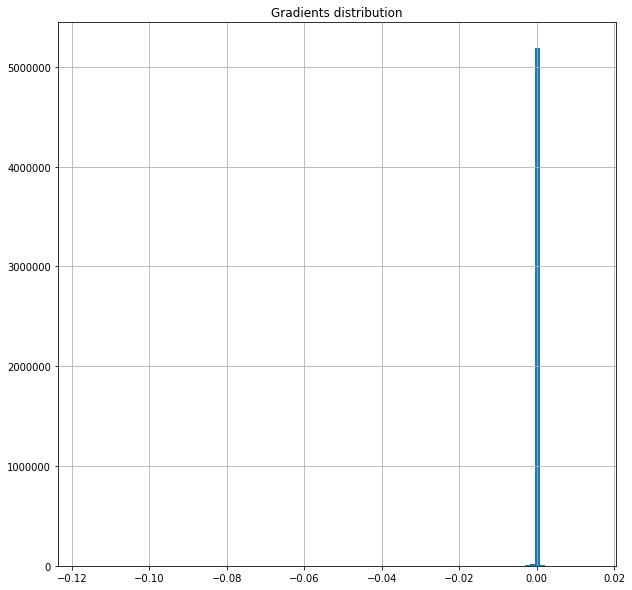

<SS> N an hour boeing said <eos> now in its 13th day the strike has <unk> about N machinists and has started to delay delivery of some <unk> <eos> with a strike fund of about $ <EE>


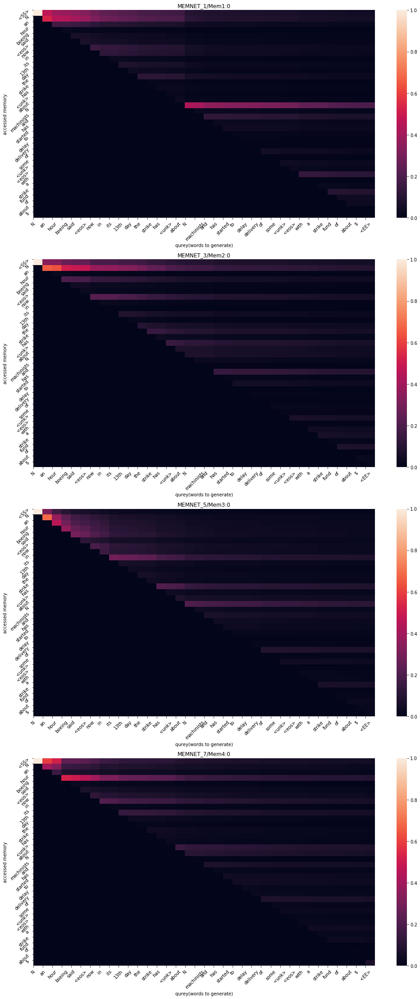

On iter 1 with training PPL: 9245.8173828125, training ACC 0.0004340277810115367
On iter 2 with training PPL: 6908.27392578125, training ACC 0.0
On iter 3 with training PPL: 3908.7998046875, training ACC 0.0
On iter 4 with training PPL: 1988.217041015625, training ACC 0.0
On iter 5 with training PPL: 1962.2989501953125, training ACC 0.0473090261220932
On iter 6 with training PPL: 1236.8619384765625, training ACC 0.0536024309694767
On iter 7 with training PPL: 856.773681640625, training ACC 0.0444878488779068
On iter 8 with training PPL: 885.8977661132812, training ACC 0.0494791679084301
On iter 9 with training PPL: 928.4796752929688, training ACC 0.0466579869389534
On iter 10 with training PPL: 863.8060302734375, training ACC 0.0421006940305233
On iter 11 with training PPL: 838.7822875976562, training ACC 0.0375434011220932
On iter 12 with training PPL: 845.9110107421875, training ACC 0.0501302070915699
On iter 13 with training PPL: 845.929931640625, training ACC 0.0542534738779068
On 

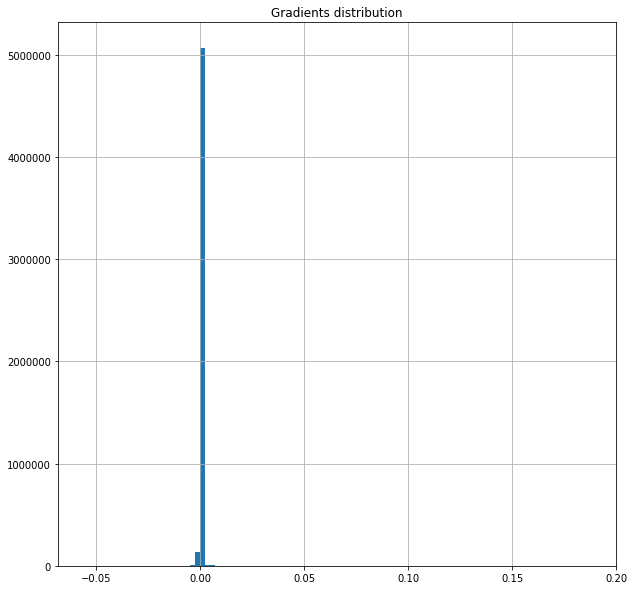

On iter 31 with training PPL: 714.6473999023438, training ACC 0.0486111119389534
On iter 32 with training PPL: 684.031005859375, training ACC 0.0581597238779068
On iter 33 with training PPL: 695.1495361328125, training ACC 0.0525173619389534
On iter 34 with training PPL: 737.5888061523438, training ACC 0.0520833320915699
On iter 35 with training PPL: 672.12841796875, training ACC 0.0501302070915699
On iter 36 with training PPL: 653.363037109375, training ACC 0.0572916679084301
On iter 37 with training PPL: 699.446044921875, training ACC 0.0533854179084301
On iter 38 with training PPL: 760.5706176757812, training ACC 0.0542534738779068
On iter 39 with training PPL: 679.18212890625, training ACC 0.0538194440305233
On iter 40 with training PPL: 658.3062744140625, training ACC 0.0564236119389534
On iter 41 with training PPL: 683.2975463867188, training ACC 0.0505642369389534
On iter 42 with training PPL: 710.65625, training ACC 0.0542534738779068
On iter 43 with training PPL: 738.117919921

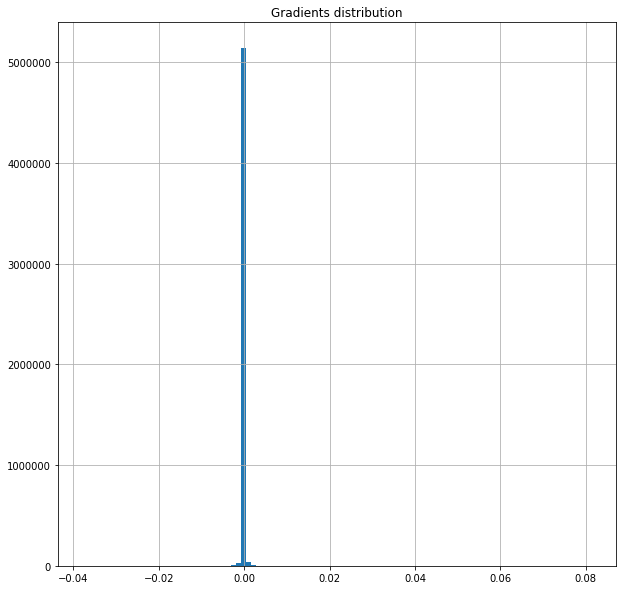

On iter 61 with training PPL: 686.5507202148438, training ACC 0.0479600690305233
On iter 62 with training PPL: 733.3309936523438, training ACC 0.0399305559694767
On iter 63 with training PPL: 649.2737426757812, training ACC 0.0438368059694767
On iter 64 with training PPL: 648.5206298828125, training ACC 0.0603298619389534
On iter 65 with training PPL: 675.4852905273438, training ACC 0.0531684011220932
On iter 66 with training PPL: 665.2158813476562, training ACC 0.0555555559694767
On iter 67 with training PPL: 659.7744750976562, training ACC 0.056640625
On iter 68 with training PPL: 645.0230102539062, training ACC 0.060546875
On iter 69 with training PPL: 658.4578857421875, training ACC 0.0581597238779068
On iter 70 with training PPL: 690.42919921875, training ACC 0.0486111119389534
On iter 71 with training PPL: 662.55419921875, training ACC 0.0544704869389534
On iter 72 with training PPL: 656.9559936523438, training ACC 0.0557725690305233
On iter 73 with training PPL: 641.703674316406

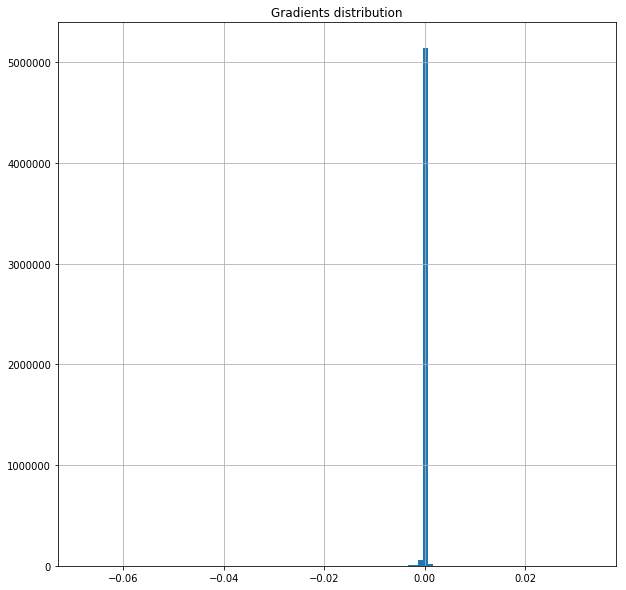

On iter 91 with training PPL: 649.5189819335938, training ACC 0.0562065988779068
On iter 92 with training PPL: 653.2686157226562, training ACC 0.0475260429084301
On iter 93 with training PPL: 574.388671875, training ACC 0.0536024309694767
On iter 94 with training PPL: 696.1652221679688, training ACC 0.0460069440305233
On iter 95 with training PPL: 639.9725341796875, training ACC 0.0559895820915699
On iter 96 with training PPL: 711.797119140625, training ACC 0.0490451380610466
On iter 97 with training PPL: 631.9878540039062, training ACC 0.0531684011220932
On iter 98 with training PPL: 661.2478637695312, training ACC 0.0592447929084301
On iter 99 with training PPL: 657.5084838867188, training ACC 0.0483940988779068
On iter 100 with training PPL: 675.6895751953125, training ACC 0.0483940988779068
<SS> she said <eos> to <unk> matters further when ual corp. stock finally opened on the new york stock exchange at N a.m. the price was listed at $ N a share up about $ N <EE>


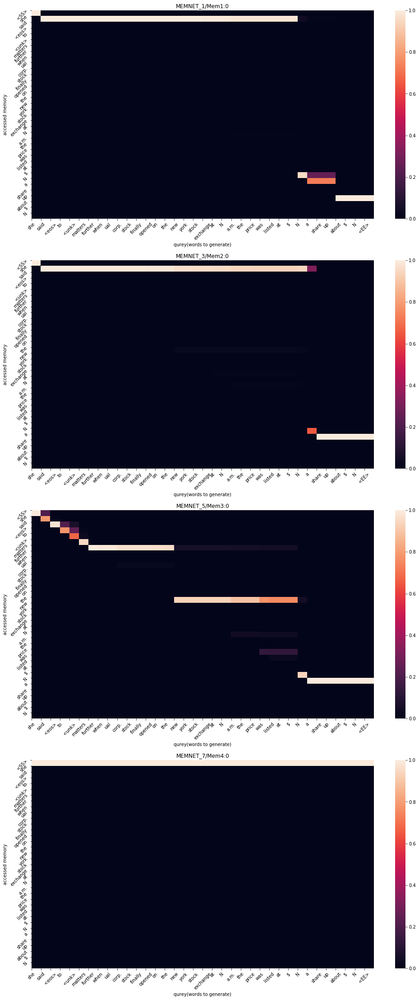

On iter 101 with training PPL: 669.5214233398438, training ACC 0.0557725690305233
On iter 102 with training PPL: 617.0274047851562, training ACC 0.0594618059694767
On iter 103 with training PPL: 679.2688598632812, training ACC 0.0501302070915699
On iter 104 with training PPL: 655.1965942382812, training ACC 0.0520833320915699
On iter 105 with training PPL: 619.9559326171875, training ACC 0.0737847238779068
On iter 106 with training PPL: 641.8184204101562, training ACC 0.0776909738779068
On iter 107 with training PPL: 636.1132202148438, training ACC 0.0776909738779068
On iter 108 with training PPL: 671.3413696289062, training ACC 0.0512152761220932
On iter 109 with training PPL: 638.3690795898438, training ACC 0.0575086809694767
On iter 110 with training PPL: 646.8584594726562, training ACC 0.0726996511220932
On iter 111 with training PPL: 642.1493530273438, training ACC 0.0785590261220932
On iter 112 with training PPL: 680.6669921875, training ACC 0.0766059011220932
On iter 113 with tr

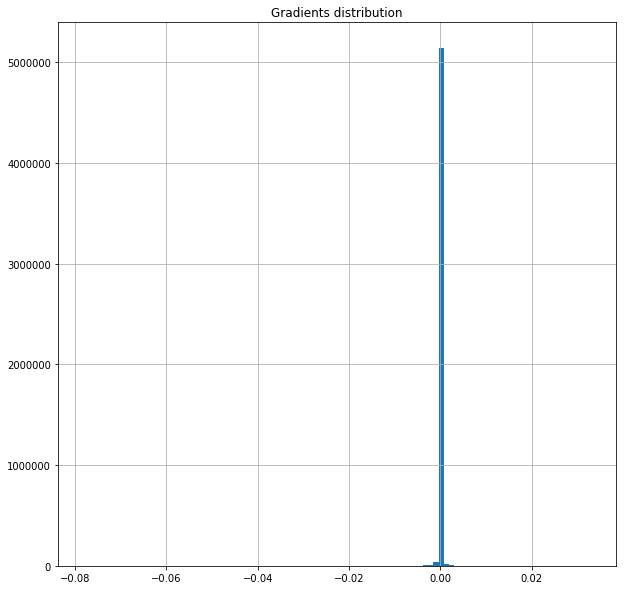

On iter 121 with training PPL: 625.5123291015625, training ACC 0.0735677108168602
On iter 122 with training PPL: 642.3321533203125, training ACC 0.072265625
On iter 123 with training PPL: 660.8818969726562, training ACC 0.0785590261220932
On iter 124 with training PPL: 678.1358642578125, training ACC 0.0668402761220932
On iter 125 with training PPL: 592.4957275390625, training ACC 0.076171875
On iter 126 with training PPL: 635.0241088867188, training ACC 0.0711805522441864
On iter 127 with training PPL: 669.291015625, training ACC 0.0776909738779068
On iter 128 with training PPL: 642.6602783203125, training ACC 0.0774739608168602
On iter 129 with training PPL: 645.0479125976562, training ACC 0.0772569477558136
On iter 130 with training PPL: 677.40869140625, training ACC 0.0687934011220932
On iter 131 with training PPL: 621.5442504882812, training ACC 0.0740017369389534
On iter 132 with training PPL: 620.0227661132812, training ACC 0.0818142369389534
On iter 133 with training PPL: 649.0

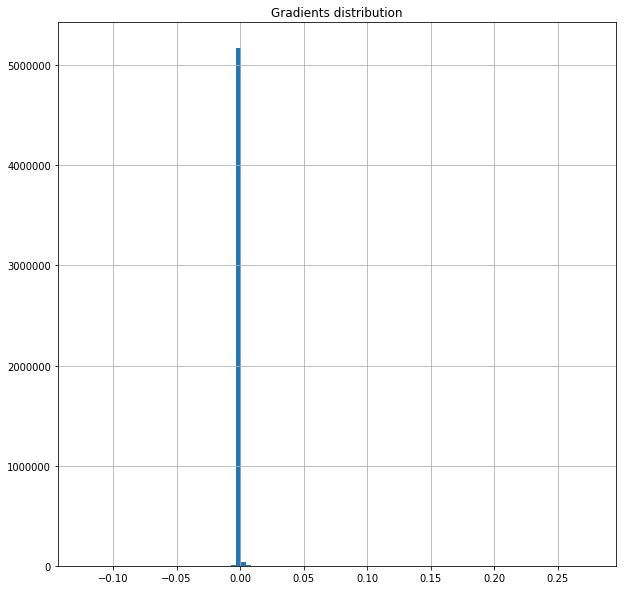

On iter 151 with training PPL: 619.72509765625, training ACC 0.0694444477558136
On iter 152 with training PPL: 618.3162231445312, training ACC 0.07421875
On iter 153 with training PPL: 622.6842651367188, training ACC 0.0763888880610466
On iter 154 with training PPL: 638.4771728515625, training ACC 0.0759548619389534
On iter 155 with training PPL: 647.7315673828125, training ACC 0.0748697891831398
On iter 156 with training PPL: 596.2427978515625, training ACC 0.0746527761220932
On iter 157 with training PPL: 603.6013793945312, training ACC 0.068359375
On iter 158 with training PPL: 645.3869018554688, training ACC 0.0750868022441864
On iter 159 with training PPL: 611.3988647460938, training ACC 0.072265625
On iter 160 with training PPL: 657.042724609375, training ACC 0.0755208358168602
On iter 161 with training PPL: 662.9201049804688, training ACC 0.0750868022441864
On iter 162 with training PPL: 602.1990356445312, training ACC 0.0805121511220932
On iter 163 with training PPL: 642.002990

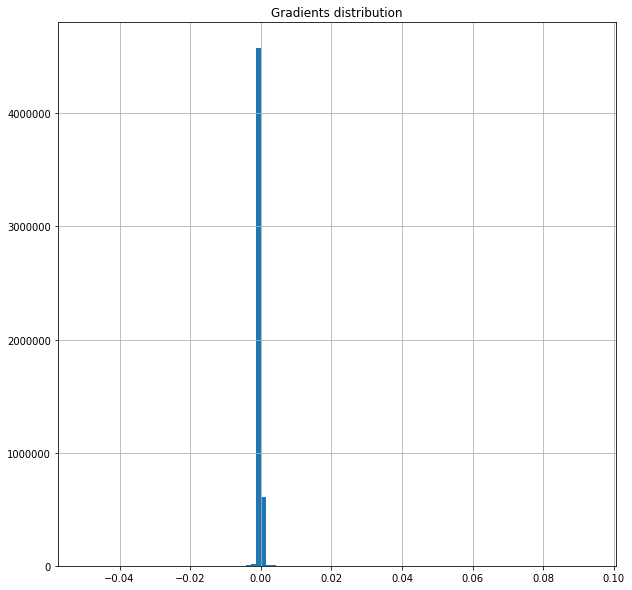

On iter 181 with training PPL: 628.58544921875, training ACC 0.0759548619389534
On iter 182 with training PPL: 598.8184204101562, training ACC 0.0774739608168602
On iter 183 with training PPL: 666.6517944335938, training ACC 0.0768229141831398
On iter 184 with training PPL: 663.484619140625, training ACC 0.076171875
On iter 185 with training PPL: 600.794189453125, training ACC 0.0748697891831398
On iter 186 with training PPL: 600.363525390625, training ACC 0.0796440988779068
On iter 187 with training PPL: 613.831298828125, training ACC 0.076171875
On iter 188 with training PPL: 623.7745971679688, training ACC 0.0768229141831398
On iter 189 with training PPL: 648.4039916992188, training ACC 0.0763888880610466
On iter 190 with training PPL: 586.3682861328125, training ACC 0.0772569477558136
On iter 191 with training PPL: 651.6735229492188, training ACC 0.0696614608168602
On iter 192 with training PPL: 645.7279663085938, training ACC 0.0766059011220932
On iter 193 with training PPL: 611.5

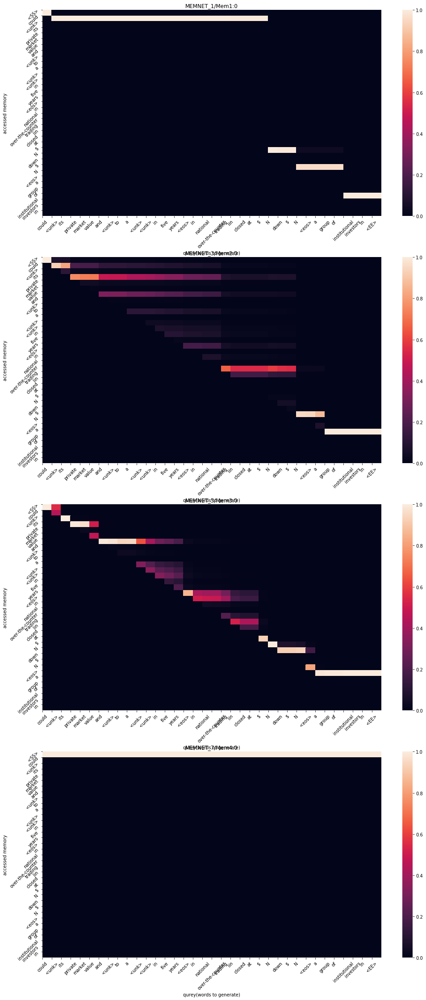

On iter 201 with training PPL: 581.7540893554688, training ACC 0.0776909738779068
On iter 202 with training PPL: 602.9855346679688, training ACC 0.0842013880610466
On iter 203 with training PPL: 621.2213134765625, training ACC 0.0768229141831398
On iter 204 with training PPL: 685.8538208007812, training ACC 0.0779079869389534
On iter 205 with training PPL: 654.0485229492188, training ACC 0.0707465261220932
On iter 206 with training PPL: 637.201904296875, training ACC 0.0744357630610466
On iter 207 with training PPL: 581.1138916015625, training ACC 0.0837673619389534
On iter 208 with training PPL: 605.4993896484375, training ACC 0.0818142369389534
On iter 209 with training PPL: 620.4850463867188, training ACC 0.0789930522441864
On iter 210 with training PPL: 607.1499633789062, training ACC 0.0759548619389534
	 validation PPL 640.3114013671875, validation acc 0.0748697891831398
shape of gradients is (5228544,), L2 norm of gradients is 0.5442797541618347, details:                   0
coun

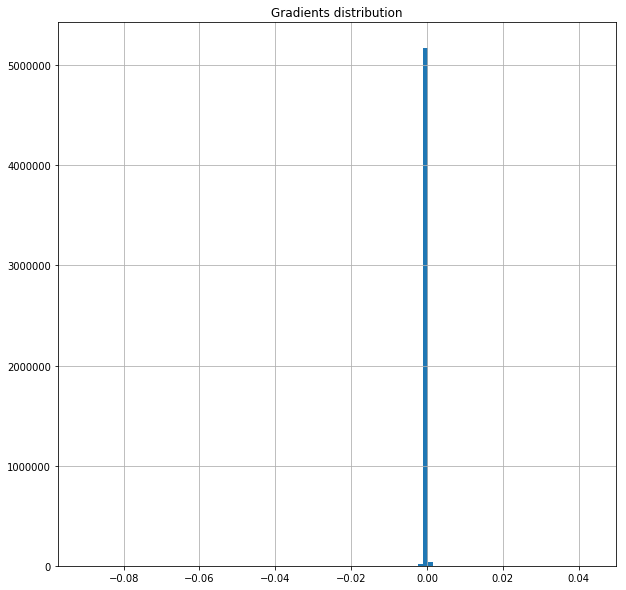

On iter 211 with training PPL: 592.2420654296875, training ACC 0.0785590261220932
On iter 212 with training PPL: 599.8106689453125, training ACC 0.0813802108168602
On iter 213 with training PPL: 606.6924438476562, training ACC 0.0733506977558136
On iter 214 with training PPL: 594.99365234375, training ACC 0.0779079869389534
On iter 215 with training PPL: 602.1567993164062, training ACC 0.0750868022441864
On iter 216 with training PPL: 642.3781127929688, training ACC 0.0746527761220932
On iter 217 with training PPL: 602.0669555664062, training ACC 0.0802951380610466
On iter 218 with training PPL: 616.2264404296875, training ACC 0.0746527761220932
On iter 219 with training PPL: 648.517822265625, training ACC 0.0783420130610466
On iter 220 with training PPL: 667.6650390625, training ACC 0.0718315988779068
On iter 221 with training PPL: 623.6282958984375, training ACC 0.076171875
On iter 222 with training PPL: 612.762451171875, training ACC 0.0772569477558136
On iter 223 with training PPL:

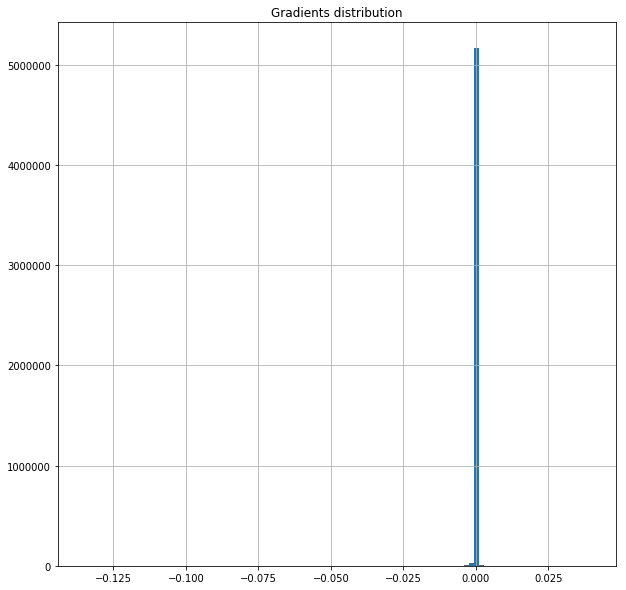

On iter 241 with training PPL: 639.6925048828125, training ACC 0.0883246511220932
On iter 242 with training PPL: 599.1986083984375, training ACC 0.08203125
On iter 243 with training PPL: 619.1083374023438, training ACC 0.0876736119389534
On iter 244 with training PPL: 615.799072265625, training ACC 0.0809461772441864
On iter 245 with training PPL: 631.7554931640625, training ACC 0.0772569477558136
On iter 246 with training PPL: 673.0023803710938, training ACC 0.0783420130610466
On iter 247 with training PPL: 612.3068237304688, training ACC 0.0785590261220932
On iter 248 with training PPL: 609.14599609375, training ACC 0.0737847238779068
On iter 249 with training PPL: 652.9052124023438, training ACC 0.0798611119389534
On iter 250 with training PPL: 654.4736938476562, training ACC 0.0779079869389534
On iter 251 with training PPL: 645.640869140625, training ACC 0.0783420130610466
On iter 252 with training PPL: 617.263671875, training ACC 0.087890625
On iter 253 with training PPL: 577.2755

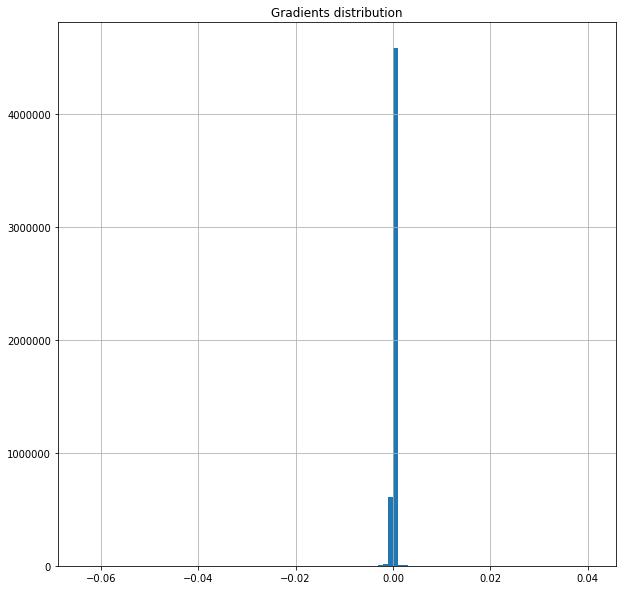

On iter 271 with training PPL: 593.90576171875, training ACC 0.0920138880610466
On iter 272 with training PPL: 599.4780883789062, training ACC 0.0887586772441864
On iter 273 with training PPL: 553.2136840820312, training ACC 0.0874565988779068
On iter 274 with training PPL: 584.9142456054688, training ACC 0.0870225727558136
On iter 275 with training PPL: 587.7730102539062, training ACC 0.0881076380610466
On iter 276 with training PPL: 583.0543823242188, training ACC 0.0915798619389534
On iter 277 with training PPL: 554.232666015625, training ACC 0.0922309011220932
On iter 278 with training PPL: 570.4116821289062, training ACC 0.087890625
On iter 279 with training PPL: 564.8270874023438, training ACC 0.0998263880610466
On iter 280 with training PPL: 570.9631958007812, training ACC 0.0930989608168602
On iter 281 with training PPL: 562.1659545898438, training ACC 0.0965711772441864
On iter 282 with training PPL: 631.50732421875, training ACC 0.0837673619389534
On iter 283 with training PP

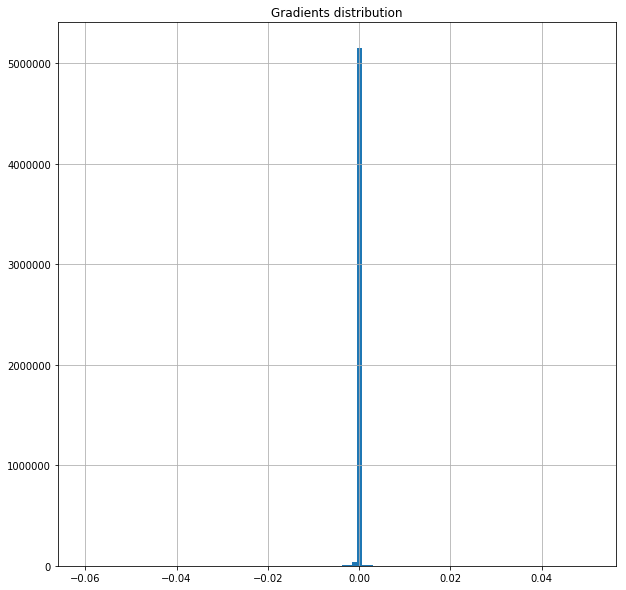

<SS> to go about their business quietly <eos> russell <unk> of park <unk> n.j. says he has been working for the past year at a huge chemical and manufacturing concern in new york <unk> to the <EE>


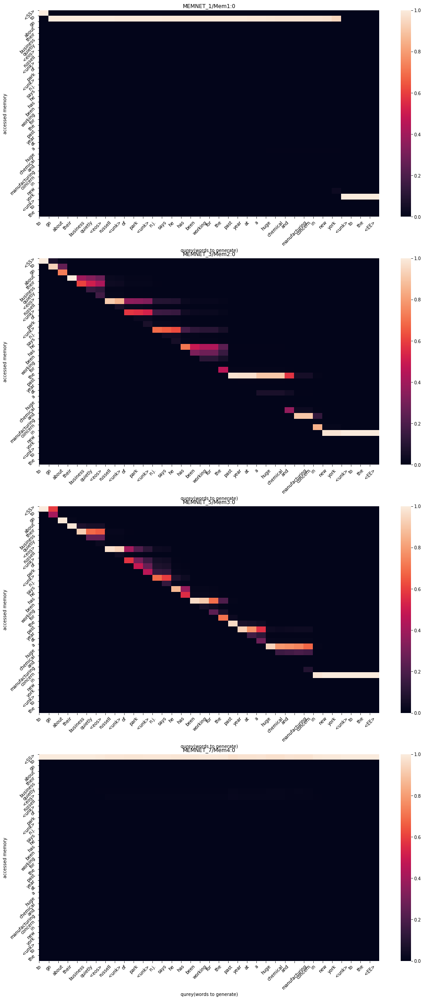

On iter 301 with training PPL: 573.8999633789062, training ACC 0.0950520858168602
On iter 302 with training PPL: 589.8262329101562, training ACC 0.0939670130610466
On iter 303 with training PPL: 568.0158081054688, training ACC 0.1011284738779068
On iter 304 with training PPL: 523.462890625, training ACC 0.1011284738779068
On iter 305 with training PPL: 551.4104614257812, training ACC 0.1011284738779068
On iter 306 with training PPL: 586.0630493164062, training ACC 0.0933159738779068
On iter 307 with training PPL: 602.12353515625, training ACC 0.1009114608168602
On iter 308 with training PPL: 557.4013671875, training ACC 0.0950520858168602
On iter 309 with training PPL: 585.026611328125, training ACC 0.0963541641831398
On iter 310 with training PPL: 589.1109008789062, training ACC 0.1017795130610466
On iter 311 with training PPL: 583.2256469726562, training ACC 0.0941840261220932
On iter 312 with training PPL: 601.1489868164062, training ACC 0.0900607630610466
On iter 313 with training 

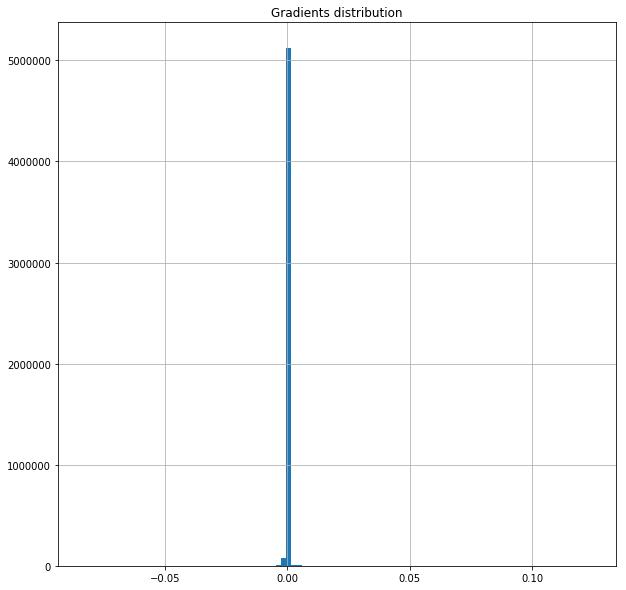

On iter 331 with training PPL: 583.0546264648438, training ACC 0.0902777761220932
On iter 332 with training PPL: 532.5808715820312, training ACC 0.10546875
On iter 333 with training PPL: 549.145263671875, training ACC 0.0978732630610466
On iter 334 with training PPL: 614.659912109375, training ACC 0.095703125
On iter 335 with training PPL: 589.2100830078125, training ACC 0.1002604141831398
On iter 336 with training PPL: 566.3368530273438, training ACC 0.1022135391831398
On iter 337 with training PPL: 593.0711669921875, training ACC 0.0933159738779068
On iter 338 with training PPL: 568.6209106445312, training ACC 0.1004774272441864
On iter 339 with training PPL: 582.6338500976562, training ACC 0.0989583358168602
On iter 340 with training PPL: 618.8519287109375, training ACC 0.0965711772441864
On iter 341 with training PPL: 524.7666625976562, training ACC 0.1085069477558136
On iter 342 with training PPL: 564.9674682617188, training ACC 0.0985243022441864
On iter 343 with training PPL: 53

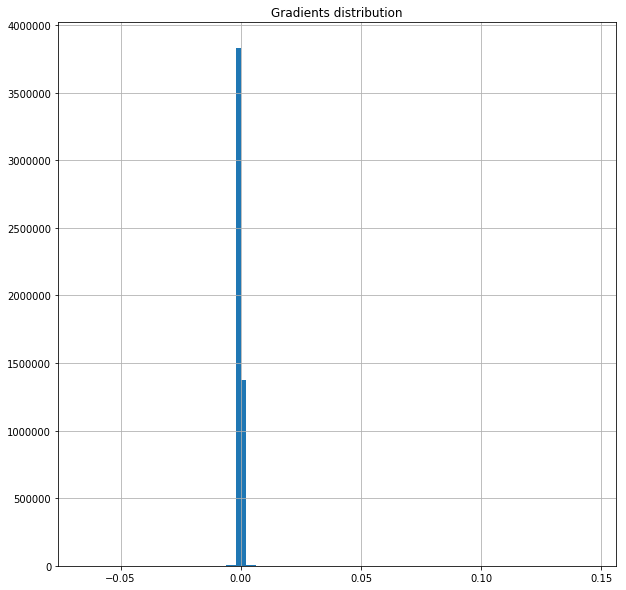

On iter 361 with training PPL: 568.4683227539062, training ACC 0.1004774272441864
On iter 362 with training PPL: 545.890380859375, training ACC 0.0987413227558136
On iter 363 with training PPL: 564.586181640625, training ACC 0.0989583358168602
On iter 364 with training PPL: 498.2578430175781, training ACC 0.1032986119389534
On iter 365 with training PPL: 569.178955078125, training ACC 0.0993923619389534
On iter 366 with training PPL: 541.6513061523438, training ACC 0.0991753488779068
On iter 367 with training PPL: 580.970703125, training ACC 0.0987413227558136
On iter 368 with training PPL: 504.6800231933594, training ACC 0.099609375
On iter 369 with training PPL: 550.0968627929688, training ACC 0.1026475727558136
On iter 370 with training PPL: 569.2850952148438, training ACC 0.0985243022441864
On iter 371 with training PPL: 530.708740234375, training ACC 0.1041666641831398
On iter 372 with training PPL: 530.5166625976562, training ACC 0.0980902761220932
On iter 373 with training PPL: 

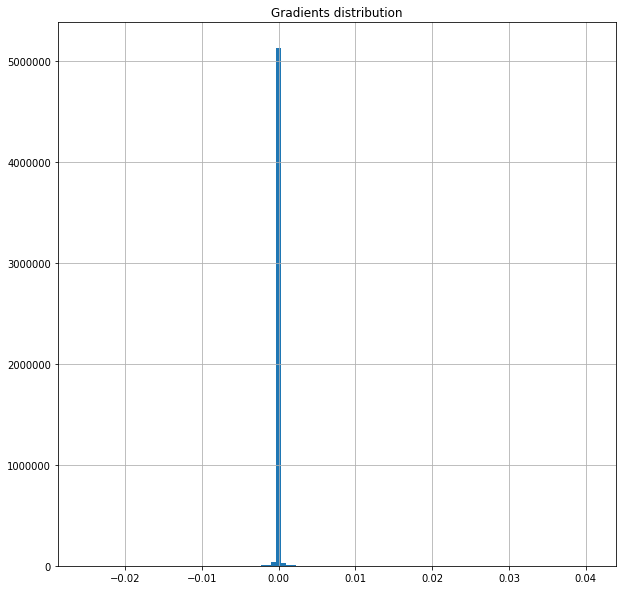

On iter 391 with training PPL: 515.6287841796875, training ACC 0.1171875
On iter 392 with training PPL: 484.2256164550781, training ACC 0.1165364608168602
On iter 393 with training PPL: 537.8355102539062, training ACC 0.0991753488779068
On iter 394 with training PPL: 539.0091552734375, training ACC 0.1028645858168602
On iter 395 with training PPL: 501.35467529296875, training ACC 0.1115451380610466
On iter 396 with training PPL: 525.3352661132812, training ACC 0.1111111119389534
On iter 397 with training PPL: 551.2193603515625, training ACC 0.0926649272441864
On iter 398 with training PPL: 532.15283203125, training ACC 0.0987413227558136
On iter 399 with training PPL: 517.1546630859375, training ACC 0.0987413227558136
On iter 400 with training PPL: 493.6859436035156, training ACC 0.1100260391831398
<SS> <unk> which have been labeled <unk> as <unk> <unk> <unk> cyclical <unk> and <unk> are <unk> <unk> therefore <unk> <unk> <unk> therefore <unk> and <unk> <unk> but <unk> therefore both pr

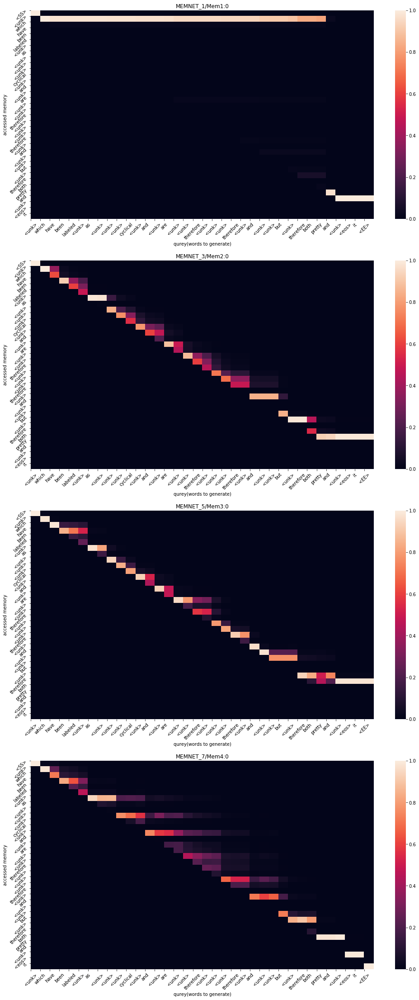

On iter 401 with training PPL: 505.17431640625, training ACC 0.1100260391831398
On iter 402 with training PPL: 509.8157043457031, training ACC 0.1085069477558136
On iter 403 with training PPL: 457.7762145996094, training ACC 0.11328125
On iter 404 with training PPL: 534.403076171875, training ACC 0.1098090261220932
On iter 405 with training PPL: 566.5458984375, training ACC 0.1028645858168602
On iter 406 with training PPL: 541.3533325195312, training ACC 0.1143663227558136
On iter 407 with training PPL: 513.9473266601562, training ACC 0.1056857630610466
On iter 408 with training PPL: 522.4442138671875, training ACC 0.1026475727558136
On iter 409 with training PPL: 538.86083984375, training ACC 0.1056857630610466
On iter 410 with training PPL: 514.91748046875, training ACC 0.109375
On iter 411 with training PPL: 538.6661376953125, training ACC 0.1041666641831398
On iter 412 with training PPL: 496.3619689941406, training ACC 0.1061197891831398
On iter 413 with training PPL: 547.675598144

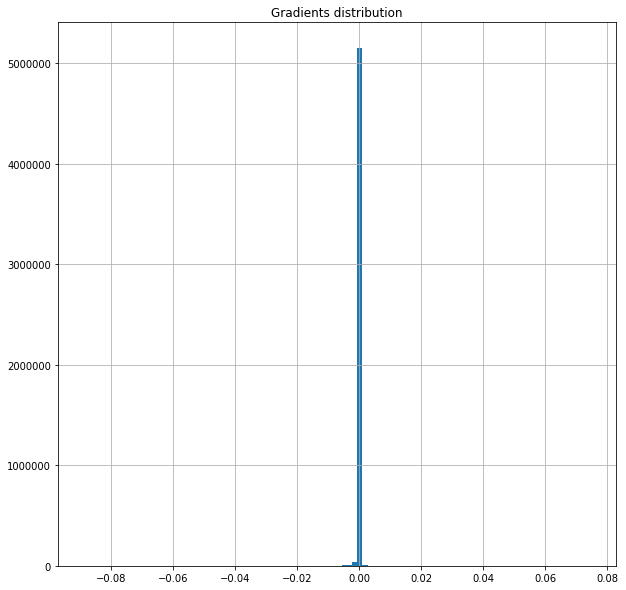

On iter 421 with training PPL: 546.0671997070312, training ACC 0.1111111119389534
On iter 422 with training PPL: 471.41162109375, training ACC 0.1145833358168602
On iter 423 with training PPL: 529.707275390625, training ACC 0.1137152761220932
On iter 424 with training PPL: 513.0256958007812, training ACC 0.1117621511220932
On iter 425 with training PPL: 529.2583618164062, training ACC 0.1048177108168602
On iter 426 with training PPL: 506.0565185546875, training ACC 0.107421875
On iter 427 with training PPL: 526.1204223632812, training ACC 0.1108940988779068
On iter 428 with training PPL: 526.6763916015625, training ACC 0.1193576380610466
On iter 429 with training PPL: 456.32757568359375, training ACC 0.1137152761220932
On iter 430 with training PPL: 530.7266845703125, training ACC 0.1148003488779068
On iter 431 with training PPL: 517.9149780273438, training ACC 0.1069878488779068
On iter 432 with training PPL: 459.420654296875, training ACC 0.1273871511220932
On iter 433 with training 

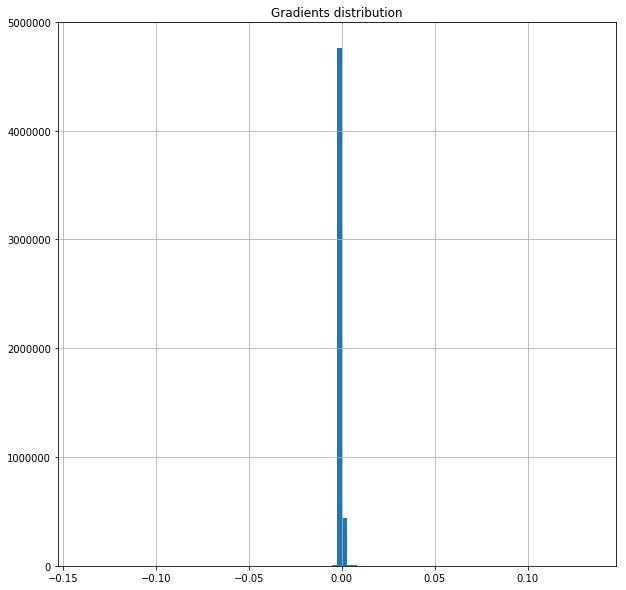

On iter 451 with training PPL: 537.8468017578125, training ACC 0.1126302108168602
On iter 452 with training PPL: 497.0149230957031, training ACC 0.1174045130610466
On iter 453 with training PPL: 446.1676025390625, training ACC 0.1154513880610466
On iter 454 with training PPL: 497.90087890625, training ACC 0.119140625
On iter 455 with training PPL: 461.740966796875, training ACC 0.1223958358168602
On iter 456 with training PPL: 558.4761962890625, training ACC 0.1032986119389534
On iter 457 with training PPL: 482.8332214355469, training ACC 0.1206597238779068
On iter 458 with training PPL: 495.18865966796875, training ACC 0.1169704869389534
On iter 459 with training PPL: 467.3923645019531, training ACC 0.1130642369389534
On iter 460 with training PPL: 440.01849365234375, training ACC 0.1245659738779068
On iter 461 with training PPL: 513.0601806640625, training ACC 0.1161024272441864
On iter 462 with training PPL: 488.6188049316406, training ACC 0.1128472238779068
On iter 463 with trainin

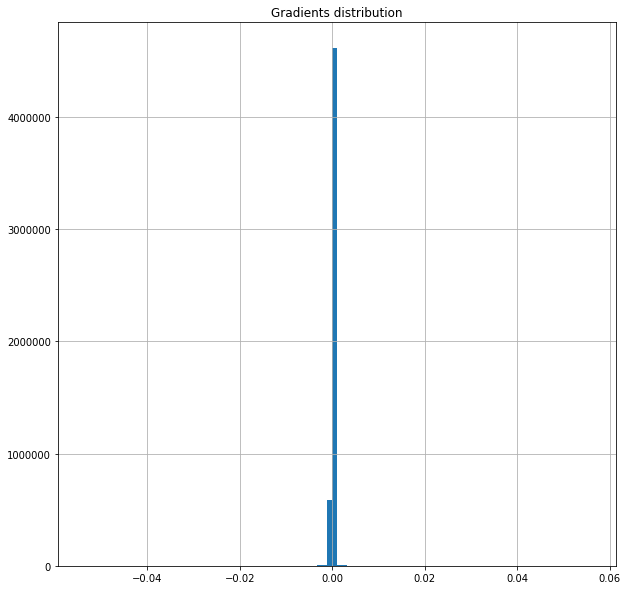

On iter 481 with training PPL: 448.962890625, training ACC 0.1245659738779068
On iter 482 with training PPL: 477.2303466796875, training ACC 0.1284722238779068
On iter 483 with training PPL: 475.86553955078125, training ACC 0.1154513880610466
On iter 484 with training PPL: 467.99383544921875, training ACC 0.1254340261220932
On iter 485 with training PPL: 473.0527038574219, training ACC 0.1243489608168602
On iter 486 with training PPL: 469.7200012207031, training ACC 0.1258680522441864
On iter 487 with training PPL: 446.9085693359375, training ACC 0.1260850727558136
On iter 488 with training PPL: 469.33917236328125, training ACC 0.1189236119389534
On iter 489 with training PPL: 434.3048400878906, training ACC 0.1271701455116272
On iter 490 with training PPL: 454.48345947265625, training ACC 0.1291232705116272
On iter 491 with training PPL: 498.9806213378906, training ACC 0.1221788227558136
On iter 492 with training PPL: 438.1927185058594, training ACC 0.1265190988779068
On iter 493 with

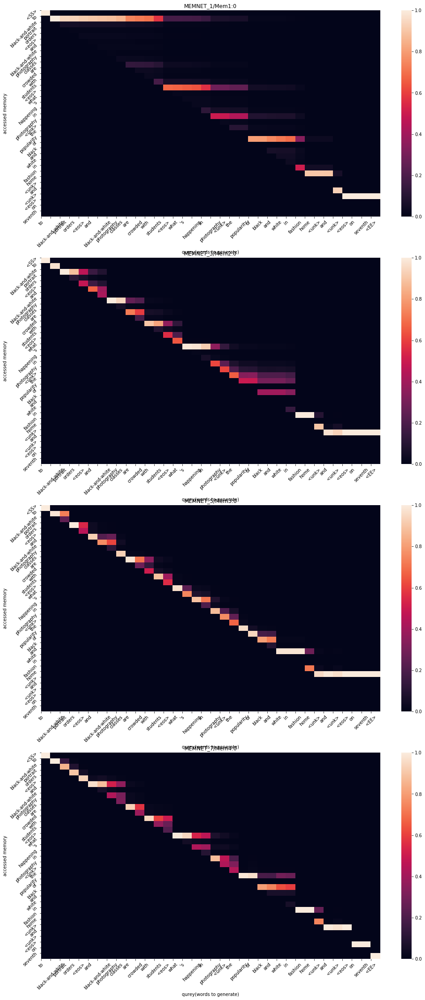

On iter 501 with training PPL: 452.8452453613281, training ACC 0.1286892294883728
On iter 502 with training PPL: 408.5328369140625, training ACC 0.12890625
On iter 503 with training PPL: 458.04608154296875, training ACC 0.1234809011220932
On iter 504 with training PPL: 464.5948486328125, training ACC 0.1202256977558136
On iter 505 with training PPL: 452.1847839355469, training ACC 0.1256510466337204
On iter 506 with training PPL: 448.3527526855469, training ACC 0.1263020783662796
On iter 507 with training PPL: 439.690673828125, training ACC 0.1282552033662796
On iter 508 with training PPL: 458.3043212890625, training ACC 0.1232638880610466
On iter 509 with training PPL: 459.8743591308594, training ACC 0.1254340261220932
On iter 510 with training PPL: 430.7282409667969, training ACC 0.1286892294883728
	 validation PPL 456.109375, validation acc 0.1258680522441864
shape of gradients is (5228544,), L2 norm of gradients is 1.1039644479751587, details:                   0
count  5.228544e+0

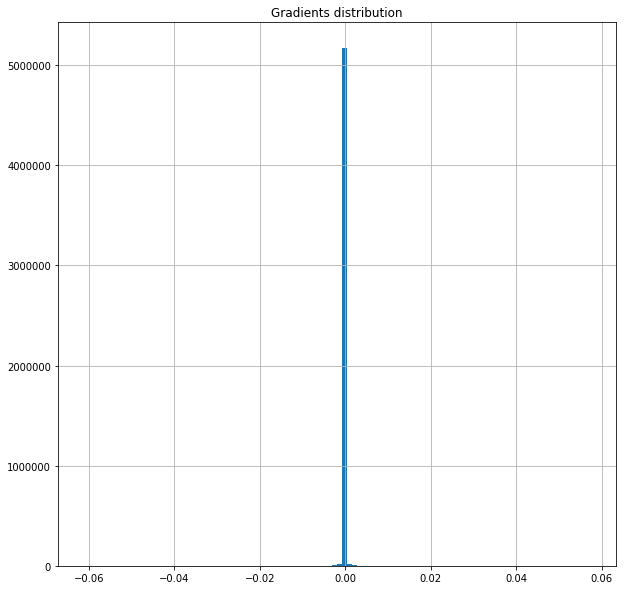

On iter 511 with training PPL: 415.0921630859375, training ACC 0.130859375
On iter 512 with training PPL: 437.22235107421875, training ACC 0.1239149272441864
On iter 513 with training PPL: 449.4352111816406, training ACC 0.1419270783662796
On iter 514 with training PPL: 436.28912353515625, training ACC 0.1243489608168602
On iter 515 with training PPL: 414.46441650390625, training ACC 0.1306423544883728
On iter 516 with training PPL: 431.04339599609375, training ACC 0.1297743022441864
On iter 517 with training PPL: 438.92315673828125, training ACC 0.1299913227558136
On iter 518 with training PPL: 420.94329833984375, training ACC 0.125
On iter 519 with training PPL: 405.4873962402344, training ACC 0.12890625
On iter 520 with training PPL: 390.873046875, training ACC 0.1356336772441864
On iter 521 with training PPL: 435.072998046875, training ACC 0.12890625
On iter 522 with training PPL: 414.539306640625, training ACC 0.1358506977558136
On iter 523 with training PPL: 438.1241760253906, tr

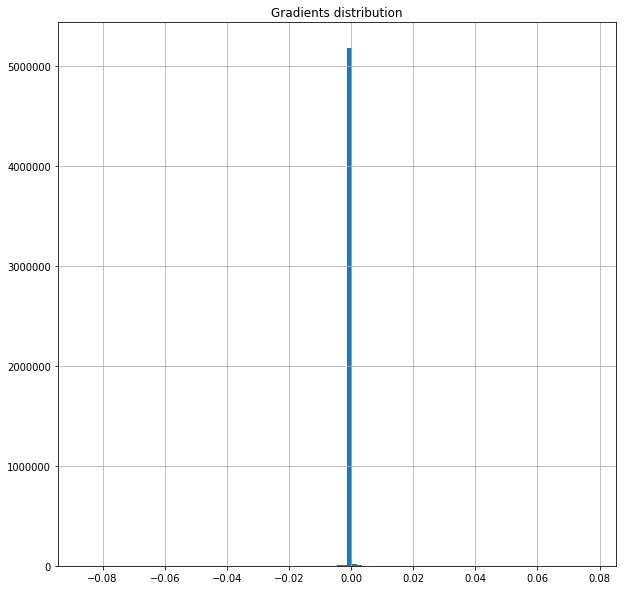

On iter 541 with training PPL: 398.4740295410156, training ACC 0.1304253488779068
On iter 542 with training PPL: 416.0683288574219, training ACC 0.1351996511220932
On iter 543 with training PPL: 393.1237487792969, training ACC 0.1378038227558136
On iter 544 with training PPL: 386.274658203125, training ACC 0.1440972238779068
On iter 545 with training PPL: 414.0057678222656, training ACC 0.1384548544883728
On iter 546 with training PPL: 396.0438537597656, training ACC 0.1328125
On iter 547 with training PPL: 332.54766845703125, training ACC 0.1456163227558136
On iter 548 with training PPL: 423.91900634765625, training ACC 0.1388888955116272
On iter 549 with training PPL: 433.35986328125, training ACC 0.130859375
On iter 550 with training PPL: 457.9637451171875, training ACC 0.12109375
On iter 551 with training PPL: 427.18212890625, training ACC 0.1397569477558136
On iter 552 with training PPL: 406.8993835449219, training ACC 0.126953125
On iter 553 with training PPL: 399.8045654296875, 

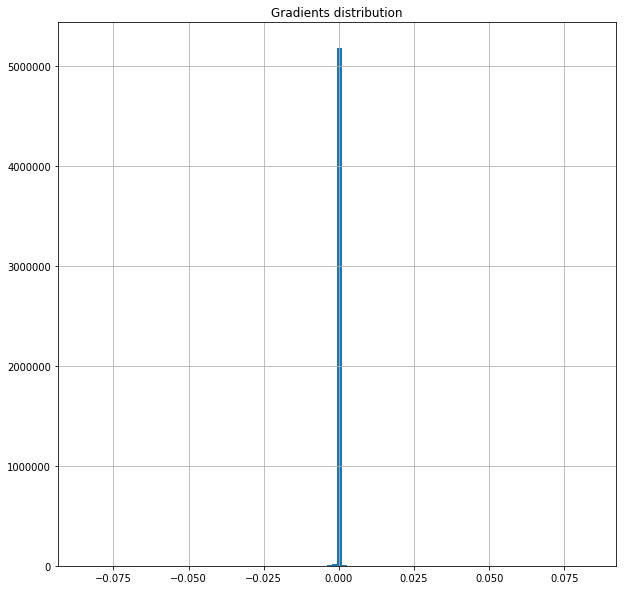

On iter 571 with training PPL: 393.6634216308594, training ACC 0.1375868022441864
On iter 572 with training PPL: 424.4928894042969, training ACC 0.1295572966337204
On iter 573 with training PPL: 418.2203063964844, training ACC 0.1351996511220932
On iter 574 with training PPL: 381.4909362792969, training ACC 0.1434461772441864
On iter 575 with training PPL: 391.59912109375, training ACC 0.1391059011220932
On iter 576 with training PPL: 362.2088317871094, training ACC 0.1506076455116272
On iter 577 with training PPL: 352.6382751464844, training ACC 0.150390625
On iter 578 with training PPL: 418.8024597167969, training ACC 0.1451822966337204
On iter 579 with training PPL: 342.4175720214844, training ACC 0.1508246511220932
On iter 580 with training PPL: 390.9323425292969, training ACC 0.1325954794883728
On iter 581 with training PPL: 369.61810302734375, training ACC 0.1499565988779068
On iter 582 with training PPL: 394.17620849609375, training ACC 0.1490885466337204
On iter 583 with traini

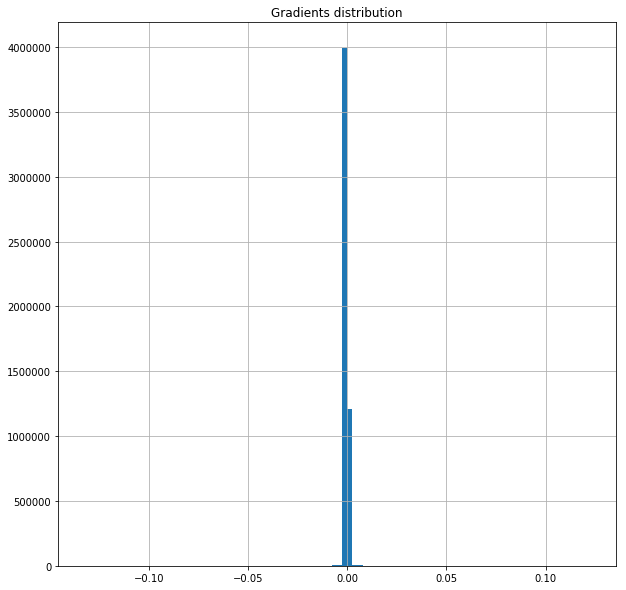

<SS> lower prices these retail chains are now expected to bring should make it easier for managers to raise the necessary capital and pay back the resulting debt <eos> in addition the fall selling season has <EE>


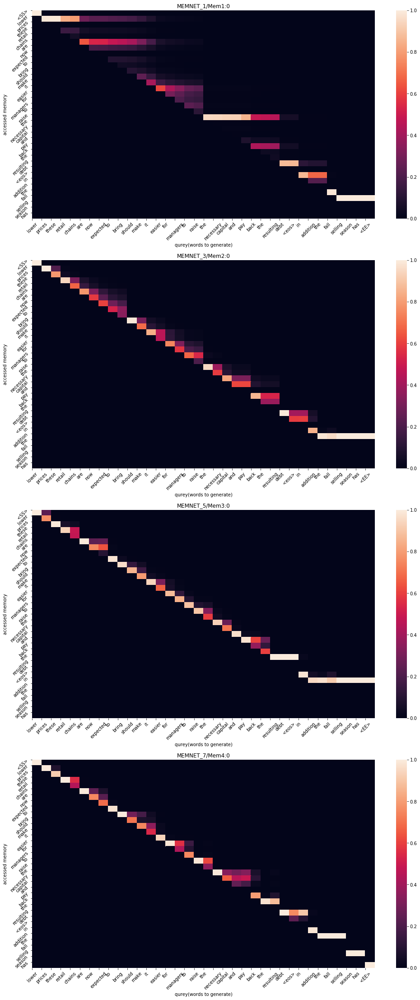

On iter 601 with training PPL: 385.707763671875, training ACC 0.1443142294883728
On iter 602 with training PPL: 358.699462890625, training ACC 0.1501736044883728
On iter 603 with training PPL: 324.3144226074219, training ACC 0.1519097238779068
On iter 604 with training PPL: 349.15118408203125, training ACC 0.1538628488779068
On iter 605 with training PPL: 401.1135559082031, training ACC 0.1408420205116272
On iter 606 with training PPL: 366.0589294433594, training ACC 0.1419270783662796
On iter 607 with training PPL: 348.7618103027344, training ACC 0.1590711772441864
On iter 608 with training PPL: 346.4854431152344, training ACC 0.1501736044883728
On iter 609 with training PPL: 348.40625, training ACC 0.1434461772441864
On iter 610 with training PPL: 373.344482421875, training ACC 0.1473524272441864
On iter 611 with training PPL: 383.11480712890625, training ACC 0.146484375
On iter 612 with training PPL: 359.7728271484375, training ACC 0.1488715261220932
On iter 613 with training PPL: 4

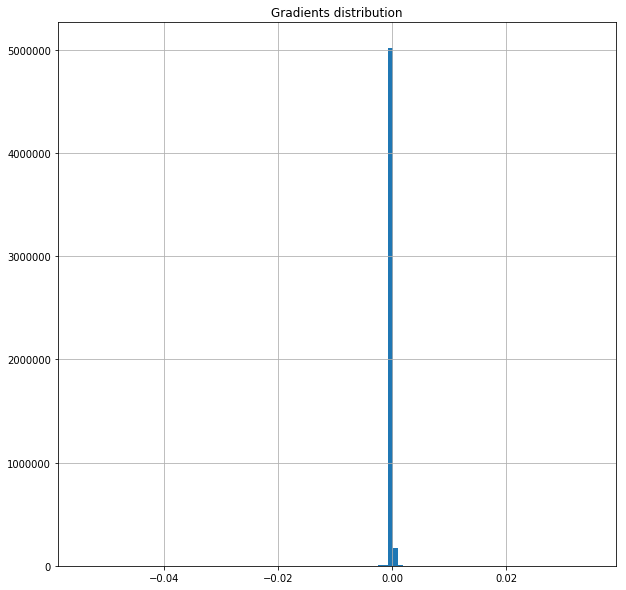

On iter 631 with training PPL: 326.0639953613281, training ACC 0.1584201455116272
On iter 632 with training PPL: 388.2649841308594, training ACC 0.1458333283662796
On iter 633 with training PPL: 323.5635681152344, training ACC 0.1560329794883728
On iter 634 with training PPL: 359.0093688964844, training ACC 0.1510416716337204
On iter 635 with training PPL: 352.7156066894531, training ACC 0.1536458283662796
On iter 636 with training PPL: 352.43804931640625, training ACC 0.1525607705116272
On iter 637 with training PPL: 356.7276611328125, training ACC 0.142578125
On iter 638 with training PPL: 363.8212585449219, training ACC 0.150390625
On iter 639 with training PPL: 383.63470458984375, training ACC 0.1430121511220932
On iter 640 with training PPL: 355.8340759277344, training ACC 0.1477864533662796
On iter 641 with training PPL: 382.8956604003906, training ACC 0.1436631977558136
On iter 642 with training PPL: 342.24566650390625, training ACC 0.1569010466337204
On iter 643 with training P

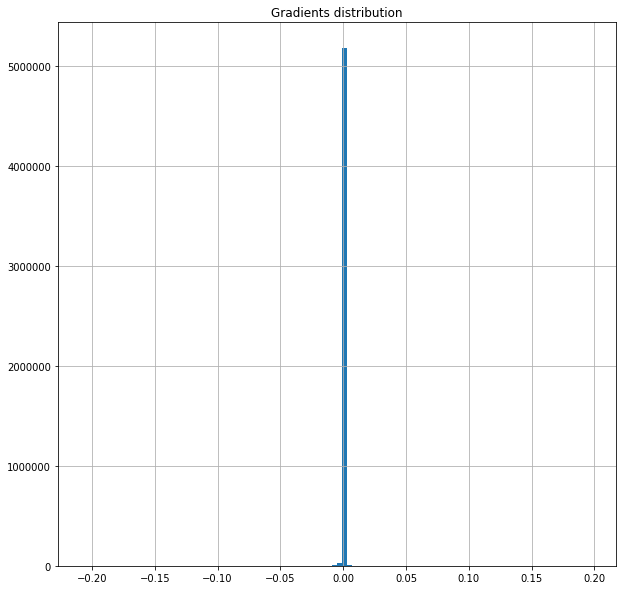

On iter 661 with training PPL: 348.7764587402344, training ACC 0.1514756977558136
On iter 662 with training PPL: 339.0388488769531, training ACC 0.15625
On iter 663 with training PPL: 341.5718688964844, training ACC 0.1506076455116272
On iter 664 with training PPL: 313.082763671875, training ACC 0.1527777761220932
On iter 665 with training PPL: 337.12432861328125, training ACC 0.154296875
On iter 666 with training PPL: 380.37127685546875, training ACC 0.15234375
On iter 667 with training PPL: 306.6288146972656, training ACC 0.1597222238779068
On iter 668 with training PPL: 344.959228515625, training ACC 0.1599392294883728
On iter 669 with training PPL: 322.7787170410156, training ACC 0.1475694477558136
On iter 670 with training PPL: 359.2340393066406, training ACC 0.1566840261220932
On iter 671 with training PPL: 358.19818115234375, training ACC 0.1512586772441864
On iter 672 with training PPL: 309.0092468261719, training ACC 0.1573350727558136
On iter 673 with training PPL: 356.405120

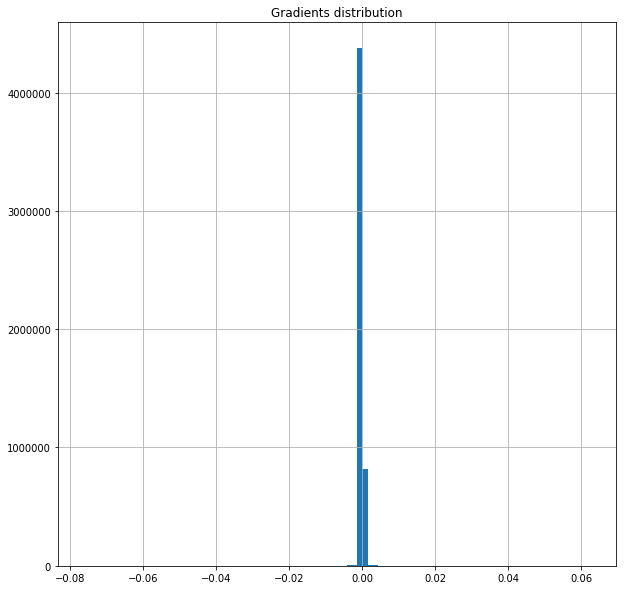

On iter 691 with training PPL: 305.51361083984375, training ACC 0.1631944477558136
On iter 692 with training PPL: 332.6474304199219, training ACC 0.1540798544883728
On iter 693 with training PPL: 328.4305114746094, training ACC 0.1566840261220932
On iter 694 with training PPL: 348.2870178222656, training ACC 0.1525607705116272
On iter 695 with training PPL: 339.404052734375, training ACC 0.1555989533662796
On iter 696 with training PPL: 320.88348388671875, training ACC 0.1592881977558136
On iter 697 with training PPL: 292.7087707519531, training ACC 0.162109375
On iter 698 with training PPL: 311.017333984375, training ACC 0.1497395783662796
On iter 699 with training PPL: 342.9615478515625, training ACC 0.1569010466337204
On iter 700 with training PPL: 319.1697692871094, training ACC 0.1566840261220932
<SS> it is possible that the big green initiative will be ruled unconstitutional it is of course <unk> that in modern california it could slide through <eos> this is the state that recent

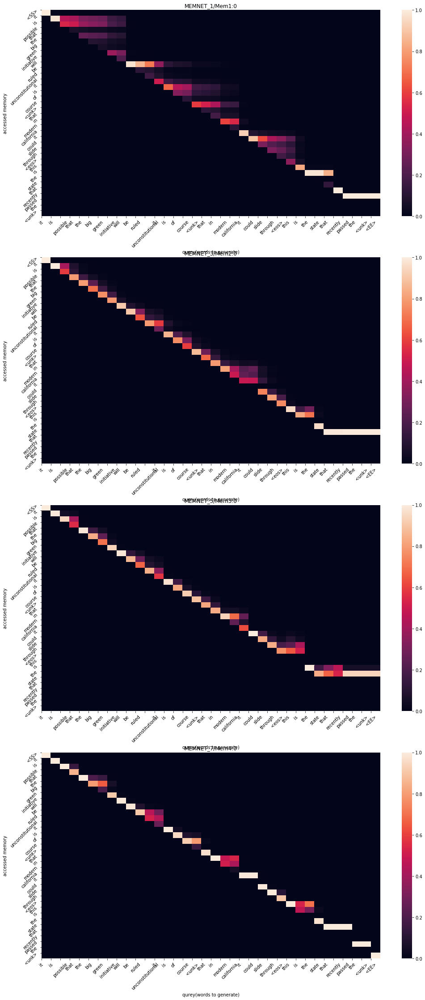

On iter 701 with training PPL: 321.1403503417969, training ACC 0.1519097238779068
On iter 702 with training PPL: 338.44427490234375, training ACC 0.150390625
On iter 703 with training PPL: 326.2408142089844, training ACC 0.1529947966337204
On iter 704 with training PPL: 288.6983642578125, training ACC 0.166015625
On iter 705 with training PPL: 294.8894958496094, training ACC 0.16796875
On iter 706 with training PPL: 300.8394775390625, training ACC 0.1592881977558136
On iter 707 with training PPL: 324.9693908691406, training ACC 0.1584201455116272
On iter 708 with training PPL: 305.1700134277344, training ACC 0.1640625
On iter 709 with training PPL: 300.2315673828125, training ACC 0.1657986044883728
On iter 710 with training PPL: 319.810546875, training ACC 0.1508246511220932
On iter 711 with training PPL: 292.4046630859375, training ACC 0.1640625
On iter 712 with training PPL: 325.0972595214844, training ACC 0.1586371511220932
On iter 713 with training PPL: 308.0512390136719, training 

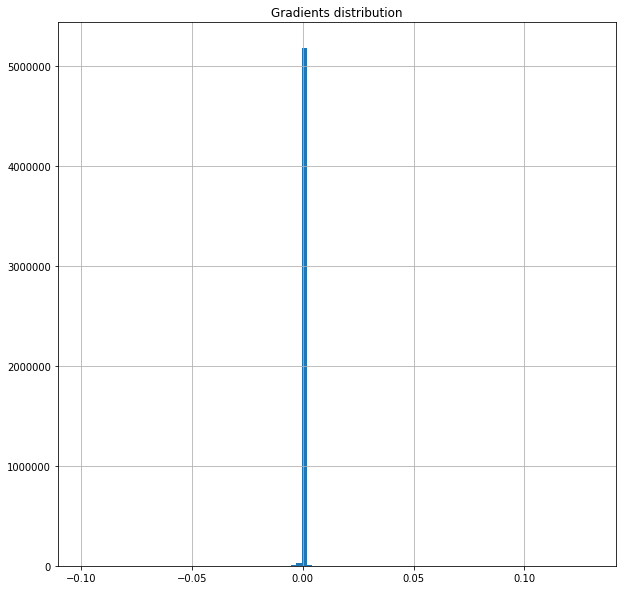

On iter 721 with training PPL: 313.4188537597656, training ACC 0.1627604216337204
On iter 722 with training PPL: 288.8010559082031, training ACC 0.1631944477558136
On iter 723 with training PPL: 287.05291748046875, training ACC 0.16796875
On iter 724 with training PPL: 341.6612854003906, training ACC 0.1592881977558136
On iter 725 with training PPL: 327.55157470703125, training ACC 0.1549479216337204
On iter 726 with training PPL: 301.0342102050781, training ACC 0.1657986044883728
On iter 727 with training PPL: 297.7859191894531, training ACC 0.1636284738779068
On iter 728 with training PPL: 332.6827697753906, training ACC 0.1560329794883728
On iter 729 with training PPL: 325.7657470703125, training ACC 0.1603732705116272
On iter 730 with training PPL: 303.2171936035156, training ACC 0.1697048544883728
On iter 731 with training PPL: 323.1634521484375, training ACC 0.1571180522441864
On iter 732 with training PPL: 337.82257080078125, training ACC 0.1501736044883728
On iter 733 with trai

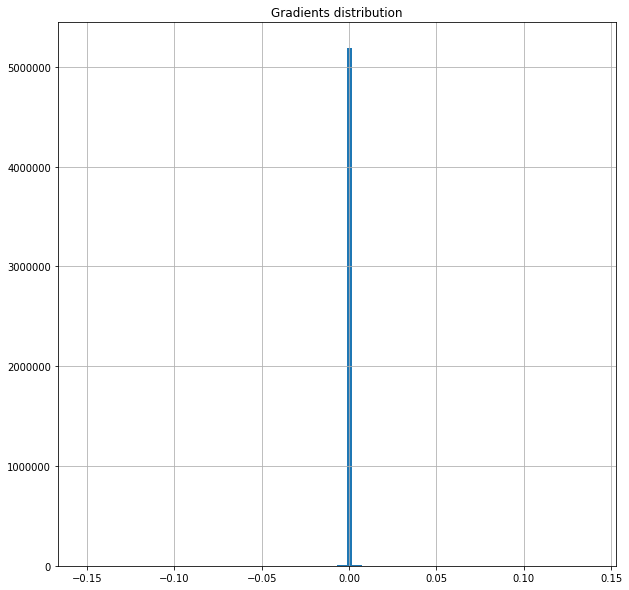

On iter 751 with training PPL: 328.17364501953125, training ACC 0.15234375
On iter 752 with training PPL: 300.5988464355469, training ACC 0.1686197966337204
On iter 753 with training PPL: 282.5791320800781, training ACC 0.169921875
On iter 754 with training PPL: 295.77008056640625, training ACC 0.1636284738779068
On iter 755 with training PPL: 303.8868103027344, training ACC 0.1584201455116272
On iter 756 with training PPL: 303.38470458984375, training ACC 0.1684027761220932
On iter 757 with training PPL: 316.48175048828125, training ACC 0.1603732705116272
On iter 758 with training PPL: 267.4484558105469, training ACC 0.1714409738779068
On iter 759 with training PPL: 309.91558837890625, training ACC 0.16015625
On iter 760 with training PPL: 305.67626953125, training ACC 0.1688368022441864
On iter 761 with training PPL: 283.7131042480469, training ACC 0.1634114533662796
On iter 762 with training PPL: 289.8800964355469, training ACC 0.1623263955116272
On iter 763 with training PPL: 280.9

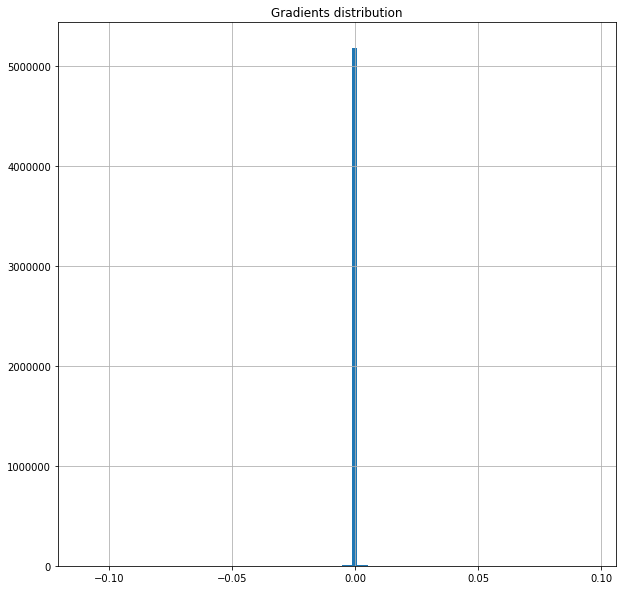

On iter 781 with training PPL: 299.7164611816406, training ACC 0.1629774272441864
On iter 782 with training PPL: 313.9221496582031, training ACC 0.1694878488779068
On iter 783 with training PPL: 271.9482421875, training ACC 0.1744791716337204
On iter 784 with training PPL: 302.1066589355469, training ACC 0.1634114533662796
On iter 785 with training PPL: 266.0723876953125, training ACC 0.1725260466337204
On iter 786 with training PPL: 262.6869201660156, training ACC 0.1781684011220932
On iter 787 with training PPL: 279.12921142578125, training ACC 0.1694878488779068
On iter 788 with training PPL: 297.5481872558594, training ACC 0.1668836772441864
On iter 789 with training PPL: 268.4861145019531, training ACC 0.17578125
On iter 790 with training PPL: 257.4757995605469, training ACC 0.1751302033662796
On iter 791 with training PPL: 290.1225280761719, training ACC 0.1697048544883728
On iter 792 with training PPL: 273.02838134765625, training ACC 0.1686197966337204
On iter 793 with training

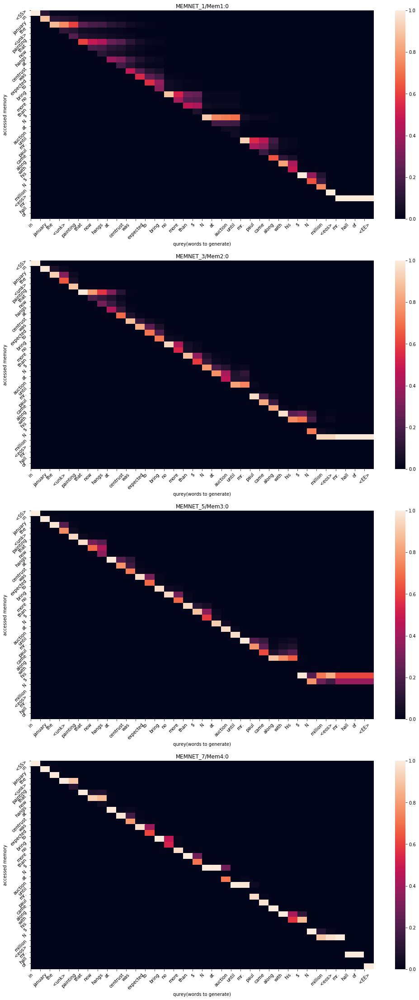

On iter 801 with training PPL: 304.455078125, training ACC 0.1677517294883728
On iter 802 with training PPL: 283.2894287109375, training ACC 0.1668836772441864
On iter 803 with training PPL: 280.0306701660156, training ACC 0.1712239533662796
On iter 804 with training PPL: 275.43597412109375, training ACC 0.1684027761220932
On iter 805 with training PPL: 263.7051086425781, training ACC 0.1746961772441864
On iter 806 with training PPL: 296.8343811035156, training ACC 0.1675347238779068
On iter 807 with training PPL: 273.4193420410156, training ACC 0.1742621511220932
On iter 808 with training PPL: 311.16522216796875, training ACC 0.1675347238779068
On iter 809 with training PPL: 282.79827880859375, training ACC 0.1681857705116272
On iter 810 with training PPL: 271.84375, training ACC 0.1649305522441864
	 validation PPL 286.32427978515625, validation acc 0.1666666716337204
shape of gradients is (5228544,), L2 norm of gradients is 2.7936434745788574, details:                   0
count  5.22

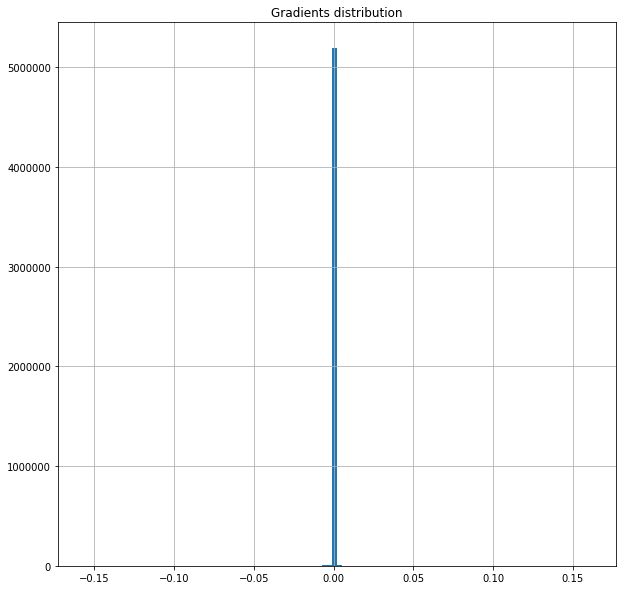

On iter 811 with training PPL: 290.26312255859375, training ACC 0.1703559011220932
On iter 812 with training PPL: 276.43609619140625, training ACC 0.1742621511220932
On iter 813 with training PPL: 297.626953125, training ACC 0.1558159738779068
On iter 814 with training PPL: 273.46551513671875, training ACC 0.1675347238779068
On iter 815 with training PPL: 292.2273864746094, training ACC 0.1666666716337204
On iter 816 with training PPL: 302.1138610839844, training ACC 0.169921875
On iter 817 with training PPL: 267.1703186035156, training ACC 0.1731770783662796
On iter 818 with training PPL: 286.41259765625, training ACC 0.1657986044883728
On iter 819 with training PPL: 274.2154235839844, training ACC 0.1766493022441864
On iter 820 with training PPL: 255.9715576171875, training ACC 0.1818576455116272
On iter 821 with training PPL: 265.9455261230469, training ACC 0.1781684011220932
On iter 822 with training PPL: 275.5412292480469, training ACC 0.1690538227558136
On iter 823 with training 

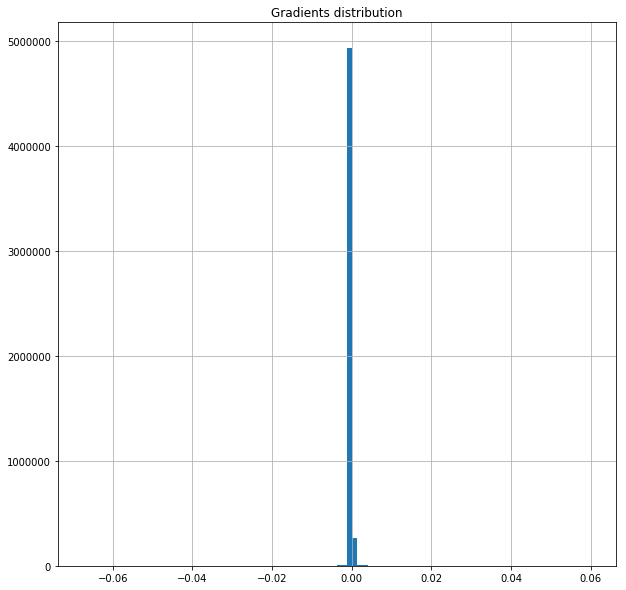

On iter 841 with training PPL: 287.7935485839844, training ACC 0.1640625
On iter 842 with training PPL: 275.4989318847656, training ACC 0.1781684011220932
On iter 843 with training PPL: 267.24127197265625, training ACC 0.1742621511220932
On iter 844 with training PPL: 284.50628662109375, training ACC 0.1701388955116272
On iter 845 with training PPL: 268.1961669921875, training ACC 0.1822916716337204
On iter 846 with training PPL: 286.1090393066406, training ACC 0.1740451455116272
On iter 847 with training PPL: 243.83258056640625, training ACC 0.1736111044883728
On iter 848 with training PPL: 254.2757110595703, training ACC 0.1783854216337204
On iter 849 with training PPL: 272.6092224121094, training ACC 0.17578125
On iter 850 with training PPL: 264.5542297363281, training ACC 0.1768663227558136
On iter 851 with training PPL: 282.51593017578125, training ACC 0.1694878488779068
On iter 852 with training PPL: 262.9526062011719, training ACC 0.1733940988779068
On iter 853 with training PPL

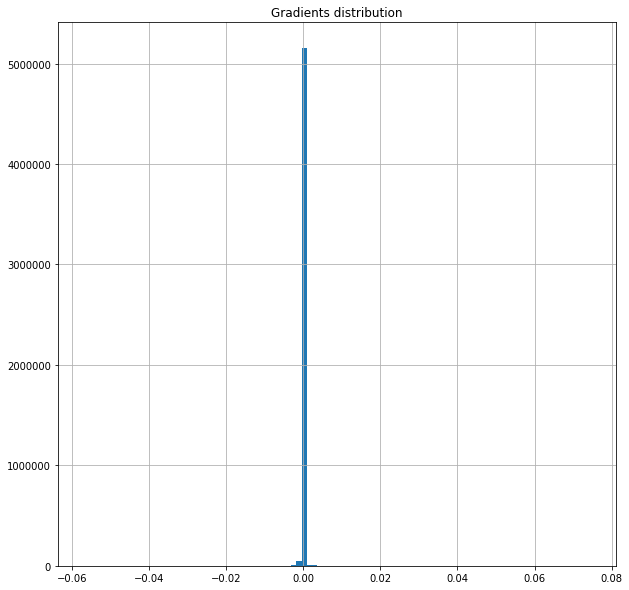

On iter 871 with training PPL: 255.20716857910156, training ACC 0.1764322966337204
On iter 872 with training PPL: 266.94744873046875, training ACC 0.1773003488779068
On iter 873 with training PPL: 255.81915283203125, training ACC 0.1794704794883728
On iter 874 with training PPL: 262.8480529785156, training ACC 0.1773003488779068
On iter 875 with training PPL: 274.49029541015625, training ACC 0.1707899272441864
On iter 876 with training PPL: 339.2895202636719, training ACC 0.1484375
On iter 877 with training PPL: 266.4925231933594, training ACC 0.1647135466337204
On iter 878 with training PPL: 271.9867858886719, training ACC 0.171875
On iter 879 with training PPL: 297.277587890625, training ACC 0.1586371511220932
On iter 880 with training PPL: 257.86492919921875, training ACC 0.17578125
On iter 881 with training PPL: 291.91082763671875, training ACC 0.177734375
On iter 882 with training PPL: 264.1872863769531, training ACC 0.1779513955116272
On iter 883 with training PPL: 268.3866577148

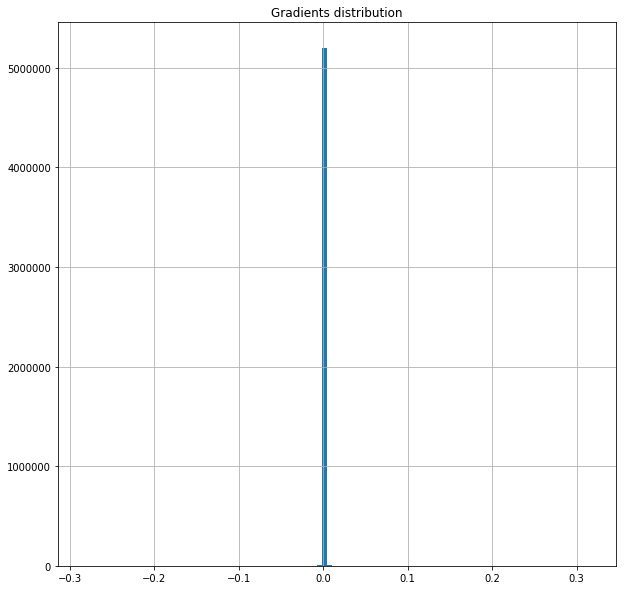

<SS> major cities <eos> new <unk> include burt hill <unk> <unk> associates a butler pa. architectural firm <eos> its radio series features such spots as <unk> evening wear for urban structures and building a place to <EE>


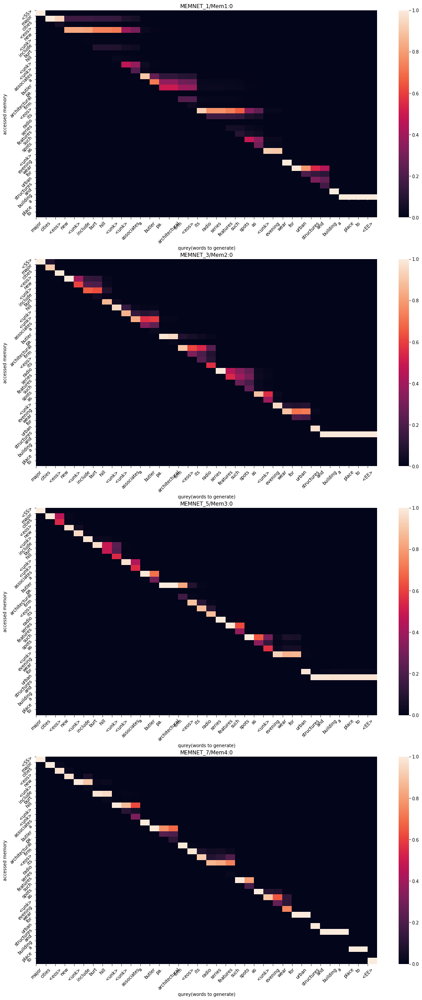

On iter 901 with training PPL: 382.48797607421875, training ACC 0.1328125
On iter 902 with training PPL: 449.09735107421875, training ACC 0.1321614533662796
On iter 903 with training PPL: 520.0089721679688, training ACC 0.1082899272441864
On iter 904 with training PPL: 699.8060302734375, training ACC 0.076171875
On iter 905 with training PPL: 517.8211669921875, training ACC 0.0965711772441864
On iter 906 with training PPL: 449.189453125, training ACC 0.1061197891831398
On iter 907 with training PPL: 411.3315734863281, training ACC 0.1354166716337204
On iter 908 with training PPL: 454.426513671875, training ACC 0.1182725727558136
On iter 909 with training PPL: 468.33966064453125, training ACC 0.1095920130610466
On iter 910 with training PPL: 471.0381774902344, training ACC 0.0870225727558136
On iter 911 with training PPL: 440.2382507324219, training ACC 0.119140625
On iter 912 with training PPL: 441.77398681640625, training ACC 0.1226128488779068
On iter 913 with training PPL: 393.46826

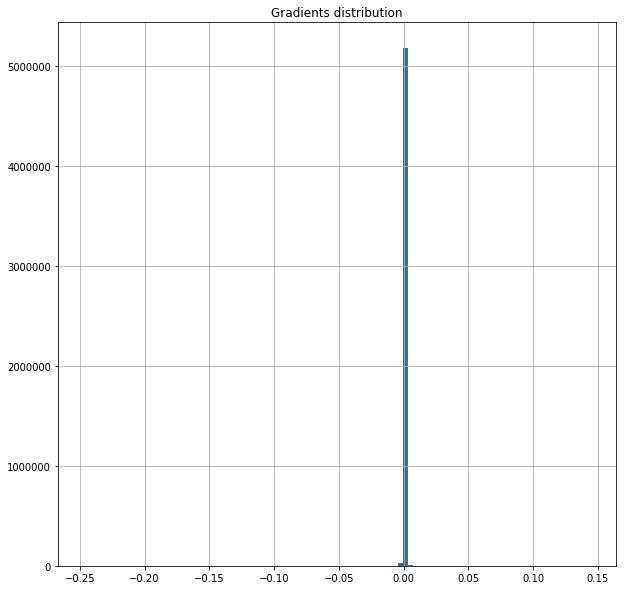

On iter 931 with training PPL: 322.416015625, training ACC 0.1616753488779068
On iter 932 with training PPL: 341.65625, training ACC 0.15625
On iter 933 with training PPL: 276.0618591308594, training ACC 0.1653645783662796
On iter 934 with training PPL: 292.3040466308594, training ACC 0.1686197966337204
On iter 935 with training PPL: 291.40570068359375, training ACC 0.1642795205116272
On iter 936 with training PPL: 306.1951599121094, training ACC 0.1603732705116272
On iter 937 with training PPL: 326.0813903808594, training ACC 0.1493055522441864
On iter 938 with training PPL: 318.0184020996094, training ACC 0.1599392294883728
On iter 939 with training PPL: 294.6165466308594, training ACC 0.162109375
On iter 940 with training PPL: 260.91448974609375, training ACC 0.1703559011220932
On iter 941 with training PPL: 336.6533203125, training ACC 0.1547309011220932
On iter 942 with training PPL: 295.5464782714844, training ACC 0.1636284738779068
On iter 943 with training PPL: 306.926208496093

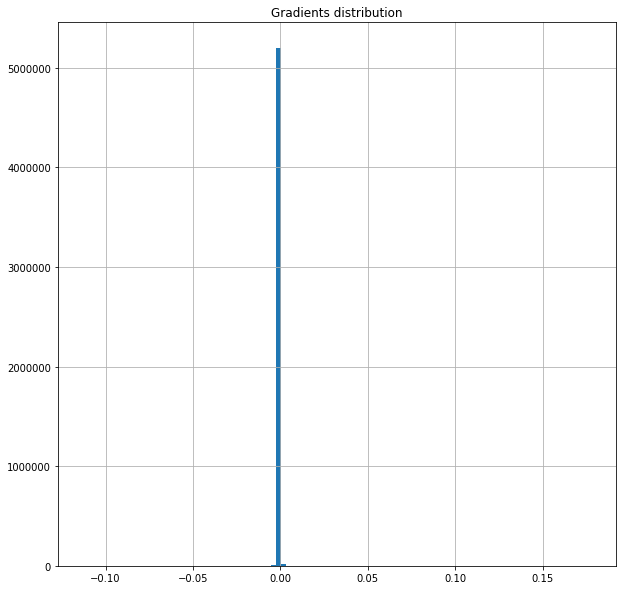

On iter 961 with training PPL: 268.5346374511719, training ACC 0.171875
On iter 962 with training PPL: 243.3621368408203, training ACC 0.1831597238779068
On iter 963 with training PPL: 256.5382995605469, training ACC 0.1809895783662796
On iter 964 with training PPL: 267.74127197265625, training ACC 0.1725260466337204
On iter 965 with training PPL: 272.09173583984375, training ACC 0.1781684011220932
On iter 966 with training PPL: 242.444580078125, training ACC 0.18359375
On iter 967 with training PPL: 259.40142822265625, training ACC 0.1794704794883728
On iter 968 with training PPL: 251.6267852783203, training ACC 0.1766493022441864
On iter 969 with training PPL: 292.62994384765625, training ACC 0.1595052033662796
On iter 970 with training PPL: 259.6214294433594, training ACC 0.1783854216337204
On iter 971 with training PPL: 267.2071533203125, training ACC 0.1727430522441864
On iter 972 with training PPL: 268.8404541015625, training ACC 0.1801215261220932
On iter 973 with training PPL: 

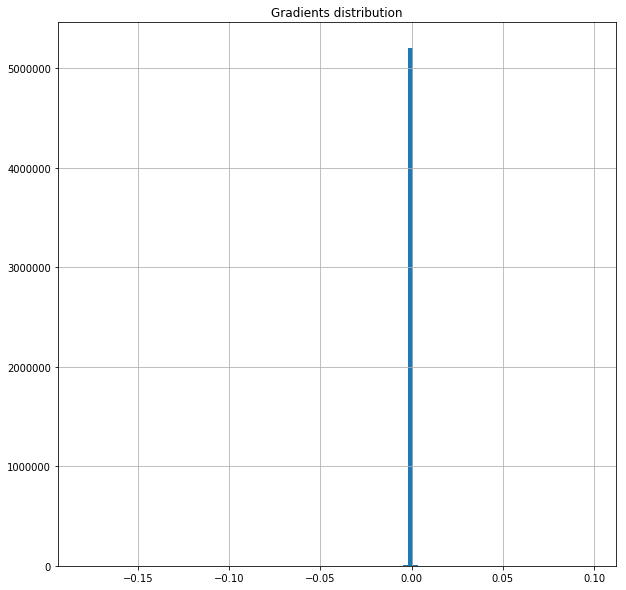

On iter 991 with training PPL: 261.2984924316406, training ACC 0.1764322966337204
On iter 992 with training PPL: 260.1444091796875, training ACC 0.171875
On iter 993 with training PPL: 235.13084411621094, training ACC 0.1901041716337204
On iter 994 with training PPL: 278.8899841308594, training ACC 0.166015625
On iter 995 with training PPL: 270.2430725097656, training ACC 0.1740451455116272
On iter 996 with training PPL: 283.98907470703125, training ACC 0.1766493022441864
On iter 997 with training PPL: 271.1903381347656, training ACC 0.1723090261220932
On iter 998 with training PPL: 228.5402069091797, training ACC 0.1853298544883728
On iter 999 with training PPL: 255.7615966796875, training ACC 0.1781684011220932
On iter 1000 with training PPL: 249.33677673339844, training ACC 0.1807725727558136
<SS> N planes is being <unk> and <unk> at shannon airport <eos> thanks to a new <unk> agreement and the ability of irish travel agents to issue aeroflot tickets tourists here are taking advanta

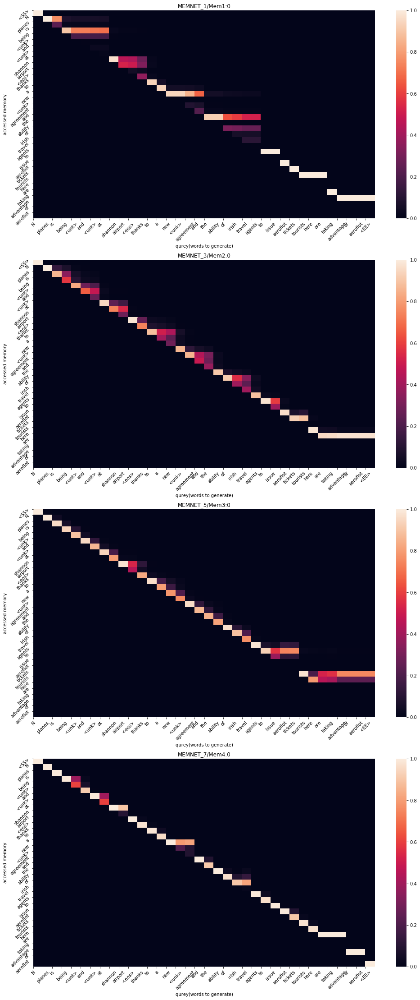

On iter 1001 with training PPL: 255.74513244628906, training ACC 0.1746961772441864
On iter 1002 with training PPL: 251.20933532714844, training ACC 0.1783854216337204
On iter 1003 with training PPL: 243.64639282226562, training ACC 0.1822916716337204
On iter 1004 with training PPL: 241.9361114501953, training ACC 0.1875
On iter 1005 with training PPL: 279.9853820800781, training ACC 0.1657986044883728
On iter 1006 with training PPL: 251.0110321044922, training ACC 0.1768663227558136
On iter 1007 with training PPL: 229.72084045410156, training ACC 0.1814236044883728
On iter 1008 with training PPL: 282.47821044921875, training ACC 0.1727430522441864
On iter 1009 with training PPL: 283.6236877441406, training ACC 0.1725260466337204
On iter 1010 with training PPL: 242.8719024658203, training ACC 0.1803385466337204
On iter 1011 with training PPL: 238.8299560546875, training ACC 0.1803385466337204
On iter 1012 with training PPL: 252.56837463378906, training ACC 0.1753472238779068
On iter 10

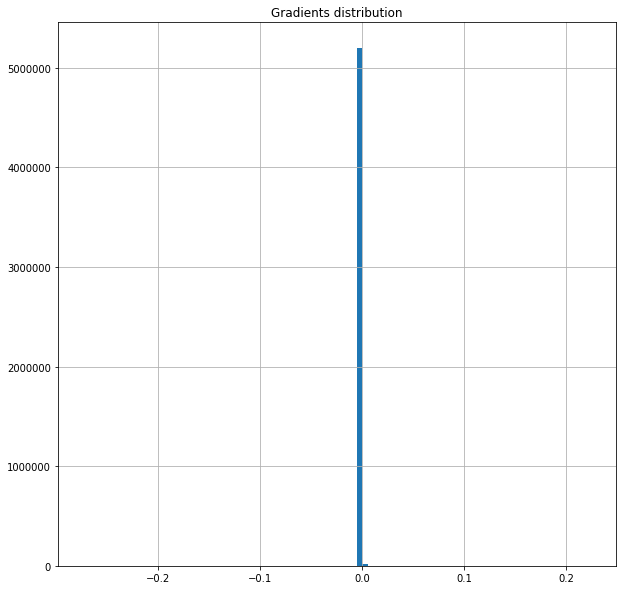

On iter 1021 with training PPL: 240.27745056152344, training ACC 0.1840277761220932
On iter 1022 with training PPL: 268.595703125, training ACC 0.1712239533662796
On iter 1023 with training PPL: 241.67288208007812, training ACC 0.1796875
On iter 1024 with training PPL: 255.500244140625, training ACC 0.1690538227558136
On iter 1025 with training PPL: 231.25698852539062, training ACC 0.1853298544883728
On iter 1026 with training PPL: 257.58056640625, training ACC 0.1749131977558136
On iter 1027 with training PPL: 264.6778869628906, training ACC 0.1753472238779068
On iter 1028 with training PPL: 277.7278747558594, training ACC 0.1803385466337204
On iter 1029 with training PPL: 265.25592041015625, training ACC 0.177734375
On iter 1030 with training PPL: 227.5660858154297, training ACC 0.1783854216337204
On iter 1031 with training PPL: 231.00294494628906, training ACC 0.1896701455116272
On iter 1032 with training PPL: 260.4282531738281, training ACC 0.1749131977558136
On iter 1033 with trai

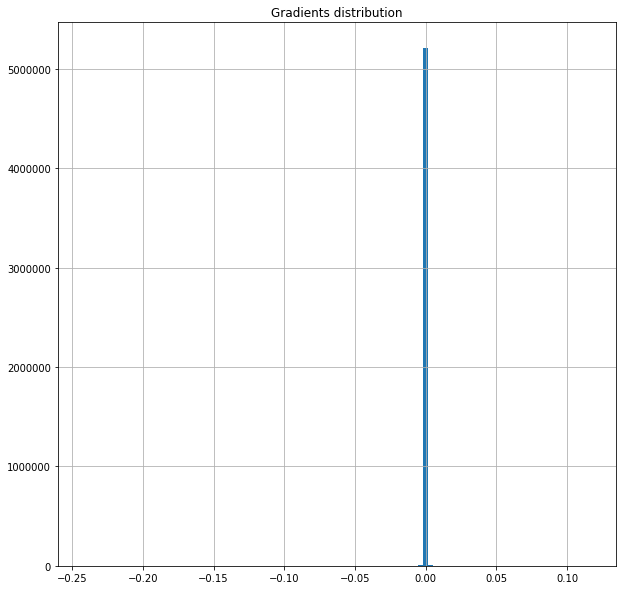

On iter 1051 with training PPL: 245.052734375, training ACC 0.1833767294883728
On iter 1052 with training PPL: 279.8089599609375, training ACC 0.1725260466337204
On iter 1053 with training PPL: 247.97869873046875, training ACC 0.1783854216337204
On iter 1054 with training PPL: 268.29388427734375, training ACC 0.173828125
On iter 1055 with training PPL: 222.55584716796875, training ACC 0.1916232705116272
On iter 1056 with training PPL: 282.8167724609375, training ACC 0.1636284738779068
On iter 1057 with training PPL: 242.48550415039062, training ACC 0.1803385466337204
On iter 1058 with training PPL: 263.6084289550781, training ACC 0.1742621511220932
On iter 1059 with training PPL: 246.3204345703125, training ACC 0.1822916716337204
On iter 1060 with training PPL: 270.2300720214844, training ACC 0.1807725727558136
On iter 1061 with training PPL: 244.75494384765625, training ACC 0.185546875
On iter 1062 with training PPL: 256.95306396484375, training ACC 0.1788194477558136
On iter 1063 wit

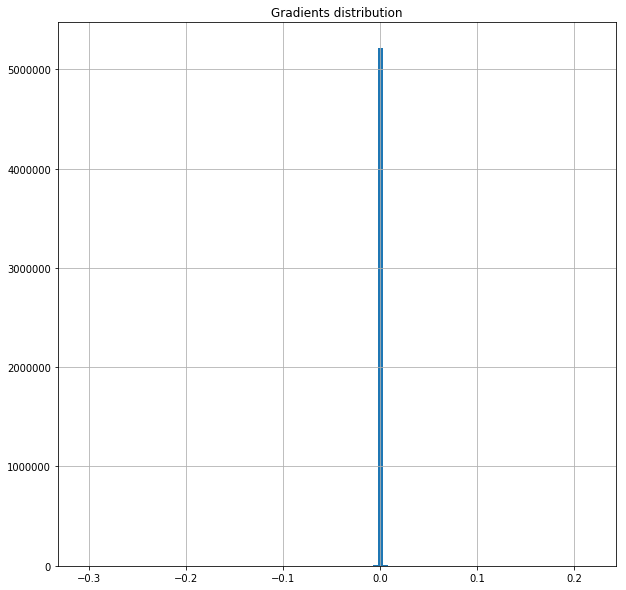

On iter 1081 with training PPL: 227.66127014160156, training ACC 0.19140625
On iter 1082 with training PPL: 227.0655059814453, training ACC 0.1892361044883728
On iter 1083 with training PPL: 261.3357238769531, training ACC 0.173828125
On iter 1084 with training PPL: 246.54452514648438, training ACC 0.1792534738779068
On iter 1085 with training PPL: 242.72348022460938, training ACC 0.1775173544883728
On iter 1086 with training PPL: 239.89645385742188, training ACC 0.1859809011220932
On iter 1087 with training PPL: 245.4210968017578, training ACC 0.1801215261220932
On iter 1088 with training PPL: 251.7749786376953, training ACC 0.1783854216337204
On iter 1089 with training PPL: 239.12635803222656, training ACC 0.181640625
On iter 1090 with training PPL: 270.37017822265625, training ACC 0.1703559011220932
On iter 1091 with training PPL: 228.5104522705078, training ACC 0.1937934011220932
On iter 1092 with training PPL: 265.45672607421875, training ACC 0.1742621511220932
On iter 1093 with t

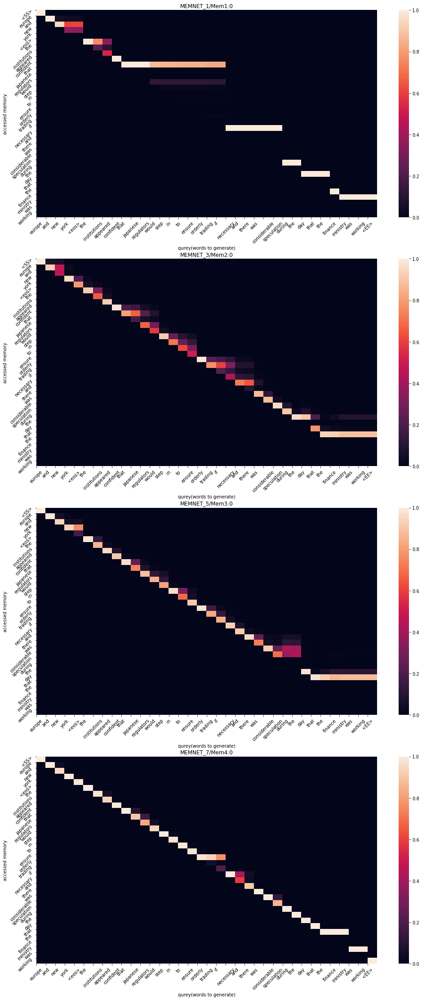

On iter 1101 with training PPL: 220.7813720703125, training ACC 0.1829427033662796
On iter 1102 with training PPL: 270.350830078125, training ACC 0.1755642294883728
On iter 1103 with training PPL: 236.17776489257812, training ACC 0.1840277761220932
On iter 1104 with training PPL: 230.0242462158203, training ACC 0.1848958283662796
On iter 1105 with training PPL: 252.48936462402344, training ACC 0.1729600727558136
On iter 1106 with training PPL: 230.2662353515625, training ACC 0.1881510466337204
On iter 1107 with training PPL: 258.6028747558594, training ACC 0.1690538227558136
On iter 1108 with training PPL: 215.0680389404297, training ACC 0.1905381977558136
On iter 1109 with training PPL: 252.63027954101562, training ACC 0.1809895783662796
On iter 1110 with training PPL: 243.86386108398438, training ACC 0.1744791716337204
	 validation PPL 269.4289855957031, validation acc 0.1729600727558136
shape of gradients is (5228544,), L2 norm of gradients is 2.887920379638672, details:            

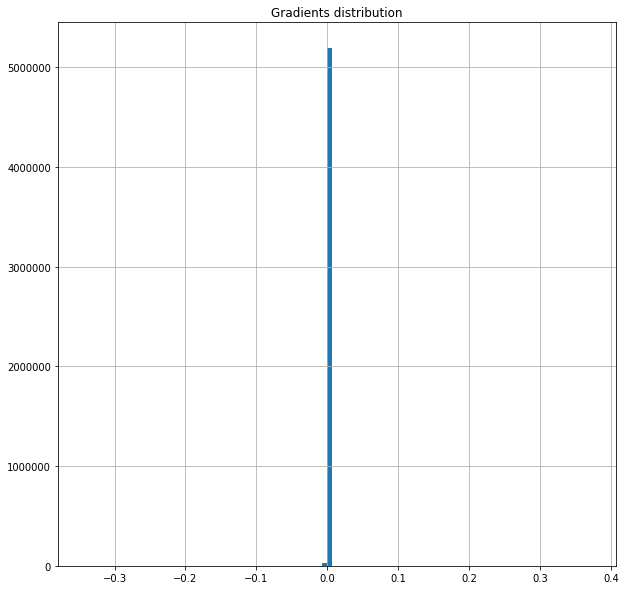

On iter 1111 with training PPL: 242.65382385253906, training ACC 0.1851128488779068
On iter 1112 with training PPL: 211.1956787109375, training ACC 0.1970486044883728
On iter 1113 with training PPL: 243.25076293945312, training ACC 0.1716579794883728
On iter 1114 with training PPL: 240.21240234375, training ACC 0.1822916716337204
On iter 1115 with training PPL: 213.64881896972656, training ACC 0.1929253488779068
On iter 1116 with training PPL: 222.71934509277344, training ACC 0.1987847238779068
On iter 1117 with training PPL: 255.57870483398438, training ACC 0.1796875
On iter 1118 with training PPL: 230.21144104003906, training ACC 0.1831597238779068
On iter 1119 with training PPL: 235.13621520996094, training ACC 0.1866319477558136
On iter 1120 with training PPL: 230.8787384033203, training ACC 0.1940104216337204
On iter 1121 with training PPL: 208.8538360595703, training ACC 0.1927083283662796
On iter 1122 with training PPL: 258.0388488769531, training ACC 0.1749131977558136
On iter 

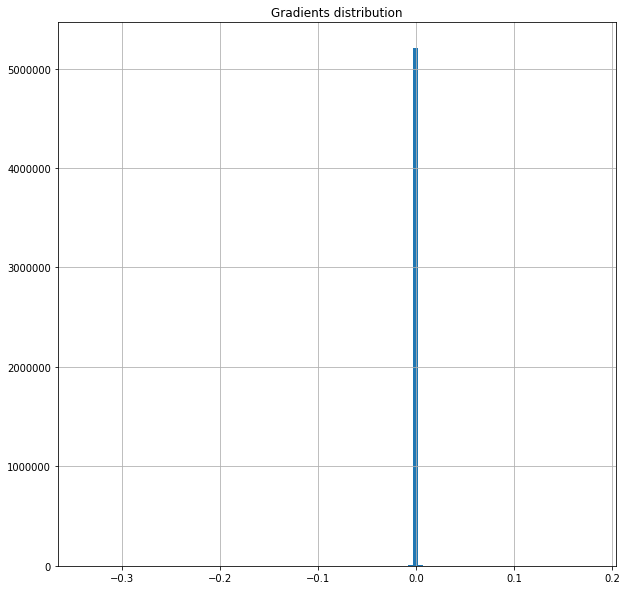

On iter 1141 with training PPL: 226.46571350097656, training ACC 0.1859809011220932
On iter 1142 with training PPL: 232.8125, training ACC 0.193359375
On iter 1143 with training PPL: 266.45758056640625, training ACC 0.1664496511220932
On iter 1144 with training PPL: 244.46498107910156, training ACC 0.1775173544883728
On iter 1145 with training PPL: 226.37449645996094, training ACC 0.1859809011220932
On iter 1146 with training PPL: 234.0542755126953, training ACC 0.1844618022441864
On iter 1147 with training PPL: 247.29322814941406, training ACC 0.1825086772441864
On iter 1148 with training PPL: 256.1874694824219, training ACC 0.1799045205116272
On iter 1149 with training PPL: 238.0181121826172, training ACC 0.1859809011220932
On iter 1150 with training PPL: 247.4609832763672, training ACC 0.1820746511220932
On iter 1151 with training PPL: 228.3087615966797, training ACC 0.1803385466337204
On iter 1152 with training PPL: 259.1342468261719, training ACC 0.1725260466337204
On iter 1153 wi

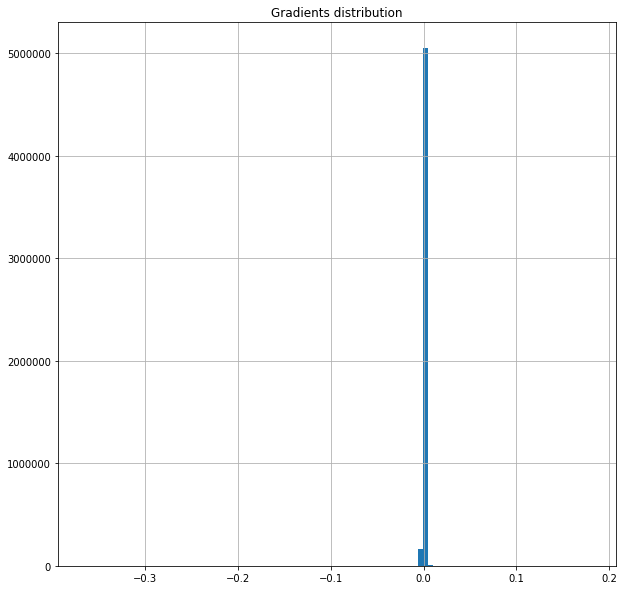

On iter 1171 with training PPL: 234.02459716796875, training ACC 0.1833767294883728
On iter 1172 with training PPL: 211.94827270507812, training ACC 0.1920572966337204
On iter 1173 with training PPL: 256.8583984375, training ACC 0.1770833283662796
On iter 1174 with training PPL: 218.63516235351562, training ACC 0.1885850727558136
On iter 1175 with training PPL: 231.9250946044922, training ACC 0.1870659738779068
On iter 1176 with training PPL: 241.37252807617188, training ACC 0.1833767294883728
On iter 1177 with training PPL: 215.3532257080078, training ACC 0.1979166716337204
On iter 1178 with training PPL: 240.4418182373047, training ACC 0.1888020783662796
On iter 1179 with training PPL: 239.03321838378906, training ACC 0.1872829794883728
On iter 1180 with training PPL: 229.79490661621094, training ACC 0.1929253488779068
On iter 1181 with training PPL: 242.7540283203125, training ACC 0.1770833283662796
On iter 1182 with training PPL: 233.47152709960938, training ACC 0.1861979216337204


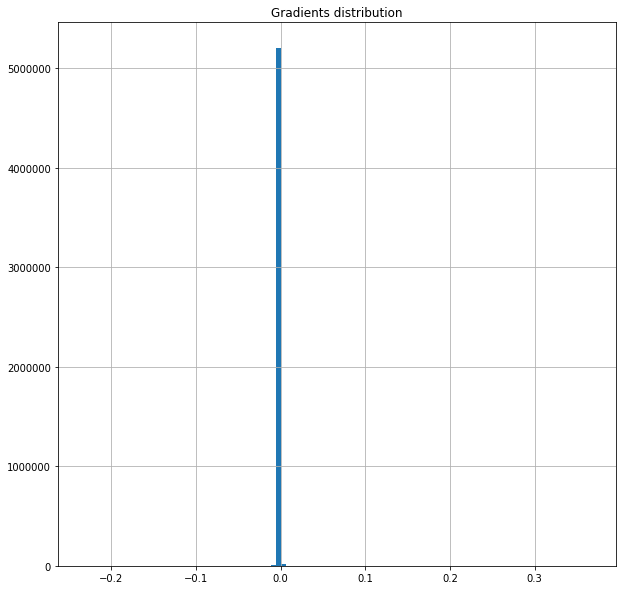

<SS> N above regular <unk> rates <eos> we were able to get advertisers to use their promotion budget for this because they get a chance to do <unk> says ms. <unk> <eos> and we were able <EE>


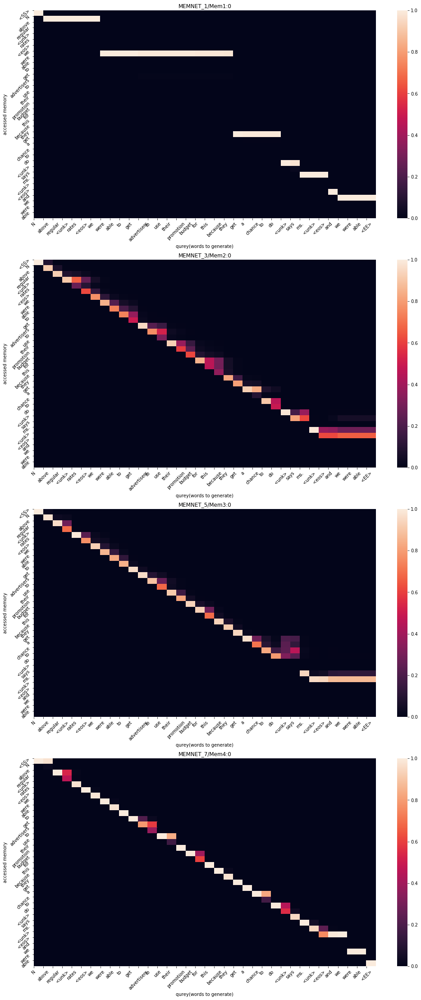

On iter 1201 with training PPL: 204.1922149658203, training ACC 0.1968315988779068
On iter 1202 with training PPL: 235.46620178222656, training ACC 0.1842447966337204
On iter 1203 with training PPL: 247.255859375, training ACC 0.1814236044883728
On iter 1204 with training PPL: 255.94178771972656, training ACC 0.1714409738779068
On iter 1205 with training PPL: 222.7383575439453, training ACC 0.1903211772441864
On iter 1206 with training PPL: 248.02635192871094, training ACC 0.1746961772441864
On iter 1207 with training PPL: 211.58970642089844, training ACC 0.1944444477558136
On iter 1208 with training PPL: 231.37567138671875, training ACC 0.1942274272441864
On iter 1209 with training PPL: 203.97373962402344, training ACC 0.1946614533662796
On iter 1210 with training PPL: 216.66815185546875, training ACC 0.1861979216337204
On iter 1211 with training PPL: 212.12461853027344, training ACC 0.1896701455116272
On iter 1212 with training PPL: 221.66864013671875, training ACC 0.1842447966337204

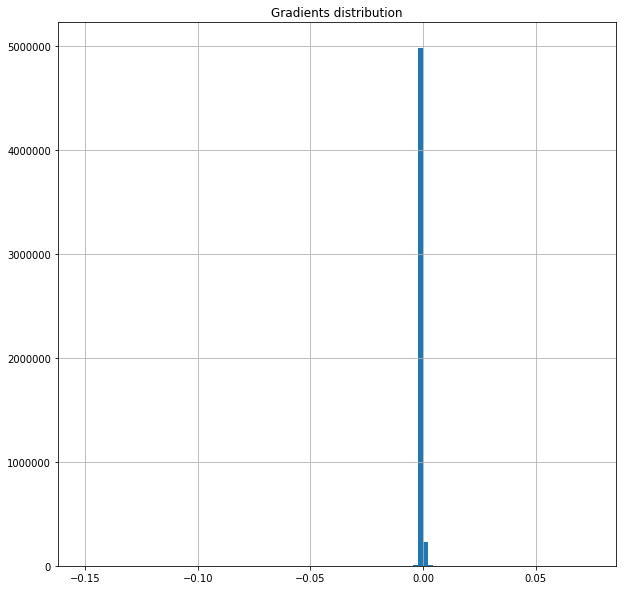

On iter 1231 with training PPL: 224.67474365234375, training ACC 0.1929253488779068
On iter 1232 with training PPL: 221.83380126953125, training ACC 0.185546875
On iter 1233 with training PPL: 218.68540954589844, training ACC 0.1950954794883728
On iter 1234 with training PPL: 220.92869567871094, training ACC 0.1931423544883728
On iter 1235 with training PPL: 232.83204650878906, training ACC 0.1812065988779068
On iter 1236 with training PPL: 231.74600219726562, training ACC 0.1861979216337204
On iter 1237 with training PPL: 215.15513610839844, training ACC 0.1955295205116272
On iter 1238 with training PPL: 225.0501251220703, training ACC 0.1851128488779068
On iter 1239 with training PPL: 218.25070190429688, training ACC 0.1851128488779068
On iter 1240 with training PPL: 223.81695556640625, training ACC 0.19140625
On iter 1241 with training PPL: 218.6663360595703, training ACC 0.193359375
On iter 1242 with training PPL: 222.680908203125, training ACC 0.189453125
On iter 1243 with trainin

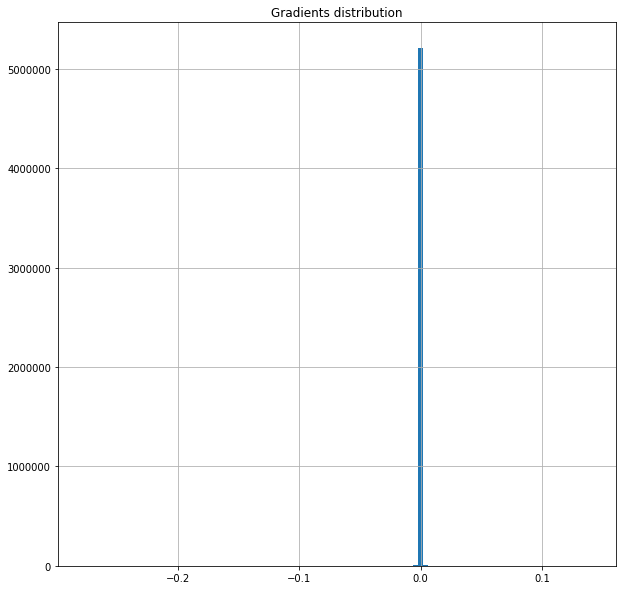

On iter 1261 with training PPL: 235.57949829101562, training ACC 0.1883680522441864
On iter 1262 with training PPL: 227.33084106445312, training ACC 0.1920572966337204
On iter 1263 with training PPL: 224.8006591796875, training ACC 0.185546875
On iter 1264 with training PPL: 210.22740173339844, training ACC 0.1931423544883728
On iter 1265 with training PPL: 227.2533416748047, training ACC 0.1963975727558136
On iter 1266 with training PPL: 216.71868896484375, training ACC 0.1918402761220932
On iter 1267 with training PPL: 236.19073486328125, training ACC 0.1846788227558136
On iter 1268 with training PPL: 199.38070678710938, training ACC 0.1990017294883728
On iter 1269 with training PPL: 221.8298797607422, training ACC 0.1996527761220932
On iter 1270 with training PPL: 232.70362854003906, training ACC 0.1848958283662796
On iter 1271 with training PPL: 228.19338989257812, training ACC 0.1896701455116272
On iter 1272 with training PPL: 214.39268493652344, training ACC 0.1881510466337204
On

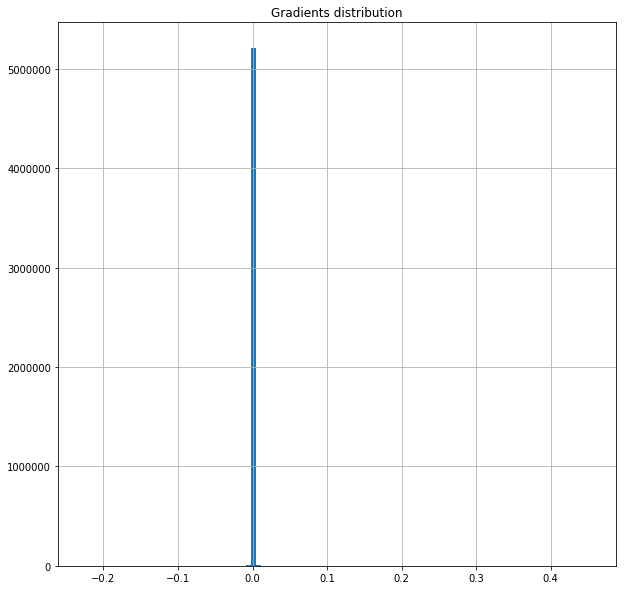

On iter 1291 with training PPL: 232.16497802734375, training ACC 0.1994357705116272
On iter 1292 with training PPL: 205.21438598632812, training ACC 0.1957465261220932
On iter 1293 with training PPL: 221.14308166503906, training ACC 0.1853298544883728
On iter 1294 with training PPL: 230.3423309326172, training ACC 0.1890190988779068
On iter 1295 with training PPL: 211.97384643554688, training ACC 0.1890190988779068
On iter 1296 with training PPL: 221.56971740722656, training ACC 0.19140625
On iter 1297 with training PPL: 232.09291076660156, training ACC 0.1890190988779068
On iter 1298 with training PPL: 226.80418395996094, training ACC 0.1885850727558136
On iter 1299 with training PPL: 214.927490234375, training ACC 0.1948784738779068
On iter 1300 with training PPL: 209.419189453125, training ACC 0.193359375
<SS> $ N for <unk> and $ N for <unk> <eos> it 's a good indication that level of profitability has peaked for the industry says <unk> <unk> metals analyst with <unk> ball & <unk> i

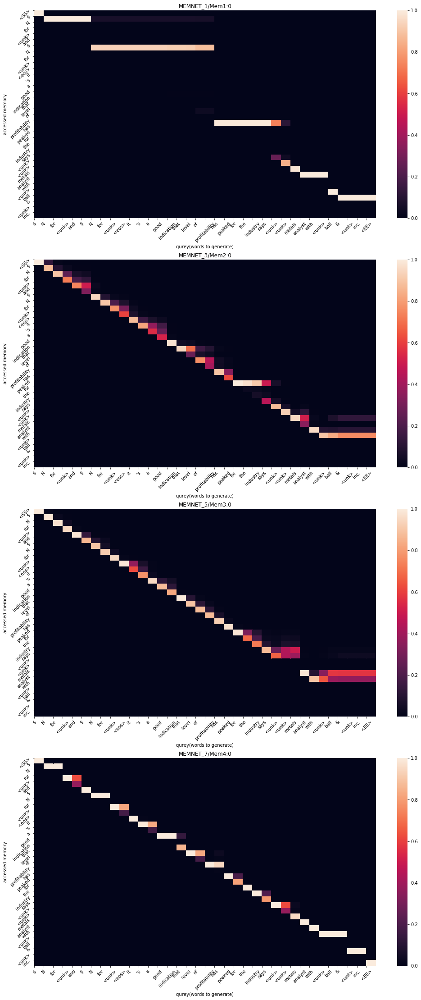

On iter 1301 with training PPL: 242.0542755126953, training ACC 0.1905381977558136
On iter 1302 with training PPL: 203.66583251953125, training ACC 0.1985677033662796
On iter 1303 with training PPL: 205.92013549804688, training ACC 0.1942274272441864
On iter 1304 with training PPL: 218.77658081054688, training ACC 0.1944444477558136
On iter 1305 with training PPL: 216.7941436767578, training ACC 0.1948784738779068
On iter 1306 with training PPL: 225.08383178710938, training ACC 0.1877170205116272
On iter 1307 with training PPL: 209.88754272460938, training ACC 0.1979166716337204
On iter 1308 with training PPL: 182.57525634765625, training ACC 0.2074652761220932
On iter 1309 with training PPL: 213.44158935546875, training ACC 0.1957465261220932
On iter 1310 with training PPL: 202.68771362304688, training ACC 0.1881510466337204
On iter 1311 with training PPL: 229.73573303222656, training ACC 0.1885850727558136
On iter 1312 with training PPL: 206.4308624267578, training ACC 0.194010421633

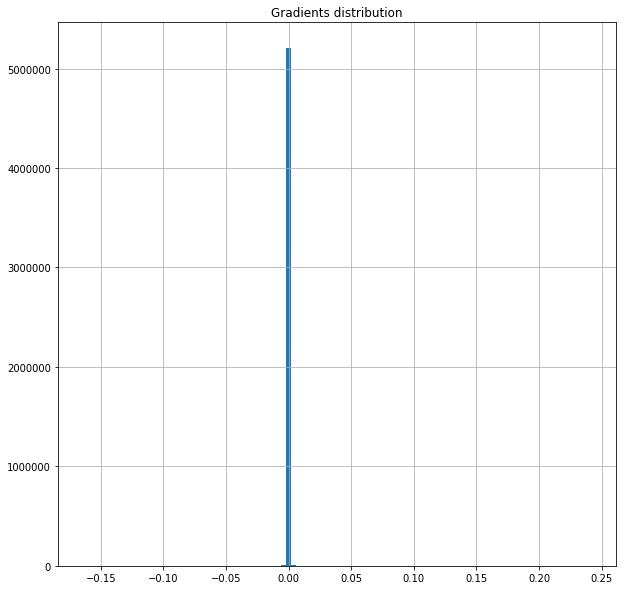

On iter 1321 with training PPL: 196.1558837890625, training ACC 0.1879340261220932
On iter 1322 with training PPL: 222.874755859375, training ACC 0.1931423544883728
On iter 1323 with training PPL: 219.067626953125, training ACC 0.1818576455116272
On iter 1324 with training PPL: 228.92926025390625, training ACC 0.1764322966337204
On iter 1325 with training PPL: 204.32749938964844, training ACC 0.1981336772441864
On iter 1326 with training PPL: 183.71701049804688, training ACC 0.2029079794883728
On iter 1327 with training PPL: 216.95669555664062, training ACC 0.1898871511220932
On iter 1328 with training PPL: 215.27212524414062, training ACC 0.19140625
On iter 1329 with training PPL: 195.4769744873047, training ACC 0.201171875
On iter 1330 with training PPL: 245.14259338378906, training ACC 0.1868489533662796
On iter 1331 with training PPL: 202.9306640625, training ACC 0.19921875
On iter 1332 with training PPL: 234.45986938476562, training ACC 0.1825086772441864
On iter 1333 with trainin

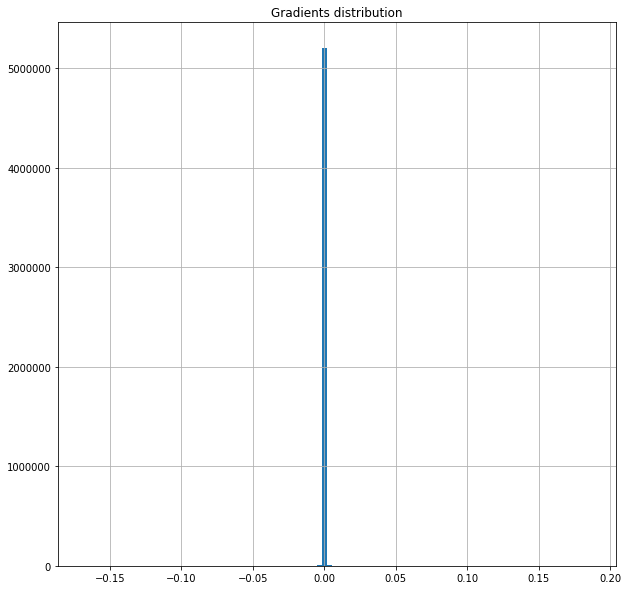

On iter 1351 with training PPL: 214.62425231933594, training ACC 0.19140625
On iter 1352 with training PPL: 198.06394958496094, training ACC 0.1905381977558136
On iter 1353 with training PPL: 200.47616577148438, training ACC 0.1981336772441864
On iter 1354 with training PPL: 214.2222137451172, training ACC 0.1950954794883728
On iter 1355 with training PPL: 230.05935668945312, training ACC 0.185546875
On iter 1356 with training PPL: 221.79783630371094, training ACC 0.1814236044883728
On iter 1357 with training PPL: 202.7288055419922, training ACC 0.1998697966337204
On iter 1358 with training PPL: 212.95098876953125, training ACC 0.1875
On iter 1359 with training PPL: 189.29527282714844, training ACC 0.2013888955116272
On iter 1360 with training PPL: 221.4881591796875, training ACC 0.1911892294883728
On iter 1361 with training PPL: 189.58441162109375, training ACC 0.2024739533662796
On iter 1362 with training PPL: 189.7259521484375, training ACC 0.2007378488779068
On iter 1363 with train

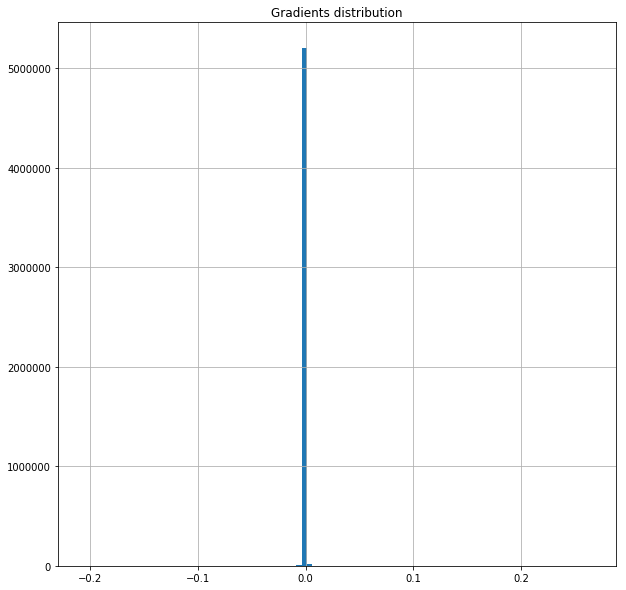

On iter 1381 with training PPL: 204.545654296875, training ACC 0.1987847238779068
On iter 1382 with training PPL: 201.20123291015625, training ACC 0.1961805522441864
On iter 1383 with training PPL: 206.8734130859375, training ACC 0.1963975727558136
On iter 1384 with training PPL: 204.87667846679688, training ACC 0.1805555522441864
On iter 1385 with training PPL: 209.68588256835938, training ACC 0.1959635466337204
On iter 1386 with training PPL: 195.50131225585938, training ACC 0.1937934011220932
On iter 1387 with training PPL: 199.3317413330078, training ACC 0.1901041716337204
On iter 1388 with training PPL: 194.00218200683594, training ACC 0.2059461772441864
On iter 1389 with training PPL: 223.56854248046875, training ACC 0.1870659738779068
On iter 1390 with training PPL: 212.80258178710938, training ACC 0.1931423544883728
On iter 1391 with training PPL: 222.40817260742188, training ACC 0.1870659738779068
On iter 1392 with training PPL: 216.7065887451172, training ACC 0.18250867724418

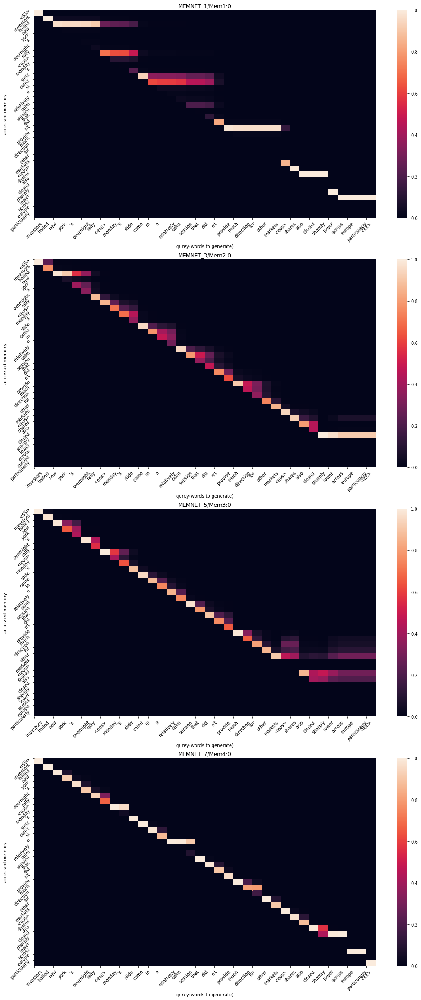

On iter 1401 with training PPL: 206.2868194580078, training ACC 0.1929253488779068
On iter 1402 with training PPL: 197.3153839111328, training ACC 0.1946614533662796
On iter 1403 with training PPL: 203.85414123535156, training ACC 0.1953125
On iter 1404 with training PPL: 206.11886596679688, training ACC 0.1998697966337204
On iter 1405 with training PPL: 209.51828002929688, training ACC 0.1937934011220932
On iter 1406 with training PPL: 206.33560180664062, training ACC 0.1922743022441864
On iter 1407 with training PPL: 215.10250854492188, training ACC 0.1875
On iter 1408 with training PPL: 200.62124633789062, training ACC 0.2037760466337204
On iter 1409 with training PPL: 204.28579711914062, training ACC 0.1942274272441864
On iter 1410 with training PPL: 194.38433837890625, training ACC 0.1946614533662796
	 validation PPL 225.27850341796875, validation acc 0.1931423544883728
shape of gradients is (5228544,), L2 norm of gradients is 2.2424027919769287, details:                   0
count

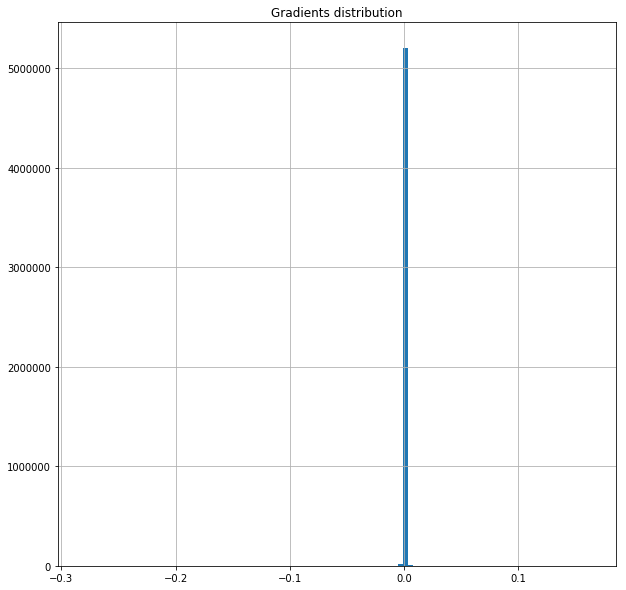

On iter 1411 with training PPL: 182.5883026123047, training ACC 0.2044270783662796
On iter 1412 with training PPL: 179.76531982421875, training ACC 0.2016059011220932
On iter 1413 with training PPL: 204.98533630371094, training ACC 0.1831597238779068
On iter 1414 with training PPL: 199.11590576171875, training ACC 0.1918402761220932
On iter 1415 with training PPL: 222.173828125, training ACC 0.1840277761220932
On iter 1416 with training PPL: 199.0190887451172, training ACC 0.2078993022441864
On iter 1417 with training PPL: 191.08929443359375, training ACC 0.1994357705116272
On iter 1418 with training PPL: 210.7629852294922, training ACC 0.1957465261220932
On iter 1419 with training PPL: 198.17408752441406, training ACC 0.1957465261220932
On iter 1420 with training PPL: 176.0927734375, training ACC 0.2063802033662796
On iter 1421 with training PPL: 197.29054260253906, training ACC 0.1976996511220932
On iter 1422 with training PPL: 210.5773468017578, training ACC 0.1918402761220932
On it

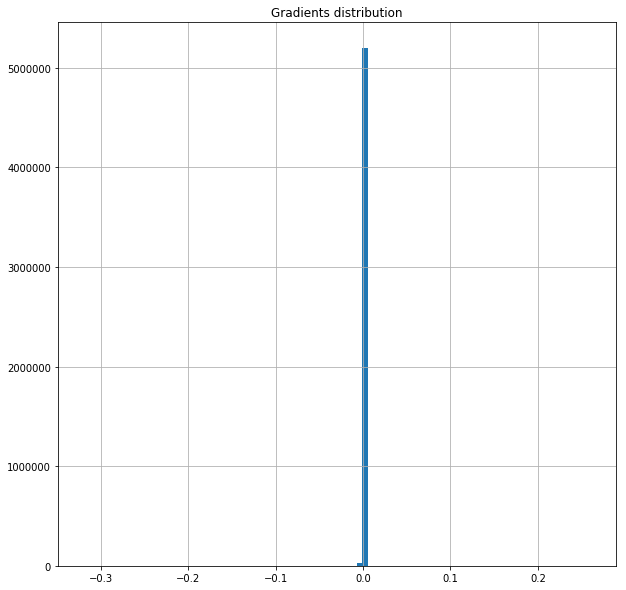

On iter 1441 with training PPL: 225.22091674804688, training ACC 0.1905381977558136
On iter 1442 with training PPL: 207.59933471679688, training ACC 0.1879340261220932
On iter 1443 with training PPL: 218.6556854248047, training ACC 0.1773003488779068
On iter 1444 with training PPL: 207.75985717773438, training ACC 0.1981336772441864
On iter 1445 with training PPL: 217.92811584472656, training ACC 0.193359375
On iter 1446 with training PPL: 206.63719177246094, training ACC 0.1948784738779068
On iter 1447 with training PPL: 192.36546325683594, training ACC 0.19921875
On iter 1448 with training PPL: 186.17950439453125, training ACC 0.2039930522441864
On iter 1449 with training PPL: 215.68455505371094, training ACC 0.1931423544883728
On iter 1450 with training PPL: 220.91036987304688, training ACC 0.1924913227558136
On iter 1451 with training PPL: 198.8718719482422, training ACC 0.19140625
On iter 1452 with training PPL: 194.2135009765625, training ACC 0.2087673544883728
On iter 1453 with 

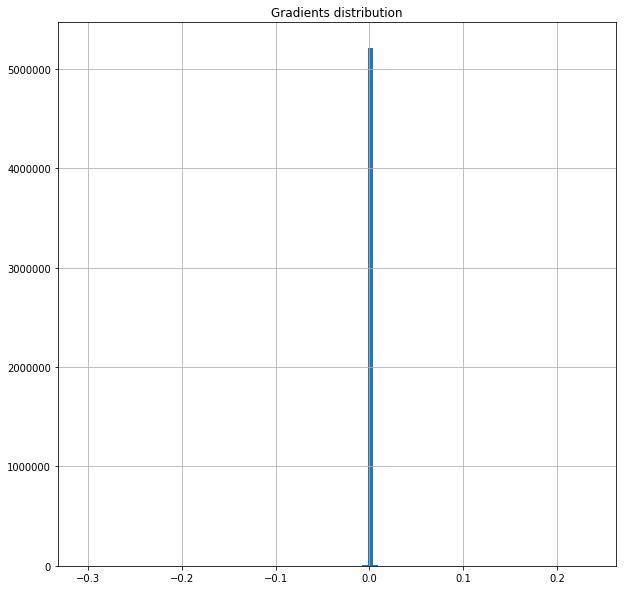

On iter 1471 with training PPL: 200.09854125976562, training ACC 0.1948784738779068
On iter 1472 with training PPL: 216.0240020751953, training ACC 0.1920572966337204
On iter 1473 with training PPL: 193.80599975585938, training ACC 0.2007378488779068
On iter 1474 with training PPL: 209.96412658691406, training ACC 0.193359375
On iter 1475 with training PPL: 190.9014129638672, training ACC 0.1996527761220932
On iter 1476 with training PPL: 183.48219299316406, training ACC 0.2057291716337204
On iter 1477 with training PPL: 201.84381103515625, training ACC 0.1970486044883728
On iter 1478 with training PPL: 191.94113159179688, training ACC 0.1996527761220932
On iter 1479 with training PPL: 205.54588317871094, training ACC 0.2026909738779068
On iter 1480 with training PPL: 197.40440368652344, training ACC 0.2037760466337204
On iter 1481 with training PPL: 198.04429626464844, training ACC 0.1981336772441864
On iter 1482 with training PPL: 205.46121215820312, training ACC 0.1918402761220932
O

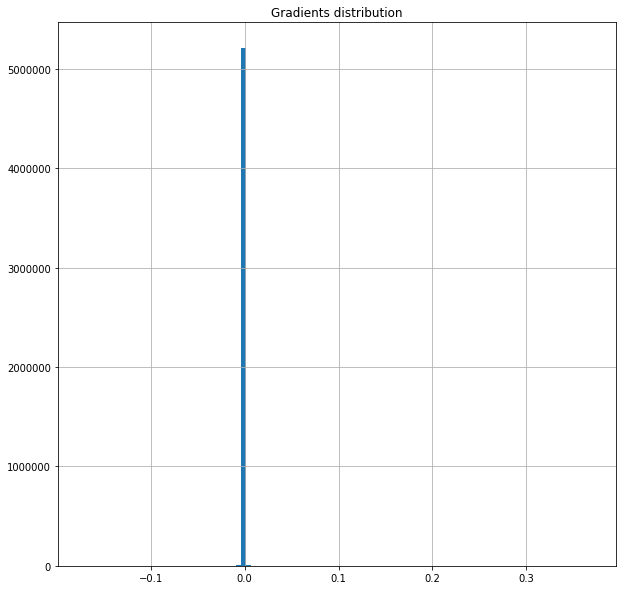

<SS> expecting about $ N for <unk> and $ N for <unk> <eos> it 's a good indication that level of profitability has peaked for the industry says <unk> <unk> metals analyst with <unk> ball & <EE>


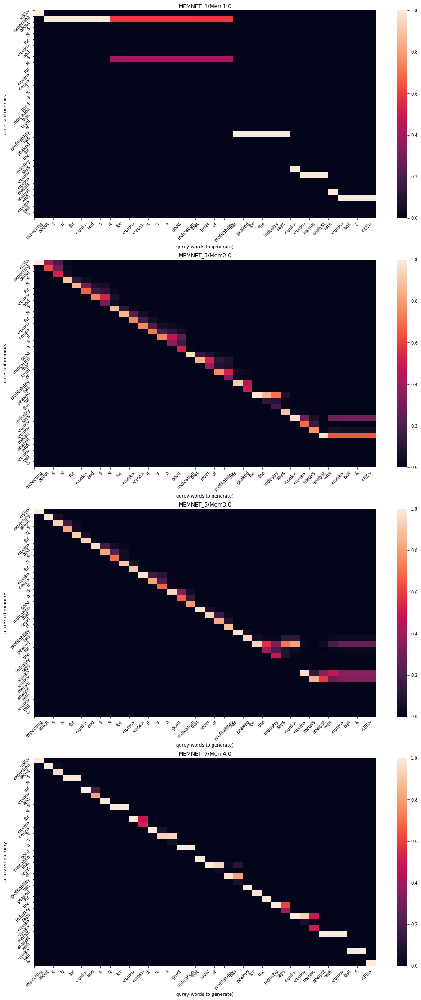

On iter 1501 with training PPL: 191.72206115722656, training ACC 0.197265625
On iter 1502 with training PPL: 206.39129638671875, training ACC 0.1946614533662796
On iter 1503 with training PPL: 212.10914611816406, training ACC 0.1974826455116272
On iter 1504 with training PPL: 186.30685424804688, training ACC 0.2046440988779068
On iter 1505 with training PPL: 184.6280517578125, training ACC 0.205078125
On iter 1506 with training PPL: 204.93344116210938, training ACC 0.1966145783662796
On iter 1507 with training PPL: 188.1554412841797, training ACC 0.2105034738779068
On iter 1508 with training PPL: 189.79734802246094, training ACC 0.2087673544883728
On iter 1509 with training PPL: 205.5148162841797, training ACC 0.1911892294883728
On iter 1510 with training PPL: 217.53204345703125, training ACC 0.1833767294883728
On iter 1511 with training PPL: 194.81964111328125, training ACC 0.2020399272441864
On iter 1512 with training PPL: 192.32464599609375, training ACC 0.2003038227558136
On iter 1

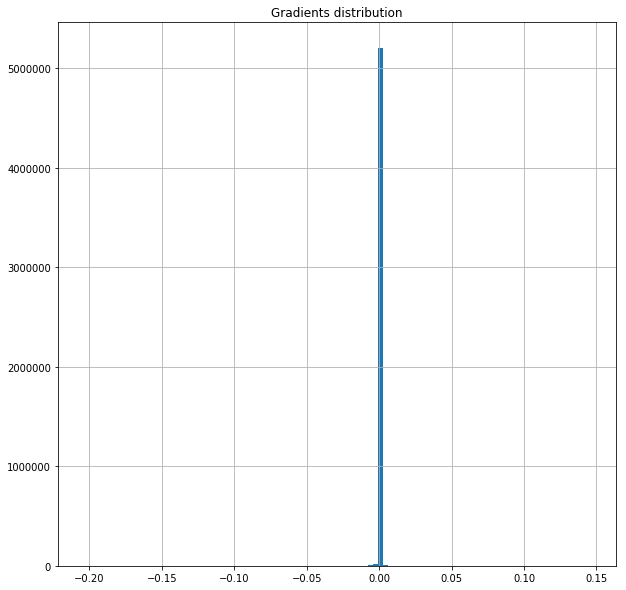

On iter 1531 with training PPL: 196.02366638183594, training ACC 0.1946614533662796
On iter 1532 with training PPL: 198.3411407470703, training ACC 0.1881510466337204
On iter 1533 with training PPL: 186.72378540039062, training ACC 0.2094184011220932
On iter 1534 with training PPL: 199.2765350341797, training ACC 0.2033420205116272
On iter 1535 with training PPL: 210.1274871826172, training ACC 0.1935763955116272
On iter 1536 with training PPL: 203.96615600585938, training ACC 0.1961805522441864
On iter 1537 with training PPL: 199.11192321777344, training ACC 0.1931423544883728
On iter 1538 with training PPL: 208.37777709960938, training ACC 0.1822916716337204
On iter 1539 with training PPL: 196.17440795898438, training ACC 0.1942274272441864
On iter 1540 with training PPL: 181.9488983154297, training ACC 0.2039930522441864
On iter 1541 with training PPL: 168.4925537109375, training ACC 0.2109375
On iter 1542 with training PPL: 191.7025909423828, training ACC 0.1981336772441864
On iter

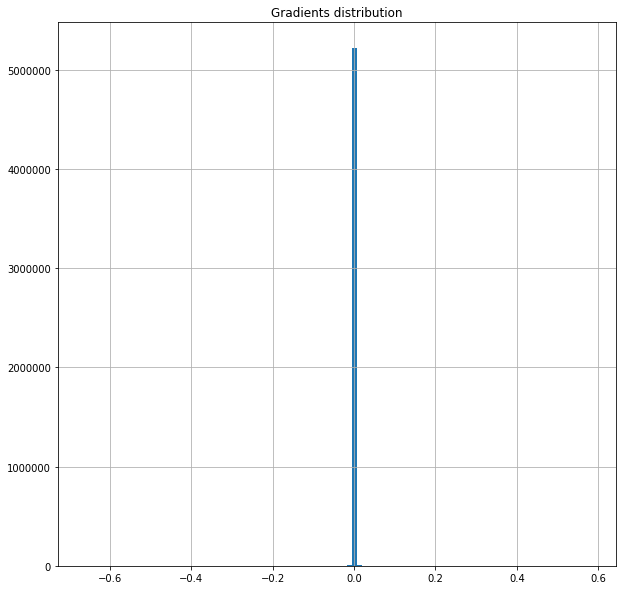

On iter 1561 with training PPL: 191.76907348632812, training ACC 0.1983506977558136
On iter 1562 with training PPL: 180.31236267089844, training ACC 0.2165798544883728
On iter 1563 with training PPL: 188.29212951660156, training ACC 0.2018229216337204
On iter 1564 with training PPL: 206.043212890625, training ACC 0.1898871511220932
On iter 1565 with training PPL: 205.89048767089844, training ACC 0.1907552033662796
On iter 1566 with training PPL: 197.57843017578125, training ACC 0.1959635466337204
On iter 1567 with training PPL: 188.29420471191406, training ACC 0.1996527761220932
On iter 1568 with training PPL: 195.07351684570312, training ACC 0.1970486044883728
On iter 1569 with training PPL: 196.890380859375, training ACC 0.1985677033662796
On iter 1570 with training PPL: 197.51626586914062, training ACC 0.2063802033662796
On iter 1571 with training PPL: 198.0679168701172, training ACC 0.1922743022441864
On iter 1572 with training PPL: 195.150634765625, training ACC 0.2037760466337204

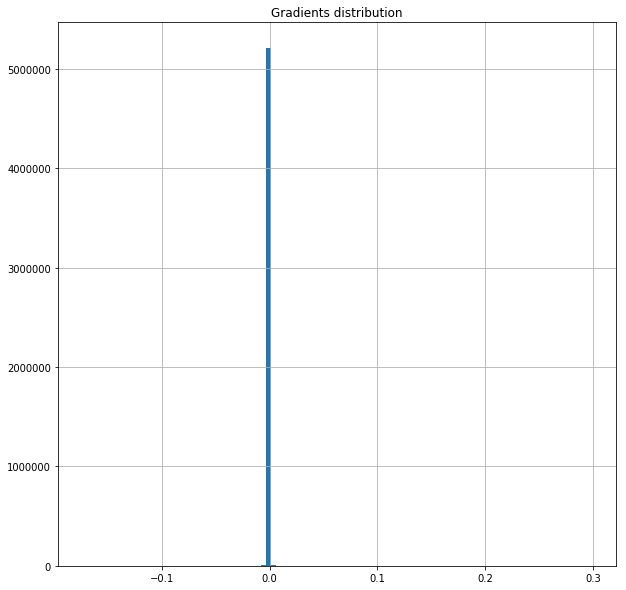

On iter 1591 with training PPL: 202.30381774902344, training ACC 0.1907552033662796
On iter 1592 with training PPL: 178.4591064453125, training ACC 0.2185329794883728
On iter 1593 with training PPL: 181.12928771972656, training ACC 0.2098524272441864
On iter 1594 with training PPL: 184.5775146484375, training ACC 0.2003038227558136
On iter 1595 with training PPL: 192.9501953125, training ACC 0.1996527761220932
On iter 1596 with training PPL: 189.2225341796875, training ACC 0.2005208283662796
On iter 1597 with training PPL: 190.588623046875, training ACC 0.1983506977558136
On iter 1598 with training PPL: 189.81399536132812, training ACC 0.2039930522441864
On iter 1599 with training PPL: 185.96142578125, training ACC 0.2003038227558136
On iter 1600 with training PPL: 197.04421997070312, training ACC 0.1918402761220932
<SS> is needed the secretary would have authority to extend the review period N days <eos> all the witnesses both congressmen and industry experts expressed support for the

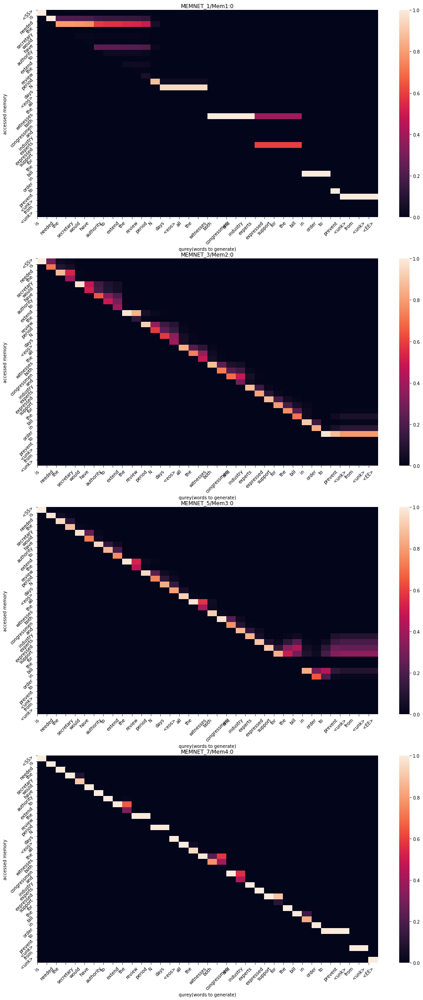

On iter 1601 with training PPL: 193.08033752441406, training ACC 0.2000868022441864
On iter 1602 with training PPL: 191.75753784179688, training ACC 0.1976996511220932
On iter 1603 with training PPL: 179.58575439453125, training ACC 0.2085503488779068
On iter 1604 with training PPL: 199.6016845703125, training ACC 0.1946614533662796
On iter 1605 with training PPL: 188.03562927246094, training ACC 0.2013888955116272
On iter 1606 with training PPL: 206.52037048339844, training ACC 0.1946614533662796
On iter 1607 with training PPL: 196.77662658691406, training ACC 0.2029079794883728
On iter 1608 with training PPL: 197.54225158691406, training ACC 0.1959635466337204
On iter 1609 with training PPL: 203.76901245117188, training ACC 0.1974826455116272
On iter 1610 with training PPL: 196.67428588867188, training ACC 0.1963975727558136
On iter 1611 with training PPL: 190.53773498535156, training ACC 0.1968315988779068
On iter 1612 with training PPL: 186.2771759033203, training ACC 0.203125
On i

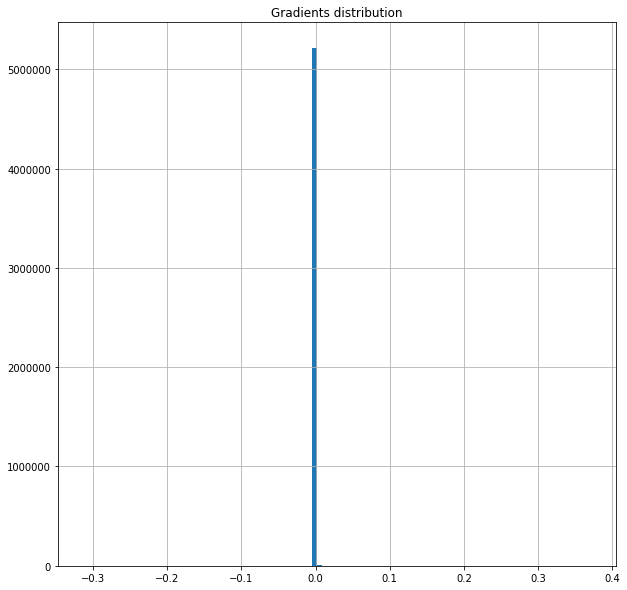

On iter 1621 with training PPL: 177.04129028320312, training ACC 0.2024739533662796
On iter 1622 with training PPL: 190.98190307617188, training ACC 0.2018229216337204
On iter 1623 with training PPL: 195.90724182128906, training ACC 0.1985677033662796
On iter 1624 with training PPL: 173.07040405273438, training ACC 0.20703125
On iter 1625 with training PPL: 187.69842529296875, training ACC 0.203125
On iter 1626 with training PPL: 196.21051025390625, training ACC 0.2039930522441864
On iter 1627 with training PPL: 193.66778564453125, training ACC 0.1957465261220932
On iter 1628 with training PPL: 216.48133850097656, training ACC 0.1853298544883728
On iter 1629 with training PPL: 182.84854125976562, training ACC 0.2044270783662796
On iter 1630 with training PPL: 180.8916778564453, training ACC 0.1957465261220932
On iter 1631 with training PPL: 190.63153076171875, training ACC 0.1979166716337204
On iter 1632 with training PPL: 178.9977264404297, training ACC 0.2020399272441864
On iter 1633

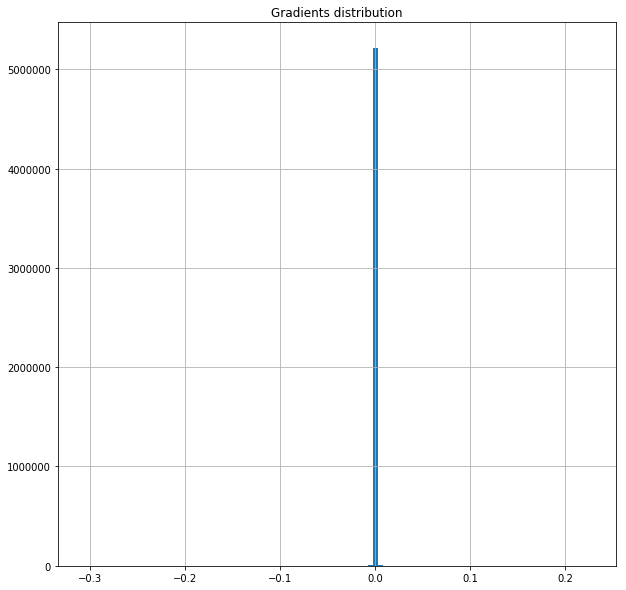

On iter 1651 with training PPL: 197.16583251953125, training ACC 0.1948784738779068
On iter 1652 with training PPL: 185.23959350585938, training ACC 0.208984375
On iter 1653 with training PPL: 197.42916870117188, training ACC 0.2016059011220932
On iter 1654 with training PPL: 178.19703674316406, training ACC 0.2059461772441864
On iter 1655 with training PPL: 185.7910614013672, training ACC 0.1998697966337204
On iter 1656 with training PPL: 178.71934509277344, training ACC 0.2135416716337204
On iter 1657 with training PPL: 189.29742431640625, training ACC 0.2059461772441864
On iter 1658 with training PPL: 187.06341552734375, training ACC 0.2042100727558136
On iter 1659 with training PPL: 181.4443817138672, training ACC 0.205078125
On iter 1660 with training PPL: 179.7542724609375, training ACC 0.2046440988779068
On iter 1661 with training PPL: 167.8020477294922, training ACC 0.2198350727558136
On iter 1662 with training PPL: 184.0526580810547, training ACC 0.2022569477558136
On iter 166

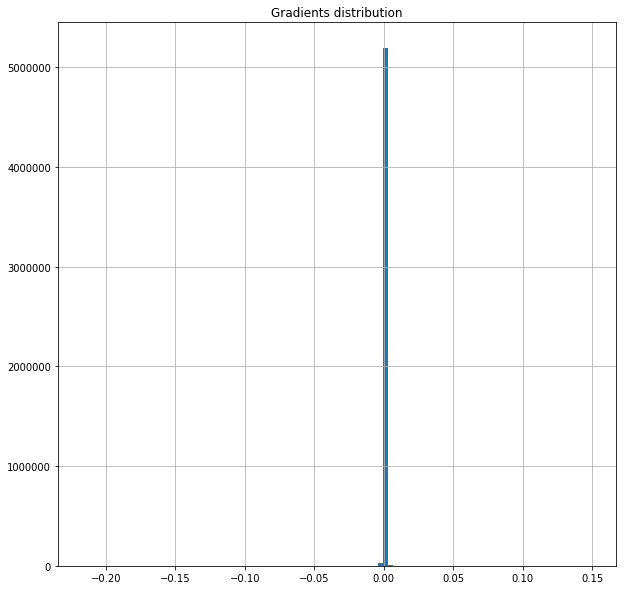

On iter 1681 with training PPL: 185.4720458984375, training ACC 0.2033420205116272
On iter 1682 with training PPL: 188.9855499267578, training ACC 0.1950954794883728
On iter 1683 with training PPL: 190.03868103027344, training ACC 0.2035590261220932
On iter 1684 with training PPL: 193.42202758789062, training ACC 0.2000868022441864
On iter 1685 with training PPL: 183.84242248535156, training ACC 0.2007378488779068
On iter 1686 with training PPL: 181.95339965820312, training ACC 0.19921875
On iter 1687 with training PPL: 181.2095489501953, training ACC 0.2003038227558136
On iter 1688 with training PPL: 172.71136474609375, training ACC 0.2042100727558136
On iter 1689 with training PPL: 180.47544860839844, training ACC 0.1987847238779068
On iter 1690 with training PPL: 181.31161499023438, training ACC 0.1990017294883728
On iter 1691 with training PPL: 181.18017578125, training ACC 0.2076822966337204
On iter 1692 with training PPL: 183.0959014892578, training ACC 0.2003038227558136
On iter

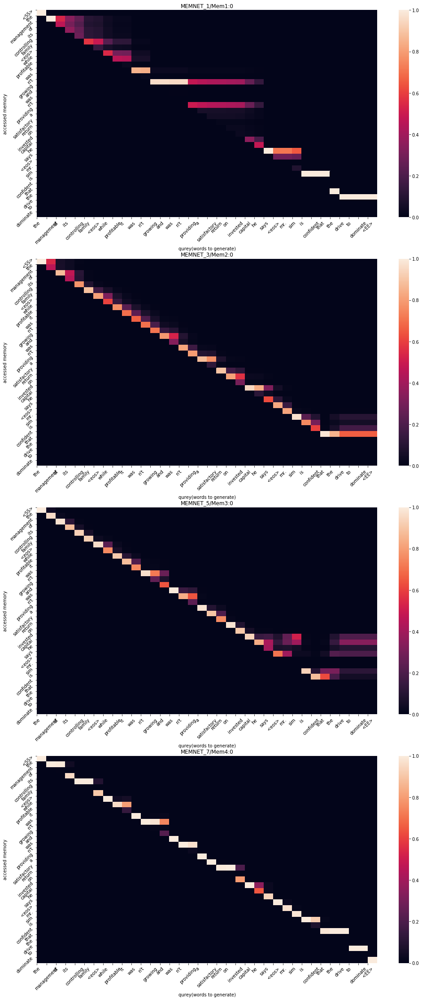

On iter 1701 with training PPL: 182.6505584716797, training ACC 0.2016059011220932
On iter 1702 with training PPL: 176.5068817138672, training ACC 0.1976996511220932
On iter 1703 with training PPL: 177.07861328125, training ACC 0.2055121511220932
On iter 1704 with training PPL: 167.31411743164062, training ACC 0.2196180522441864
On iter 1705 with training PPL: 188.87574768066406, training ACC 0.1994357705116272
On iter 1706 with training PPL: 172.84344482421875, training ACC 0.2109375
On iter 1707 with training PPL: 185.32237243652344, training ACC 0.208984375
On iter 1708 with training PPL: 168.12843322753906, training ACC 0.2085503488779068
On iter 1709 with training PPL: 175.41302490234375, training ACC 0.2022569477558136
On iter 1710 with training PPL: 177.44468688964844, training ACC 0.2000868022441864
	 validation PPL 239.76895141601562, validation acc 0.1866319477558136
shape of gradients is (5228544,), L2 norm of gradients is 1.3378465175628662, details:                   0
cou

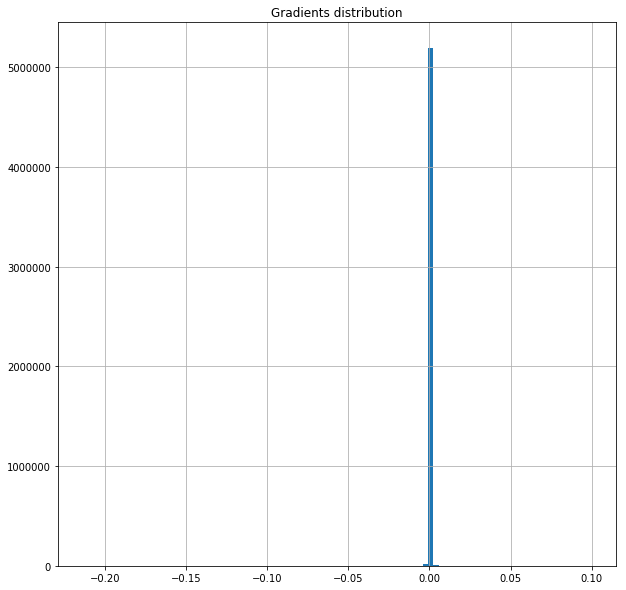

On iter 1711 with training PPL: 165.1302032470703, training ACC 0.2100694477558136
On iter 1712 with training PPL: 185.2503662109375, training ACC 0.2022569477558136
On iter 1713 with training PPL: 178.8877410888672, training ACC 0.2087673544883728
On iter 1714 with training PPL: 181.8455047607422, training ACC 0.2052951455116272
On iter 1715 with training PPL: 174.54379272460938, training ACC 0.2061631977558136
On iter 1716 with training PPL: 170.3759765625, training ACC 0.2037760466337204
On iter 1717 with training PPL: 169.51011657714844, training ACC 0.2105034738779068
On iter 1718 with training PPL: 189.5706787109375, training ACC 0.2018229216337204
On iter 1719 with training PPL: 196.47340393066406, training ACC 0.2033420205116272
On iter 1720 with training PPL: 165.70301818847656, training ACC 0.2126736044883728
On iter 1721 with training PPL: 179.22286987304688, training ACC 0.2048611044883728
On iter 1722 with training PPL: 187.4470977783203, training ACC 0.205078125
On iter 1

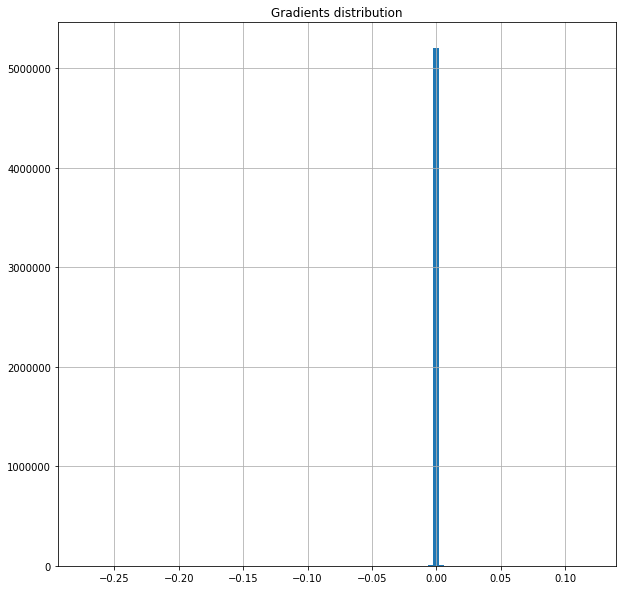

On iter 1741 with training PPL: 182.0, training ACC 0.1994357705116272
On iter 1742 with training PPL: 165.27743530273438, training ACC 0.2120225727558136
On iter 1743 with training PPL: 162.13101196289062, training ACC 0.2029079794883728
On iter 1744 with training PPL: 185.29490661621094, training ACC 0.2057291716337204
On iter 1745 with training PPL: 181.39541625976562, training ACC 0.2076822966337204
On iter 1746 with training PPL: 185.5608673095703, training ACC 0.1950954794883728
On iter 1747 with training PPL: 181.0377655029297, training ACC 0.2020399272441864
On iter 1748 with training PPL: 169.5872344970703, training ACC 0.2020399272441864
On iter 1749 with training PPL: 185.41351318359375, training ACC 0.2013888955116272
On iter 1750 with training PPL: 174.6879119873047, training ACC 0.2141927033662796
On iter 1751 with training PPL: 189.96148681640625, training ACC 0.2037760466337204
On iter 1752 with training PPL: 171.41896057128906, training ACC 0.2074652761220932
On iter 1

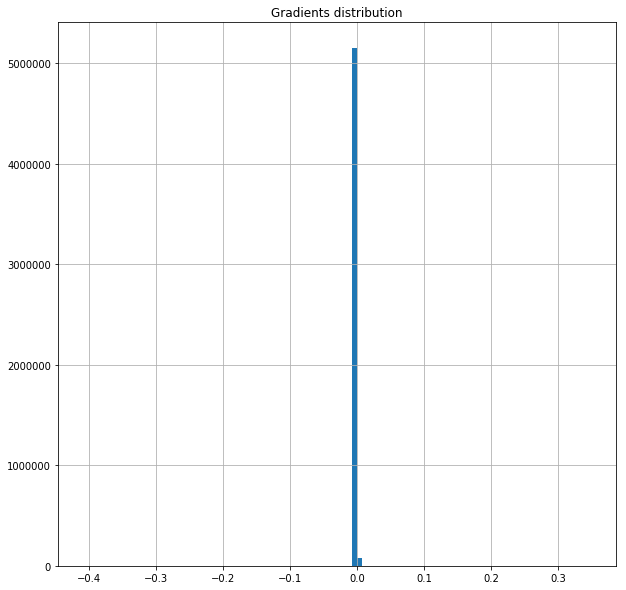

On iter 1771 with training PPL: 176.74842834472656, training ACC 0.2072482705116272
On iter 1772 with training PPL: 175.25173950195312, training ACC 0.2100694477558136
On iter 1773 with training PPL: 176.65347290039062, training ACC 0.2107204794883728
On iter 1774 with training PPL: 183.70797729492188, training ACC 0.2118055522441864
On iter 1775 with training PPL: 161.96873474121094, training ACC 0.2137586772441864
On iter 1776 with training PPL: 175.03778076171875, training ACC 0.2059461772441864
On iter 1777 with training PPL: 170.9342041015625, training ACC 0.2204861044883728
On iter 1778 with training PPL: 163.83749389648438, training ACC 0.2122395783662796
On iter 1779 with training PPL: 177.00711059570312, training ACC 0.2048611044883728
On iter 1780 with training PPL: 165.21661376953125, training ACC 0.2122395783662796
On iter 1781 with training PPL: 183.55947875976562, training ACC 0.2007378488779068
On iter 1782 with training PPL: 192.3508758544922, training ACC 0.20182292163

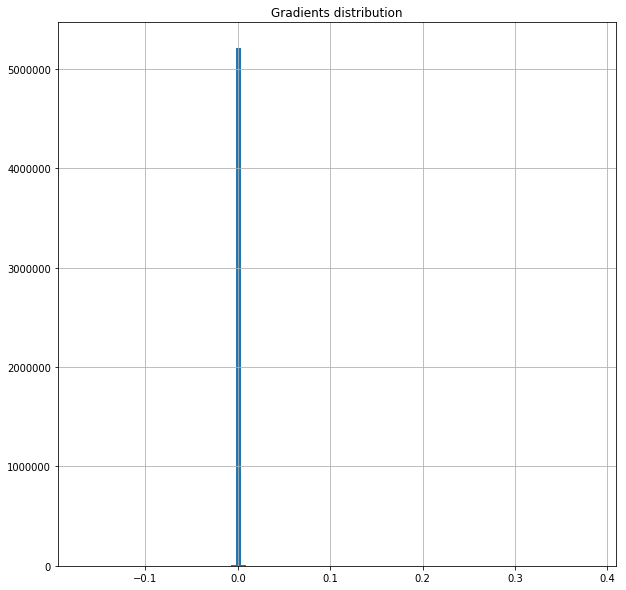

<SS> mr. <unk> a del <unk> calif. financial planner <eos> but once the <unk> are covered then i would start to invest even if it 's as little as $ N says michael lipper president of <EE>


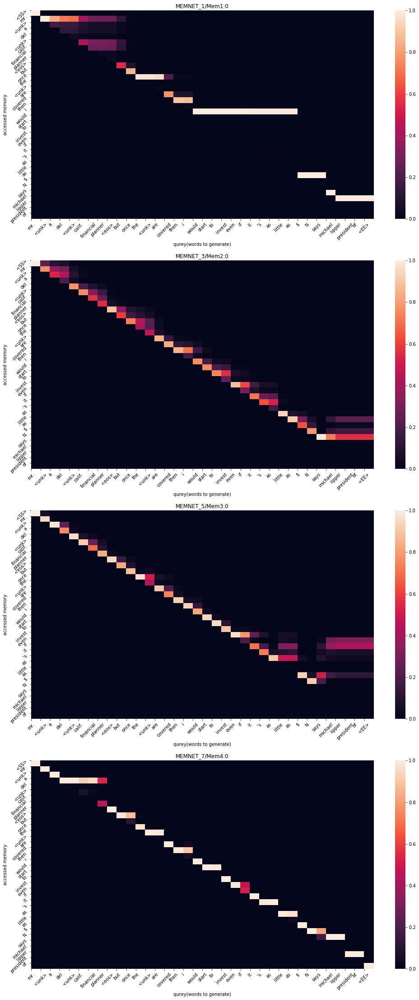

On iter 1801 with training PPL: 185.51937866210938, training ACC 0.1979166716337204
On iter 1802 with training PPL: 188.67770385742188, training ACC 0.1990017294883728
On iter 1803 with training PPL: 163.12686157226562, training ACC 0.2183159738779068
On iter 1804 with training PPL: 166.4897003173828, training ACC 0.2037760466337204
On iter 1805 with training PPL: 177.3388671875, training ACC 0.2024739533662796
On iter 1806 with training PPL: 183.67987060546875, training ACC 0.205078125
On iter 1807 with training PPL: 168.7468719482422, training ACC 0.20703125
On iter 1808 with training PPL: 176.2553253173828, training ACC 0.2087673544883728
On iter 1809 with training PPL: 186.7867431640625, training ACC 0.2029079794883728
On iter 1810 with training PPL: 165.63246154785156, training ACC 0.2100694477558136
On iter 1811 with training PPL: 186.09571838378906, training ACC 0.203125
On iter 1812 with training PPL: 191.23870849609375, training ACC 0.2016059011220932
On iter 1813 with trainin

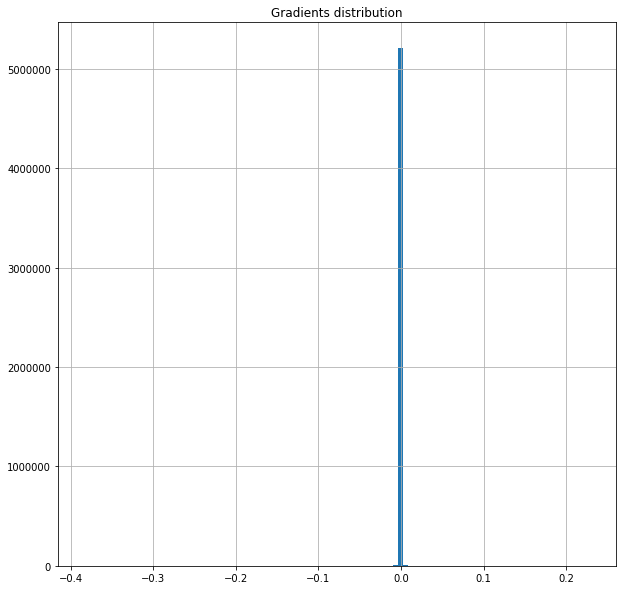

On iter 1831 with training PPL: 174.37249755859375, training ACC 0.2126736044883728
On iter 1832 with training PPL: 180.57565307617188, training ACC 0.2096354216337204
On iter 1833 with training PPL: 178.31942749023438, training ACC 0.2124565988779068
On iter 1834 with training PPL: 164.67672729492188, training ACC 0.2131076455116272
On iter 1835 with training PPL: 153.56089782714844, training ACC 0.2202690988779068
On iter 1836 with training PPL: 158.99624633789062, training ACC 0.21875
On iter 1837 with training PPL: 153.7168731689453, training ACC 0.2154947966337204
On iter 1838 with training PPL: 171.5877685546875, training ACC 0.2048611044883728
On iter 1839 with training PPL: 159.91099548339844, training ACC 0.2144097238779068
On iter 1840 with training PPL: 168.88092041015625, training ACC 0.2174479216337204
On iter 1841 with training PPL: 186.8799285888672, training ACC 0.1976996511220932
On iter 1842 with training PPL: 173.67703247070312, training ACC 0.2096354216337204
On ite

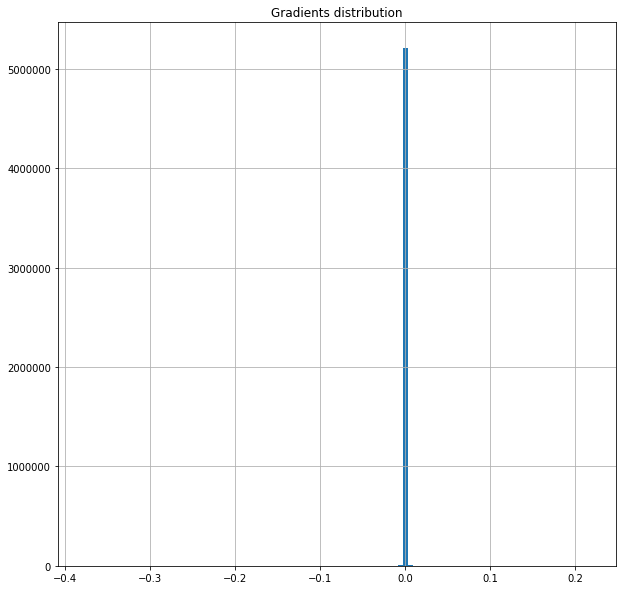

On iter 1861 with training PPL: 172.6067352294922, training ACC 0.19921875
On iter 1862 with training PPL: 168.982177734375, training ACC 0.2122395783662796
On iter 1863 with training PPL: 181.59906005859375, training ACC 0.2076822966337204
On iter 1864 with training PPL: 171.14749145507812, training ACC 0.2022569477558136
On iter 1865 with training PPL: 156.20755004882812, training ACC 0.2135416716337204
On iter 1866 with training PPL: 172.93353271484375, training ACC 0.1974826455116272
On iter 1867 with training PPL: 183.7893829345703, training ACC 0.2085503488779068
On iter 1868 with training PPL: 164.84596252441406, training ACC 0.2100694477558136
On iter 1869 with training PPL: 176.852294921875, training ACC 0.2118055522441864
On iter 1870 with training PPL: 183.4070587158203, training ACC 0.1968315988779068
On iter 1871 with training PPL: 175.80667114257812, training ACC 0.2052951455116272
On iter 1872 with training PPL: 177.52162170410156, training ACC 0.2120225727558136
On iter

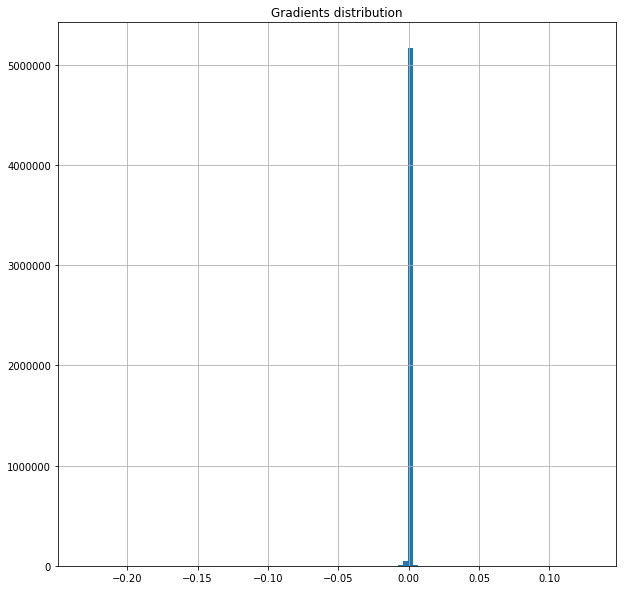

On iter 1891 with training PPL: 167.10690307617188, training ACC 0.2081163227558136
On iter 1892 with training PPL: 157.707763671875, training ACC 0.2194010466337204
On iter 1893 with training PPL: 189.4879913330078, training ACC 0.2096354216337204
On iter 1894 with training PPL: 175.67979431152344, training ACC 0.201171875
On iter 1895 with training PPL: 185.9234619140625, training ACC 0.205078125
On iter 1896 with training PPL: 171.5908660888672, training ACC 0.2033420205116272
On iter 1897 with training PPL: 175.28082275390625, training ACC 0.2024739533662796
On iter 1898 with training PPL: 169.2513427734375, training ACC 0.2144097238779068
On iter 1899 with training PPL: 174.42340087890625, training ACC 0.2055121511220932
On iter 1900 with training PPL: 164.46807861328125, training ACC 0.2180989533662796
<SS> be forced to exclude him from its deliberations in order to be fair to other bidders <eos> that could cost him the chance to influence the outcome and perhaps join the winning

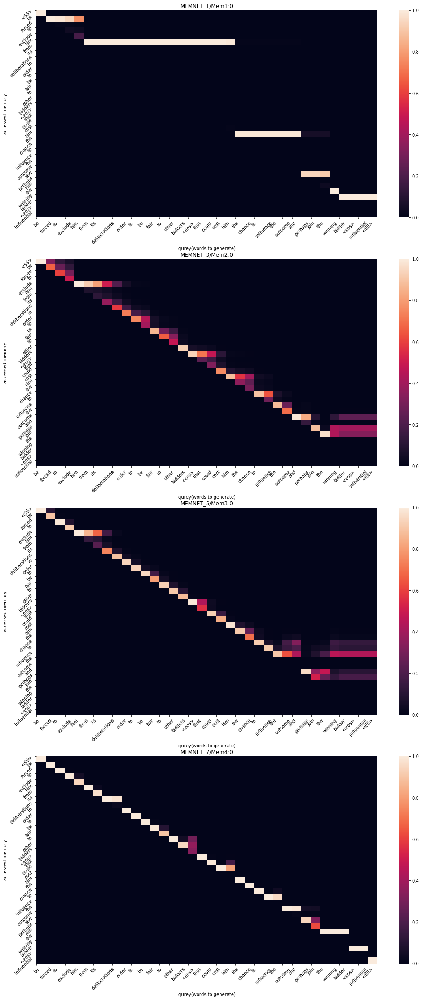

On iter 1901 with training PPL: 169.23228454589844, training ACC 0.2107204794883728
On iter 1902 with training PPL: 177.2749481201172, training ACC 0.2074652761220932
On iter 1903 with training PPL: 183.38345336914062, training ACC 0.2074652761220932
On iter 1904 with training PPL: 173.98687744140625, training ACC 0.2000868022441864
On iter 1905 with training PPL: 189.34986877441406, training ACC 0.2024739533662796
On iter 1906 with training PPL: 150.16897583007812, training ACC 0.2213541716337204
On iter 1907 with training PPL: 170.32073974609375, training ACC 0.2013888955116272
On iter 1908 with training PPL: 163.5334930419922, training ACC 0.2204861044883728
On iter 1909 with training PPL: 154.35617065429688, training ACC 0.2215711772441864
On iter 1910 with training PPL: 179.1009521484375, training ACC 0.2024739533662796
On iter 1911 with training PPL: 179.540283203125, training ACC 0.2094184011220932
On iter 1912 with training PPL: 156.0789794921875, training ACC 0.223307296633720

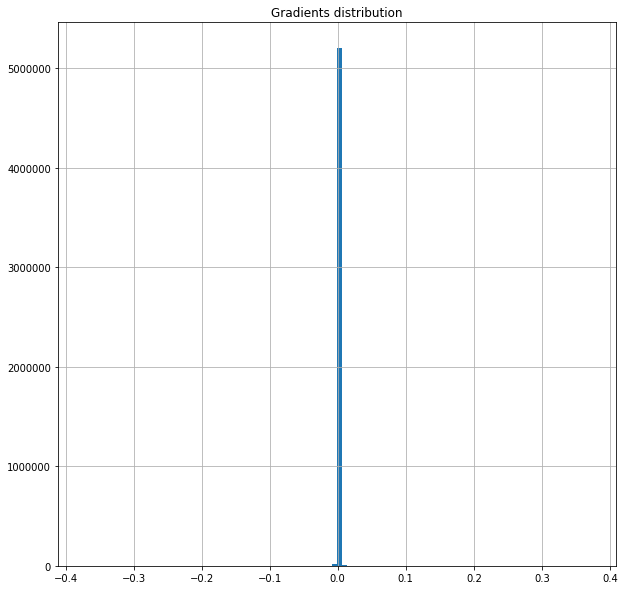

On iter 1921 with training PPL: 161.8333282470703, training ACC 0.212890625
On iter 1922 with training PPL: 189.42193603515625, training ACC 0.1966145783662796
On iter 1923 with training PPL: 183.54495239257812, training ACC 0.2061631977558136
On iter 1924 with training PPL: 167.72023010253906, training ACC 0.2081163227558136
On iter 1925 with training PPL: 178.85414123535156, training ACC 0.2029079794883728
On iter 1926 with training PPL: 162.8594207763672, training ACC 0.2141927033662796
On iter 1927 with training PPL: 158.41958618164062, training ACC 0.2176649272441864
On iter 1928 with training PPL: 162.91162109375, training ACC 0.2131076455116272
On iter 1929 with training PPL: 168.20677185058594, training ACC 0.2068142294883728
On iter 1930 with training PPL: 166.5850067138672, training ACC 0.2063802033662796
On iter 1931 with training PPL: 166.7508544921875, training ACC 0.212890625
On iter 1932 with training PPL: 181.24411010742188, training ACC 0.2048611044883728
On iter 1933 

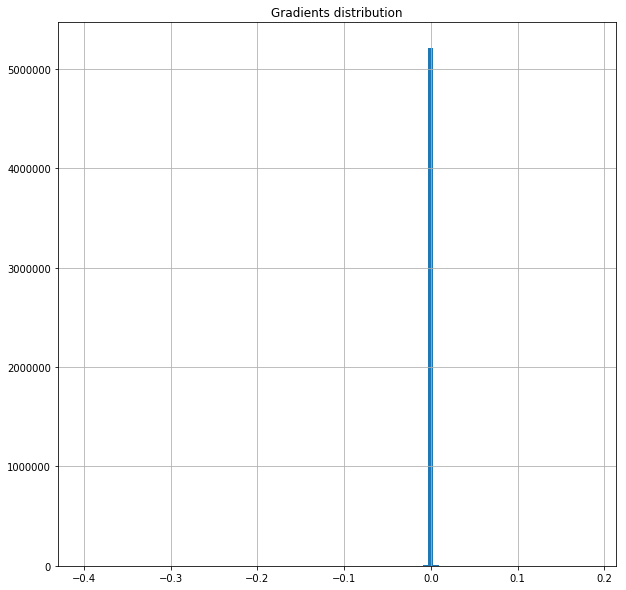

On iter 1951 with training PPL: 177.45753479003906, training ACC 0.2048611044883728
On iter 1952 with training PPL: 179.40284729003906, training ACC 0.2035590261220932
On iter 1953 with training PPL: 176.79428100585938, training ACC 0.2078993022441864
On iter 1954 with training PPL: 170.89639282226562, training ACC 0.2087673544883728
On iter 1955 with training PPL: 174.5379638671875, training ACC 0.2065972238779068
On iter 1956 with training PPL: 173.35476684570312, training ACC 0.2094184011220932
On iter 1957 with training PPL: 170.14654541015625, training ACC 0.2098524272441864
On iter 1958 with training PPL: 178.80101013183594, training ACC 0.2035590261220932
On iter 1959 with training PPL: 175.82872009277344, training ACC 0.2020399272441864
On iter 1960 with training PPL: 188.81703186035156, training ACC 0.1981336772441864
On iter 1961 with training PPL: 173.82077026367188, training ACC 0.2137586772441864
On iter 1962 with training PPL: 181.2279510498047, training ACC 0.20355902612

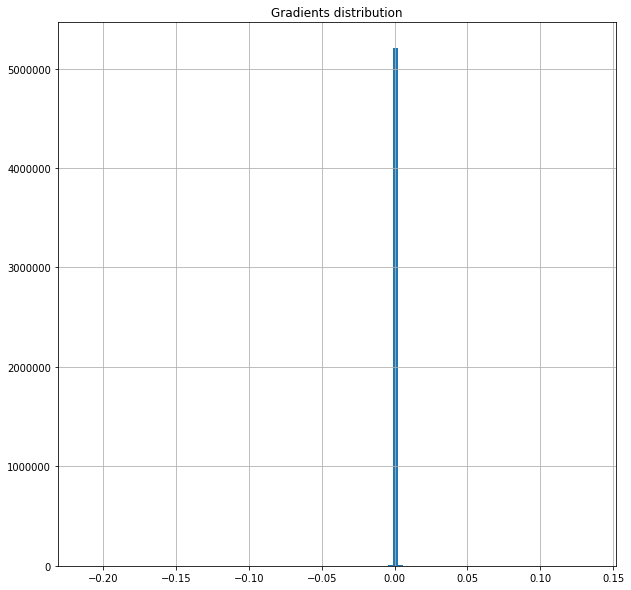

On iter 1981 with training PPL: 172.9403076171875, training ACC 0.208984375
On iter 1982 with training PPL: 149.43466186523438, training ACC 0.2265625
On iter 1983 with training PPL: 171.52142333984375, training ACC 0.2020399272441864
On iter 1984 with training PPL: 179.2957000732422, training ACC 0.2048611044883728
On iter 1985 with training PPL: 178.27565002441406, training ACC 0.2024739533662796
On iter 1986 with training PPL: 166.5999298095703, training ACC 0.2213541716337204
On iter 1987 with training PPL: 173.6751251220703, training ACC 0.2107204794883728
On iter 1988 with training PPL: 165.83082580566406, training ACC 0.2176649272441864
On iter 1989 with training PPL: 173.64102172851562, training ACC 0.2035590261220932
On iter 1990 with training PPL: 167.76341247558594, training ACC 0.2131076455116272
On iter 1991 with training PPL: 141.2635498046875, training ACC 0.2213541716337204
On iter 1992 with training PPL: 169.3372344970703, training ACC 0.2157118022441864
On iter 1993 w

In [16]:
def show_gradient(gradients):
    df = pd.DataFrame(gradients)
    print('shape of gradients is {0}, L2 norm of gradients is {1}, details: {2}'.format(
        gradients.shape, np.linalg.norm(gradients), df.describe()))
    pylab.rcParams['figure.figsize'] = (10, 10)
    df.hist(bins=100)
    plt.title("Gradients distribution")
    plt.show()

session = tf.Session()
session.run(tf.global_variables_initializer())

trainGen = gen_word_word(batch_size=optMemNet.batch_size)
valGen = gen_word_word(dataset='valid', batch_size=optMemNet.batch_size)

for i in range(2000):
    x_batch, y_true_batch = next(trainGen)
    feed_dict_train = {inputs: x_batch, y_true: y_true_batch}
    _, trainPPL, trainACC = session.run([train_op, PPL, accuracy], feed_dict=feed_dict_train)
    print('On iter {0} with training PPL: {1}, training ACC {2}'.format(i, trainPPL, trainACC))
    if i % 30 == 0:
        x_batch, y_true_batch = next(valGen)
        feed_dict_val = {inputs: x_batch, y_true: y_true_batch}
        valPPL, valACC = session.run([PPL, accuracy], feed_dict=feed_dict_val)
        print('\t validation PPL {0}, validation acc {1}'.format(valPPL, valACC))
        
        show_gradient(session.run([totalGrad], feed_dict=feed_dict_val)[0])
    
    if i % 100 == 0:
        showAttentionWeights([attMem1, attMem2, attMem3, attMem4], session=session)

On iter 0 with training PPL: 171.98143005371094, training ACC 0.2052951455116272
	 validation PPL 212.56080627441406, validation acc 0.2009548544883728
shape of gradients is (5228544,), L2 norm of gradients is 2.2895421981811523, details:                   0
count  5.228544e+06
mean  -1.405976e-07
std    1.001627e-03
min   -4.045470e-01
25%    0.000000e+00
50%    0.000000e+00
75%    9.217496e-06
max    2.019922e-01


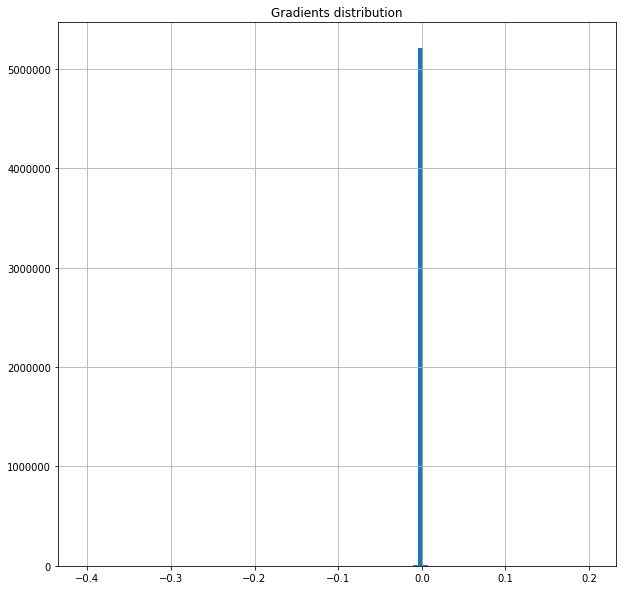

<SS> department 's widely followed index of leading indicators while up in august has fallen repeatedly since reaching a high early this year <eos> its <unk> behavior through much of N has prompted some <unk> to <EE>


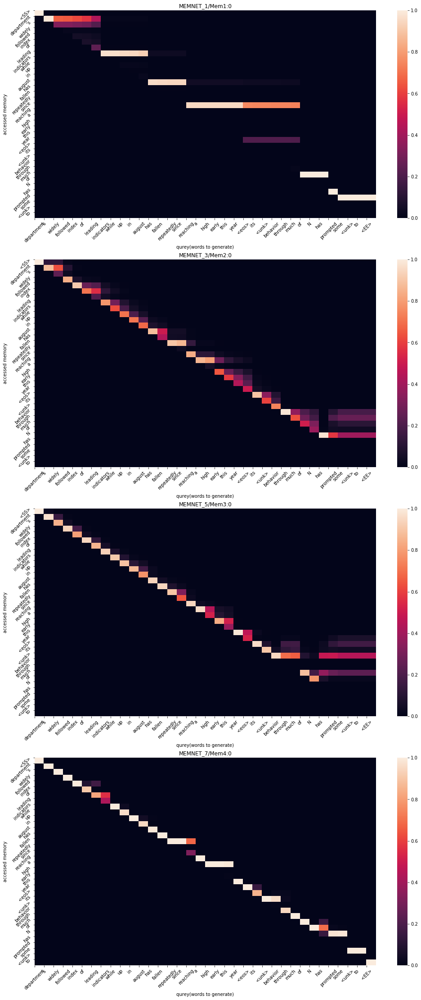

On iter 1 with training PPL: 164.7638397216797, training ACC 0.2157118022441864
On iter 2 with training PPL: 161.80392456054688, training ACC 0.2161458283662796
On iter 3 with training PPL: 170.51528930664062, training ACC 0.2152777761220932
On iter 4 with training PPL: 168.79983520507812, training ACC 0.2178819477558136
On iter 5 with training PPL: 164.3924102783203, training ACC 0.2115885466337204
On iter 6 with training PPL: 154.03993225097656, training ACC 0.2289496511220932
On iter 7 with training PPL: 158.3987274169922, training ACC 0.216796875
On iter 8 with training PPL: 149.82994079589844, training ACC 0.2256944477558136
On iter 9 with training PPL: 166.83619689941406, training ACC 0.2055121511220932
On iter 10 with training PPL: 169.09548950195312, training ACC 0.2076822966337204
On iter 11 with training PPL: 156.33706665039062, training ACC 0.2230902761220932
On iter 12 with training PPL: 158.8614959716797, training ACC 0.2311197966337204
On iter 13 with training PPL: 163.64

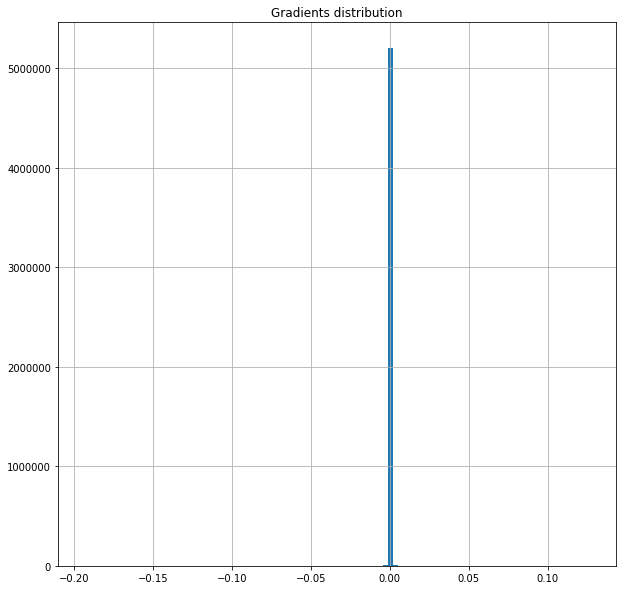

On iter 31 with training PPL: 187.61744689941406, training ACC 0.2046440988779068
On iter 32 with training PPL: 161.46180725097656, training ACC 0.2111545205116272
On iter 33 with training PPL: 156.3337860107422, training ACC 0.2217881977558136
On iter 34 with training PPL: 158.50625610351562, training ACC 0.2135416716337204
On iter 35 with training PPL: 182.65919494628906, training ACC 0.2046440988779068
On iter 36 with training PPL: 174.58016967773438, training ACC 0.2092013955116272
On iter 37 with training PPL: 172.3587646484375, training ACC 0.1990017294883728
On iter 38 with training PPL: 161.26283264160156, training ACC 0.203125
On iter 39 with training PPL: 173.00926208496094, training ACC 0.2122395783662796
On iter 40 with training PPL: 163.93392944335938, training ACC 0.2137586772441864
On iter 41 with training PPL: 162.11090087890625, training ACC 0.2055121511220932
On iter 42 with training PPL: 148.93215942382812, training ACC 0.21484375
On iter 43 with training PPL: 177.53

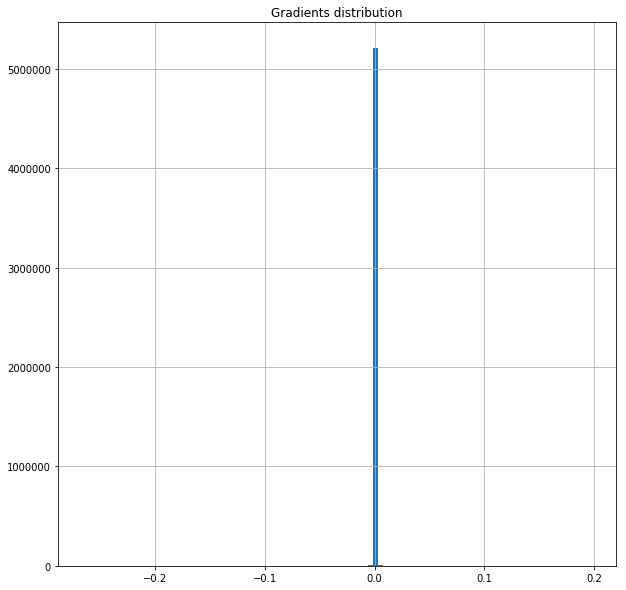

On iter 61 with training PPL: 164.1691436767578, training ACC 0.2122395783662796
On iter 62 with training PPL: 171.80438232421875, training ACC 0.2063802033662796
On iter 63 with training PPL: 164.45489501953125, training ACC 0.2085503488779068
On iter 64 with training PPL: 171.83404541015625, training ACC 0.1994357705116272
On iter 65 with training PPL: 187.49635314941406, training ACC 0.1948784738779068
On iter 66 with training PPL: 170.961181640625, training ACC 0.2137586772441864
On iter 67 with training PPL: 160.2445526123047, training ACC 0.2120225727558136
On iter 68 with training PPL: 165.56573486328125, training ACC 0.2074652761220932
On iter 69 with training PPL: 163.59088134765625, training ACC 0.2137586772441864
On iter 70 with training PPL: 164.52313232421875, training ACC 0.2100694477558136
On iter 71 with training PPL: 162.13540649414062, training ACC 0.2113715261220932
On iter 72 with training PPL: 175.7509307861328, training ACC 0.2159288227558136
On iter 73 with train

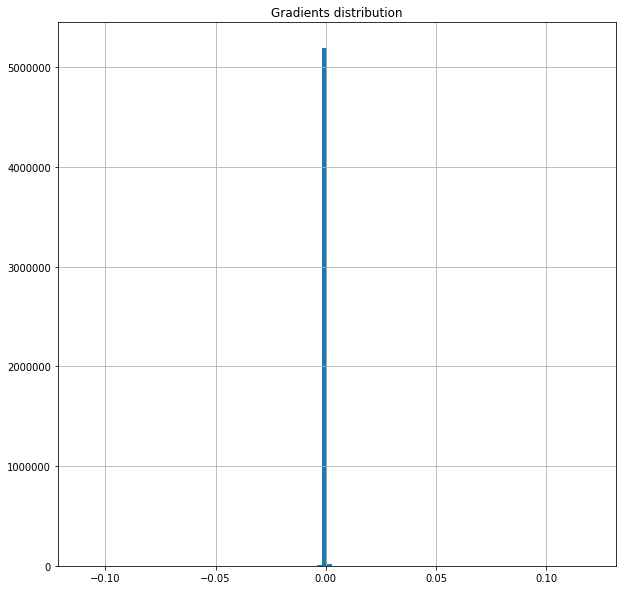

On iter 91 with training PPL: 158.30072021484375, training ACC 0.2194010466337204
On iter 92 with training PPL: 164.55027770996094, training ACC 0.2131076455116272
On iter 93 with training PPL: 160.0569305419922, training ACC 0.2111545205116272
On iter 94 with training PPL: 151.11968994140625, training ACC 0.22265625
On iter 95 with training PPL: 162.59568786621094, training ACC 0.2263454794883728
On iter 96 with training PPL: 170.20553588867188, training ACC 0.205078125
On iter 97 with training PPL: 182.67469787597656, training ACC 0.2105034738779068
On iter 98 with training PPL: 166.4927978515625, training ACC 0.1998697966337204
On iter 99 with training PPL: 175.95057678222656, training ACC 0.2016059011220932
On iter 100 with training PPL: 193.86097717285156, training ACC 0.1970486044883728
On iter 101 with training PPL: 171.52069091796875, training ACC 0.1966145783662796
On iter 102 with training PPL: 177.75735473632812, training ACC 0.2037760466337204
On iter 103 with training PPL:

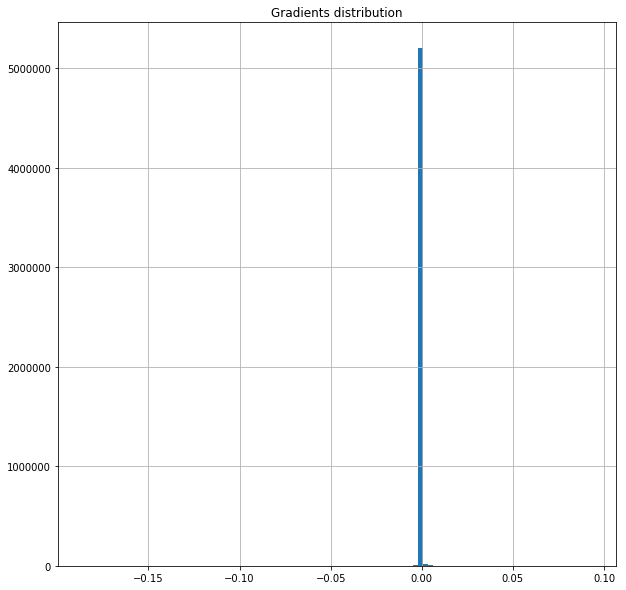

On iter 121 with training PPL: 158.84779357910156, training ACC 0.2120225727558136
On iter 122 with training PPL: 163.84500122070312, training ACC 0.21484375
On iter 123 with training PPL: 158.68162536621094, training ACC 0.22265625
On iter 124 with training PPL: 162.27687072753906, training ACC 0.2100694477558136
On iter 125 with training PPL: 180.7217559814453, training ACC 0.2033420205116272
On iter 126 with training PPL: 163.8214111328125, training ACC 0.2087673544883728
On iter 127 with training PPL: 166.66294860839844, training ACC 0.2059461772441864
On iter 128 with training PPL: 159.60202026367188, training ACC 0.2170138955116272
On iter 129 with training PPL: 163.09730529785156, training ACC 0.2144097238779068
On iter 130 with training PPL: 145.2946319580078, training ACC 0.2235243022441864
On iter 131 with training PPL: 170.8065185546875, training ACC 0.2052951455116272
On iter 132 with training PPL: 176.259521484375, training ACC 0.2013888955116272
On iter 133 with training 

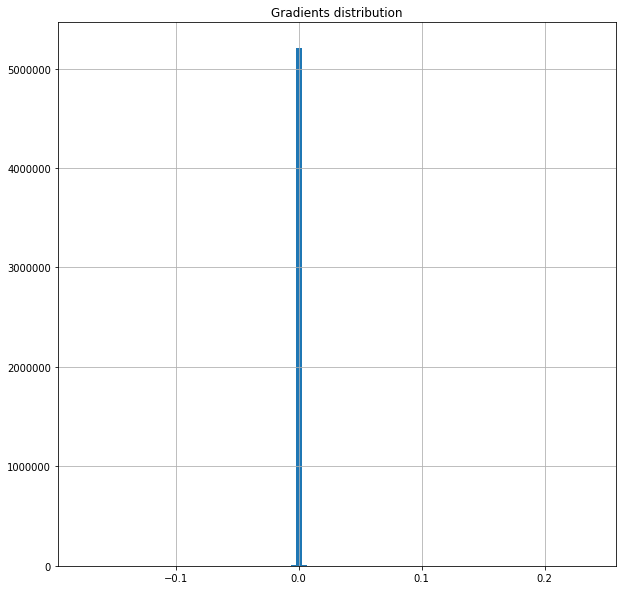

On iter 151 with training PPL: 170.7711944580078, training ACC 0.2135416716337204
On iter 152 with training PPL: 158.60348510742188, training ACC 0.2233072966337204
On iter 153 with training PPL: 168.41207885742188, training ACC 0.2102864533662796
On iter 154 with training PPL: 177.4823455810547, training ACC 0.2042100727558136
On iter 155 with training PPL: 139.67738342285156, training ACC 0.2389322966337204
On iter 156 with training PPL: 178.67385864257812, training ACC 0.2009548544883728
On iter 157 with training PPL: 160.9521484375, training ACC 0.2122395783662796
On iter 158 with training PPL: 161.80276489257812, training ACC 0.2115885466337204
On iter 159 with training PPL: 170.85140991210938, training ACC 0.2105034738779068
On iter 160 with training PPL: 153.80543518066406, training ACC 0.2243923544883728
On iter 161 with training PPL: 163.9444122314453, training ACC 0.2139756977558136
On iter 162 with training PPL: 165.03062438964844, training ACC 0.21484375
On iter 163 with tr

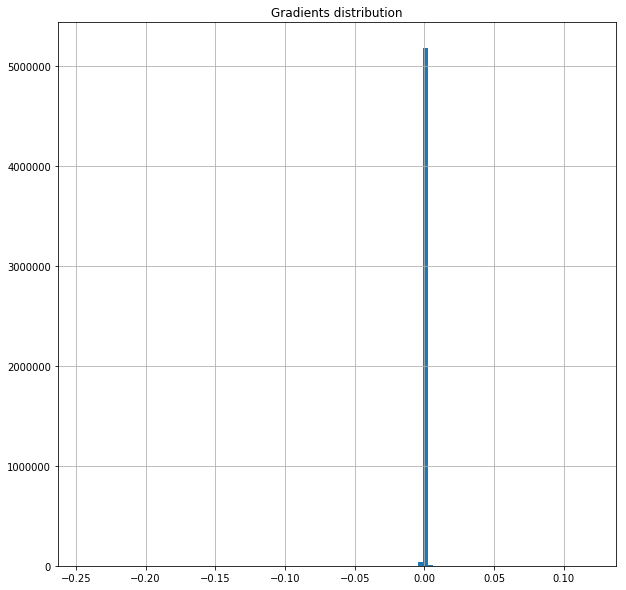

On iter 181 with training PPL: 167.75596618652344, training ACC 0.2105034738779068
On iter 182 with training PPL: 166.1363983154297, training ACC 0.2059461772441864
On iter 183 with training PPL: 176.03550720214844, training ACC 0.2016059011220932
On iter 184 with training PPL: 149.18455505371094, training ACC 0.2217881977558136
On iter 185 with training PPL: 153.8048553466797, training ACC 0.2122395783662796
On iter 186 with training PPL: 162.24932861328125, training ACC 0.2076822966337204
On iter 187 with training PPL: 185.1048583984375, training ACC 0.2046440988779068
On iter 188 with training PPL: 151.9549102783203, training ACC 0.2122395783662796
On iter 189 with training PPL: 144.72845458984375, training ACC 0.2280815988779068
On iter 190 with training PPL: 146.79122924804688, training ACC 0.2200520783662796
On iter 191 with training PPL: 151.75094604492188, training ACC 0.2248263955116272
On iter 192 with training PPL: 144.84616088867188, training ACC 0.2204861044883728
On iter 

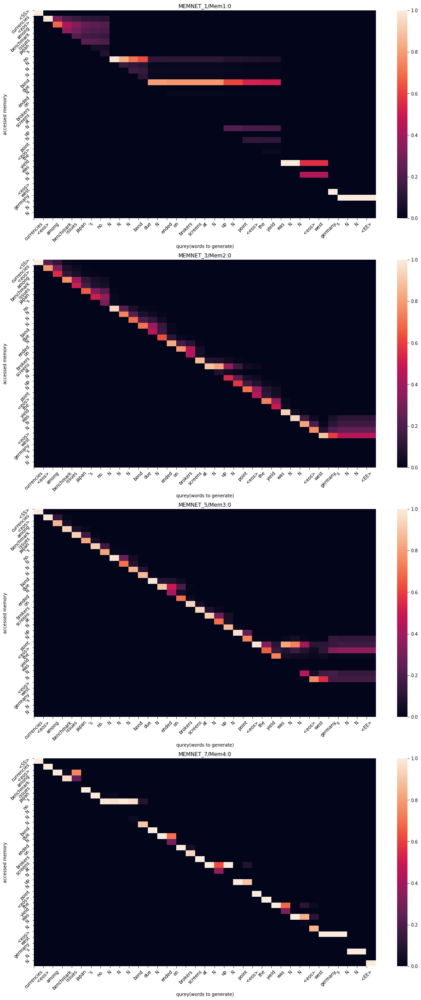

On iter 201 with training PPL: 181.36082458496094, training ACC 0.20703125
On iter 202 with training PPL: 150.8879852294922, training ACC 0.224609375
On iter 203 with training PPL: 155.66453552246094, training ACC 0.2141927033662796
On iter 204 with training PPL: 154.8644256591797, training ACC 0.2133246511220932
On iter 205 with training PPL: 160.87664794921875, training ACC 0.2076822966337204
On iter 206 with training PPL: 152.48399353027344, training ACC 0.2170138955116272
On iter 207 with training PPL: 159.4085235595703, training ACC 0.2092013955116272
On iter 208 with training PPL: 158.92135620117188, training ACC 0.2092013955116272
On iter 209 with training PPL: 170.4609832763672, training ACC 0.2048611044883728
On iter 210 with training PPL: 160.9342803955078, training ACC 0.2120225727558136
	 validation PPL 210.2991943359375, validation acc 0.1996527761220932
shape of gradients is (5228544,), L2 norm of gradients is 1.5646131038665771, details:                   0
count  5.2285

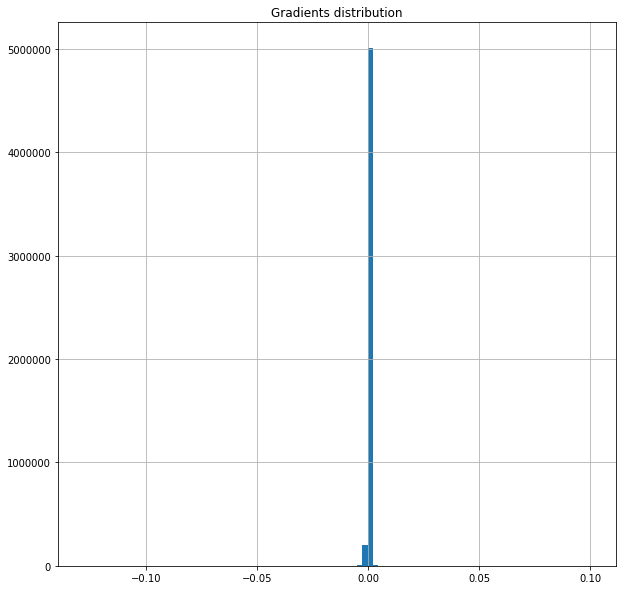

On iter 211 with training PPL: 154.7620391845703, training ACC 0.2076822966337204
On iter 212 with training PPL: 168.60781860351562, training ACC 0.2042100727558136
On iter 213 with training PPL: 164.07235717773438, training ACC 0.2170138955116272
On iter 214 with training PPL: 158.76040649414062, training ACC 0.2135416716337204
On iter 215 with training PPL: 164.71975708007812, training ACC 0.2137586772441864
On iter 216 with training PPL: 164.26710510253906, training ACC 0.2102864533662796
On iter 217 with training PPL: 186.8600616455078, training ACC 0.1937934011220932
On iter 218 with training PPL: 164.65545654296875, training ACC 0.2122395783662796
On iter 219 with training PPL: 164.37399291992188, training ACC 0.2115885466337204
On iter 220 with training PPL: 143.47402954101562, training ACC 0.2189670205116272
On iter 221 with training PPL: 170.9832000732422, training ACC 0.2083333283662796
On iter 222 with training PPL: 143.92977905273438, training ACC 0.2139756977558136
On iter

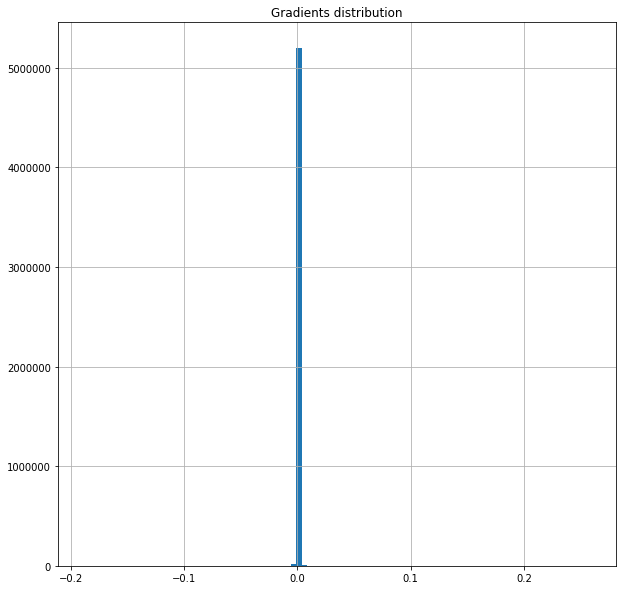

On iter 241 with training PPL: 173.5874481201172, training ACC 0.2102864533662796
On iter 242 with training PPL: 159.51626586914062, training ACC 0.2131076455116272
On iter 243 with training PPL: 152.20982360839844, training ACC 0.220703125
On iter 244 with training PPL: 151.72735595703125, training ACC 0.2200520783662796
On iter 245 with training PPL: 148.89175415039062, training ACC 0.2183159738779068
On iter 246 with training PPL: 153.0830535888672, training ACC 0.208984375
On iter 247 with training PPL: 146.72837829589844, training ACC 0.2157118022441864
On iter 248 with training PPL: 151.6815643310547, training ACC 0.2211371511220932
On iter 249 with training PPL: 169.9713897705078, training ACC 0.20703125
On iter 250 with training PPL: 160.98193359375, training ACC 0.2241753488779068
On iter 251 with training PPL: 146.7579803466797, training ACC 0.22265625
On iter 252 with training PPL: 158.96759033203125, training ACC 0.2115885466337204
On iter 253 with training PPL: 169.0318908

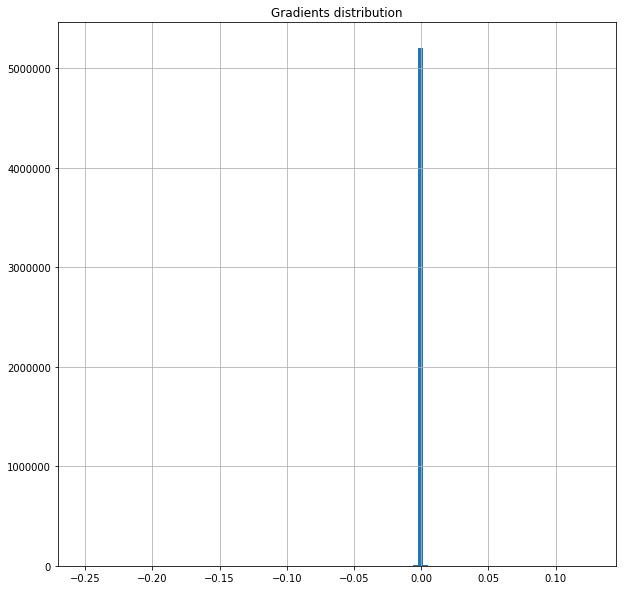

On iter 271 with training PPL: 148.96682739257812, training ACC 0.2235243022441864
On iter 272 with training PPL: 170.505126953125, training ACC 0.2085503488779068
On iter 273 with training PPL: 149.6117706298828, training ACC 0.2150607705116272
On iter 274 with training PPL: 152.1360321044922, training ACC 0.2180989533662796
On iter 275 with training PPL: 161.85299682617188, training ACC 0.2144097238779068
On iter 276 with training PPL: 158.25173950195312, training ACC 0.2165798544883728
On iter 277 with training PPL: 144.0275421142578, training ACC 0.2131076455116272
On iter 278 with training PPL: 160.86070251464844, training ACC 0.2046440988779068
On iter 279 with training PPL: 147.10850524902344, training ACC 0.2191840261220932
On iter 280 with training PPL: 161.9305877685547, training ACC 0.2122395783662796
On iter 281 with training PPL: 157.41867065429688, training ACC 0.2122395783662796
On iter 282 with training PPL: 161.99452209472656, training ACC 0.2020399272441864
On iter 28

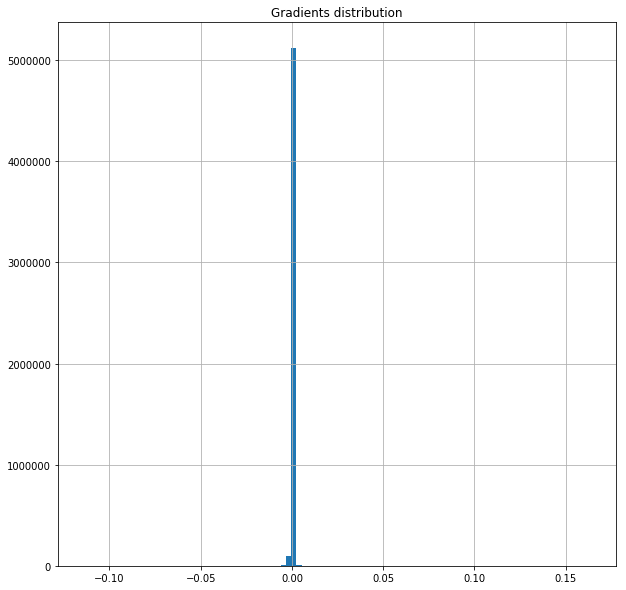

On iter 301 with training PPL: 147.62815856933594, training ACC 0.2280815988779068
On iter 302 with training PPL: 150.74278259277344, training ACC 0.2152777761220932
On iter 303 with training PPL: 150.00286865234375, training ACC 0.2235243022441864
On iter 304 with training PPL: 149.9740447998047, training ACC 0.2233072966337204
On iter 305 with training PPL: 154.07093811035156, training ACC 0.2120225727558136
On iter 306 with training PPL: 153.44363403320312, training ACC 0.2139756977558136
On iter 307 with training PPL: 153.46119689941406, training ACC 0.2141927033662796
On iter 308 with training PPL: 163.54299926757812, training ACC 0.2074652761220932
On iter 309 with training PPL: 166.56283569335938, training ACC 0.2083333283662796
On iter 310 with training PPL: 168.39593505859375, training ACC 0.2137586772441864
On iter 311 with training PPL: 144.83006286621094, training ACC 0.2228732705116272
On iter 312 with training PPL: 162.228759765625, training ACC 0.216796875
On iter 313 wi

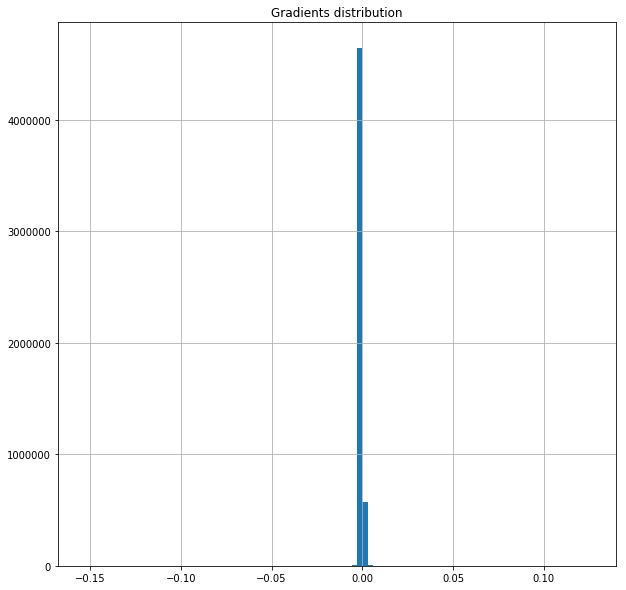

On iter 331 with training PPL: 152.20582580566406, training ACC 0.2237413227558136
On iter 332 with training PPL: 170.22996520996094, training ACC 0.2146267294883728
On iter 333 with training PPL: 163.86602783203125, training ACC 0.2137586772441864
On iter 334 with training PPL: 136.5900421142578, training ACC 0.2235243022441864
On iter 335 with training PPL: 147.5022735595703, training ACC 0.2137586772441864
On iter 336 with training PPL: 143.23068237304688, training ACC 0.2152777761220932
On iter 337 with training PPL: 153.53366088867188, training ACC 0.2146267294883728
On iter 338 with training PPL: 143.41343688964844, training ACC 0.228515625
On iter 339 with training PPL: 146.2892303466797, training ACC 0.2198350727558136
On iter 340 with training PPL: 140.72872924804688, training ACC 0.2254774272441864
On iter 341 with training PPL: 146.96063232421875, training ACC 0.2261284738779068
On iter 342 with training PPL: 162.66546630859375, training ACC 0.21875
On iter 343 with training

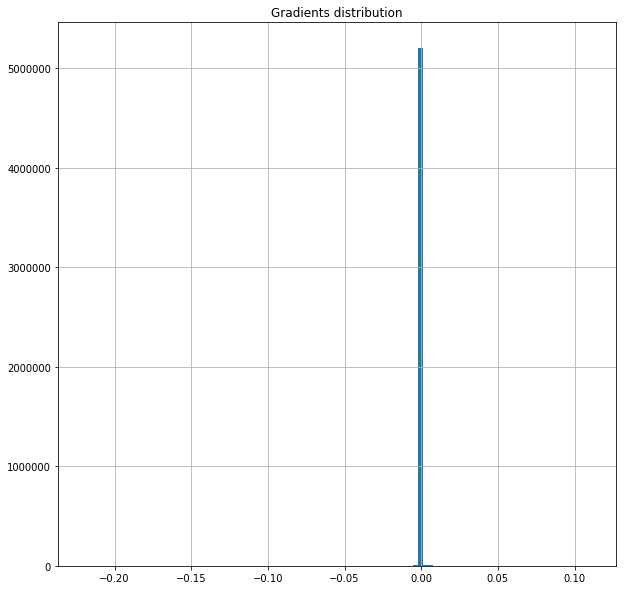

On iter 361 with training PPL: 159.91107177734375, training ACC 0.212890625
On iter 362 with training PPL: 158.47821044921875, training ACC 0.2096354216337204
On iter 363 with training PPL: 155.1318359375, training ACC 0.220703125
On iter 364 with training PPL: 138.06568908691406, training ACC 0.2276475727558136
On iter 365 with training PPL: 146.91978454589844, training ACC 0.2233072966337204
On iter 366 with training PPL: 161.84413146972656, training ACC 0.2118055522441864
On iter 367 with training PPL: 164.2105712890625, training ACC 0.2035590261220932
On iter 368 with training PPL: 157.20062255859375, training ACC 0.2217881977558136
On iter 369 with training PPL: 166.14035034179688, training ACC 0.2096354216337204
On iter 370 with training PPL: 153.3590087890625, training ACC 0.2172309011220932
On iter 371 with training PPL: 157.1877899169922, training ACC 0.21484375
On iter 372 with training PPL: 150.25628662109375, training ACC 0.2159288227558136
On iter 373 with training PPL: 14

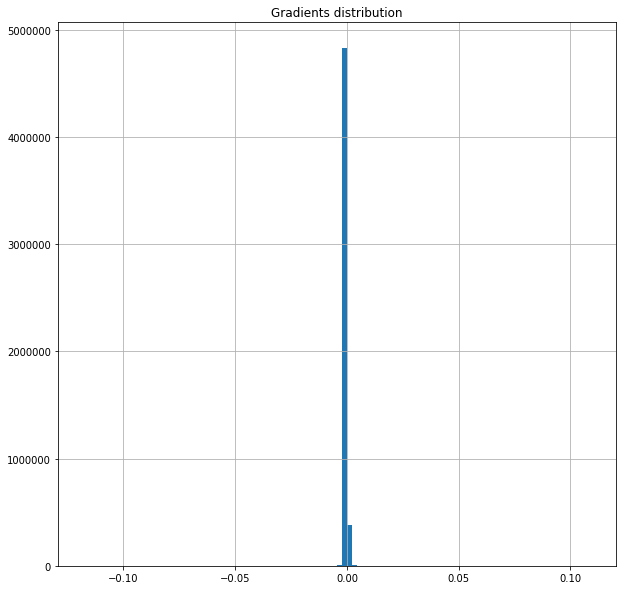

On iter 391 with training PPL: 168.47222900390625, training ACC 0.2059461772441864
On iter 392 with training PPL: 164.5666046142578, training ACC 0.2102864533662796
On iter 393 with training PPL: 156.51458740234375, training ACC 0.2159288227558136
On iter 394 with training PPL: 156.5799102783203, training ACC 0.2120225727558136
On iter 395 with training PPL: 159.169189453125, training ACC 0.2111545205116272
On iter 396 with training PPL: 152.8025665283203, training ACC 0.2150607705116272
On iter 397 with training PPL: 136.85009765625, training ACC 0.2196180522441864
On iter 398 with training PPL: 163.51657104492188, training ACC 0.2159288227558136
On iter 399 with training PPL: 129.48239135742188, training ACC 0.2261284738779068
On iter 400 with training PPL: 142.9491729736328, training ACC 0.2220052033662796
<SS> an ambitious plan including a revamped sales strategy and a surprisingly aggressive ad campaign <eos> advertisers do n't think of the magazine first says joan <unk> who joine

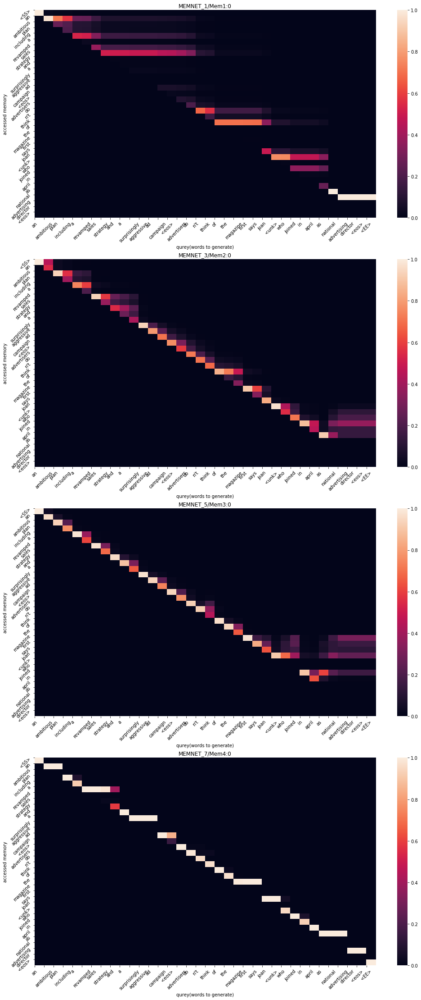

On iter 401 with training PPL: 153.1840362548828, training ACC 0.2115885466337204
On iter 402 with training PPL: 148.46107482910156, training ACC 0.2185329794883728
On iter 403 with training PPL: 136.97662353515625, training ACC 0.2289496511220932
On iter 404 with training PPL: 139.9275665283203, training ACC 0.2217881977558136
On iter 405 with training PPL: 162.4457244873047, training ACC 0.2185329794883728
On iter 406 with training PPL: 169.21673583984375, training ACC 0.20703125
On iter 407 with training PPL: 172.4750213623047, training ACC 0.2102864533662796
On iter 408 with training PPL: 142.3518829345703, training ACC 0.2174479216337204
On iter 409 with training PPL: 137.8163299560547, training ACC 0.2222222238779068
On iter 410 with training PPL: 160.21926879882812, training ACC 0.2102864533662796
On iter 411 with training PPL: 160.68759155273438, training ACC 0.2098524272441864
On iter 412 with training PPL: 168.82713317871094, training ACC 0.2013888955116272
On iter 413 with t

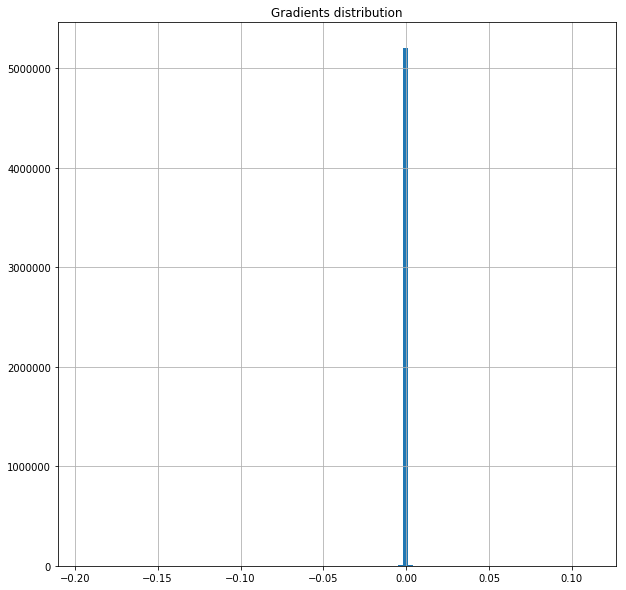

On iter 421 with training PPL: 146.05844116210938, training ACC 0.2217881977558136
On iter 422 with training PPL: 162.4906463623047, training ACC 0.1990017294883728
On iter 423 with training PPL: 145.4995574951172, training ACC 0.2198350727558136
On iter 424 with training PPL: 154.85792541503906, training ACC 0.2065972238779068
On iter 425 with training PPL: 164.031982421875, training ACC 0.2044270783662796
On iter 426 with training PPL: 160.17420959472656, training ACC 0.2185329794883728
On iter 427 with training PPL: 159.76907348632812, training ACC 0.2059461772441864
On iter 428 with training PPL: 149.2730712890625, training ACC 0.2159288227558136
On iter 429 with training PPL: 156.13034057617188, training ACC 0.2094184011220932
On iter 430 with training PPL: 148.10450744628906, training ACC 0.2135416716337204
On iter 431 with training PPL: 144.5786895751953, training ACC 0.2157118022441864
On iter 432 with training PPL: 157.0006866455078, training ACC 0.2159288227558136
On iter 433

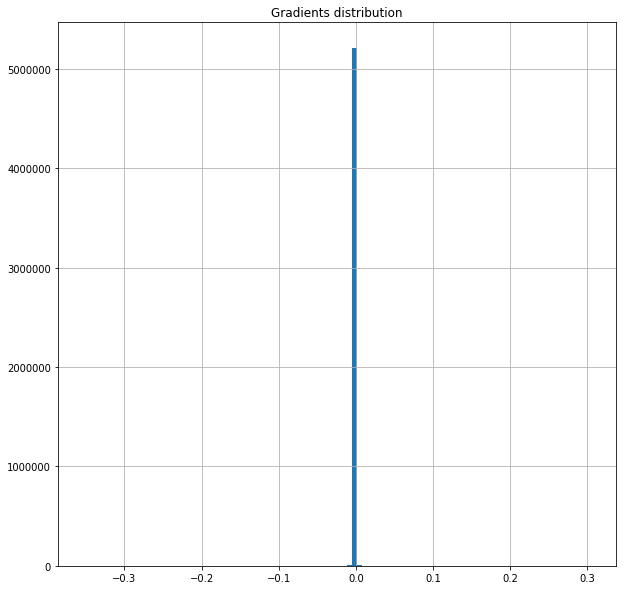

On iter 451 with training PPL: 141.5632781982422, training ACC 0.21875
On iter 452 with training PPL: 161.30442810058594, training ACC 0.2135416716337204
On iter 453 with training PPL: 152.8527069091797, training ACC 0.2180989533662796
On iter 454 with training PPL: 156.57565307617188, training ACC 0.2211371511220932
On iter 455 with training PPL: 162.19171142578125, training ACC 0.2163628488779068
On iter 456 with training PPL: 138.52459716796875, training ACC 0.2217881977558136
On iter 457 with training PPL: 160.940185546875, training ACC 0.2085503488779068
On iter 458 with training PPL: 133.2049102783203, training ACC 0.2326388955116272
On iter 459 with training PPL: 145.30287170410156, training ACC 0.2185329794883728
On iter 460 with training PPL: 152.06944274902344, training ACC 0.2152777761220932
On iter 461 with training PPL: 136.80938720703125, training ACC 0.2259114533662796
On iter 462 with training PPL: 163.52146911621094, training ACC 0.2072482705116272
On iter 463 with tra

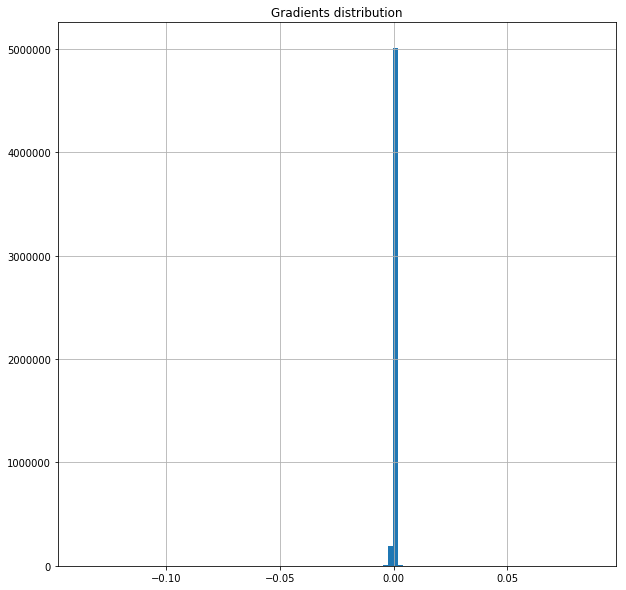

On iter 481 with training PPL: 133.3143310546875, training ACC 0.2261284738779068
On iter 482 with training PPL: 161.60560607910156, training ACC 0.1985677033662796
On iter 483 with training PPL: 139.1636199951172, training ACC 0.2200520783662796
On iter 484 with training PPL: 157.521240234375, training ACC 0.2068142294883728
On iter 485 with training PPL: 129.59475708007812, training ACC 0.2341579794883728
On iter 486 with training PPL: 138.7569122314453, training ACC 0.2209201455116272
On iter 487 with training PPL: 140.95437622070312, training ACC 0.2328559011220932
On iter 488 with training PPL: 141.95216369628906, training ACC 0.2204861044883728
On iter 489 with training PPL: 142.30845642089844, training ACC 0.2265625
On iter 490 with training PPL: 131.0356903076172, training ACC 0.2332899272441864
On iter 491 with training PPL: 139.4949493408203, training ACC 0.2272135466337204
On iter 492 with training PPL: 155.84841918945312, training ACC 0.2241753488779068
On iter 493 with tra

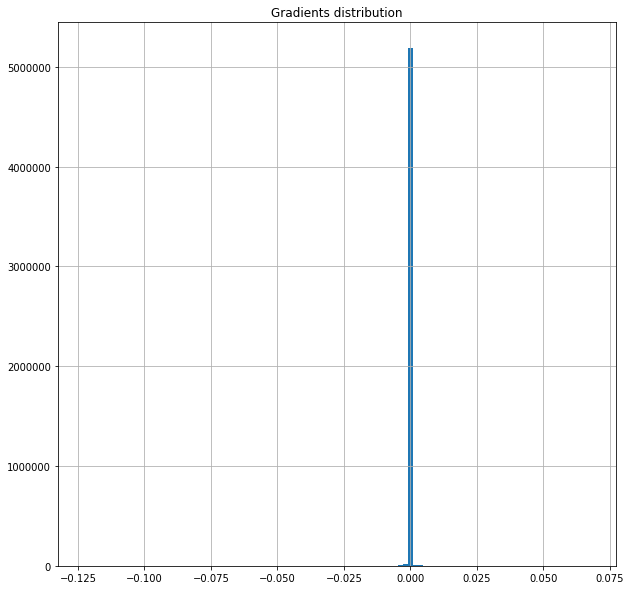

On iter 511 with training PPL: 133.3086700439453, training ACC 0.2272135466337204
On iter 512 with training PPL: 156.47518920898438, training ACC 0.2176649272441864
On iter 513 with training PPL: 163.64137268066406, training ACC 0.2109375
On iter 514 with training PPL: 151.59544372558594, training ACC 0.2233072966337204
On iter 515 with training PPL: 147.70068359375, training ACC 0.2263454794883728
On iter 516 with training PPL: 144.57394409179688, training ACC 0.2202690988779068
On iter 517 with training PPL: 142.33226013183594, training ACC 0.2176649272441864
On iter 518 with training PPL: 151.56573486328125, training ACC 0.2189670205116272
On iter 519 with training PPL: 153.87608337402344, training ACC 0.2163628488779068
On iter 520 with training PPL: 141.42138671875, training ACC 0.2191840261220932
On iter 521 with training PPL: 142.0206756591797, training ACC 0.2222222238779068
On iter 522 with training PPL: 156.26104736328125, training ACC 0.2198350727558136
On iter 523 with trai

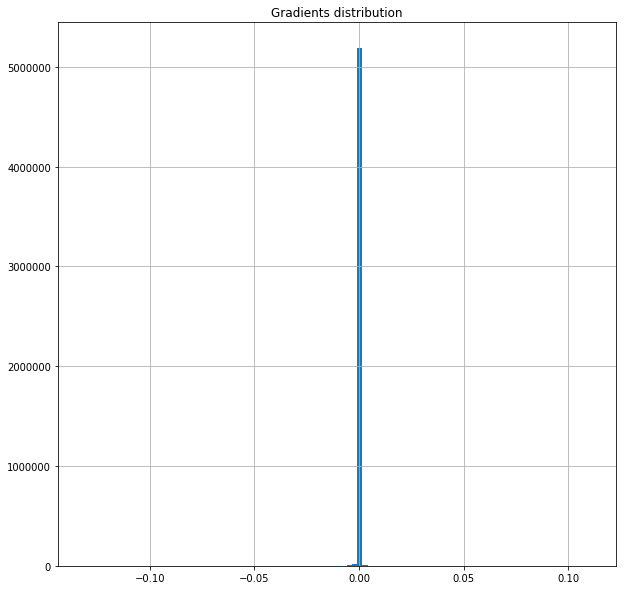

On iter 541 with training PPL: 171.26454162597656, training ACC 0.2059461772441864
On iter 542 with training PPL: 149.47821044921875, training ACC 0.2196180522441864
On iter 543 with training PPL: 137.0064697265625, training ACC 0.2254774272441864
On iter 544 with training PPL: 154.8450164794922, training ACC 0.2094184011220932
On iter 545 with training PPL: 149.12112426757812, training ACC 0.216796875
On iter 546 with training PPL: 150.94338989257812, training ACC 0.2152777761220932
On iter 547 with training PPL: 146.314697265625, training ACC 0.2141927033662796
On iter 548 with training PPL: 153.21275329589844, training ACC 0.2141927033662796
On iter 549 with training PPL: 140.3745880126953, training ACC 0.2248263955116272
On iter 550 with training PPL: 145.49803161621094, training ACC 0.2209201455116272
On iter 551 with training PPL: 147.4294891357422, training ACC 0.2133246511220932
On iter 552 with training PPL: 140.2032012939453, training ACC 0.2267795205116272
On iter 553 with t

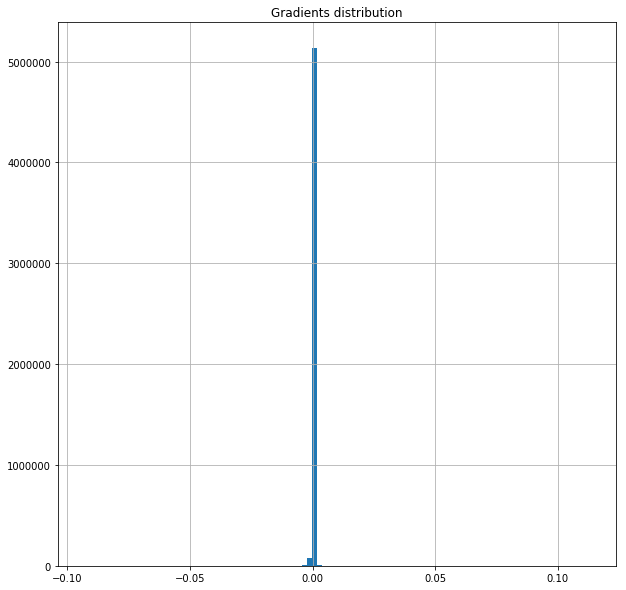

On iter 571 with training PPL: 137.6454620361328, training ACC 0.224609375
On iter 572 with training PPL: 137.9923095703125, training ACC 0.2241753488779068
On iter 573 with training PPL: 145.54579162597656, training ACC 0.2204861044883728
On iter 574 with training PPL: 136.97532653808594, training ACC 0.2233072966337204
On iter 575 with training PPL: 146.5118408203125, training ACC 0.2194010466337204
On iter 576 with training PPL: 143.5872344970703, training ACC 0.2222222238779068
On iter 577 with training PPL: 152.32656860351562, training ACC 0.2241753488779068
On iter 578 with training PPL: 168.1155242919922, training ACC 0.2092013955116272
On iter 579 with training PPL: 144.98484802246094, training ACC 0.2189670205116272
On iter 580 with training PPL: 131.39576721191406, training ACC 0.224609375
On iter 581 with training PPL: 133.07806396484375, training ACC 0.2354600727558136
On iter 582 with training PPL: 140.61167907714844, training ACC 0.220703125
On iter 583 with training PPL:

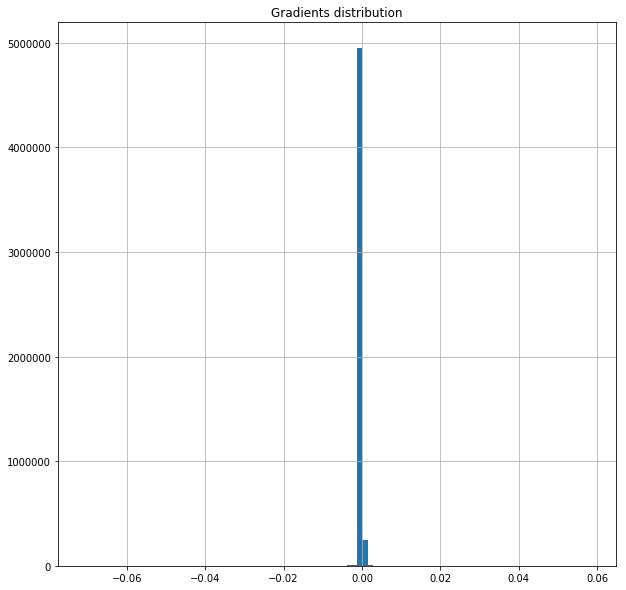

<SS> a small printing business and need the car for work as well as for weekend <unk> <eos> pay raises of N N over the past three years have given many south koreans the money to <EE>


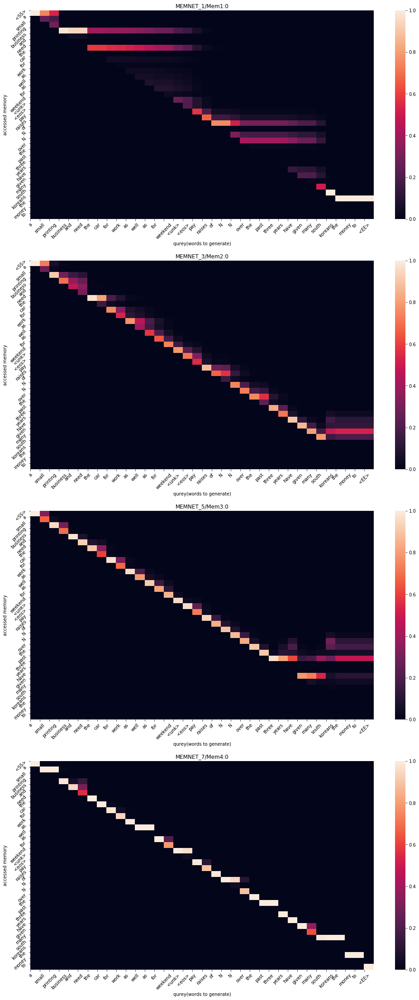

On iter 601 with training PPL: 143.21046447753906, training ACC 0.2202690988779068
On iter 602 with training PPL: 130.95835876464844, training ACC 0.2341579794883728
On iter 603 with training PPL: 148.4459228515625, training ACC 0.2150607705116272
On iter 604 with training PPL: 123.34211730957031, training ACC 0.2348090261220932
On iter 605 with training PPL: 149.6319580078125, training ACC 0.2092013955116272
On iter 606 with training PPL: 133.23007202148438, training ACC 0.2309027761220932
On iter 607 with training PPL: 132.76197814941406, training ACC 0.2280815988779068
On iter 608 with training PPL: 150.66180419921875, training ACC 0.2183159738779068
On iter 609 with training PPL: 136.9625244140625, training ACC 0.2259114533662796
On iter 610 with training PPL: 149.1571044921875, training ACC 0.2194010466337204
On iter 611 with training PPL: 128.18348693847656, training ACC 0.2313368022441864
On iter 612 with training PPL: 140.98187255859375, training ACC 0.2209201455116272
On iter 

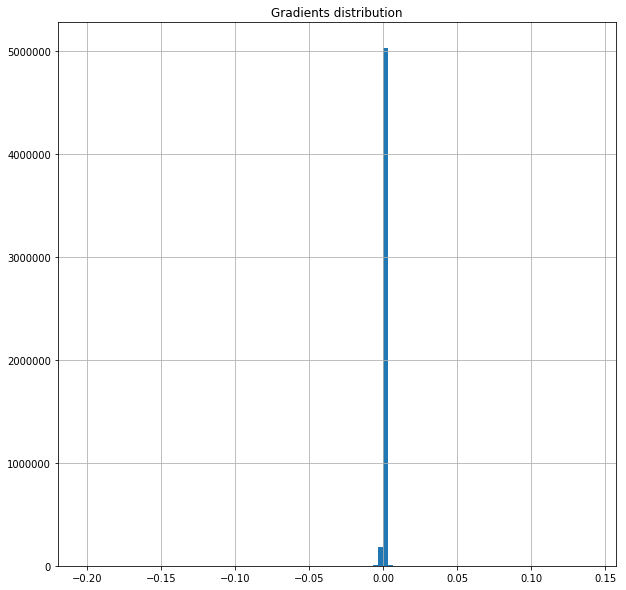

On iter 631 with training PPL: 139.487548828125, training ACC 0.2313368022441864
On iter 632 with training PPL: 150.18751525878906, training ACC 0.2159288227558136
On iter 633 with training PPL: 146.3619384765625, training ACC 0.2222222238779068
On iter 634 with training PPL: 139.57876586914062, training ACC 0.2272135466337204
On iter 635 with training PPL: 148.97222900390625, training ACC 0.2072482705116272
On iter 636 with training PPL: 136.55096435546875, training ACC 0.2241753488779068
On iter 637 with training PPL: 134.70114135742188, training ACC 0.224609375
On iter 638 with training PPL: 145.50123596191406, training ACC 0.2100694477558136
On iter 639 with training PPL: 155.36871337890625, training ACC 0.2150607705116272
On iter 640 with training PPL: 149.6499481201172, training ACC 0.2152777761220932
On iter 641 with training PPL: 135.2578125, training ACC 0.2239583283662796
On iter 642 with training PPL: 137.75779724121094, training ACC 0.2282986044883728
On iter 643 with train

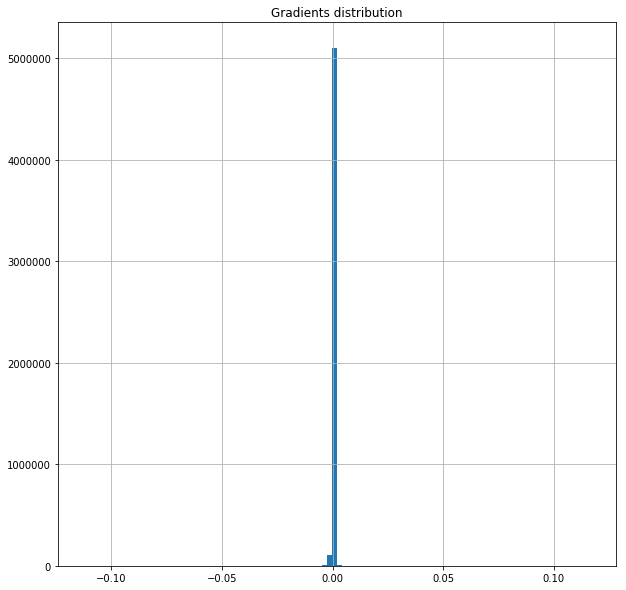

On iter 661 with training PPL: 141.15164184570312, training ACC 0.220703125
On iter 662 with training PPL: 151.5940704345703, training ACC 0.2202690988779068
On iter 663 with training PPL: 142.35202026367188, training ACC 0.2254774272441864
On iter 664 with training PPL: 159.04129028320312, training ACC 0.2000868022441864
On iter 665 with training PPL: 146.05816650390625, training ACC 0.2213541716337204
On iter 666 with training PPL: 129.2102813720703, training ACC 0.2239583283662796
On iter 667 with training PPL: 156.4407958984375, training ACC 0.2146267294883728
On iter 668 with training PPL: 137.30862426757812, training ACC 0.2259114533662796
On iter 669 with training PPL: 147.97186279296875, training ACC 0.2233072966337204
On iter 670 with training PPL: 153.9480743408203, training ACC 0.2133246511220932
On iter 671 with training PPL: 141.27601623535156, training ACC 0.2282986044883728
On iter 672 with training PPL: 134.1291046142578, training ACC 0.2293836772441864
On iter 673 with

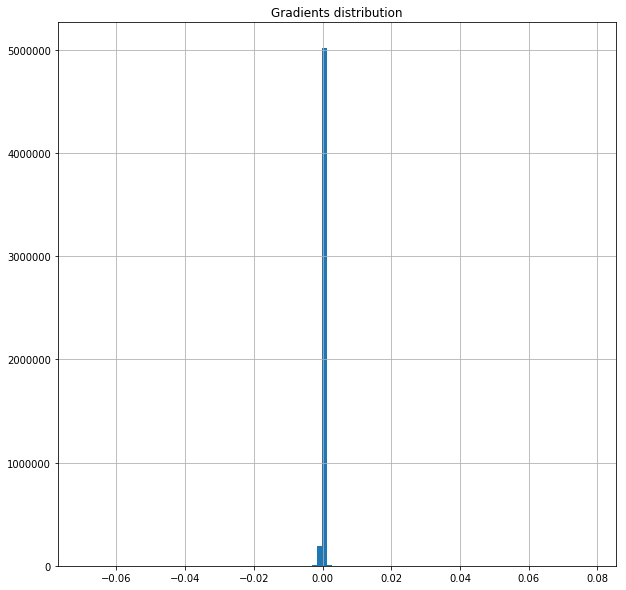

On iter 691 with training PPL: 144.04525756835938, training ACC 0.2141927033662796
On iter 692 with training PPL: 141.85791015625, training ACC 0.2276475727558136
On iter 693 with training PPL: 139.57684326171875, training ACC 0.2185329794883728
On iter 694 with training PPL: 147.50135803222656, training ACC 0.2154947966337204
On iter 695 with training PPL: 116.1948013305664, training ACC 0.2345920205116272
On iter 696 with training PPL: 145.5693817138672, training ACC 0.2254774272441864
On iter 697 with training PPL: 142.0147247314453, training ACC 0.2256944477558136
On iter 698 with training PPL: 138.8107147216797, training ACC 0.2224392294883728
On iter 699 with training PPL: 131.03536987304688, training ACC 0.2293836772441864
On iter 700 with training PPL: 132.9024658203125, training ACC 0.224609375
On iter 701 with training PPL: 129.77037048339844, training ACC 0.2256944477558136
On iter 702 with training PPL: 138.3036346435547, training ACC 0.2263454794883728
On iter 703 with tra

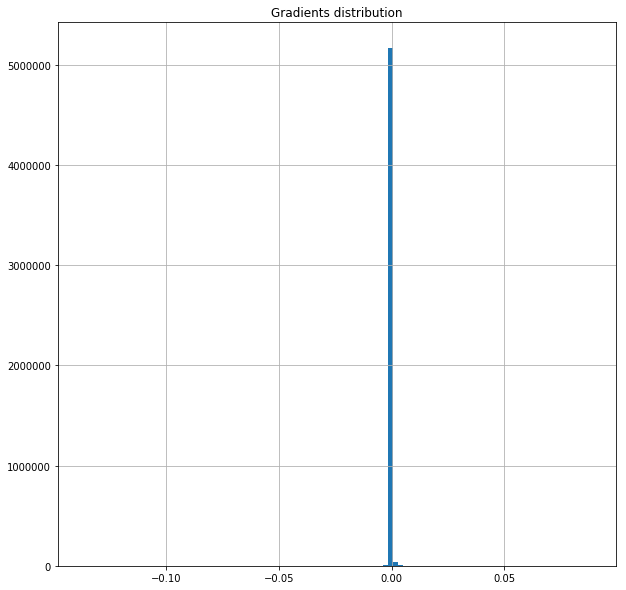

On iter 721 with training PPL: 134.8519744873047, training ACC 0.2259114533662796
On iter 722 with training PPL: 134.34974670410156, training ACC 0.2163628488779068
On iter 723 with training PPL: 128.125732421875, training ACC 0.2291666716337204
On iter 724 with training PPL: 132.36134338378906, training ACC 0.2239583283662796
On iter 725 with training PPL: 148.48365783691406, training ACC 0.2196180522441864
On iter 726 with training PPL: 139.3145294189453, training ACC 0.2280815988779068
On iter 727 with training PPL: 149.35360717773438, training ACC 0.2178819477558136
On iter 728 with training PPL: 134.23081970214844, training ACC 0.2278645783662796
On iter 729 with training PPL: 149.8924102783203, training ACC 0.2107204794883728
On iter 730 with training PPL: 131.04237365722656, training ACC 0.2384982705116272
On iter 731 with training PPL: 141.06887817382812, training ACC 0.2215711772441864
On iter 732 with training PPL: 130.34259033203125, training ACC 0.2263454794883728
On iter 7

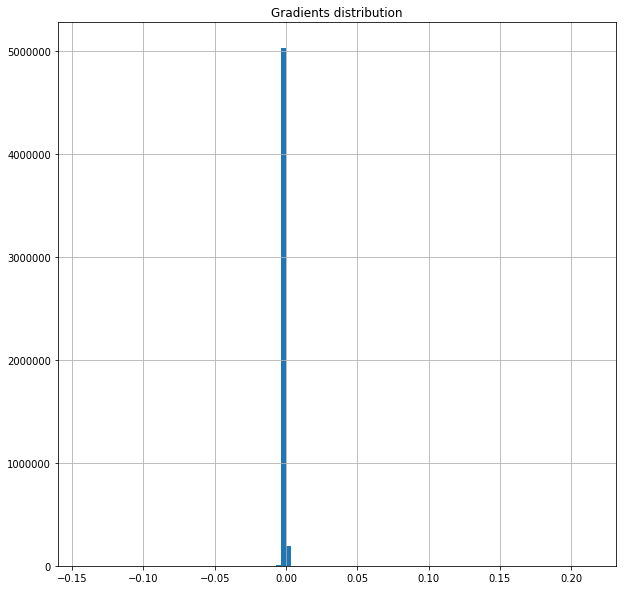

On iter 751 with training PPL: 140.7404022216797, training ACC 0.2178819477558136
On iter 752 with training PPL: 150.57215881347656, training ACC 0.21484375
On iter 753 with training PPL: 156.28094482421875, training ACC 0.2135416716337204
On iter 754 with training PPL: 139.72128295898438, training ACC 0.2241753488779068
On iter 755 with training PPL: 130.676025390625, training ACC 0.236328125
On iter 756 with training PPL: 152.74647521972656, training ACC 0.2120225727558136
On iter 757 with training PPL: 117.97024536132812, training ACC 0.2415364533662796
On iter 758 with training PPL: 138.73342895507812, training ACC 0.2269965261220932
On iter 759 with training PPL: 151.09561157226562, training ACC 0.2157118022441864
On iter 760 with training PPL: 146.15396118164062, training ACC 0.2248263955116272
On iter 761 with training PPL: 143.10125732421875, training ACC 0.2261284738779068
On iter 762 with training PPL: 126.80765533447266, training ACC 0.23046875
On iter 763 with training PPL:

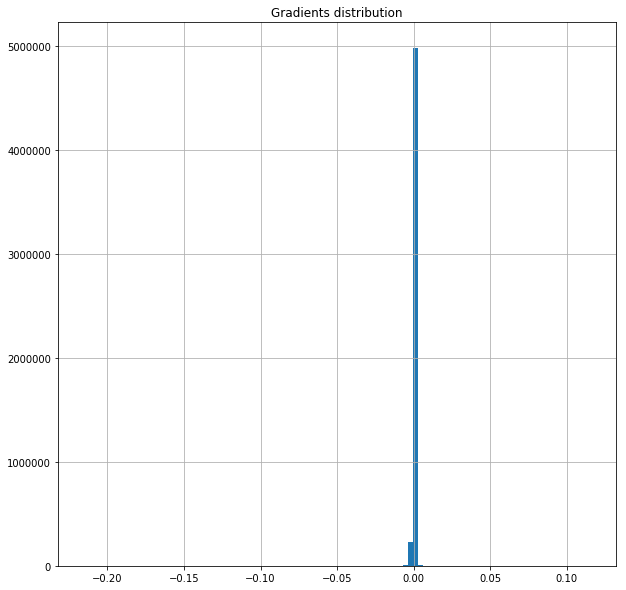

On iter 781 with training PPL: 128.47714233398438, training ACC 0.2278645783662796
On iter 782 with training PPL: 151.92703247070312, training ACC 0.2204861044883728
On iter 783 with training PPL: 124.68183135986328, training ACC 0.2361111044883728
On iter 784 with training PPL: 133.90997314453125, training ACC 0.2330729216337204
On iter 785 with training PPL: 134.2071533203125, training ACC 0.2287326455116272
On iter 786 with training PPL: 138.01797485351562, training ACC 0.21484375
On iter 787 with training PPL: 126.4281234741211, training ACC 0.2454427033662796
On iter 788 with training PPL: 142.25987243652344, training ACC 0.2154947966337204
On iter 789 with training PPL: 124.39226531982422, training ACC 0.232421875
On iter 790 with training PPL: 126.10330200195312, training ACC 0.2352430522441864
On iter 791 with training PPL: 135.05596923828125, training ACC 0.2217881977558136
On iter 792 with training PPL: 129.55224609375, training ACC 0.2256944477558136
On iter 793 with trainin

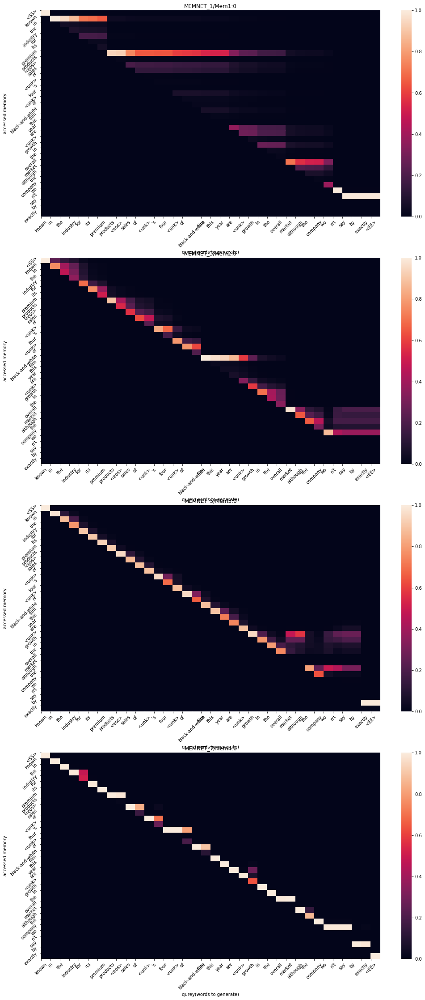

On iter 801 with training PPL: 131.7327880859375, training ACC 0.2326388955116272
On iter 802 with training PPL: 134.04661560058594, training ACC 0.2157118022441864
On iter 803 with training PPL: 144.98574829101562, training ACC 0.2259114533662796
On iter 804 with training PPL: 141.20489501953125, training ACC 0.2170138955116272
On iter 805 with training PPL: 143.50523376464844, training ACC 0.220703125
On iter 806 with training PPL: 140.0174102783203, training ACC 0.2209201455116272
On iter 807 with training PPL: 150.44656372070312, training ACC 0.2174479216337204
On iter 808 with training PPL: 144.65594482421875, training ACC 0.2152777761220932
On iter 809 with training PPL: 137.6734161376953, training ACC 0.2272135466337204
On iter 810 with training PPL: 142.69256591796875, training ACC 0.2094184011220932
	 validation PPL 183.18113708496094, validation acc 0.2146267294883728
shape of gradients is (5228544,), L2 norm of gradients is 2.262950897216797, details:                   0
cou

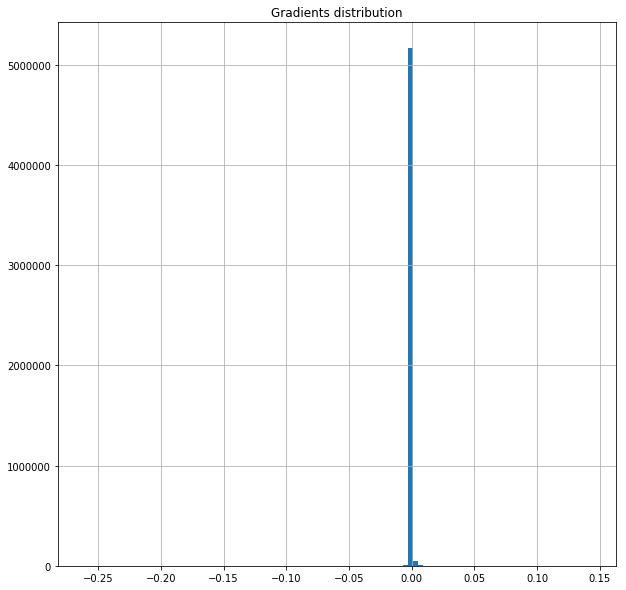

On iter 811 with training PPL: 137.07162475585938, training ACC 0.220703125
On iter 812 with training PPL: 146.7369842529297, training ACC 0.21484375
On iter 813 with training PPL: 130.00677490234375, training ACC 0.2224392294883728
On iter 814 with training PPL: 142.19143676757812, training ACC 0.2170138955116272
On iter 815 with training PPL: 114.1260757446289, training ACC 0.2415364533662796
On iter 816 with training PPL: 118.0775146484375, training ACC 0.2354600727558136
On iter 817 with training PPL: 136.80313110351562, training ACC 0.2176649272441864
On iter 818 with training PPL: 145.51197814941406, training ACC 0.2109375
On iter 819 with training PPL: 131.82476806640625, training ACC 0.2250434011220932
On iter 820 with training PPL: 135.4335479736328, training ACC 0.2259114533662796
On iter 821 with training PPL: 127.08561706542969, training ACC 0.232421875
On iter 822 with training PPL: 140.86306762695312, training ACC 0.2237413227558136
On iter 823 with training PPL: 138.6117

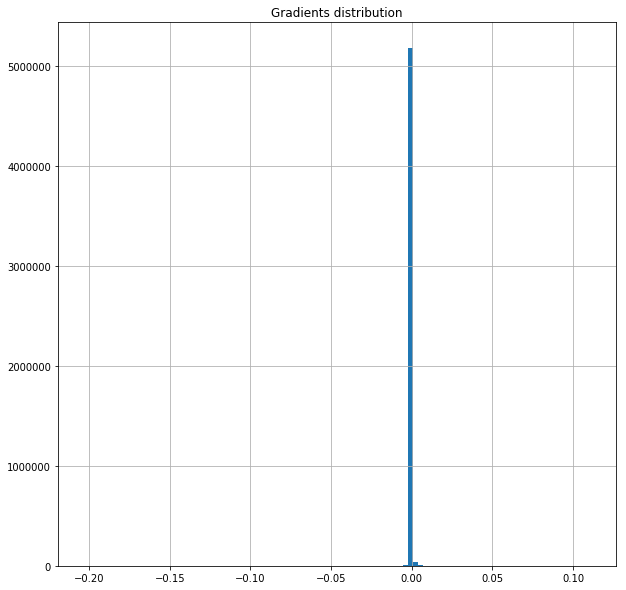

On iter 841 with training PPL: 128.544921875, training ACC 0.2332899272441864
On iter 842 with training PPL: 138.4092559814453, training ACC 0.2230902761220932
On iter 843 with training PPL: 135.2191925048828, training ACC 0.2274305522441864
On iter 844 with training PPL: 142.9197235107422, training ACC 0.2209201455116272
On iter 845 with training PPL: 129.5067901611328, training ACC 0.2196180522441864
On iter 846 with training PPL: 133.0727996826172, training ACC 0.2356770783662796
On iter 847 with training PPL: 127.55534362792969, training ACC 0.2350260466337204
On iter 848 with training PPL: 136.64561462402344, training ACC 0.2276475727558136
On iter 849 with training PPL: 137.62576293945312, training ACC 0.2191840261220932
On iter 850 with training PPL: 124.77098083496094, training ACC 0.2280815988779068
On iter 851 with training PPL: 119.7840805053711, training ACC 0.2404513955116272
On iter 852 with training PPL: 135.29380798339844, training ACC 0.2217881977558136
On iter 853 wit

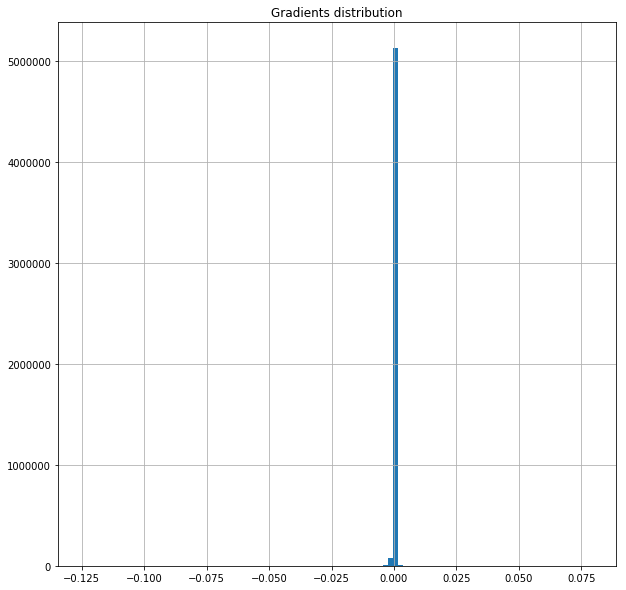

On iter 871 with training PPL: 130.03504943847656, training ACC 0.2350260466337204
On iter 872 with training PPL: 123.7645263671875, training ACC 0.2376302033662796
On iter 873 with training PPL: 135.96641540527344, training ACC 0.2176649272441864
On iter 874 with training PPL: 144.77670288085938, training ACC 0.2178819477558136
On iter 875 with training PPL: 123.05484771728516, training ACC 0.2356770783662796
On iter 876 with training PPL: 159.7783660888672, training ACC 0.21484375
On iter 877 with training PPL: 147.8252410888672, training ACC 0.2213541716337204
On iter 878 with training PPL: 136.6831512451172, training ACC 0.220703125
On iter 879 with training PPL: 142.78826904296875, training ACC 0.2202690988779068
On iter 880 with training PPL: 134.4965362548828, training ACC 0.2356770783662796
On iter 881 with training PPL: 147.87551879882812, training ACC 0.2042100727558136
On iter 882 with training PPL: 136.2687530517578, training ACC 0.2209201455116272
On iter 883 with training

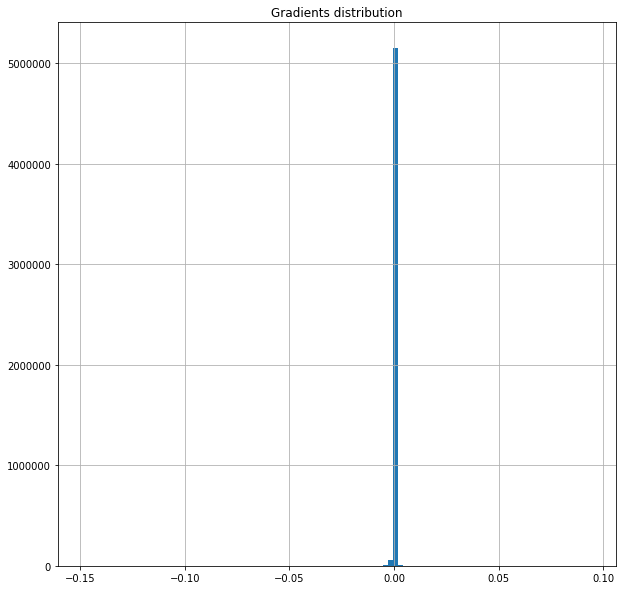

On iter 901 with training PPL: 127.5438461303711, training ACC 0.2259114533662796
On iter 902 with training PPL: 139.90101623535156, training ACC 0.21484375
On iter 903 with training PPL: 139.92129516601562, training ACC 0.2248263955116272
On iter 904 with training PPL: 121.27114868164062, training ACC 0.2352430522441864
On iter 905 with training PPL: 138.52989196777344, training ACC 0.2289496511220932
On iter 906 with training PPL: 131.46188354492188, training ACC 0.2313368022441864
On iter 907 with training PPL: 135.07566833496094, training ACC 0.2220052033662796
On iter 908 with training PPL: 141.91737365722656, training ACC 0.2157118022441864
On iter 909 with training PPL: 128.585693359375, training ACC 0.2302517294883728
On iter 910 with training PPL: 131.3516082763672, training ACC 0.2198350727558136
On iter 911 with training PPL: 139.158447265625, training ACC 0.2196180522441864
On iter 912 with training PPL: 127.86756134033203, training ACC 0.2252604216337204
On iter 913 with t

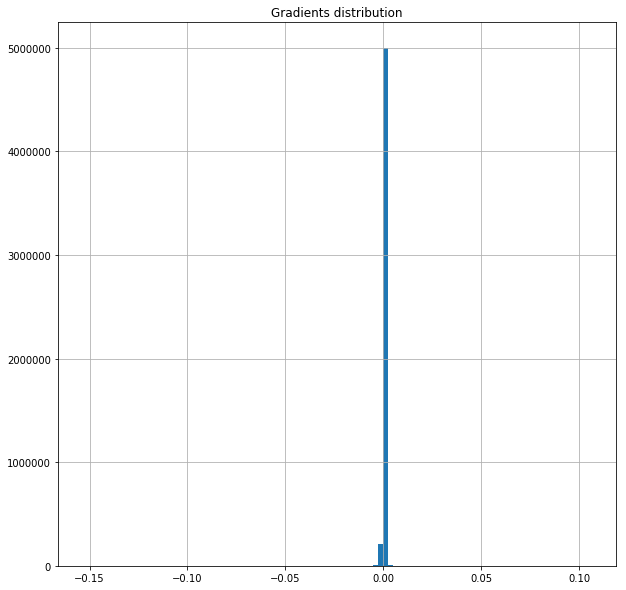

On iter 931 with training PPL: 138.94163513183594, training ACC 0.2311197966337204
On iter 932 with training PPL: 128.7445831298828, training ACC 0.2328559011220932
On iter 933 with training PPL: 126.58242797851562, training ACC 0.2278645783662796
On iter 934 with training PPL: 130.06419372558594, training ACC 0.2237413227558136
On iter 935 with training PPL: 129.3375701904297, training ACC 0.2282986044883728
On iter 936 with training PPL: 131.5997314453125, training ACC 0.2222222238779068
On iter 937 with training PPL: 140.2830352783203, training ACC 0.2261284738779068
On iter 938 with training PPL: 145.35546875, training ACC 0.2233072966337204
On iter 939 with training PPL: 123.19828033447266, training ACC 0.236328125
On iter 940 with training PPL: 130.04527282714844, training ACC 0.2330729216337204
On iter 941 with training PPL: 140.1383056640625, training ACC 0.2122395783662796
On iter 942 with training PPL: 132.67002868652344, training ACC 0.2267795205116272
On iter 943 with train

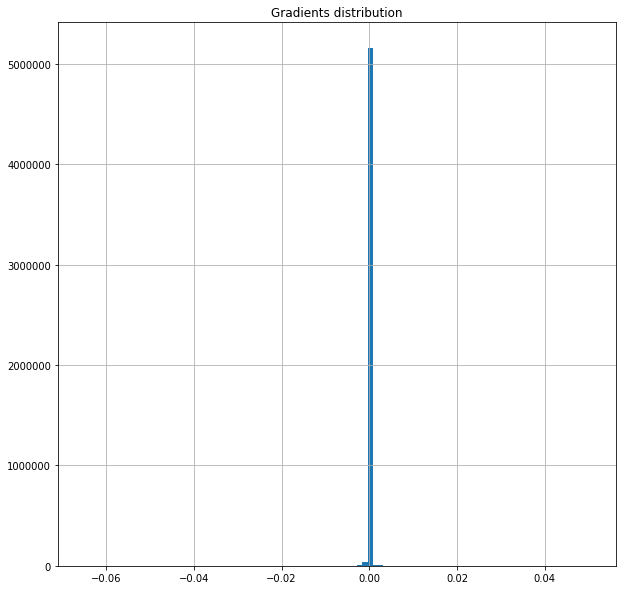

On iter 961 with training PPL: 138.3686065673828, training ACC 0.2180989533662796
On iter 962 with training PPL: 143.792724609375, training ACC 0.2154947966337204
On iter 963 with training PPL: 124.43255615234375, training ACC 0.2311197966337204
On iter 964 with training PPL: 123.3366470336914, training ACC 0.2280815988779068
On iter 965 with training PPL: 144.501708984375, training ACC 0.2224392294883728
On iter 966 with training PPL: 133.69578552246094, training ACC 0.2335069477558136
On iter 967 with training PPL: 135.7051239013672, training ACC 0.2154947966337204
On iter 968 with training PPL: 129.59425354003906, training ACC 0.23046875
On iter 969 with training PPL: 151.80471801757812, training ACC 0.2157118022441864
On iter 970 with training PPL: 118.41255187988281, training ACC 0.234375
On iter 971 with training PPL: 145.1154327392578, training ACC 0.2194010466337204
On iter 972 with training PPL: 125.6801528930664, training ACC 0.2293836772441864
On iter 973 with training PPL: 

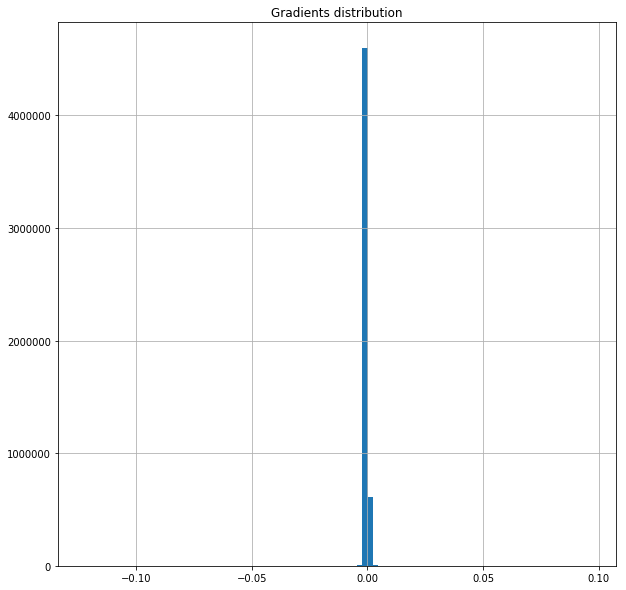

On iter 991 with training PPL: 139.4501190185547, training ACC 0.2174479216337204
On iter 992 with training PPL: 128.7537384033203, training ACC 0.2263454794883728
On iter 993 with training PPL: 127.4070816040039, training ACC 0.2263454794883728
On iter 994 with training PPL: 129.6477813720703, training ACC 0.2315538227558136
On iter 995 with training PPL: 120.79473114013672, training ACC 0.2274305522441864
On iter 996 with training PPL: 130.6361541748047, training ACC 0.2274305522441864
On iter 997 with training PPL: 136.14450073242188, training ACC 0.2237413227558136
On iter 998 with training PPL: 126.52727508544922, training ACC 0.2302517294883728
On iter 999 with training PPL: 135.1884307861328, training ACC 0.2235243022441864
On iter 1000 with training PPL: 116.78470611572266, training ACC 0.2395833283662796
<SS> of N with N <unk> <eos> black activist walter sisulu said the african national congress would n't reject violence as a way to pressure the south african government into c

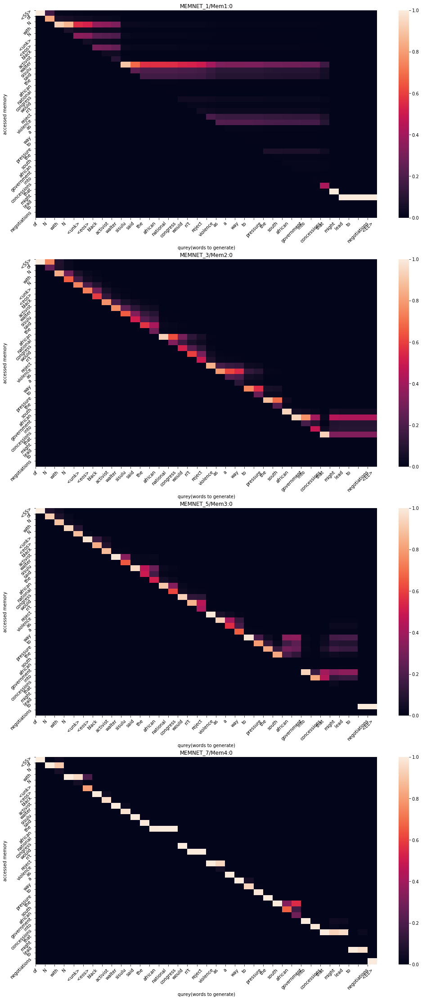

On iter 1001 with training PPL: 129.08273315429688, training ACC 0.2196180522441864
On iter 1002 with training PPL: 127.25880432128906, training ACC 0.2220052033662796
On iter 1003 with training PPL: 132.07159423828125, training ACC 0.2313368022441864
On iter 1004 with training PPL: 135.4545440673828, training ACC 0.2198350727558136
On iter 1005 with training PPL: 128.94561767578125, training ACC 0.23046875
On iter 1006 with training PPL: 132.7703399658203, training ACC 0.2261284738779068
On iter 1007 with training PPL: 134.36767578125, training ACC 0.2250434011220932
On iter 1008 with training PPL: 114.01021575927734, training ACC 0.2434895783662796
On iter 1009 with training PPL: 129.65057373046875, training ACC 0.2322048544883728
On iter 1010 with training PPL: 143.2946319580078, training ACC 0.2165798544883728
On iter 1011 with training PPL: 130.29449462890625, training ACC 0.2391493022441864
On iter 1012 with training PPL: 134.09571838378906, training ACC 0.2252604216337204
On ite

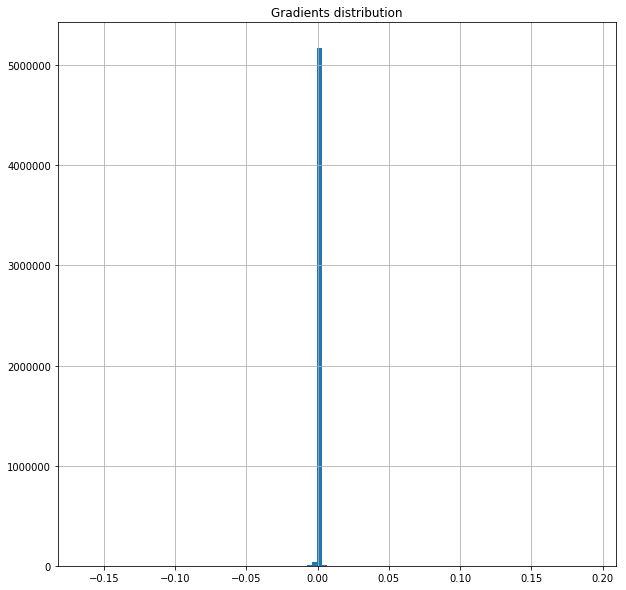

On iter 1021 with training PPL: 133.34231567382812, training ACC 0.2291666716337204
On iter 1022 with training PPL: 142.2721405029297, training ACC 0.2174479216337204
On iter 1023 with training PPL: 131.6044464111328, training ACC 0.2293836772441864
On iter 1024 with training PPL: 132.77305603027344, training ACC 0.2230902761220932
On iter 1025 with training PPL: 137.79347229003906, training ACC 0.2252604216337204
On iter 1026 with training PPL: 135.69302368164062, training ACC 0.2237413227558136
On iter 1027 with training PPL: 146.04507446289062, training ACC 0.2185329794883728
On iter 1028 with training PPL: 124.2605972290039, training ACC 0.2361111044883728
On iter 1029 with training PPL: 120.7105484008789, training ACC 0.2374131977558136
On iter 1030 with training PPL: 121.33171081542969, training ACC 0.2408854216337204
On iter 1031 with training PPL: 121.11183166503906, training ACC 0.2322048544883728
On iter 1032 with training PPL: 136.82974243164062, training ACC 0.2196180522441

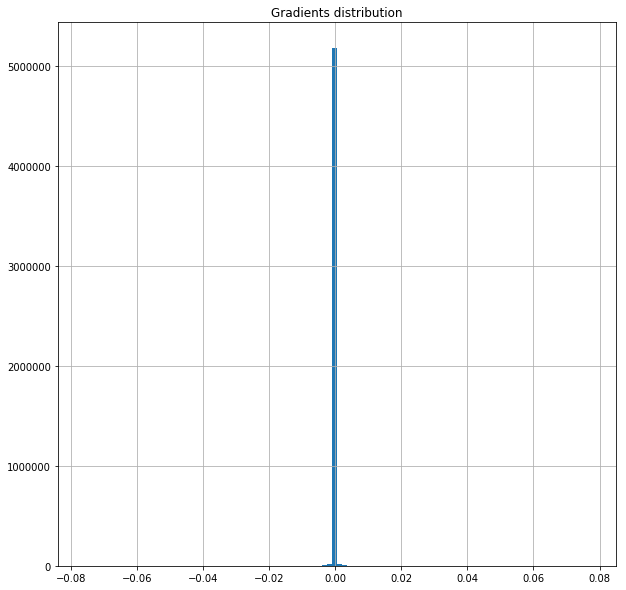

On iter 1051 with training PPL: 118.83848571777344, training ACC 0.2445746511220932
On iter 1052 with training PPL: 131.18798828125, training ACC 0.2319878488779068
On iter 1053 with training PPL: 149.3499755859375, training ACC 0.2081163227558136
On iter 1054 with training PPL: 143.48204040527344, training ACC 0.2224392294883728
On iter 1055 with training PPL: 135.15542602539062, training ACC 0.2191840261220932
On iter 1056 with training PPL: 112.47956848144531, training ACC 0.2380642294883728
On iter 1057 with training PPL: 137.83999633789062, training ACC 0.2189670205116272
On iter 1058 with training PPL: 131.87733459472656, training ACC 0.23046875
On iter 1059 with training PPL: 138.25892639160156, training ACC 0.21875
On iter 1060 with training PPL: 137.6111297607422, training ACC 0.236328125
On iter 1061 with training PPL: 130.54251098632812, training ACC 0.232421875
On iter 1062 with training PPL: 135.37692260742188, training ACC 0.2269965261220932
On iter 1063 with training PPL

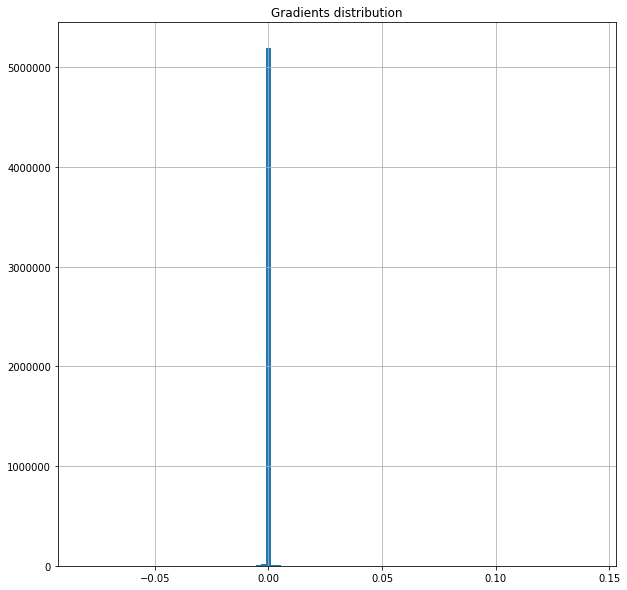

On iter 1081 with training PPL: 120.28146362304688, training ACC 0.2367621511220932
On iter 1082 with training PPL: 127.0887680053711, training ACC 0.2287326455116272
On iter 1083 with training PPL: 130.9186553955078, training ACC 0.2296006977558136
On iter 1084 with training PPL: 132.7642059326172, training ACC 0.2272135466337204
On iter 1085 with training PPL: 125.14469146728516, training ACC 0.2293836772441864
On iter 1086 with training PPL: 137.2776641845703, training ACC 0.2185329794883728
On iter 1087 with training PPL: 131.54766845703125, training ACC 0.2215711772441864
On iter 1088 with training PPL: 122.63888549804688, training ACC 0.2341579794883728
On iter 1089 with training PPL: 116.14550018310547, training ACC 0.2404513955116272
On iter 1090 with training PPL: 151.08438110351562, training ACC 0.2039930522441864
On iter 1091 with training PPL: 129.7799530029297, training ACC 0.2317708283662796
On iter 1092 with training PPL: 126.2460708618164, training ACC 0.229600697755813

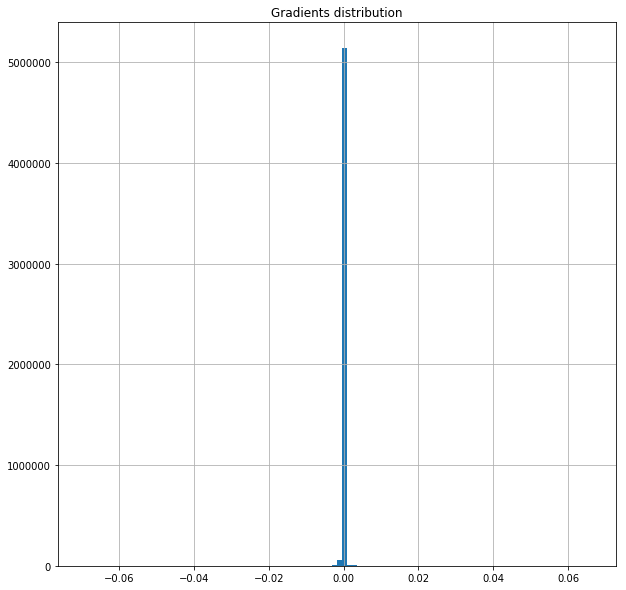

On iter 1111 with training PPL: 127.67223358154297, training ACC 0.2337239533662796
On iter 1112 with training PPL: 140.14511108398438, training ACC 0.2189670205116272
On iter 1113 with training PPL: 119.28699493408203, training ACC 0.2256944477558136
On iter 1114 with training PPL: 118.52191162109375, training ACC 0.2358940988779068
On iter 1115 with training PPL: 122.11807250976562, training ACC 0.2415364533662796
On iter 1116 with training PPL: 117.92913055419922, training ACC 0.2278645783662796
On iter 1117 with training PPL: 123.13272857666016, training ACC 0.2326388955116272
On iter 1118 with training PPL: 134.86624145507812, training ACC 0.2256944477558136
On iter 1119 with training PPL: 122.34386444091797, training ACC 0.2328559011220932
On iter 1120 with training PPL: 126.03855895996094, training ACC 0.2263454794883728
On iter 1121 with training PPL: 141.63499450683594, training ACC 0.208984375
On iter 1122 with training PPL: 128.96946716308594, training ACC 0.2280815988779068

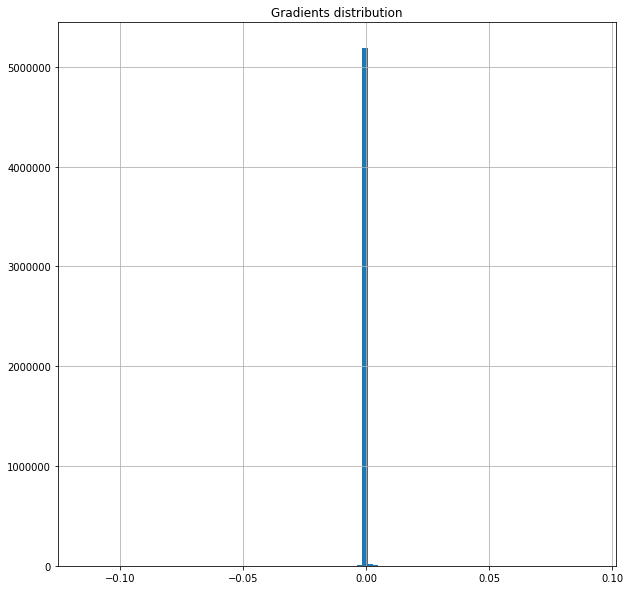

On iter 1141 with training PPL: 114.8415298461914, training ACC 0.2421875
On iter 1142 with training PPL: 134.1540985107422, training ACC 0.2254774272441864
On iter 1143 with training PPL: 136.93431091308594, training ACC 0.2263454794883728
On iter 1144 with training PPL: 135.40036010742188, training ACC 0.2230902761220932
On iter 1145 with training PPL: 128.9795684814453, training ACC 0.23046875
On iter 1146 with training PPL: 123.07228088378906, training ACC 0.2328559011220932
On iter 1147 with training PPL: 130.57518005371094, training ACC 0.2322048544883728
On iter 1148 with training PPL: 136.20755004882812, training ACC 0.2133246511220932
On iter 1149 with training PPL: 122.13134765625, training ACC 0.232421875
On iter 1150 with training PPL: 129.95620727539062, training ACC 0.2222222238779068
On iter 1151 with training PPL: 118.47637176513672, training ACC 0.2376302033662796
On iter 1152 with training PPL: 123.55197143554688, training ACC 0.2272135466337204
On iter 1153 with trai

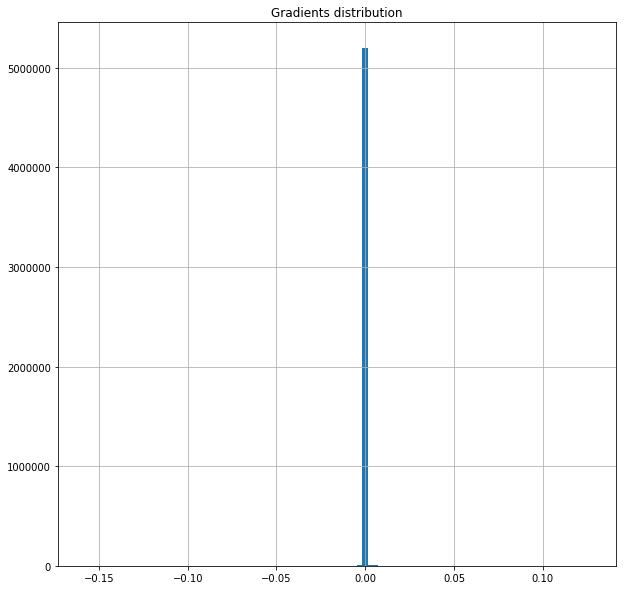

On iter 1171 with training PPL: 126.20021057128906, training ACC 0.2302517294883728
On iter 1172 with training PPL: 131.2108154296875, training ACC 0.2387152761220932
On iter 1173 with training PPL: 116.81817626953125, training ACC 0.2380642294883728
On iter 1174 with training PPL: 125.05198669433594, training ACC 0.2296006977558136
On iter 1175 with training PPL: 120.77099609375, training ACC 0.2415364533662796
On iter 1176 with training PPL: 113.11839294433594, training ACC 0.2389322966337204
On iter 1177 with training PPL: 120.36654663085938, training ACC 0.2335069477558136
On iter 1178 with training PPL: 130.43789672851562, training ACC 0.2302517294883728
On iter 1179 with training PPL: 123.7280044555664, training ACC 0.23046875
On iter 1180 with training PPL: 127.12986755371094, training ACC 0.2272135466337204
On iter 1181 with training PPL: 124.28193664550781, training ACC 0.228515625
On iter 1182 with training PPL: 119.38690948486328, training ACC 0.2374131977558136
On iter 1183

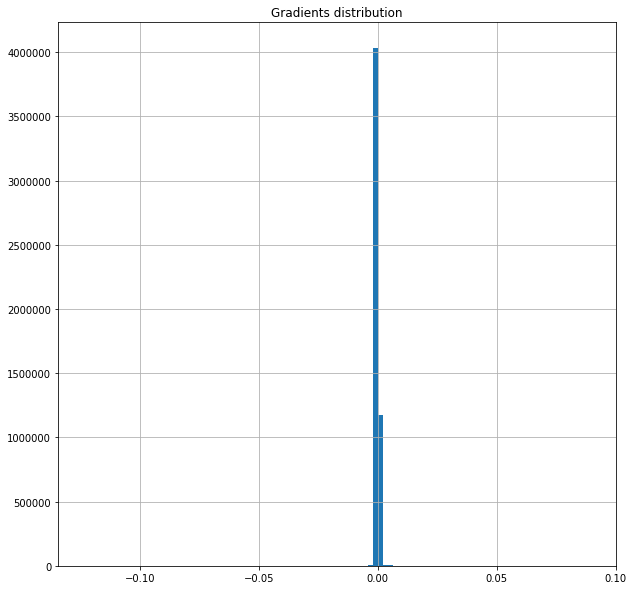

<SS> company effective jan. N <eos> he will succeed joel <unk> who will remain a vice president of the company and continue to represent <unk> stations in several industry organizations the company said <eos> literally <eos> <EE>


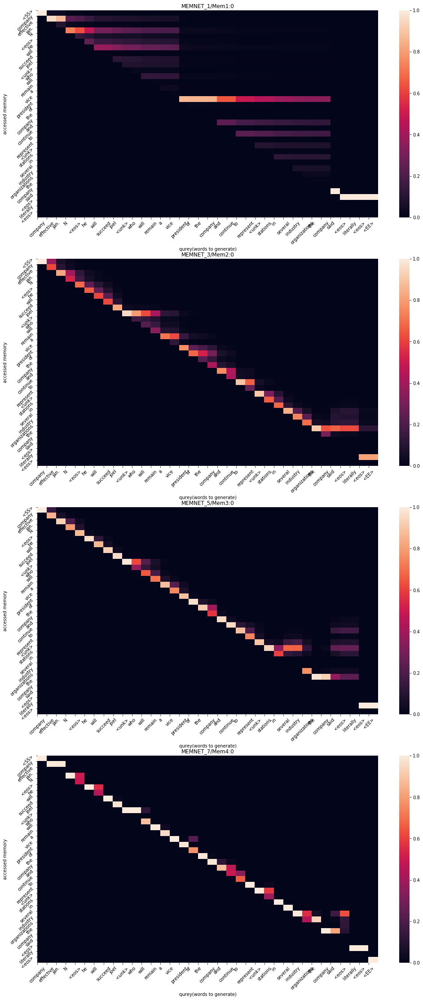

On iter 1201 with training PPL: 127.34038543701172, training ACC 0.2267795205116272
On iter 1202 with training PPL: 131.06268310546875, training ACC 0.2335069477558136
On iter 1203 with training PPL: 126.5348129272461, training ACC 0.234375
On iter 1204 with training PPL: 120.71509552001953, training ACC 0.2319878488779068
On iter 1205 with training PPL: 137.41506958007812, training ACC 0.2172309011220932
On iter 1206 with training PPL: 136.32386779785156, training ACC 0.2230902761220932
On iter 1207 with training PPL: 135.2554931640625, training ACC 0.2235243022441864
On iter 1208 with training PPL: 125.7348861694336, training ACC 0.2261284738779068
On iter 1209 with training PPL: 133.89183044433594, training ACC 0.2241753488779068
On iter 1210 with training PPL: 126.68199920654297, training ACC 0.2309027761220932
On iter 1211 with training PPL: 115.0301742553711, training ACC 0.2384982705116272
On iter 1212 with training PPL: 134.74166870117188, training ACC 0.2269965261220932
On ite

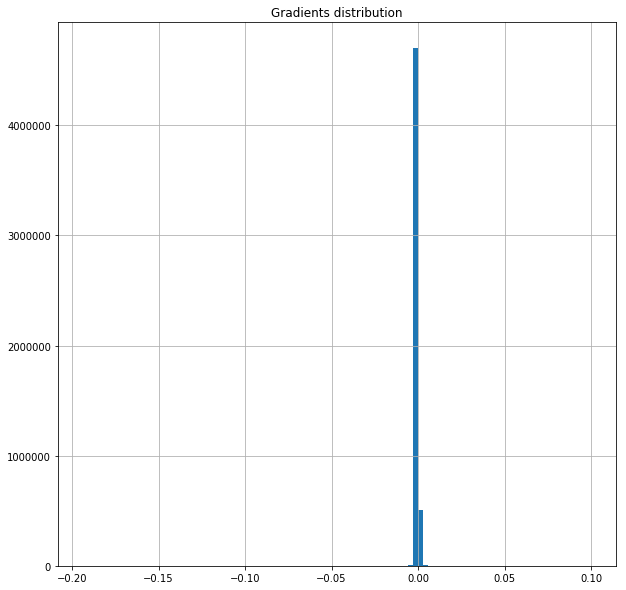

On iter 1231 with training PPL: 131.86953735351562, training ACC 0.22265625
On iter 1232 with training PPL: 136.11749267578125, training ACC 0.2332899272441864
On iter 1233 with training PPL: 122.74671173095703, training ACC 0.23828125
On iter 1234 with training PPL: 123.12069702148438, training ACC 0.2213541716337204
On iter 1235 with training PPL: 124.94554138183594, training ACC 0.2282986044883728
On iter 1236 with training PPL: 127.87158203125, training ACC 0.2311197966337204
On iter 1237 with training PPL: 124.31926727294922, training ACC 0.2313368022441864
On iter 1238 with training PPL: 127.75511932373047, training ACC 0.2263454794883728
On iter 1239 with training PPL: 114.1386489868164, training ACC 0.2341579794883728
On iter 1240 with training PPL: 126.20406341552734, training ACC 0.2293836772441864
On iter 1241 with training PPL: 114.6436767578125, training ACC 0.2300347238779068
On iter 1242 with training PPL: 119.1502685546875, training ACC 0.2374131977558136
On iter 1243 w

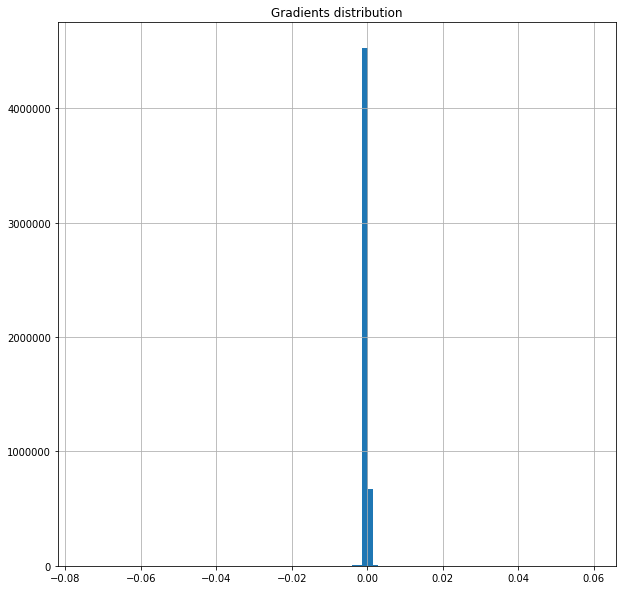

On iter 1261 with training PPL: 120.72701263427734, training ACC 0.2332899272441864
On iter 1262 with training PPL: 125.10299682617188, training ACC 0.2319878488779068
On iter 1263 with training PPL: 118.10904693603516, training ACC 0.2337239533662796
On iter 1264 with training PPL: 121.2742691040039, training ACC 0.2302517294883728
On iter 1265 with training PPL: 113.31847381591797, training ACC 0.2274305522441864
On iter 1266 with training PPL: 123.75432586669922, training ACC 0.2217881977558136
On iter 1267 with training PPL: 138.37612915039062, training ACC 0.2172309011220932
On iter 1268 with training PPL: 133.1751251220703, training ACC 0.2172309011220932
On iter 1269 with training PPL: 116.26402282714844, training ACC 0.2337239533662796
On iter 1270 with training PPL: 127.64082336425781, training ACC 0.2248263955116272
On iter 1271 with training PPL: 118.17884826660156, training ACC 0.2430555522441864
On iter 1272 with training PPL: 113.9714584350586, training ACC 0.246744796633

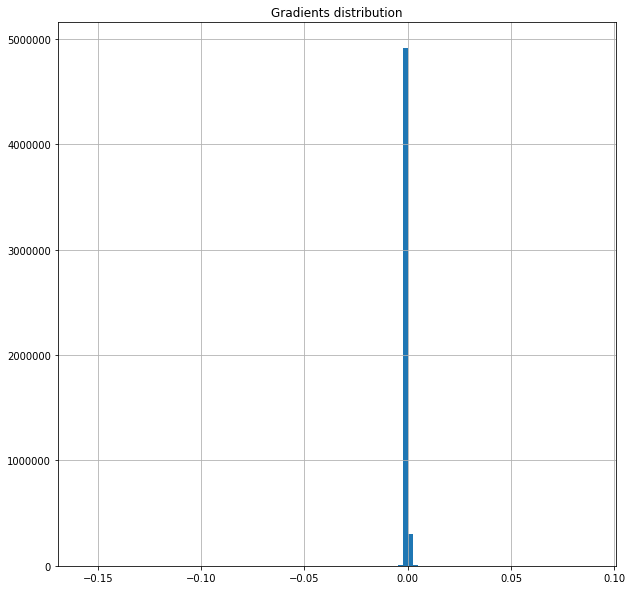

On iter 1291 with training PPL: 122.82897186279297, training ACC 0.2280815988779068
On iter 1292 with training PPL: 126.6754150390625, training ACC 0.2224392294883728
On iter 1293 with training PPL: 126.37460327148438, training ACC 0.2267795205116272
On iter 1294 with training PPL: 121.70736694335938, training ACC 0.220703125
On iter 1295 with training PPL: 107.93477630615234, training ACC 0.2493489533662796
On iter 1296 with training PPL: 108.85603332519531, training ACC 0.23828125
On iter 1297 with training PPL: 115.18324279785156, training ACC 0.2408854216337204
On iter 1298 with training PPL: 121.60526275634766, training ACC 0.2287326455116272
On iter 1299 with training PPL: 116.3690185546875, training ACC 0.2326388955116272
On iter 1300 with training PPL: 116.40625, training ACC 0.2376302033662796
On iter 1301 with training PPL: 121.6083984375, training ACC 0.2291666716337204
On iter 1302 with training PPL: 118.1250991821289, training ACC 0.2300347238779068
On iter 1303 with train

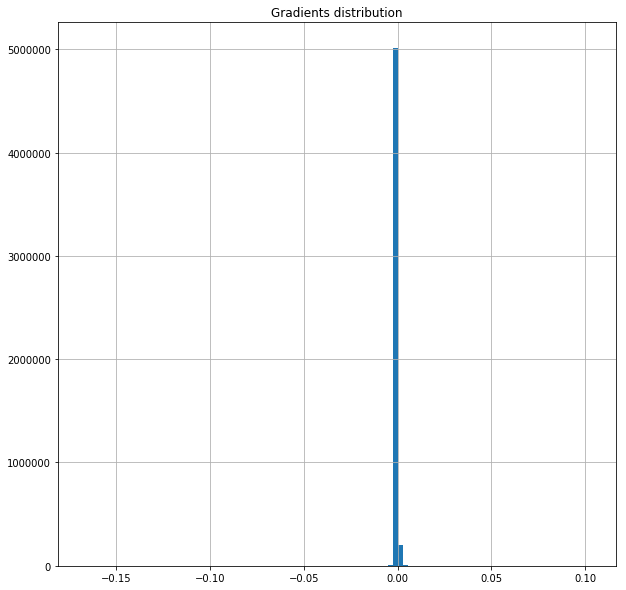

On iter 1321 with training PPL: 115.48263549804688, training ACC 0.2330729216337204
On iter 1322 with training PPL: 115.84825134277344, training ACC 0.2445746511220932
On iter 1323 with training PPL: 116.26136016845703, training ACC 0.2276475727558136
On iter 1324 with training PPL: 115.38362121582031, training ACC 0.2328559011220932
On iter 1325 with training PPL: 127.00037384033203, training ACC 0.224609375
On iter 1326 with training PPL: 133.58840942382812, training ACC 0.2202690988779068
On iter 1327 with training PPL: 132.37075805664062, training ACC 0.23046875
On iter 1328 with training PPL: 99.4405288696289, training ACC 0.2552083432674408
On iter 1329 with training PPL: 120.43009948730469, training ACC 0.2317708283662796
On iter 1330 with training PPL: 114.95307159423828, training ACC 0.2398003488779068
On iter 1331 with training PPL: 124.39826202392578, training ACC 0.2319878488779068
On iter 1332 with training PPL: 119.28824615478516, training ACC 0.2395833283662796
On iter 1

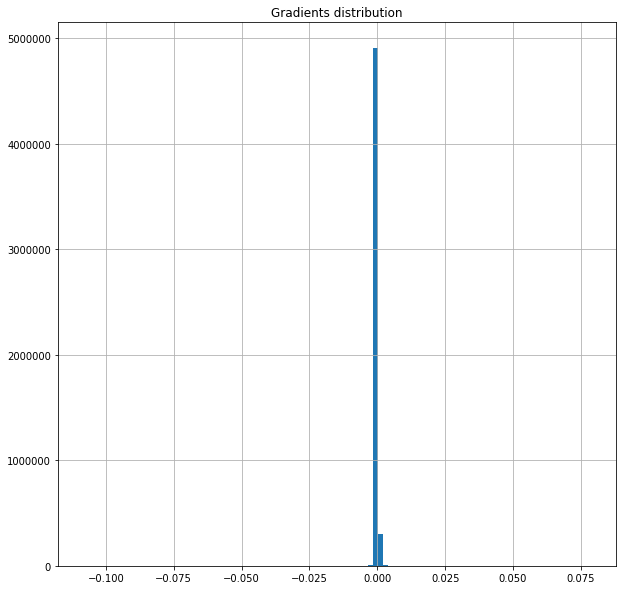

On iter 1351 with training PPL: 127.32199096679688, training ACC 0.2248263955116272
On iter 1352 with training PPL: 114.8173828125, training ACC 0.2430555522441864
On iter 1353 with training PPL: 119.16521453857422, training ACC 0.2330729216337204
On iter 1354 with training PPL: 119.10295104980469, training ACC 0.2389322966337204
On iter 1355 with training PPL: 132.95443725585938, training ACC 0.2213541716337204
On iter 1356 with training PPL: 116.09400177001953, training ACC 0.234375
On iter 1357 with training PPL: 110.83087921142578, training ACC 0.2424045205116272
On iter 1358 with training PPL: 122.68626403808594, training ACC 0.2319878488779068
On iter 1359 with training PPL: 120.6104965209961, training ACC 0.2309027761220932
On iter 1360 with training PPL: 115.88847351074219, training ACC 0.2254774272441864
On iter 1361 with training PPL: 122.23208618164062, training ACC 0.2367621511220932
On iter 1362 with training PPL: 116.98847961425781, training ACC 0.2335069477558136
On iter

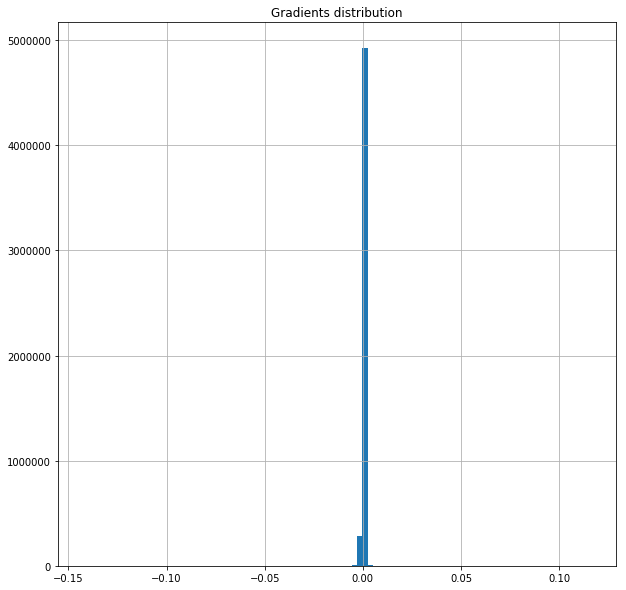

On iter 1381 with training PPL: 121.16756439208984, training ACC 0.2348090261220932
On iter 1382 with training PPL: 112.43962097167969, training ACC 0.2411024272441864
On iter 1383 with training PPL: 134.28665161132812, training ACC 0.2298177033662796
On iter 1384 with training PPL: 113.16209411621094, training ACC 0.2413194477558136
On iter 1385 with training PPL: 115.85499572753906, training ACC 0.2337239533662796
On iter 1386 with training PPL: 128.7463836669922, training ACC 0.2272135466337204
On iter 1387 with training PPL: 109.15886688232422, training ACC 0.2348090261220932
On iter 1388 with training PPL: 118.09220886230469, training ACC 0.2345920205116272
On iter 1389 with training PPL: 123.35816955566406, training ACC 0.2356770783662796
On iter 1390 with training PPL: 133.7021026611328, training ACC 0.2146267294883728
On iter 1391 with training PPL: 121.49293518066406, training ACC 0.234375
On iter 1392 with training PPL: 117.11042785644531, training ACC 0.2350260466337204
On i

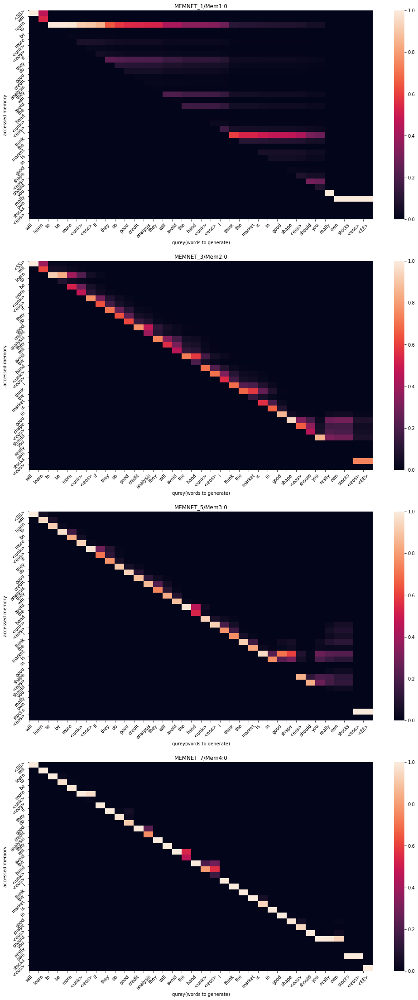

On iter 1401 with training PPL: 124.7633056640625, training ACC 0.2250434011220932
On iter 1402 with training PPL: 121.3866195678711, training ACC 0.2280815988779068
On iter 1403 with training PPL: 111.65806579589844, training ACC 0.2413194477558136
On iter 1404 with training PPL: 112.77886962890625, training ACC 0.2391493022441864
On iter 1405 with training PPL: 131.3214874267578, training ACC 0.2239583283662796
On iter 1406 with training PPL: 131.12437438964844, training ACC 0.2172309011220932
On iter 1407 with training PPL: 125.77674102783203, training ACC 0.2309027761220932
On iter 1408 with training PPL: 133.60572814941406, training ACC 0.23046875
On iter 1409 with training PPL: 121.17143249511719, training ACC 0.2352430522441864
On iter 1410 with training PPL: 103.1371078491211, training ACC 0.24609375
	 validation PPL 163.97036743164062, validation acc 0.2365451455116272
shape of gradients is (5228544,), L2 norm of gradients is 1.8644229173660278, details:                   0
co

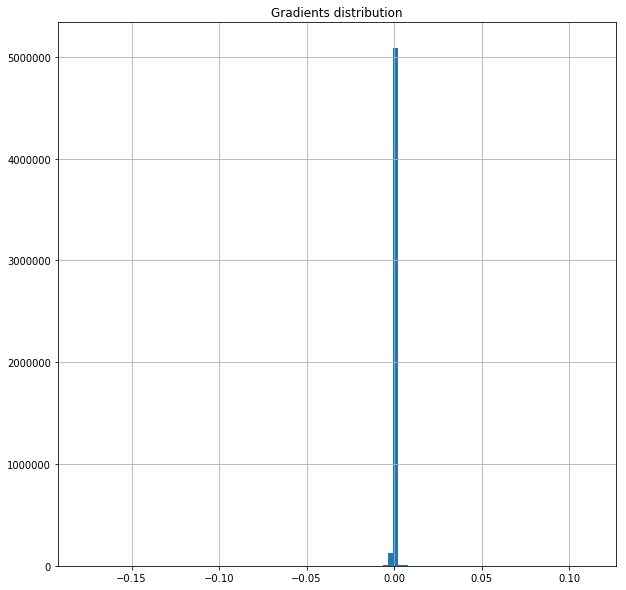

On iter 1411 with training PPL: 133.93838500976562, training ACC 0.2172309011220932
On iter 1412 with training PPL: 119.02597045898438, training ACC 0.2408854216337204
On iter 1413 with training PPL: 133.67845153808594, training ACC 0.2252604216337204
On iter 1414 with training PPL: 126.82089233398438, training ACC 0.2354600727558136
On iter 1415 with training PPL: 113.74230194091797, training ACC 0.2278645783662796
On iter 1416 with training PPL: 126.71686553955078, training ACC 0.2358940988779068
On iter 1417 with training PPL: 131.1941680908203, training ACC 0.2237413227558136
On iter 1418 with training PPL: 117.46052551269531, training ACC 0.2319878488779068
On iter 1419 with training PPL: 116.39615631103516, training ACC 0.2356770783662796
On iter 1420 with training PPL: 103.52552032470703, training ACC 0.2504340410232544
On iter 1421 with training PPL: 110.84314727783203, training ACC 0.2424045205116272
On iter 1422 with training PPL: 116.02969360351562, training ACC 0.2430555522

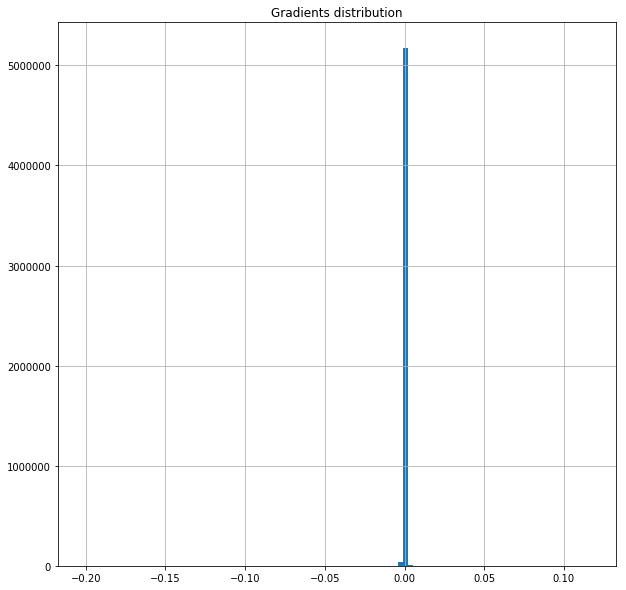

On iter 1441 with training PPL: 130.20462036132812, training ACC 0.2228732705116272
On iter 1442 with training PPL: 115.27604675292969, training ACC 0.2365451455116272
On iter 1443 with training PPL: 111.01001739501953, training ACC 0.2356770783662796
On iter 1444 with training PPL: 112.88787841796875, training ACC 0.240234375
On iter 1445 with training PPL: 123.51651000976562, training ACC 0.2289496511220932
On iter 1446 with training PPL: 126.87908172607422, training ACC 0.2330729216337204
On iter 1447 with training PPL: 118.12138366699219, training ACC 0.2326388955116272
On iter 1448 with training PPL: 119.17601013183594, training ACC 0.2337239533662796
On iter 1449 with training PPL: 112.04949951171875, training ACC 0.240234375
On iter 1450 with training PPL: 141.15972900390625, training ACC 0.2261284738779068
On iter 1451 with training PPL: 120.08930206298828, training ACC 0.2263454794883728
On iter 1452 with training PPL: 126.39835357666016, training ACC 0.2313368022441864
On ite

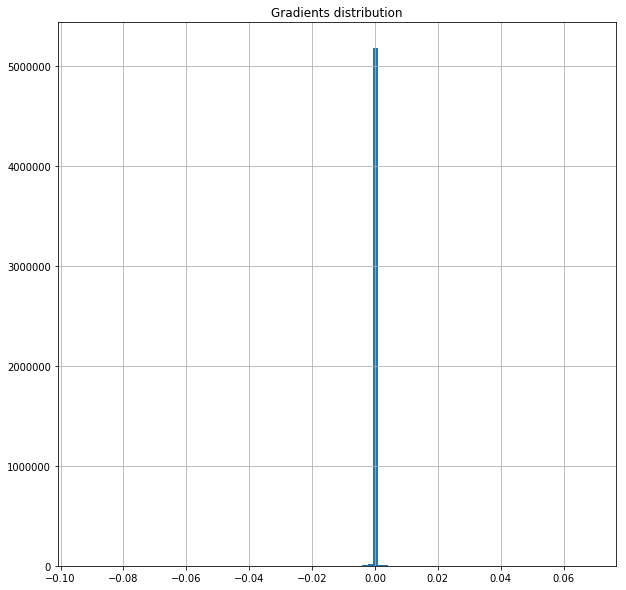

On iter 1471 with training PPL: 123.30012512207031, training ACC 0.2243923544883728
On iter 1472 with training PPL: 114.39347839355469, training ACC 0.2345920205116272
On iter 1473 with training PPL: 108.45652770996094, training ACC 0.2306857705116272
On iter 1474 with training PPL: 116.52071380615234, training ACC 0.2384982705116272
On iter 1475 with training PPL: 120.11827850341797, training ACC 0.2296006977558136
On iter 1476 with training PPL: 124.1187744140625, training ACC 0.2335069477558136
On iter 1477 with training PPL: 108.5687026977539, training ACC 0.2476128488779068
On iter 1478 with training PPL: 117.52265167236328, training ACC 0.2389322966337204
On iter 1479 with training PPL: 122.3879165649414, training ACC 0.2269965261220932
On iter 1480 with training PPL: 122.22176361083984, training ACC 0.2350260466337204
On iter 1481 with training PPL: 114.28612518310547, training ACC 0.24609375
On iter 1482 with training PPL: 116.9476547241211, training ACC 0.2419704794883728
On i

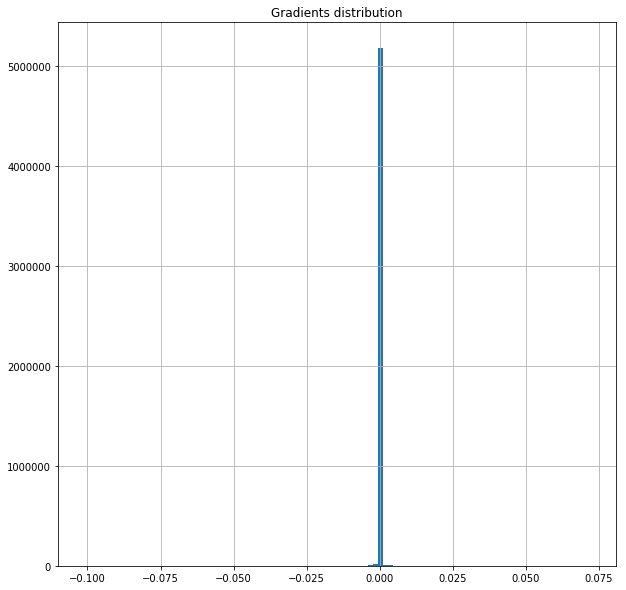

On iter 1501 with training PPL: 121.29347229003906, training ACC 0.2274305522441864
On iter 1502 with training PPL: 110.23429870605469, training ACC 0.2413194477558136
On iter 1503 with training PPL: 133.84580993652344, training ACC 0.2276475727558136
On iter 1504 with training PPL: 109.78385925292969, training ACC 0.2465277761220932
On iter 1505 with training PPL: 127.99897003173828, training ACC 0.2278645783662796
On iter 1506 with training PPL: 111.97478485107422, training ACC 0.2317708283662796
On iter 1507 with training PPL: 110.79865264892578, training ACC 0.2439236044883728
On iter 1508 with training PPL: 134.93881225585938, training ACC 0.2126736044883728
On iter 1509 with training PPL: 109.1553726196289, training ACC 0.2380642294883728
On iter 1510 with training PPL: 111.90159606933594, training ACC 0.2389322966337204
On iter 1511 with training PPL: 129.94039916992188, training ACC 0.2220052033662796
On iter 1512 with training PPL: 123.64290618896484, training ACC 0.2298177033

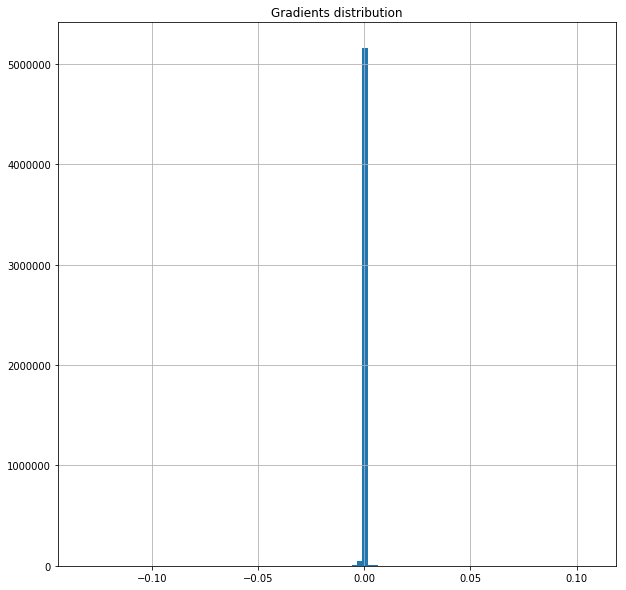

On iter 1531 with training PPL: 104.5682373046875, training ACC 0.2445746511220932
On iter 1532 with training PPL: 122.10485076904297, training ACC 0.2306857705116272
On iter 1533 with training PPL: 110.52019500732422, training ACC 0.25390625
On iter 1534 with training PPL: 123.42488861083984, training ACC 0.2233072966337204
On iter 1535 with training PPL: 109.59765625, training ACC 0.24609375
On iter 1536 with training PPL: 114.63520812988281, training ACC 0.2384982705116272
On iter 1537 with training PPL: 110.69619750976562, training ACC 0.2391493022441864
On iter 1538 with training PPL: 119.35059356689453, training ACC 0.2306857705116272
On iter 1539 with training PPL: 116.6308822631836, training ACC 0.2335069477558136
On iter 1540 with training PPL: 110.93541717529297, training ACC 0.2348090261220932
On iter 1541 with training PPL: 107.27002716064453, training ACC 0.2489149272441864
On iter 1542 with training PPL: 117.5673828125, training ACC 0.2317708283662796
On iter 1543 with tr

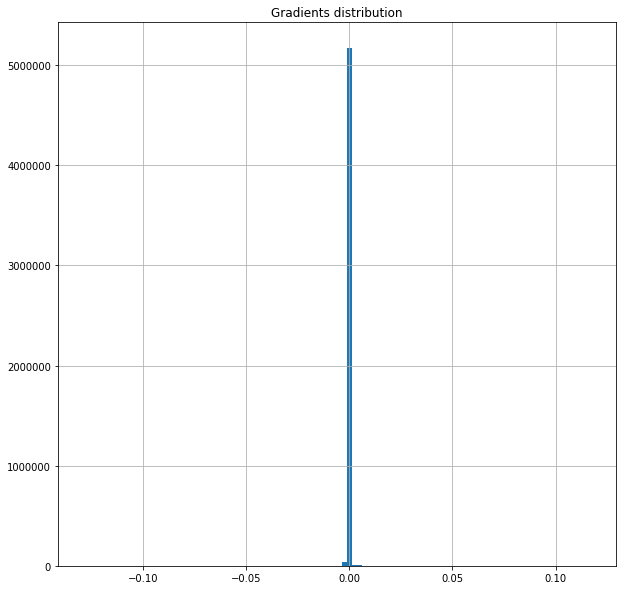

On iter 1561 with training PPL: 122.26052856445312, training ACC 0.2341579794883728
On iter 1562 with training PPL: 112.46257019042969, training ACC 0.2358940988779068
On iter 1563 with training PPL: 119.64456176757812, training ACC 0.2306857705116272
On iter 1564 with training PPL: 125.00955200195312, training ACC 0.2248263955116272
On iter 1565 with training PPL: 113.92674255371094, training ACC 0.236328125
On iter 1566 with training PPL: 120.28736877441406, training ACC 0.2282986044883728
On iter 1567 with training PPL: 122.9283447265625, training ACC 0.2228732705116272
On iter 1568 with training PPL: 106.51129150390625, training ACC 0.2408854216337204
On iter 1569 with training PPL: 128.5262908935547, training ACC 0.23828125
On iter 1570 with training PPL: 116.72129821777344, training ACC 0.2332899272441864
On iter 1571 with training PPL: 114.9542236328125, training ACC 0.2469618022441864
On iter 1572 with training PPL: 115.65380096435547, training ACC 0.2406684011220932
On iter 15

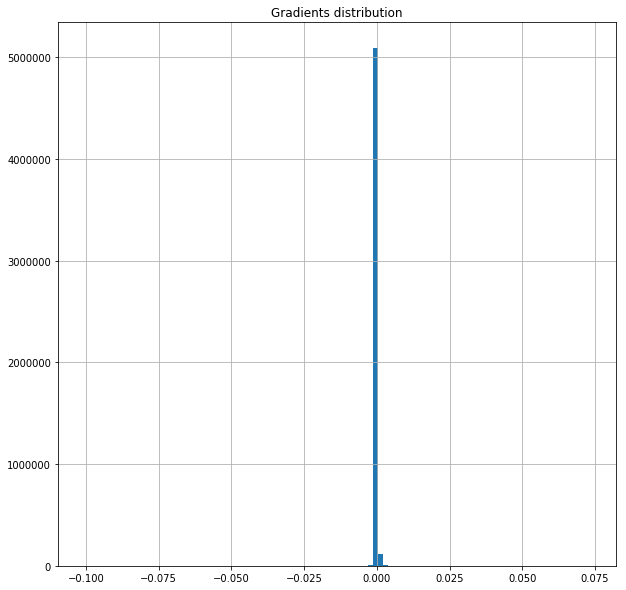

On iter 1591 with training PPL: 121.81343841552734, training ACC 0.2315538227558136
On iter 1592 with training PPL: 113.38208770751953, training ACC 0.2348090261220932
On iter 1593 with training PPL: 120.10733795166016, training ACC 0.2302517294883728
On iter 1594 with training PPL: 119.21067810058594, training ACC 0.2311197966337204
On iter 1595 with training PPL: 119.30194854736328, training ACC 0.2378472238779068
On iter 1596 with training PPL: 127.88823699951172, training ACC 0.2278645783662796
On iter 1597 with training PPL: 115.64288330078125, training ACC 0.2317708283662796
On iter 1598 with training PPL: 110.96403503417969, training ACC 0.2384982705116272
On iter 1599 with training PPL: 122.92430114746094, training ACC 0.2384982705116272
On iter 1600 with training PPL: 124.64645385742188, training ACC 0.2298177033662796
<SS> year <eos> not surprisingly he sometimes <unk> <eos> the arbitragers and takeover <unk> got killed on gray friday while the besieged managers of prospectiv

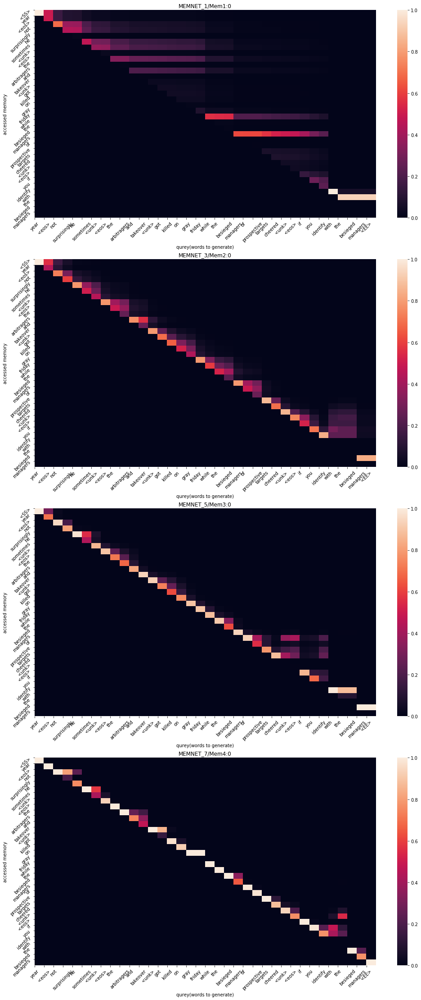

On iter 1601 with training PPL: 123.0669937133789, training ACC 0.2296006977558136
On iter 1602 with training PPL: 106.93852233886719, training ACC 0.2411024272441864
On iter 1603 with training PPL: 114.15459442138672, training ACC 0.2419704794883728
On iter 1604 with training PPL: 120.15345764160156, training ACC 0.2302517294883728
On iter 1605 with training PPL: 110.68511199951172, training ACC 0.2426215261220932
On iter 1606 with training PPL: 114.81924438476562, training ACC 0.2289496511220932
On iter 1607 with training PPL: 100.91863250732422, training ACC 0.2428385466337204
On iter 1608 with training PPL: 110.5273666381836, training ACC 0.2393663227558136
On iter 1609 with training PPL: 119.12066650390625, training ACC 0.2332899272441864
On iter 1610 with training PPL: 114.0524673461914, training ACC 0.2408854216337204
On iter 1611 with training PPL: 125.35700988769531, training ACC 0.2174479216337204
On iter 1612 with training PPL: 111.0888671875, training ACC 0.2365451455116272

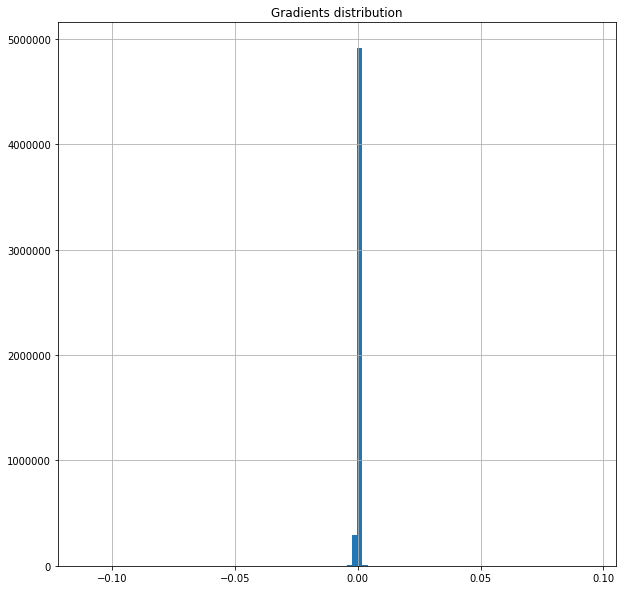

On iter 1621 with training PPL: 124.87281799316406, training ACC 0.2302517294883728
On iter 1622 with training PPL: 117.3257827758789, training ACC 0.2313368022441864
On iter 1623 with training PPL: 119.10795593261719, training ACC 0.2419704794883728
On iter 1624 with training PPL: 117.83700561523438, training ACC 0.2408854216337204
On iter 1625 with training PPL: 106.50865173339844, training ACC 0.2456597238779068
On iter 1626 with training PPL: 109.14730834960938, training ACC 0.2330729216337204
On iter 1627 with training PPL: 121.0072250366211, training ACC 0.2291666716337204
On iter 1628 with training PPL: 105.39627075195312, training ACC 0.2432725727558136
On iter 1629 with training PPL: 116.34310913085938, training ACC 0.2302517294883728
On iter 1630 with training PPL: 112.46916961669922, training ACC 0.2313368022441864
On iter 1631 with training PPL: 105.44612884521484, training ACC 0.2469618022441864
On iter 1632 with training PPL: 114.76860809326172, training ACC 0.24066840112

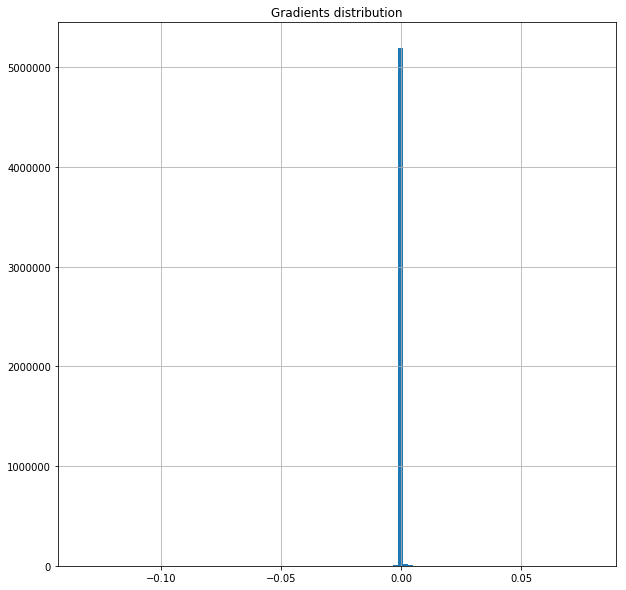

On iter 1651 with training PPL: 110.63182067871094, training ACC 0.2348090261220932
On iter 1652 with training PPL: 110.70939636230469, training ACC 0.2367621511220932
On iter 1653 with training PPL: 123.10742950439453, training ACC 0.2280815988779068
On iter 1654 with training PPL: 114.33120727539062, training ACC 0.2384982705116272
On iter 1655 with training PPL: 110.88119506835938, training ACC 0.2434895783662796
On iter 1656 with training PPL: 113.19927215576172, training ACC 0.2350260466337204
On iter 1657 with training PPL: 119.5870132446289, training ACC 0.2280815988779068
On iter 1658 with training PPL: 120.97814178466797, training ACC 0.2274305522441864
On iter 1659 with training PPL: 114.00755310058594, training ACC 0.2317708283662796
On iter 1660 with training PPL: 100.84358978271484, training ACC 0.2419704794883728
On iter 1661 with training PPL: 128.82786560058594, training ACC 0.220703125
On iter 1662 with training PPL: 109.72089385986328, training ACC 0.2280815988779068


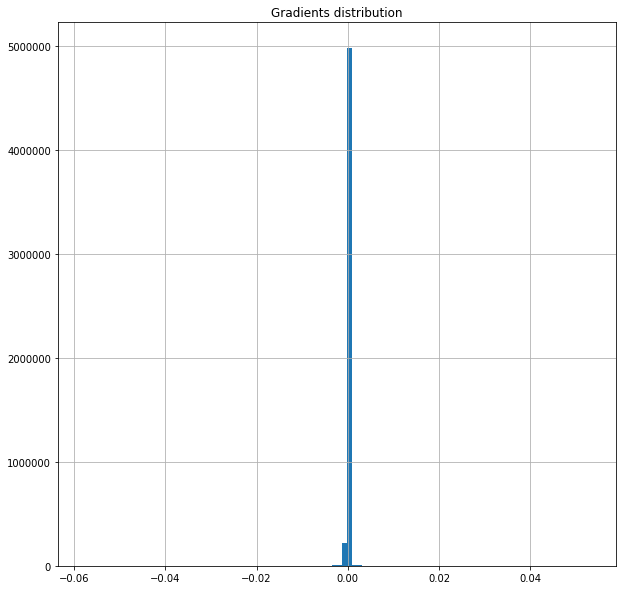

On iter 1681 with training PPL: 112.95308685302734, training ACC 0.2348090261220932
On iter 1682 with training PPL: 128.0359649658203, training ACC 0.2224392294883728
On iter 1683 with training PPL: 107.63677978515625, training ACC 0.2332899272441864
On iter 1684 with training PPL: 117.1885757446289, training ACC 0.2272135466337204
On iter 1685 with training PPL: 115.6316909790039, training ACC 0.2328559011220932
On iter 1686 with training PPL: 107.03621673583984, training ACC 0.2395833283662796
On iter 1687 with training PPL: 130.346435546875, training ACC 0.2276475727558136
On iter 1688 with training PPL: 109.85513305664062, training ACC 0.2398003488779068
On iter 1689 with training PPL: 118.09434509277344, training ACC 0.2265625
On iter 1690 with training PPL: 115.88803100585938, training ACC 0.2332899272441864
On iter 1691 with training PPL: 110.02823638916016, training ACC 0.2367621511220932
On iter 1692 with training PPL: 115.70620727539062, training ACC 0.2289496511220932
On ite

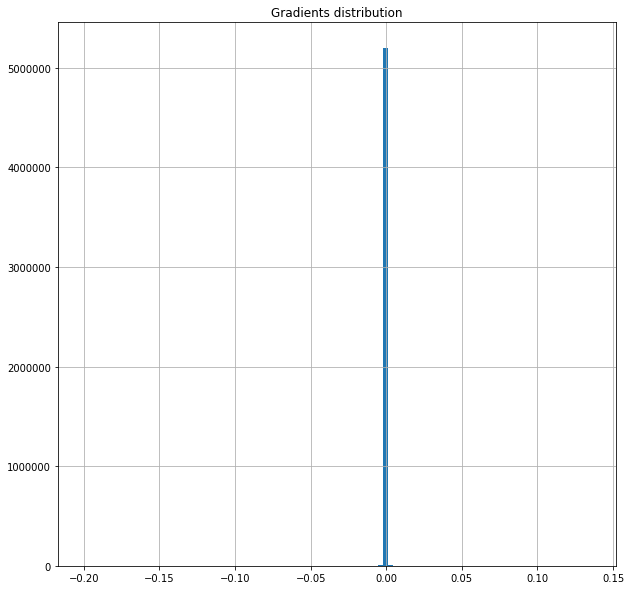

On iter 1711 with training PPL: 112.8116226196289, training ACC 0.2322048544883728
On iter 1712 with training PPL: 119.09244537353516, training ACC 0.224609375
On iter 1713 with training PPL: 117.66344451904297, training ACC 0.2354600727558136
On iter 1714 with training PPL: 109.7883071899414, training ACC 0.2443576455116272
On iter 1715 with training PPL: 106.53587341308594, training ACC 0.2389322966337204
On iter 1716 with training PPL: 124.74360656738281, training ACC 0.2337239533662796
On iter 1717 with training PPL: 115.37371826171875, training ACC 0.23046875
On iter 1718 with training PPL: 118.04806518554688, training ACC 0.2350260466337204
On iter 1719 with training PPL: 112.60150146484375, training ACC 0.2365451455116272
On iter 1720 with training PPL: 109.52127838134766, training ACC 0.2411024272441864
On iter 1721 with training PPL: 116.93342590332031, training ACC 0.2369791716337204
On iter 1722 with training PPL: 108.13851928710938, training ACC 0.2322048544883728
On iter 1

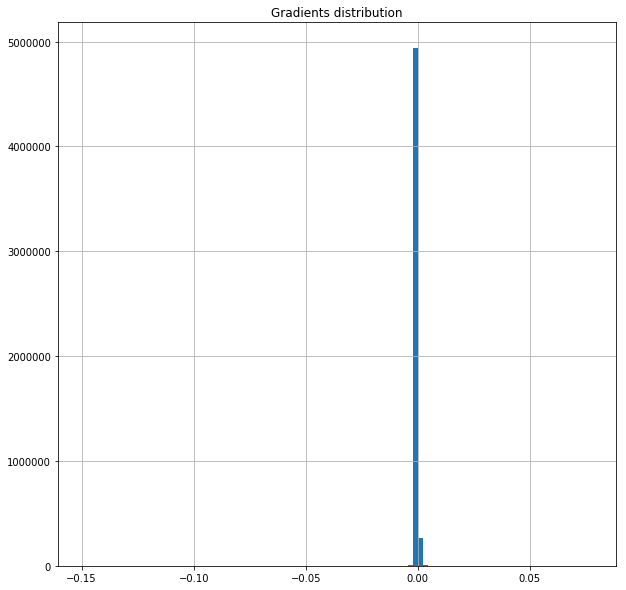

On iter 1741 with training PPL: 111.33938598632812, training ACC 0.2413194477558136
On iter 1742 with training PPL: 112.71500396728516, training ACC 0.2404513955116272
On iter 1743 with training PPL: 111.51594543457031, training ACC 0.228515625
On iter 1744 with training PPL: 100.78258514404297, training ACC 0.2467447966337204
On iter 1745 with training PPL: 103.21100616455078, training ACC 0.2361111044883728
On iter 1746 with training PPL: 102.65618133544922, training ACC 0.2452256977558136
On iter 1747 with training PPL: 108.02879333496094, training ACC 0.2384982705116272
On iter 1748 with training PPL: 118.61304473876953, training ACC 0.2289496511220932
On iter 1749 with training PPL: 110.77265167236328, training ACC 0.2426215261220932
On iter 1750 with training PPL: 113.72852325439453, training ACC 0.2367621511220932
On iter 1751 with training PPL: 98.9924087524414, training ACC 0.2513020932674408
On iter 1752 with training PPL: 120.1607894897461, training ACC 0.2361111044883728
On

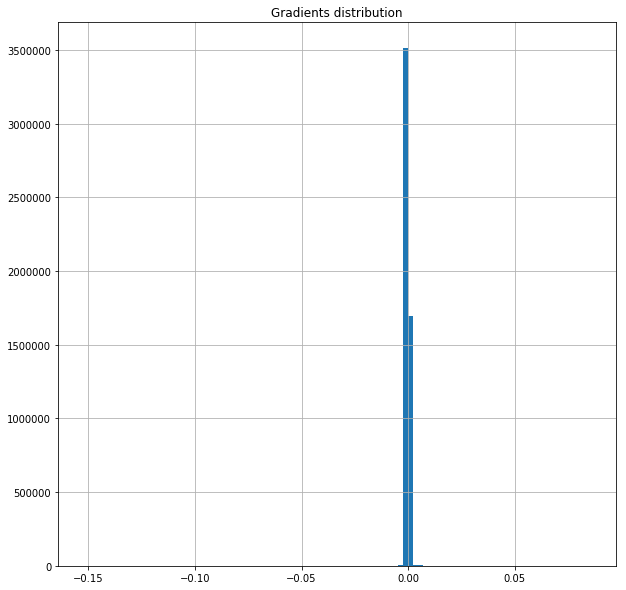

On iter 1771 with training PPL: 123.34764099121094, training ACC 0.2248263955116272
On iter 1772 with training PPL: 113.59042358398438, training ACC 0.2200520783662796
On iter 1773 with training PPL: 102.28575134277344, training ACC 0.2486979216337204
On iter 1774 with training PPL: 103.10720825195312, training ACC 0.2471788227558136
On iter 1775 with training PPL: 120.49305725097656, training ACC 0.2213541716337204
On iter 1776 with training PPL: 109.45710754394531, training ACC 0.2380642294883728
On iter 1777 with training PPL: 97.34008026123047, training ACC 0.2578125
On iter 1778 with training PPL: 104.26536560058594, training ACC 0.2491319477558136
On iter 1779 with training PPL: 109.78862762451172, training ACC 0.24609375
On iter 1780 with training PPL: 105.19352722167969, training ACC 0.2473958283662796
On iter 1781 with training PPL: 107.63426208496094, training ACC 0.2417534738779068
On iter 1782 with training PPL: 101.1983642578125, training ACC 0.2491319477558136
On iter 178

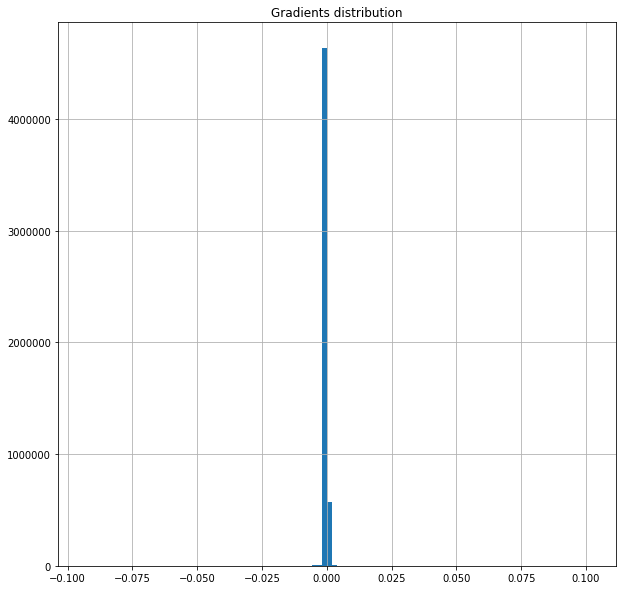

<SS> maker of video games electronic information systems and playing cards posted a N N unconsolidated surge in pretax profit to N billion yen $ N million from N billion yen $ N million for the <EE>


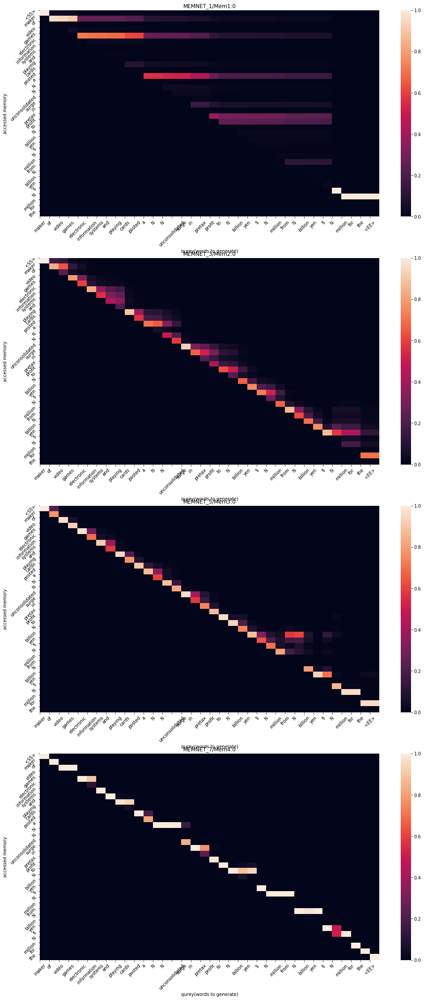

On iter 1801 with training PPL: 112.98626708984375, training ACC 0.2335069477558136
On iter 1802 with training PPL: 116.013427734375, training ACC 0.2280815988779068
On iter 1803 with training PPL: 104.94902801513672, training ACC 0.2484809011220932
On iter 1804 with training PPL: 104.22560119628906, training ACC 0.2447916716337204
On iter 1805 with training PPL: 112.14727020263672, training ACC 0.2393663227558136
On iter 1806 with training PPL: 106.84294891357422, training ACC 0.2443576455116272
On iter 1807 with training PPL: 91.9979476928711, training ACC 0.2591145932674408
On iter 1808 with training PPL: 112.19160461425781, training ACC 0.2434895783662796
On iter 1809 with training PPL: 110.6957778930664, training ACC 0.2469618022441864
On iter 1810 with training PPL: 113.25553894042969, training ACC 0.2361111044883728
On iter 1811 with training PPL: 99.088134765625, training ACC 0.2601996660232544
On iter 1812 with training PPL: 107.21172332763672, training ACC 0.2463107705116272


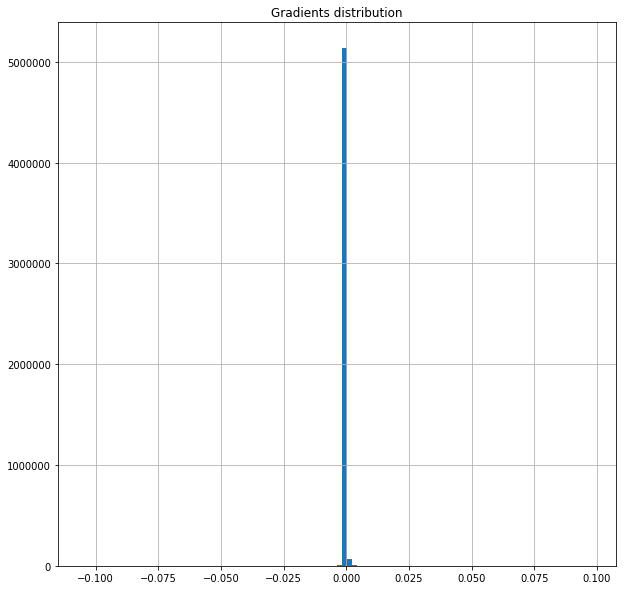

On iter 1831 with training PPL: 110.65265655517578, training ACC 0.23046875
On iter 1832 with training PPL: 104.91880798339844, training ACC 0.2398003488779068
On iter 1833 with training PPL: 99.32196807861328, training ACC 0.2506510317325592
On iter 1834 with training PPL: 101.32467651367188, training ACC 0.2419704794883728
On iter 1835 with training PPL: 106.97233581542969, training ACC 0.2437065988779068
On iter 1836 with training PPL: 107.03366088867188, training ACC 0.248046875
On iter 1837 with training PPL: 106.9173583984375, training ACC 0.2513020932674408
On iter 1838 with training PPL: 121.99439239501953, training ACC 0.2217881977558136
On iter 1839 with training PPL: 111.9229965209961, training ACC 0.2419704794883728
On iter 1840 with training PPL: 94.65859985351562, training ACC 0.2575954794883728
On iter 1841 with training PPL: 96.96442413330078, training ACC 0.2554253339767456
On iter 1842 with training PPL: 116.53860473632812, training ACC 0.232421875
On iter 1843 with t

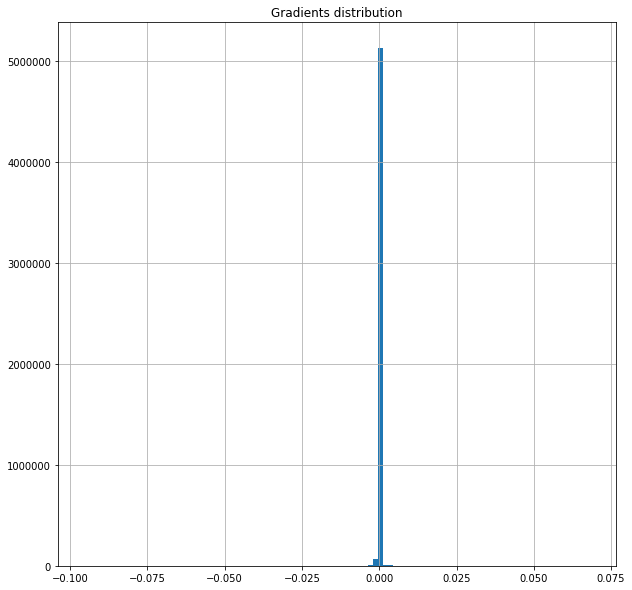

On iter 1861 with training PPL: 112.02027130126953, training ACC 0.2393663227558136
On iter 1862 with training PPL: 111.108154296875, training ACC 0.240234375
On iter 1863 with training PPL: 107.82089233398438, training ACC 0.2400173544883728
On iter 1864 with training PPL: 110.19419860839844, training ACC 0.2430555522441864
On iter 1865 with training PPL: 104.70175170898438, training ACC 0.2406684011220932
On iter 1866 with training PPL: 105.855712890625, training ACC 0.2562934160232544
On iter 1867 with training PPL: 101.32845306396484, training ACC 0.2504340410232544
On iter 1868 with training PPL: 106.2579116821289, training ACC 0.2430555522441864
On iter 1869 with training PPL: 100.89836883544922, training ACC 0.255859375
On iter 1870 with training PPL: 102.96395111083984, training ACC 0.2486979216337204
On iter 1871 with training PPL: 118.64370727539062, training ACC 0.2352430522441864
On iter 1872 with training PPL: 106.86894226074219, training ACC 0.2413194477558136
On iter 187

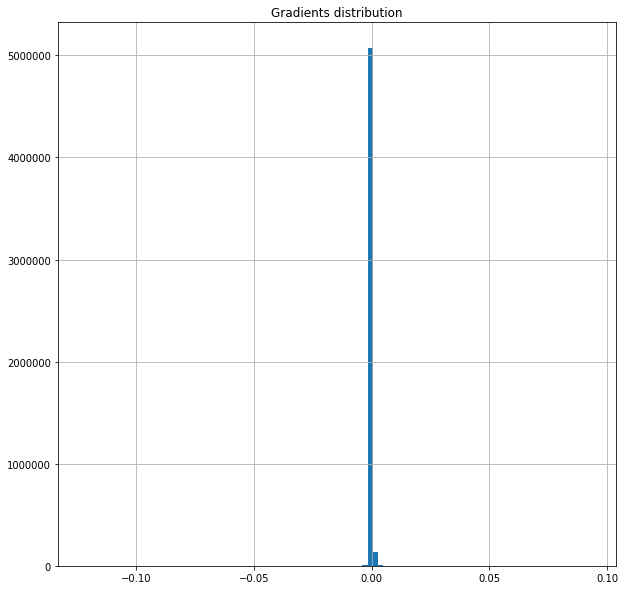

On iter 1891 with training PPL: 105.59698486328125, training ACC 0.2400173544883728
On iter 1892 with training PPL: 106.2854232788086, training ACC 0.2428385466337204
On iter 1893 with training PPL: 103.95435333251953, training ACC 0.248046875
On iter 1894 with training PPL: 113.10722351074219, training ACC 0.2341579794883728
On iter 1895 with training PPL: 103.70092010498047, training ACC 0.2395833283662796
On iter 1896 with training PPL: 117.14203643798828, training ACC 0.2371961772441864
On iter 1897 with training PPL: 104.1982650756836, training ACC 0.24609375
On iter 1898 with training PPL: 101.32695007324219, training ACC 0.2510850727558136
On iter 1899 with training PPL: 116.73448944091797, training ACC 0.2426215261220932
On iter 1900 with training PPL: 112.01947784423828, training ACC 0.2417534738779068
On iter 1901 with training PPL: 110.45649719238281, training ACC 0.2391493022441864
On iter 1902 with training PPL: 99.92326354980469, training ACC 0.2504340410232544
On iter 19

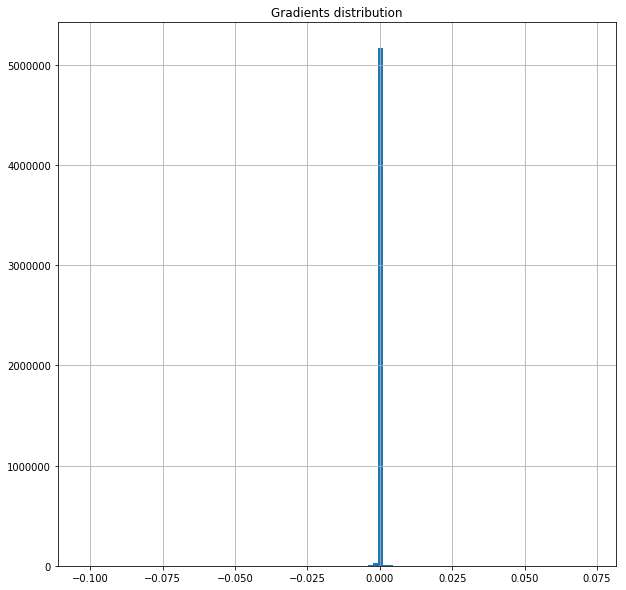

On iter 1921 with training PPL: 92.66348266601562, training ACC 0.2578125
On iter 1922 with training PPL: 103.24024200439453, training ACC 0.2411024272441864
On iter 1923 with training PPL: 110.72808837890625, training ACC 0.2350260466337204
On iter 1924 with training PPL: 102.25556945800781, training ACC 0.2536892294883728
On iter 1925 with training PPL: 94.18342590332031, training ACC 0.2526041567325592
On iter 1926 with training PPL: 110.08732604980469, training ACC 0.2430555522441864
On iter 1927 with training PPL: 103.42610168457031, training ACC 0.2432725727558136
On iter 1928 with training PPL: 101.44573974609375, training ACC 0.2341579794883728
On iter 1929 with training PPL: 110.58018493652344, training ACC 0.2437065988779068
On iter 1930 with training PPL: 108.76322174072266, training ACC 0.2445746511220932
On iter 1931 with training PPL: 103.15280151367188, training ACC 0.25390625
On iter 1932 with training PPL: 113.1048583984375, training ACC 0.2300347238779068
On iter 1933

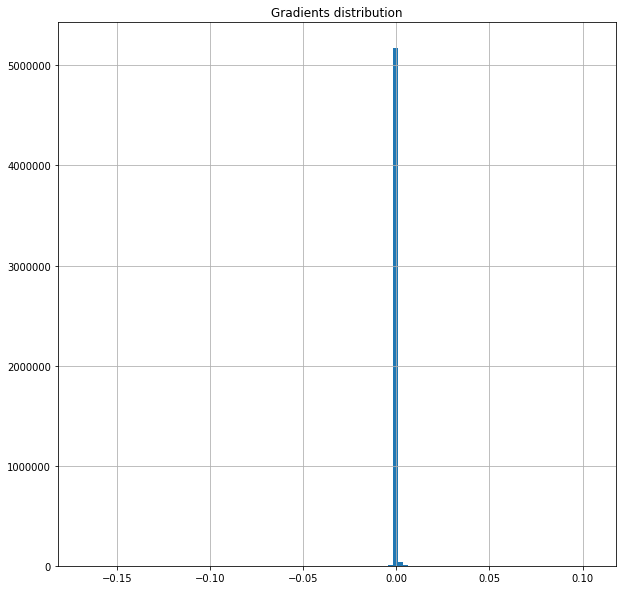

On iter 1951 with training PPL: 97.36672973632812, training ACC 0.2562934160232544
On iter 1952 with training PPL: 106.18061828613281, training ACC 0.2350260466337204
On iter 1953 with training PPL: 106.48123168945312, training ACC 0.2415364533662796
On iter 1954 with training PPL: 110.2898178100586, training ACC 0.2411024272441864
On iter 1955 with training PPL: 99.9718246459961, training ACC 0.2454427033662796
On iter 1956 with training PPL: 119.73770904541016, training ACC 0.2300347238779068
On iter 1957 with training PPL: 104.21600341796875, training ACC 0.2411024272441864
On iter 1958 with training PPL: 101.41932678222656, training ACC 0.255859375
On iter 1959 with training PPL: 102.93017578125, training ACC 0.2337239533662796
On iter 1960 with training PPL: 97.86672973632812, training ACC 0.2452256977558136
On iter 1961 with training PPL: 104.97686004638672, training ACC 0.2400173544883728
On iter 1962 with training PPL: 113.04010009765625, training ACC 0.2476128488779068
On iter

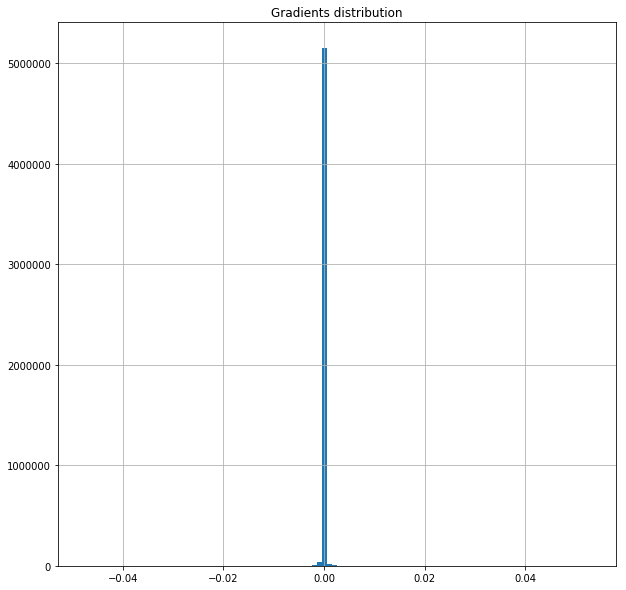

On iter 1981 with training PPL: 96.78837585449219, training ACC 0.25
On iter 1982 with training PPL: 103.65459442138672, training ACC 0.2378472238779068
On iter 1983 with training PPL: 89.70553588867188, training ACC 0.2580295205116272
On iter 1984 with training PPL: 108.80300903320312, training ACC 0.2367621511220932
On iter 1985 with training PPL: 103.60226440429688, training ACC 0.2497829794883728
On iter 1986 with training PPL: 112.6607894897461, training ACC 0.2434895783662796
On iter 1987 with training PPL: 103.0979232788086, training ACC 0.2415364533662796
On iter 1988 with training PPL: 106.33124542236328, training ACC 0.24609375
On iter 1989 with training PPL: 95.46354675292969, training ACC 0.2434895783662796
On iter 1990 with training PPL: 91.84322357177734, training ACC 0.2530381977558136
On iter 1991 with training PPL: 99.12509155273438, training ACC 0.2471788227558136
On iter 1992 with training PPL: 110.79246520996094, training ACC 0.2428385466337204
On iter 1993 with tra

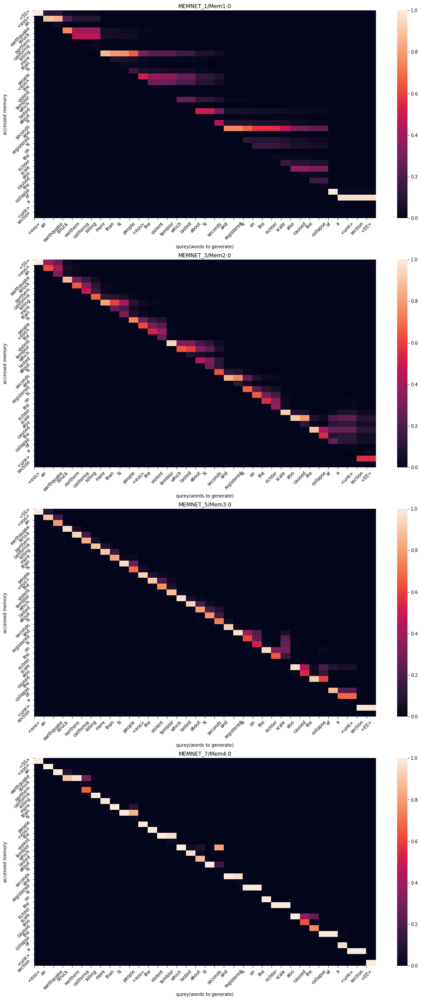

On iter 2001 with training PPL: 126.56178283691406, training ACC 0.2217881977558136
On iter 2002 with training PPL: 98.46072387695312, training ACC 0.2471788227558136
On iter 2003 with training PPL: 103.66107177734375, training ACC 0.2458767294883728
On iter 2004 with training PPL: 112.7805404663086, training ACC 0.2319878488779068
On iter 2005 with training PPL: 89.72281646728516, training ACC 0.2625868022441864
On iter 2006 with training PPL: 106.8229751586914, training ACC 0.2454427033662796
On iter 2007 with training PPL: 108.83196258544922, training ACC 0.2291666716337204
On iter 2008 with training PPL: 98.09519958496094, training ACC 0.2565104067325592
On iter 2009 with training PPL: 108.3865737915039, training ACC 0.2428385466337204
On iter 2010 with training PPL: 105.27210998535156, training ACC 0.2469618022441864
	 validation PPL 164.06320190429688, validation acc 0.2276475727558136
shape of gradients is (5228544,), L2 norm of gradients is 1.599207878112793, details:          

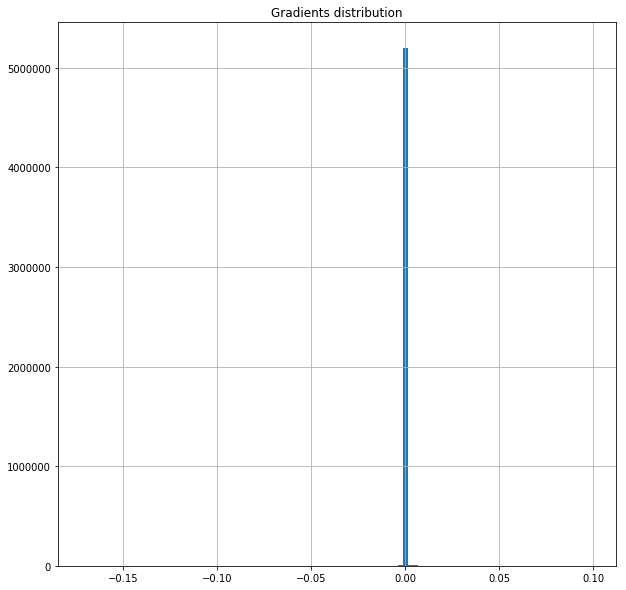

On iter 2011 with training PPL: 102.68148803710938, training ACC 0.2395833283662796
On iter 2012 with training PPL: 111.23584747314453, training ACC 0.2434895783662796
On iter 2013 with training PPL: 106.16669464111328, training ACC 0.2339409738779068
On iter 2014 with training PPL: 89.03341674804688, training ACC 0.2638888955116272
On iter 2015 with training PPL: 99.07396697998047, training ACC 0.2471788227558136
On iter 2016 with training PPL: 110.84916687011719, training ACC 0.2367621511220932
On iter 2017 with training PPL: 114.61832427978516, training ACC 0.2345920205116272
On iter 2018 with training PPL: 101.86769104003906, training ACC 0.2497829794883728
On iter 2019 with training PPL: 105.73766326904297, training ACC 0.2473958283662796
On iter 2020 with training PPL: 105.82003021240234, training ACC 0.2413194477558136
On iter 2021 with training PPL: 104.89314270019531, training ACC 0.2387152761220932
On iter 2022 with training PPL: 101.79952239990234, training ACC 0.24522569775

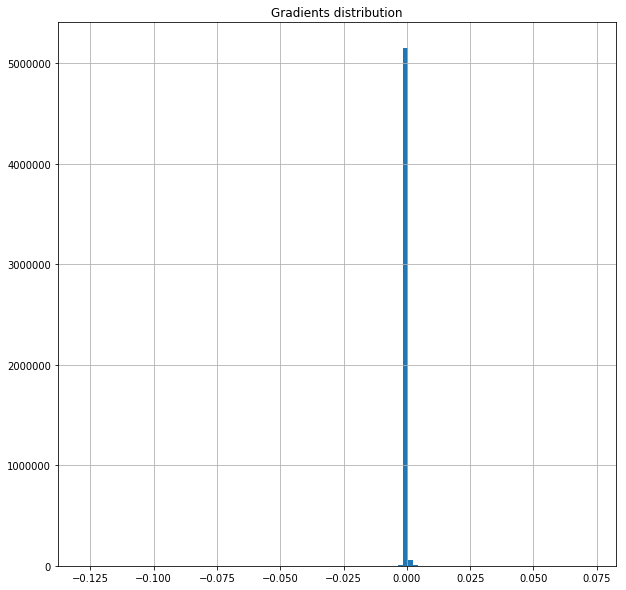

On iter 2041 with training PPL: 124.24128723144531, training ACC 0.220703125
On iter 2042 with training PPL: 119.56910705566406, training ACC 0.2306857705116272
On iter 2043 with training PPL: 110.02397918701172, training ACC 0.2302517294883728
On iter 2044 with training PPL: 96.39057922363281, training ACC 0.2471788227558136
On iter 2045 with training PPL: 95.31017303466797, training ACC 0.2434895783662796
On iter 2046 with training PPL: 100.68142700195312, training ACC 0.2536892294883728
On iter 2047 with training PPL: 118.05335998535156, training ACC 0.2319878488779068
On iter 2048 with training PPL: 99.9112548828125, training ACC 0.2445746511220932
On iter 2049 with training PPL: 88.09417724609375, training ACC 0.2588975727558136
On iter 2050 with training PPL: 100.54076385498047, training ACC 0.25
On iter 2051 with training PPL: 113.21612548828125, training ACC 0.2309027761220932
On iter 2052 with training PPL: 109.11198425292969, training ACC 0.2345920205116272
On iter 2053 with 

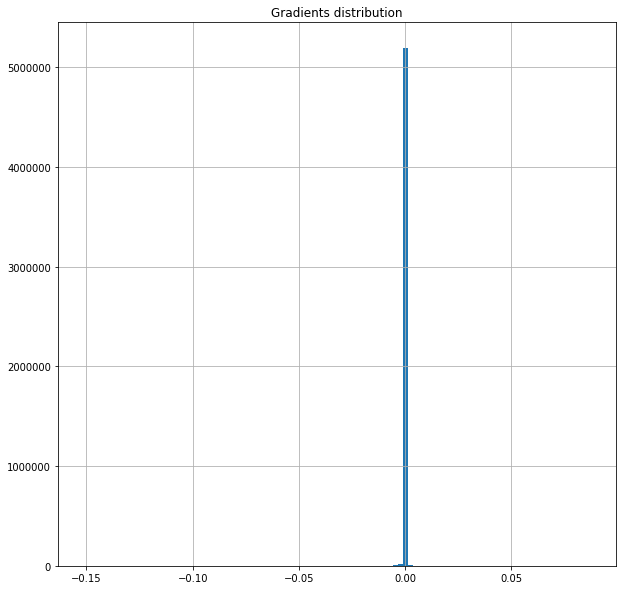

On iter 2071 with training PPL: 114.88907623291016, training ACC 0.23828125
On iter 2072 with training PPL: 102.33370971679688, training ACC 0.2478298544883728
On iter 2073 with training PPL: 100.88885498046875, training ACC 0.2443576455116272
On iter 2074 with training PPL: 104.66621398925781, training ACC 0.2419704794883728
On iter 2075 with training PPL: 112.54695892333984, training ACC 0.2348090261220932
On iter 2076 with training PPL: 104.63831329345703, training ACC 0.2408854216337204
On iter 2077 with training PPL: 109.54393768310547, training ACC 0.2458767294883728
On iter 2078 with training PPL: 102.95496368408203, training ACC 0.2465277761220932
On iter 2079 with training PPL: 95.6357650756836, training ACC 0.2526041567325592
On iter 2080 with training PPL: 119.24803161621094, training ACC 0.2309027761220932
On iter 2081 with training PPL: 97.02274322509766, training ACC 0.255859375
On iter 2082 with training PPL: 102.37626647949219, training ACC 0.2471788227558136
On iter 20

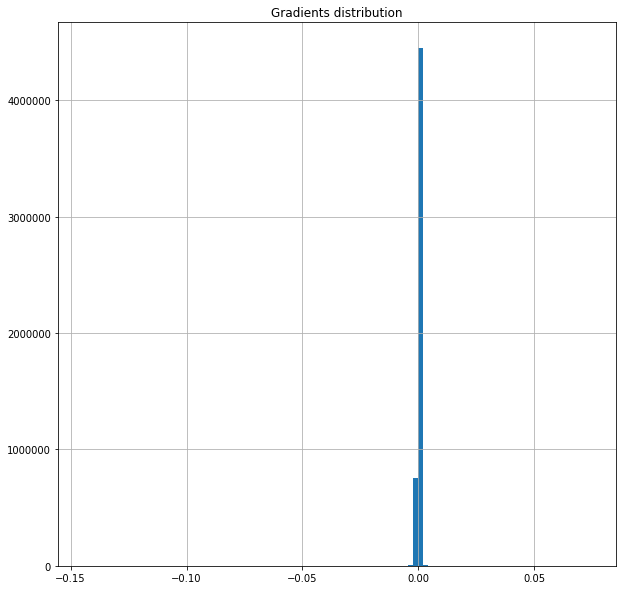

On iter 2101 with training PPL: 103.0902099609375, training ACC 0.2406684011220932
On iter 2102 with training PPL: 102.26361083984375, training ACC 0.2473958283662796
On iter 2103 with training PPL: 91.9720230102539, training ACC 0.2571614682674408
On iter 2104 with training PPL: 113.34111022949219, training ACC 0.2398003488779068
On iter 2105 with training PPL: 105.08123016357422, training ACC 0.2395833283662796
On iter 2106 with training PPL: 107.60034942626953, training ACC 0.2465277761220932
On iter 2107 with training PPL: 103.87061309814453, training ACC 0.2415364533662796
On iter 2108 with training PPL: 109.0255355834961, training ACC 0.2293836772441864
On iter 2109 with training PPL: 107.58685302734375, training ACC 0.251953125
On iter 2110 with training PPL: 110.13741302490234, training ACC 0.2376302033662796
On iter 2111 with training PPL: 104.69670867919922, training ACC 0.2426215261220932
On iter 2112 with training PPL: 101.68099975585938, training ACC 0.2406684011220932
On 

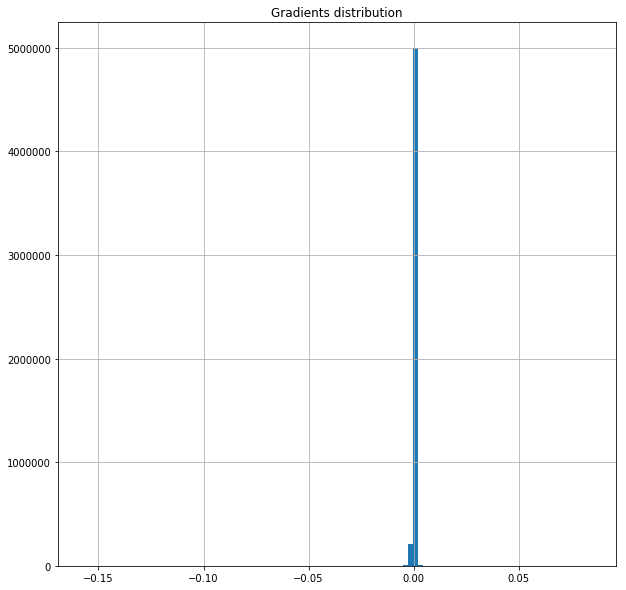

On iter 2131 with training PPL: 106.76166534423828, training ACC 0.24609375
On iter 2132 with training PPL: 107.87678527832031, training ACC 0.2306857705116272
On iter 2133 with training PPL: 95.38378143310547, training ACC 0.2463107705116272
On iter 2134 with training PPL: 104.53692626953125, training ACC 0.2330729216337204
On iter 2135 with training PPL: 98.86320495605469, training ACC 0.2554253339767456
On iter 2136 with training PPL: 105.80403900146484, training ACC 0.2339409738779068
On iter 2137 with training PPL: 114.66516876220703, training ACC 0.2369791716337204
On iter 2138 with training PPL: 96.93862915039062, training ACC 0.2541232705116272
On iter 2139 with training PPL: 95.84435272216797, training ACC 0.2521701455116272
On iter 2140 with training PPL: 94.55240631103516, training ACC 0.2562934160232544
On iter 2141 with training PPL: 106.47371673583984, training ACC 0.236328125
On iter 2142 with training PPL: 101.58193969726562, training ACC 0.2439236044883728
On iter 2143

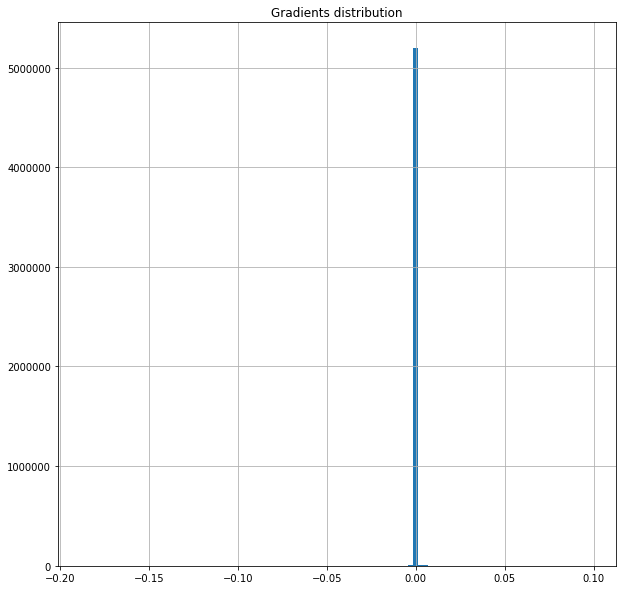

On iter 2161 with training PPL: 97.81649017333984, training ACC 0.2534722089767456
On iter 2162 with training PPL: 108.83304595947266, training ACC 0.23046875
On iter 2163 with training PPL: 100.6128921508789, training ACC 0.2413194477558136
On iter 2164 with training PPL: 92.05867767333984, training ACC 0.2584635317325592
On iter 2165 with training PPL: 98.33358001708984, training ACC 0.2536892294883728
On iter 2166 with training PPL: 96.21076202392578, training ACC 0.2471788227558136
On iter 2167 with training PPL: 105.82315826416016, training ACC 0.2430555522441864
On iter 2168 with training PPL: 95.46390533447266, training ACC 0.2547743022441864
On iter 2169 with training PPL: 108.670166015625, training ACC 0.2421875
On iter 2170 with training PPL: 104.01405334472656, training ACC 0.2376302033662796
On iter 2171 with training PPL: 99.8841552734375, training ACC 0.251953125
On iter 2172 with training PPL: 89.97378540039062, training ACC 0.2604166567325592
On iter 2173 with training 

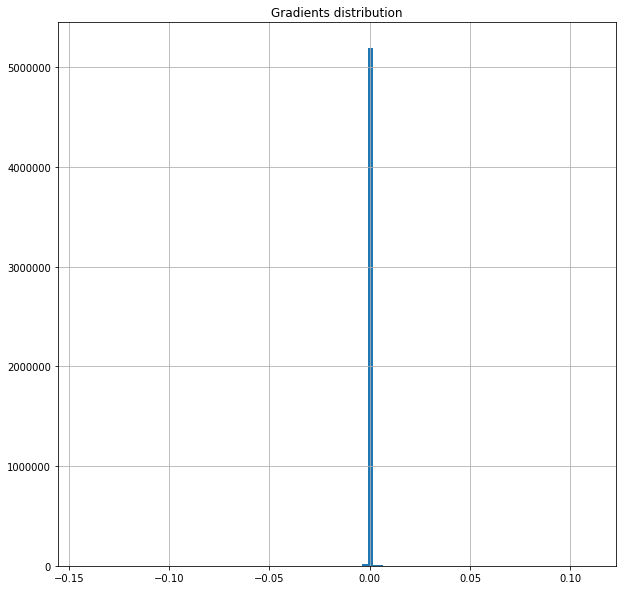

On iter 2191 with training PPL: 102.0255355834961, training ACC 0.2495659738779068
On iter 2192 with training PPL: 97.2602310180664, training ACC 0.2510850727558136
On iter 2193 with training PPL: 106.85568237304688, training ACC 0.2400173544883728
On iter 2194 with training PPL: 97.3800048828125, training ACC 0.2510850727558136
On iter 2195 with training PPL: 96.14801788330078, training ACC 0.2495659738779068
On iter 2196 with training PPL: 90.52263641357422, training ACC 0.2586805522441864
On iter 2197 with training PPL: 98.61028289794922, training ACC 0.2502170205116272
On iter 2198 with training PPL: 96.51074981689453, training ACC 0.2465277761220932
On iter 2199 with training PPL: 105.32366943359375, training ACC 0.2497829794883728
On iter 2200 with training PPL: 114.17495727539062, training ACC 0.2311197966337204
<SS> water act is written upon the <unk> the <unk> rather that nothing but zero risk will do it <unk> a legal standard of zero <unk> <unk> environmental <unk> sept. N <e

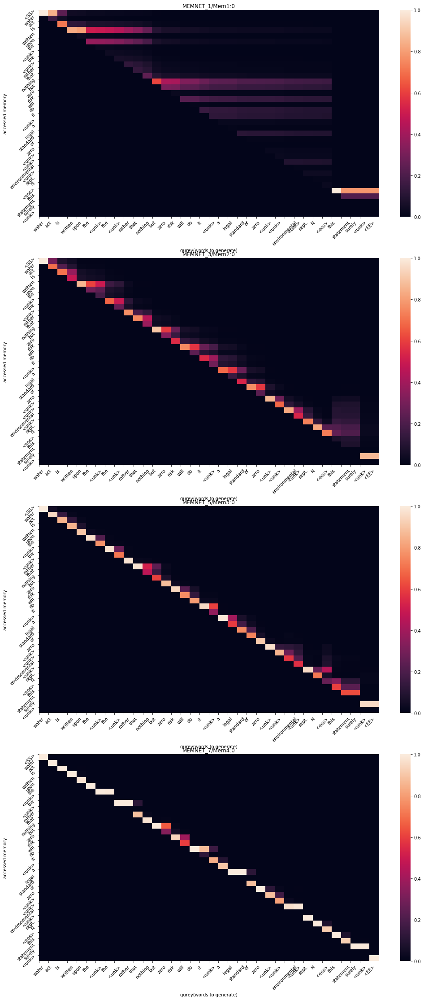

On iter 2201 with training PPL: 98.99203491210938, training ACC 0.2437065988779068
On iter 2202 with training PPL: 103.65370178222656, training ACC 0.2467447966337204
On iter 2203 with training PPL: 104.73535919189453, training ACC 0.2345920205116272
On iter 2204 with training PPL: 88.28778839111328, training ACC 0.2560763955116272
On iter 2205 with training PPL: 94.58744812011719, training ACC 0.2471788227558136
On iter 2206 with training PPL: 95.77477264404297, training ACC 0.2458767294883728
On iter 2207 with training PPL: 99.2585678100586, training ACC 0.2439236044883728
On iter 2208 with training PPL: 101.22037506103516, training ACC 0.2523871660232544
On iter 2209 with training PPL: 103.37167358398438, training ACC 0.2437065988779068
On iter 2210 with training PPL: 95.4927749633789, training ACC 0.2476128488779068
On iter 2211 with training PPL: 106.23110961914062, training ACC 0.2473958283662796
On iter 2212 with training PPL: 96.07537841796875, training ACC 0.2471788227558136
O

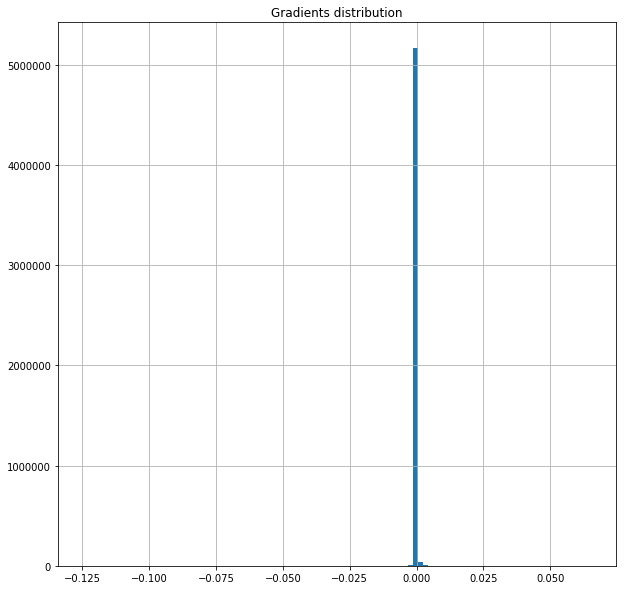

On iter 2221 with training PPL: 92.48162078857422, training ACC 0.2628038227558136
On iter 2222 with training PPL: 117.63489532470703, training ACC 0.2282986044883728
On iter 2223 with training PPL: 91.19952392578125, training ACC 0.2630208432674408
On iter 2224 with training PPL: 108.36078643798828, training ACC 0.2387152761220932
On iter 2225 with training PPL: 102.23416900634766, training ACC 0.2467447966337204
On iter 2226 with training PPL: 109.19395446777344, training ACC 0.2411024272441864
On iter 2227 with training PPL: 105.68746185302734, training ACC 0.2465277761220932
On iter 2228 with training PPL: 95.92742919921875, training ACC 0.2526041567325592
On iter 2229 with training PPL: 92.89287567138672, training ACC 0.2573784589767456
On iter 2230 with training PPL: 95.8227767944336, training ACC 0.2521701455116272
On iter 2231 with training PPL: 118.87049865722656, training ACC 0.2222222238779068
On iter 2232 with training PPL: 114.24215698242188, training ACC 0.238064229488372

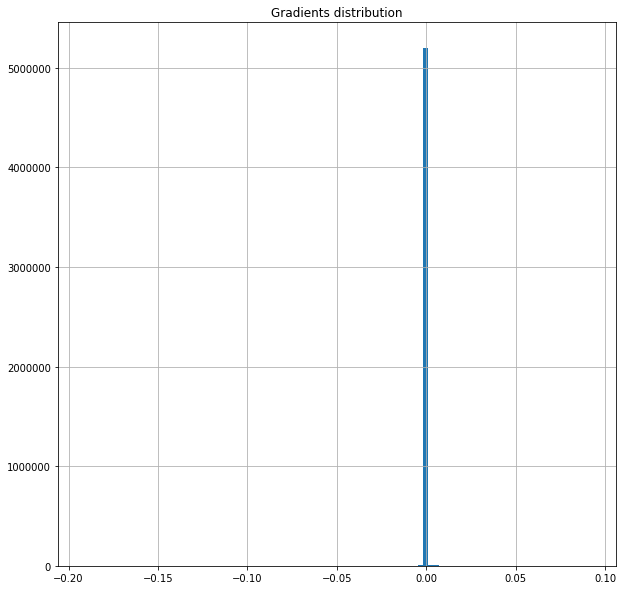

On iter 2251 with training PPL: 97.68309020996094, training ACC 0.2513020932674408
On iter 2252 with training PPL: 97.00007629394531, training ACC 0.2571614682674408
On iter 2253 with training PPL: 109.50456237792969, training ACC 0.2374131977558136
On iter 2254 with training PPL: 110.10165405273438, training ACC 0.2328559011220932
On iter 2255 with training PPL: 89.3134994506836, training ACC 0.265625
On iter 2256 with training PPL: 98.55081939697266, training ACC 0.2513020932674408
On iter 2257 with training PPL: 107.2973861694336, training ACC 0.2352430522441864
On iter 2258 with training PPL: 114.07096099853516, training ACC 0.2335069477558136
On iter 2259 with training PPL: 106.14366149902344, training ACC 0.2326388955116272
On iter 2260 with training PPL: 97.01580047607422, training ACC 0.2508680522441864
On iter 2261 with training PPL: 95.10543060302734, training ACC 0.25
On iter 2262 with training PPL: 98.31819915771484, training ACC 0.2491319477558136
On iter 2263 with trainin

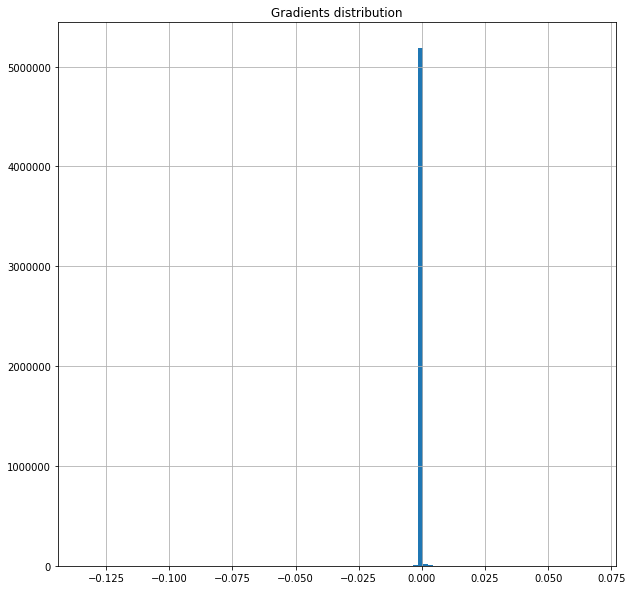

On iter 2281 with training PPL: 103.14335632324219, training ACC 0.2384982705116272
On iter 2282 with training PPL: 95.80555725097656, training ACC 0.2530381977558136
On iter 2283 with training PPL: 101.19093322753906, training ACC 0.2454427033662796
On iter 2284 with training PPL: 95.6233139038086, training ACC 0.2575954794883728
On iter 2285 with training PPL: 90.31818389892578, training ACC 0.2567274272441864
On iter 2286 with training PPL: 94.72479248046875, training ACC 0.2545572817325592
On iter 2287 with training PPL: 101.04107666015625, training ACC 0.2335069477558136
On iter 2288 with training PPL: 87.50395202636719, training ACC 0.2571614682674408
On iter 2289 with training PPL: 94.80884552001953, training ACC 0.25390625
On iter 2290 with training PPL: 98.1883316040039, training ACC 0.2424045205116272
On iter 2291 with training PPL: 107.20043182373047, training ACC 0.2391493022441864
On iter 2292 with training PPL: 106.62176513671875, training ACC 0.2434895783662796
On iter 2

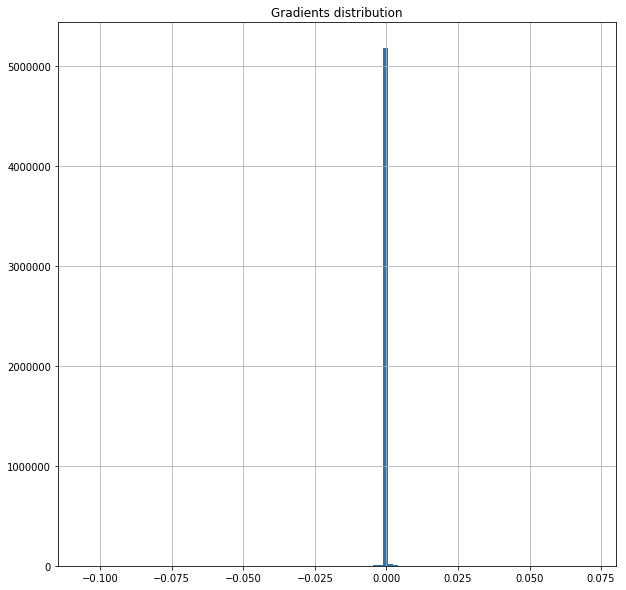

On iter 2311 with training PPL: 109.57617950439453, training ACC 0.2265625
On iter 2312 with training PPL: 101.40245056152344, training ACC 0.2473958283662796
On iter 2313 with training PPL: 99.6875991821289, training ACC 0.2534722089767456
On iter 2314 with training PPL: 101.40882873535156, training ACC 0.2543402910232544
On iter 2315 with training PPL: 99.77281188964844, training ACC 0.2491319477558136
On iter 2316 with training PPL: 104.98406982421875, training ACC 0.2374131977558136
On iter 2317 with training PPL: 105.83955383300781, training ACC 0.2393663227558136
On iter 2318 with training PPL: 102.35718536376953, training ACC 0.2469618022441864
On iter 2319 with training PPL: 95.3139419555664, training ACC 0.2556423544883728
On iter 2320 with training PPL: 99.46737670898438, training ACC 0.2413194477558136
On iter 2321 with training PPL: 100.46720123291016, training ACC 0.2404513955116272
On iter 2322 with training PPL: 101.37498474121094, training ACC 0.2447916716337204
On iter

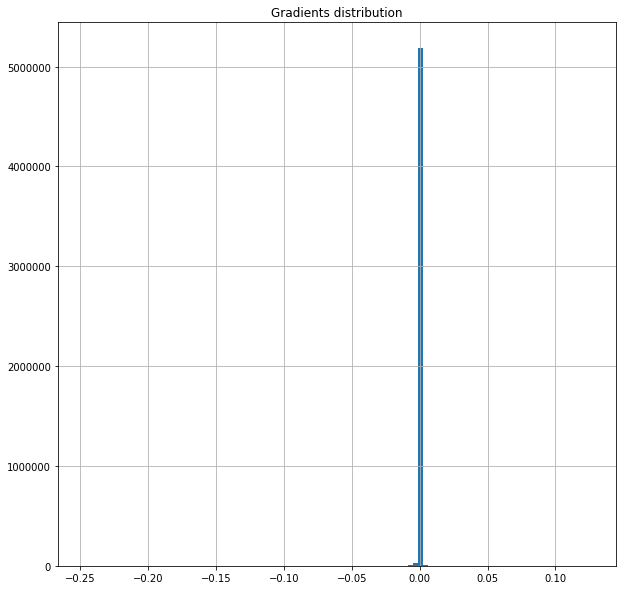

On iter 2341 with training PPL: 101.23625183105469, training ACC 0.2497829794883728
On iter 2342 with training PPL: 103.46038055419922, training ACC 0.2465277761220932
On iter 2343 with training PPL: 103.87616729736328, training ACC 0.2404513955116272
On iter 2344 with training PPL: 93.74079895019531, training ACC 0.2547743022441864
On iter 2345 with training PPL: 104.29276275634766, training ACC 0.2254774272441864
On iter 2346 with training PPL: 84.71671295166016, training ACC 0.26953125
On iter 2347 with training PPL: 99.84696197509766, training ACC 0.2515190839767456
On iter 2348 with training PPL: 106.16101837158203, training ACC 0.2393663227558136
On iter 2349 with training PPL: 107.02156829833984, training ACC 0.2358940988779068
On iter 2350 with training PPL: 85.73274230957031, training ACC 0.2634548544883728
On iter 2351 with training PPL: 97.07341766357422, training ACC 0.2545572817325592
On iter 2352 with training PPL: 104.12783813476562, training ACC 0.2452256977558136
On it

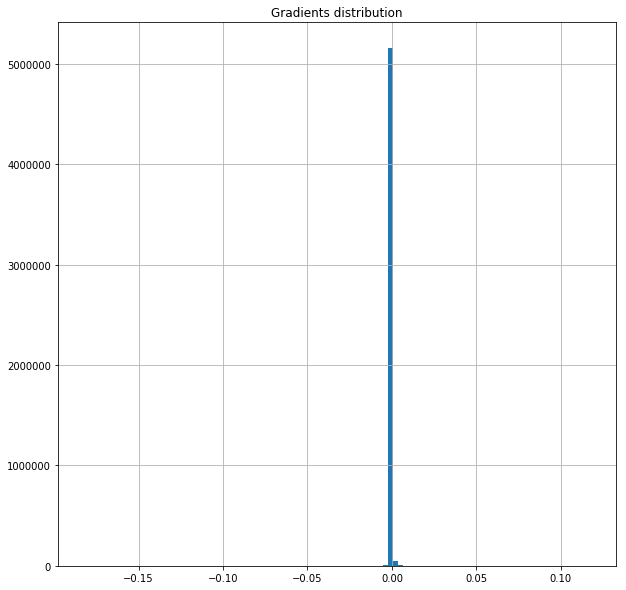

On iter 2371 with training PPL: 96.71862030029297, training ACC 0.2497829794883728
On iter 2372 with training PPL: 92.373291015625, training ACC 0.2482638955116272
On iter 2373 with training PPL: 99.46111297607422, training ACC 0.2491319477558136
On iter 2374 with training PPL: 113.31539154052734, training ACC 0.2313368022441864
On iter 2375 with training PPL: 103.92278289794922, training ACC 0.2437065988779068
On iter 2376 with training PPL: 105.92054748535156, training ACC 0.2391493022441864
On iter 2377 with training PPL: 110.24439239501953, training ACC 0.2352430522441864
On iter 2378 with training PPL: 101.89704132080078, training ACC 0.2465277761220932
On iter 2379 with training PPL: 84.84886932373047, training ACC 0.2638888955116272
On iter 2380 with training PPL: 93.92008209228516, training ACC 0.2463107705116272
On iter 2381 with training PPL: 92.31842803955078, training ACC 0.255859375
On iter 2382 with training PPL: 94.39451599121094, training ACC 0.2595486044883728
On iter 

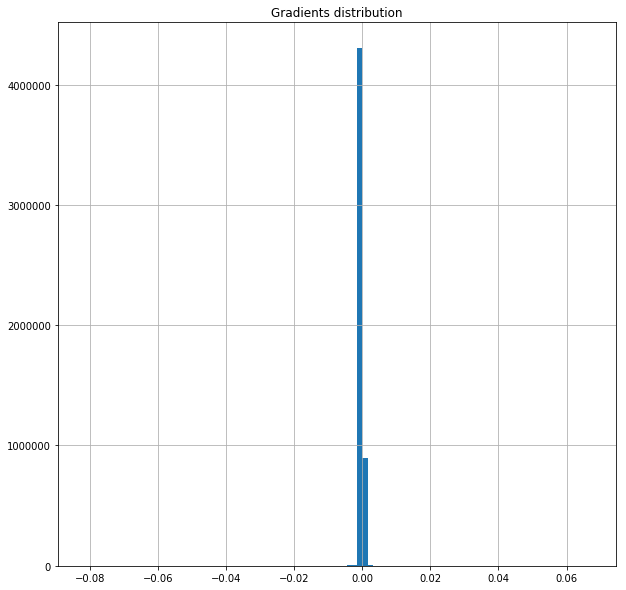

<SS> <unk> free trade agreement has ruled that canada 's restrictions on exports of pacific <unk> and <unk> violate the accord <eos> mrs. hills said the u.s. and canada have until nov. N to resolve the <EE>


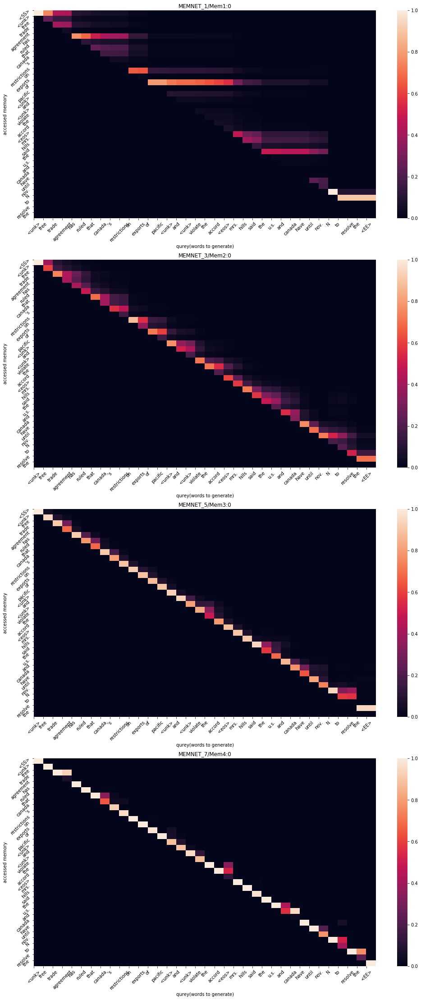

On iter 2401 with training PPL: 100.90376281738281, training ACC 0.2469618022441864
On iter 2402 with training PPL: 90.29820251464844, training ACC 0.2634548544883728
On iter 2403 with training PPL: 92.05902862548828, training ACC 0.2497829794883728
On iter 2404 with training PPL: 95.42094421386719, training ACC 0.255859375
On iter 2405 with training PPL: 96.17300415039062, training ACC 0.2471788227558136
On iter 2406 with training PPL: 96.09416198730469, training ACC 0.2521701455116272
On iter 2407 with training PPL: 85.03473663330078, training ACC 0.2630208432674408
On iter 2408 with training PPL: 95.34435272216797, training ACC 0.2554253339767456
On iter 2409 with training PPL: 90.41133880615234, training ACC 0.2562934160232544
On iter 2410 with training PPL: 91.41123962402344, training ACC 0.2517361044883728
On iter 2411 with training PPL: 97.99842834472656, training ACC 0.2526041567325592
On iter 2412 with training PPL: 99.40985870361328, training ACC 0.2408854216337204
On iter 24

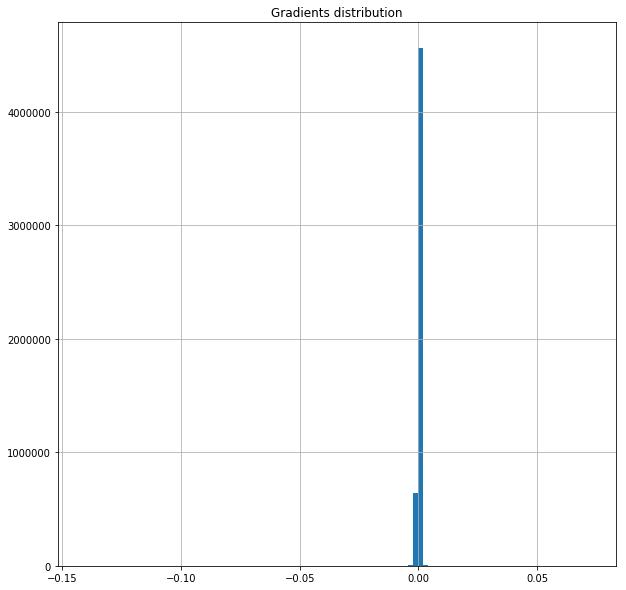

On iter 2431 with training PPL: 96.03374481201172, training ACC 0.2547743022441864
On iter 2432 with training PPL: 88.0206069946289, training ACC 0.2562934160232544
On iter 2433 with training PPL: 88.8152084350586, training ACC 0.2554253339767456
On iter 2434 with training PPL: 88.48186492919922, training ACC 0.2556423544883728
On iter 2435 with training PPL: 103.6461410522461, training ACC 0.2352430522441864
On iter 2436 with training PPL: 89.5696029663086, training ACC 0.2510850727558136
On iter 2437 with training PPL: 98.78710174560547, training ACC 0.24609375
On iter 2438 with training PPL: 78.99064636230469, training ACC 0.2719184160232544
On iter 2439 with training PPL: 89.42344665527344, training ACC 0.2619357705116272
On iter 2440 with training PPL: 91.27778625488281, training ACC 0.2523871660232544
On iter 2441 with training PPL: 93.08668518066406, training ACC 0.248046875
On iter 2442 with training PPL: 94.47183227539062, training ACC 0.24609375
On iter 2443 with training PPL

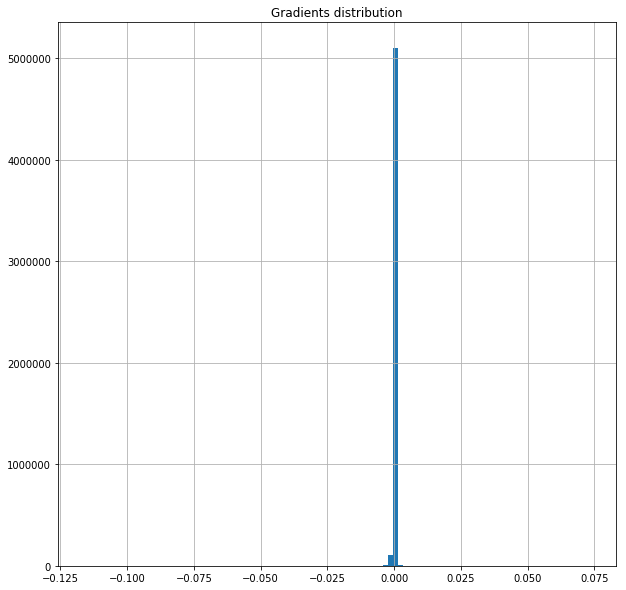

On iter 2461 with training PPL: 86.94706726074219, training ACC 0.259765625
On iter 2462 with training PPL: 93.32441711425781, training ACC 0.2510850727558136
On iter 2463 with training PPL: 99.01072692871094, training ACC 0.248046875
On iter 2464 with training PPL: 92.88114166259766, training ACC 0.25390625
On iter 2465 with training PPL: 97.23583984375, training ACC 0.2437065988779068
On iter 2466 with training PPL: 91.55318450927734, training ACC 0.2513020932674408
On iter 2467 with training PPL: 91.78744506835938, training ACC 0.2450086772441864
On iter 2468 with training PPL: 102.48079681396484, training ACC 0.2395833283662796
On iter 2469 with training PPL: 95.66787719726562, training ACC 0.2484809011220932
On iter 2470 with training PPL: 76.14009094238281, training ACC 0.2877604067325592
On iter 2471 with training PPL: 88.5844497680664, training ACC 0.2515190839767456
On iter 2472 with training PPL: 102.20175170898438, training ACC 0.2411024272441864
On iter 2473 with training P

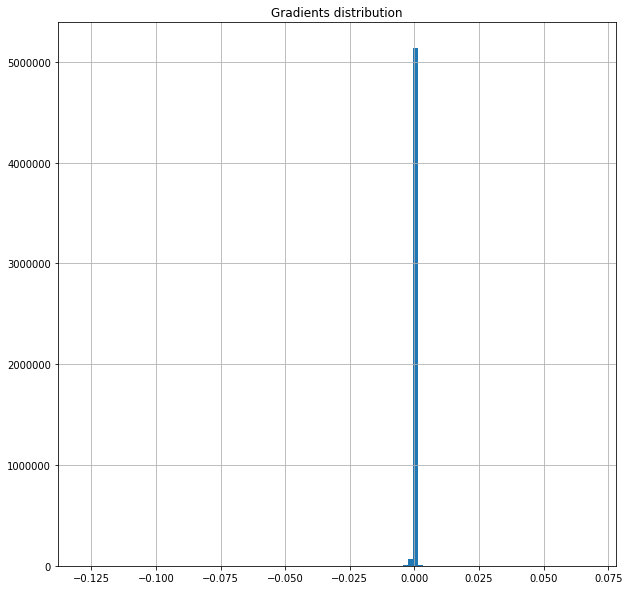

On iter 2491 with training PPL: 99.7265853881836, training ACC 0.2530381977558136
On iter 2492 with training PPL: 88.06007385253906, training ACC 0.259765625
On iter 2493 with training PPL: 85.72815704345703, training ACC 0.2556423544883728
On iter 2494 with training PPL: 90.22503662109375, training ACC 0.2549913227558136
On iter 2495 with training PPL: 88.2286605834961, training ACC 0.255859375
On iter 2496 with training PPL: 103.2015609741211, training ACC 0.2380642294883728
On iter 2497 with training PPL: 81.69121551513672, training ACC 0.2628038227558136
On iter 2498 with training PPL: 101.63766479492188, training ACC 0.2393663227558136
On iter 2499 with training PPL: 84.54278564453125, training ACC 0.2658420205116272
On iter 2500 with training PPL: 87.52093505859375, training ACC 0.2473958283662796
On iter 2501 with training PPL: 99.91925811767578, training ACC 0.2421875
On iter 2502 with training PPL: 89.40788269042969, training ACC 0.2536892294883728
On iter 2503 with training P

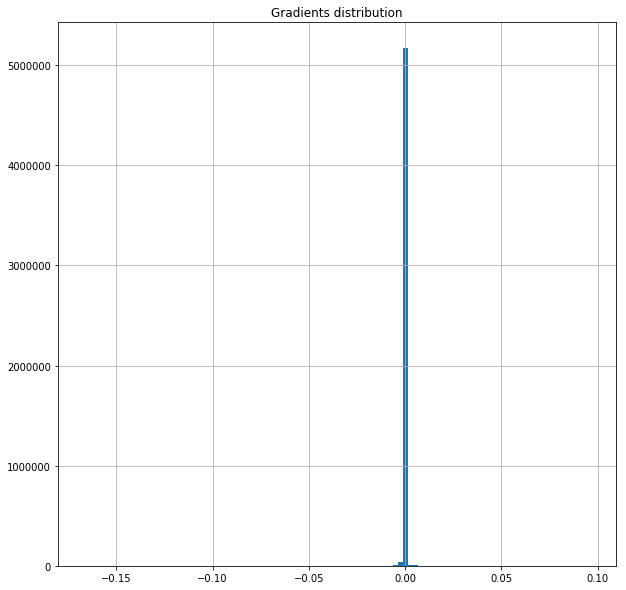

On iter 2521 with training PPL: 89.02339172363281, training ACC 0.2669270932674408
On iter 2522 with training PPL: 103.32402038574219, training ACC 0.2437065988779068
On iter 2523 with training PPL: 93.78573608398438, training ACC 0.2575954794883728
On iter 2524 with training PPL: 93.51324462890625, training ACC 0.2506510317325592
On iter 2525 with training PPL: 78.27986907958984, training ACC 0.2643229067325592
On iter 2526 with training PPL: 100.43457794189453, training ACC 0.24609375
On iter 2527 with training PPL: 91.02633666992188, training ACC 0.2612847089767456
On iter 2528 with training PPL: 88.67141723632812, training ACC 0.255859375
On iter 2529 with training PPL: 95.82305908203125, training ACC 0.2491319477558136
On iter 2530 with training PPL: 91.46613311767578, training ACC 0.2467447966337204
On iter 2531 with training PPL: 95.24129486083984, training ACC 0.244140625
On iter 2532 with training PPL: 95.58488464355469, training ACC 0.2556423544883728
On iter 2533 with traini

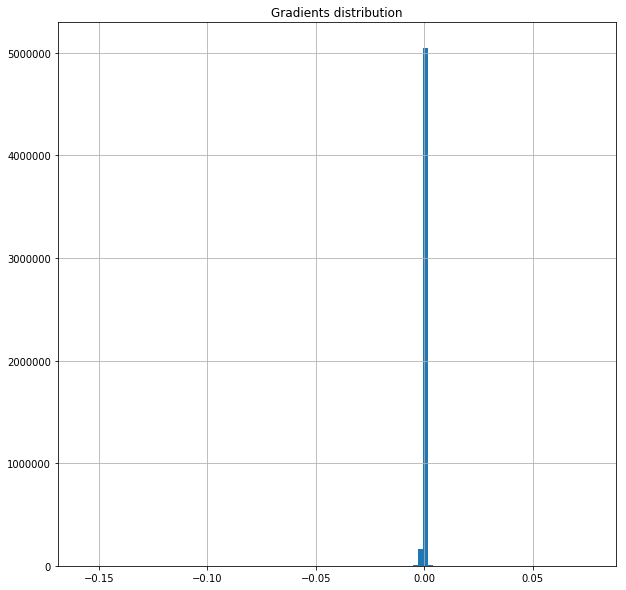

On iter 2551 with training PPL: 91.43722534179688, training ACC 0.2523871660232544
On iter 2552 with training PPL: 101.8351058959961, training ACC 0.2384982705116272
On iter 2553 with training PPL: 91.13687133789062, training ACC 0.2530381977558136
On iter 2554 with training PPL: 96.32630157470703, training ACC 0.2471788227558136
On iter 2555 with training PPL: 95.18209075927734, training ACC 0.2536892294883728
On iter 2556 with training PPL: 90.0082015991211, training ACC 0.2601996660232544
On iter 2557 with training PPL: 100.61280059814453, training ACC 0.2371961772441864
On iter 2558 with training PPL: 84.36764526367188, training ACC 0.2601996660232544
On iter 2559 with training PPL: 97.17214965820312, training ACC 0.2510850727558136
On iter 2560 with training PPL: 87.81573486328125, training ACC 0.2569444477558136
On iter 2561 with training PPL: 90.92431640625, training ACC 0.2562934160232544
On iter 2562 with training PPL: 88.10076904296875, training ACC 0.2662760317325592
On iter

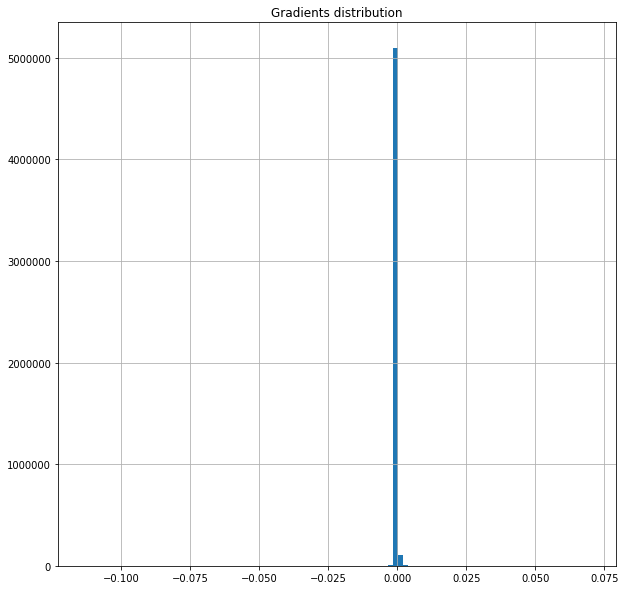

On iter 2581 with training PPL: 86.1246566772461, training ACC 0.2595486044883728
On iter 2582 with training PPL: 98.99160766601562, training ACC 0.2411024272441864
On iter 2583 with training PPL: 93.63577270507812, training ACC 0.2463107705116272
On iter 2584 with training PPL: 99.4654769897461, training ACC 0.2417534738779068
On iter 2585 with training PPL: 87.91788482666016, training ACC 0.2497829794883728
On iter 2586 with training PPL: 92.98399353027344, training ACC 0.2630208432674408
On iter 2587 with training PPL: 90.41104125976562, training ACC 0.2504340410232544
On iter 2588 with training PPL: 96.06525421142578, training ACC 0.2478298544883728
On iter 2589 with training PPL: 99.84139251708984, training ACC 0.2421875
On iter 2590 with training PPL: 104.81794738769531, training ACC 0.2391493022441864
On iter 2591 with training PPL: 86.80647277832031, training ACC 0.2571614682674408
On iter 2592 with training PPL: 90.31555938720703, training ACC 0.2482638955116272
On iter 2593 w

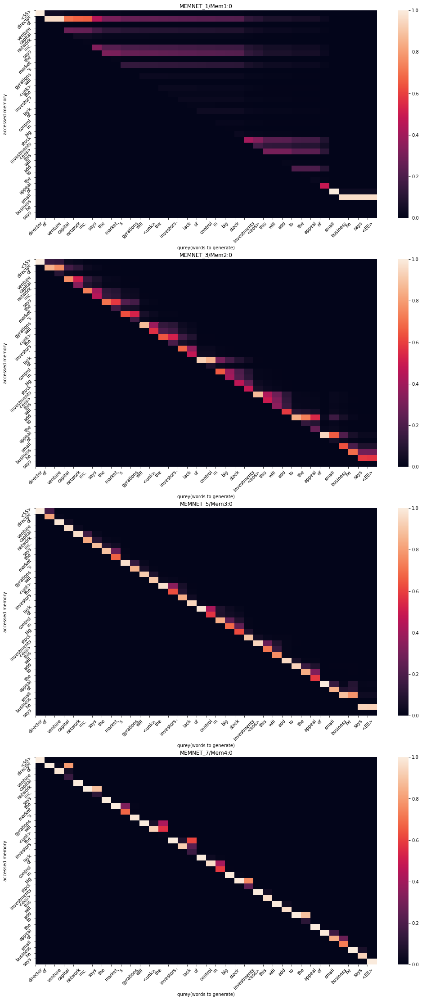

On iter 2601 with training PPL: 94.14140319824219, training ACC 0.2495659738779068
On iter 2602 with training PPL: 94.43286895751953, training ACC 0.25
On iter 2603 with training PPL: 88.09265899658203, training ACC 0.2486979216337204
On iter 2604 with training PPL: 90.32084655761719, training ACC 0.2547743022441864
On iter 2605 with training PPL: 84.09737396240234, training ACC 0.2664930522441864
On iter 2606 with training PPL: 86.24713134765625, training ACC 0.255859375
On iter 2607 with training PPL: 89.75199890136719, training ACC 0.2465277761220932
On iter 2608 with training PPL: 97.7923812866211, training ACC 0.2495659738779068
On iter 2609 with training PPL: 89.80743408203125, training ACC 0.251953125
On iter 2610 with training PPL: 90.4007797241211, training ACC 0.2595486044883728
	 validation PPL 146.4004669189453, validation acc 0.2421875
shape of gradients is (5228544,), L2 norm of gradients is 1.557555913925171, details:                   0
count  5.228544e+06
mean  -6.2418

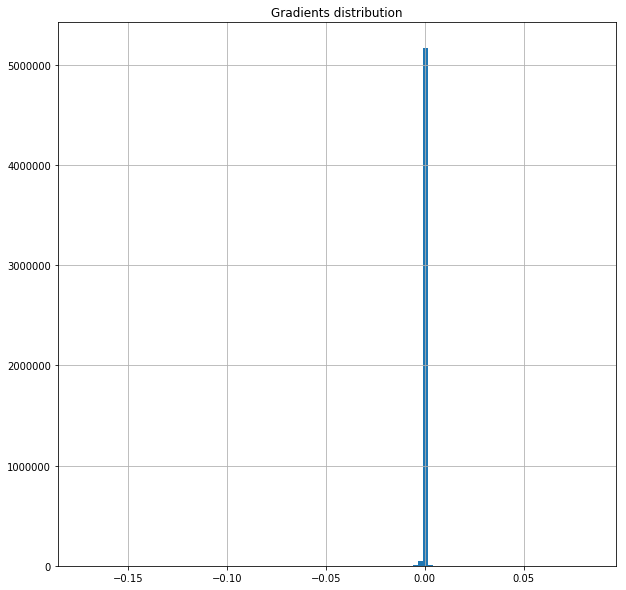

On iter 2611 with training PPL: 95.34516906738281, training ACC 0.2508680522441864
On iter 2612 with training PPL: 90.2724609375, training ACC 0.2571614682674408
On iter 2613 with training PPL: 90.99535369873047, training ACC 0.2482638955116272
On iter 2614 with training PPL: 90.14444732666016, training ACC 0.2571614682674408
On iter 2615 with training PPL: 87.2150650024414, training ACC 0.2584635317325592
On iter 2616 with training PPL: 97.51583099365234, training ACC 0.2447916716337204
On iter 2617 with training PPL: 91.221435546875, training ACC 0.2584635317325592
On iter 2618 with training PPL: 92.91644287109375, training ACC 0.2473958283662796
On iter 2619 with training PPL: 88.21208190917969, training ACC 0.2595486044883728
On iter 2620 with training PPL: 95.76933288574219, training ACC 0.2476128488779068
On iter 2621 with training PPL: 100.3423843383789, training ACC 0.2426215261220932
On iter 2622 with training PPL: 85.71434783935547, training ACC 0.2632378339767456
On iter 262

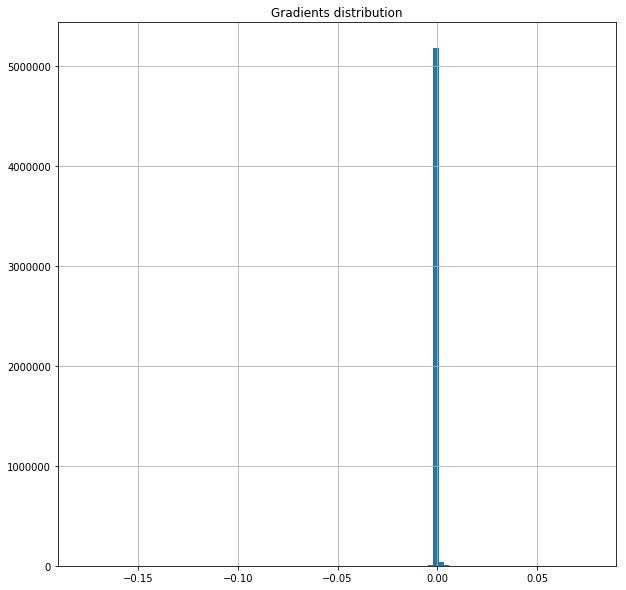

On iter 2641 with training PPL: 90.02799224853516, training ACC 0.25390625
On iter 2642 with training PPL: 101.68429565429688, training ACC 0.2421875
On iter 2643 with training PPL: 89.42105102539062, training ACC 0.2456597238779068
On iter 2644 with training PPL: 90.67578125, training ACC 0.2517361044883728
On iter 2645 with training PPL: 95.43363952636719, training ACC 0.2439236044883728
On iter 2646 with training PPL: 91.22026062011719, training ACC 0.2556423544883728
On iter 2647 with training PPL: 104.68383026123047, training ACC 0.2354600727558136
On iter 2648 with training PPL: 94.41323852539062, training ACC 0.2430555522441864
On iter 2649 with training PPL: 90.44083404541016, training ACC 0.2554253339767456
On iter 2650 with training PPL: 89.6739730834961, training ACC 0.2543402910232544
On iter 2651 with training PPL: 84.92926025390625, training ACC 0.2712673544883728
On iter 2652 with training PPL: 101.85088348388672, training ACC 0.234375
On iter 2653 with training PPL: 92.

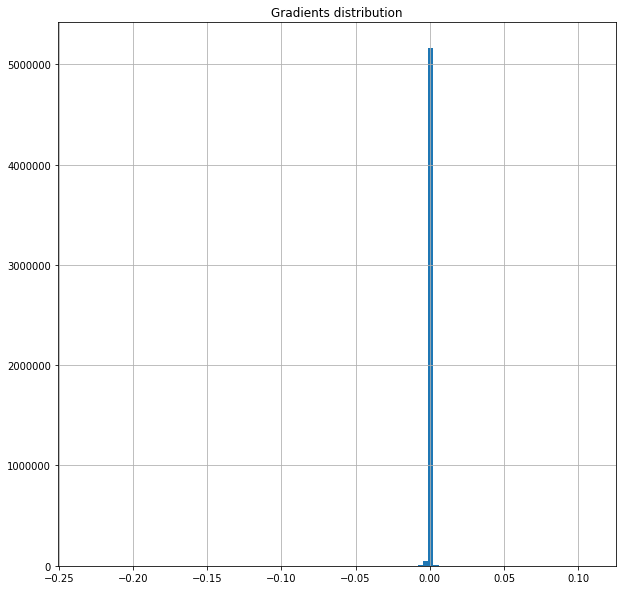

On iter 2671 with training PPL: 78.64057159423828, training ACC 0.2664930522441864
On iter 2672 with training PPL: 90.84522247314453, training ACC 0.2584635317325592
On iter 2673 with training PPL: 96.37165069580078, training ACC 0.2536892294883728
On iter 2674 with training PPL: 92.73584747314453, training ACC 0.2473958283662796
On iter 2675 with training PPL: 93.10790252685547, training ACC 0.2543402910232544
On iter 2676 with training PPL: 91.58161163330078, training ACC 0.2567274272441864
On iter 2677 with training PPL: 94.47872161865234, training ACC 0.2428385466337204
On iter 2678 with training PPL: 89.20411682128906, training ACC 0.2510850727558136
On iter 2679 with training PPL: 83.46851348876953, training ACC 0.2591145932674408
On iter 2680 with training PPL: 83.40023803710938, training ACC 0.2673611044883728
On iter 2681 with training PPL: 87.6152572631836, training ACC 0.2545572817325592
On iter 2682 with training PPL: 99.40834045410156, training ACC 0.2389322966337204
On it

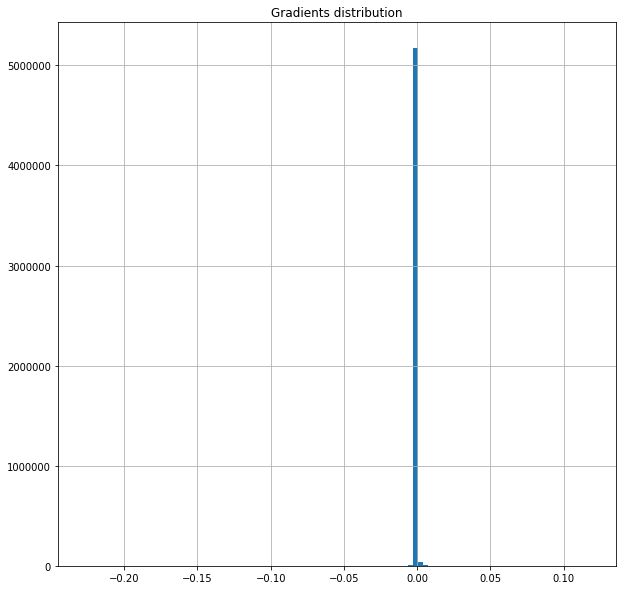

On iter 2701 with training PPL: 92.0894546508789, training ACC 0.2608506977558136
On iter 2702 with training PPL: 92.47103881835938, training ACC 0.2411024272441864
On iter 2703 with training PPL: 85.51993560791016, training ACC 0.2641059160232544
On iter 2704 with training PPL: 100.10343933105469, training ACC 0.240234375
On iter 2705 with training PPL: 84.00711822509766, training ACC 0.2586805522441864
On iter 2706 with training PPL: 80.56100463867188, training ACC 0.2549913227558136
On iter 2707 with training PPL: 80.55036163330078, training ACC 0.2569444477558136
On iter 2708 with training PPL: 98.23436737060547, training ACC 0.2376302033662796
On iter 2709 with training PPL: 82.1187515258789, training ACC 0.26953125
On iter 2710 with training PPL: 86.03611755371094, training ACC 0.2591145932674408
On iter 2711 with training PPL: 92.65067291259766, training ACC 0.2450086772441864
On iter 2712 with training PPL: 92.3821029663086, training ACC 0.244140625
On iter 2713 with training P

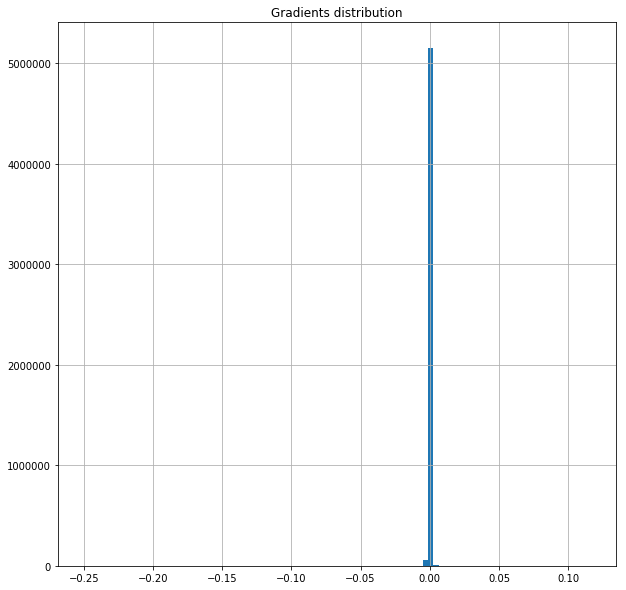

On iter 2731 with training PPL: 85.1760025024414, training ACC 0.2621527910232544
On iter 2732 with training PPL: 84.75202941894531, training ACC 0.2630208432674408
On iter 2733 with training PPL: 80.6900634765625, training ACC 0.2643229067325592
On iter 2734 with training PPL: 85.50639343261719, training ACC 0.2578125
On iter 2735 with training PPL: 96.22543334960938, training ACC 0.2393663227558136
On iter 2736 with training PPL: 89.92013549804688, training ACC 0.2534722089767456
On iter 2737 with training PPL: 91.53341674804688, training ACC 0.2506510317325592
On iter 2738 with training PPL: 82.61173248291016, training ACC 0.2630208432674408
On iter 2739 with training PPL: 96.36685943603516, training ACC 0.2478298544883728
On iter 2740 with training PPL: 82.03096771240234, training ACC 0.2580295205116272
On iter 2741 with training PPL: 88.58731842041016, training ACC 0.2593315839767456
On iter 2742 with training PPL: 92.89845275878906, training ACC 0.2486979216337204
On iter 2743 wi

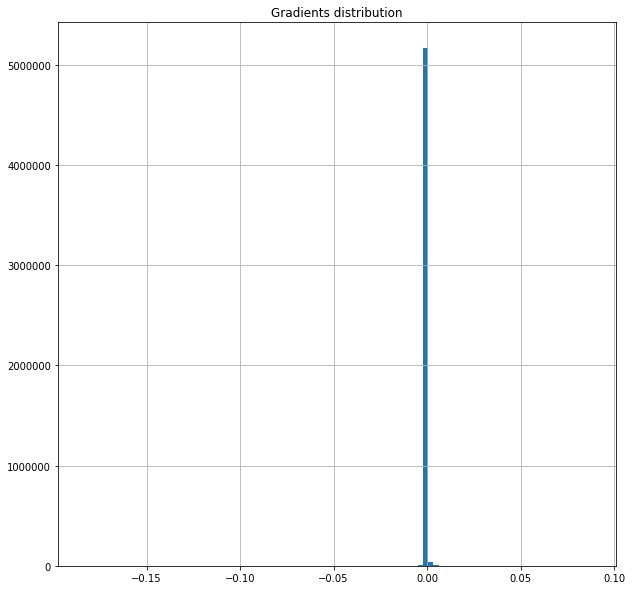

On iter 2761 with training PPL: 86.04830169677734, training ACC 0.2649739682674408
On iter 2762 with training PPL: 89.37757110595703, training ACC 0.2641059160232544
On iter 2763 with training PPL: 91.09303283691406, training ACC 0.2567274272441864
On iter 2764 with training PPL: 89.04194641113281, training ACC 0.2530381977558136
On iter 2765 with training PPL: 96.04483032226562, training ACC 0.2439236044883728
On iter 2766 with training PPL: 83.81182098388672, training ACC 0.2547743022441864
On iter 2767 with training PPL: 94.97322845458984, training ACC 0.2484809011220932
On iter 2768 with training PPL: 91.67581939697266, training ACC 0.25
On iter 2769 with training PPL: 87.74913787841797, training ACC 0.2554253339767456
On iter 2770 with training PPL: 83.87422943115234, training ACC 0.271484375
On iter 2771 with training PPL: 85.39764404296875, training ACC 0.2578125
On iter 2772 with training PPL: 87.55728912353516, training ACC 0.263671875
On iter 2773 with training PPL: 83.301513

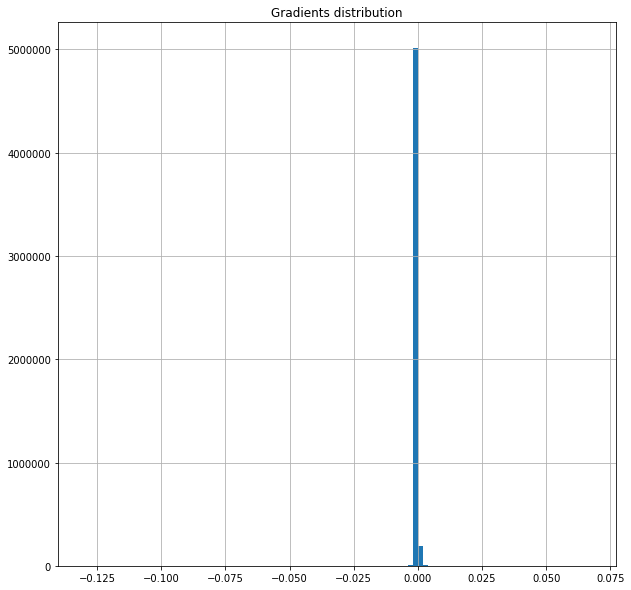

On iter 2791 with training PPL: 97.4516372680664, training ACC 0.2530381977558136
On iter 2792 with training PPL: 93.26164245605469, training ACC 0.2552083432674408
On iter 2793 with training PPL: 84.96336364746094, training ACC 0.2645399272441864
On iter 2794 with training PPL: 85.9023208618164, training ACC 0.2578125
On iter 2795 with training PPL: 89.41700744628906, training ACC 0.2489149272441864
On iter 2796 with training PPL: 79.38633728027344, training ACC 0.2619357705116272
On iter 2797 with training PPL: 96.32928466796875, training ACC 0.244140625
On iter 2798 with training PPL: 86.67230224609375, training ACC 0.2526041567325592
On iter 2799 with training PPL: 86.00822448730469, training ACC 0.2467447966337204
On iter 2800 with training PPL: 91.48511505126953, training ACC 0.2502170205116272
<SS> the commerce department 's widely followed index of leading indicators while up in august has fallen repeatedly since reaching a high early this year <eos> its <unk> behavior through 

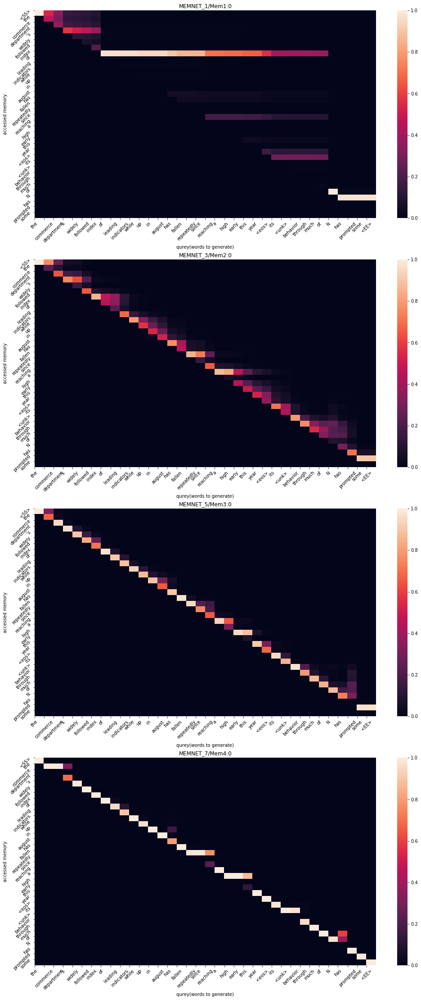

On iter 2801 with training PPL: 81.58264923095703, training ACC 0.2615017294883728
On iter 2802 with training PPL: 102.19112396240234, training ACC 0.2415364533662796
On iter 2803 with training PPL: 80.93607330322266, training ACC 0.2721354067325592
On iter 2804 with training PPL: 87.7502670288086, training ACC 0.2510850727558136
On iter 2805 with training PPL: 89.13387298583984, training ACC 0.2508680522441864
On iter 2806 with training PPL: 84.78953552246094, training ACC 0.2647569477558136
On iter 2807 with training PPL: 84.78986358642578, training ACC 0.2523871660232544
On iter 2808 with training PPL: 88.62894439697266, training ACC 0.2591145932674408
On iter 2809 with training PPL: 81.13967895507812, training ACC 0.2684461772441864
On iter 2810 with training PPL: 93.8636703491211, training ACC 0.2536892294883728
On iter 2811 with training PPL: 79.71281433105469, training ACC 0.2628038227558136
On iter 2812 with training PPL: 85.40143585205078, training ACC 0.2562934160232544
On it

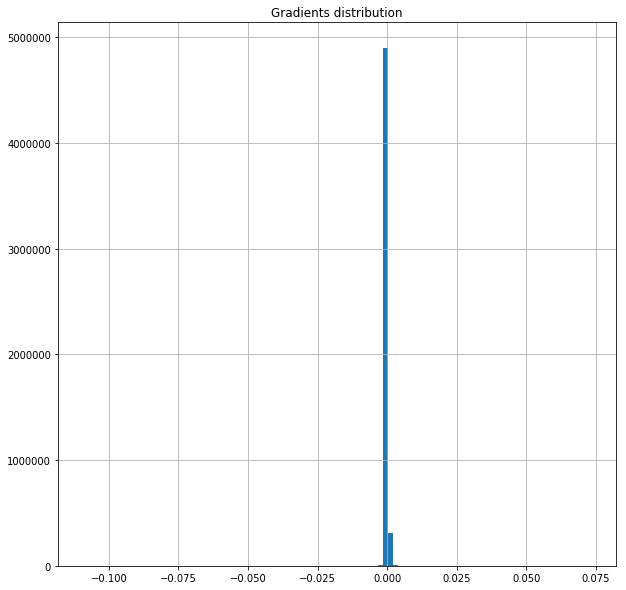

On iter 2821 with training PPL: 103.7756118774414, training ACC 0.2356770783662796
On iter 2822 with training PPL: 86.37483978271484, training ACC 0.2578125
On iter 2823 with training PPL: 93.26062774658203, training ACC 0.2562934160232544
On iter 2824 with training PPL: 84.93019104003906, training ACC 0.2588975727558136
On iter 2825 with training PPL: 76.82523345947266, training ACC 0.2669270932674408
On iter 2826 with training PPL: 87.24015045166016, training ACC 0.2586805522441864
On iter 2827 with training PPL: 84.0180892944336, training ACC 0.2586805522441864
On iter 2828 with training PPL: 95.48394012451172, training ACC 0.2489149272441864
On iter 2829 with training PPL: 94.97504425048828, training ACC 0.2424045205116272
On iter 2830 with training PPL: 95.56593322753906, training ACC 0.2419704794883728
On iter 2831 with training PPL: 86.5526123046875, training ACC 0.2532552182674408
On iter 2832 with training PPL: 93.38504791259766, training ACC 0.2398003488779068
On iter 2833 wi

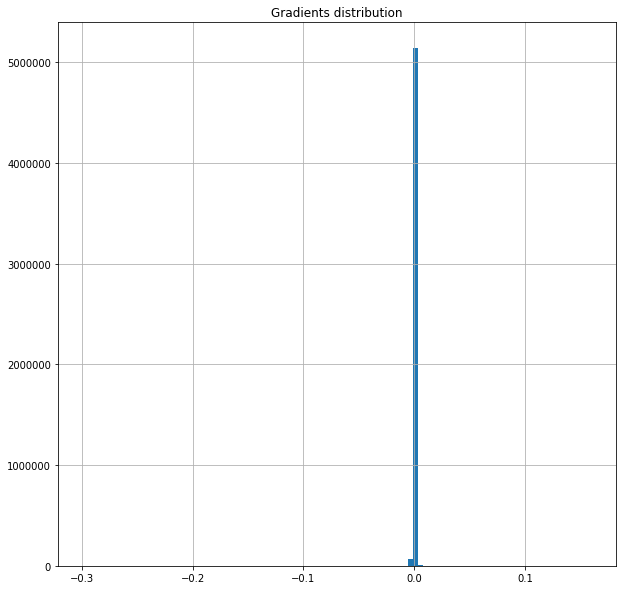

On iter 2851 with training PPL: 91.89315795898438, training ACC 0.2528211772441864
On iter 2852 with training PPL: 87.85053253173828, training ACC 0.2575954794883728
On iter 2853 with training PPL: 92.69207763671875, training ACC 0.2513020932674408
On iter 2854 with training PPL: 88.21263122558594, training ACC 0.2482638955116272
On iter 2855 with training PPL: 83.94032287597656, training ACC 0.251953125
On iter 2856 with training PPL: 88.29856872558594, training ACC 0.2601996660232544
On iter 2857 with training PPL: 93.64460754394531, training ACC 0.25
On iter 2858 with training PPL: 95.35330963134766, training ACC 0.2393663227558136
On iter 2859 with training PPL: 89.66490173339844, training ACC 0.2536892294883728
On iter 2860 with training PPL: 93.77723693847656, training ACC 0.2530381977558136
On iter 2861 with training PPL: 95.79953002929688, training ACC 0.2478298544883728
On iter 2862 with training PPL: 90.64686584472656, training ACC 0.2595486044883728
On iter 2863 with trainin

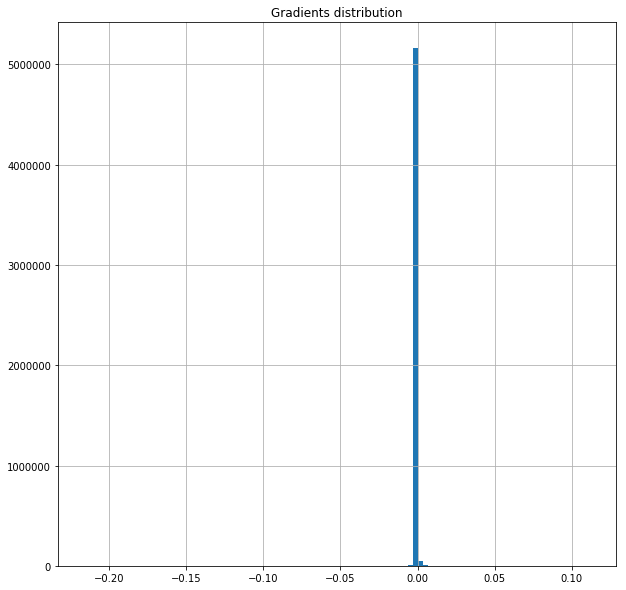

On iter 2881 with training PPL: 90.61653137207031, training ACC 0.2526041567325592
On iter 2882 with training PPL: 90.37242126464844, training ACC 0.2495659738779068
On iter 2883 with training PPL: 93.0691146850586, training ACC 0.2543402910232544
On iter 2884 with training PPL: 100.15093231201172, training ACC 0.2426215261220932
On iter 2885 with training PPL: 83.93804168701172, training ACC 0.2612847089767456
On iter 2886 with training PPL: 92.63671112060547, training ACC 0.2491319477558136
On iter 2887 with training PPL: 81.49901580810547, training ACC 0.271484375
On iter 2888 with training PPL: 84.23246002197266, training ACC 0.2604166567325592
On iter 2889 with training PPL: 79.13636016845703, training ACC 0.26171875
On iter 2890 with training PPL: 79.84009552001953, training ACC 0.2586805522441864
On iter 2891 with training PPL: 88.60041809082031, training ACC 0.2491319477558136
On iter 2892 with training PPL: 84.5381088256836, training ACC 0.2619357705116272
On iter 2893 with tr

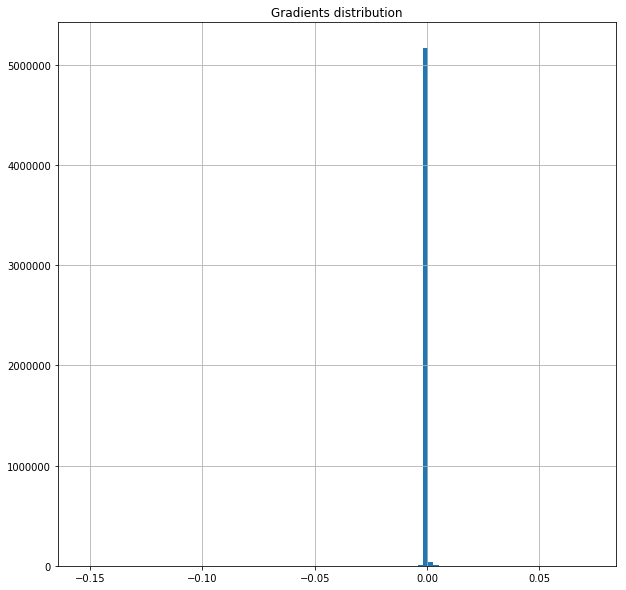

On iter 2911 with training PPL: 96.97113037109375, training ACC 0.2406684011220932
On iter 2912 with training PPL: 86.49563598632812, training ACC 0.2543402910232544
On iter 2913 with training PPL: 78.77259826660156, training ACC 0.2701822817325592
On iter 2914 with training PPL: 95.80422973632812, training ACC 0.2417534738779068
On iter 2915 with training PPL: 87.74809265136719, training ACC 0.2508680522441864
On iter 2916 with training PPL: 90.1220932006836, training ACC 0.2586805522441864
On iter 2917 with training PPL: 88.2242431640625, training ACC 0.2528211772441864
On iter 2918 with training PPL: 89.03511047363281, training ACC 0.2562934160232544
On iter 2919 with training PPL: 95.35099029541016, training ACC 0.2554253339767456
On iter 2920 with training PPL: 87.92031860351562, training ACC 0.2567274272441864
On iter 2921 with training PPL: 82.85066986083984, training ACC 0.26171875
On iter 2922 with training PPL: 82.23324584960938, training ACC 0.2625868022441864
On iter 2923 w

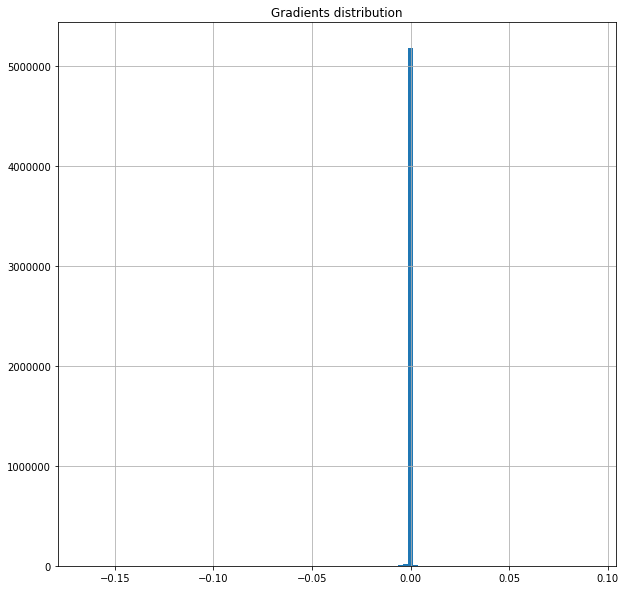

On iter 2941 with training PPL: 97.30518341064453, training ACC 0.2426215261220932
On iter 2942 with training PPL: 97.82516479492188, training ACC 0.2391493022441864
On iter 2943 with training PPL: 89.43448638916016, training ACC 0.2586805522441864
On iter 2944 with training PPL: 80.16400909423828, training ACC 0.2667100727558136
On iter 2945 with training PPL: 89.19739532470703, training ACC 0.2575954794883728
On iter 2946 with training PPL: 95.89842987060547, training ACC 0.2497829794883728
On iter 2947 with training PPL: 86.13644409179688, training ACC 0.2610677182674408
On iter 2948 with training PPL: 95.36426544189453, training ACC 0.2463107705116272
On iter 2949 with training PPL: 84.63357543945312, training ACC 0.2623697817325592
On iter 2950 with training PPL: 83.087890625, training ACC 0.2469618022441864
On iter 2951 with training PPL: 89.44519805908203, training ACC 0.2565104067325592
On iter 2952 with training PPL: 78.07662963867188, training ACC 0.2708333432674408
On iter 2

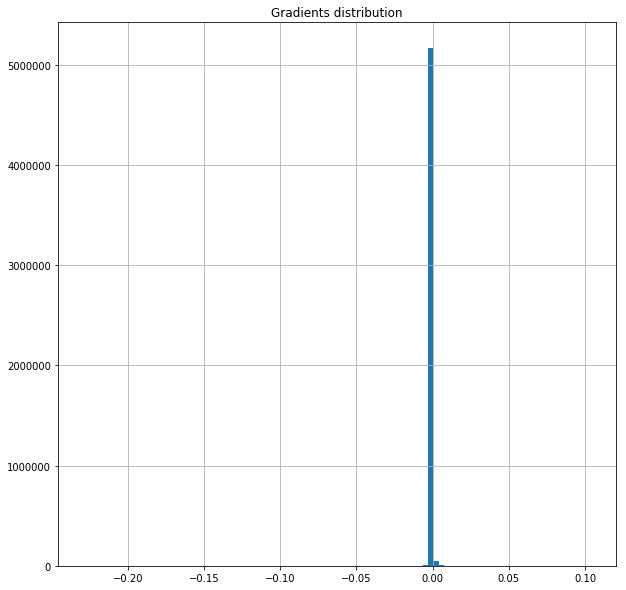

On iter 2971 with training PPL: 85.21110534667969, training ACC 0.2454427033662796
On iter 2972 with training PPL: 94.18742370605469, training ACC 0.2432725727558136
On iter 2973 with training PPL: 90.29027557373047, training ACC 0.2456597238779068
On iter 2974 with training PPL: 85.95480346679688, training ACC 0.2534722089767456
On iter 2975 with training PPL: 87.65968322753906, training ACC 0.2578125
On iter 2976 with training PPL: 85.53539276123047, training ACC 0.2604166567325592
On iter 2977 with training PPL: 79.66763305664062, training ACC 0.2723524272441864
On iter 2978 with training PPL: 87.20783233642578, training ACC 0.259765625
On iter 2979 with training PPL: 87.73670959472656, training ACC 0.2578125
On iter 2980 with training PPL: 85.06584167480469, training ACC 0.2560763955116272
On iter 2981 with training PPL: 80.04483795166016, training ACC 0.2727864682674408
On iter 2982 with training PPL: 84.18299865722656, training ACC 0.2591145932674408
On iter 2983 with training PP

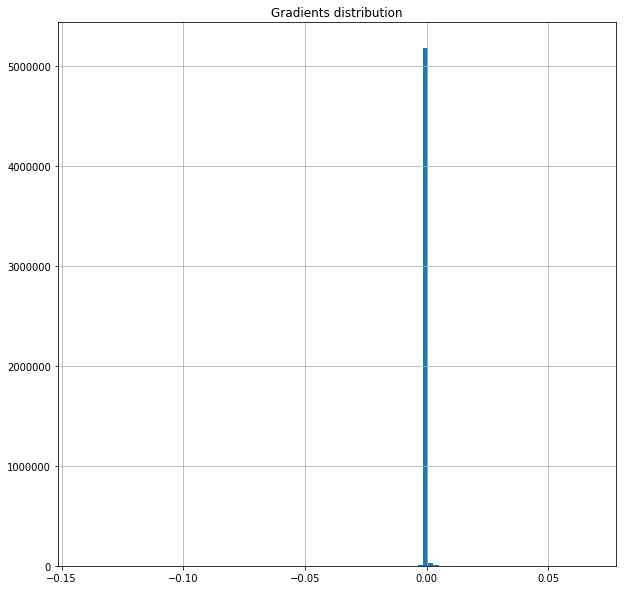

<SS> solo however the music lacks the <unk> provided by a context within another medium <eos> <unk> of mr. glass may agree with the critic richard <unk> 's sense that the N music in twelve parts <EE>


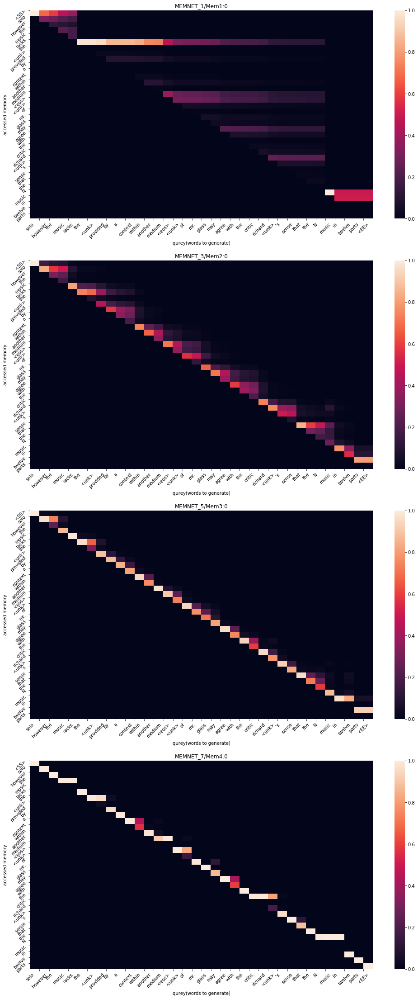

On iter 3001 with training PPL: 97.55270385742188, training ACC 0.2434895783662796
On iter 3002 with training PPL: 87.73641967773438, training ACC 0.2541232705116272
On iter 3003 with training PPL: 90.47400665283203, training ACC 0.2515190839767456
On iter 3004 with training PPL: 79.95195007324219, training ACC 0.2669270932674408
On iter 3005 with training PPL: 87.21543884277344, training ACC 0.2556423544883728
On iter 3006 with training PPL: 100.13623046875, training ACC 0.2465277761220932
On iter 3007 with training PPL: 77.72834014892578, training ACC 0.2593315839767456
On iter 3008 with training PPL: 84.7251968383789, training ACC 0.2677951455116272
On iter 3009 with training PPL: 86.86692810058594, training ACC 0.2552083432674408
On iter 3010 with training PPL: 79.70255279541016, training ACC 0.2628038227558136
On iter 3011 with training PPL: 93.14157104492188, training ACC 0.2497829794883728
On iter 3012 with training PPL: 88.5303955078125, training ACC 0.2497829794883728
On iter 

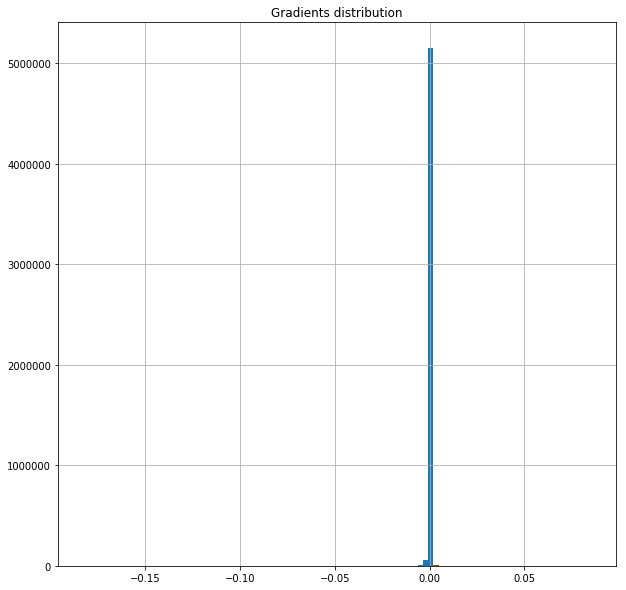

On iter 3031 with training PPL: 86.7622299194336, training ACC 0.2452256977558136
On iter 3032 with training PPL: 82.00347900390625, training ACC 0.2658420205116272
On iter 3033 with training PPL: 84.50651550292969, training ACC 0.2638888955116272
On iter 3034 with training PPL: 101.92774963378906, training ACC 0.244140625
On iter 3035 with training PPL: 79.6592025756836, training ACC 0.2680121660232544
On iter 3036 with training PPL: 77.46068572998047, training ACC 0.2651909589767456
On iter 3037 with training PPL: 87.17020416259766, training ACC 0.2534722089767456
On iter 3038 with training PPL: 90.83975982666016, training ACC 0.2478298544883728
On iter 3039 with training PPL: 78.70816802978516, training ACC 0.2634548544883728
On iter 3040 with training PPL: 74.89076232910156, training ACC 0.2710503339767456
On iter 3041 with training PPL: 87.26465606689453, training ACC 0.2606336772441864
On iter 3042 with training PPL: 86.4358139038086, training ACC 0.2504340410232544
On iter 3043 

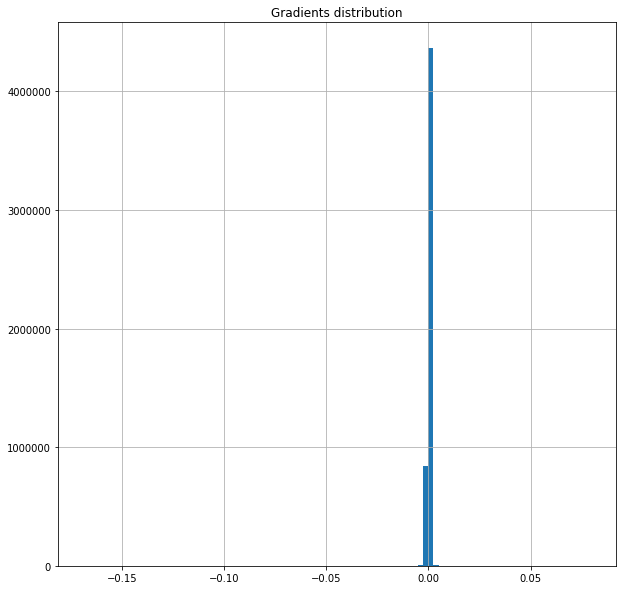

On iter 3061 with training PPL: 93.29630279541016, training ACC 0.25390625
On iter 3062 with training PPL: 82.28369140625, training ACC 0.2569444477558136
On iter 3063 with training PPL: 87.44330596923828, training ACC 0.2647569477558136
On iter 3064 with training PPL: 81.88629913330078, training ACC 0.2634548544883728
On iter 3065 with training PPL: 84.7530746459961, training ACC 0.2601996660232544
On iter 3066 with training PPL: 74.47389221191406, training ACC 0.2703993022441864
On iter 3067 with training PPL: 82.7525634765625, training ACC 0.2625868022441864
On iter 3068 with training PPL: 83.96894836425781, training ACC 0.2547743022441864
On iter 3069 with training PPL: 90.5156478881836, training ACC 0.2569444477558136
On iter 3070 with training PPL: 75.97148132324219, training ACC 0.267578125
On iter 3071 with training PPL: 84.45780944824219, training ACC 0.2595486044883728
On iter 3072 with training PPL: 81.88980865478516, training ACC 0.2658420205116272
On iter 3073 with trainin

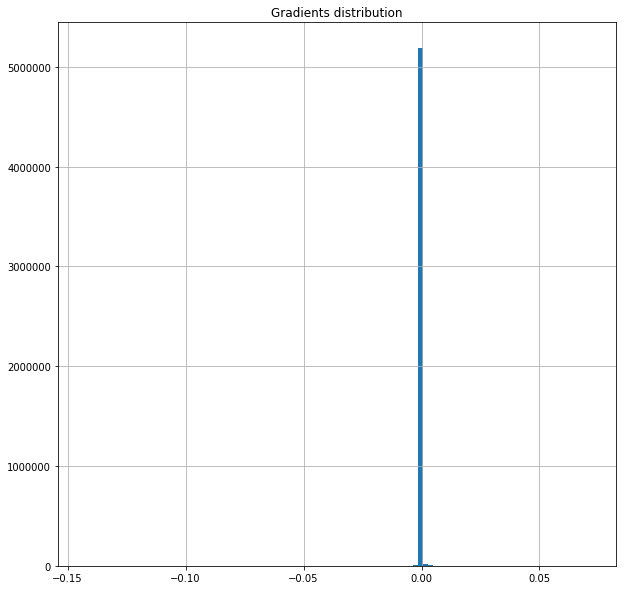

On iter 3091 with training PPL: 82.95503234863281, training ACC 0.2669270932674408
On iter 3092 with training PPL: 83.8525161743164, training ACC 0.2565104067325592
On iter 3093 with training PPL: 83.60633850097656, training ACC 0.2630208432674408
On iter 3094 with training PPL: 79.59635925292969, training ACC 0.2634548544883728
On iter 3095 with training PPL: 82.45591735839844, training ACC 0.2619357705116272
On iter 3096 with training PPL: 85.6281509399414, training ACC 0.259765625
On iter 3097 with training PPL: 79.65392303466797, training ACC 0.2578125
On iter 3098 with training PPL: 73.98974609375, training ACC 0.279296875
On iter 3099 with training PPL: 97.01658630371094, training ACC 0.2350260466337204
On iter 3100 with training PPL: 80.93672943115234, training ACC 0.2621527910232544
On iter 3101 with training PPL: 86.20732879638672, training ACC 0.2508680522441864
On iter 3102 with training PPL: 85.82698059082031, training ACC 0.2580295205116272
On iter 3103 with training PPL: 

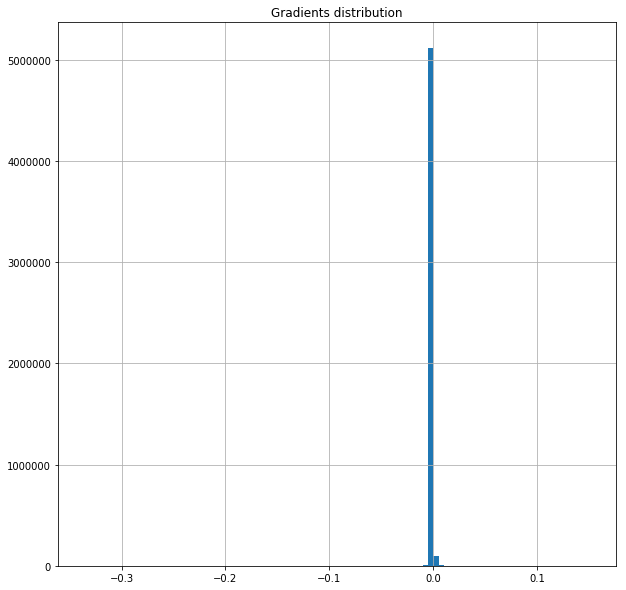

On iter 3121 with training PPL: 82.42647552490234, training ACC 0.2625868022441864
On iter 3122 with training PPL: 81.01863098144531, training ACC 0.2565104067325592
On iter 3123 with training PPL: 94.11734008789062, training ACC 0.2473958283662796
On iter 3124 with training PPL: 79.34818267822266, training ACC 0.2612847089767456
On iter 3125 with training PPL: 83.62228393554688, training ACC 0.2671440839767456
On iter 3126 with training PPL: 79.2822265625, training ACC 0.2658420205116272
On iter 3127 with training PPL: 77.43421173095703, training ACC 0.2727864682674408
On iter 3128 with training PPL: 89.485595703125, training ACC 0.2465277761220932
On iter 3129 with training PPL: 77.41763305664062, training ACC 0.2673611044883728
On iter 3130 with training PPL: 85.05177307128906, training ACC 0.2623697817325592
On iter 3131 with training PPL: 80.36467742919922, training ACC 0.2573784589767456
On iter 3132 with training PPL: 89.55035400390625, training ACC 0.2463107705116272
On iter 31

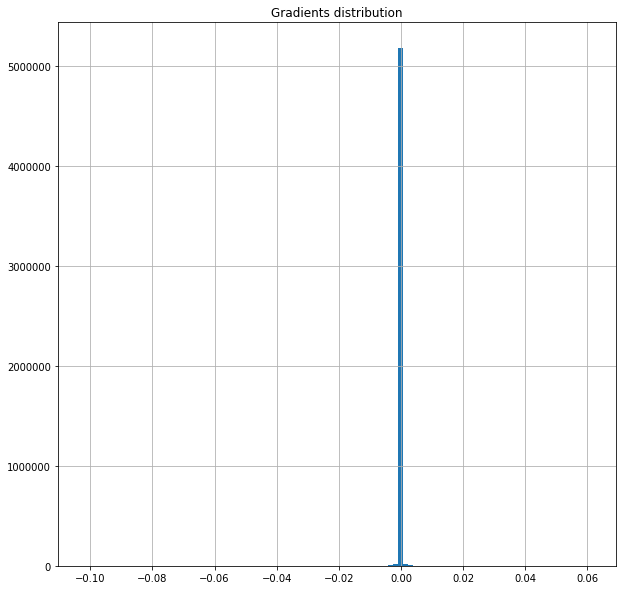

On iter 3151 with training PPL: 89.75439453125, training ACC 0.2476128488779068
On iter 3152 with training PPL: 85.16902160644531, training ACC 0.2541232705116272
On iter 3153 with training PPL: 84.6921615600586, training ACC 0.2677951455116272
On iter 3154 with training PPL: 84.820556640625, training ACC 0.2593315839767456
On iter 3155 with training PPL: 94.77277374267578, training ACC 0.2528211772441864
On iter 3156 with training PPL: 91.50247192382812, training ACC 0.2465277761220932
On iter 3157 with training PPL: 89.19245910644531, training ACC 0.2584635317325592
On iter 3158 with training PPL: 85.83963012695312, training ACC 0.265625
On iter 3159 with training PPL: 76.05416107177734, training ACC 0.2721354067325592
On iter 3160 with training PPL: 81.50184631347656, training ACC 0.2671440839767456
On iter 3161 with training PPL: 76.56828308105469, training ACC 0.267578125
On iter 3162 with training PPL: 77.46334838867188, training ACC 0.2634548544883728
On iter 3163 with training 

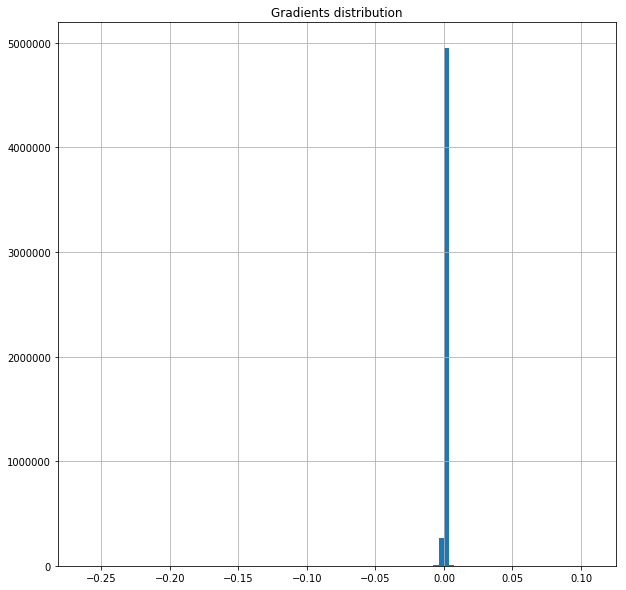

On iter 3181 with training PPL: 76.23126220703125, training ACC 0.2628038227558136
On iter 3182 with training PPL: 72.99917602539062, training ACC 0.2764756977558136
On iter 3183 with training PPL: 82.36326599121094, training ACC 0.2684461772441864
On iter 3184 with training PPL: 87.73236083984375, training ACC 0.2476128488779068
On iter 3185 with training PPL: 83.86003112792969, training ACC 0.2625868022441864
On iter 3186 with training PPL: 84.87788391113281, training ACC 0.2495659738779068
On iter 3187 with training PPL: 75.58895874023438, training ACC 0.2708333432674408
On iter 3188 with training PPL: 86.21949768066406, training ACC 0.2554253339767456
On iter 3189 with training PPL: 81.59385681152344, training ACC 0.2654079794883728
On iter 3190 with training PPL: 79.9044189453125, training ACC 0.2630208432674408
On iter 3191 with training PPL: 90.5450439453125, training ACC 0.2486979216337204
On iter 3192 with training PPL: 79.48360443115234, training ACC 0.2699652910232544
On ite

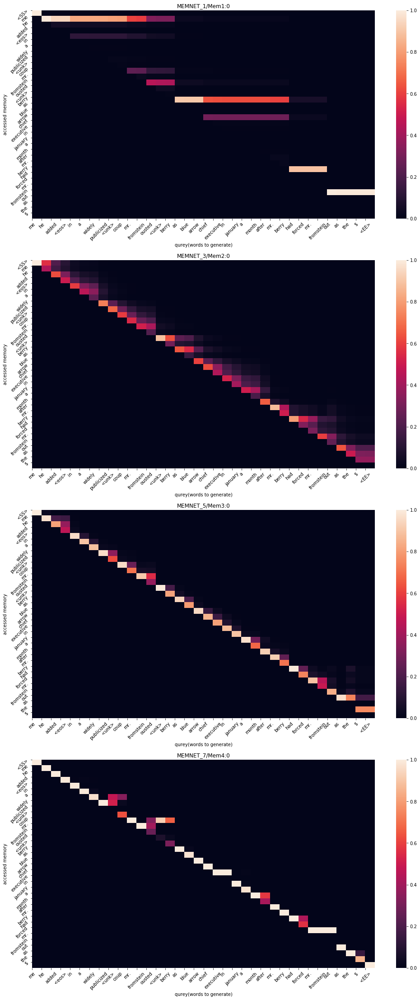

On iter 3201 with training PPL: 81.2138442993164, training ACC 0.2606336772441864
On iter 3202 with training PPL: 78.70051574707031, training ACC 0.2517361044883728
On iter 3203 with training PPL: 74.40162658691406, training ACC 0.2671440839767456
On iter 3204 with training PPL: 77.69043731689453, training ACC 0.2588975727558136
On iter 3205 with training PPL: 90.8097915649414, training ACC 0.244140625
On iter 3206 with training PPL: 71.78118896484375, training ACC 0.28125
On iter 3207 with training PPL: 75.76354217529297, training ACC 0.2721354067325592
On iter 3208 with training PPL: 73.58729553222656, training ACC 0.2712673544883728
On iter 3209 with training PPL: 86.09944915771484, training ACC 0.2534722089767456
On iter 3210 with training PPL: 84.68335723876953, training ACC 0.259765625
	 validation PPL 175.6485595703125, validation acc 0.2237413227558136
shape of gradients is (5228544,), L2 norm of gradients is 1.9401309490203857, details:                   0
count  5.228544e+06


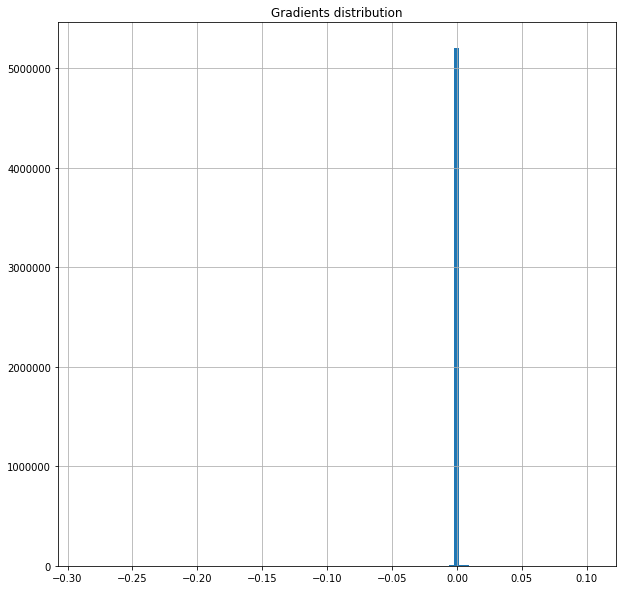

On iter 3211 with training PPL: 81.91261291503906, training ACC 0.2654079794883728
On iter 3212 with training PPL: 84.14551544189453, training ACC 0.2523871660232544
On iter 3213 with training PPL: 83.61726379394531, training ACC 0.2615017294883728
On iter 3214 with training PPL: 74.35984802246094, training ACC 0.2775607705116272
On iter 3215 with training PPL: 86.73981475830078, training ACC 0.2595486044883728
On iter 3216 with training PPL: 94.26160430908203, training ACC 0.2484809011220932
On iter 3217 with training PPL: 90.46050262451172, training ACC 0.2526041567325592
On iter 3218 with training PPL: 90.52471160888672, training ACC 0.2478298544883728
On iter 3219 with training PPL: 81.30504608154297, training ACC 0.2619357705116272
On iter 3220 with training PPL: 72.13636779785156, training ACC 0.2651909589767456
On iter 3221 with training PPL: 82.3167724609375, training ACC 0.2732204794883728
On iter 3222 with training PPL: 82.37924194335938, training ACC 0.2719184160232544
On it

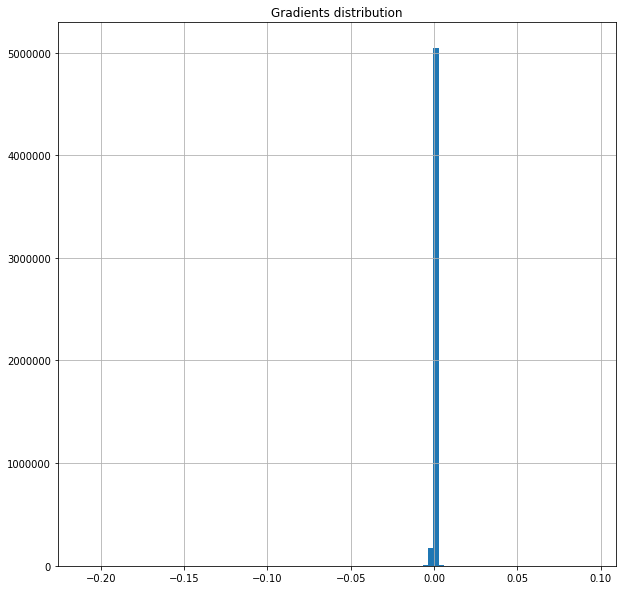

On iter 3241 with training PPL: 81.73345184326172, training ACC 0.2571614682674408
On iter 3242 with training PPL: 77.36626434326172, training ACC 0.2699652910232544
On iter 3243 with training PPL: 80.66313171386719, training ACC 0.2573784589767456
On iter 3244 with training PPL: 75.1085205078125, training ACC 0.2712673544883728
On iter 3245 with training PPL: 96.06263732910156, training ACC 0.2454427033662796
On iter 3246 with training PPL: 83.92230987548828, training ACC 0.2573784589767456
On iter 3247 with training PPL: 81.33967590332031, training ACC 0.2621527910232544
On iter 3248 with training PPL: 94.5496597290039, training ACC 0.2491319477558136
On iter 3249 with training PPL: 87.33233642578125, training ACC 0.2497829794883728
On iter 3250 with training PPL: 82.99970245361328, training ACC 0.2595486044883728
On iter 3251 with training PPL: 79.12081146240234, training ACC 0.2599826455116272
On iter 3252 with training PPL: 85.55574798583984, training ACC 0.2567274272441864
On ite

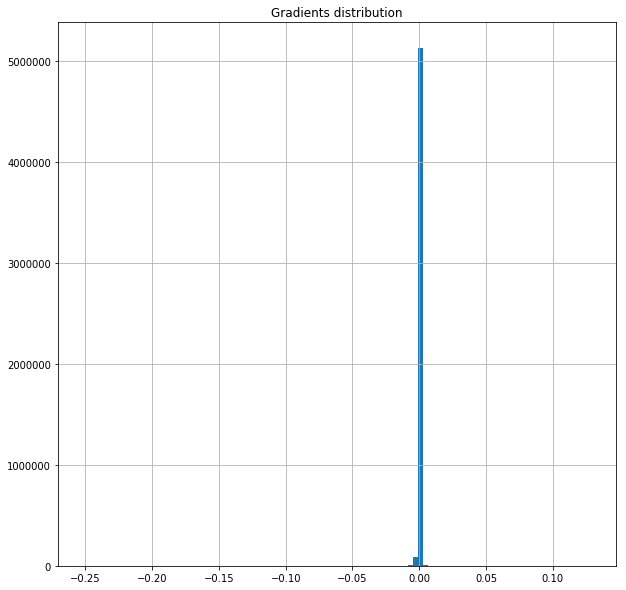

On iter 3271 with training PPL: 93.76968383789062, training ACC 0.2415364533662796
On iter 3272 with training PPL: 87.44851684570312, training ACC 0.2552083432674408
On iter 3273 with training PPL: 76.69296264648438, training ACC 0.2717013955116272
On iter 3274 with training PPL: 77.29631042480469, training ACC 0.2643229067325592
On iter 3275 with training PPL: 88.50811004638672, training ACC 0.255859375
On iter 3276 with training PPL: 85.74614715576172, training ACC 0.2536892294883728
On iter 3277 with training PPL: 77.9749526977539, training ACC 0.2680121660232544
On iter 3278 with training PPL: 90.5085220336914, training ACC 0.2549913227558136
On iter 3279 with training PPL: 79.54066467285156, training ACC 0.2717013955116272
On iter 3280 with training PPL: 92.15508270263672, training ACC 0.2484809011220932
On iter 3281 with training PPL: 82.50972747802734, training ACC 0.2588975727558136
On iter 3282 with training PPL: 73.0146713256836, training ACC 0.2628038227558136
On iter 3283 w

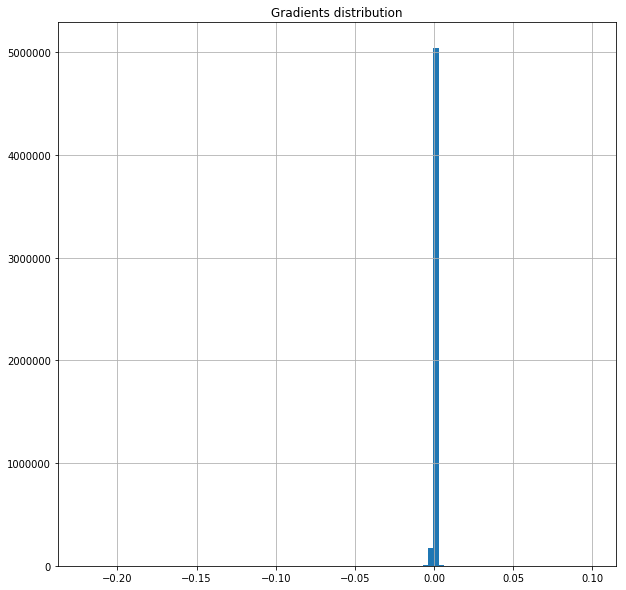

On iter 3301 with training PPL: 98.97013092041016, training ACC 0.2406684011220932
On iter 3302 with training PPL: 72.64208221435547, training ACC 0.2634548544883728
On iter 3303 with training PPL: 79.31735229492188, training ACC 0.2584635317325592
On iter 3304 with training PPL: 78.7960433959961, training ACC 0.2684461772441864
On iter 3305 with training PPL: 81.773681640625, training ACC 0.2634548544883728
On iter 3306 with training PPL: 76.06206512451172, training ACC 0.2645399272441864
On iter 3307 with training PPL: 97.05068969726562, training ACC 0.2463107705116272
On iter 3308 with training PPL: 80.2065658569336, training ACC 0.2671440839767456
On iter 3309 with training PPL: 75.38084411621094, training ACC 0.2690972089767456
On iter 3310 with training PPL: 83.1603012084961, training ACC 0.2595486044883728
On iter 3311 with training PPL: 84.99918365478516, training ACC 0.2588975727558136
On iter 3312 with training PPL: 75.48418426513672, training ACC 0.2686631977558136
On iter 3

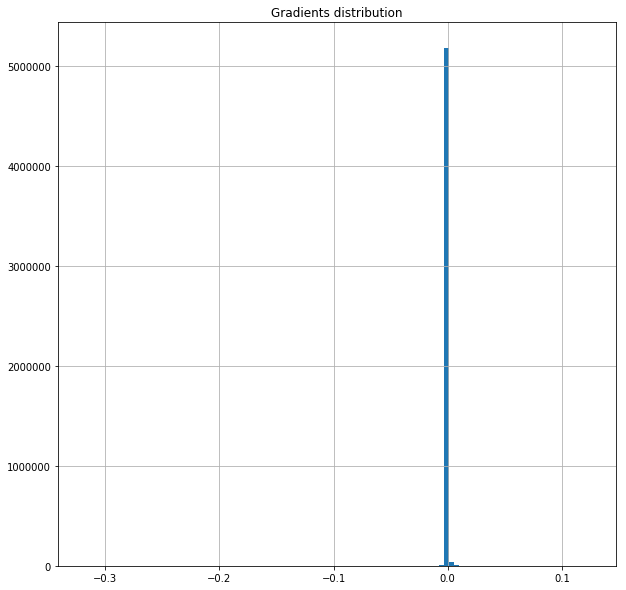

On iter 3331 with training PPL: 91.78223419189453, training ACC 0.2419704794883728
On iter 3332 with training PPL: 89.84611511230469, training ACC 0.255859375
On iter 3333 with training PPL: 83.44921112060547, training ACC 0.2606336772441864
On iter 3334 with training PPL: 82.67703247070312, training ACC 0.2536892294883728
On iter 3335 with training PPL: 84.34444427490234, training ACC 0.2504340410232544
On iter 3336 with training PPL: 82.59274291992188, training ACC 0.2591145932674408
On iter 3337 with training PPL: 84.46723175048828, training ACC 0.2491319477558136
On iter 3338 with training PPL: 81.73126983642578, training ACC 0.2580295205116272
On iter 3339 with training PPL: 87.01949310302734, training ACC 0.2604166567325592
On iter 3340 with training PPL: 86.13156127929688, training ACC 0.2465277761220932
On iter 3341 with training PPL: 84.96927642822266, training ACC 0.2625868022441864
On iter 3342 with training PPL: 92.78627014160156, training ACC 0.2560763955116272
On iter 334

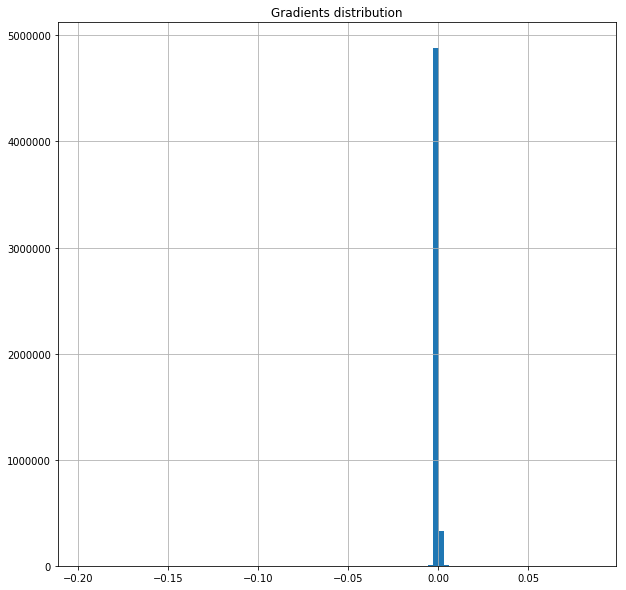

On iter 3361 with training PPL: 73.37503814697266, training ACC 0.2667100727558136
On iter 3362 with training PPL: 89.13553619384766, training ACC 0.2450086772441864
On iter 3363 with training PPL: 73.36222839355469, training ACC 0.2708333432674408
On iter 3364 with training PPL: 73.11961364746094, training ACC 0.2734375
On iter 3365 with training PPL: 86.16236877441406, training ACC 0.26171875
On iter 3366 with training PPL: 91.7974624633789, training ACC 0.2471788227558136
On iter 3367 with training PPL: 88.47831726074219, training ACC 0.2515190839767456
On iter 3368 with training PPL: 83.57249450683594, training ACC 0.2584635317325592
On iter 3369 with training PPL: 87.24642944335938, training ACC 0.2545572817325592
On iter 3370 with training PPL: 81.88543701171875, training ACC 0.26171875
On iter 3371 with training PPL: 88.13543701171875, training ACC 0.2534722089767456
On iter 3372 with training PPL: 83.4953842163086, training ACC 0.2575954794883728
On iter 3373 with training PPL:

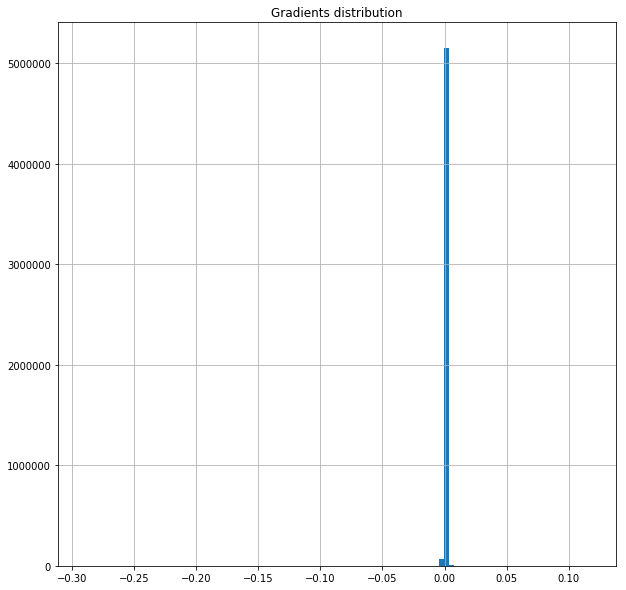

On iter 3391 with training PPL: 75.7128677368164, training ACC 0.2703993022441864
On iter 3392 with training PPL: 79.93952178955078, training ACC 0.2615017294883728
On iter 3393 with training PPL: 82.4341812133789, training ACC 0.2660590410232544
On iter 3394 with training PPL: 83.14722442626953, training ACC 0.2610677182674408
On iter 3395 with training PPL: 84.01917266845703, training ACC 0.248046875
On iter 3396 with training PPL: 83.43659973144531, training ACC 0.2634548544883728
On iter 3397 with training PPL: 75.05677795410156, training ACC 0.2651909589767456
On iter 3398 with training PPL: 83.97803497314453, training ACC 0.2541232705116272
On iter 3399 with training PPL: 84.73169708251953, training ACC 0.259765625
On iter 3400 with training PPL: 84.4369888305664, training ACC 0.2628038227558136
<SS> ozone layer and create a new state environmental officer armed with a $ N million budget to sue any firm or agency he thinks is being too <unk> <eos> the initiative is based largely 

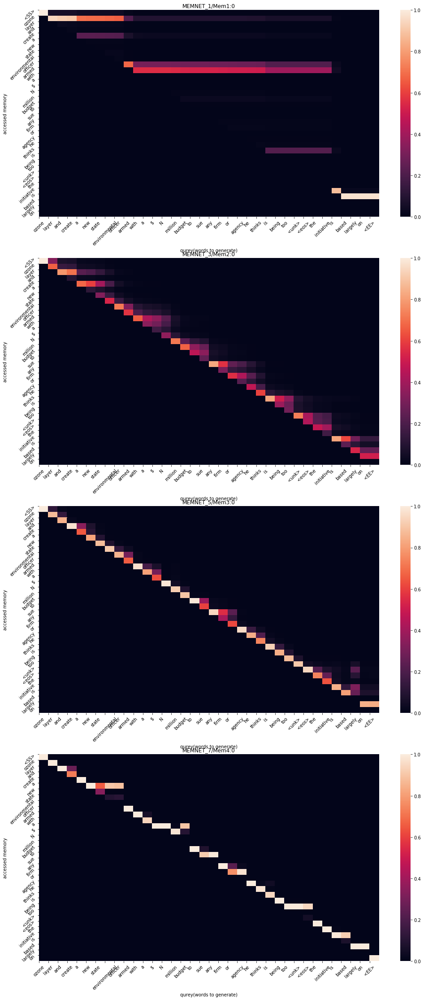

On iter 3401 with training PPL: 87.0057144165039, training ACC 0.259765625
On iter 3402 with training PPL: 83.898193359375, training ACC 0.2543402910232544
On iter 3403 with training PPL: 75.84628295898438, training ACC 0.2712673544883728
On iter 3404 with training PPL: 84.33643341064453, training ACC 0.2534722089767456
On iter 3405 with training PPL: 86.57292175292969, training ACC 0.2554253339767456
On iter 3406 with training PPL: 70.41004180908203, training ACC 0.2736545205116272
On iter 3407 with training PPL: 82.38631439208984, training ACC 0.2647569477558136
On iter 3408 with training PPL: 87.93540954589844, training ACC 0.2513020932674408
On iter 3409 with training PPL: 74.3382568359375, training ACC 0.2623697817325592
On iter 3410 with training PPL: 86.6905288696289, training ACC 0.255859375
On iter 3411 with training PPL: 74.4134750366211, training ACC 0.2667100727558136
On iter 3412 with training PPL: 93.9718246459961, training ACC 0.2384982705116272
On iter 3413 with trainin

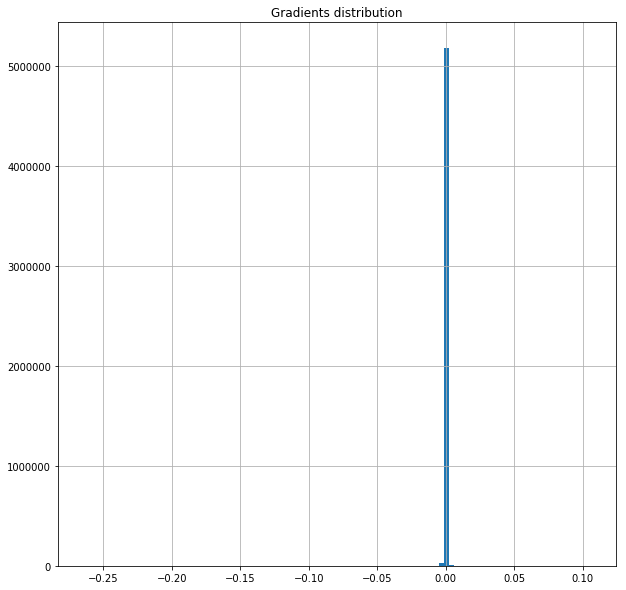

On iter 3421 with training PPL: 79.30555725097656, training ACC 0.2543402910232544
On iter 3422 with training PPL: 78.18045806884766, training ACC 0.2595486044883728
On iter 3423 with training PPL: 81.7759017944336, training ACC 0.2686631977558136
On iter 3424 with training PPL: 83.88626861572266, training ACC 0.2573784589767456
On iter 3425 with training PPL: 75.74363708496094, training ACC 0.2719184160232544
On iter 3426 with training PPL: 80.6418685913086, training ACC 0.255859375
On iter 3427 with training PPL: 74.25914764404297, training ACC 0.26171875
On iter 3428 with training PPL: 87.62983703613281, training ACC 0.2601996660232544
On iter 3429 with training PPL: 85.68692016601562, training ACC 0.2569444477558136
On iter 3430 with training PPL: 69.40399932861328, training ACC 0.2730034589767456
On iter 3431 with training PPL: 76.79388427734375, training ACC 0.2628038227558136
On iter 3432 with training PPL: 92.7989730834961, training ACC 0.2508680522441864
On iter 3433 with trai

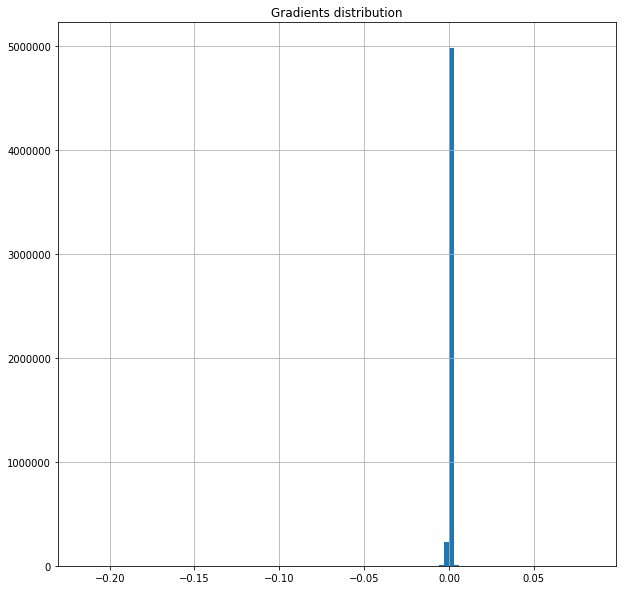

On iter 3451 with training PPL: 87.92723083496094, training ACC 0.2493489533662796
On iter 3452 with training PPL: 81.24986267089844, training ACC 0.2543402910232544
On iter 3453 with training PPL: 86.37957000732422, training ACC 0.2601996660232544
On iter 3454 with training PPL: 80.2309341430664, training ACC 0.2654079794883728
On iter 3455 with training PPL: 74.27338409423828, training ACC 0.2686631977558136
On iter 3456 with training PPL: 79.19275665283203, training ACC 0.2580295205116272
On iter 3457 with training PPL: 84.4027328491211, training ACC 0.2541232705116272
On iter 3458 with training PPL: 77.6649169921875, training ACC 0.2606336772441864
On iter 3459 with training PPL: 79.75234985351562, training ACC 0.2654079794883728
On iter 3460 with training PPL: 77.74880981445312, training ACC 0.2591145932674408
On iter 3461 with training PPL: 75.86031341552734, training ACC 0.2680121660232544
On iter 3462 with training PPL: 79.89764404296875, training ACC 0.2599826455116272
On iter

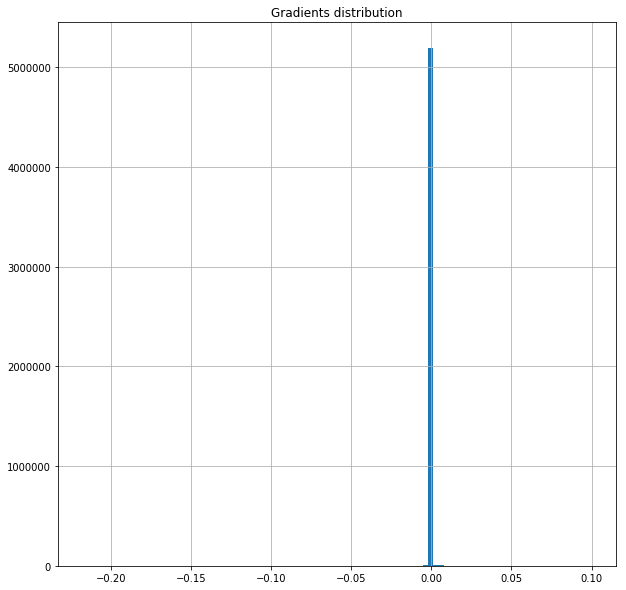

On iter 3481 with training PPL: 74.0031509399414, training ACC 0.2805989682674408
On iter 3482 with training PPL: 76.82238006591797, training ACC 0.2690972089767456
On iter 3483 with training PPL: 67.2493896484375, training ACC 0.2842881977558136
On iter 3484 with training PPL: 72.58329010009766, training ACC 0.27734375
On iter 3485 with training PPL: 78.0840072631836, training ACC 0.263671875
On iter 3486 with training PPL: 74.03008270263672, training ACC 0.2664930522441864
On iter 3487 with training PPL: 79.55553436279297, training ACC 0.2569444477558136
On iter 3488 with training PPL: 78.52167510986328, training ACC 0.2601996660232544
On iter 3489 with training PPL: 71.97923278808594, training ACC 0.2708333432674408
On iter 3490 with training PPL: 77.9439468383789, training ACC 0.2667100727558136
On iter 3491 with training PPL: 81.44264221191406, training ACC 0.2615017294883728
On iter 3492 with training PPL: 83.6051025390625, training ACC 0.2530381977558136
On iter 3493 with traini

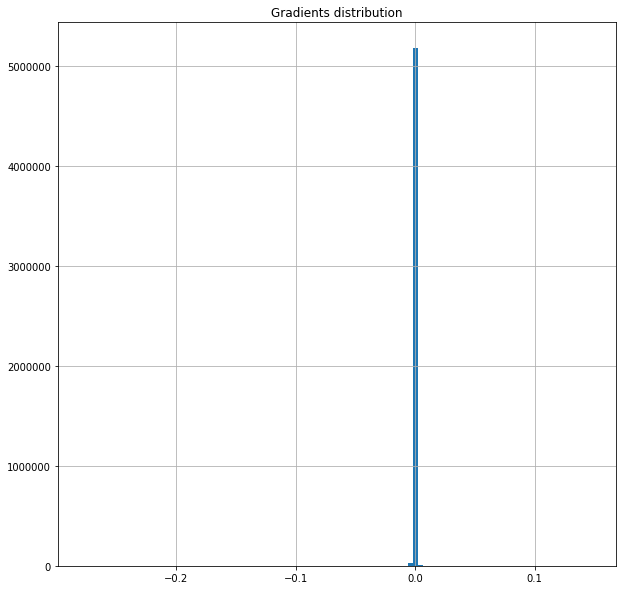

On iter 3511 with training PPL: 78.5049057006836, training ACC 0.2682291567325592
On iter 3512 with training PPL: 80.32992553710938, training ACC 0.2547743022441864
On iter 3513 with training PPL: 74.52096557617188, training ACC 0.2625868022441864
On iter 3514 with training PPL: 80.84237670898438, training ACC 0.2604166567325592
On iter 3515 with training PPL: 85.48613739013672, training ACC 0.2578125
On iter 3516 with training PPL: 82.67371368408203, training ACC 0.2651909589767456
On iter 3517 with training PPL: 82.10356140136719, training ACC 0.2632378339767456
On iter 3518 with training PPL: 82.36400604248047, training ACC 0.2610677182674408
On iter 3519 with training PPL: 73.12557220458984, training ACC 0.2719184160232544
On iter 3520 with training PPL: 81.36016082763672, training ACC 0.2649739682674408
On iter 3521 with training PPL: 79.68020629882812, training ACC 0.2541232705116272
On iter 3522 with training PPL: 76.95022583007812, training ACC 0.2630208432674408
On iter 3523 w

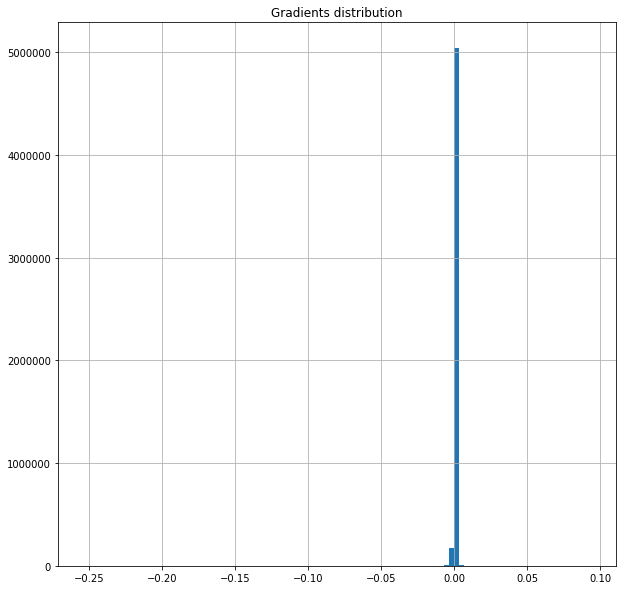

On iter 3541 with training PPL: 75.98745727539062, training ACC 0.2654079794883728
On iter 3542 with training PPL: 81.4905014038086, training ACC 0.2606336772441864
On iter 3543 with training PPL: 80.32311248779297, training ACC 0.2688802182674408
On iter 3544 with training PPL: 78.90376281738281, training ACC 0.2647569477558136
On iter 3545 with training PPL: 72.81510162353516, training ACC 0.275390625
On iter 3546 with training PPL: 72.08743286132812, training ACC 0.271484375
On iter 3547 with training PPL: 74.23836517333984, training ACC 0.2693142294883728
On iter 3548 with training PPL: 74.69564056396484, training ACC 0.2654079794883728
On iter 3549 with training PPL: 68.59387969970703, training ACC 0.2819010317325592
On iter 3550 with training PPL: 78.3478775024414, training ACC 0.2751736044883728
On iter 3551 with training PPL: 74.24115753173828, training ACC 0.2725694477558136
On iter 3552 with training PPL: 84.36652374267578, training ACC 0.2504340410232544
On iter 3553 with tr

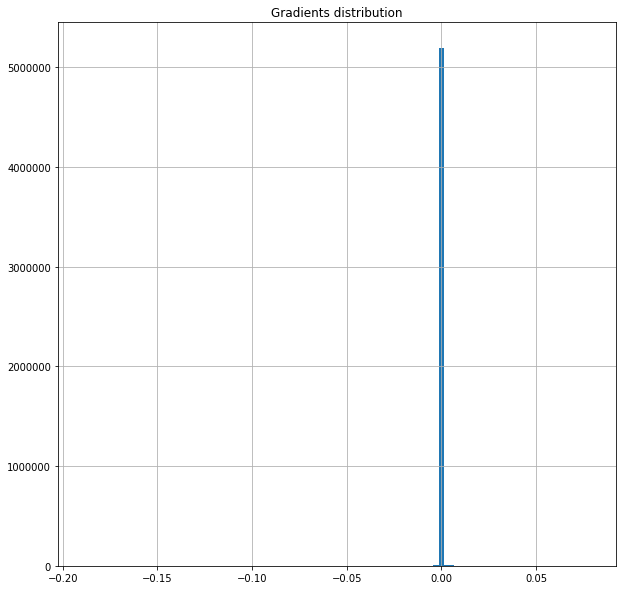

On iter 3571 with training PPL: 77.87079620361328, training ACC 0.2591145932674408
On iter 3572 with training PPL: 84.6305923461914, training ACC 0.2458767294883728
On iter 3573 with training PPL: 81.21968841552734, training ACC 0.2634548544883728
On iter 3574 with training PPL: 83.31414794921875, training ACC 0.2578125
On iter 3575 with training PPL: 73.81562805175781, training ACC 0.2760416567325592
On iter 3576 with training PPL: 73.33026123046875, training ACC 0.2690972089767456
On iter 3577 with training PPL: 76.16463470458984, training ACC 0.263671875
On iter 3578 with training PPL: 80.43828582763672, training ACC 0.2649739682674408
On iter 3579 with training PPL: 76.41184997558594, training ACC 0.2630208432674408
On iter 3580 with training PPL: 81.11573028564453, training ACC 0.2682291567325592
On iter 3581 with training PPL: 72.27963256835938, training ACC 0.2699652910232544
On iter 3582 with training PPL: 77.87354278564453, training ACC 0.2547743022441864
On iter 3583 with tra

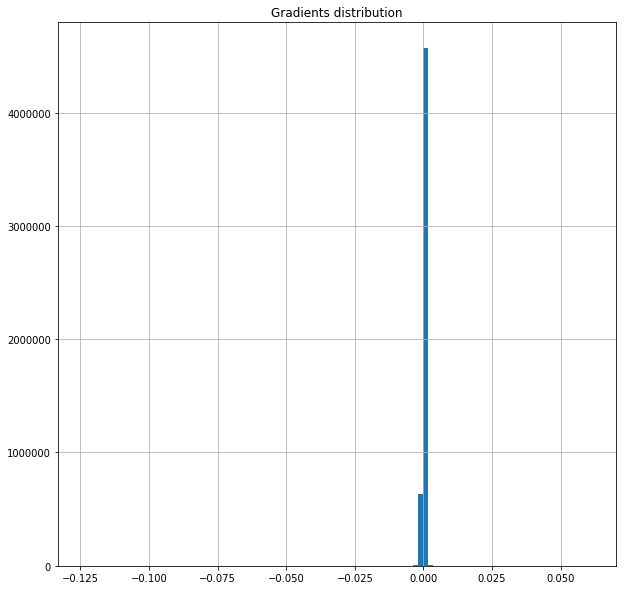

<SS> house <eos> mr. paul says that at one point he did indeed have eight or nine of the paintings at home and that the rest were in storage at sotheby 's <eos> he explains that <EE>


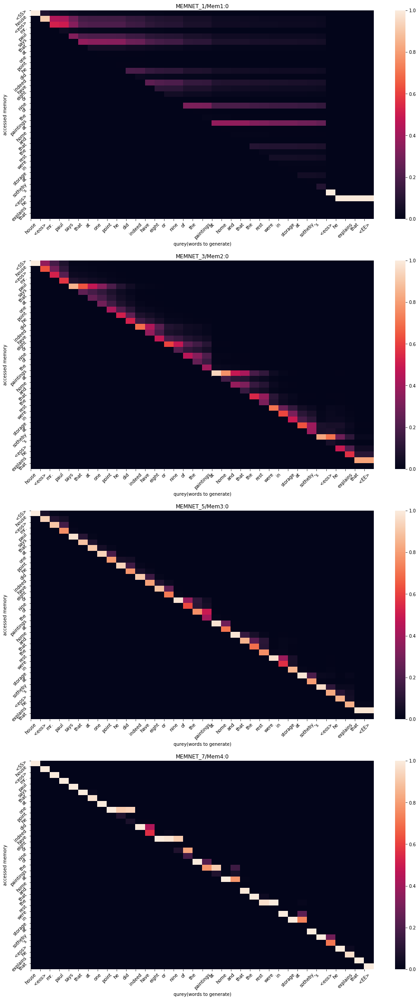

On iter 3601 with training PPL: 77.91146850585938, training ACC 0.2634548544883728
On iter 3602 with training PPL: 79.33131408691406, training ACC 0.26171875
On iter 3603 with training PPL: 86.0202865600586, training ACC 0.2515190839767456
On iter 3604 with training PPL: 71.84488677978516, training ACC 0.2710503339767456
On iter 3605 with training PPL: 80.79695129394531, training ACC 0.2645399272441864
On iter 3606 with training PPL: 87.37390899658203, training ACC 0.2573784589767456
On iter 3607 with training PPL: 86.79624938964844, training ACC 0.2517361044883728
On iter 3608 with training PPL: 78.5821304321289, training ACC 0.2703993022441864
On iter 3609 with training PPL: 77.65218353271484, training ACC 0.2671440839767456
On iter 3610 with training PPL: 65.62883758544922, training ACC 0.2836371660232544
On iter 3611 with training PPL: 79.61211395263672, training ACC 0.2628038227558136
On iter 3612 with training PPL: 72.32923889160156, training ACC 0.2654079794883728
On iter 3613 w

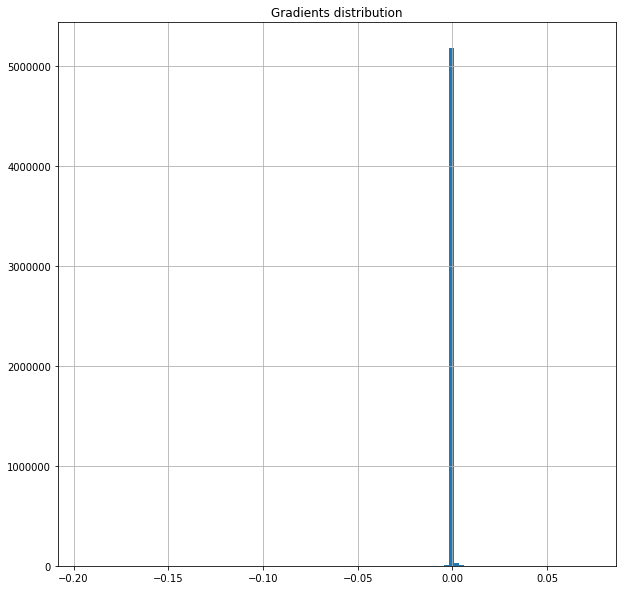

On iter 3631 with training PPL: 81.82841491699219, training ACC 0.2604166567325592
On iter 3632 with training PPL: 82.93122100830078, training ACC 0.26171875
On iter 3633 with training PPL: 76.16365051269531, training ACC 0.2686631977558136
On iter 3634 with training PPL: 75.17778015136719, training ACC 0.2758246660232544
On iter 3635 with training PPL: 82.01301574707031, training ACC 0.2641059160232544
On iter 3636 with training PPL: 72.90939331054688, training ACC 0.2756076455116272
On iter 3637 with training PPL: 83.74227142333984, training ACC 0.2601996660232544
On iter 3638 with training PPL: 71.34426879882812, training ACC 0.2708333432674408
On iter 3639 with training PPL: 74.71590423583984, training ACC 0.2530381977558136
On iter 3640 with training PPL: 82.82345581054688, training ACC 0.2591145932674408
On iter 3641 with training PPL: 87.86947631835938, training ACC 0.24609375
On iter 3642 with training PPL: 76.34345245361328, training ACC 0.2565104067325592
On iter 3643 with tr

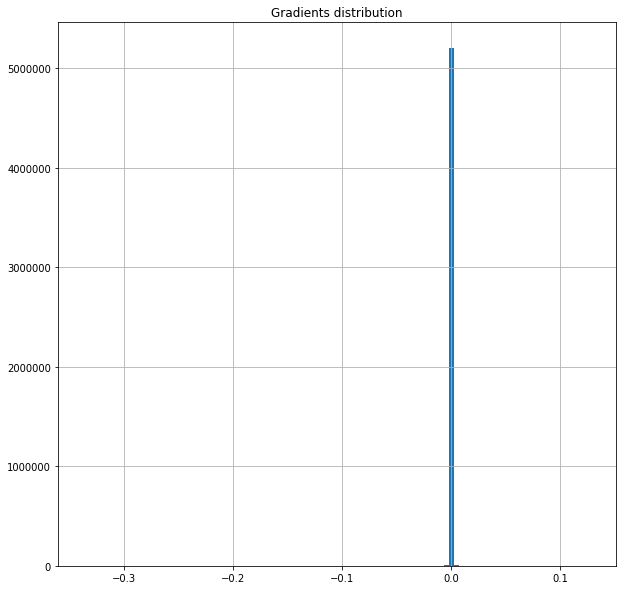

On iter 3661 with training PPL: 81.32354736328125, training ACC 0.255859375
On iter 3662 with training PPL: 74.82080078125, training ACC 0.2725694477558136
On iter 3663 with training PPL: 75.67533111572266, training ACC 0.2651909589767456
On iter 3664 with training PPL: 76.50995635986328, training ACC 0.2552083432674408
On iter 3665 with training PPL: 77.15582275390625, training ACC 0.2710503339767456
On iter 3666 with training PPL: 74.81819152832031, training ACC 0.267578125
On iter 3667 with training PPL: 85.37545776367188, training ACC 0.2471788227558136
On iter 3668 with training PPL: 78.67428588867188, training ACC 0.2582465410232544
On iter 3669 with training PPL: 79.47526550292969, training ACC 0.2580295205116272
On iter 3670 with training PPL: 70.20462799072266, training ACC 0.2745225727558136
On iter 3671 with training PPL: 83.25386810302734, training ACC 0.2556423544883728
On iter 3672 with training PPL: 76.4216079711914, training ACC 0.2634548544883728
On iter 3673 with trai

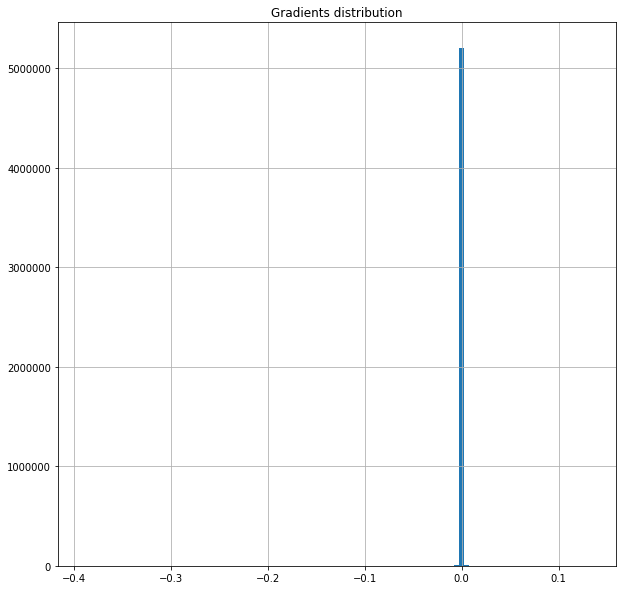

On iter 3691 with training PPL: 73.79373168945312, training ACC 0.2747395932674408
On iter 3692 with training PPL: 76.1347427368164, training ACC 0.2515190839767456
On iter 3693 with training PPL: 74.1058349609375, training ACC 0.271484375
On iter 3694 with training PPL: 82.95721435546875, training ACC 0.2556423544883728
On iter 3695 with training PPL: 72.23263549804688, training ACC 0.2756076455116272
On iter 3696 with training PPL: 70.25572967529297, training ACC 0.2719184160232544
On iter 3697 with training PPL: 84.51848602294922, training ACC 0.26171875
On iter 3698 with training PPL: 75.73074340820312, training ACC 0.2669270932674408
On iter 3699 with training PPL: 76.07483673095703, training ACC 0.2688802182674408
On iter 3700 with training PPL: 72.79923248291016, training ACC 0.2693142294883728
On iter 3701 with training PPL: 72.42253112792969, training ACC 0.275390625
On iter 3702 with training PPL: 79.29134368896484, training ACC 0.2660590410232544
On iter 3703 with training P

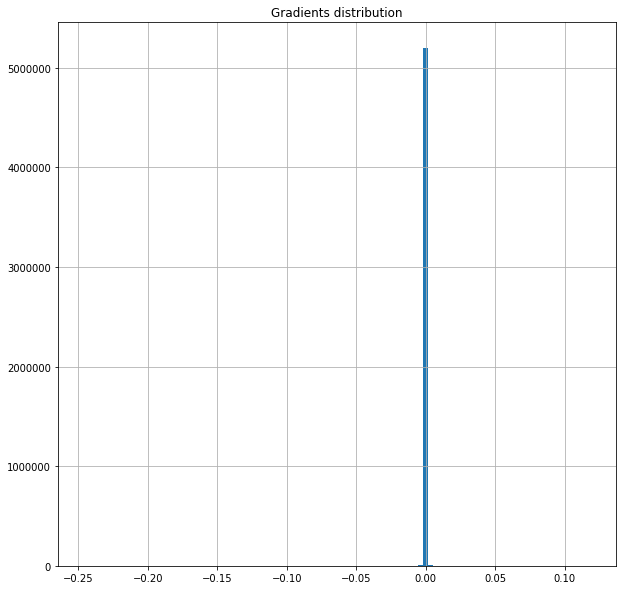

On iter 3721 with training PPL: 70.07242584228516, training ACC 0.271484375
On iter 3722 with training PPL: 83.42000579833984, training ACC 0.2552083432674408
On iter 3723 with training PPL: 77.9556884765625, training ACC 0.2606336772441864
On iter 3724 with training PPL: 87.10260009765625, training ACC 0.2547743022441864
On iter 3725 with training PPL: 71.76777648925781, training ACC 0.2725694477558136
On iter 3726 with training PPL: 74.2044906616211, training ACC 0.2766927182674408
On iter 3727 with training PPL: 70.09378051757812, training ACC 0.2758246660232544
On iter 3728 with training PPL: 72.83045196533203, training ACC 0.2706163227558136
On iter 3729 with training PPL: 71.5516128540039, training ACC 0.2786458432674408
On iter 3730 with training PPL: 73.95870208740234, training ACC 0.2725694477558136
On iter 3731 with training PPL: 78.59790802001953, training ACC 0.2660590410232544
On iter 3732 with training PPL: 67.60862731933594, training ACC 0.2719184160232544
On iter 3733 w

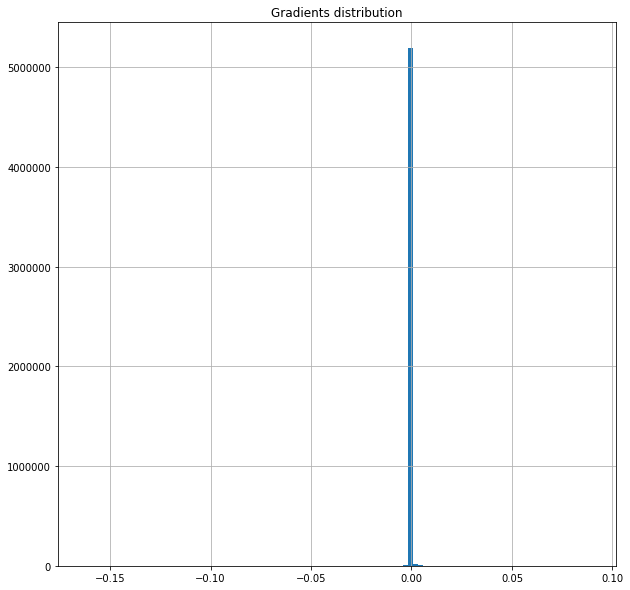

On iter 3751 with training PPL: 73.52374267578125, training ACC 0.2641059160232544
On iter 3752 with training PPL: 73.6302261352539, training ACC 0.2703993022441864
On iter 3753 with training PPL: 76.95488739013672, training ACC 0.2734375
On iter 3754 with training PPL: 69.77867126464844, training ACC 0.2816840410232544
On iter 3755 with training PPL: 76.31582641601562, training ACC 0.2671440839767456
On iter 3756 with training PPL: 74.36974334716797, training ACC 0.271484375
On iter 3757 with training PPL: 83.20587921142578, training ACC 0.2571614682674408
On iter 3758 with training PPL: 79.00940704345703, training ACC 0.2712673544883728
On iter 3759 with training PPL: 75.27599334716797, training ACC 0.2628038227558136
On iter 3760 with training PPL: 83.31442260742188, training ACC 0.2473958283662796
On iter 3761 with training PPL: 78.91651916503906, training ACC 0.2667100727558136
On iter 3762 with training PPL: 77.72137451171875, training ACC 0.2632378339767456
On iter 3763 with tra

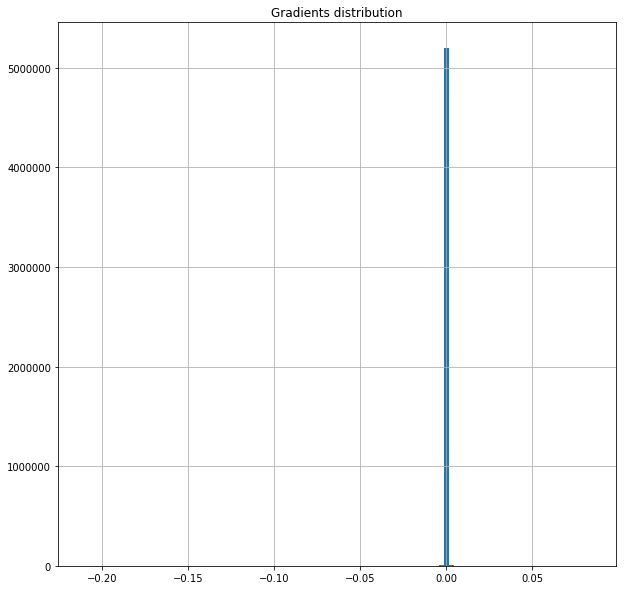

On iter 3781 with training PPL: 79.27859497070312, training ACC 0.2578125
On iter 3782 with training PPL: 81.06793975830078, training ACC 0.2573784589767456
On iter 3783 with training PPL: 72.7308120727539, training ACC 0.2786458432674408
On iter 3784 with training PPL: 70.24919891357422, training ACC 0.2725694477558136
On iter 3785 with training PPL: 78.46845245361328, training ACC 0.2669270932674408
On iter 3786 with training PPL: 80.91511535644531, training ACC 0.2556423544883728
On iter 3787 with training PPL: 77.15262603759766, training ACC 0.2708333432674408
On iter 3788 with training PPL: 74.44637298583984, training ACC 0.2649739682674408
On iter 3789 with training PPL: 73.14447021484375, training ACC 0.2677951455116272
On iter 3790 with training PPL: 80.74391174316406, training ACC 0.2508680522441864
On iter 3791 with training PPL: 77.94097137451172, training ACC 0.2623697817325592
On iter 3792 with training PPL: 74.79115295410156, training ACC 0.2634548544883728
On iter 3793 w

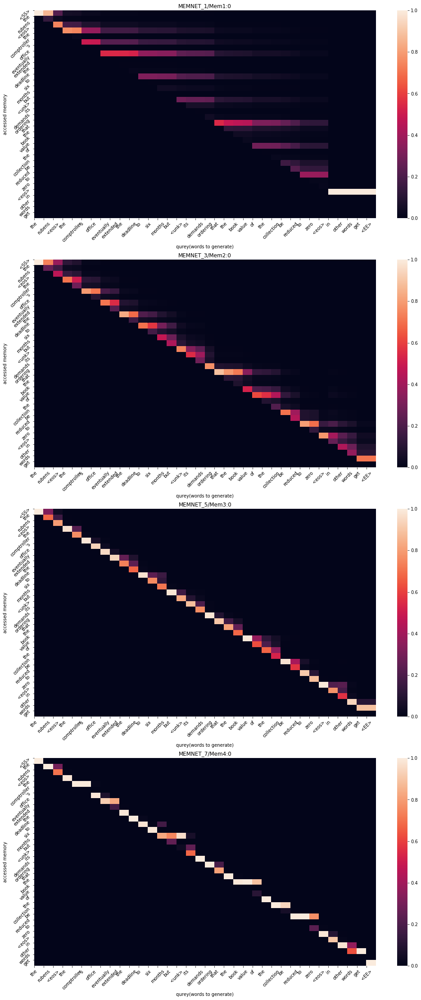

On iter 3801 with training PPL: 78.36102294921875, training ACC 0.2688802182674408
On iter 3802 with training PPL: 75.8802490234375, training ACC 0.2591145932674408
On iter 3803 with training PPL: 74.63607788085938, training ACC 0.2658420205116272
On iter 3804 with training PPL: 79.61766052246094, training ACC 0.2612847089767456
On iter 3805 with training PPL: 69.60726165771484, training ACC 0.2727864682674408
On iter 3806 with training PPL: 77.52623748779297, training ACC 0.2489149272441864
On iter 3807 with training PPL: 72.17971801757812, training ACC 0.2701822817325592
On iter 3808 with training PPL: 70.7554931640625, training ACC 0.2730034589767456
On iter 3809 with training PPL: 68.71150207519531, training ACC 0.275390625
On iter 3810 with training PPL: 69.52294158935547, training ACC 0.2823350727558136
	 validation PPL 165.48948669433594, validation acc 0.2261284738779068
shape of gradients is (5228544,), L2 norm of gradients is 2.041958808898926, details:                   0
co

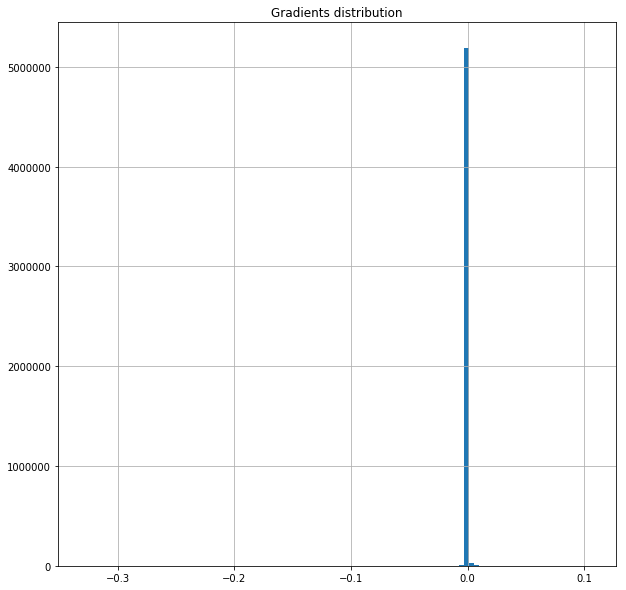

On iter 3811 with training PPL: 82.05323028564453, training ACC 0.2530381977558136
On iter 3812 with training PPL: 78.4757080078125, training ACC 0.26171875
On iter 3813 with training PPL: 80.47257995605469, training ACC 0.265625
On iter 3814 with training PPL: 71.0193099975586, training ACC 0.2697482705116272
On iter 3815 with training PPL: 75.38616180419922, training ACC 0.2727864682674408
On iter 3816 with training PPL: 69.92886352539062, training ACC 0.275390625
On iter 3817 with training PPL: 68.2164535522461, training ACC 0.2788628339767456
On iter 3818 with training PPL: 78.55571746826172, training ACC 0.2604166567325592
On iter 3819 with training PPL: 72.83090209960938, training ACC 0.2651909589767456
On iter 3820 with training PPL: 72.14159393310547, training ACC 0.271484375
On iter 3821 with training PPL: 69.8115234375, training ACC 0.2790798544883728
On iter 3822 with training PPL: 85.02493286132812, training ACC 0.2510850727558136
On iter 3823 with training PPL: 70.04442596

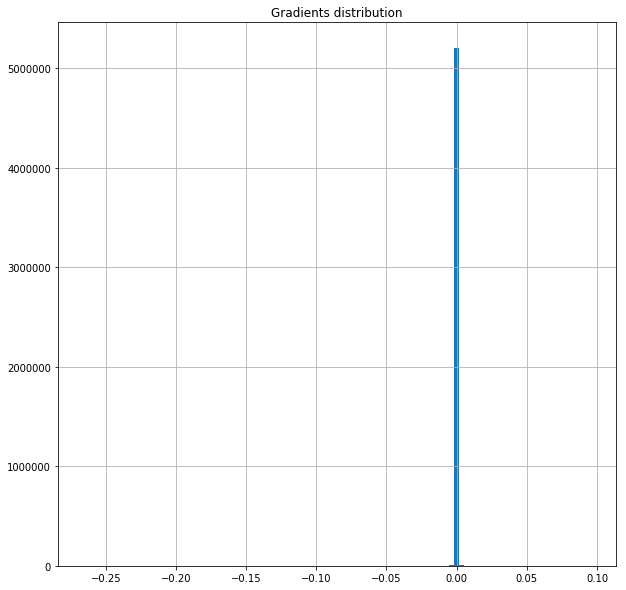

On iter 3841 with training PPL: 67.5081558227539, training ACC 0.2797309160232544
On iter 3842 with training PPL: 79.1805191040039, training ACC 0.2634548544883728
On iter 3843 with training PPL: 83.24671936035156, training ACC 0.2547743022441864
On iter 3844 with training PPL: 70.5814437866211, training ACC 0.2671440839767456
On iter 3845 with training PPL: 75.30648040771484, training ACC 0.2673611044883728
On iter 3846 with training PPL: 80.96289825439453, training ACC 0.2643229067325592
On iter 3847 with training PPL: 82.30684661865234, training ACC 0.2521701455116272
On iter 3848 with training PPL: 77.08878326416016, training ACC 0.2575954794883728
On iter 3849 with training PPL: 67.63693237304688, training ACC 0.2803819477558136
On iter 3850 with training PPL: 77.25128173828125, training ACC 0.2673611044883728
On iter 3851 with training PPL: 78.83602905273438, training ACC 0.2606336772441864
On iter 3852 with training PPL: 70.09528350830078, training ACC 0.2703993022441864
On iter

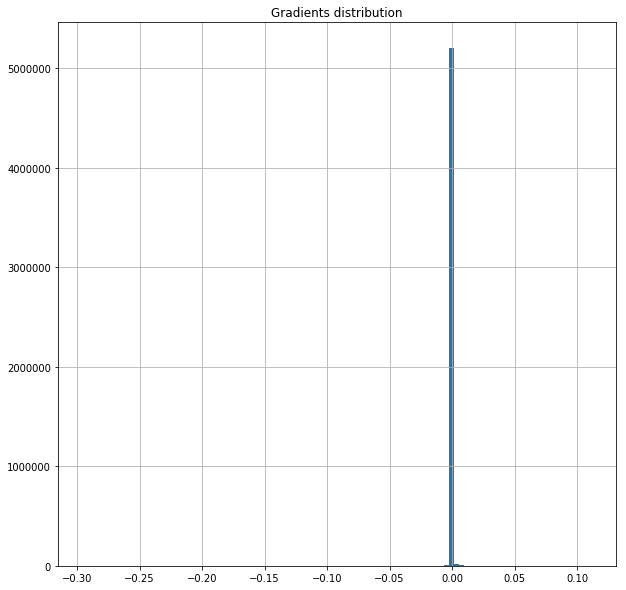

On iter 3871 with training PPL: 80.09542846679688, training ACC 0.2580295205116272
On iter 3872 with training PPL: 72.1316146850586, training ACC 0.2719184160232544
On iter 3873 with training PPL: 69.54721069335938, training ACC 0.2814670205116272
On iter 3874 with training PPL: 72.85980224609375, training ACC 0.2740885317325592
On iter 3875 with training PPL: 81.71338653564453, training ACC 0.2649739682674408
On iter 3876 with training PPL: 67.18016052246094, training ACC 0.2688802182674408
On iter 3877 with training PPL: 78.51512145996094, training ACC 0.2575954794883728
On iter 3878 with training PPL: 79.00462341308594, training ACC 0.26953125
On iter 3879 with training PPL: 76.8224868774414, training ACC 0.2643229067325592
On iter 3880 with training PPL: 76.80464935302734, training ACC 0.2697482705116272
On iter 3881 with training PPL: 79.15096282958984, training ACC 0.2565104067325592
On iter 3882 with training PPL: 76.404052734375, training ACC 0.2630208432674408
On iter 3883 wit

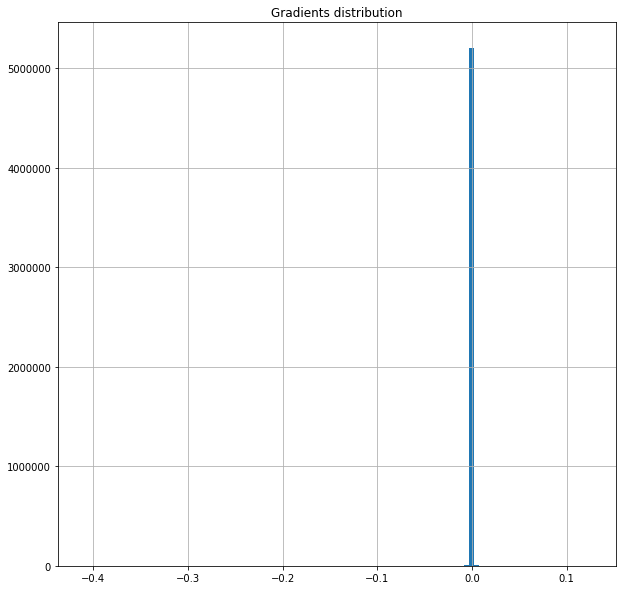

On iter 3901 with training PPL: 70.5762939453125, training ACC 0.2738715410232544
On iter 3902 with training PPL: 73.90409851074219, training ACC 0.2723524272441864
On iter 3903 with training PPL: 69.52894592285156, training ACC 0.2845052182674408
On iter 3904 with training PPL: 82.1484375, training ACC 0.255859375
On iter 3905 with training PPL: 73.15657806396484, training ACC 0.2708333432674408
On iter 3906 with training PPL: 64.43620300292969, training ACC 0.2881944477558136
On iter 3907 with training PPL: 79.51972961425781, training ACC 0.259765625
On iter 3908 with training PPL: 72.52239990234375, training ACC 0.275390625
On iter 3909 with training PPL: 74.91929626464844, training ACC 0.2697482705116272
On iter 3910 with training PPL: 77.95211791992188, training ACC 0.2664930522441864
On iter 3911 with training PPL: 74.86676788330078, training ACC 0.2565104067325592
On iter 3912 with training PPL: 80.20301055908203, training ACC 0.2593315839767456
On iter 3913 with training PPL: 7

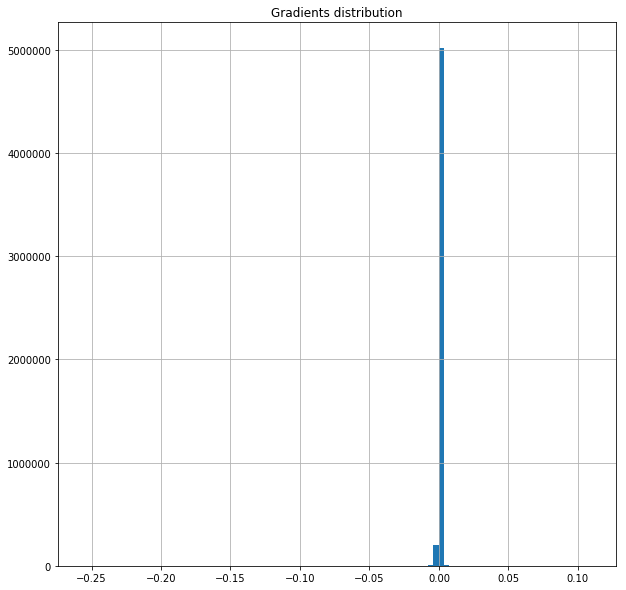

On iter 3931 with training PPL: 67.77540588378906, training ACC 0.2790798544883728
On iter 3932 with training PPL: 77.95524597167969, training ACC 0.2604166567325592
On iter 3933 with training PPL: 68.6270523071289, training ACC 0.2745225727558136
On iter 3934 with training PPL: 72.5019302368164, training ACC 0.2760416567325592
On iter 3935 with training PPL: 74.72467803955078, training ACC 0.2510850727558136
On iter 3936 with training PPL: 78.14546966552734, training ACC 0.2673611044883728
On iter 3937 with training PPL: 75.87369537353516, training ACC 0.2575954794883728
On iter 3938 with training PPL: 77.3529052734375, training ACC 0.2766927182674408
On iter 3939 with training PPL: 77.53526306152344, training ACC 0.2588975727558136
On iter 3940 with training PPL: 79.66990661621094, training ACC 0.2541232705116272
On iter 3941 with training PPL: 81.64891815185547, training ACC 0.2532552182674408
On iter 3942 with training PPL: 78.36151123046875, training ACC 0.2645399272441864
On iter

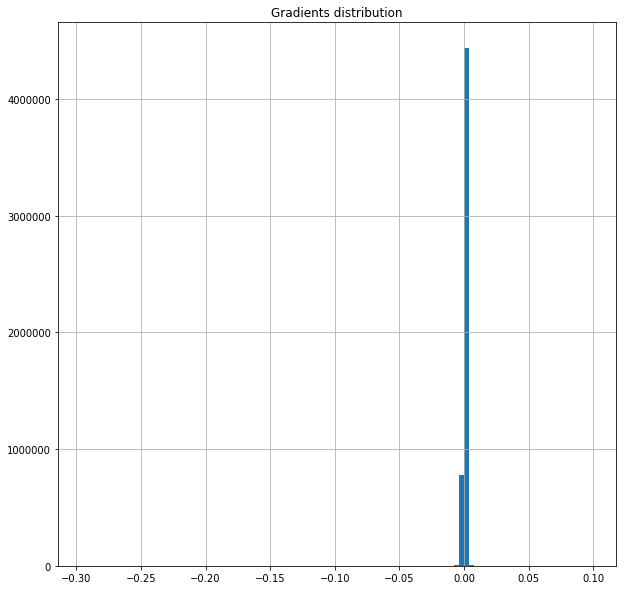

On iter 3961 with training PPL: 73.20526123046875, training ACC 0.2699652910232544
On iter 3962 with training PPL: 75.6173324584961, training ACC 0.2677951455116272
On iter 3963 with training PPL: 83.33635711669922, training ACC 0.2517361044883728
On iter 3964 with training PPL: 76.10041046142578, training ACC 0.2578125
On iter 3965 with training PPL: 76.26421356201172, training ACC 0.2699652910232544
On iter 3966 with training PPL: 74.12018585205078, training ACC 0.2690972089767456
On iter 3967 with training PPL: 83.06629943847656, training ACC 0.2601996660232544
On iter 3968 with training PPL: 71.71844482421875, training ACC 0.2727864682674408
On iter 3969 with training PPL: 75.8618392944336, training ACC 0.2584635317325592
On iter 3970 with training PPL: 83.18668365478516, training ACC 0.2491319477558136
On iter 3971 with training PPL: 81.10490417480469, training ACC 0.2562934160232544
On iter 3972 with training PPL: 74.78915405273438, training ACC 0.2658420205116272
On iter 3973 wi

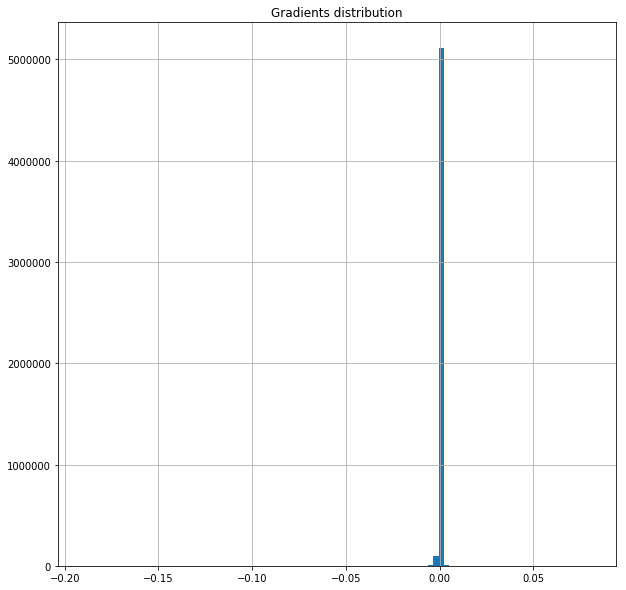

On iter 3991 with training PPL: 78.22994995117188, training ACC 0.2571614682674408
On iter 3992 with training PPL: 86.71405029296875, training ACC 0.251953125
On iter 3993 with training PPL: 79.43189239501953, training ACC 0.2660590410232544
On iter 3994 with training PPL: 71.09012603759766, training ACC 0.2710503339767456
On iter 3995 with training PPL: 75.90181732177734, training ACC 0.2625868022441864
On iter 3996 with training PPL: 83.34943389892578, training ACC 0.2580295205116272
On iter 3997 with training PPL: 69.8499526977539, training ACC 0.2658420205116272
On iter 3998 with training PPL: 81.43125915527344, training ACC 0.2612847089767456
On iter 3999 with training PPL: 80.62175750732422, training ACC 0.2510850727558136
On iter 4000 with training PPL: 77.16907501220703, training ACC 0.2682291567325592
<SS> should n't try to be traders who buy and sell in an effort to ride the latest economic trend or catch the next hot stock <eos> the case for owning stocks over the long-term 

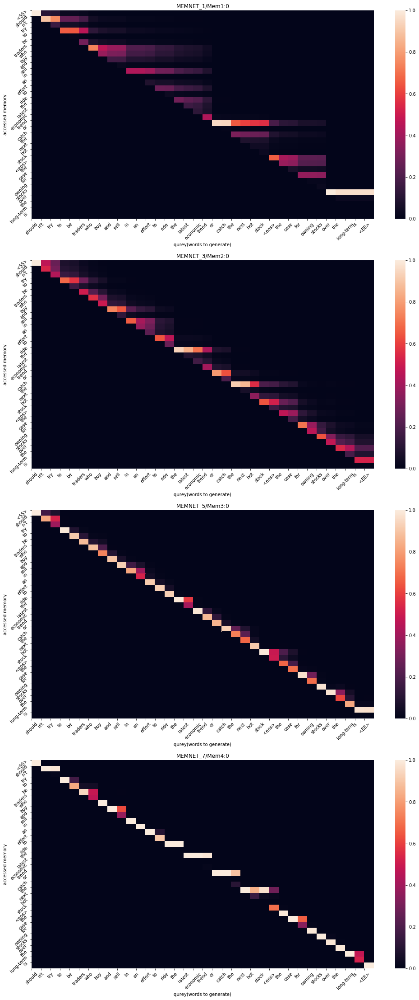

On iter 4001 with training PPL: 76.04802703857422, training ACC 0.2582465410232544
On iter 4002 with training PPL: 71.8918685913086, training ACC 0.2641059160232544
On iter 4003 with training PPL: 77.42675018310547, training ACC 0.2588975727558136
On iter 4004 with training PPL: 66.57340240478516, training ACC 0.2779947817325592
On iter 4005 with training PPL: 81.4483871459961, training ACC 0.2591145932674408
On iter 4006 with training PPL: 73.16676330566406, training ACC 0.267578125
On iter 4007 with training PPL: 69.29927062988281, training ACC 0.2829861044883728
On iter 4008 with training PPL: 73.17276000976562, training ACC 0.2719184160232544
On iter 4009 with training PPL: 68.1902084350586, training ACC 0.271484375
On iter 4010 with training PPL: 72.67115020751953, training ACC 0.26953125
On iter 4011 with training PPL: 73.64195251464844, training ACC 0.2634548544883728
On iter 4012 with training PPL: 75.14896392822266, training ACC 0.2660590410232544
On iter 4013 with training PP

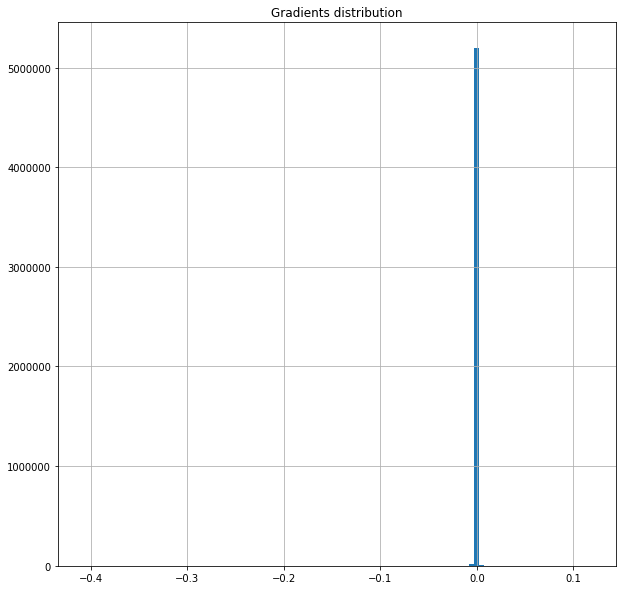

On iter 4021 with training PPL: 76.13750457763672, training ACC 0.2606336772441864
On iter 4022 with training PPL: 76.10139465332031, training ACC 0.2593315839767456
On iter 4023 with training PPL: 71.02879333496094, training ACC 0.2682291567325592
On iter 4024 with training PPL: 71.31944274902344, training ACC 0.2719184160232544
On iter 4025 with training PPL: 72.66751098632812, training ACC 0.2677951455116272
On iter 4026 with training PPL: 70.77337646484375, training ACC 0.2673611044883728
On iter 4027 with training PPL: 77.08639526367188, training ACC 0.2623697817325592
On iter 4028 with training PPL: 70.21195983886719, training ACC 0.2736545205116272
On iter 4029 with training PPL: 75.65192413330078, training ACC 0.2615017294883728
On iter 4030 with training PPL: 74.8142318725586, training ACC 0.2693142294883728
On iter 4031 with training PPL: 71.7360610961914, training ACC 0.2649739682674408
On iter 4032 with training PPL: 69.71634674072266, training ACC 0.2736545205116272
On ite

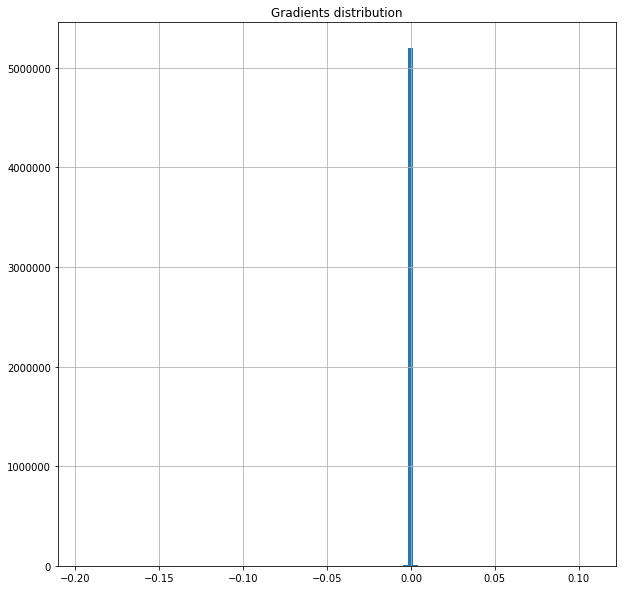

On iter 4051 with training PPL: 75.4055404663086, training ACC 0.2643229067325592
On iter 4052 with training PPL: 66.10173797607422, training ACC 0.2790798544883728
On iter 4053 with training PPL: 74.24144744873047, training ACC 0.2649739682674408
On iter 4054 with training PPL: 66.55143737792969, training ACC 0.28125
On iter 4055 with training PPL: 72.52568054199219, training ACC 0.2697482705116272
On iter 4056 with training PPL: 72.74586486816406, training ACC 0.2667100727558136
On iter 4057 with training PPL: 75.49699401855469, training ACC 0.267578125
On iter 4058 with training PPL: 72.12397766113281, training ACC 0.2673611044883728
On iter 4059 with training PPL: 65.99934387207031, training ACC 0.287109375
On iter 4060 with training PPL: 78.61743927001953, training ACC 0.2567274272441864
On iter 4061 with training PPL: 71.01667022705078, training ACC 0.2671440839767456
On iter 4062 with training PPL: 69.32683563232422, training ACC 0.2756076455116272
On iter 4063 with training PPL

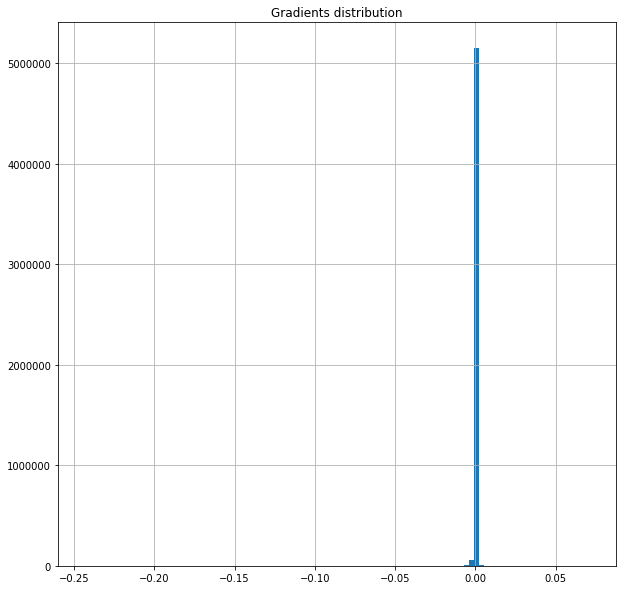

On iter 4081 with training PPL: 78.19145965576172, training ACC 0.2604166567325592
On iter 4082 with training PPL: 73.16355895996094, training ACC 0.2649739682674408
On iter 4083 with training PPL: 73.71369171142578, training ACC 0.2693142294883728
On iter 4084 with training PPL: 78.12635040283203, training ACC 0.26171875
On iter 4085 with training PPL: 65.02946472167969, training ACC 0.2801649272441864
On iter 4086 with training PPL: 74.97904968261719, training ACC 0.2684461772441864
On iter 4087 with training PPL: 73.16292572021484, training ACC 0.2727864682674408
On iter 4088 with training PPL: 77.71226501464844, training ACC 0.2595486044883728
On iter 4089 with training PPL: 64.54370880126953, training ACC 0.2860243022441864
On iter 4090 with training PPL: 73.03288269042969, training ACC 0.2669270932674408
On iter 4091 with training PPL: 74.31631469726562, training ACC 0.2660590410232544
On iter 4092 with training PPL: 75.2800064086914, training ACC 0.2621527910232544
On iter 4093 

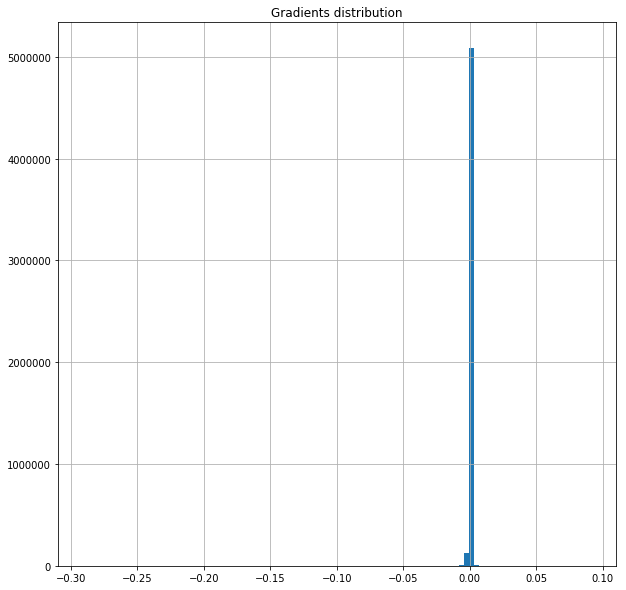

On iter 4111 with training PPL: 74.50028991699219, training ACC 0.2580295205116272
On iter 4112 with training PPL: 75.41719055175781, training ACC 0.267578125
On iter 4113 with training PPL: 62.56414031982422, training ACC 0.2842881977558136
On iter 4114 with training PPL: 70.41124725341797, training ACC 0.2712673544883728
On iter 4115 with training PPL: 69.03620147705078, training ACC 0.2730034589767456
On iter 4116 with training PPL: 73.44021606445312, training ACC 0.2673611044883728
On iter 4117 with training PPL: 67.73847961425781, training ACC 0.2760416567325592
On iter 4118 with training PPL: 69.38682556152344, training ACC 0.2703993022441864
On iter 4119 with training PPL: 75.52140808105469, training ACC 0.2654079794883728
On iter 4120 with training PPL: 67.46538543701172, training ACC 0.279296875
On iter 4121 with training PPL: 80.02877044677734, training ACC 0.2571614682674408
On iter 4122 with training PPL: 79.72786712646484, training ACC 0.2493489533662796
On iter 4123 with 

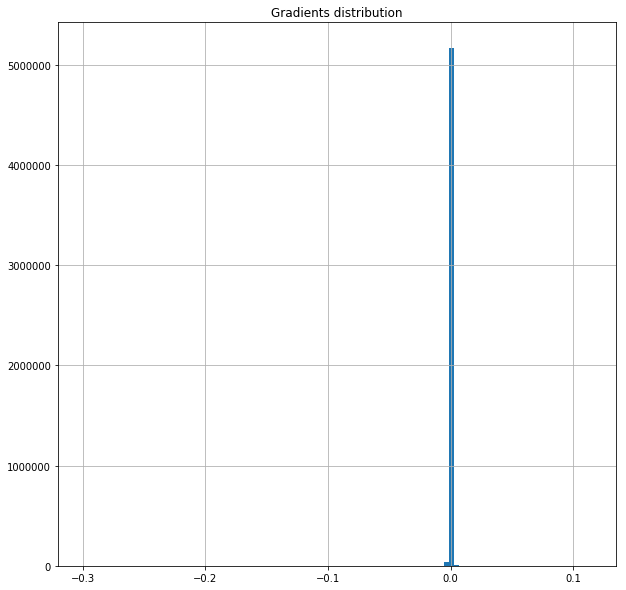

On iter 4141 with training PPL: 70.56371307373047, training ACC 0.2775607705116272
On iter 4142 with training PPL: 81.08502960205078, training ACC 0.2552083432674408
On iter 4143 with training PPL: 69.50358581542969, training ACC 0.2732204794883728
On iter 4144 with training PPL: 71.49295806884766, training ACC 0.2732204794883728
On iter 4145 with training PPL: 72.45855712890625, training ACC 0.2591145932674408
On iter 4146 with training PPL: 72.17001342773438, training ACC 0.2625868022441864
On iter 4147 with training PPL: 75.9815902709961, training ACC 0.2571614682674408
On iter 4148 with training PPL: 79.64913940429688, training ACC 0.2521701455116272
On iter 4149 with training PPL: 77.7605209350586, training ACC 0.2651909589767456
On iter 4150 with training PPL: 71.76073455810547, training ACC 0.2693142294883728
On iter 4151 with training PPL: 72.66283416748047, training ACC 0.2664930522441864
On iter 4152 with training PPL: 67.10111236572266, training ACC 0.28515625
On iter 4153 w

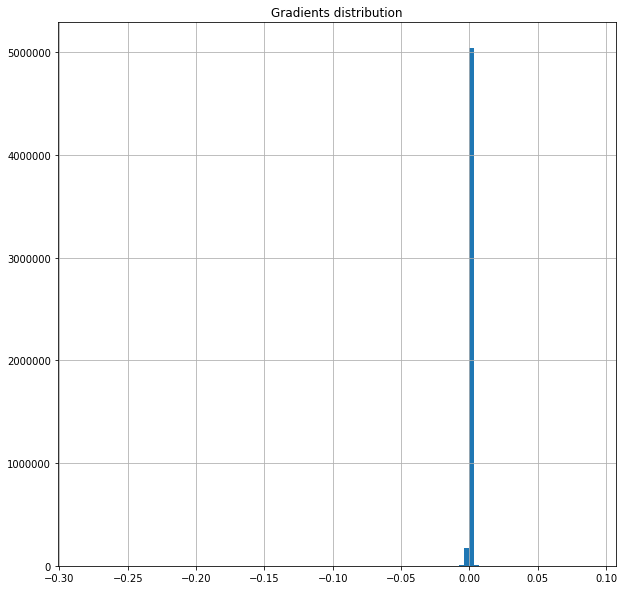

On iter 4171 with training PPL: 74.04670715332031, training ACC 0.2549913227558136
On iter 4172 with training PPL: 72.04365539550781, training ACC 0.2630208432674408
On iter 4173 with training PPL: 70.25727844238281, training ACC 0.2766927182674408
On iter 4174 with training PPL: 76.01895141601562, training ACC 0.2580295205116272
On iter 4175 with training PPL: 71.81231689453125, training ACC 0.27734375
On iter 4176 with training PPL: 77.6614761352539, training ACC 0.2593315839767456
On iter 4177 with training PPL: 70.81050109863281, training ACC 0.2706163227558136
On iter 4178 with training PPL: 79.92660522460938, training ACC 0.2547743022441864
On iter 4179 with training PPL: 71.90836334228516, training ACC 0.2673611044883728
On iter 4180 with training PPL: 69.76941680908203, training ACC 0.27734375
On iter 4181 with training PPL: 73.56253051757812, training ACC 0.2573784589767456
On iter 4182 with training PPL: 72.69801330566406, training ACC 0.2680121660232544
On iter 4183 with tra

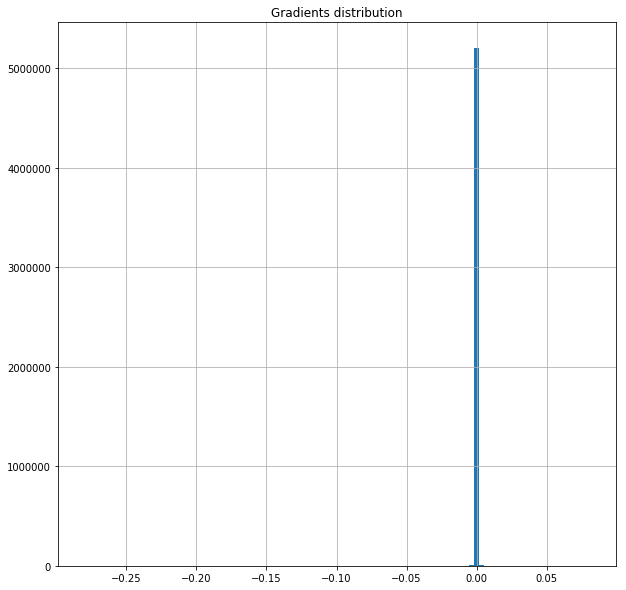

<SS> a revised offer within the next N hours despite the hopes of many traders <eos> the group 's advisers want to make certain they have firm bank commitments the second time around <eos> even if <EE>


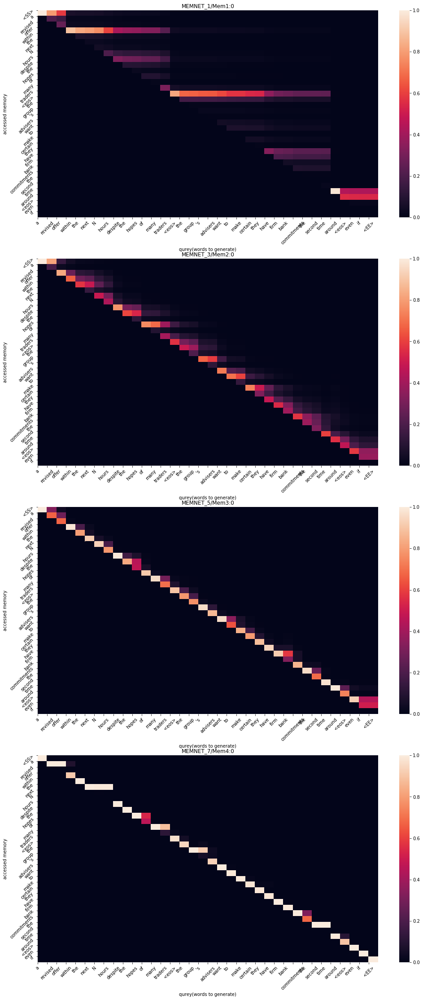

On iter 4201 with training PPL: 76.46182250976562, training ACC 0.2645399272441864
On iter 4202 with training PPL: 82.06059265136719, training ACC 0.2628038227558136
On iter 4203 with training PPL: 64.69910430908203, training ACC 0.2845052182674408
On iter 4204 with training PPL: 76.43605041503906, training ACC 0.2610677182674408
On iter 4205 with training PPL: 70.54621124267578, training ACC 0.2712673544883728
On iter 4206 with training PPL: 74.44552612304688, training ACC 0.2751736044883728
On iter 4207 with training PPL: 63.85496139526367, training ACC 0.2745225727558136
On iter 4208 with training PPL: 70.7781982421875, training ACC 0.2601996660232544
On iter 4209 with training PPL: 70.69377136230469, training ACC 0.259765625
On iter 4210 with training PPL: 66.02146911621094, training ACC 0.2823350727558136
On iter 4211 with training PPL: 57.641239166259766, training ACC 0.2918836772441864
On iter 4212 with training PPL: 74.98487854003906, training ACC 0.2641059160232544
On iter 421

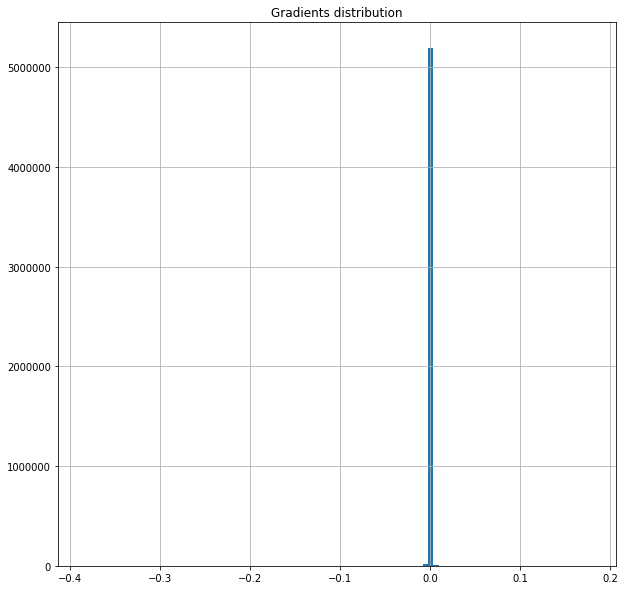

On iter 4231 with training PPL: 73.98809051513672, training ACC 0.2632378339767456
On iter 4232 with training PPL: 73.87791442871094, training ACC 0.265625
On iter 4233 with training PPL: 66.95291137695312, training ACC 0.2842881977558136
On iter 4234 with training PPL: 69.97956848144531, training ACC 0.2677951455116272
On iter 4235 with training PPL: 75.76602935791016, training ACC 0.2632378339767456
On iter 4236 with training PPL: 74.3320541381836, training ACC 0.2571614682674408
On iter 4237 with training PPL: 73.08921813964844, training ACC 0.2727864682674408
On iter 4238 with training PPL: 80.60868835449219, training ACC 0.2569444477558136
On iter 4239 with training PPL: 62.85020446777344, training ACC 0.2897135317325592
On iter 4240 with training PPL: 72.77212524414062, training ACC 0.2677951455116272
On iter 4241 with training PPL: 75.32759094238281, training ACC 0.2680121660232544
On iter 4242 with training PPL: 72.01184844970703, training ACC 0.2677951455116272
On iter 4243 wi

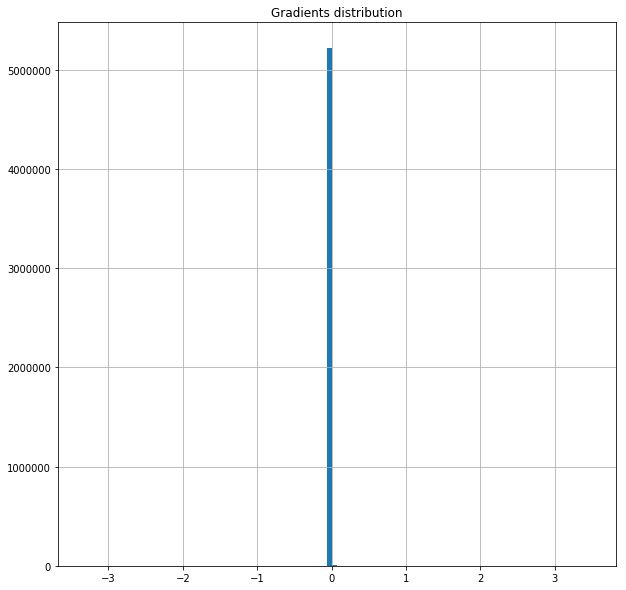

On iter 4261 with training PPL: 206.1235809326172, training ACC 0.1766493022441864
On iter 4262 with training PPL: 172.04246520996094, training ACC 0.19140625
On iter 4263 with training PPL: 140.33262634277344, training ACC 0.2000868022441864
On iter 4264 with training PPL: 175.98968505859375, training ACC 0.1844618022441864
On iter 4265 with training PPL: 164.8140411376953, training ACC 0.2109375
On iter 4266 with training PPL: 162.35047912597656, training ACC 0.2052951455116272
On iter 4267 with training PPL: 125.2770004272461, training ACC 0.2159288227558136
On iter 4268 with training PPL: 138.74612426757812, training ACC 0.2141927033662796
On iter 4269 with training PPL: 131.1724090576172, training ACC 0.2141927033662796
On iter 4270 with training PPL: 113.7070541381836, training ACC 0.2354600727558136
On iter 4271 with training PPL: 115.37173461914062, training ACC 0.224609375
On iter 4272 with training PPL: 104.53717803955078, training ACC 0.2408854216337204
On iter 4273 with tra

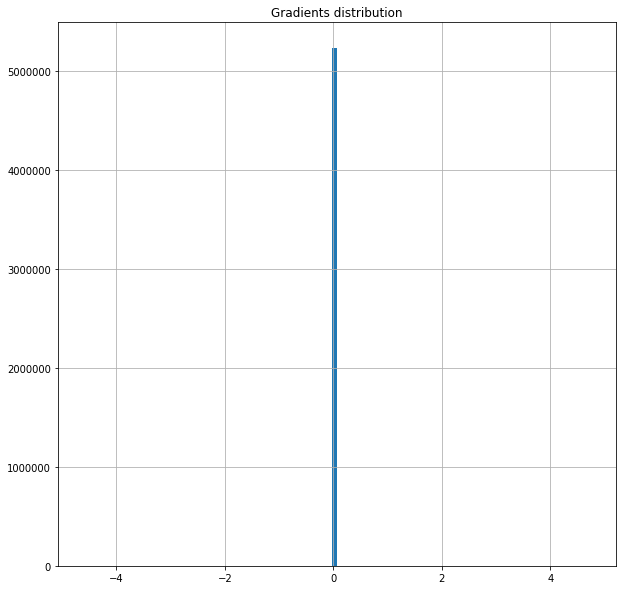

On iter 4291 with training PPL: 102.40386199951172, training ACC 0.2345920205116272
On iter 4292 with training PPL: 95.0826644897461, training ACC 0.2439236044883728
On iter 4293 with training PPL: 112.58195495605469, training ACC 0.2202690988779068
On iter 4294 with training PPL: 88.67332458496094, training ACC 0.2434895783662796
On iter 4295 with training PPL: 95.17374420166016, training ACC 0.2497829794883728
On iter 4296 with training PPL: 101.7374038696289, training ACC 0.2259114533662796
On iter 4297 with training PPL: 120.97162628173828, training ACC 0.2154947966337204
On iter 4298 with training PPL: 102.89715576171875, training ACC 0.2369791716337204
On iter 4299 with training PPL: 105.03258514404297, training ACC 0.2322048544883728
On iter 4300 with training PPL: 94.18024444580078, training ACC 0.2326388955116272
On iter 4301 with training PPL: 92.7994613647461, training ACC 0.2404513955116272
On iter 4302 with training PPL: 100.77547454833984, training ACC 0.2228732705116272


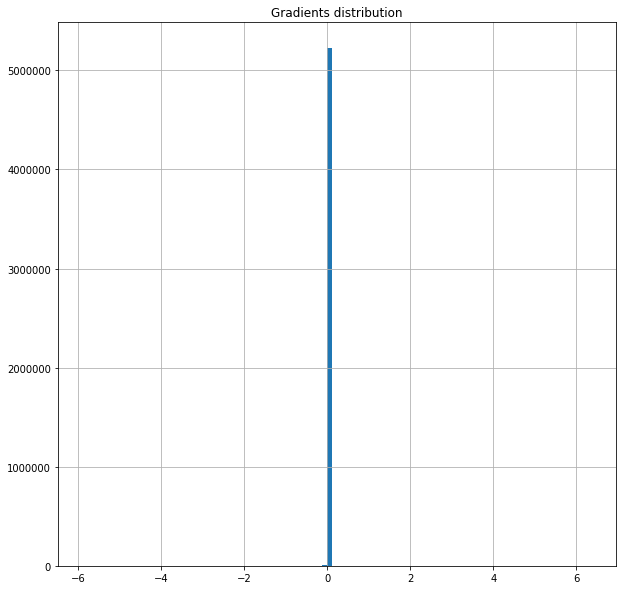

On iter 4321 with training PPL: 85.74427032470703, training ACC 0.2565104067325592
On iter 4322 with training PPL: 82.38191986083984, training ACC 0.2615017294883728
On iter 4323 with training PPL: 92.42289733886719, training ACC 0.2376302033662796
On iter 4324 with training PPL: 77.85951232910156, training ACC 0.2562934160232544
On iter 4325 with training PPL: 87.23561096191406, training ACC 0.2497829794883728
On iter 4326 with training PPL: 88.38732147216797, training ACC 0.2437065988779068
On iter 4327 with training PPL: 87.1045150756836, training ACC 0.2534722089767456
On iter 4328 with training PPL: 91.33900451660156, training ACC 0.2476128488779068
On iter 4329 with training PPL: 87.97088623046875, training ACC 0.2541232705116272
On iter 4330 with training PPL: 87.29315948486328, training ACC 0.2604166567325592
On iter 4331 with training PPL: 77.96766662597656, training ACC 0.2604166567325592
On iter 4332 with training PPL: 81.98104095458984, training ACC 0.259765625
On iter 4333

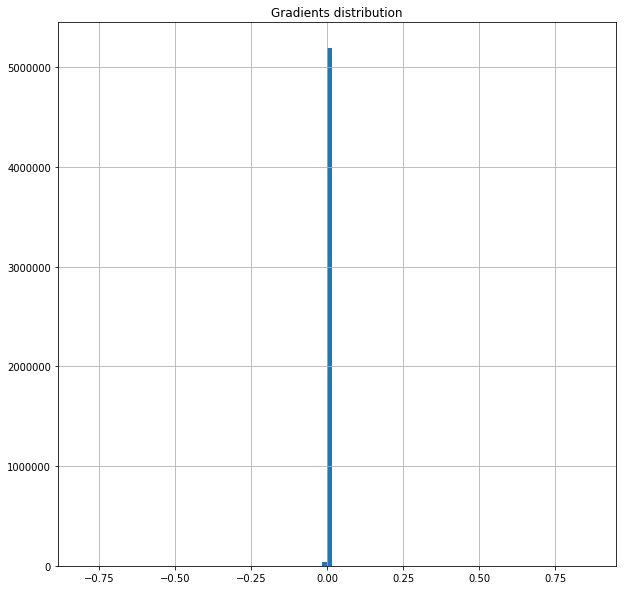

On iter 4351 with training PPL: 80.91230010986328, training ACC 0.2482638955116272
On iter 4352 with training PPL: 79.72368621826172, training ACC 0.2521701455116272
On iter 4353 with training PPL: 73.5333480834961, training ACC 0.2680121660232544
On iter 4354 with training PPL: 81.48673248291016, training ACC 0.2667100727558136
On iter 4355 with training PPL: 83.69660186767578, training ACC 0.2545572817325592
On iter 4356 with training PPL: 70.88371276855469, training ACC 0.263671875
On iter 4357 with training PPL: 95.95094299316406, training ACC 0.2578125
On iter 4358 with training PPL: 84.78400421142578, training ACC 0.2547743022441864
On iter 4359 with training PPL: 79.2281494140625, training ACC 0.2673611044883728
On iter 4360 with training PPL: 90.82443237304688, training ACC 0.2445746511220932
On iter 4361 with training PPL: 78.54298400878906, training ACC 0.2571614682674408
On iter 4362 with training PPL: 72.4176254272461, training ACC 0.2740885317325592
On iter 4363 with train

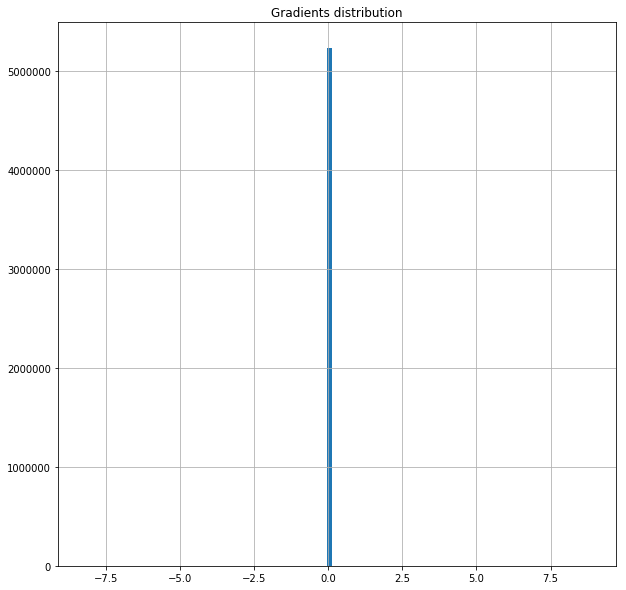

On iter 4381 with training PPL: 79.35428619384766, training ACC 0.2565104067325592
On iter 4382 with training PPL: 79.25584411621094, training ACC 0.2532552182674408
On iter 4383 with training PPL: 481.9126892089844, training ACC 0.1566840261220932
On iter 4384 with training PPL: 126.34188079833984, training ACC 0.2454427033662796
On iter 4385 with training PPL: 100.30487823486328, training ACC 0.2291666716337204
On iter 4386 with training PPL: 101.99757385253906, training ACC 0.244140625
On iter 4387 with training PPL: 85.64640808105469, training ACC 0.2612847089767456
On iter 4388 with training PPL: 90.89959716796875, training ACC 0.2612847089767456
On iter 4389 with training PPL: 89.4887924194336, training ACC 0.2502170205116272
On iter 4390 with training PPL: 84.3495101928711, training ACC 0.2543402910232544
On iter 4391 with training PPL: 80.28829956054688, training ACC 0.2591145932674408
On iter 4392 with training PPL: 87.938720703125, training ACC 0.2604166567325592
On iter 4393

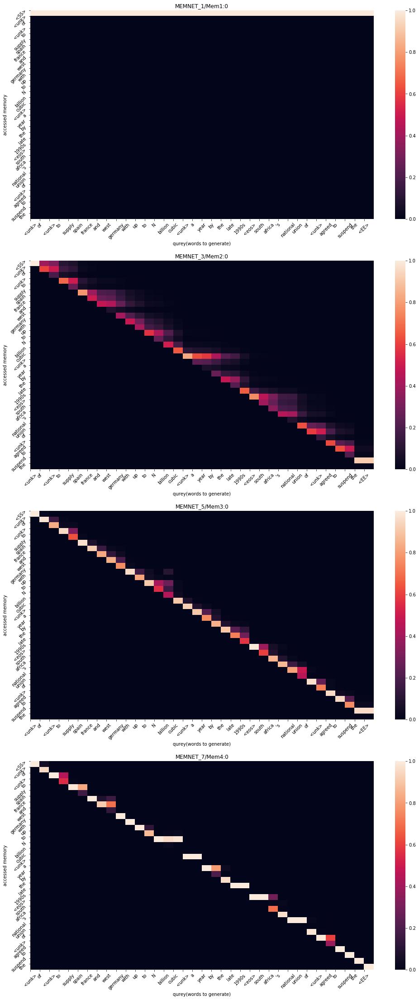

On iter 4401 with training PPL: 88.14640808105469, training ACC 0.2389322966337204
On iter 4402 with training PPL: 111.2519302368164, training ACC 0.2434895783662796
On iter 4403 with training PPL: 90.43281555175781, training ACC 0.2497829794883728
On iter 4404 with training PPL: 85.2742691040039, training ACC 0.2621527910232544
On iter 4405 with training PPL: 91.33708190917969, training ACC 0.2476128488779068
On iter 4406 with training PPL: 94.20772552490234, training ACC 0.2411024272441864
On iter 4407 with training PPL: 93.54535675048828, training ACC 0.2430555522441864
On iter 4408 with training PPL: 84.79528045654297, training ACC 0.2688802182674408
On iter 4409 with training PPL: 75.23440551757812, training ACC 0.2706163227558136
On iter 4410 with training PPL: 80.38710021972656, training ACC 0.259765625
	 validation PPL 161.70303344726562, validation acc 0.234375
shape of gradients is (5228544,), L2 norm of gradients is 29.536489486694336, details:                   0
count  5.2

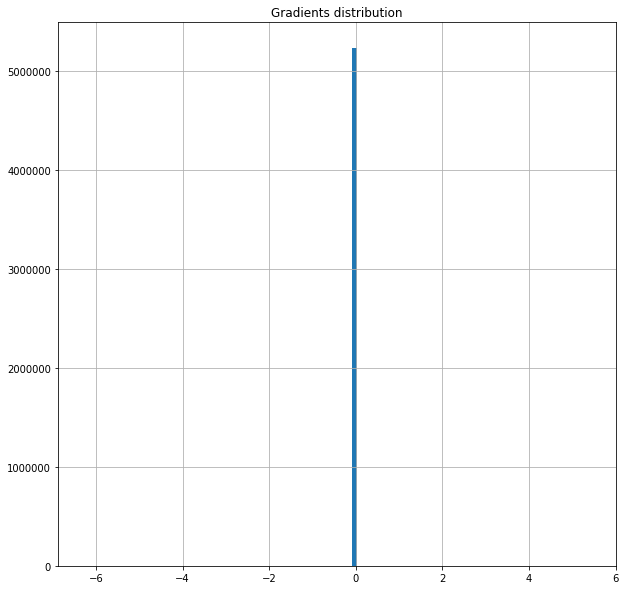

On iter 4411 with training PPL: 77.8603286743164, training ACC 0.2612847089767456
On iter 4412 with training PPL: 78.7772216796875, training ACC 0.2651909589767456
On iter 4413 with training PPL: 86.50273132324219, training ACC 0.2421875
On iter 4414 with training PPL: 93.2660903930664, training ACC 0.2491319477558136
On iter 4415 with training PPL: 89.43277740478516, training ACC 0.2495659738779068
On iter 4416 with training PPL: 84.81153869628906, training ACC 0.25
On iter 4417 with training PPL: 90.6393051147461, training ACC 0.2395833283662796
On iter 4418 with training PPL: 88.12358093261719, training ACC 0.2513020932674408
On iter 4419 with training PPL: 85.44647979736328, training ACC 0.2408854216337204
On iter 4420 with training PPL: 78.50834655761719, training ACC 0.2664930522441864
On iter 4421 with training PPL: 85.14088439941406, training ACC 0.2489149272441864
On iter 4422 with training PPL: 86.4539566040039, training ACC 0.2567274272441864
On iter 4423 with training PPL: 

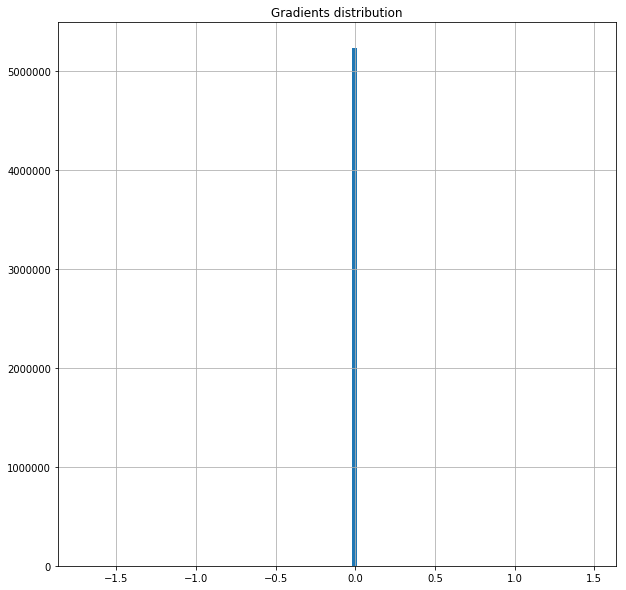

On iter 4441 with training PPL: 75.26339721679688, training ACC 0.2593315839767456
On iter 4442 with training PPL: 84.4432373046875, training ACC 0.2545572817325592
On iter 4443 with training PPL: 81.72698211669922, training ACC 0.2562934160232544
On iter 4444 with training PPL: 85.73171997070312, training ACC 0.2510850727558136
On iter 4445 with training PPL: 73.48652648925781, training ACC 0.2708333432674408
On iter 4446 with training PPL: 90.2758560180664, training ACC 0.23828125
On iter 4447 with training PPL: 77.35099029541016, training ACC 0.2595486044883728
On iter 4448 with training PPL: 78.84143829345703, training ACC 0.2673611044883728
On iter 4449 with training PPL: 87.0331039428711, training ACC 0.2458767294883728
On iter 4450 with training PPL: 70.66051483154297, training ACC 0.2703993022441864
On iter 4451 with training PPL: 75.09461975097656, training ACC 0.26171875
On iter 4452 with training PPL: 80.16011810302734, training ACC 0.2573784589767456
On iter 4453 with train

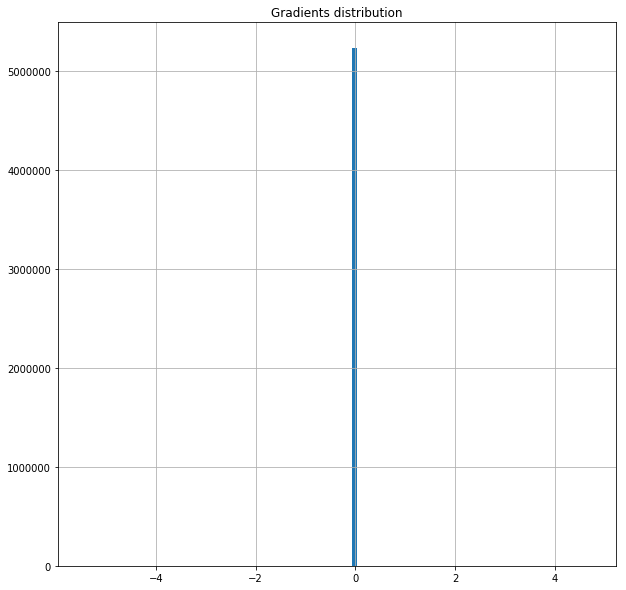

On iter 4471 with training PPL: 67.93878173828125, training ACC 0.2749565839767456
On iter 4472 with training PPL: 75.46964263916016, training ACC 0.265625
On iter 4473 with training PPL: 74.71498107910156, training ACC 0.2628038227558136
On iter 4474 with training PPL: 73.9340591430664, training ACC 0.2638888955116272
On iter 4475 with training PPL: 68.35369873046875, training ACC 0.26953125
On iter 4476 with training PPL: 74.73807525634766, training ACC 0.2710503339767456
On iter 4477 with training PPL: 71.67393493652344, training ACC 0.2654079794883728
On iter 4478 with training PPL: 80.4384765625, training ACC 0.2506510317325592
On iter 4479 with training PPL: 66.70101165771484, training ACC 0.2751736044883728
On iter 4480 with training PPL: 66.66361999511719, training ACC 0.2888454794883728
On iter 4481 with training PPL: 78.62471008300781, training ACC 0.2634548544883728
On iter 4482 with training PPL: 83.21012115478516, training ACC 0.2560763955116272
On iter 4483 with training 

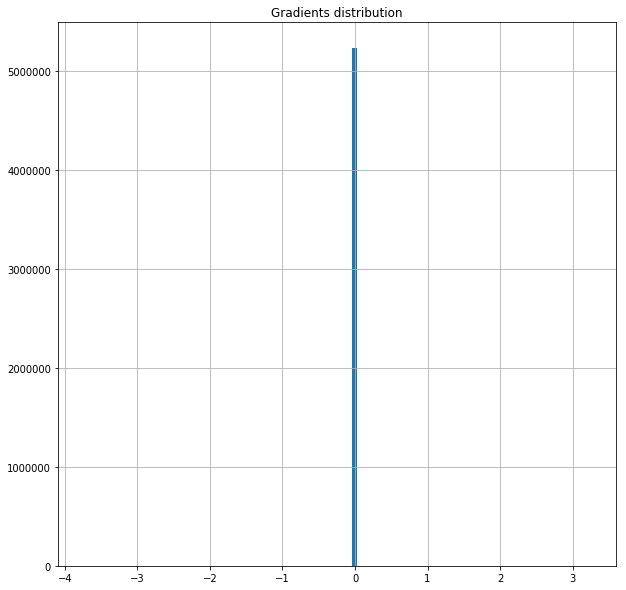

On iter 4501 with training PPL: 73.43600463867188, training ACC 0.2712673544883728
On iter 4502 with training PPL: 74.87065887451172, training ACC 0.2669270932674408
On iter 4503 with training PPL: 69.6436538696289, training ACC 0.2723524272441864
On iter 4504 with training PPL: 68.57827758789062, training ACC 0.2821180522441864
On iter 4505 with training PPL: 72.41292572021484, training ACC 0.2764756977558136
On iter 4506 with training PPL: 71.88316345214844, training ACC 0.2701822817325592
On iter 4507 with training PPL: 76.69540405273438, training ACC 0.2534722089767456
On iter 4508 with training PPL: 74.6297378540039, training ACC 0.2684461772441864
On iter 4509 with training PPL: 81.02932739257812, training ACC 0.2489149272441864
On iter 4510 with training PPL: 75.73796844482422, training ACC 0.2701822817325592
On iter 4511 with training PPL: 76.12904357910156, training ACC 0.2673611044883728
On iter 4512 with training PPL: 79.5905532836914, training ACC 0.2493489533662796
On iter

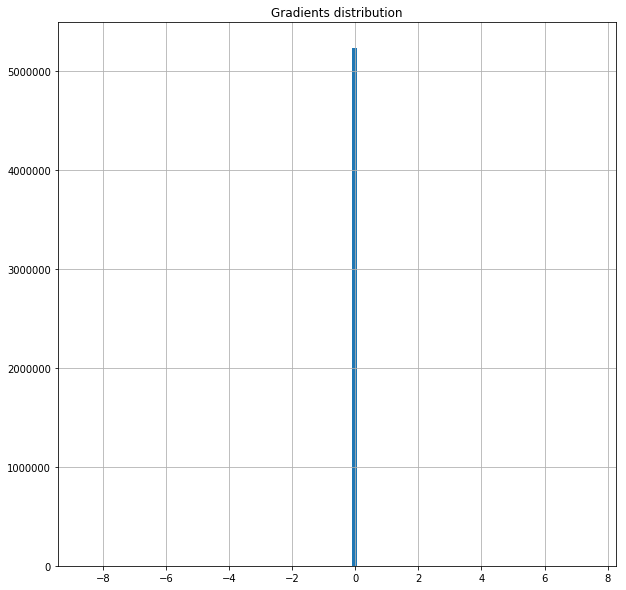

On iter 4531 with training PPL: 77.46693420410156, training ACC 0.2582465410232544
On iter 4532 with training PPL: 76.93157958984375, training ACC 0.2664930522441864
On iter 4533 with training PPL: 72.55799102783203, training ACC 0.2740885317325592
On iter 4534 with training PPL: 76.18482208251953, training ACC 0.2747395932674408
On iter 4535 with training PPL: 76.21309661865234, training ACC 0.2623697817325592
On iter 4536 with training PPL: 77.2003173828125, training ACC 0.2638888955116272
On iter 4537 with training PPL: 70.81212615966797, training ACC 0.2730034589767456
On iter 4538 with training PPL: 82.8816909790039, training ACC 0.2532552182674408
On iter 4539 with training PPL: 81.38887786865234, training ACC 0.2556423544883728
On iter 4540 with training PPL: 71.64287567138672, training ACC 0.2690972089767456
On iter 4541 with training PPL: 72.0390853881836, training ACC 0.2743055522441864
On iter 4542 with training PPL: 82.06962585449219, training ACC 0.2526041567325592
On iter

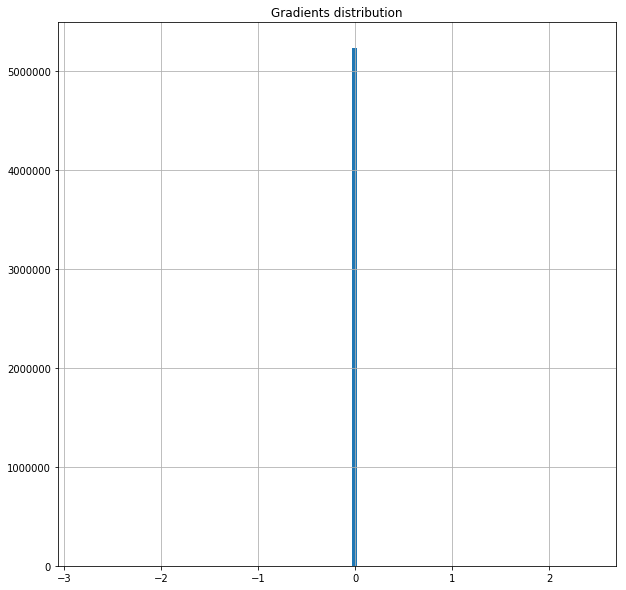

On iter 4561 with training PPL: 68.37606048583984, training ACC 0.2751736044883728
On iter 4562 with training PPL: 80.32196044921875, training ACC 0.2528211772441864
On iter 4563 with training PPL: 68.81576538085938, training ACC 0.28125
On iter 4564 with training PPL: 70.16390228271484, training ACC 0.2697482705116272
On iter 4565 with training PPL: 69.25265502929688, training ACC 0.2684461772441864
On iter 4566 with training PPL: 79.74524688720703, training ACC 0.251953125
On iter 4567 with training PPL: 74.07743835449219, training ACC 0.2621527910232544
On iter 4568 with training PPL: 67.84489440917969, training ACC 0.2801649272441864
On iter 4569 with training PPL: 74.90936279296875, training ACC 0.265625
On iter 4570 with training PPL: 77.44037628173828, training ACC 0.2604166567325592
On iter 4571 with training PPL: 75.44470977783203, training ACC 0.2582465410232544
On iter 4572 with training PPL: 75.40410614013672, training ACC 0.2643229067325592
On iter 4573 with training PPL: 

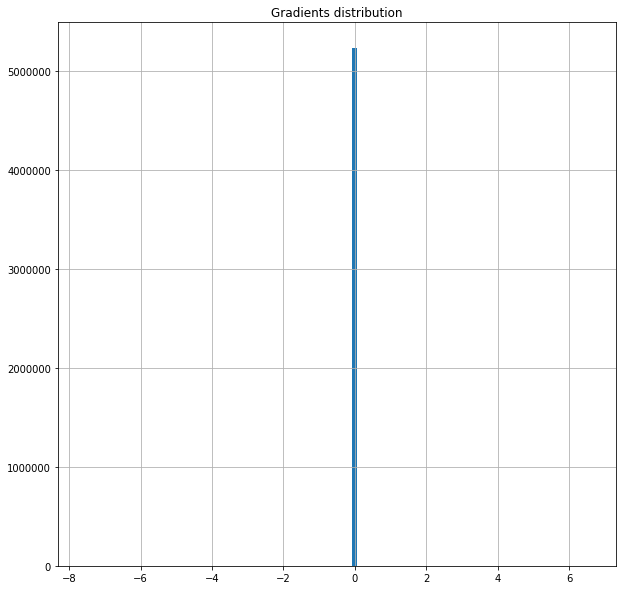

On iter 4591 with training PPL: 70.96292114257812, training ACC 0.2756076455116272
On iter 4592 with training PPL: 73.1388931274414, training ACC 0.2660590410232544
On iter 4593 with training PPL: 73.2845458984375, training ACC 0.2736545205116272
On iter 4594 with training PPL: 73.00102233886719, training ACC 0.2625868022441864
On iter 4595 with training PPL: 75.26084899902344, training ACC 0.2651909589767456
On iter 4596 with training PPL: 67.6730728149414, training ACC 0.2764756977558136
On iter 4597 with training PPL: 73.45467376708984, training ACC 0.2588975727558136
On iter 4598 with training PPL: 70.10106658935547, training ACC 0.2573784589767456
On iter 4599 with training PPL: 71.69703674316406, training ACC 0.2621527910232544
On iter 4600 with training PPL: 74.20169830322266, training ACC 0.2667100727558136
<SS> a.m. on the over-the-counter trading desk at a major brokerage firm a veteran trader who buys and sells some of the most active stocks looked at a senior official and a

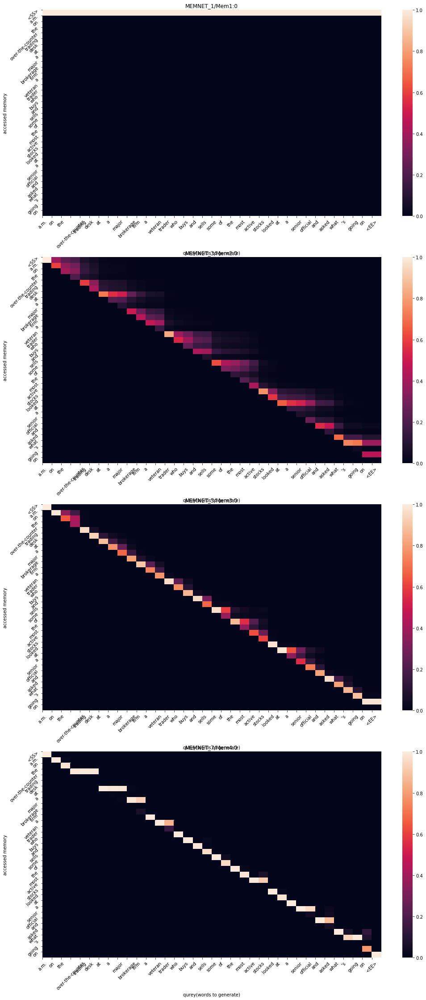

On iter 4601 with training PPL: 79.9559555053711, training ACC 0.2565104067325592
On iter 4602 with training PPL: 82.8699951171875, training ACC 0.2452256977558136
On iter 4603 with training PPL: 74.53965759277344, training ACC 0.26953125
On iter 4604 with training PPL: 69.57653045654297, training ACC 0.275390625
On iter 4605 with training PPL: 72.34880065917969, training ACC 0.2693142294883728
On iter 4606 with training PPL: 69.8739013671875, training ACC 0.2654079794883728
On iter 4607 with training PPL: 79.8293228149414, training ACC 0.2641059160232544
On iter 4608 with training PPL: 80.13629913330078, training ACC 0.2547743022441864
On iter 4609 with training PPL: 70.7397689819336, training ACC 0.2756076455116272
On iter 4610 with training PPL: 69.18338012695312, training ACC 0.2719184160232544
On iter 4611 with training PPL: 75.54179382324219, training ACC 0.2649739682674408
On iter 4612 with training PPL: 70.38013458251953, training ACC 0.2727864682674408
On iter 4613 with traini

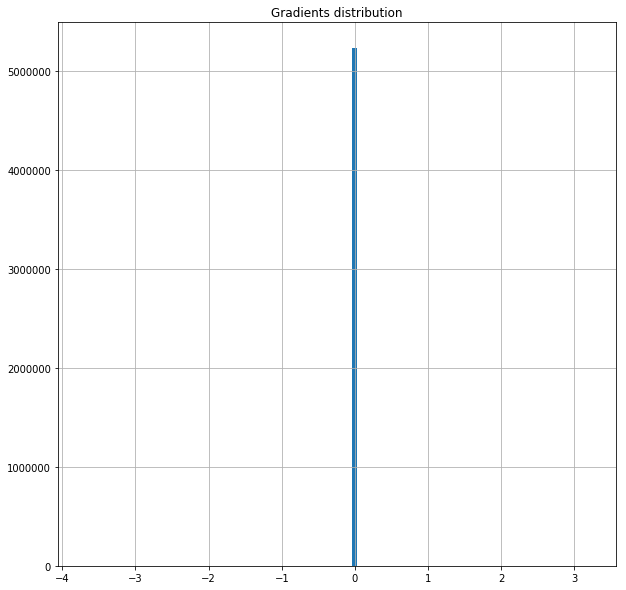

On iter 4621 with training PPL: 66.48609924316406, training ACC 0.2836371660232544
On iter 4622 with training PPL: 62.61777114868164, training ACC 0.2881944477558136
On iter 4623 with training PPL: 76.29796600341797, training ACC 0.2623697817325592
On iter 4624 with training PPL: 75.53901672363281, training ACC 0.2686631977558136
On iter 4625 with training PPL: 70.70011138916016, training ACC 0.2816840410232544
On iter 4626 with training PPL: 69.16163635253906, training ACC 0.2688802182674408
On iter 4627 with training PPL: 69.77045440673828, training ACC 0.2651909589767456
On iter 4628 with training PPL: 70.47076416015625, training ACC 0.2693142294883728
On iter 4629 with training PPL: 75.36211395263672, training ACC 0.2654079794883728
On iter 4630 with training PPL: 74.47887420654297, training ACC 0.2682291567325592
On iter 4631 with training PPL: 79.70650482177734, training ACC 0.259765625
On iter 4632 with training PPL: 70.64969635009766, training ACC 0.26953125
On iter 4633 with t

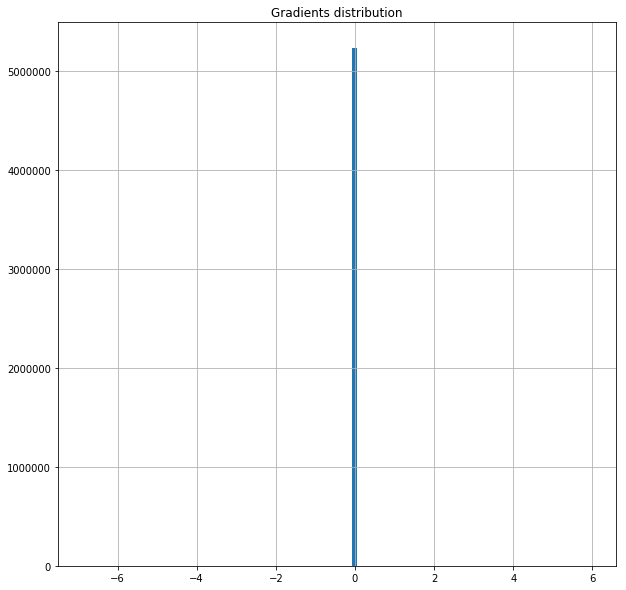

On iter 4651 with training PPL: 67.5867691040039, training ACC 0.2673611044883728
On iter 4652 with training PPL: 67.23326110839844, training ACC 0.2743055522441864
On iter 4653 with training PPL: 67.02315521240234, training ACC 0.2779947817325592
On iter 4654 with training PPL: 81.22147369384766, training ACC 0.25
On iter 4655 with training PPL: 73.12490844726562, training ACC 0.2621527910232544
On iter 4656 with training PPL: 80.2779312133789, training ACC 0.255859375
On iter 4657 with training PPL: 70.29714965820312, training ACC 0.279296875
On iter 4658 with training PPL: 82.21489715576172, training ACC 0.2495659738779068
On iter 4659 with training PPL: 69.76982116699219, training ACC 0.2723524272441864
On iter 4660 with training PPL: 71.47731018066406, training ACC 0.2736545205116272
On iter 4661 with training PPL: 69.51329803466797, training ACC 0.2723524272441864
On iter 4662 with training PPL: 73.60755157470703, training ACC 0.2619357705116272
On iter 4663 with training PPL: 72

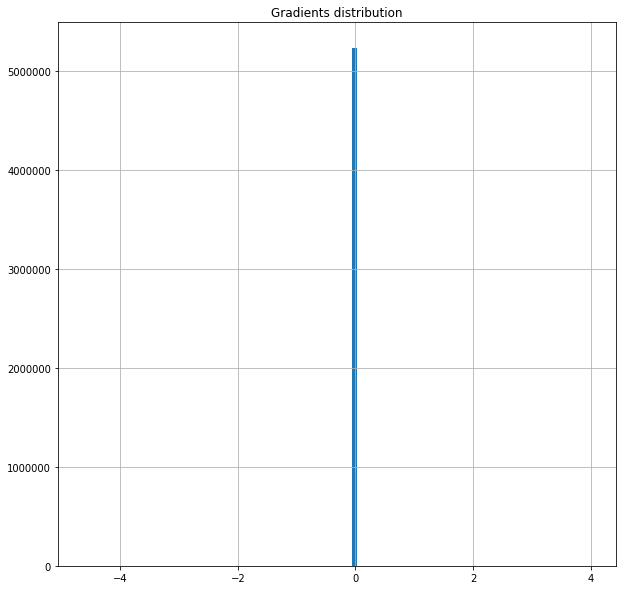

On iter 4681 with training PPL: 66.32872009277344, training ACC 0.2764756977558136
On iter 4682 with training PPL: 73.16166687011719, training ACC 0.2682291567325592
On iter 4683 with training PPL: 70.96250915527344, training ACC 0.2736545205116272
On iter 4684 with training PPL: 72.70206451416016, training ACC 0.2660590410232544
On iter 4685 with training PPL: 71.7915267944336, training ACC 0.271484375
On iter 4686 with training PPL: 74.15518188476562, training ACC 0.2628038227558136
On iter 4687 with training PPL: 78.306640625, training ACC 0.2541232705116272
On iter 4688 with training PPL: 65.38146209716797, training ACC 0.2734375
On iter 4689 with training PPL: 64.05709838867188, training ACC 0.2916666567325592
On iter 4690 with training PPL: 64.98646545410156, training ACC 0.2849392294883728
On iter 4691 with training PPL: 76.8416519165039, training ACC 0.2634548544883728
On iter 4692 with training PPL: 73.33519744873047, training ACC 0.2762586772441864
On iter 4693 with training 

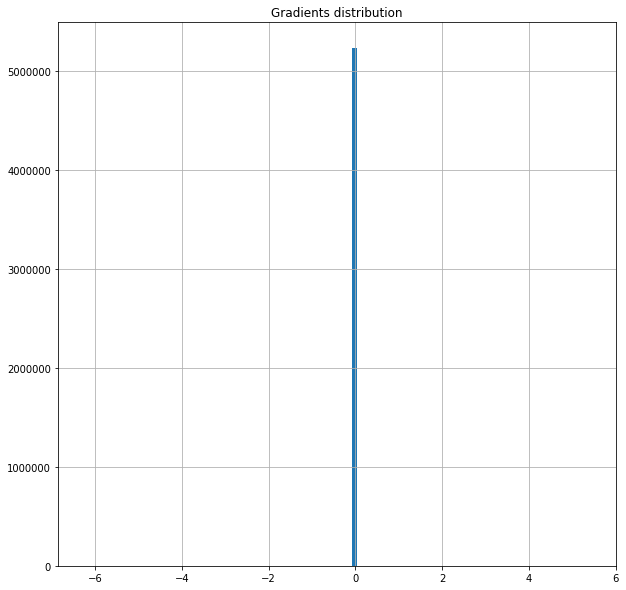

On iter 4711 with training PPL: 68.6651840209961, training ACC 0.2673611044883728
On iter 4712 with training PPL: 63.18706130981445, training ACC 0.2816840410232544
On iter 4713 with training PPL: 65.86607360839844, training ACC 0.2736545205116272
On iter 4714 with training PPL: 75.27703857421875, training ACC 0.259765625
On iter 4715 with training PPL: 74.70606994628906, training ACC 0.2632378339767456
On iter 4716 with training PPL: 66.15843200683594, training ACC 0.2786458432674408
On iter 4717 with training PPL: 78.01065826416016, training ACC 0.2601996660232544
On iter 4718 with training PPL: 71.37472534179688, training ACC 0.2664930522441864
On iter 4719 with training PPL: 66.70740509033203, training ACC 0.2786458432674408
On iter 4720 with training PPL: 69.13388061523438, training ACC 0.2740885317325592
On iter 4721 with training PPL: 71.3852767944336, training ACC 0.2710503339767456
On iter 4722 with training PPL: 82.58860778808594, training ACC 0.2545572817325592
On iter 4723 

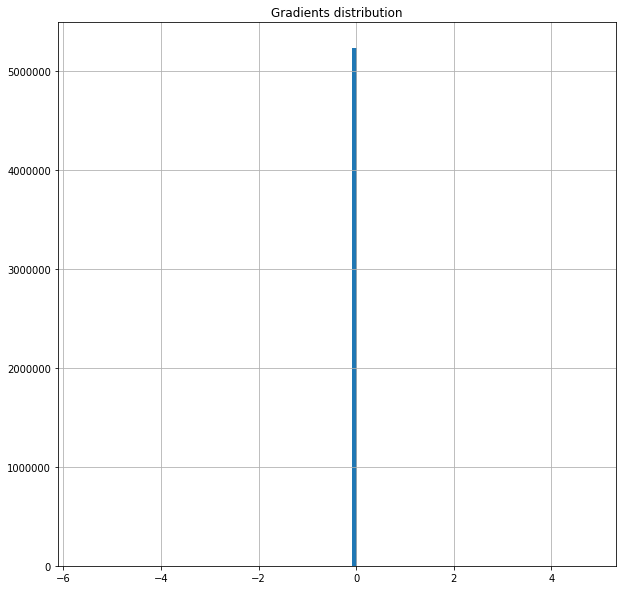

On iter 4741 with training PPL: 72.35832214355469, training ACC 0.2619357705116272
On iter 4742 with training PPL: 67.7571792602539, training ACC 0.2710503339767456
On iter 4743 with training PPL: 71.75196838378906, training ACC 0.2625868022441864
On iter 4744 with training PPL: 71.8936538696289, training ACC 0.2606336772441864
On iter 4745 with training PPL: 68.0581283569336, training ACC 0.2643229067325592
On iter 4746 with training PPL: 75.21025848388672, training ACC 0.2643229067325592
On iter 4747 with training PPL: 79.3509521484375, training ACC 0.263671875
On iter 4748 with training PPL: 65.39065551757812, training ACC 0.2805989682674408
On iter 4749 with training PPL: 68.06816101074219, training ACC 0.2743055522441864
On iter 4750 with training PPL: 77.84347534179688, training ACC 0.2591145932674408
On iter 4751 with training PPL: 61.08530044555664, training ACC 0.2927517294883728
On iter 4752 with training PPL: 66.97164916992188, training ACC 0.2727864682674408
On iter 4753 wi

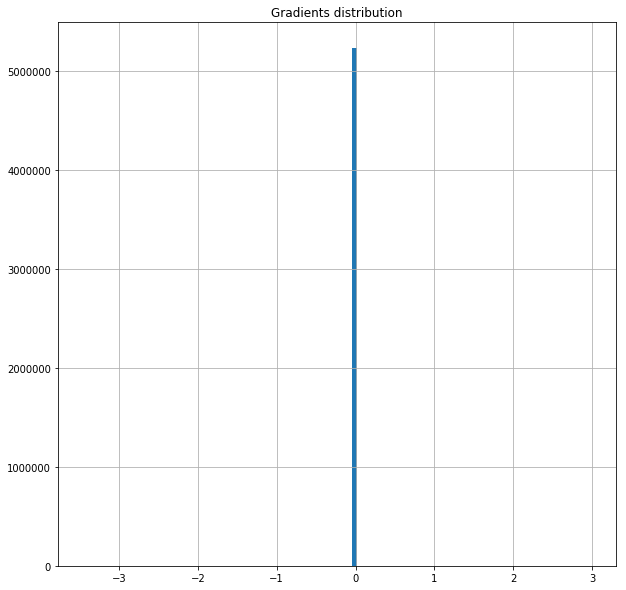

On iter 4771 with training PPL: 69.74264526367188, training ACC 0.2782118022441864
On iter 4772 with training PPL: 70.21256256103516, training ACC 0.2816840410232544
On iter 4773 with training PPL: 69.44319152832031, training ACC 0.2632378339767456
On iter 4774 with training PPL: 74.91029357910156, training ACC 0.2554253339767456
On iter 4775 with training PPL: 65.5577163696289, training ACC 0.2842881977558136
On iter 4776 with training PPL: 75.99713897705078, training ACC 0.2599826455116272
On iter 4777 with training PPL: 66.57463836669922, training ACC 0.2771267294883728
On iter 4778 with training PPL: 75.4077377319336, training ACC 0.2628038227558136
On iter 4779 with training PPL: 60.96532440185547, training ACC 0.2847222089767456
On iter 4780 with training PPL: 72.7662582397461, training ACC 0.2671440839767456
On iter 4781 with training PPL: 69.54127502441406, training ACC 0.26953125
On iter 4782 with training PPL: 72.8583755493164, training ACC 0.2725694477558136
On iter 4783 wit

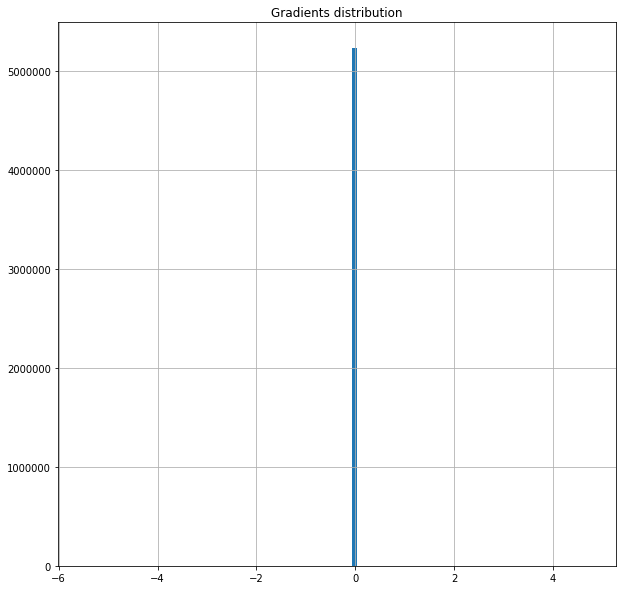

<SS> age of N for readers at the <unk> of their <unk> years loyalty to the tune of an N N average subscription renewal rate <eos> the magazine had its best year yet in N when <EE>


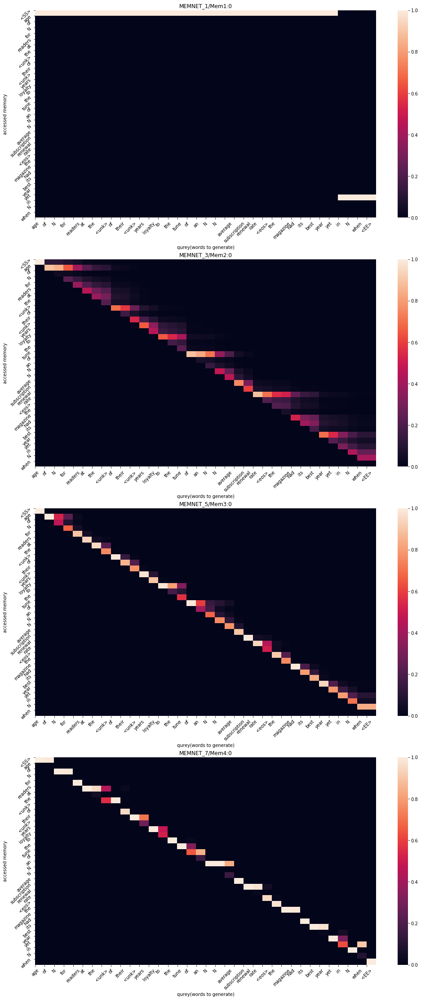

On iter 4801 with training PPL: 68.07588958740234, training ACC 0.2779947817325592
On iter 4802 with training PPL: 68.13053894042969, training ACC 0.2641059160232544
On iter 4803 with training PPL: 75.5156478881836, training ACC 0.2549913227558136
On iter 4804 with training PPL: 71.71318054199219, training ACC 0.2693142294883728
On iter 4805 with training PPL: 68.9654312133789, training ACC 0.2682291567325592
On iter 4806 with training PPL: 72.85149383544922, training ACC 0.2651909589767456
On iter 4807 with training PPL: 73.12010192871094, training ACC 0.2721354067325592
On iter 4808 with training PPL: 74.5419692993164, training ACC 0.2593315839767456
On iter 4809 with training PPL: 79.70103454589844, training ACC 0.2575954794883728
On iter 4810 with training PPL: 71.80799865722656, training ACC 0.2649739682674408
On iter 4811 with training PPL: 68.99763488769531, training ACC 0.2784288227558136
On iter 4812 with training PPL: 67.99458312988281, training ACC 0.2701822817325592
On iter

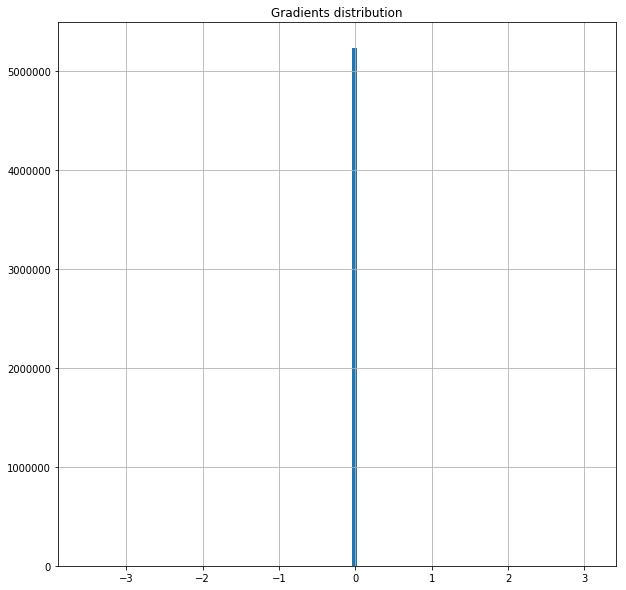

On iter 4831 with training PPL: 64.1220703125, training ACC 0.2825520932674408
On iter 4832 with training PPL: 62.10236740112305, training ACC 0.2860243022441864
On iter 4833 with training PPL: 73.2455825805664, training ACC 0.2604166567325592
On iter 4834 with training PPL: 71.52934265136719, training ACC 0.2628038227558136
On iter 4835 with training PPL: 78.71492767333984, training ACC 0.2580295205116272
On iter 4836 with training PPL: 65.06891632080078, training ACC 0.2760416567325592
On iter 4837 with training PPL: 72.5433578491211, training ACC 0.2717013955116272
On iter 4838 with training PPL: 77.76171112060547, training ACC 0.2569444477558136
On iter 4839 with training PPL: 75.5169448852539, training ACC 0.2723524272441864
On iter 4840 with training PPL: 64.67310333251953, training ACC 0.2862413227558136
On iter 4841 with training PPL: 75.31128692626953, training ACC 0.2543402910232544
On iter 4842 with training PPL: 71.79255676269531, training ACC 0.2697482705116272
On iter 484

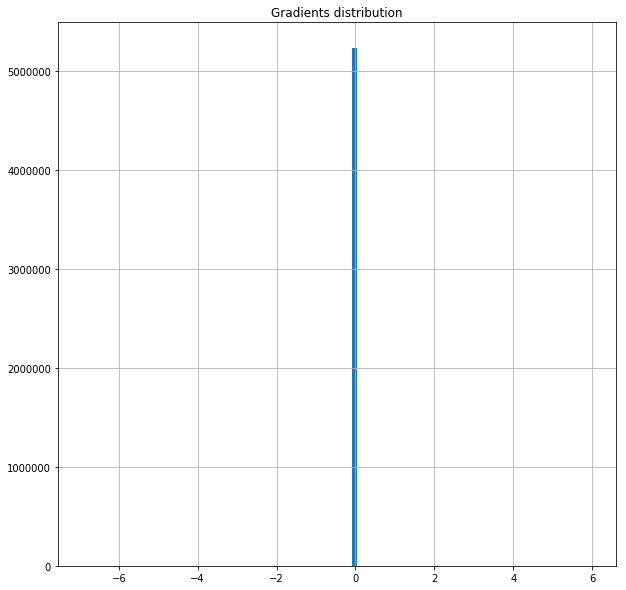

On iter 4861 with training PPL: 75.50459289550781, training ACC 0.2476128488779068
On iter 4862 with training PPL: 75.50643157958984, training ACC 0.2508680522441864
On iter 4863 with training PPL: 70.92516326904297, training ACC 0.265625
On iter 4864 with training PPL: 75.38433074951172, training ACC 0.2625868022441864
On iter 4865 with training PPL: 62.81919479370117, training ACC 0.2897135317325592
On iter 4866 with training PPL: 75.55429077148438, training ACC 0.2667100727558136
On iter 4867 with training PPL: 64.9746322631836, training ACC 0.2784288227558136
On iter 4868 with training PPL: 68.45830535888672, training ACC 0.2782118022441864
On iter 4869 with training PPL: 66.0257568359375, training ACC 0.2654079794883728
On iter 4870 with training PPL: 64.1007308959961, training ACC 0.2779947817325592
On iter 4871 with training PPL: 72.8031234741211, training ACC 0.2625868022441864
On iter 4872 with training PPL: 66.1507339477539, training ACC 0.2790798544883728
On iter 4873 with t

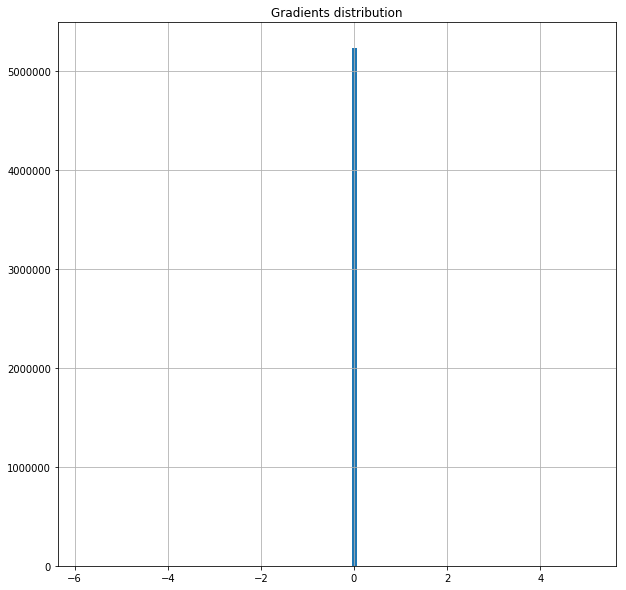

On iter 4891 with training PPL: 63.007049560546875, training ACC 0.275390625
On iter 4892 with training PPL: 71.57130432128906, training ACC 0.2734375
On iter 4893 with training PPL: 71.96046447753906, training ACC 0.2599826455116272
On iter 4894 with training PPL: 74.6844253540039, training ACC 0.267578125
On iter 4895 with training PPL: 73.62674713134766, training ACC 0.2667100727558136
On iter 4896 with training PPL: 75.00626373291016, training ACC 0.2641059160232544
On iter 4897 with training PPL: 80.45220947265625, training ACC 0.2604166567325592
On iter 4898 with training PPL: 72.24700164794922, training ACC 0.267578125
On iter 4899 with training PPL: 74.26275634765625, training ACC 0.2677951455116272
On iter 4900 with training PPL: 74.06803894042969, training ACC 0.2660590410232544
On iter 4901 with training PPL: 72.4520263671875, training ACC 0.2625868022441864
On iter 4902 with training PPL: 67.29608917236328, training ACC 0.2708333432674408
On iter 4903 with training PPL: 74.

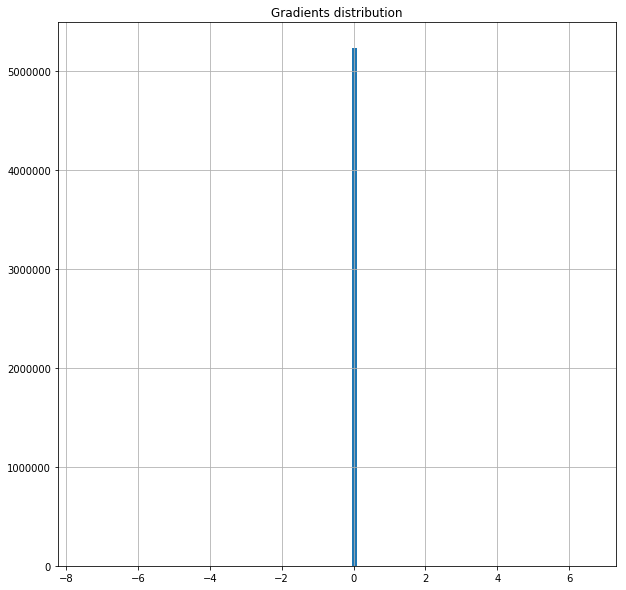

On iter 4921 with training PPL: 72.79791259765625, training ACC 0.2562934160232544
On iter 4922 with training PPL: 63.822723388671875, training ACC 0.2740885317325592
On iter 4923 with training PPL: 63.567569732666016, training ACC 0.2790798544883728
On iter 4924 with training PPL: 66.49713134765625, training ACC 0.2758246660232544
On iter 4925 with training PPL: 73.5477294921875, training ACC 0.2719184160232544
On iter 4926 with training PPL: 66.89138793945312, training ACC 0.2743055522441864
On iter 4927 with training PPL: 63.85906982421875, training ACC 0.2790798544883728
On iter 4928 with training PPL: 68.25048828125, training ACC 0.283203125
On iter 4929 with training PPL: 70.87208557128906, training ACC 0.2699652910232544
On iter 4930 with training PPL: 71.6971435546875, training ACC 0.2654079794883728
On iter 4931 with training PPL: 69.17787170410156, training ACC 0.2758246660232544
On iter 4932 with training PPL: 67.79612731933594, training ACC 0.2799479067325592
On iter 4933 w

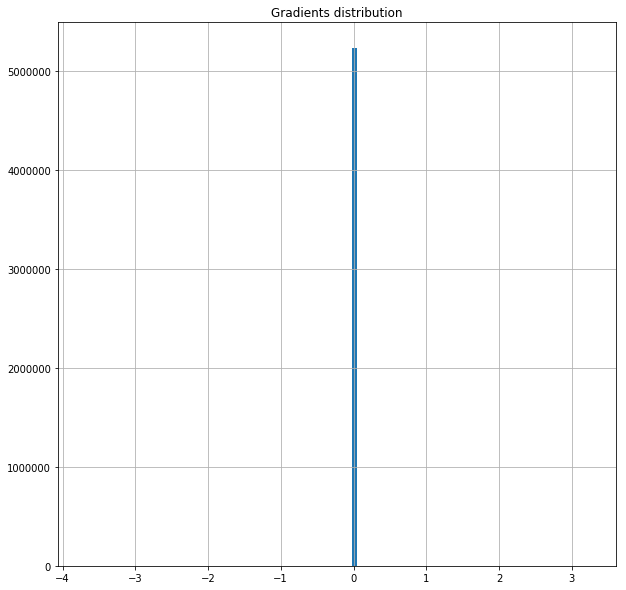

On iter 4951 with training PPL: 65.6783676147461, training ACC 0.2745225727558136
On iter 4952 with training PPL: 63.676265716552734, training ACC 0.2782118022441864
On iter 4953 with training PPL: 67.0029525756836, training ACC 0.2734375
On iter 4954 with training PPL: 72.61832427978516, training ACC 0.2669270932674408
On iter 4955 with training PPL: 72.62576293945312, training ACC 0.2630208432674408
On iter 4956 with training PPL: 70.3523178100586, training ACC 0.2730034589767456
On iter 4957 with training PPL: 71.17960357666016, training ACC 0.2682291567325592
On iter 4958 with training PPL: 74.96617889404297, training ACC 0.2619357705116272
On iter 4959 with training PPL: 71.09649658203125, training ACC 0.2643229067325592
On iter 4960 with training PPL: 71.60089874267578, training ACC 0.2749565839767456
On iter 4961 with training PPL: 70.86515808105469, training ACC 0.2528211772441864
On iter 4962 with training PPL: 75.86577606201172, training ACC 0.251953125
On iter 4963 with trai

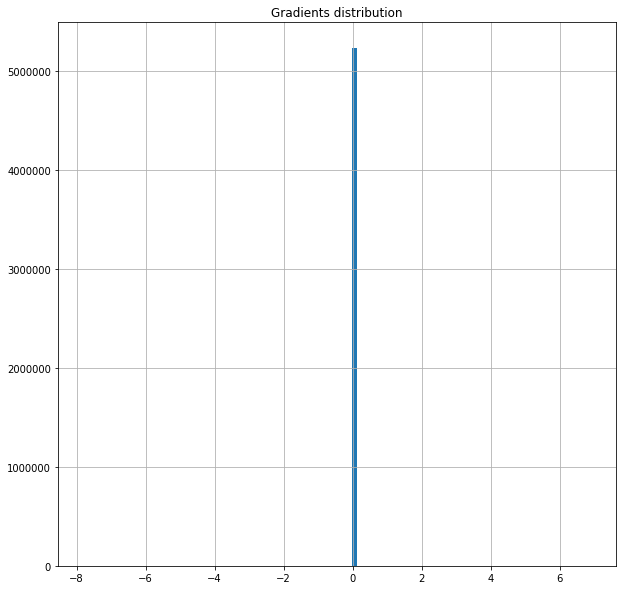

On iter 4981 with training PPL: 68.7926025390625, training ACC 0.265625
On iter 4982 with training PPL: 69.19357299804688, training ACC 0.26953125
On iter 4983 with training PPL: 67.65467834472656, training ACC 0.2628038227558136
On iter 4984 with training PPL: 67.85081481933594, training ACC 0.2682291567325592
On iter 4985 with training PPL: 68.80018615722656, training ACC 0.2682291567325592
On iter 4986 with training PPL: 61.49513244628906, training ACC 0.2886284589767456
On iter 4987 with training PPL: 67.03651428222656, training ACC 0.2747395932674408
On iter 4988 with training PPL: 76.85531616210938, training ACC 0.2634548544883728
On iter 4989 with training PPL: 64.0813217163086, training ACC 0.2805989682674408
On iter 4990 with training PPL: 73.20166778564453, training ACC 0.2680121660232544
On iter 4991 with training PPL: 71.71653747558594, training ACC 0.2671440839767456
On iter 4992 with training PPL: 69.87239837646484, training ACC 0.2756076455116272
On iter 4993 with traini

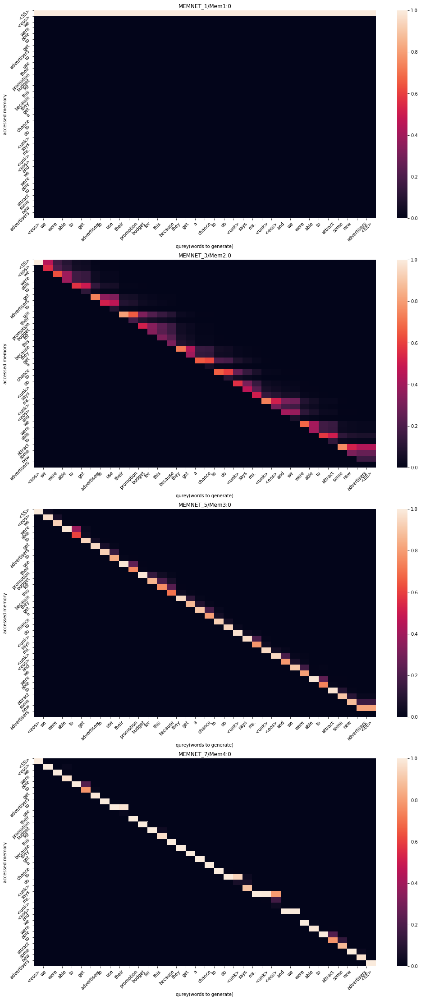

On iter 5001 with training PPL: 62.46246337890625, training ACC 0.2821180522441864
On iter 5002 with training PPL: 66.55286407470703, training ACC 0.2664930522441864
On iter 5003 with training PPL: 65.00236511230469, training ACC 0.2860243022441864
On iter 5004 with training PPL: 68.68218231201172, training ACC 0.2725694477558136
On iter 5005 with training PPL: 72.11493682861328, training ACC 0.2623697817325592
On iter 5006 with training PPL: 70.19332122802734, training ACC 0.2697482705116272
On iter 5007 with training PPL: 73.12250518798828, training ACC 0.26171875
On iter 5008 with training PPL: 71.03360748291016, training ACC 0.2638888955116272
On iter 5009 with training PPL: 70.04753875732422, training ACC 0.2662760317325592
On iter 5010 with training PPL: 68.65523529052734, training ACC 0.2769097089767456
	 validation PPL 154.16470336914062, validation acc 0.2276475727558136
shape of gradients is (5228544,), L2 norm of gradients is 15.140295028686523, details:                   0


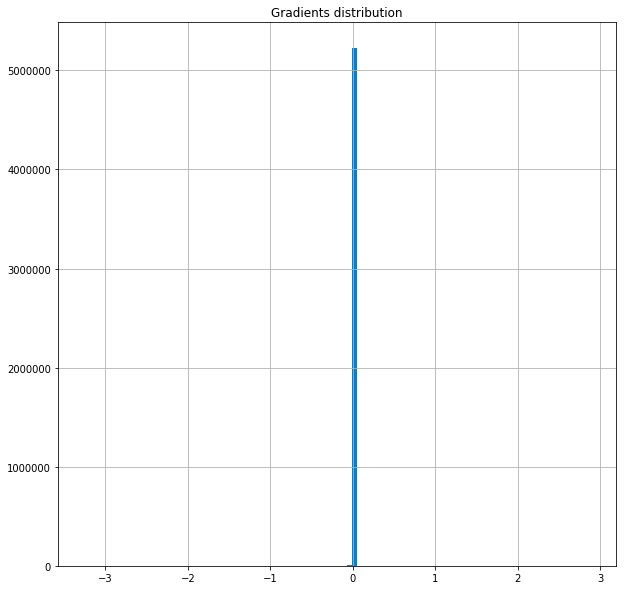

On iter 5011 with training PPL: 77.02867126464844, training ACC 0.2604166567325592
On iter 5012 with training PPL: 71.5570068359375, training ACC 0.2628038227558136
On iter 5013 with training PPL: 73.78582000732422, training ACC 0.2649739682674408
On iter 5014 with training PPL: 73.24520111083984, training ACC 0.2649739682674408
On iter 5015 with training PPL: 61.255821228027344, training ACC 0.2925347089767456
On iter 5016 with training PPL: 65.01644134521484, training ACC 0.275390625
On iter 5017 with training PPL: 74.89846801757812, training ACC 0.2580295205116272
On iter 5018 with training PPL: 64.33375549316406, training ACC 0.2795138955116272
On iter 5019 with training PPL: 64.99136352539062, training ACC 0.2805989682674408
On iter 5020 with training PPL: 64.12784576416016, training ACC 0.2918836772441864
On iter 5021 with training PPL: 66.59185028076172, training ACC 0.2847222089767456
On iter 5022 with training PPL: 70.27067565917969, training ACC 0.2697482705116272
On iter 502

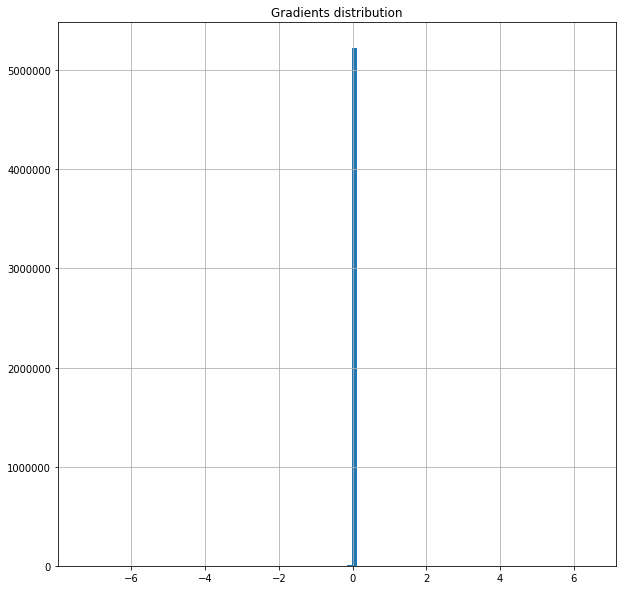

On iter 5041 with training PPL: 69.91349792480469, training ACC 0.2736545205116272
On iter 5042 with training PPL: 72.88030242919922, training ACC 0.2658420205116272
On iter 5043 with training PPL: 70.32075500488281, training ACC 0.2803819477558136
On iter 5044 with training PPL: 67.6278076171875, training ACC 0.2747395932674408
On iter 5045 with training PPL: 68.84793853759766, training ACC 0.2751736044883728
On iter 5046 with training PPL: 67.196044921875, training ACC 0.2788628339767456
On iter 5047 with training PPL: 69.09976959228516, training ACC 0.2673611044883728
On iter 5048 with training PPL: 67.70030975341797, training ACC 0.2775607705116272
On iter 5049 with training PPL: 61.49225616455078, training ACC 0.2938368022441864
On iter 5050 with training PPL: 71.98503875732422, training ACC 0.2632378339767456
On iter 5051 with training PPL: 62.3829345703125, training ACC 0.2849392294883728
On iter 5052 with training PPL: 62.986114501953125, training ACC 0.2836371660232544
On iter

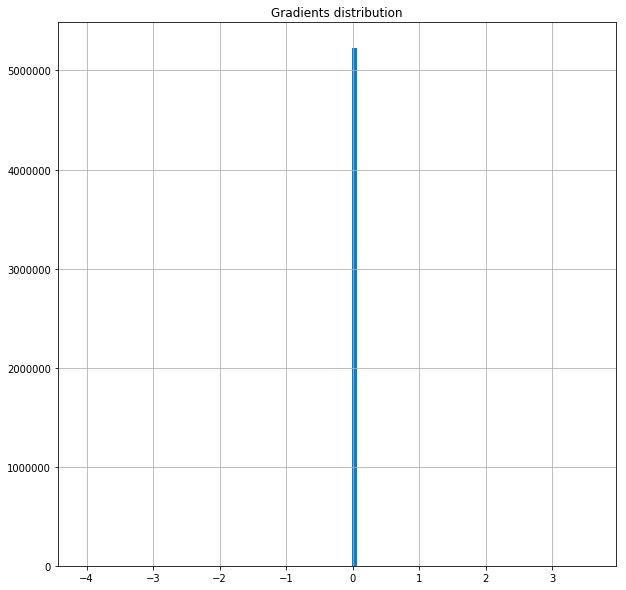

On iter 5071 with training PPL: 62.54368209838867, training ACC 0.2799479067325592
On iter 5072 with training PPL: 69.49347686767578, training ACC 0.2740885317325592
On iter 5073 with training PPL: 67.7806396484375, training ACC 0.2803819477558136
On iter 5074 with training PPL: 68.97553253173828, training ACC 0.2693142294883728
On iter 5075 with training PPL: 67.25730895996094, training ACC 0.2766927182674408
On iter 5076 with training PPL: 65.3448715209961, training ACC 0.2805989682674408
On iter 5077 with training PPL: 60.59872055053711, training ACC 0.2810329794883728
On iter 5078 with training PPL: 63.57666015625, training ACC 0.2784288227558136
On iter 5079 with training PPL: 73.60940551757812, training ACC 0.2612847089767456
On iter 5080 with training PPL: 64.82061004638672, training ACC 0.2751736044883728
On iter 5081 with training PPL: 61.08512878417969, training ACC 0.2838541567325592
On iter 5082 with training PPL: 71.817626953125, training ACC 0.2634548544883728
On iter 508

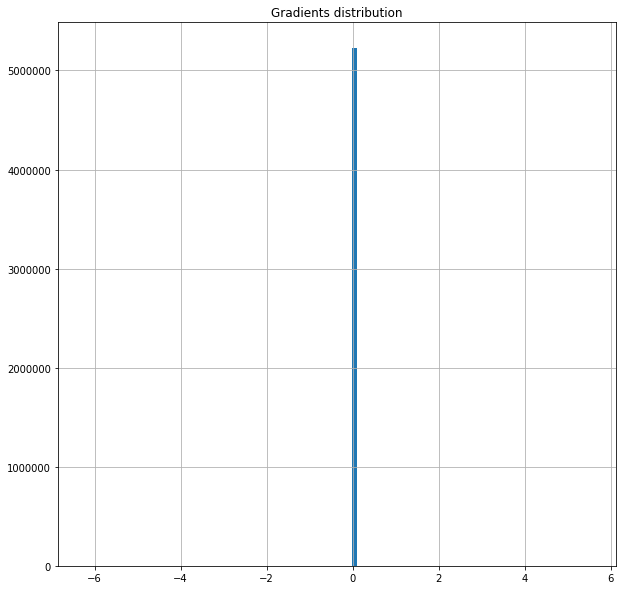

On iter 5101 with training PPL: 66.25241088867188, training ACC 0.2710503339767456
On iter 5102 with training PPL: 68.6314697265625, training ACC 0.2708333432674408
On iter 5103 with training PPL: 72.49982452392578, training ACC 0.2621527910232544
On iter 5104 with training PPL: 61.887516021728516, training ACC 0.2827690839767456
On iter 5105 with training PPL: 67.99799346923828, training ACC 0.26953125
On iter 5106 with training PPL: 79.34516143798828, training ACC 0.2545572817325592
On iter 5107 with training PPL: 68.16173553466797, training ACC 0.2849392294883728
On iter 5108 with training PPL: 66.42503356933594, training ACC 0.2699652910232544
On iter 5109 with training PPL: 70.96995544433594, training ACC 0.2680121660232544
On iter 5110 with training PPL: 63.44123458862305, training ACC 0.2819010317325592
On iter 5111 with training PPL: 70.60504150390625, training ACC 0.2684461772441864
On iter 5112 with training PPL: 68.52284240722656, training ACC 0.2654079794883728
On iter 5113

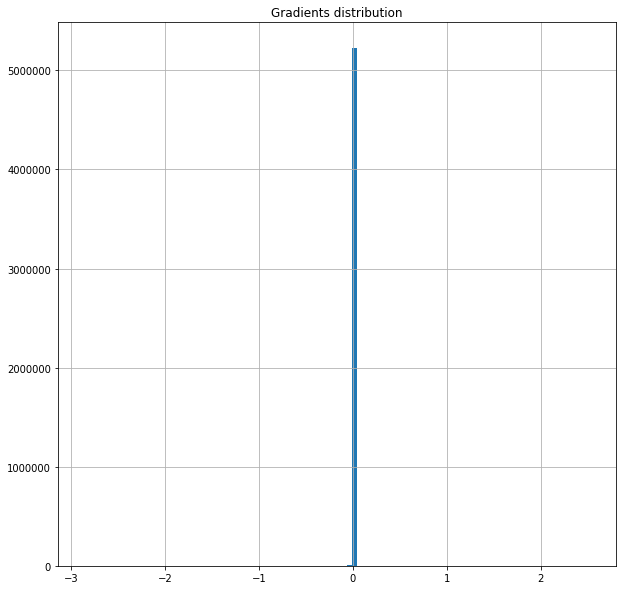

On iter 5131 with training PPL: 64.74900817871094, training ACC 0.2730034589767456
On iter 5132 with training PPL: 69.76187133789062, training ACC 0.2669270932674408
On iter 5133 with training PPL: 70.16122436523438, training ACC 0.2667100727558136
On iter 5134 with training PPL: 66.48942565917969, training ACC 0.2654079794883728
On iter 5135 with training PPL: 63.75556182861328, training ACC 0.2803819477558136
On iter 5136 with training PPL: 72.5445327758789, training ACC 0.2584635317325592
On iter 5137 with training PPL: 72.84656524658203, training ACC 0.2688802182674408
On iter 5138 with training PPL: 68.25048828125, training ACC 0.267578125
On iter 5139 with training PPL: 67.05818176269531, training ACC 0.2673611044883728
On iter 5140 with training PPL: 63.802581787109375, training ACC 0.2743055522441864
On iter 5141 with training PPL: 76.8158187866211, training ACC 0.26171875
On iter 5142 with training PPL: 65.96807098388672, training ACC 0.2745225727558136
On iter 5143 with train

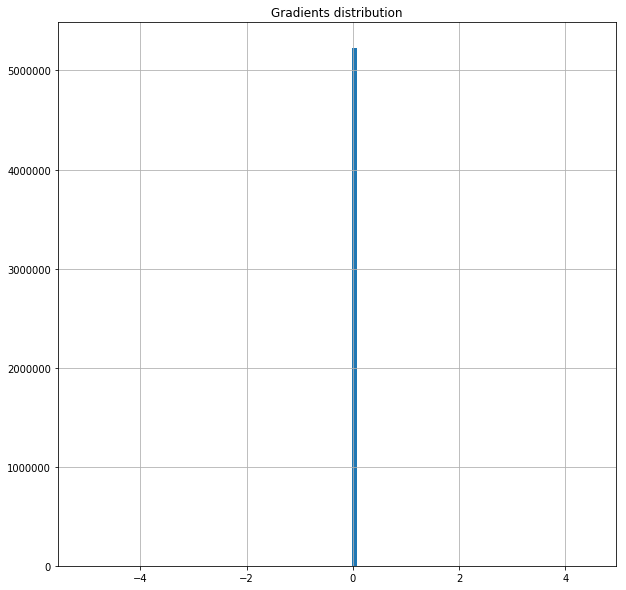

On iter 5161 with training PPL: 72.91075134277344, training ACC 0.2645399272441864
On iter 5162 with training PPL: 61.11542510986328, training ACC 0.2860243022441864
On iter 5163 with training PPL: 64.11396026611328, training ACC 0.2699652910232544
On iter 5164 with training PPL: 71.58919525146484, training ACC 0.2634548544883728
On iter 5165 with training PPL: 70.40412902832031, training ACC 0.2740885317325592
On iter 5166 with training PPL: 62.3941764831543, training ACC 0.2881944477558136
On iter 5167 with training PPL: 61.94432067871094, training ACC 0.2775607705116272
On iter 5168 with training PPL: 70.34705352783203, training ACC 0.26953125
On iter 5169 with training PPL: 73.8577651977539, training ACC 0.2699652910232544
On iter 5170 with training PPL: 60.22338104248047, training ACC 0.2879774272441864
On iter 5171 with training PPL: 63.96354675292969, training ACC 0.2762586772441864
On iter 5172 with training PPL: 69.50043487548828, training ACC 0.2751736044883728
On iter 5173 w

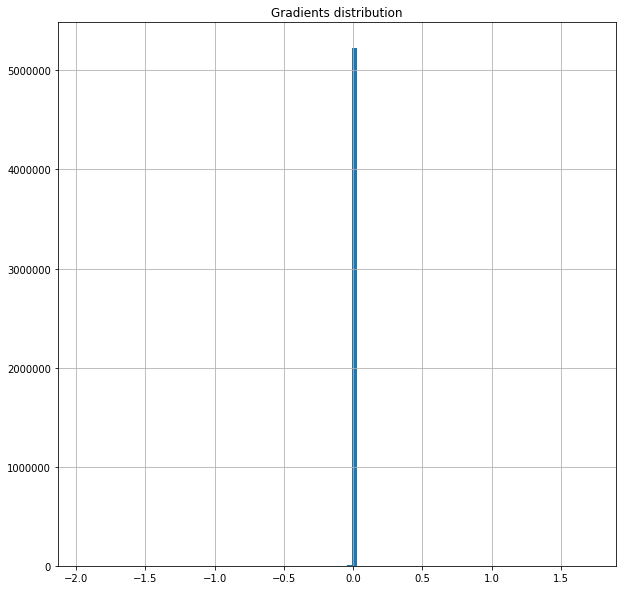

On iter 5191 with training PPL: 62.3703498840332, training ACC 0.2825520932674408
On iter 5192 with training PPL: 69.56794738769531, training ACC 0.2680121660232544
On iter 5193 with training PPL: 66.26657104492188, training ACC 0.2708333432674408
On iter 5194 with training PPL: 69.06241607666016, training ACC 0.2684461772441864
On iter 5195 with training PPL: 67.10261535644531, training ACC 0.2671440839767456
On iter 5196 with training PPL: 64.76648712158203, training ACC 0.2884114682674408
On iter 5197 with training PPL: 59.36696243286133, training ACC 0.2881944477558136
On iter 5198 with training PPL: 71.82913208007812, training ACC 0.2649739682674408
On iter 5199 with training PPL: 66.45652770996094, training ACC 0.2667100727558136
On iter 5200 with training PPL: 66.72381591796875, training ACC 0.2747395932674408
<SS> office fearful that <unk> executives wo n't approve <eos> ms. foster 's <unk> is nothing like the <unk> <unk> <unk> enjoyed by <unk> visitors <eos> nor does it at all

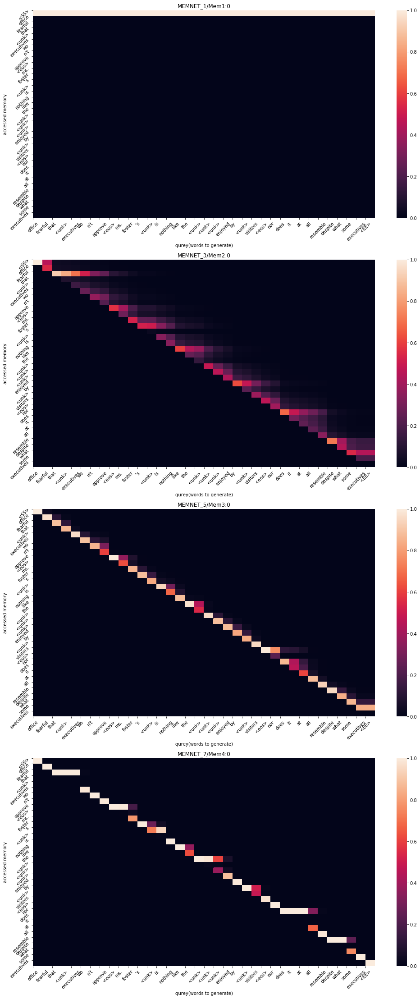

On iter 5201 with training PPL: 66.1653060913086, training ACC 0.2771267294883728
On iter 5202 with training PPL: 67.88980865478516, training ACC 0.2688802182674408
On iter 5203 with training PPL: 67.4864273071289, training ACC 0.2719184160232544
On iter 5204 with training PPL: 62.393104553222656, training ACC 0.2788628339767456
On iter 5205 with training PPL: 70.3877182006836, training ACC 0.27734375
On iter 5206 with training PPL: 65.64442443847656, training ACC 0.2730034589767456
On iter 5207 with training PPL: 67.23822784423828, training ACC 0.267578125
On iter 5208 with training PPL: 68.48135375976562, training ACC 0.2669270932674408
On iter 5209 with training PPL: 63.37344741821289, training ACC 0.2771267294883728
On iter 5210 with training PPL: 75.28079986572266, training ACC 0.2582465410232544
On iter 5211 with training PPL: 68.74020385742188, training ACC 0.26953125
On iter 5212 with training PPL: 69.49954223632812, training ACC 0.2623697817325592
On iter 5213 with training PP

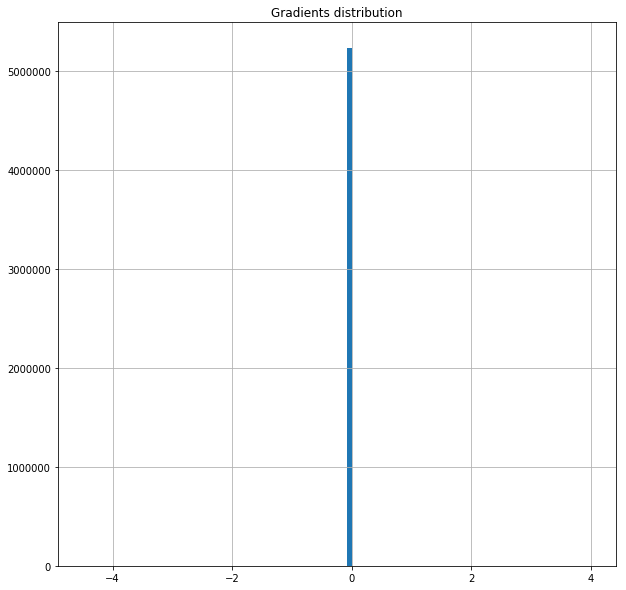

On iter 5221 with training PPL: 62.99758529663086, training ACC 0.2775607705116272
On iter 5222 with training PPL: 67.11429595947266, training ACC 0.2690972089767456
On iter 5223 with training PPL: 60.37355041503906, training ACC 0.2816840410232544
On iter 5224 with training PPL: 68.11913299560547, training ACC 0.259765625
On iter 5225 with training PPL: 64.66092681884766, training ACC 0.2732204794883728
On iter 5226 with training PPL: 66.76946258544922, training ACC 0.2764756977558136
On iter 5227 with training PPL: 75.06758880615234, training ACC 0.2727864682674408
On iter 5228 with training PPL: 64.04759216308594, training ACC 0.2756076455116272
On iter 5229 with training PPL: 69.88316345214844, training ACC 0.2706163227558136
On iter 5230 with training PPL: 63.89988708496094, training ACC 0.2717013955116272
On iter 5231 with training PPL: 66.32827758789062, training ACC 0.2625868022441864
On iter 5232 with training PPL: 70.60807037353516, training ACC 0.2719184160232544
On iter 523

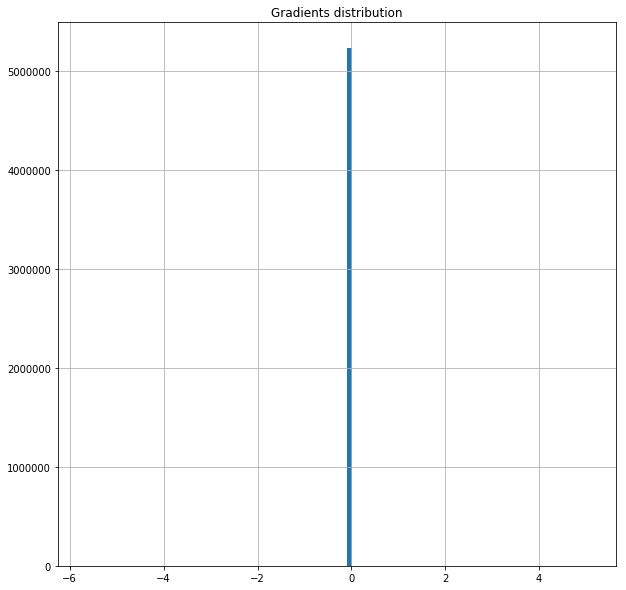

On iter 5251 with training PPL: 63.86872863769531, training ACC 0.2805989682674408
On iter 5252 with training PPL: 64.40677642822266, training ACC 0.2758246660232544
On iter 5253 with training PPL: 66.61500549316406, training ACC 0.2717013955116272
On iter 5254 with training PPL: 64.2225570678711, training ACC 0.2842881977558136
On iter 5255 with training PPL: 70.1384506225586, training ACC 0.2690972089767456
On iter 5256 with training PPL: 66.95000457763672, training ACC 0.2701822817325592
On iter 5257 with training PPL: 67.32513427734375, training ACC 0.2740885317325592
On iter 5258 with training PPL: 67.26904296875, training ACC 0.2654079794883728
On iter 5259 with training PPL: 73.04917907714844, training ACC 0.2593315839767456
On iter 5260 with training PPL: 68.89998626708984, training ACC 0.2805989682674408
On iter 5261 with training PPL: 66.73845672607422, training ACC 0.2697482705116272
On iter 5262 with training PPL: 59.78130340576172, training ACC 0.2890625
On iter 5263 with 

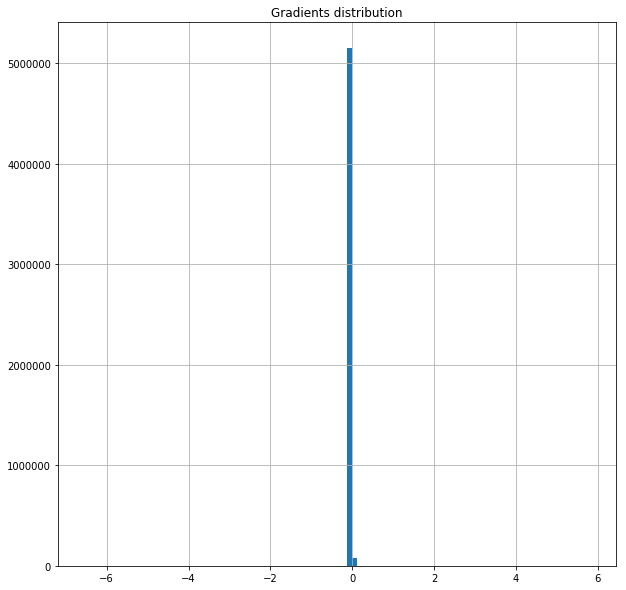

On iter 5281 with training PPL: 66.4677734375, training ACC 0.2766927182674408
On iter 5282 with training PPL: 70.88973236083984, training ACC 0.2586805522441864
On iter 5283 with training PPL: 73.26242065429688, training ACC 0.2610677182674408
On iter 5284 with training PPL: 65.66753387451172, training ACC 0.2730034589767456
On iter 5285 with training PPL: 64.17727661132812, training ACC 0.2645399272441864
On iter 5286 with training PPL: 60.987159729003906, training ACC 0.2795138955116272
On iter 5287 with training PPL: 61.422950744628906, training ACC 0.2740885317325592
On iter 5288 with training PPL: 61.018959045410156, training ACC 0.2838541567325592
On iter 5289 with training PPL: 65.80670928955078, training ACC 0.2771267294883728
On iter 5290 with training PPL: 63.646060943603516, training ACC 0.2730034589767456
On iter 5291 with training PPL: 69.96061706542969, training ACC 0.2649739682674408
On iter 5292 with training PPL: 71.40355682373047, training ACC 0.2697482705116272
On i

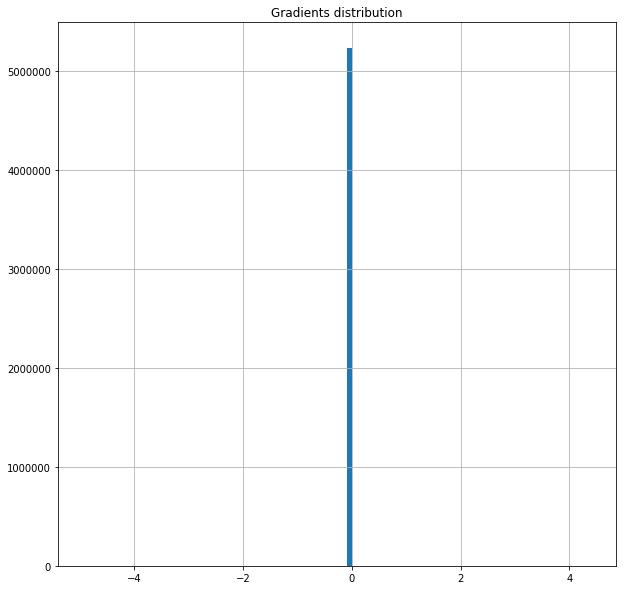

On iter 5311 with training PPL: 67.13798522949219, training ACC 0.26953125
On iter 5312 with training PPL: 60.95302963256836, training ACC 0.2823350727558136
On iter 5313 with training PPL: 66.02947235107422, training ACC 0.2803819477558136
On iter 5314 with training PPL: 65.75273132324219, training ACC 0.2710503339767456
On iter 5315 with training PPL: 61.08340835571289, training ACC 0.2879774272441864
On iter 5316 with training PPL: 65.01070404052734, training ACC 0.2784288227558136
On iter 5317 with training PPL: 66.90797424316406, training ACC 0.2727864682674408
On iter 5318 with training PPL: 67.99488067626953, training ACC 0.2654079794883728
On iter 5319 with training PPL: 65.53781127929688, training ACC 0.2697482705116272
On iter 5320 with training PPL: 68.44390869140625, training ACC 0.2736545205116272
On iter 5321 with training PPL: 62.562801361083984, training ACC 0.2799479067325592
On iter 5322 with training PPL: 64.71098327636719, training ACC 0.2669270932674408
On iter 532

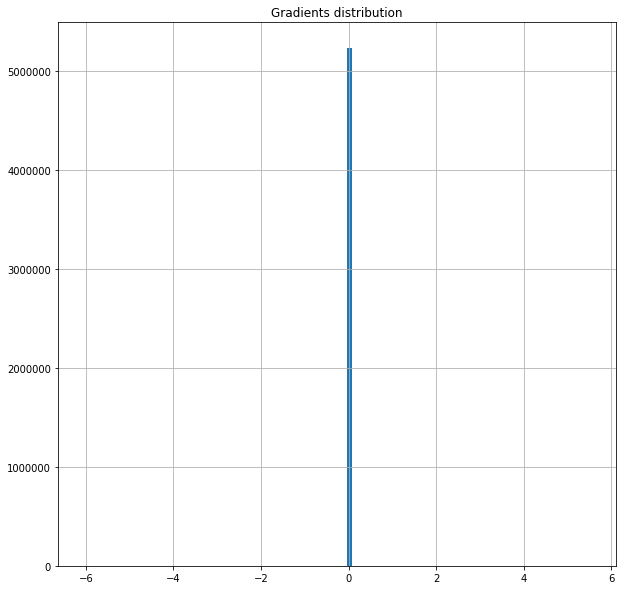

On iter 5341 with training PPL: 64.98733520507812, training ACC 0.2690972089767456
On iter 5342 with training PPL: 70.3399429321289, training ACC 0.2630208432674408
On iter 5343 with training PPL: 70.00900268554688, training ACC 0.26171875
On iter 5344 with training PPL: 69.88153076171875, training ACC 0.2738715410232544
On iter 5345 with training PPL: 62.61640167236328, training ACC 0.2903645932674408
On iter 5346 with training PPL: 68.393310546875, training ACC 0.2623697817325592
On iter 5347 with training PPL: 69.47286987304688, training ACC 0.2671440839767456
On iter 5348 with training PPL: 69.79601287841797, training ACC 0.2756076455116272
On iter 5349 with training PPL: 65.55062103271484, training ACC 0.2651909589767456
On iter 5350 with training PPL: 68.26441955566406, training ACC 0.2717013955116272
On iter 5351 with training PPL: 65.14286804199219, training ACC 0.2723524272441864
On iter 5352 with training PPL: 63.89519500732422, training ACC 0.2751736044883728
On iter 5353 wi

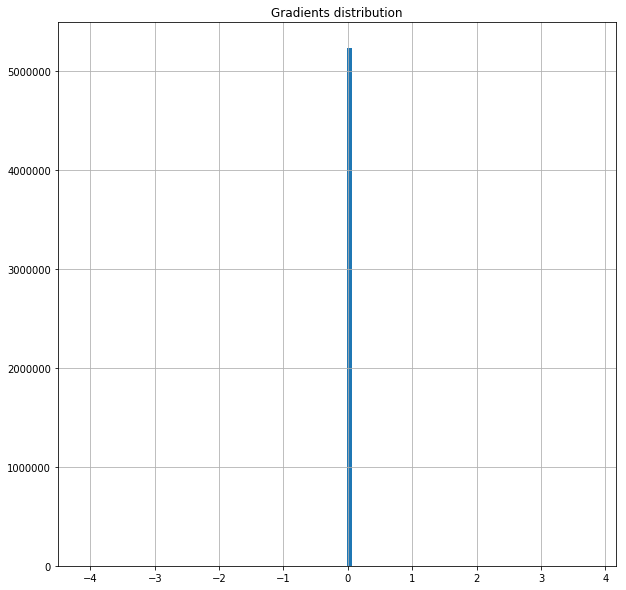

On iter 5371 with training PPL: 59.4482307434082, training ACC 0.2821180522441864
On iter 5372 with training PPL: 64.51863098144531, training ACC 0.2779947817325592
On iter 5373 with training PPL: 65.71229553222656, training ACC 0.2658420205116272
On iter 5374 with training PPL: 72.07502746582031, training ACC 0.2595486044883728
On iter 5375 with training PPL: 68.43245697021484, training ACC 0.2725694477558136
On iter 5376 with training PPL: 69.45687103271484, training ACC 0.2701822817325592
On iter 5377 with training PPL: 65.31216430664062, training ACC 0.2673611044883728
On iter 5378 with training PPL: 65.03272247314453, training ACC 0.2786458432674408
On iter 5379 with training PPL: 58.66862869262695, training ACC 0.2873263955116272
On iter 5380 with training PPL: 65.35562133789062, training ACC 0.2838541567325592
On iter 5381 with training PPL: 58.056880950927734, training ACC 0.2899305522441864
On iter 5382 with training PPL: 64.062744140625, training ACC 0.2736545205116272
On ite

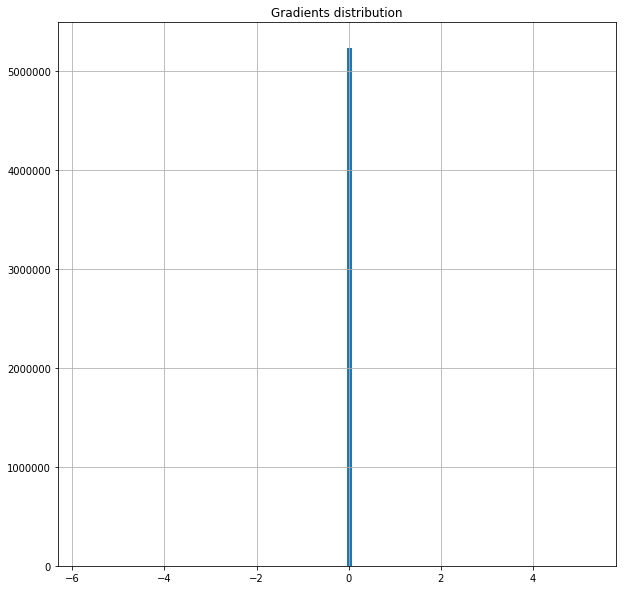

<SS> on N million shares and american telephone & telegraph rose N N to N on nearly N million shares <eos> shares of international business machines which reported earnings yesterday finished at N up N after <EE>


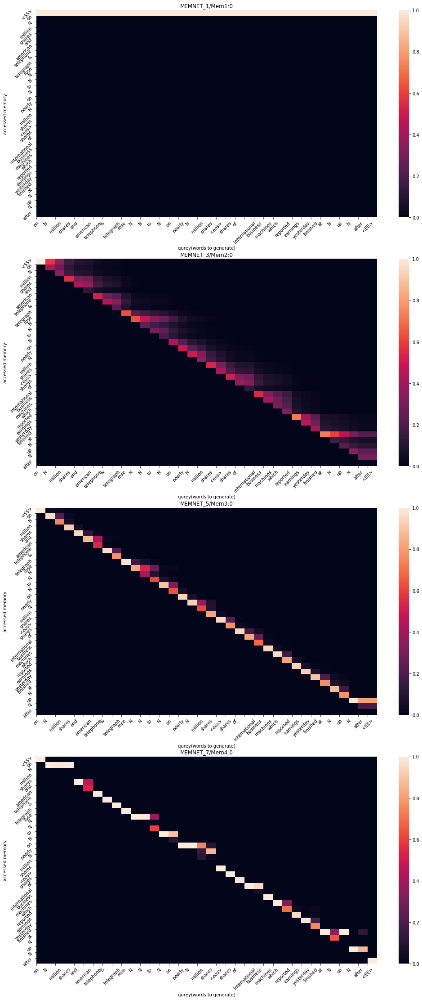

On iter 5401 with training PPL: 71.61670684814453, training ACC 0.2658420205116272
On iter 5402 with training PPL: 62.491539001464844, training ACC 0.2840711772441864
On iter 5403 with training PPL: 63.92616271972656, training ACC 0.2797309160232544
On iter 5404 with training PPL: 71.53892517089844, training ACC 0.2604166567325592
On iter 5405 with training PPL: 65.65591430664062, training ACC 0.275390625
On iter 5406 with training PPL: 62.50695037841797, training ACC 0.2693142294883728
On iter 5407 with training PPL: 60.72113037109375, training ACC 0.2788628339767456
On iter 5408 with training PPL: 58.11036682128906, training ACC 0.2884114682674408
On iter 5409 with training PPL: 62.57834243774414, training ACC 0.2847222089767456
On iter 5410 with training PPL: 61.87745666503906, training ACC 0.2836371660232544
On iter 5411 with training PPL: 59.423744201660156, training ACC 0.27734375
On iter 5412 with training PPL: 59.35294723510742, training ACC 0.2864583432674408
On iter 5413 with

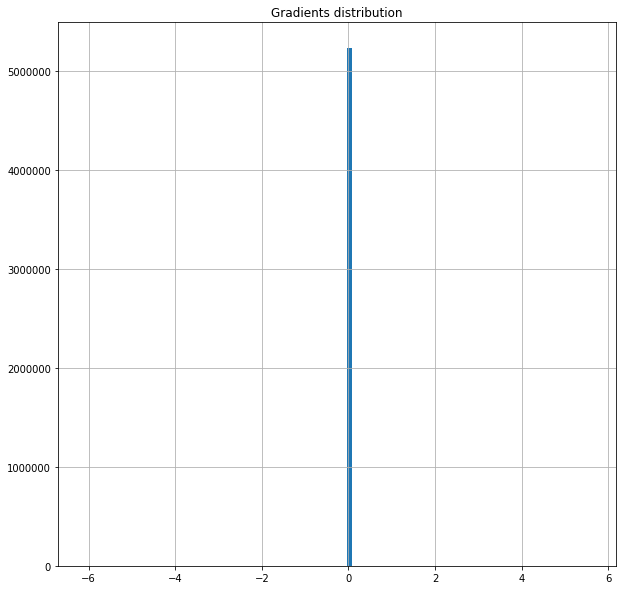

On iter 5431 with training PPL: 65.36820983886719, training ACC 0.2819010317325592
On iter 5432 with training PPL: 65.27803802490234, training ACC 0.2795138955116272
On iter 5433 with training PPL: 60.51154708862305, training ACC 0.2879774272441864
On iter 5434 with training PPL: 68.53365325927734, training ACC 0.275390625
On iter 5435 with training PPL: 60.600772857666016, training ACC 0.2766927182674408
On iter 5436 with training PPL: 61.80427169799805, training ACC 0.2888454794883728
On iter 5437 with training PPL: 64.70814514160156, training ACC 0.28125
On iter 5438 with training PPL: 58.8951301574707, training ACC 0.2858072817325592
On iter 5439 with training PPL: 77.85071563720703, training ACC 0.2580295205116272
On iter 5440 with training PPL: 58.012855529785156, training ACC 0.2873263955116272
On iter 5441 with training PPL: 63.12372970581055, training ACC 0.2805989682674408
On iter 5442 with training PPL: 68.39360046386719, training ACC 0.2710503339767456
On iter 5443 with tra

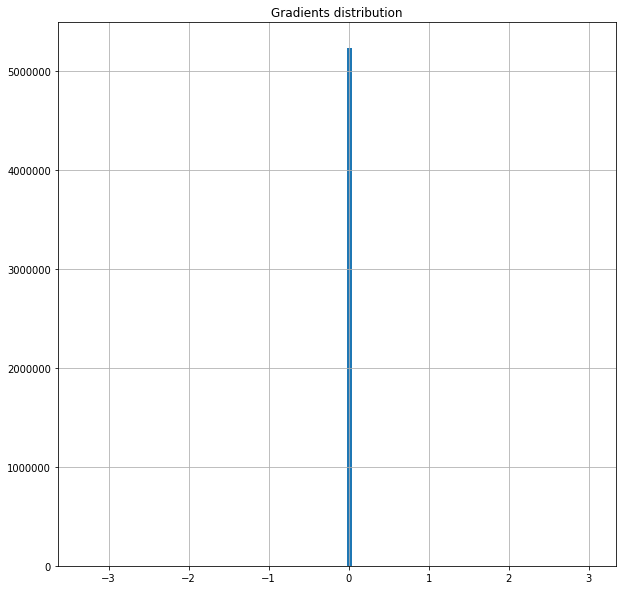

On iter 5461 with training PPL: 69.99785614013672, training ACC 0.2712673544883728
On iter 5462 with training PPL: 63.367069244384766, training ACC 0.2799479067325592
On iter 5463 with training PPL: 69.67330932617188, training ACC 0.2612847089767456
On iter 5464 with training PPL: 63.671592712402344, training ACC 0.2688802182674408
On iter 5465 with training PPL: 64.0942153930664, training ACC 0.275390625
On iter 5466 with training PPL: 65.5685043334961, training ACC 0.2747395932674408
On iter 5467 with training PPL: 63.34746551513672, training ACC 0.279296875
On iter 5468 with training PPL: 58.4049072265625, training ACC 0.2823350727558136
On iter 5469 with training PPL: 60.972129821777344, training ACC 0.2827690839767456
On iter 5470 with training PPL: 70.83948516845703, training ACC 0.2578125
On iter 5471 with training PPL: 61.502052307128906, training ACC 0.2769097089767456
On iter 5472 with training PPL: 66.88624572753906, training ACC 0.2779947817325592
On iter 5473 with training

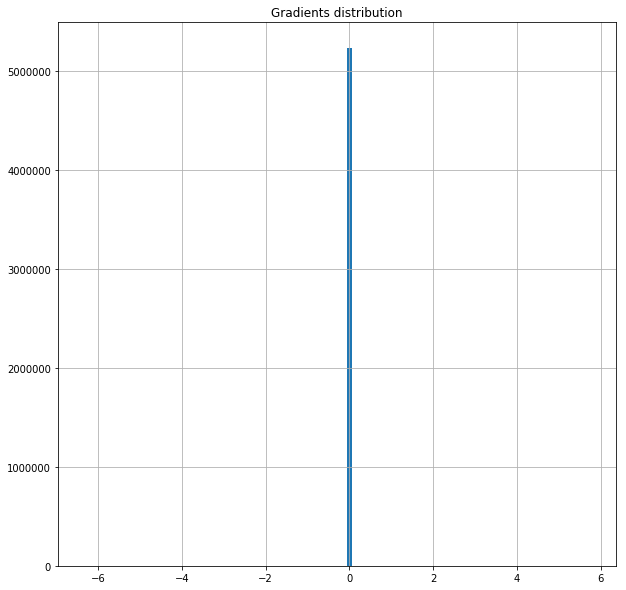

On iter 5491 with training PPL: 60.23417282104492, training ACC 0.2777777910232544
On iter 5492 with training PPL: 66.619384765625, training ACC 0.2749565839767456
On iter 5493 with training PPL: 62.08472442626953, training ACC 0.2829861044883728
On iter 5494 with training PPL: 69.13104248046875, training ACC 0.2621527910232544
On iter 5495 with training PPL: 55.6799430847168, training ACC 0.3003472089767456
On iter 5496 with training PPL: 71.21851348876953, training ACC 0.2588975727558136
On iter 5497 with training PPL: 57.91288375854492, training ACC 0.2873263955116272
On iter 5498 with training PPL: 61.62273406982422, training ACC 0.2805989682674408
On iter 5499 with training PPL: 59.02938461303711, training ACC 0.2816840410232544
On iter 5500 with training PPL: 62.42173385620117, training ACC 0.2775607705116272
On iter 5501 with training PPL: 63.92375183105469, training ACC 0.2840711772441864
On iter 5502 with training PPL: 64.51493835449219, training ACC 0.2749565839767456
On iter

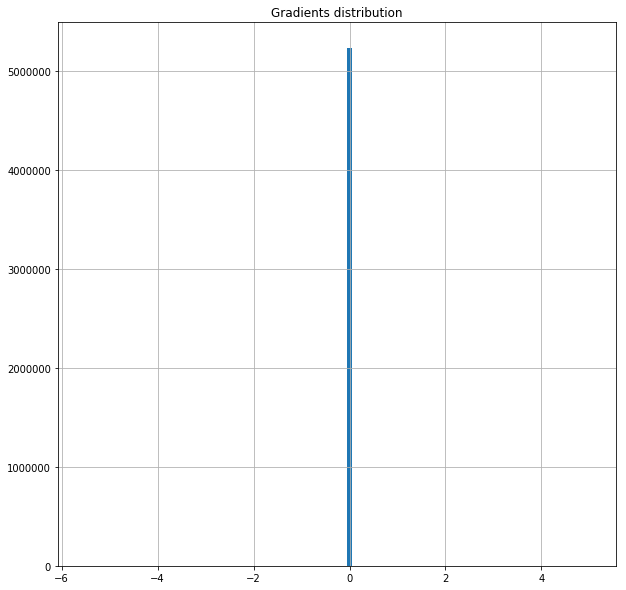

On iter 5521 with training PPL: 62.110721588134766, training ACC 0.2730034589767456
On iter 5522 with training PPL: 67.96259307861328, training ACC 0.2788628339767456
On iter 5523 with training PPL: 67.16170501708984, training ACC 0.2769097089767456
On iter 5524 with training PPL: 64.46485137939453, training ACC 0.2740885317325592
On iter 5525 with training PPL: 62.88551712036133, training ACC 0.2727864682674408
On iter 5526 with training PPL: 66.99231719970703, training ACC 0.2632378339767456
On iter 5527 with training PPL: 67.75444030761719, training ACC 0.2660590410232544
On iter 5528 with training PPL: 58.263465881347656, training ACC 0.2836371660232544
On iter 5529 with training PPL: 56.78768539428711, training ACC 0.283203125
On iter 5530 with training PPL: 62.36348342895508, training ACC 0.2890625
On iter 5531 with training PPL: 56.52099609375, training ACC 0.2901475727558136
On iter 5532 with training PPL: 57.48695373535156, training ACC 0.291015625
On iter 5533 with training P

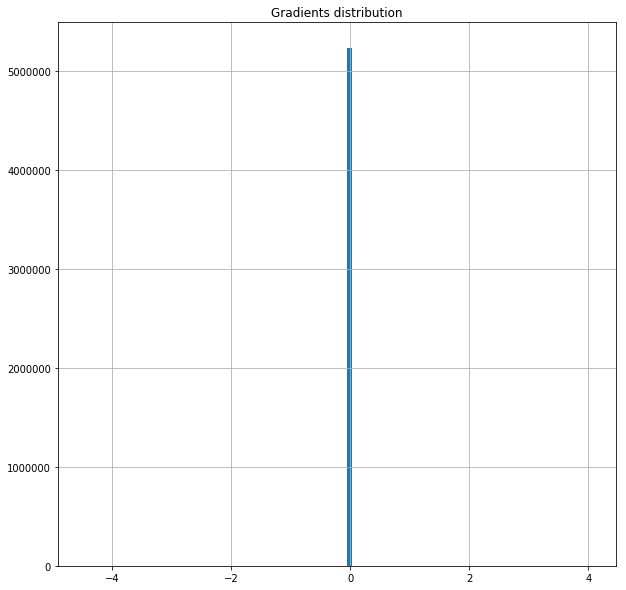

On iter 5551 with training PPL: 61.493045806884766, training ACC 0.2825520932674408
On iter 5552 with training PPL: 67.66580963134766, training ACC 0.2560763955116272
On iter 5553 with training PPL: 59.71136474609375, training ACC 0.2847222089767456
On iter 5554 with training PPL: 66.25869750976562, training ACC 0.26953125
On iter 5555 with training PPL: 59.10041427612305, training ACC 0.27734375
On iter 5556 with training PPL: 65.52581024169922, training ACC 0.2628038227558136
On iter 5557 with training PPL: 73.9345474243164, training ACC 0.2580295205116272
On iter 5558 with training PPL: 62.50686264038086, training ACC 0.2788628339767456
On iter 5559 with training PPL: 57.46281051635742, training ACC 0.2921006977558136
On iter 5560 with training PPL: 67.83673858642578, training ACC 0.2647569477558136
On iter 5561 with training PPL: 62.99398422241211, training ACC 0.2747395932674408
On iter 5562 with training PPL: 59.33506393432617, training ACC 0.2912326455116272
On iter 5563 with tr

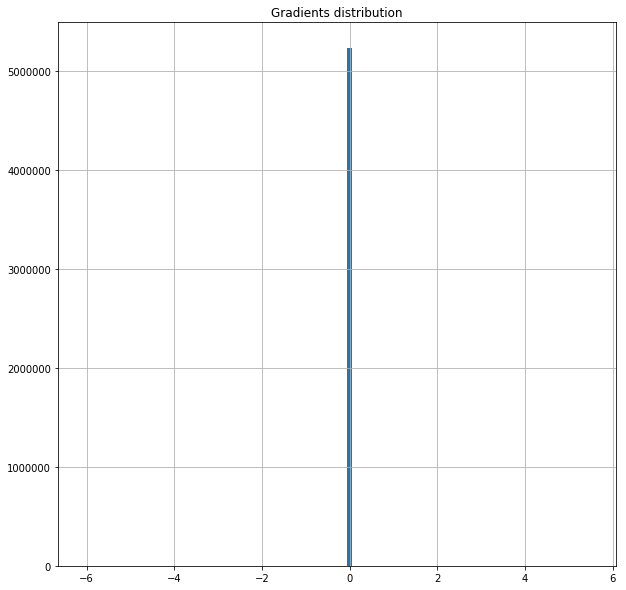

On iter 5581 with training PPL: 63.94758987426758, training ACC 0.265625
On iter 5582 with training PPL: 63.36208724975586, training ACC 0.2732204794883728
On iter 5583 with training PPL: 55.107139587402344, training ACC 0.3018663227558136
On iter 5584 with training PPL: 69.15531158447266, training ACC 0.2654079794883728
On iter 5585 with training PPL: 60.44951629638672, training ACC 0.2736545205116272
On iter 5586 with training PPL: 62.74749755859375, training ACC 0.279296875
On iter 5587 with training PPL: 63.011077880859375, training ACC 0.2799479067325592
On iter 5588 with training PPL: 67.25098419189453, training ACC 0.2610677182674408
On iter 5589 with training PPL: 61.13478088378906, training ACC 0.2771267294883728
On iter 5590 with training PPL: 55.63140106201172, training ACC 0.29296875
On iter 5591 with training PPL: 65.1330795288086, training ACC 0.2730034589767456
On iter 5592 with training PPL: 65.38748168945312, training ACC 0.2684461772441864
On iter 5593 with training P

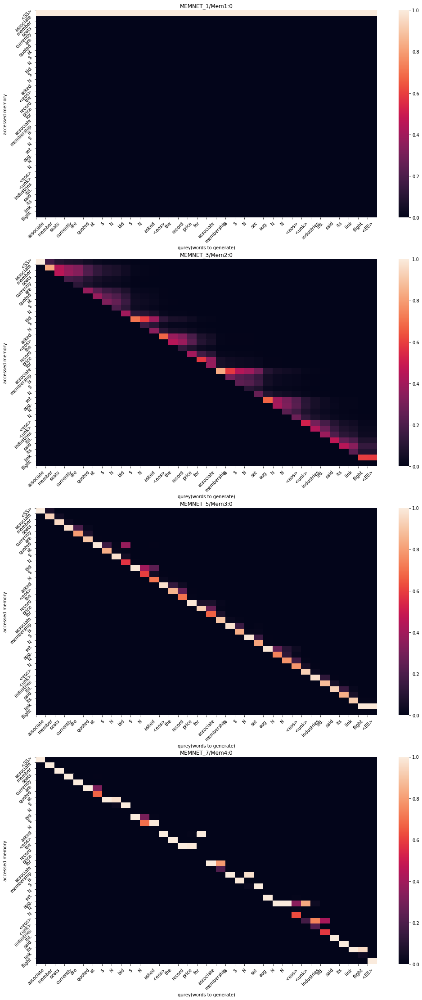

On iter 5601 with training PPL: 60.24198913574219, training ACC 0.2799479067325592
On iter 5602 with training PPL: 64.79524230957031, training ACC 0.2749565839767456
On iter 5603 with training PPL: 60.75582504272461, training ACC 0.2747395932674408
On iter 5604 with training PPL: 60.30757522583008, training ACC 0.2899305522441864
On iter 5605 with training PPL: 65.84258270263672, training ACC 0.2736545205116272
On iter 5606 with training PPL: 59.16092300415039, training ACC 0.2907986044883728
On iter 5607 with training PPL: 63.02096176147461, training ACC 0.2727864682674408
On iter 5608 with training PPL: 56.931217193603516, training ACC 0.2819010317325592
On iter 5609 with training PPL: 58.35555648803711, training ACC 0.2799479067325592
On iter 5610 with training PPL: 60.88111114501953, training ACC 0.2805989682674408
	 validation PPL 175.92550659179688, validation acc 0.2330729216337204
shape of gradients is (5228544,), L2 norm of gradients is 23.235015869140625, details:            

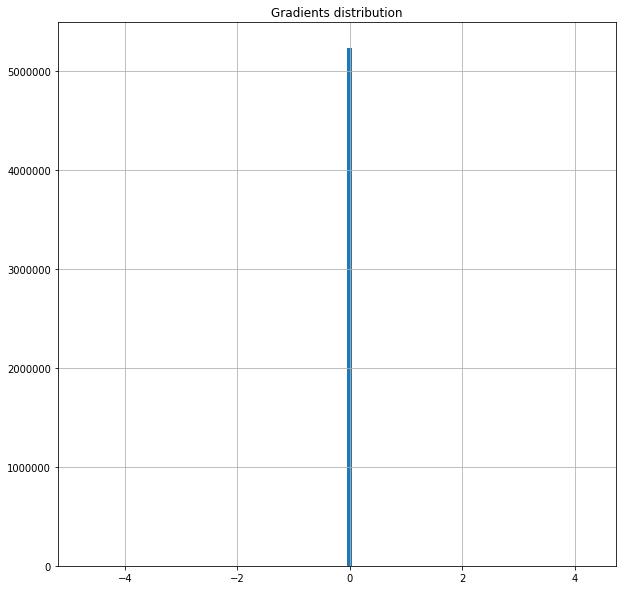

On iter 5611 with training PPL: 64.47303009033203, training ACC 0.2736545205116272
On iter 5612 with training PPL: 69.90532684326172, training ACC 0.2591145932674408
On iter 5613 with training PPL: 63.7989616394043, training ACC 0.2712673544883728
On iter 5614 with training PPL: 66.0016098022461, training ACC 0.2699652910232544
On iter 5615 with training PPL: 64.71131896972656, training ACC 0.2730034589767456
On iter 5616 with training PPL: 65.88803100585938, training ACC 0.2723524272441864
On iter 5617 with training PPL: 60.31290054321289, training ACC 0.2864583432674408
On iter 5618 with training PPL: 63.6361083984375, training ACC 0.2786458432674408
On iter 5619 with training PPL: 65.717529296875, training ACC 0.2638888955116272
On iter 5620 with training PPL: 63.636531829833984, training ACC 0.2667100727558136
On iter 5621 with training PPL: 62.17469787597656, training ACC 0.2786458432674408
On iter 5622 with training PPL: 56.13039779663086, training ACC 0.28515625
On iter 5623 wit

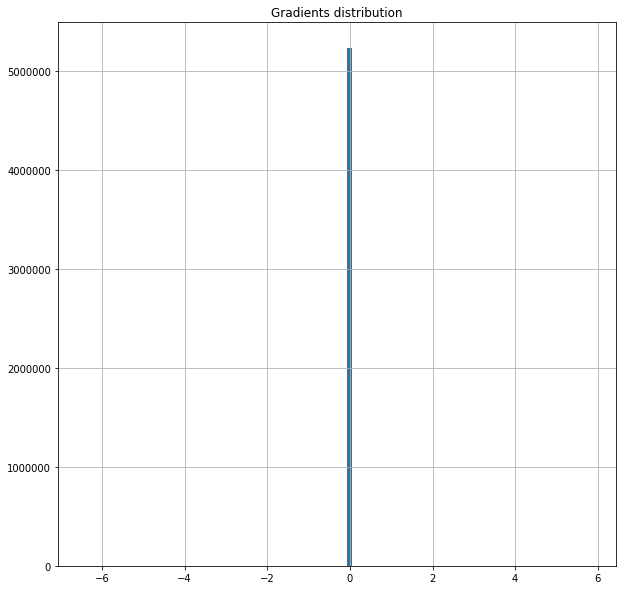

On iter 5641 with training PPL: 53.869441986083984, training ACC 0.3001302182674408
On iter 5642 with training PPL: 62.01055145263672, training ACC 0.28125
On iter 5643 with training PPL: 55.053977966308594, training ACC 0.2992621660232544
On iter 5644 with training PPL: 66.72582244873047, training ACC 0.2654079794883728
On iter 5645 with training PPL: 69.71541595458984, training ACC 0.2684461772441864
On iter 5646 with training PPL: 63.64958190917969, training ACC 0.2699652910232544
On iter 5647 with training PPL: 60.71455764770508, training ACC 0.2730034589767456
On iter 5648 with training PPL: 59.923744201660156, training ACC 0.2801649272441864
On iter 5649 with training PPL: 61.39931869506836, training ACC 0.2760416567325592
On iter 5650 with training PPL: 61.964439392089844, training ACC 0.2892795205116272
On iter 5651 with training PPL: 63.41930389404297, training ACC 0.2775607705116272
On iter 5652 with training PPL: 62.68523406982422, training ACC 0.2805989682674408
On iter 565

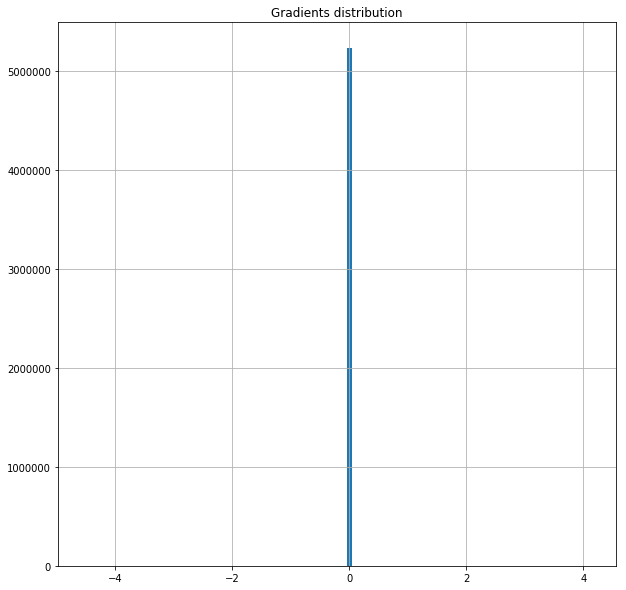

On iter 5671 with training PPL: 63.97623062133789, training ACC 0.279296875
On iter 5672 with training PPL: 62.53604507446289, training ACC 0.2727864682674408
On iter 5673 with training PPL: 61.56364059448242, training ACC 0.2762586772441864
On iter 5674 with training PPL: 59.70450210571289, training ACC 0.2903645932674408
On iter 5675 with training PPL: 62.068946838378906, training ACC 0.2693142294883728
On iter 5676 with training PPL: 65.07962036132812, training ACC 0.2658420205116272
On iter 5677 with training PPL: 62.16550827026367, training ACC 0.2784288227558136
On iter 5678 with training PPL: 65.08201599121094, training ACC 0.2712673544883728
On iter 5679 with training PPL: 64.70076751708984, training ACC 0.2671440839767456
On iter 5680 with training PPL: 58.2618293762207, training ACC 0.2897135317325592
On iter 5681 with training PPL: 62.57771682739258, training ACC 0.2810329794883728
On iter 5682 with training PPL: 57.79679870605469, training ACC 0.2901475727558136
On iter 568

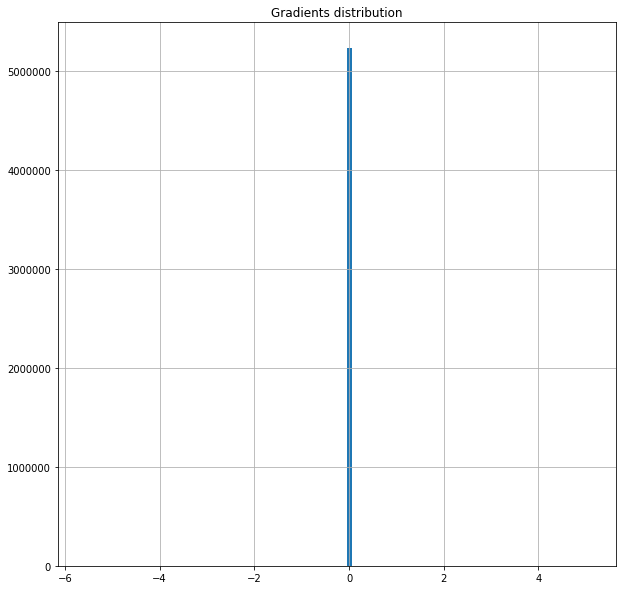

On iter 5701 with training PPL: 66.78824615478516, training ACC 0.2651909589767456
On iter 5702 with training PPL: 69.21436309814453, training ACC 0.2580295205116272
On iter 5703 with training PPL: 62.20079040527344, training ACC 0.2769097089767456
On iter 5704 with training PPL: 60.16152572631836, training ACC 0.2782118022441864
On iter 5705 with training PPL: 55.412296295166016, training ACC 0.3003472089767456
On iter 5706 with training PPL: 65.0157241821289, training ACC 0.2708333432674408
On iter 5707 with training PPL: 60.8302116394043, training ACC 0.2899305522441864
On iter 5708 with training PPL: 61.852291107177734, training ACC 0.2816840410232544
On iter 5709 with training PPL: 60.25724411010742, training ACC 0.283203125
On iter 5710 with training PPL: 58.221168518066406, training ACC 0.2864583432674408
On iter 5711 with training PPL: 65.11041259765625, training ACC 0.2706163227558136
On iter 5712 with training PPL: 65.29786682128906, training ACC 0.2717013955116272
On iter 57

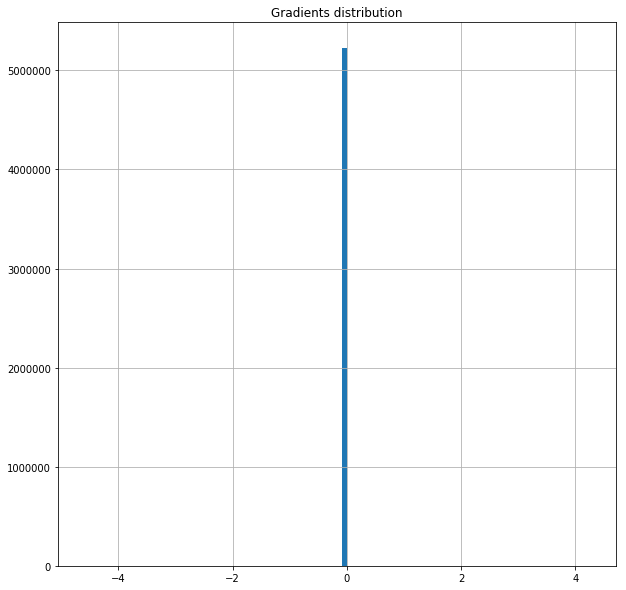

On iter 5731 with training PPL: 62.45180130004883, training ACC 0.2682291567325592
On iter 5732 with training PPL: 62.40578079223633, training ACC 0.2766927182674408
On iter 5733 with training PPL: 62.54191970825195, training ACC 0.2766927182674408
On iter 5734 with training PPL: 60.985679626464844, training ACC 0.28515625
On iter 5735 with training PPL: 63.9019889831543, training ACC 0.2745225727558136
On iter 5736 with training PPL: 61.47964859008789, training ACC 0.2727864682674408
On iter 5737 with training PPL: 60.739662170410156, training ACC 0.2784288227558136
On iter 5738 with training PPL: 61.96027755737305, training ACC 0.2795138955116272
On iter 5739 with training PPL: 59.238155364990234, training ACC 0.2810329794883728
On iter 5740 with training PPL: 63.46135711669922, training ACC 0.2816840410232544
On iter 5741 with training PPL: 60.81124496459961, training ACC 0.2868923544883728
On iter 5742 with training PPL: 62.581687927246094, training ACC 0.2842881977558136
On iter 5

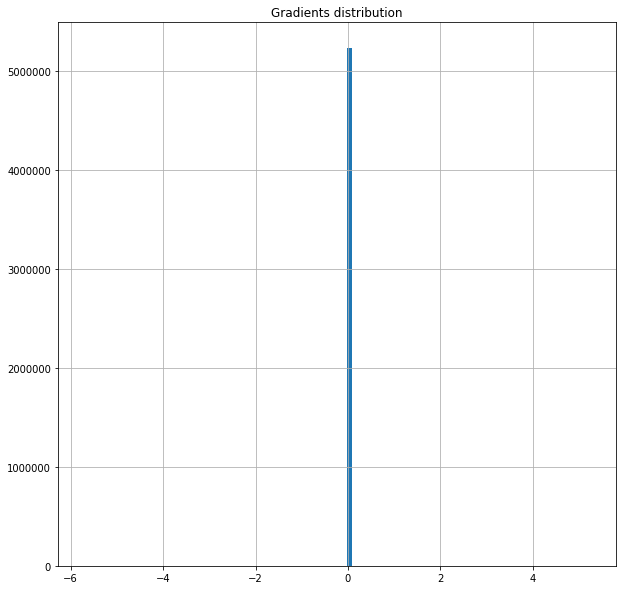

On iter 5761 with training PPL: 59.573204040527344, training ACC 0.2810329794883728
On iter 5762 with training PPL: 59.82033920288086, training ACC 0.2732204794883728
On iter 5763 with training PPL: 57.31657028198242, training ACC 0.283203125
On iter 5764 with training PPL: 61.24308776855469, training ACC 0.2890625
On iter 5765 with training PPL: 57.687164306640625, training ACC 0.2884114682674408
On iter 5766 with training PPL: 53.92331314086914, training ACC 0.2894965410232544
On iter 5767 with training PPL: 58.07294464111328, training ACC 0.2973090410232544
On iter 5768 with training PPL: 67.75886535644531, training ACC 0.2649739682674408
On iter 5769 with training PPL: 57.45097351074219, training ACC 0.2907986044883728
On iter 5770 with training PPL: 64.93622589111328, training ACC 0.2725694477558136
On iter 5771 with training PPL: 56.03607940673828, training ACC 0.2860243022441864
On iter 5772 with training PPL: 59.98012161254883, training ACC 0.296875
On iter 5773 with training P

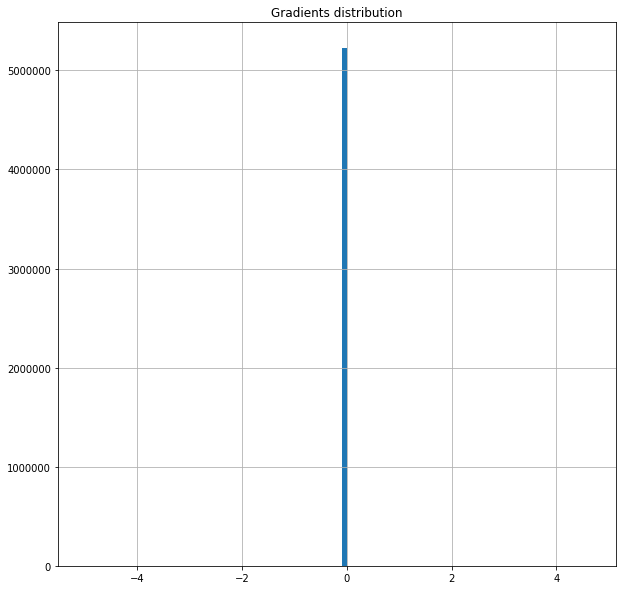

On iter 5791 with training PPL: 68.46581268310547, training ACC 0.2673611044883728
On iter 5792 with training PPL: 62.28932571411133, training ACC 0.2708333432674408
On iter 5793 with training PPL: 62.265838623046875, training ACC 0.2819010317325592
On iter 5794 with training PPL: 62.13842010498047, training ACC 0.2749565839767456
On iter 5795 with training PPL: 61.07872009277344, training ACC 0.2853732705116272
On iter 5796 with training PPL: 58.66999816894531, training ACC 0.2862413227558136
On iter 5797 with training PPL: 63.813079833984375, training ACC 0.275390625
On iter 5798 with training PPL: 63.983154296875, training ACC 0.2782118022441864
On iter 5799 with training PPL: 59.92203140258789, training ACC 0.2829861044883728
On iter 5800 with training PPL: 66.24720001220703, training ACC 0.2738715410232544
<SS> way to get business <eos> the two groups have been working together since the late 1970s long before soviet joint ventures were the rage in the west <eos> aeroflot carried 

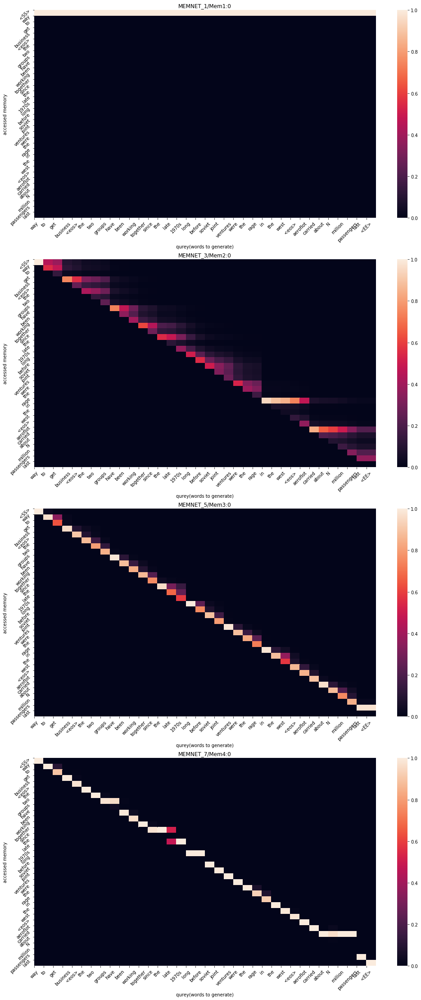

On iter 5801 with training PPL: 63.467891693115234, training ACC 0.283203125
On iter 5802 with training PPL: 70.56791687011719, training ACC 0.2586805522441864
On iter 5803 with training PPL: 60.13912582397461, training ACC 0.2860243022441864
On iter 5804 with training PPL: 65.69976043701172, training ACC 0.2649739682674408
On iter 5805 with training PPL: 63.48114776611328, training ACC 0.2723524272441864
On iter 5806 with training PPL: 55.405372619628906, training ACC 0.2905815839767456
On iter 5807 with training PPL: 64.87423706054688, training ACC 0.2740885317325592
On iter 5808 with training PPL: 55.73011779785156, training ACC 0.2966579794883728
On iter 5809 with training PPL: 68.5923080444336, training ACC 0.2684461772441864
On iter 5810 with training PPL: 62.12860870361328, training ACC 0.2740885317325592
On iter 5811 with training PPL: 61.82389831542969, training ACC 0.2834201455116272
On iter 5812 with training PPL: 67.51339721679688, training ACC 0.2632378339767456
On iter 58

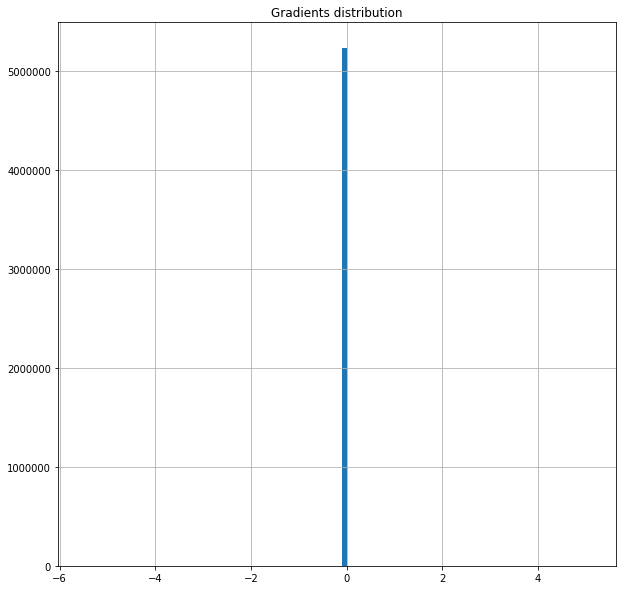

On iter 5821 with training PPL: 59.7517204284668, training ACC 0.2769097089767456
On iter 5822 with training PPL: 64.07781219482422, training ACC 0.2762586772441864
On iter 5823 with training PPL: 58.510108947753906, training ACC 0.2797309160232544
On iter 5824 with training PPL: 54.70087432861328, training ACC 0.2951388955116272
On iter 5825 with training PPL: 62.5527458190918, training ACC 0.2745225727558136
On iter 5826 with training PPL: 66.97200775146484, training ACC 0.2643229067325592
On iter 5827 with training PPL: 74.76943969726562, training ACC 0.2595486044883728
On iter 5828 with training PPL: 60.41473388671875, training ACC 0.2845052182674408
On iter 5829 with training PPL: 66.34620666503906, training ACC 0.26171875
On iter 5830 with training PPL: 61.516746520996094, training ACC 0.2734375
On iter 5831 with training PPL: 57.05202102661133, training ACC 0.2912326455116272
On iter 5832 with training PPL: 65.47330474853516, training ACC 0.2751736044883728
On iter 5833 with tra

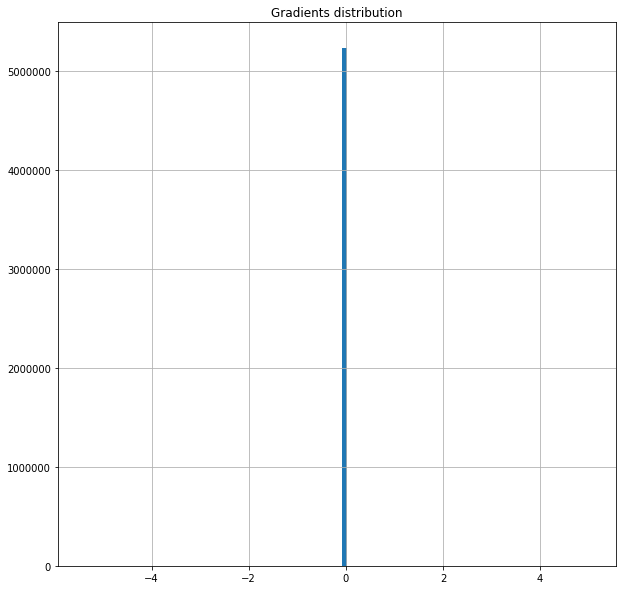

On iter 5851 with training PPL: 59.76317596435547, training ACC 0.2805989682674408
On iter 5852 with training PPL: 59.569793701171875, training ACC 0.2847222089767456
On iter 5853 with training PPL: 53.95881652832031, training ACC 0.2951388955116272
On iter 5854 with training PPL: 66.26428985595703, training ACC 0.2684461772441864
On iter 5855 with training PPL: 66.72932434082031, training ACC 0.2671440839767456
On iter 5856 with training PPL: 57.274654388427734, training ACC 0.2829861044883728
On iter 5857 with training PPL: 63.06869888305664, training ACC 0.2799479067325592
On iter 5858 with training PPL: 61.008018493652344, training ACC 0.2823350727558136
On iter 5859 with training PPL: 59.67273712158203, training ACC 0.2877604067325592
On iter 5860 with training PPL: 65.29011535644531, training ACC 0.2766927182674408
On iter 5861 with training PPL: 68.98207092285156, training ACC 0.2630208432674408
On iter 5862 with training PPL: 56.515499114990234, training ACC 0.2901475727558136


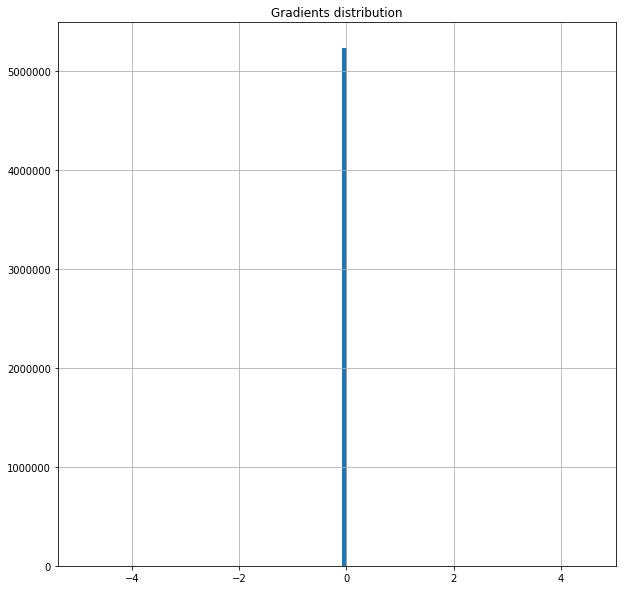

On iter 5881 with training PPL: 67.13670349121094, training ACC 0.2710503339767456
On iter 5882 with training PPL: 66.41607666015625, training ACC 0.2615017294883728
On iter 5883 with training PPL: 61.50741958618164, training ACC 0.2747395932674408
On iter 5884 with training PPL: 59.741695404052734, training ACC 0.2797309160232544
On iter 5885 with training PPL: 64.2750015258789, training ACC 0.2749565839767456
On iter 5886 with training PPL: 52.327964782714844, training ACC 0.3009982705116272
On iter 5887 with training PPL: 62.20509338378906, training ACC 0.2708333432674408
On iter 5888 with training PPL: 58.82204818725586, training ACC 0.2877604067325592
On iter 5889 with training PPL: 55.77214431762695, training ACC 0.2938368022441864
On iter 5890 with training PPL: 60.746612548828125, training ACC 0.2777777910232544
On iter 5891 with training PPL: 58.165557861328125, training ACC 0.2849392294883728
On iter 5892 with training PPL: 55.2424201965332, training ACC 0.2842881977558136
On

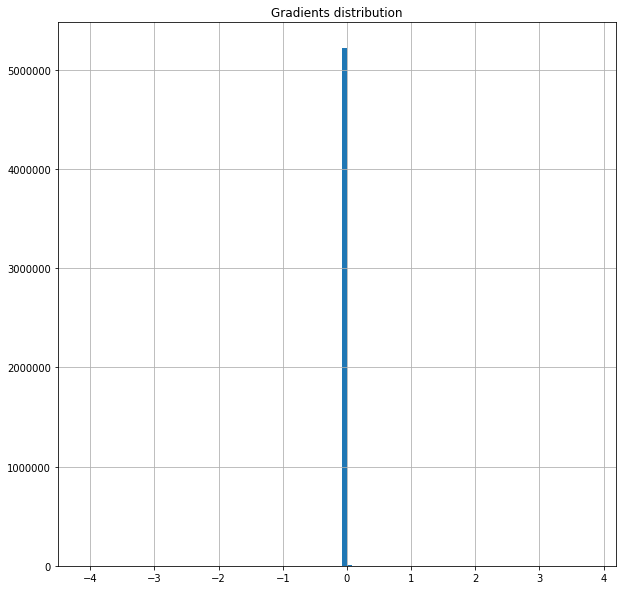

On iter 5911 with training PPL: 58.4006462097168, training ACC 0.2777777910232544
On iter 5912 with training PPL: 58.90670394897461, training ACC 0.2875434160232544
On iter 5913 with training PPL: 58.625030517578125, training ACC 0.2784288227558136
On iter 5914 with training PPL: 62.45233917236328, training ACC 0.2799479067325592
On iter 5915 with training PPL: 56.016258239746094, training ACC 0.2862413227558136
On iter 5916 with training PPL: 55.77009963989258, training ACC 0.28125
On iter 5917 with training PPL: 63.450157165527344, training ACC 0.27734375
On iter 5918 with training PPL: 66.22563171386719, training ACC 0.2736545205116272
On iter 5919 with training PPL: 63.036109924316406, training ACC 0.2736545205116272
On iter 5920 with training PPL: 61.91307830810547, training ACC 0.279296875
On iter 5921 with training PPL: 67.44923400878906, training ACC 0.2615017294883728
On iter 5922 with training PPL: 65.94894409179688, training ACC 0.2730034589767456
On iter 5923 with training 

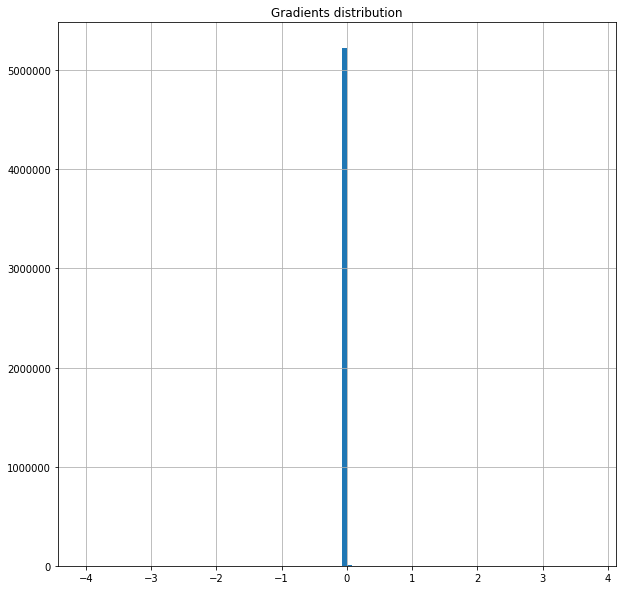

On iter 5941 with training PPL: 65.7113265991211, training ACC 0.2756076455116272
On iter 5942 with training PPL: 54.6197624206543, training ACC 0.2962239682674408
On iter 5943 with training PPL: 63.66044998168945, training ACC 0.2719184160232544
On iter 5944 with training PPL: 58.223114013671875, training ACC 0.2808159589767456
On iter 5945 with training PPL: 60.83951950073242, training ACC 0.2875434160232544
On iter 5946 with training PPL: 63.35704040527344, training ACC 0.2703993022441864
On iter 5947 with training PPL: 70.0488052368164, training ACC 0.2651909589767456
On iter 5948 with training PPL: 57.37333297729492, training ACC 0.287109375
On iter 5949 with training PPL: 55.02379608154297, training ACC 0.2823350727558136
On iter 5950 with training PPL: 59.6810188293457, training ACC 0.2797309160232544
On iter 5951 with training PPL: 61.76328659057617, training ACC 0.2788628339767456
On iter 5952 with training PPL: 64.20228576660156, training ACC 0.2736545205116272
On iter 5953 w

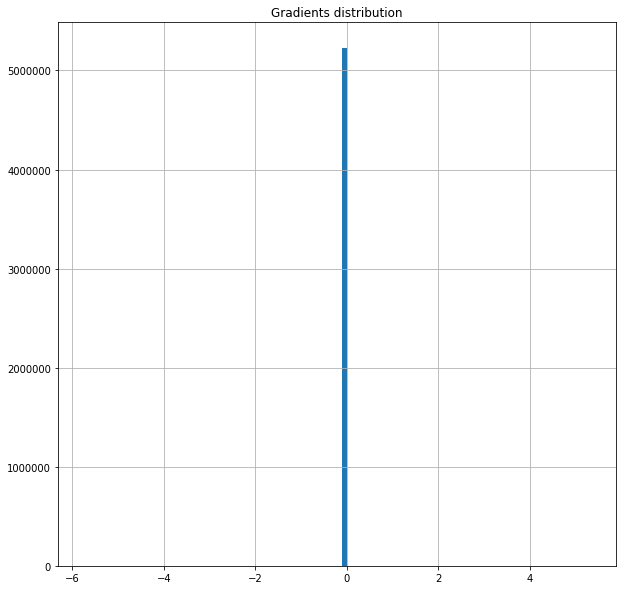

On iter 5971 with training PPL: 65.05845642089844, training ACC 0.2788628339767456
On iter 5972 with training PPL: 52.33657455444336, training ACC 0.3005642294883728
On iter 5973 with training PPL: 60.97715759277344, training ACC 0.2725694477558136
On iter 5974 with training PPL: 63.46446990966797, training ACC 0.2701822817325592
On iter 5975 with training PPL: 61.68675994873047, training ACC 0.275390625
On iter 5976 with training PPL: 58.21472930908203, training ACC 0.2877604067325592
On iter 5977 with training PPL: 61.87807846069336, training ACC 0.2712673544883728
On iter 5978 with training PPL: 56.29153823852539, training ACC 0.2845052182674408
On iter 5979 with training PPL: 54.377201080322266, training ACC 0.2860243022441864
On iter 5980 with training PPL: 59.45537567138672, training ACC 0.2879774272441864
On iter 5981 with training PPL: 59.355892181396484, training ACC 0.2864583432674408
On iter 5982 with training PPL: 60.27115249633789, training ACC 0.2918836772441864
On iter 5

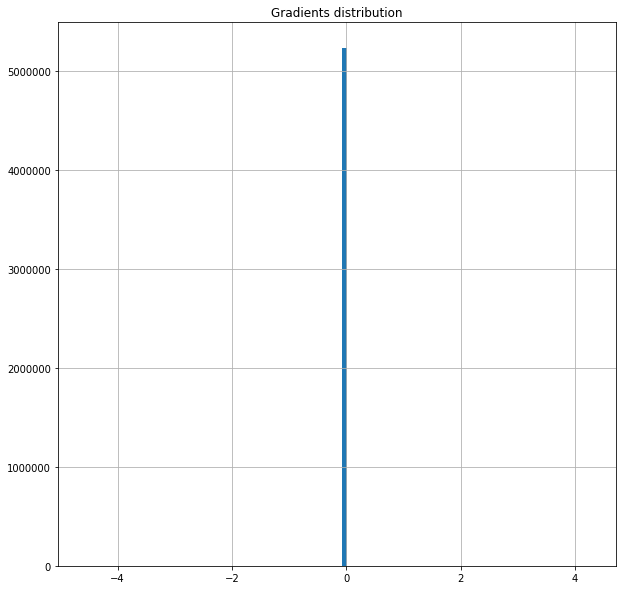

<SS> of traders seemed to get a burst of energy their boss broke out bottles of <unk> water to cool them off <eos> among big board specialists the cry was pull your offers meaning that specialists <EE>


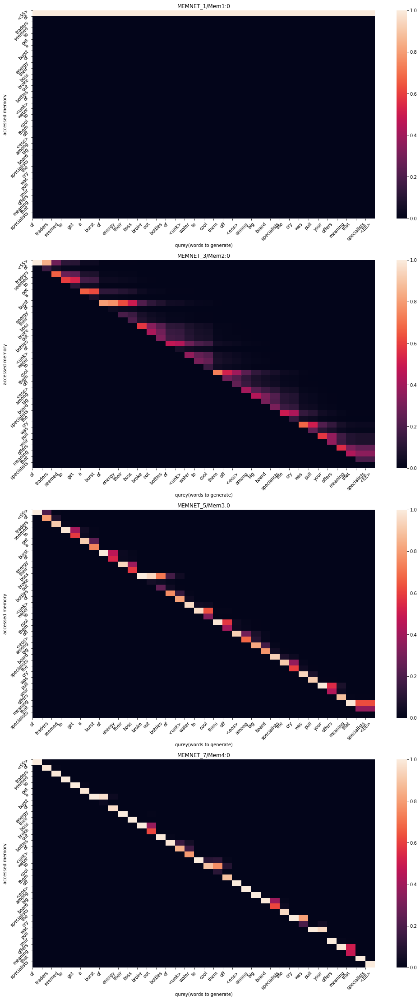

On iter 6001 with training PPL: 57.135135650634766, training ACC 0.2918836772441864
On iter 6002 with training PPL: 62.87532424926758, training ACC 0.2762586772441864
On iter 6003 with training PPL: 60.94733428955078, training ACC 0.2901475727558136
On iter 6004 with training PPL: 57.065948486328125, training ACC 0.2790798544883728
On iter 6005 with training PPL: 60.35544967651367, training ACC 0.2762586772441864
On iter 6006 with training PPL: 63.340248107910156, training ACC 0.2808159589767456
On iter 6007 with training PPL: 62.97241973876953, training ACC 0.2734375
On iter 6008 with training PPL: 58.9117317199707, training ACC 0.2827690839767456
On iter 6009 with training PPL: 53.30549240112305, training ACC 0.2944878339767456
On iter 6010 with training PPL: 52.241455078125, training ACC 0.30078125
On iter 6011 with training PPL: 60.162357330322266, training ACC 0.2795138955116272
On iter 6012 with training PPL: 59.3177490234375, training ACC 0.2918836772441864
On iter 6013 with tra

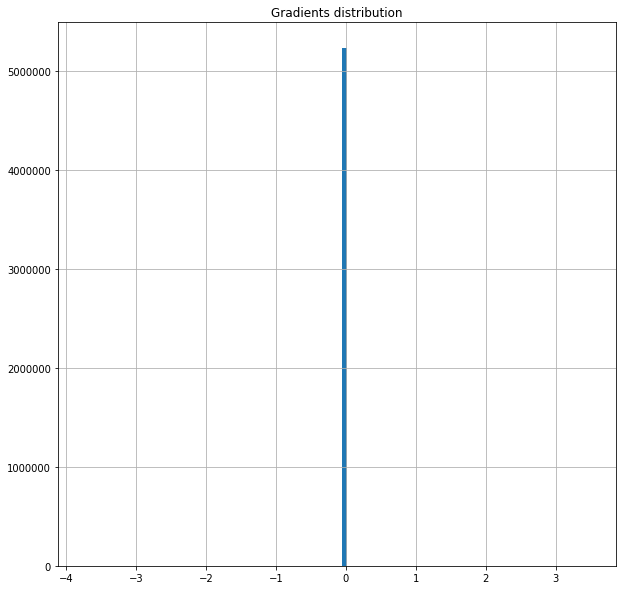

On iter 6031 with training PPL: 61.66929626464844, training ACC 0.2914496660232544
On iter 6032 with training PPL: 60.728458404541016, training ACC 0.2749565839767456
On iter 6033 with training PPL: 58.75499725341797, training ACC 0.2827690839767456
On iter 6034 with training PPL: 54.080787658691406, training ACC 0.2897135317325592
On iter 6035 with training PPL: 59.90891647338867, training ACC 0.2769097089767456
On iter 6036 with training PPL: 60.98591232299805, training ACC 0.2799479067325592
On iter 6037 with training PPL: 60.430782318115234, training ACC 0.2721354067325592
On iter 6038 with training PPL: 56.15382385253906, training ACC 0.2901475727558136
On iter 6039 with training PPL: 64.10760498046875, training ACC 0.2740885317325592
On iter 6040 with training PPL: 53.86053466796875, training ACC 0.2903645932674408
On iter 6041 with training PPL: 56.3887939453125, training ACC 0.2918836772441864
On iter 6042 with training PPL: 58.57439422607422, training ACC 0.2799479067325592
On

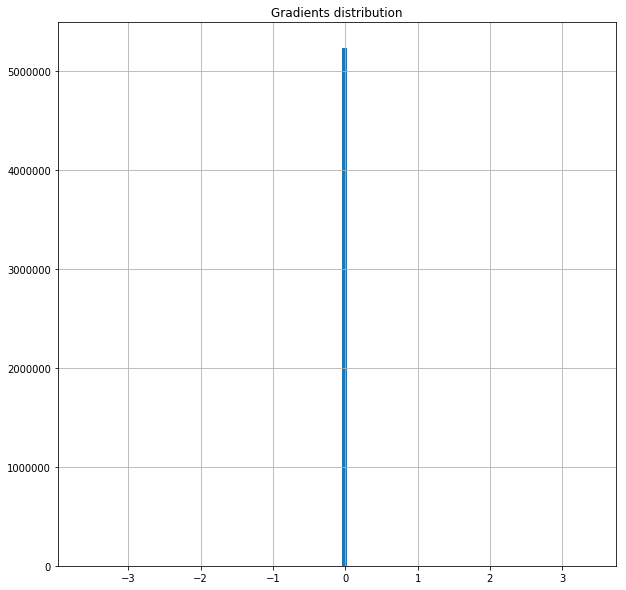

On iter 6061 with training PPL: 56.01513671875, training ACC 0.2890625
On iter 6062 with training PPL: 57.28227615356445, training ACC 0.2886284589767456
On iter 6063 with training PPL: 58.96144485473633, training ACC 0.2862413227558136
On iter 6064 with training PPL: 58.35093688964844, training ACC 0.2873263955116272
On iter 6065 with training PPL: 63.56132507324219, training ACC 0.2747395932674408
On iter 6066 with training PPL: 58.67083740234375, training ACC 0.2864583432674408
On iter 6067 with training PPL: 57.220577239990234, training ACC 0.28515625
On iter 6068 with training PPL: 57.50038528442383, training ACC 0.2834201455116272
On iter 6069 with training PPL: 57.80109786987305, training ACC 0.2849392294883728
On iter 6070 with training PPL: 52.60886764526367, training ACC 0.3014322817325592
On iter 6071 with training PPL: 53.00233459472656, training ACC 0.2983940839767456
On iter 6072 with training PPL: 58.31914138793945, training ACC 0.2884114682674408
On iter 6073 with train

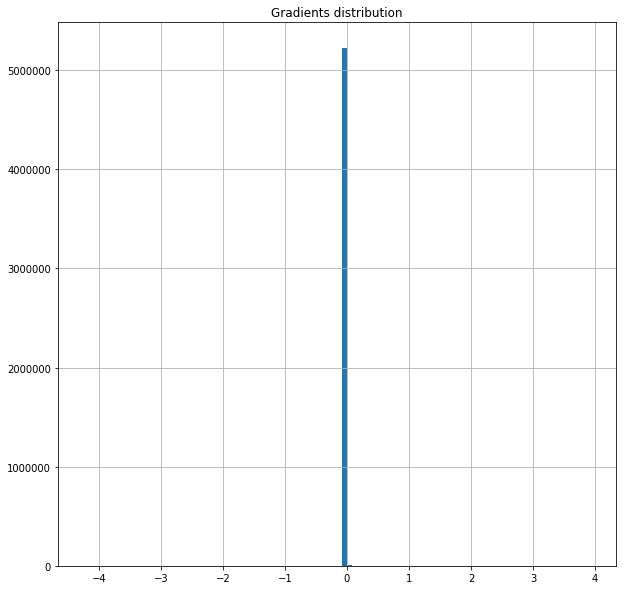

On iter 6091 with training PPL: 62.475868225097656, training ACC 0.2775607705116272
On iter 6092 with training PPL: 63.984344482421875, training ACC 0.2606336772441864
On iter 6093 with training PPL: 59.06370162963867, training ACC 0.2916666567325592
On iter 6094 with training PPL: 68.41085815429688, training ACC 0.2651909589767456
On iter 6095 with training PPL: 61.282440185546875, training ACC 0.2725694477558136
On iter 6096 with training PPL: 60.99504470825195, training ACC 0.2845052182674408
On iter 6097 with training PPL: 60.773616790771484, training ACC 0.2743055522441864
On iter 6098 with training PPL: 53.18863296508789, training ACC 0.3003472089767456
On iter 6099 with training PPL: 62.712318420410156, training ACC 0.2740885317325592
On iter 6100 with training PPL: 62.29425811767578, training ACC 0.2725694477558136
On iter 6101 with training PPL: 56.96117401123047, training ACC 0.2888454794883728
On iter 6102 with training PPL: 56.87790298461914, training ACC 0.2803819477558136

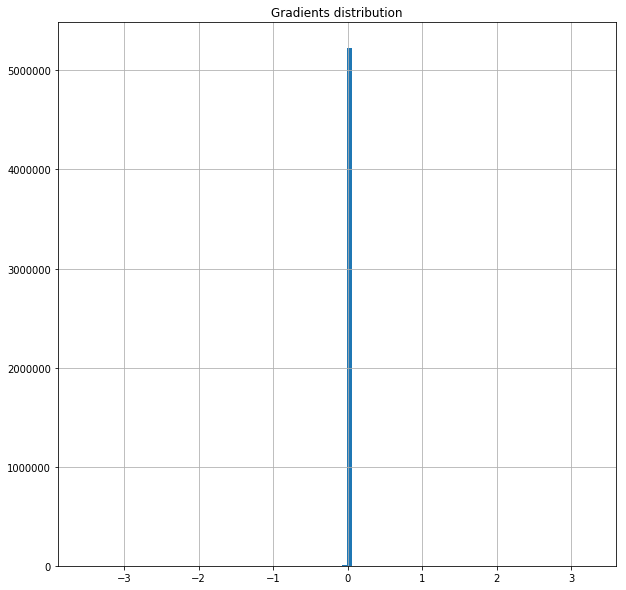

On iter 6121 with training PPL: 59.82758712768555, training ACC 0.2758246660232544
On iter 6122 with training PPL: 61.085391998291016, training ACC 0.2836371660232544
On iter 6123 with training PPL: 62.98569107055664, training ACC 0.2864583432674408
On iter 6124 with training PPL: 56.439632415771484, training ACC 0.2860243022441864
On iter 6125 with training PPL: 56.78557205200195, training ACC 0.2918836772441864
On iter 6126 with training PPL: 64.14891815185547, training ACC 0.2758246660232544
On iter 6127 with training PPL: 56.18829345703125, training ACC 0.2931857705116272
On iter 6128 with training PPL: 60.490196228027344, training ACC 0.2775607705116272
On iter 6129 with training PPL: 59.12713623046875, training ACC 0.2834201455116272
On iter 6130 with training PPL: 56.616615295410156, training ACC 0.2940538227558136
On iter 6131 with training PPL: 63.09297561645508, training ACC 0.263671875
On iter 6132 with training PPL: 56.70683288574219, training ACC 0.2764756977558136
On iter

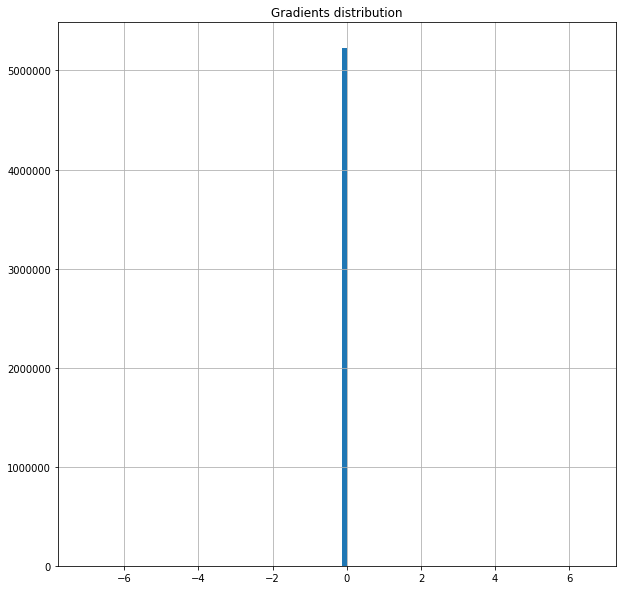

On iter 6151 with training PPL: 58.23824691772461, training ACC 0.2840711772441864
On iter 6152 with training PPL: 61.565399169921875, training ACC 0.2684461772441864
On iter 6153 with training PPL: 57.59601974487305, training ACC 0.2786458432674408
On iter 6154 with training PPL: 56.34256362915039, training ACC 0.2756076455116272
On iter 6155 with training PPL: 57.850120544433594, training ACC 0.2719184160232544
On iter 6156 with training PPL: 57.38326644897461, training ACC 0.2899305522441864
On iter 6157 with training PPL: 55.75760269165039, training ACC 0.2899305522441864
On iter 6158 with training PPL: 61.32114028930664, training ACC 0.2821180522441864
On iter 6159 with training PPL: 67.23726654052734, training ACC 0.2632378339767456
On iter 6160 with training PPL: 59.178558349609375, training ACC 0.2801649272441864
On iter 6161 with training PPL: 57.06883239746094, training ACC 0.2808159589767456
On iter 6162 with training PPL: 64.30314636230469, training ACC 0.2743055522441864
O

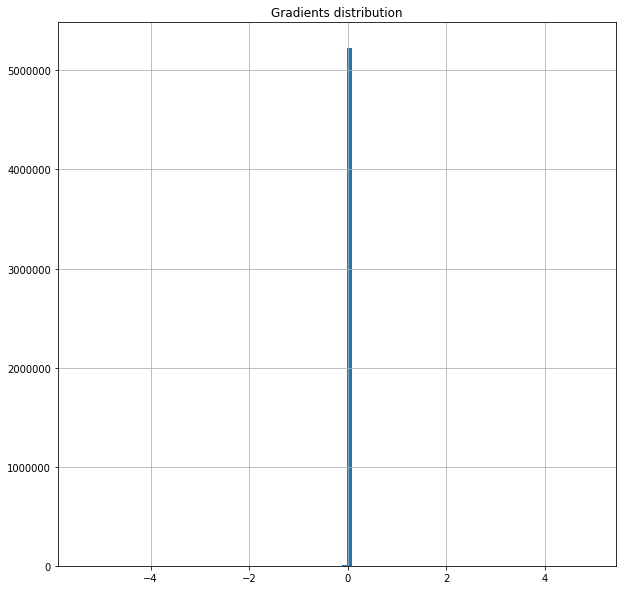

On iter 6181 with training PPL: 56.61872100830078, training ACC 0.283203125
On iter 6182 with training PPL: 56.812522888183594, training ACC 0.2855902910232544
On iter 6183 with training PPL: 60.46770477294922, training ACC 0.28125
On iter 6184 with training PPL: 54.98637008666992, training ACC 0.3005642294883728
On iter 6185 with training PPL: 52.53760528564453, training ACC 0.3068576455116272
On iter 6186 with training PPL: 62.40756607055664, training ACC 0.2801649272441864
On iter 6187 with training PPL: 58.23543930053711, training ACC 0.2805989682674408
On iter 6188 with training PPL: 56.660423278808594, training ACC 0.2899305522441864
On iter 6189 with training PPL: 57.351043701171875, training ACC 0.2842881977558136
On iter 6190 with training PPL: 53.97608947753906, training ACC 0.3075086772441864
On iter 6191 with training PPL: 62.415035247802734, training ACC 0.2730034589767456
On iter 6192 with training PPL: 55.30390930175781, training ACC 0.287109375
On iter 6193 with trainin

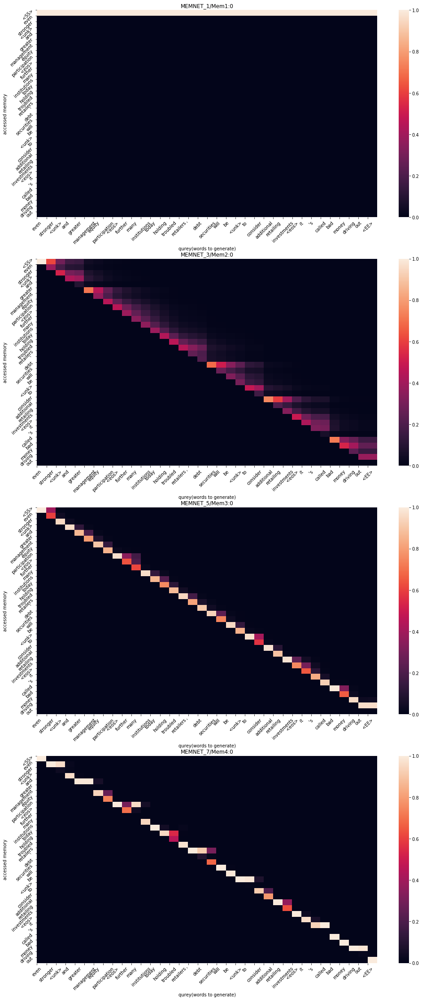

On iter 6201 with training PPL: 59.486907958984375, training ACC 0.2836371660232544
On iter 6202 with training PPL: 64.92294311523438, training ACC 0.2690972089767456
On iter 6203 with training PPL: 56.21045684814453, training ACC 0.2894965410232544
On iter 6204 with training PPL: 62.11928176879883, training ACC 0.2697482705116272
On iter 6205 with training PPL: 58.13788604736328, training ACC 0.2803819477558136
On iter 6206 with training PPL: 52.650962829589844, training ACC 0.2977430522441864
On iter 6207 with training PPL: 57.88249206542969, training ACC 0.2881944477558136
On iter 6208 with training PPL: 63.38432693481445, training ACC 0.2595486044883728
On iter 6209 with training PPL: 57.18787384033203, training ACC 0.2905815839767456
On iter 6210 with training PPL: 56.213348388671875, training ACC 0.2940538227558136
	 validation PPL 161.46087646484375, validation acc 0.2432725727558136
shape of gradients is (5228544,), L2 norm of gradients is 21.947479248046875, details:          

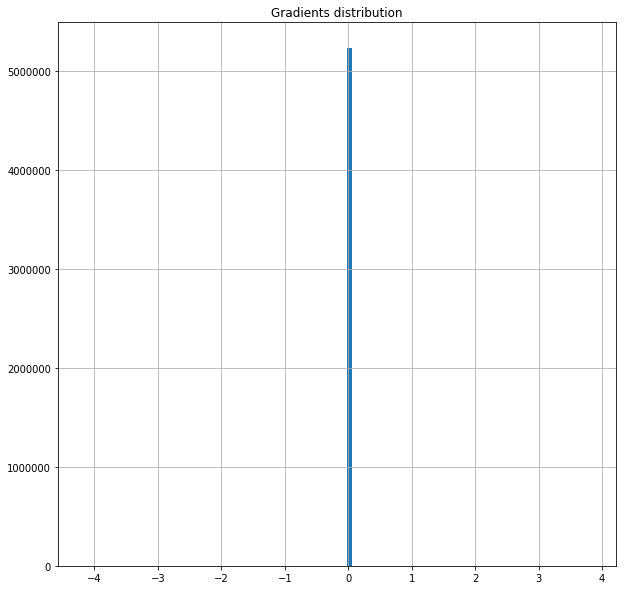

On iter 6211 with training PPL: 59.37307357788086, training ACC 0.279296875
On iter 6212 with training PPL: 51.38556671142578, training ACC 0.2992621660232544
On iter 6213 with training PPL: 57.87355041503906, training ACC 0.2868923544883728
On iter 6214 with training PPL: 58.36943817138672, training ACC 0.2964409589767456
On iter 6215 with training PPL: 62.362945556640625, training ACC 0.2797309160232544
On iter 6216 with training PPL: 61.33894729614258, training ACC 0.2727864682674408
On iter 6217 with training PPL: 61.61500549316406, training ACC 0.2797309160232544
On iter 6218 with training PPL: 54.4964599609375, training ACC 0.2890625
On iter 6219 with training PPL: 61.53440475463867, training ACC 0.2740885317325592
On iter 6220 with training PPL: 56.96152877807617, training ACC 0.2864583432674408
On iter 6221 with training PPL: 62.02690505981445, training ACC 0.2819010317325592
On iter 6222 with training PPL: 54.832359313964844, training ACC 0.296875
On iter 6223 with training PP

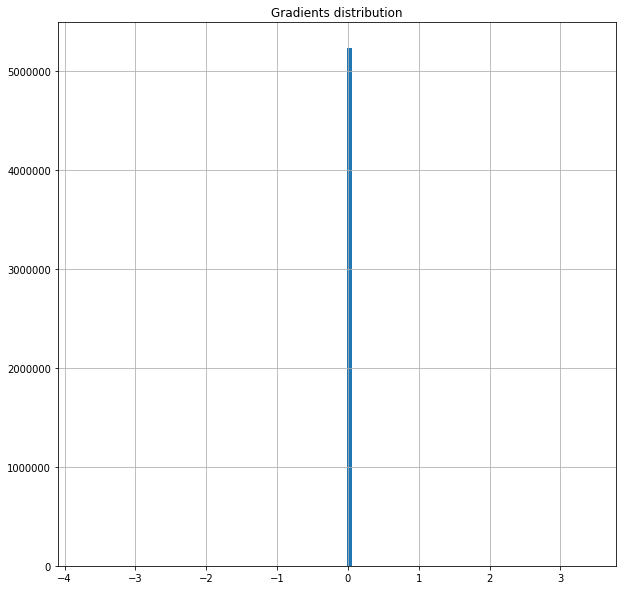

On iter 6241 with training PPL: 56.0911750793457, training ACC 0.2838541567325592
On iter 6242 with training PPL: 58.48676300048828, training ACC 0.2884114682674408
On iter 6243 with training PPL: 59.23041915893555, training ACC 0.2736545205116272
On iter 6244 with training PPL: 57.58734130859375, training ACC 0.2862413227558136
On iter 6245 with training PPL: 55.64612579345703, training ACC 0.2938368022441864
On iter 6246 with training PPL: 63.1591682434082, training ACC 0.2738715410232544
On iter 6247 with training PPL: 59.52152633666992, training ACC 0.2743055522441864
On iter 6248 with training PPL: 56.89406967163086, training ACC 0.2868923544883728
On iter 6249 with training PPL: 62.831295013427734, training ACC 0.2745225727558136
On iter 6250 with training PPL: 60.60791015625, training ACC 0.2836371660232544
On iter 6251 with training PPL: 62.29556655883789, training ACC 0.2797309160232544
On iter 6252 with training PPL: 59.83278274536133, training ACC 0.2862413227558136
On iter 

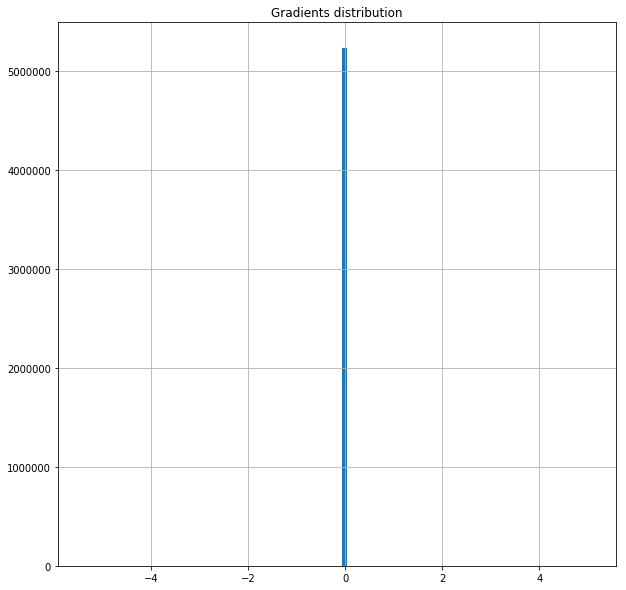

On iter 6271 with training PPL: 60.671119689941406, training ACC 0.2749565839767456
On iter 6272 with training PPL: 59.5483512878418, training ACC 0.279296875
On iter 6273 with training PPL: 53.90130615234375, training ACC 0.2879774272441864
On iter 6274 with training PPL: 52.424644470214844, training ACC 0.2947048544883728
On iter 6275 with training PPL: 58.081642150878906, training ACC 0.2842881977558136
On iter 6276 with training PPL: 59.71010971069336, training ACC 0.2795138955116272
On iter 6277 with training PPL: 63.15341567993164, training ACC 0.2786458432674408
On iter 6278 with training PPL: 57.92537307739258, training ACC 0.283203125
On iter 6279 with training PPL: 54.206817626953125, training ACC 0.2858072817325592
On iter 6280 with training PPL: 62.97989273071289, training ACC 0.2743055522441864
On iter 6281 with training PPL: 56.599098205566406, training ACC 0.2836371660232544
On iter 6282 with training PPL: 58.77141189575195, training ACC 0.2918836772441864
On iter 6283 w

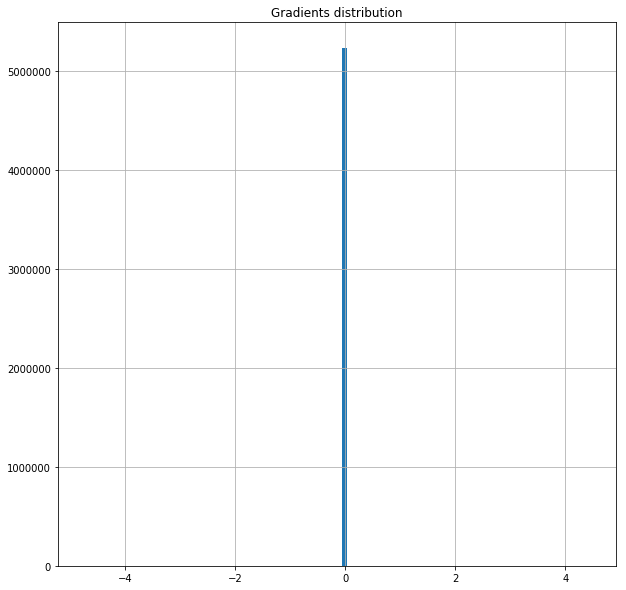

On iter 6301 with training PPL: 55.34284973144531, training ACC 0.2936197817325592
On iter 6302 with training PPL: 55.14596176147461, training ACC 0.2907986044883728
On iter 6303 with training PPL: 54.533504486083984, training ACC 0.2931857705116272
On iter 6304 with training PPL: 50.142147064208984, training ACC 0.2960069477558136
On iter 6305 with training PPL: 49.26374816894531, training ACC 0.2938368022441864
On iter 6306 with training PPL: 57.8090934753418, training ACC 0.2901475727558136
On iter 6307 with training PPL: 62.69859313964844, training ACC 0.2814670205116272
On iter 6308 with training PPL: 60.233055114746094, training ACC 0.2879774272441864
On iter 6309 with training PPL: 56.66615295410156, training ACC 0.2858072817325592
On iter 6310 with training PPL: 57.69797134399414, training ACC 0.283203125
On iter 6311 with training PPL: 60.280494689941406, training ACC 0.2816840410232544
On iter 6312 with training PPL: 62.11386489868164, training ACC 0.2751736044883728
On iter 

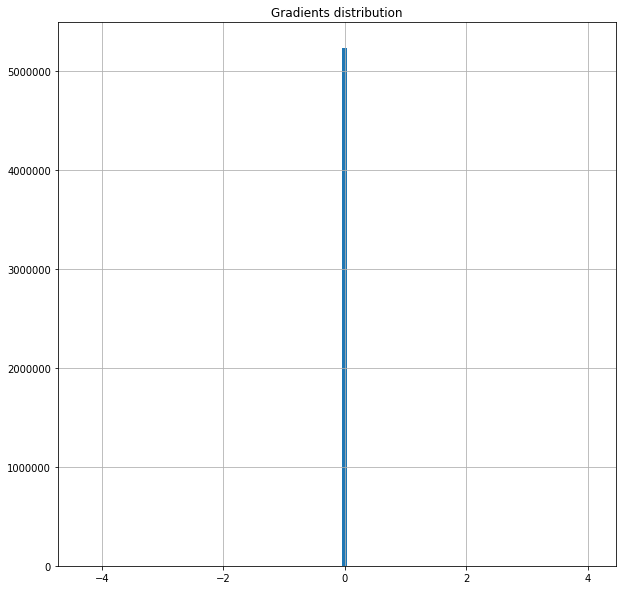

On iter 6331 with training PPL: 62.63375473022461, training ACC 0.2727864682674408
On iter 6332 with training PPL: 60.93132400512695, training ACC 0.27734375
On iter 6333 with training PPL: 57.493228912353516, training ACC 0.287109375
On iter 6334 with training PPL: 61.85905075073242, training ACC 0.2751736044883728
On iter 6335 with training PPL: 59.11701583862305, training ACC 0.2825520932674408
On iter 6336 with training PPL: 53.84330368041992, training ACC 0.2936197817325592
On iter 6337 with training PPL: 63.15016555786133, training ACC 0.2680121660232544
On iter 6338 with training PPL: 56.17642593383789, training ACC 0.2853732705116272
On iter 6339 with training PPL: 58.741188049316406, training ACC 0.2819010317325592
On iter 6340 with training PPL: 55.63498306274414, training ACC 0.2938368022441864
On iter 6341 with training PPL: 60.95396041870117, training ACC 0.2719184160232544
On iter 6342 with training PPL: 65.20536041259766, training ACC 0.2736545205116272
On iter 6343 with

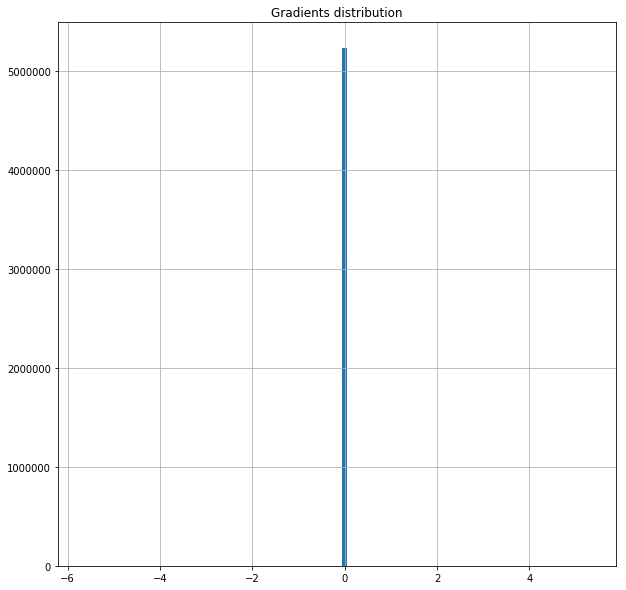

On iter 6361 with training PPL: 58.97828674316406, training ACC 0.2842881977558136
On iter 6362 with training PPL: 60.41173553466797, training ACC 0.2799479067325592
On iter 6363 with training PPL: 59.4807014465332, training ACC 0.2710503339767456
On iter 6364 with training PPL: 59.29218673706055, training ACC 0.2712673544883728
On iter 6365 with training PPL: 53.87229537963867, training ACC 0.2973090410232544
On iter 6366 with training PPL: 57.80721664428711, training ACC 0.2847222089767456
On iter 6367 with training PPL: 64.96827697753906, training ACC 0.2612847089767456
On iter 6368 with training PPL: 59.5089225769043, training ACC 0.2751736044883728
On iter 6369 with training PPL: 59.73477554321289, training ACC 0.2769097089767456
On iter 6370 with training PPL: 61.59121322631836, training ACC 0.2745225727558136
On iter 6371 with training PPL: 59.58502197265625, training ACC 0.2821180522441864
On iter 6372 with training PPL: 56.43764114379883, training ACC 0.2879774272441864
On ite

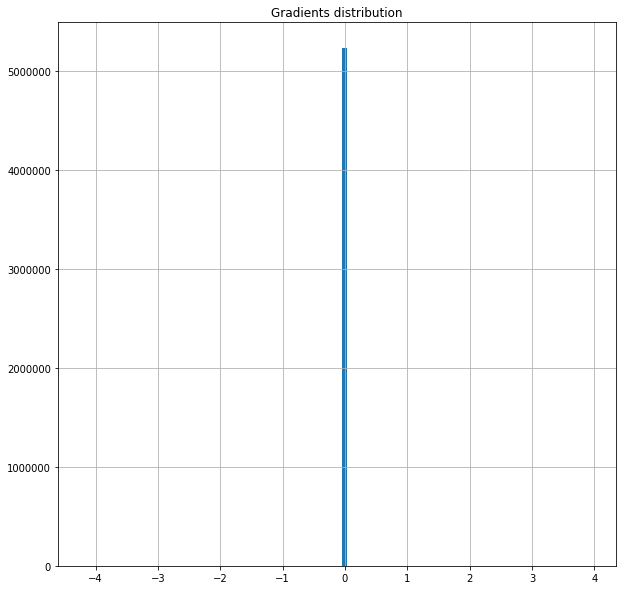

On iter 6391 with training PPL: 58.56330871582031, training ACC 0.2825520932674408
On iter 6392 with training PPL: 57.81656265258789, training ACC 0.2801649272441864
On iter 6393 with training PPL: 63.415706634521484, training ACC 0.2669270932674408
On iter 6394 with training PPL: 58.14476013183594, training ACC 0.2845052182674408
On iter 6395 with training PPL: 58.61326217651367, training ACC 0.2888454794883728
On iter 6396 with training PPL: 51.4583625793457, training ACC 0.30078125
On iter 6397 with training PPL: 55.01036071777344, training ACC 0.2853732705116272
On iter 6398 with training PPL: 60.83543395996094, training ACC 0.2743055522441864
On iter 6399 with training PPL: 59.77705383300781, training ACC 0.2803819477558136
On iter 6400 with training PPL: 57.386192321777344, training ACC 0.2855902910232544
<SS> a half hours before the usual monday morning strategy meeting <eos> at jefferies & co. j. francis <unk> did n't reach the office until N a.m. but then he had been up most o

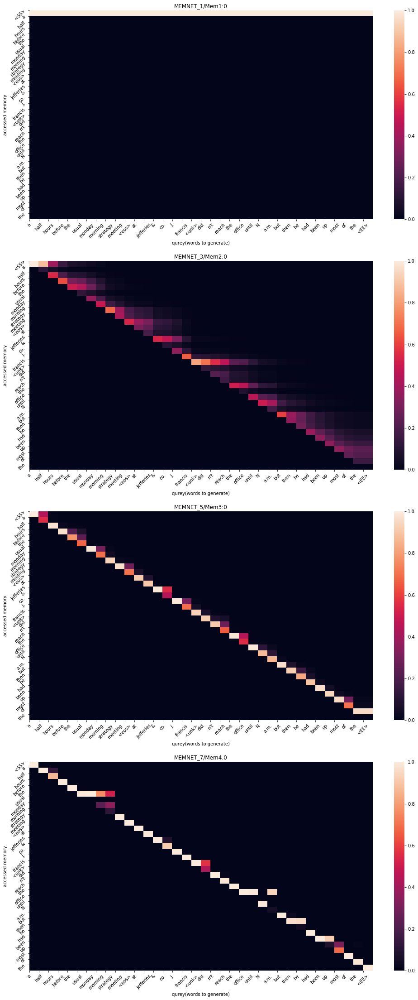

On iter 6401 with training PPL: 60.630455017089844, training ACC 0.2769097089767456
On iter 6402 with training PPL: 54.41274642944336, training ACC 0.2886284589767456
On iter 6403 with training PPL: 53.80833053588867, training ACC 0.2905815839767456
On iter 6404 with training PPL: 59.3734130859375, training ACC 0.2749565839767456
On iter 6405 with training PPL: 53.96635818481445, training ACC 0.298828125
On iter 6406 with training PPL: 57.618980407714844, training ACC 0.2907986044883728
On iter 6407 with training PPL: 49.705570220947266, training ACC 0.2890625
On iter 6408 with training PPL: 55.48090362548828, training ACC 0.2875434160232544
On iter 6409 with training PPL: 55.956722259521484, training ACC 0.2829861044883728
On iter 6410 with training PPL: 52.322265625, training ACC 0.3005642294883728
On iter 6411 with training PPL: 65.36544036865234, training ACC 0.2584635317325592
On iter 6412 with training PPL: 57.62788772583008, training ACC 0.2823350727558136
On iter 6413 with trai

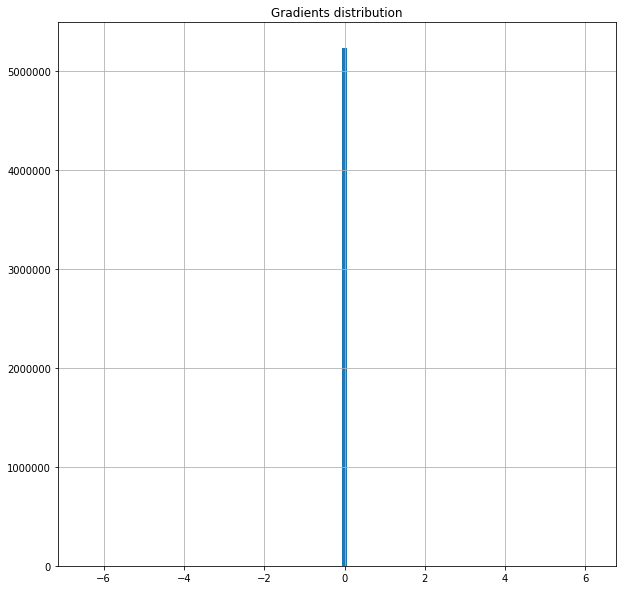

On iter 6421 with training PPL: 58.36457443237305, training ACC 0.2708333432674408
On iter 6422 with training PPL: 62.50137710571289, training ACC 0.2673611044883728
On iter 6423 with training PPL: 54.34636688232422, training ACC 0.2881944477558136
On iter 6424 with training PPL: 59.113773345947266, training ACC 0.2795138955116272
On iter 6425 with training PPL: 53.17690658569336, training ACC 0.2964409589767456
On iter 6426 with training PPL: 55.11659622192383, training ACC 0.294921875
On iter 6427 with training PPL: 54.54346466064453, training ACC 0.2916666567325592
On iter 6428 with training PPL: 58.882972717285156, training ACC 0.2721354067325592
On iter 6429 with training PPL: 51.17543029785156, training ACC 0.2960069477558136
On iter 6430 with training PPL: 59.30021667480469, training ACC 0.2847222089767456
On iter 6431 with training PPL: 56.64680862426758, training ACC 0.2827690839767456
On iter 6432 with training PPL: 56.72216796875, training ACC 0.2931857705116272
On iter 6433

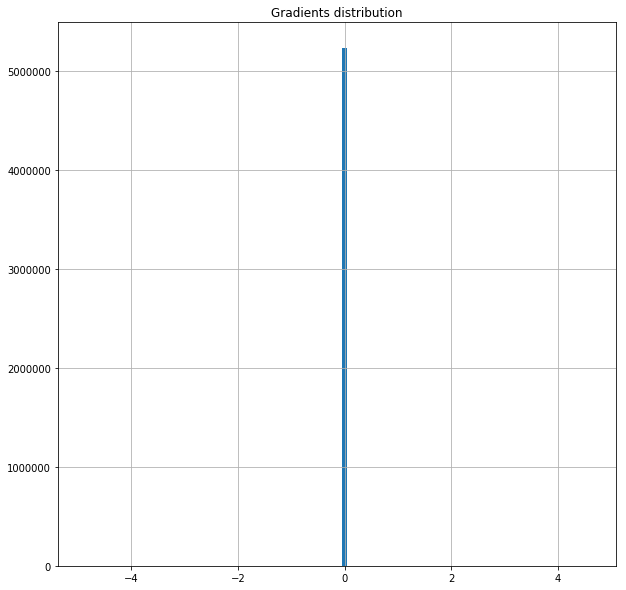

On iter 6451 with training PPL: 53.26236343383789, training ACC 0.2916666567325592
On iter 6452 with training PPL: 63.578575134277344, training ACC 0.2727864682674408
On iter 6453 with training PPL: 58.275028228759766, training ACC 0.2914496660232544
On iter 6454 with training PPL: 54.82112121582031, training ACC 0.2921006977558136
On iter 6455 with training PPL: 57.961151123046875, training ACC 0.2799479067325592
On iter 6456 with training PPL: 57.43007278442383, training ACC 0.2827690839767456
On iter 6457 with training PPL: 61.21833038330078, training ACC 0.2816840410232544
On iter 6458 with training PPL: 56.67422866821289, training ACC 0.2808159589767456
On iter 6459 with training PPL: 54.235435485839844, training ACC 0.2947048544883728
On iter 6460 with training PPL: 56.414371490478516, training ACC 0.2801649272441864
On iter 6461 with training PPL: 57.6519889831543, training ACC 0.2866753339767456
On iter 6462 with training PPL: 58.465797424316406, training ACC 0.2827690839767456

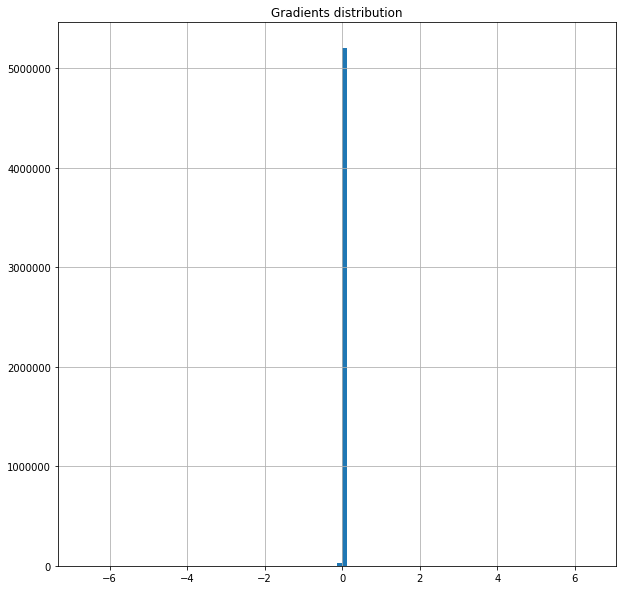

On iter 6481 with training PPL: 56.40670394897461, training ACC 0.2814670205116272
On iter 6482 with training PPL: 60.86241912841797, training ACC 0.2769097089767456
On iter 6483 with training PPL: 52.850494384765625, training ACC 0.2955729067325592
On iter 6484 with training PPL: 58.45985412597656, training ACC 0.2901475727558136
On iter 6485 with training PPL: 56.569339752197266, training ACC 0.2864583432674408
On iter 6486 with training PPL: 55.710693359375, training ACC 0.2823350727558136
On iter 6487 with training PPL: 58.90541458129883, training ACC 0.2827690839767456
On iter 6488 with training PPL: 63.42493438720703, training ACC 0.2688802182674408
On iter 6489 with training PPL: 60.42778778076172, training ACC 0.2779947817325592
On iter 6490 with training PPL: 59.84150695800781, training ACC 0.2797309160232544
On iter 6491 with training PPL: 56.33775329589844, training ACC 0.2840711772441864
On iter 6492 with training PPL: 52.71864318847656, training ACC 0.29296875
On iter 6493

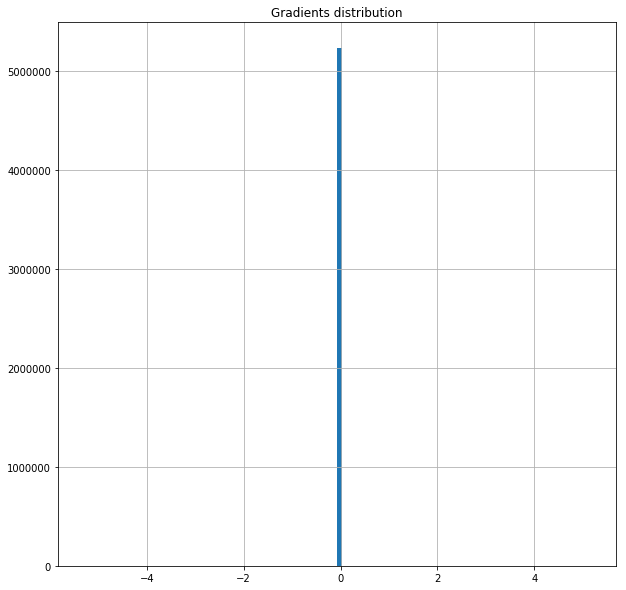

On iter 6511 with training PPL: 53.488258361816406, training ACC 0.2973090410232544
On iter 6512 with training PPL: 47.002952575683594, training ACC 0.3135850727558136
On iter 6513 with training PPL: 59.56562042236328, training ACC 0.2760416567325592
On iter 6514 with training PPL: 54.4706916809082, training ACC 0.2855902910232544
On iter 6515 with training PPL: 60.0869255065918, training ACC 0.2690972089767456
On iter 6516 with training PPL: 59.93832015991211, training ACC 0.2775607705116272
On iter 6517 with training PPL: 55.72012710571289, training ACC 0.2799479067325592
On iter 6518 with training PPL: 53.73965072631836, training ACC 0.2858072817325592
On iter 6519 with training PPL: 53.18083953857422, training ACC 0.2964409589767456
On iter 6520 with training PPL: 54.17609405517578, training ACC 0.2925347089767456
On iter 6521 with training PPL: 51.47154235839844, training ACC 0.3025173544883728
On iter 6522 with training PPL: 63.27301788330078, training ACC 0.2736545205116272
On i

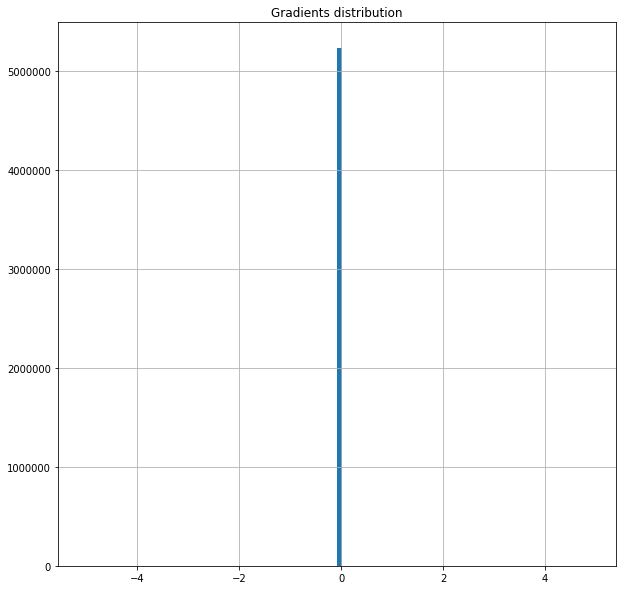

On iter 6541 with training PPL: 53.0703010559082, training ACC 0.294921875
On iter 6542 with training PPL: 62.73310470581055, training ACC 0.2745225727558136
On iter 6543 with training PPL: 56.529136657714844, training ACC 0.2858072817325592
On iter 6544 with training PPL: 51.69987106323242, training ACC 0.2916666567325592
On iter 6545 with training PPL: 59.157562255859375, training ACC 0.2782118022441864
On iter 6546 with training PPL: 55.40833282470703, training ACC 0.2975260317325592
On iter 6547 with training PPL: 59.92189025878906, training ACC 0.2823350727558136
On iter 6548 with training PPL: 56.093074798583984, training ACC 0.2897135317325592
On iter 6549 with training PPL: 53.123836517333984, training ACC 0.3029513955116272
On iter 6550 with training PPL: 52.163917541503906, training ACC 0.2940538227558136
On iter 6551 with training PPL: 62.61320495605469, training ACC 0.28125
On iter 6552 with training PPL: 60.45980453491211, training ACC 0.2664930522441864
On iter 6553 with 

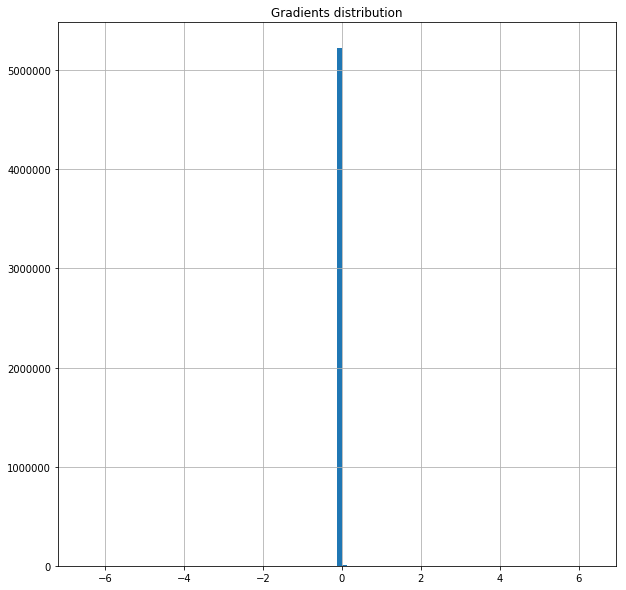

On iter 6571 with training PPL: 58.79566192626953, training ACC 0.2779947817325592
On iter 6572 with training PPL: 56.443023681640625, training ACC 0.2782118022441864
On iter 6573 with training PPL: 54.85273361206055, training ACC 0.287109375
On iter 6574 with training PPL: 59.554969787597656, training ACC 0.2829861044883728
On iter 6575 with training PPL: 52.11090087890625, training ACC 0.2966579794883728
On iter 6576 with training PPL: 56.05743408203125, training ACC 0.2884114682674408
On iter 6577 with training PPL: 62.58434295654297, training ACC 0.2680121660232544
On iter 6578 with training PPL: 61.89861297607422, training ACC 0.2712673544883728
On iter 6579 with training PPL: 58.66300582885742, training ACC 0.2816840410232544
On iter 6580 with training PPL: 55.64397430419922, training ACC 0.2834201455116272
On iter 6581 with training PPL: 50.826019287109375, training ACC 0.2979600727558136
On iter 6582 with training PPL: 54.81494903564453, training ACC 0.2866753339767456
On iter 

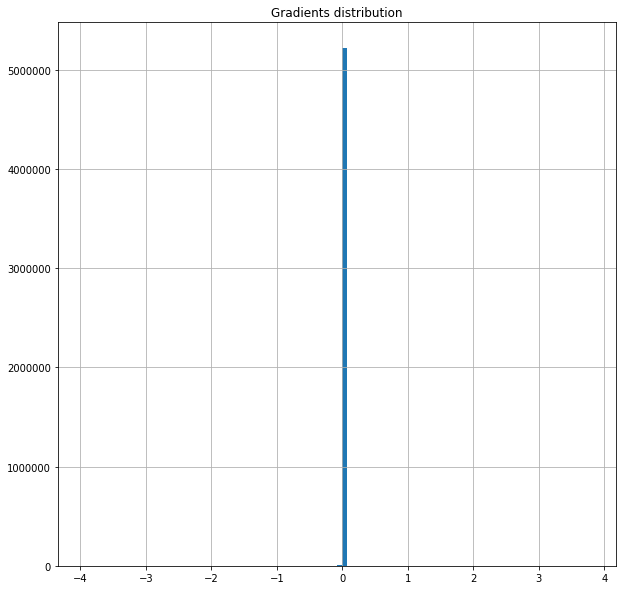

<SS> while the higher harder teeth moved the top of the pile <eos> now incorporated into a <unk> rake the <unk> <unk> or <unk> also are supposed to aid in picking up leaves <eos> one customer <EE>


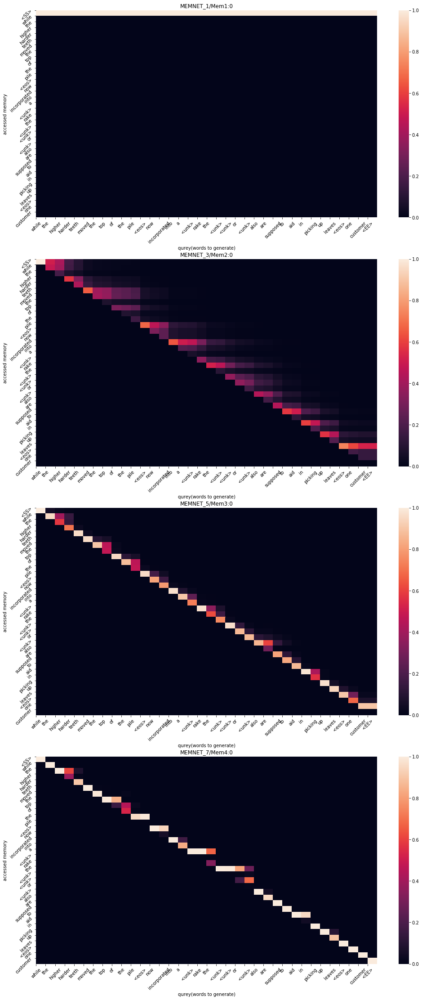

On iter 6601 with training PPL: 60.45920181274414, training ACC 0.2721354067325592
On iter 6602 with training PPL: 58.80387496948242, training ACC 0.2808159589767456
On iter 6603 with training PPL: 54.20027542114258, training ACC 0.2977430522441864
On iter 6604 with training PPL: 57.22161865234375, training ACC 0.2864583432674408
On iter 6605 with training PPL: 55.58507537841797, training ACC 0.2903645932674408
On iter 6606 with training PPL: 58.47861862182617, training ACC 0.2756076455116272
On iter 6607 with training PPL: 55.29146194458008, training ACC 0.2797309160232544
On iter 6608 with training PPL: 54.86845397949219, training ACC 0.2981770932674408
On iter 6609 with training PPL: 54.88614273071289, training ACC 0.2966579794883728
On iter 6610 with training PPL: 58.52590560913086, training ACC 0.2751736044883728
On iter 6611 with training PPL: 56.583770751953125, training ACC 0.2951388955116272
On iter 6612 with training PPL: 50.562049865722656, training ACC 0.3057725727558136
On

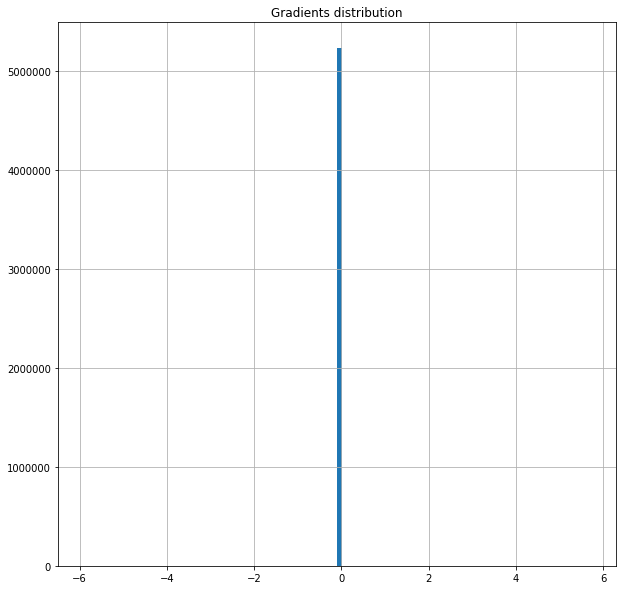

On iter 6631 with training PPL: 55.80044937133789, training ACC 0.2877604067325592
On iter 6632 with training PPL: 55.37689971923828, training ACC 0.2899305522441864
On iter 6633 with training PPL: 56.37266159057617, training ACC 0.2858072817325592
On iter 6634 with training PPL: 60.88970184326172, training ACC 0.2819010317325592
On iter 6635 with training PPL: 53.38832092285156, training ACC 0.2942708432674408
On iter 6636 with training PPL: 56.45844650268555, training ACC 0.2866753339767456
On iter 6637 with training PPL: 57.03050231933594, training ACC 0.2795138955116272
On iter 6638 with training PPL: 47.39176559448242, training ACC 0.2999131977558136
On iter 6639 with training PPL: 61.199676513671875, training ACC 0.2747395932674408
On iter 6640 with training PPL: 52.79718017578125, training ACC 0.2860243022441864
On iter 6641 with training PPL: 56.367095947265625, training ACC 0.2912326455116272
On iter 6642 with training PPL: 52.729591369628906, training ACC 0.2931857705116272
O

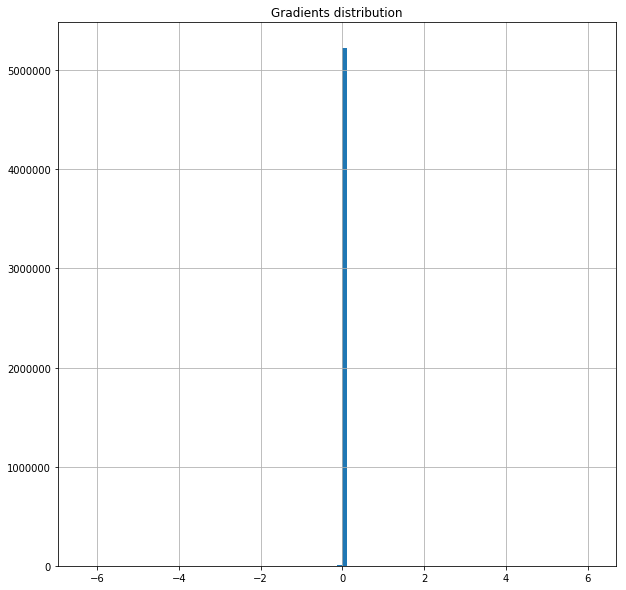

On iter 6661 with training PPL: 64.22994232177734, training ACC 0.2664930522441864
On iter 6662 with training PPL: 52.85891342163086, training ACC 0.2884114682674408
On iter 6663 with training PPL: 59.47675323486328, training ACC 0.2769097089767456
On iter 6664 with training PPL: 54.966678619384766, training ACC 0.2829861044883728
On iter 6665 with training PPL: 53.823177337646484, training ACC 0.2875434160232544
On iter 6666 with training PPL: 62.47047805786133, training ACC 0.2740885317325592
On iter 6667 with training PPL: 53.30192184448242, training ACC 0.2875434160232544
On iter 6668 with training PPL: 56.39005661010742, training ACC 0.2771267294883728
On iter 6669 with training PPL: 58.15122604370117, training ACC 0.2810329794883728
On iter 6670 with training PPL: 49.72187805175781, training ACC 0.2960069477558136
On iter 6671 with training PPL: 48.08085250854492, training ACC 0.3079427182674408
On iter 6672 with training PPL: 56.63851547241211, training ACC 0.2795138955116272
On

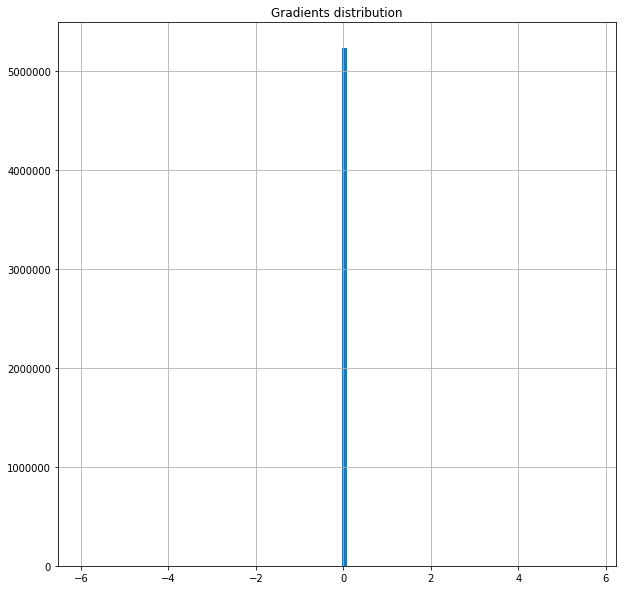

On iter 6691 with training PPL: 60.488121032714844, training ACC 0.2747395932674408
On iter 6692 with training PPL: 61.44190216064453, training ACC 0.2782118022441864
On iter 6693 with training PPL: 56.53492736816406, training ACC 0.2875434160232544
On iter 6694 with training PPL: 53.63335037231445, training ACC 0.2975260317325592
On iter 6695 with training PPL: 54.35054016113281, training ACC 0.2923177182674408
On iter 6696 with training PPL: 57.63563537597656, training ACC 0.2825520932674408
On iter 6697 with training PPL: 55.19221115112305, training ACC 0.2862413227558136
On iter 6698 with training PPL: 56.45995330810547, training ACC 0.2892795205116272
On iter 6699 with training PPL: 60.19248580932617, training ACC 0.2758246660232544
On iter 6700 with training PPL: 57.77858352661133, training ACC 0.2936197817325592
On iter 6701 with training PPL: 55.5204963684082, training ACC 0.2892795205116272
On iter 6702 with training PPL: 57.24576950073242, training ACC 0.2784288227558136
On i

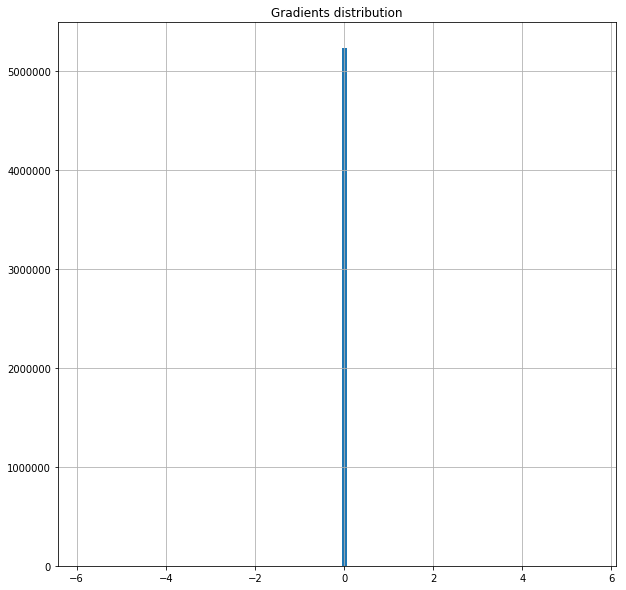

On iter 6721 with training PPL: 51.88029861450195, training ACC 0.2888454794883728
On iter 6722 with training PPL: 54.19147872924805, training ACC 0.2862413227558136
On iter 6723 with training PPL: 59.38666534423828, training ACC 0.2790798544883728
On iter 6724 with training PPL: 55.006221771240234, training ACC 0.28125
On iter 6725 with training PPL: 56.34479522705078, training ACC 0.2938368022441864
On iter 6726 with training PPL: 56.5832633972168, training ACC 0.2814670205116272
On iter 6727 with training PPL: 57.0740852355957, training ACC 0.2886284589767456
On iter 6728 with training PPL: 64.68016815185547, training ACC 0.2673611044883728
On iter 6729 with training PPL: 52.10084915161133, training ACC 0.2947048544883728
On iter 6730 with training PPL: 58.95090103149414, training ACC 0.2764756977558136
On iter 6731 with training PPL: 52.50788116455078, training ACC 0.3003472089767456
On iter 6732 with training PPL: 52.75309371948242, training ACC 0.298828125
On iter 6733 with train

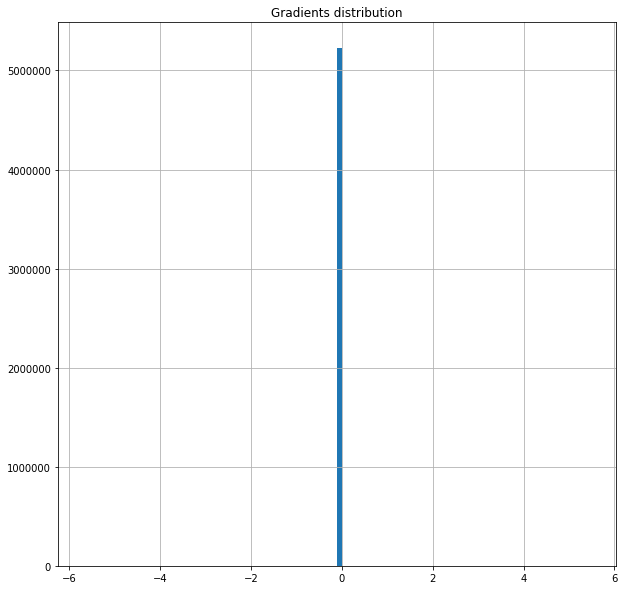

On iter 6751 with training PPL: 55.60904312133789, training ACC 0.2827690839767456
On iter 6752 with training PPL: 53.67028045654297, training ACC 0.2912326455116272
On iter 6753 with training PPL: 57.09115219116211, training ACC 0.2845052182674408
On iter 6754 with training PPL: 54.391929626464844, training ACC 0.2840711772441864
On iter 6755 with training PPL: 52.87993621826172, training ACC 0.2936197817325592
On iter 6756 with training PPL: 52.71111297607422, training ACC 0.2921006977558136
On iter 6757 with training PPL: 58.99516677856445, training ACC 0.2866753339767456
On iter 6758 with training PPL: 60.843265533447266, training ACC 0.2814670205116272
On iter 6759 with training PPL: 56.64240264892578, training ACC 0.2951388955116272
On iter 6760 with training PPL: 50.68003845214844, training ACC 0.2994791567325592
On iter 6761 with training PPL: 55.0623779296875, training ACC 0.2875434160232544
On iter 6762 with training PPL: 58.55998992919922, training ACC 0.28125
On iter 6763 w

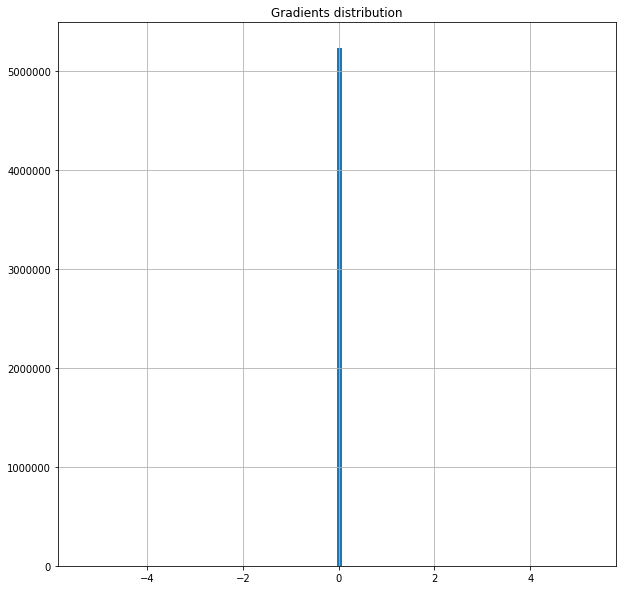

On iter 6781 with training PPL: 53.603294372558594, training ACC 0.2936197817325592
On iter 6782 with training PPL: 47.77432632446289, training ACC 0.2973090410232544
On iter 6783 with training PPL: 55.88328552246094, training ACC 0.2866753339767456
On iter 6784 with training PPL: 53.044429779052734, training ACC 0.2923177182674408
On iter 6785 with training PPL: 53.67634582519531, training ACC 0.2834201455116272
On iter 6786 with training PPL: 54.06730270385742, training ACC 0.2886284589767456
On iter 6787 with training PPL: 57.14496994018555, training ACC 0.2801649272441864
On iter 6788 with training PPL: 51.29935073852539, training ACC 0.2927517294883728
On iter 6789 with training PPL: 54.52153015136719, training ACC 0.2916666567325592
On iter 6790 with training PPL: 57.04084014892578, training ACC 0.2769097089767456
On iter 6791 with training PPL: 52.76402282714844, training ACC 0.2927517294883728
On iter 6792 with training PPL: 51.7932014465332, training ACC 0.302734375
On iter 67

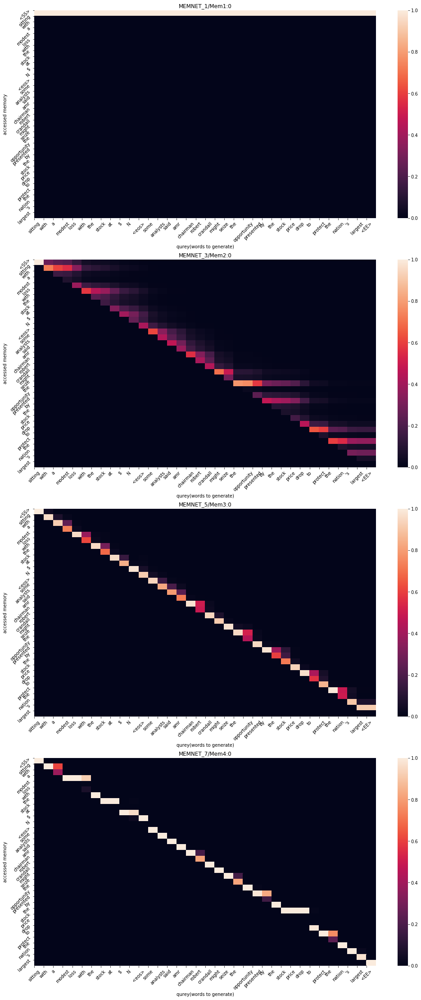

On iter 6801 with training PPL: 51.69224166870117, training ACC 0.2942708432674408
On iter 6802 with training PPL: 57.04094696044922, training ACC 0.28515625
On iter 6803 with training PPL: 59.160892486572266, training ACC 0.2779947817325592
On iter 6804 with training PPL: 56.61140441894531, training ACC 0.2888454794883728
On iter 6805 with training PPL: 61.06669235229492, training ACC 0.2736545205116272
On iter 6806 with training PPL: 53.81211471557617, training ACC 0.2881944477558136
On iter 6807 with training PPL: 55.7056999206543, training ACC 0.2975260317325592
On iter 6808 with training PPL: 56.58012771606445, training ACC 0.2777777910232544
On iter 6809 with training PPL: 61.875274658203125, training ACC 0.2690972089767456
On iter 6810 with training PPL: 54.9288215637207, training ACC 0.2897135317325592
	 validation PPL 164.51858520507812, validation acc 0.2502170205116272
shape of gradients is (5228544,), L2 norm of gradients is 24.39633560180664, details:                   0
c

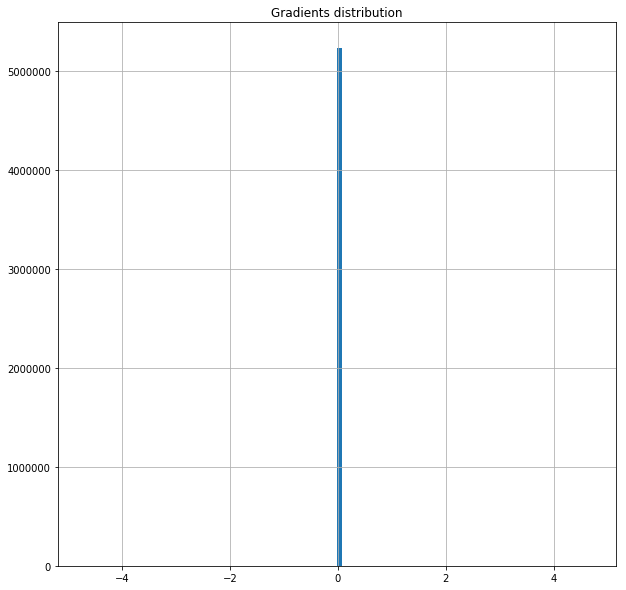

On iter 6811 with training PPL: 53.666221618652344, training ACC 0.2955729067325592
On iter 6812 with training PPL: 54.390037536621094, training ACC 0.2905815839767456
On iter 6813 with training PPL: 53.54597854614258, training ACC 0.2875434160232544
On iter 6814 with training PPL: 55.24086380004883, training ACC 0.2938368022441864
On iter 6815 with training PPL: 55.549652099609375, training ACC 0.2931857705116272
On iter 6816 with training PPL: 57.7596321105957, training ACC 0.2740885317325592
On iter 6817 with training PPL: 57.410987854003906, training ACC 0.2912326455116272
On iter 6818 with training PPL: 51.741722106933594, training ACC 0.294921875
On iter 6819 with training PPL: 55.4776496887207, training ACC 0.2849392294883728
On iter 6820 with training PPL: 54.72098922729492, training ACC 0.2868923544883728
On iter 6821 with training PPL: 44.252010345458984, training ACC 0.3196614682674408
On iter 6822 with training PPL: 60.169158935546875, training ACC 0.275390625
On iter 6823 

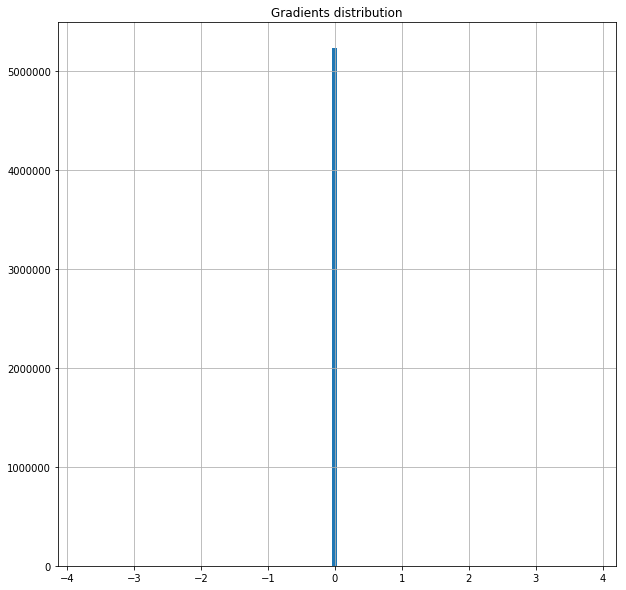

On iter 6841 with training PPL: 52.087100982666016, training ACC 0.3068576455116272
On iter 6842 with training PPL: 52.307098388671875, training ACC 0.2858072817325592
On iter 6843 with training PPL: 58.904090881347656, training ACC 0.2825520932674408
On iter 6844 with training PPL: 54.78960037231445, training ACC 0.2983940839767456
On iter 6845 with training PPL: 59.238067626953125, training ACC 0.2860243022441864
On iter 6846 with training PPL: 56.873939514160156, training ACC 0.2790798544883728
On iter 6847 with training PPL: 54.893577575683594, training ACC 0.2879774272441864
On iter 6848 with training PPL: 49.6016845703125, training ACC 0.3018663227558136
On iter 6849 with training PPL: 55.332820892333984, training ACC 0.287109375
On iter 6850 with training PPL: 53.276676177978516, training ACC 0.2940538227558136
On iter 6851 with training PPL: 60.45280075073242, training ACC 0.2727864682674408
On iter 6852 with training PPL: 60.741397857666016, training ACC 0.279296875
On iter 68

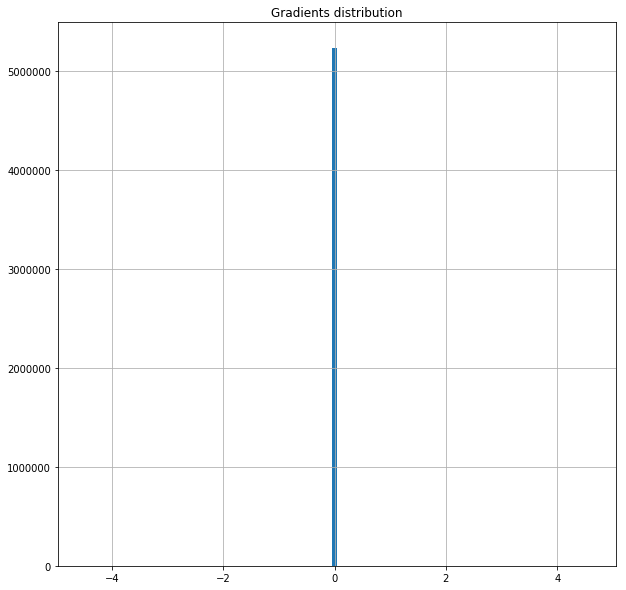

On iter 6871 with training PPL: 50.739654541015625, training ACC 0.2973090410232544
On iter 6872 with training PPL: 51.433773040771484, training ACC 0.2873263955116272
On iter 6873 with training PPL: 52.74613952636719, training ACC 0.2884114682674408
On iter 6874 with training PPL: 55.6922607421875, training ACC 0.2858072817325592
On iter 6875 with training PPL: 58.967124938964844, training ACC 0.2769097089767456
On iter 6876 with training PPL: 57.100868225097656, training ACC 0.2762586772441864
On iter 6877 with training PPL: 53.26545333862305, training ACC 0.2938368022441864
On iter 6878 with training PPL: 56.052032470703125, training ACC 0.2845052182674408
On iter 6879 with training PPL: 54.441280364990234, training ACC 0.2903645932674408
On iter 6880 with training PPL: 57.37070846557617, training ACC 0.2873263955116272
On iter 6881 with training PPL: 61.3443603515625, training ACC 0.2762586772441864
On iter 6882 with training PPL: 50.59532165527344, training ACC 0.3023003339767456


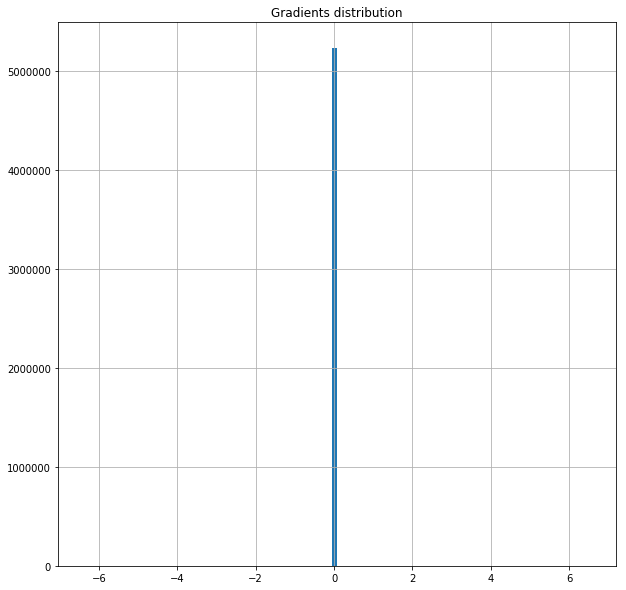

On iter 6901 with training PPL: 52.998836517333984, training ACC 0.2955729067325592
On iter 6902 with training PPL: 54.161808013916016, training ACC 0.2836371660232544
On iter 6903 with training PPL: 52.74517059326172, training ACC 0.2901475727558136
On iter 6904 with training PPL: 53.638553619384766, training ACC 0.283203125
On iter 6905 with training PPL: 57.25434112548828, training ACC 0.2758246660232544
On iter 6906 with training PPL: 51.159828186035156, training ACC 0.291015625
On iter 6907 with training PPL: 60.240840911865234, training ACC 0.2740885317325592
On iter 6908 with training PPL: 54.51564025878906, training ACC 0.2881944477558136
On iter 6909 with training PPL: 56.250431060791016, training ACC 0.2925347089767456
On iter 6910 with training PPL: 52.20722579956055, training ACC 0.2975260317325592
On iter 6911 with training PPL: 54.88098907470703, training ACC 0.2877604067325592
On iter 6912 with training PPL: 53.81843185424805, training ACC 0.2907986044883728
On iter 6913

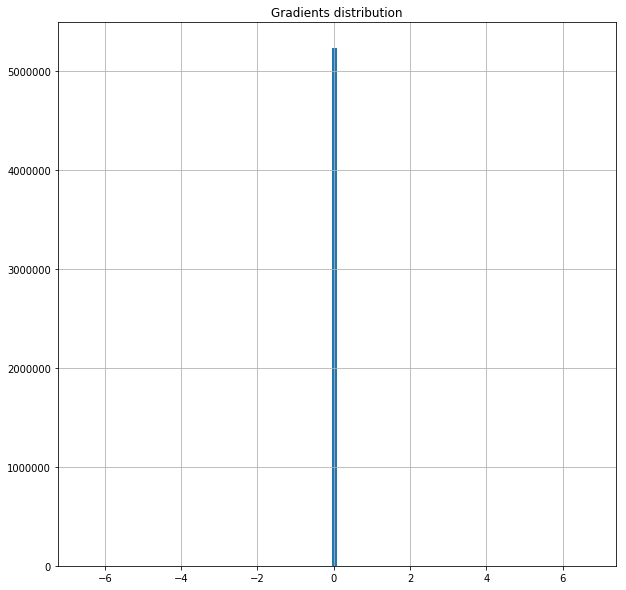

On iter 6931 with training PPL: 54.852603912353516, training ACC 0.2816840410232544
On iter 6932 with training PPL: 64.02503204345703, training ACC 0.2584635317325592
On iter 6933 with training PPL: 59.633399963378906, training ACC 0.291015625
On iter 6934 with training PPL: 52.83725357055664, training ACC 0.2858072817325592
On iter 6935 with training PPL: 52.67848587036133, training ACC 0.296875
On iter 6936 with training PPL: 54.216976165771484, training ACC 0.2864583432674408
On iter 6937 with training PPL: 54.717777252197266, training ACC 0.287109375
On iter 6938 with training PPL: 58.54399108886719, training ACC 0.2738715410232544
On iter 6939 with training PPL: 57.50693893432617, training ACC 0.2701822817325592
On iter 6940 with training PPL: 55.46482467651367, training ACC 0.2855902910232544
On iter 6941 with training PPL: 58.45690155029297, training ACC 0.2782118022441864
On iter 6942 with training PPL: 55.14898681640625, training ACC 0.2916666567325592
On iter 6943 with traini

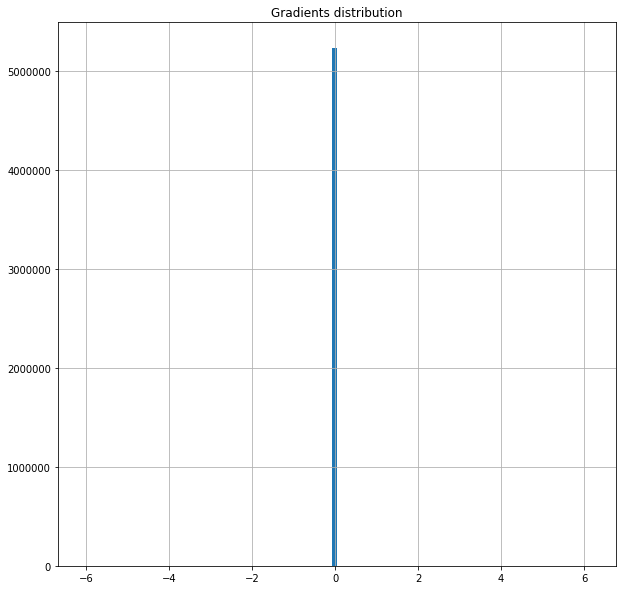

On iter 6961 with training PPL: 59.65165710449219, training ACC 0.2760416567325592
On iter 6962 with training PPL: 53.359928131103516, training ACC 0.2886284589767456
On iter 6963 with training PPL: 52.268341064453125, training ACC 0.2927517294883728
On iter 6964 with training PPL: 52.47451400756836, training ACC 0.2973090410232544
On iter 6965 with training PPL: 49.37606430053711, training ACC 0.3036024272441864
On iter 6966 with training PPL: 55.45527267456055, training ACC 0.2877604067325592
On iter 6967 with training PPL: 55.357177734375, training ACC 0.291015625
On iter 6968 with training PPL: 49.546878814697266, training ACC 0.3081597089767456
On iter 6969 with training PPL: 51.93699264526367, training ACC 0.2957899272441864
On iter 6970 with training PPL: 55.90735626220703, training ACC 0.283203125
On iter 6971 with training PPL: 54.22368621826172, training ACC 0.2962239682674408
On iter 6972 with training PPL: 57.78183364868164, training ACC 0.2766927182674408
On iter 6973 with

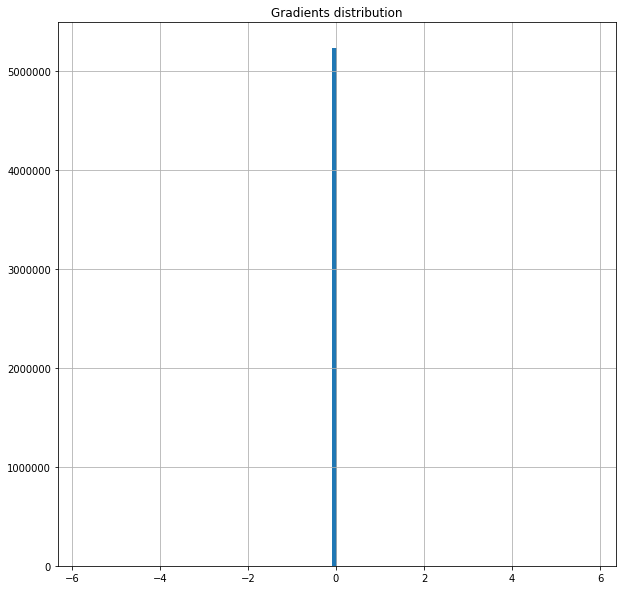

On iter 6991 with training PPL: 51.69868850708008, training ACC 0.2897135317325592
On iter 6992 with training PPL: 47.406436920166016, training ACC 0.3064236044883728
On iter 6993 with training PPL: 51.691253662109375, training ACC 0.287109375
On iter 6994 with training PPL: 56.615699768066406, training ACC 0.2938368022441864
On iter 6995 with training PPL: 50.901363372802734, training ACC 0.2999131977558136
On iter 6996 with training PPL: 49.393524169921875, training ACC 0.2999131977558136
On iter 6997 with training PPL: 54.773563385009766, training ACC 0.2947048544883728
On iter 6998 with training PPL: 52.56086349487305, training ACC 0.2981770932674408
On iter 6999 with training PPL: 54.23488235473633, training ACC 0.2890625
On iter 7000 with training PPL: 57.08772277832031, training ACC 0.2788628339767456
<SS> <unk> would n't increase its stake in <unk> beyond N N without a great deal of thought because of british takeover regulations that require a company acquiring more than N N t

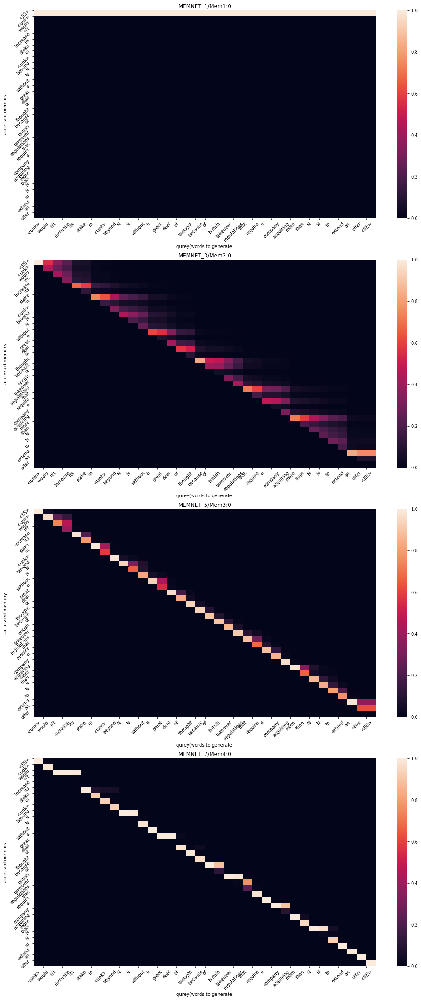

On iter 7001 with training PPL: 59.335235595703125, training ACC 0.2782118022441864
On iter 7002 with training PPL: 54.77497482299805, training ACC 0.2840711772441864
On iter 7003 with training PPL: 56.349063873291016, training ACC 0.2912326455116272
On iter 7004 with training PPL: 51.409095764160156, training ACC 0.2960069477558136
On iter 7005 with training PPL: 57.42013168334961, training ACC 0.2782118022441864
On iter 7006 with training PPL: 53.27908706665039, training ACC 0.2899305522441864
On iter 7007 with training PPL: 51.57878875732422, training ACC 0.2921006977558136
On iter 7008 with training PPL: 46.72526550292969, training ACC 0.3064236044883728
On iter 7009 with training PPL: 51.288124084472656, training ACC 0.2903645932674408
On iter 7010 with training PPL: 55.03505325317383, training ACC 0.2888454794883728
On iter 7011 with training PPL: 55.59246826171875, training ACC 0.2858072817325592
On iter 7012 with training PPL: 47.33713150024414, training ACC 0.3033854067325592


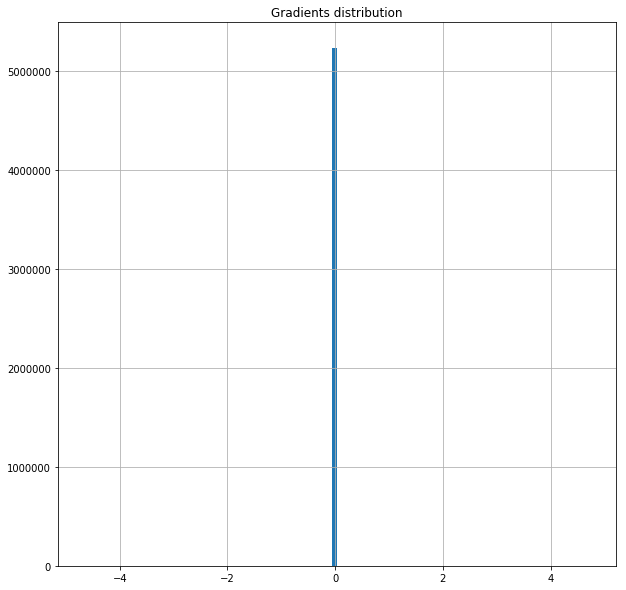

On iter 7021 with training PPL: 57.455711364746094, training ACC 0.2745225727558136
On iter 7022 with training PPL: 47.8564338684082, training ACC 0.2964409589767456
On iter 7023 with training PPL: 51.79462432861328, training ACC 0.2981770932674408
On iter 7024 with training PPL: 53.126407623291016, training ACC 0.2836371660232544
On iter 7025 with training PPL: 59.74462890625, training ACC 0.2784288227558136
On iter 7026 with training PPL: 59.540287017822266, training ACC 0.2805989682674408
On iter 7027 with training PPL: 53.77848815917969, training ACC 0.2884114682674408
On iter 7028 with training PPL: 55.33757019042969, training ACC 0.2842881977558136
On iter 7029 with training PPL: 50.47496032714844, training ACC 0.2996961772441864
On iter 7030 with training PPL: 57.91297149658203, training ACC 0.2747395932674408
On iter 7031 with training PPL: 54.12705612182617, training ACC 0.2901475727558136
On iter 7032 with training PPL: 55.780494689941406, training ACC 0.27734375
On iter 7033

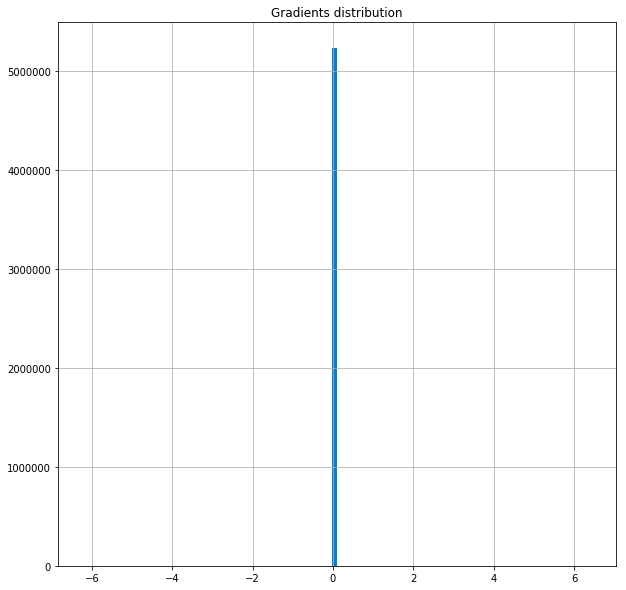

On iter 7051 with training PPL: 53.192604064941406, training ACC 0.2834201455116272
On iter 7052 with training PPL: 52.5994873046875, training ACC 0.294921875
On iter 7053 with training PPL: 51.24439239501953, training ACC 0.2918836772441864
On iter 7054 with training PPL: 51.61333084106445, training ACC 0.28515625
On iter 7055 with training PPL: 48.511962890625, training ACC 0.2992621660232544
On iter 7056 with training PPL: 54.489070892333984, training ACC 0.2903645932674408
On iter 7057 with training PPL: 56.419559478759766, training ACC 0.2914496660232544
On iter 7058 with training PPL: 55.00428009033203, training ACC 0.2868923544883728
On iter 7059 with training PPL: 54.33496856689453, training ACC 0.2962239682674408
On iter 7060 with training PPL: 57.09550476074219, training ACC 0.2842881977558136
On iter 7061 with training PPL: 56.27500534057617, training ACC 0.2879774272441864
On iter 7062 with training PPL: 54.22237777709961, training ACC 0.2788628339767456
On iter 7063 with t

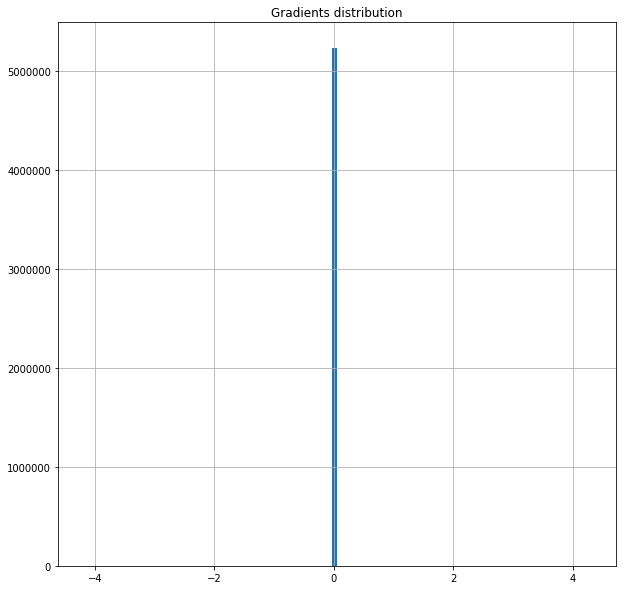

On iter 7081 with training PPL: 53.943485260009766, training ACC 0.2879774272441864
On iter 7082 with training PPL: 56.879638671875, training ACC 0.2886284589767456
On iter 7083 with training PPL: 47.733829498291016, training ACC 0.3064236044883728
On iter 7084 with training PPL: 50.838829040527344, training ACC 0.2944878339767456
On iter 7085 with training PPL: 47.63209533691406, training ACC 0.3111979067325592
On iter 7086 with training PPL: 455.8221740722656, training ACC 0.1846788227558136
On iter 7087 with training PPL: 84.81153869628906, training ACC 0.2562934160232544
On iter 7088 with training PPL: 67.42280578613281, training ACC 0.2682291567325592
On iter 7089 with training PPL: 69.29606628417969, training ACC 0.263671875
On iter 7090 with training PPL: 67.72339630126953, training ACC 0.2565104067325592
On iter 7091 with training PPL: 57.31137466430664, training ACC 0.2940538227558136
On iter 7092 with training PPL: 62.93072509765625, training ACC 0.2712673544883728
On iter 70

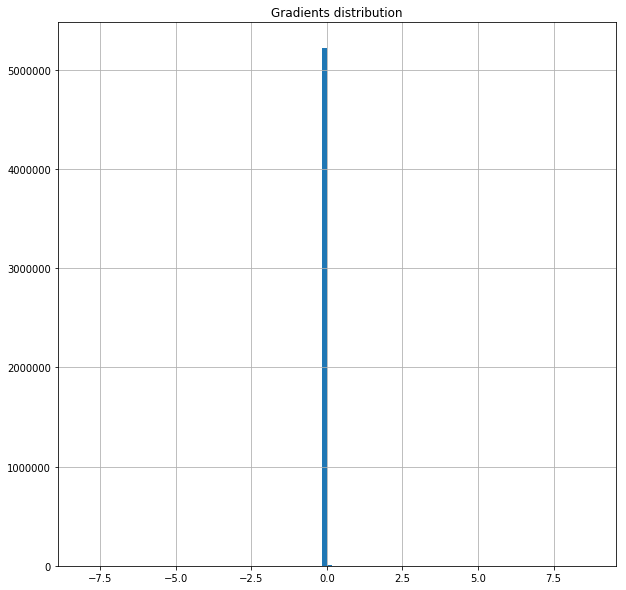

On iter 7111 with training PPL: 70.57511901855469, training ACC 0.2530381977558136
On iter 7112 with training PPL: 63.46800994873047, training ACC 0.2740885317325592
On iter 7113 with training PPL: 59.544517517089844, training ACC 0.2860243022441864
On iter 7114 with training PPL: 61.538368225097656, training ACC 0.2708333432674408
On iter 7115 with training PPL: 58.24380111694336, training ACC 0.2788628339767456
On iter 7116 with training PPL: 65.9483871459961, training ACC 0.265625
On iter 7117 with training PPL: 65.01675415039062, training ACC 0.2706163227558136
On iter 7118 with training PPL: 64.23046112060547, training ACC 0.2682291567325592
On iter 7119 with training PPL: 64.1357650756836, training ACC 0.2621527910232544
On iter 7120 with training PPL: 65.53659057617188, training ACC 0.2615017294883728
On iter 7121 with training PPL: 62.48662185668945, training ACC 0.2625868022441864
On iter 7122 with training PPL: 60.58207702636719, training ACC 0.2686631977558136
On iter 7123 w

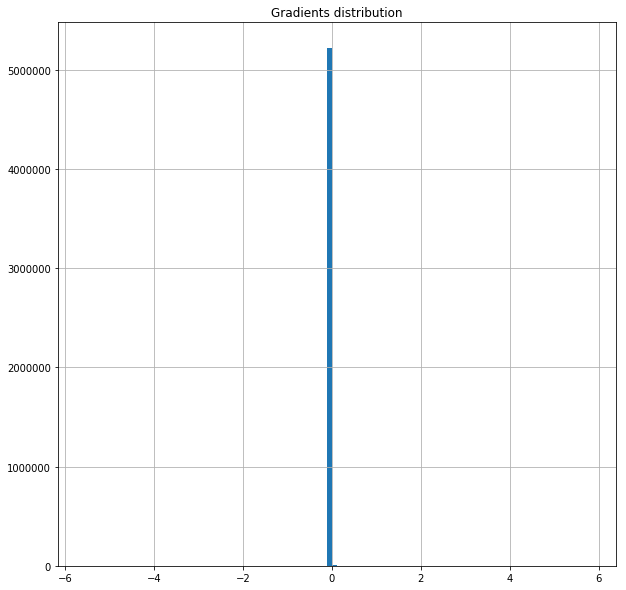

On iter 7141 with training PPL: 57.828250885009766, training ACC 0.2823350727558136
On iter 7142 with training PPL: 55.46439743041992, training ACC 0.2769097089767456
On iter 7143 with training PPL: 60.55752944946289, training ACC 0.2703993022441864
On iter 7144 with training PPL: 60.205745697021484, training ACC 0.2764756977558136
On iter 7145 with training PPL: 54.507652282714844, training ACC 0.291015625
On iter 7146 with training PPL: 55.851558685302734, training ACC 0.2862413227558136
On iter 7147 with training PPL: 60.16014862060547, training ACC 0.2751736044883728
On iter 7148 with training PPL: 54.522335052490234, training ACC 0.2947048544883728
On iter 7149 with training PPL: 58.52302932739258, training ACC 0.2758246660232544
On iter 7150 with training PPL: 56.88316345214844, training ACC 0.2823350727558136
On iter 7151 with training PPL: 56.10385513305664, training ACC 0.2905815839767456
On iter 7152 with training PPL: 58.969993591308594, training ACC 0.2814670205116272
On it

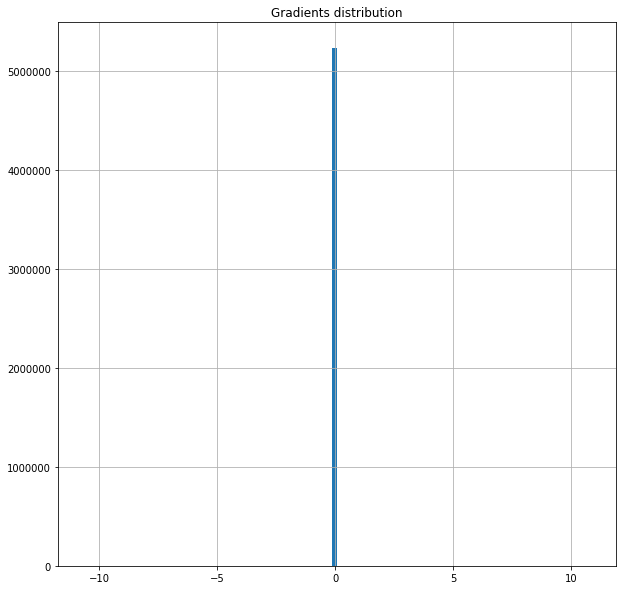

On iter 7171 with training PPL: 60.451072692871094, training ACC 0.27734375
On iter 7172 with training PPL: 57.735565185546875, training ACC 0.2847222089767456
On iter 7173 with training PPL: 49.58129119873047, training ACC 0.2936197817325592
On iter 7174 with training PPL: 53.155662536621094, training ACC 0.2921006977558136
On iter 7175 with training PPL: 58.453948974609375, training ACC 0.2795138955116272
On iter 7176 with training PPL: 50.179603576660156, training ACC 0.3051215410232544
On iter 7177 with training PPL: 52.975955963134766, training ACC 0.2829861044883728
On iter 7178 with training PPL: 45.07141876220703, training ACC 0.3138020932674408
On iter 7179 with training PPL: 58.99113845825195, training ACC 0.2827690839767456
On iter 7180 with training PPL: 49.06355285644531, training ACC 0.2986111044883728
On iter 7181 with training PPL: 52.76887893676758, training ACC 0.2918836772441864
On iter 7182 with training PPL: 55.274803161621094, training ACC 0.2866753339767456
On it

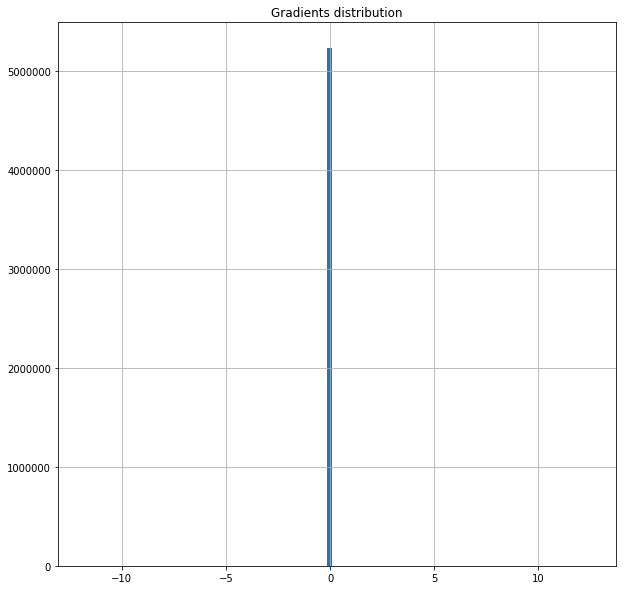

<SS> he says he remains uneasy <eos> we have half the experts saying one thing and half the other about the course of the economy <eos> ralph <unk> a farmer and <unk> store operator in <unk> <EE>


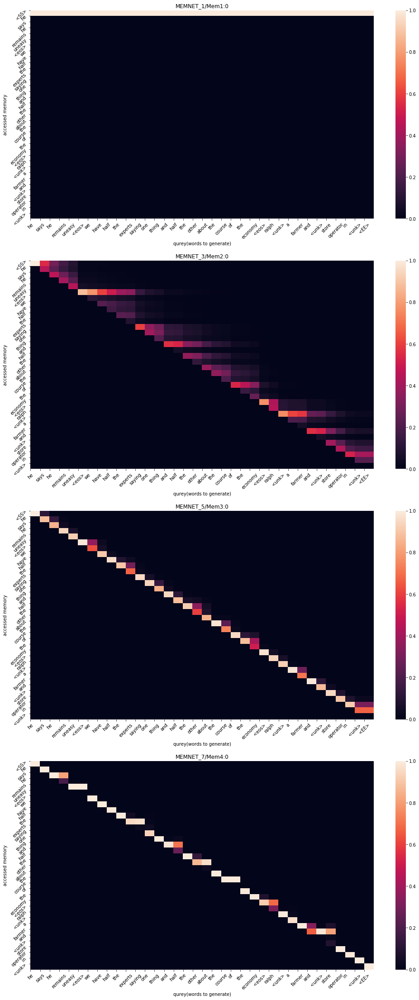

On iter 7201 with training PPL: 49.685340881347656, training ACC 0.2921006977558136
On iter 7202 with training PPL: 51.97549057006836, training ACC 0.2931857705116272
On iter 7203 with training PPL: 49.70335388183594, training ACC 0.3049045205116272
On iter 7204 with training PPL: 53.832275390625, training ACC 0.2886284589767456
On iter 7205 with training PPL: 51.120033264160156, training ACC 0.2966579794883728
On iter 7206 with training PPL: 53.37883377075195, training ACC 0.2923177182674408
On iter 7207 with training PPL: 56.92071533203125, training ACC 0.2788628339767456
On iter 7208 with training PPL: 49.83464813232422, training ACC 0.2873263955116272
On iter 7209 with training PPL: 53.019107818603516, training ACC 0.2877604067325592
On iter 7210 with training PPL: 53.6646728515625, training ACC 0.2858072817325592
On iter 7211 with training PPL: 52.811256408691406, training ACC 0.2875434160232544
On iter 7212 with training PPL: 62.685977935791016, training ACC 0.2664930522441864
On

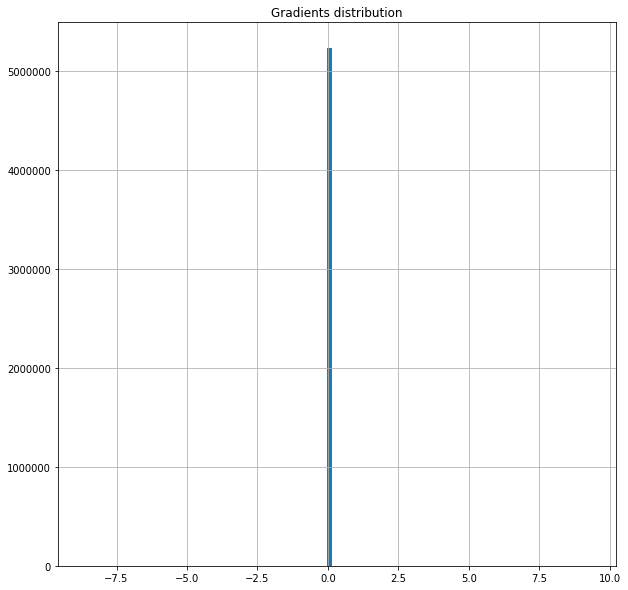

On iter 7231 with training PPL: 49.33177185058594, training ACC 0.302734375
On iter 7232 with training PPL: 57.36958312988281, training ACC 0.2825520932674408
On iter 7233 with training PPL: 52.98075866699219, training ACC 0.2931857705116272
On iter 7234 with training PPL: 49.42113494873047, training ACC 0.2921006977558136
On iter 7235 with training PPL: 61.099491119384766, training ACC 0.2862413227558136
On iter 7236 with training PPL: 59.885353088378906, training ACC 0.2847222089767456
On iter 7237 with training PPL: 59.53279495239258, training ACC 0.2697482705116272
On iter 7238 with training PPL: 52.48661422729492, training ACC 0.2858072817325592
On iter 7239 with training PPL: 60.72113037109375, training ACC 0.2736545205116272
On iter 7240 with training PPL: 58.21495056152344, training ACC 0.2842881977558136
On iter 7241 with training PPL: 56.87215042114258, training ACC 0.2784288227558136
On iter 7242 with training PPL: 46.35639572143555, training ACC 0.3070746660232544
On iter 7

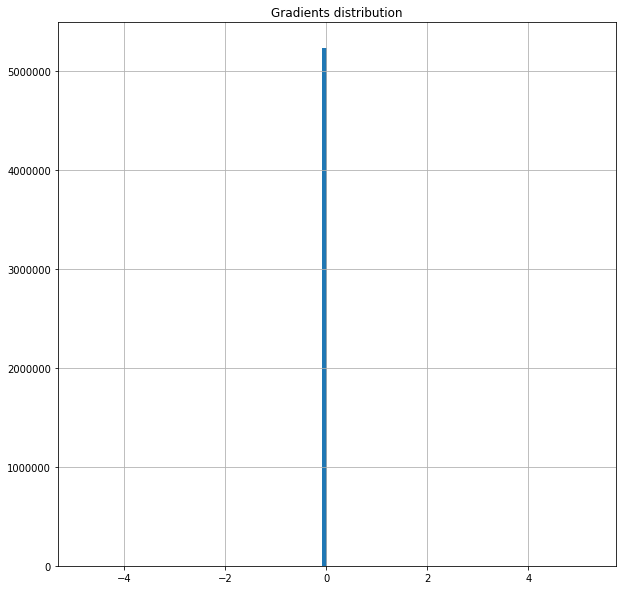

On iter 7261 with training PPL: 55.85321044921875, training ACC 0.2840711772441864
On iter 7262 with training PPL: 57.28495407104492, training ACC 0.2721354067325592
On iter 7263 with training PPL: 53.40632247924805, training ACC 0.2801649272441864
On iter 7264 with training PPL: 48.06214904785156, training ACC 0.3053385317325592
On iter 7265 with training PPL: 56.273048400878906, training ACC 0.2786458432674408
On iter 7266 with training PPL: 53.00490188598633, training ACC 0.28125
On iter 7267 with training PPL: 56.592620849609375, training ACC 0.2801649272441864
On iter 7268 with training PPL: 52.916439056396484, training ACC 0.2940538227558136
On iter 7269 with training PPL: 51.81435012817383, training ACC 0.2973090410232544
On iter 7270 with training PPL: 52.49998092651367, training ACC 0.2970920205116272
On iter 7271 with training PPL: 52.360687255859375, training ACC 0.2955729067325592
On iter 7272 with training PPL: 53.83358383178711, training ACC 0.2862413227558136
On iter 727

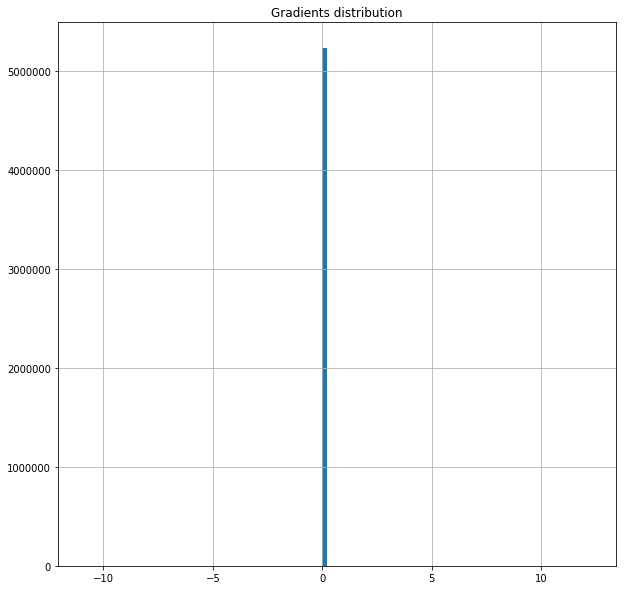

On iter 7291 with training PPL: 51.44655990600586, training ACC 0.2858072817325592
On iter 7292 with training PPL: 50.52919006347656, training ACC 0.3003472089767456
On iter 7293 with training PPL: 54.419883728027344, training ACC 0.2931857705116272
On iter 7294 with training PPL: 53.7297248840332, training ACC 0.2912326455116272
On iter 7295 with training PPL: 55.955867767333984, training ACC 0.2862413227558136
On iter 7296 with training PPL: 56.38180160522461, training ACC 0.2808159589767456
On iter 7297 with training PPL: 55.232357025146484, training ACC 0.28515625
On iter 7298 with training PPL: 44.13466262817383, training ACC 0.328125
On iter 7299 with training PPL: 48.730873107910156, training ACC 0.3033854067325592
On iter 7300 with training PPL: 47.95536422729492, training ACC 0.3040364682674408
On iter 7301 with training PPL: 49.3961181640625, training ACC 0.2938368022441864
On iter 7302 with training PPL: 52.64982223510742, training ACC 0.287109375
On iter 7303 with training 

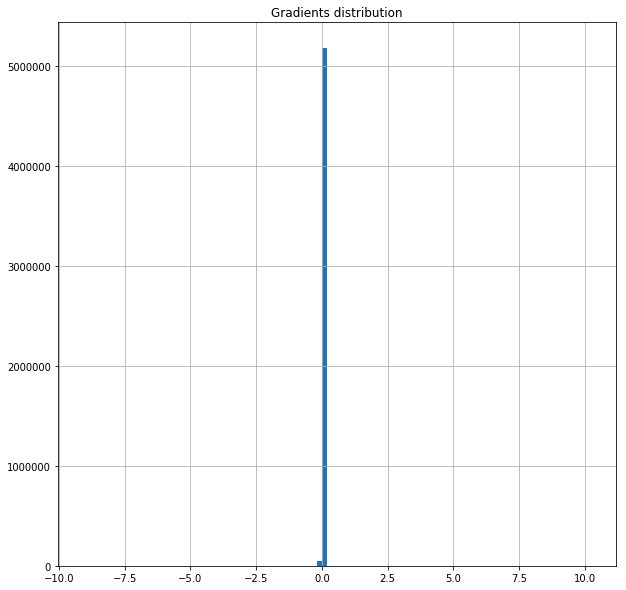

On iter 7321 with training PPL: 55.236602783203125, training ACC 0.2868923544883728
On iter 7322 with training PPL: 46.082584381103516, training ACC 0.3005642294883728
On iter 7323 with training PPL: 56.25861740112305, training ACC 0.2795138955116272
On iter 7324 with training PPL: 57.56806564331055, training ACC 0.2847222089767456
On iter 7325 with training PPL: 54.379783630371094, training ACC 0.2877604067325592
On iter 7326 with training PPL: 57.3248176574707, training ACC 0.2873263955116272
On iter 7327 with training PPL: 52.34123229980469, training ACC 0.2979600727558136
On iter 7328 with training PPL: 55.332611083984375, training ACC 0.2782118022441864
On iter 7329 with training PPL: 51.08780288696289, training ACC 0.2934027910232544
On iter 7330 with training PPL: 48.08799743652344, training ACC 0.3064236044883728
On iter 7331 with training PPL: 50.934356689453125, training ACC 0.2942708432674408
On iter 7332 with training PPL: 53.253780364990234, training ACC 0.2855902910232544

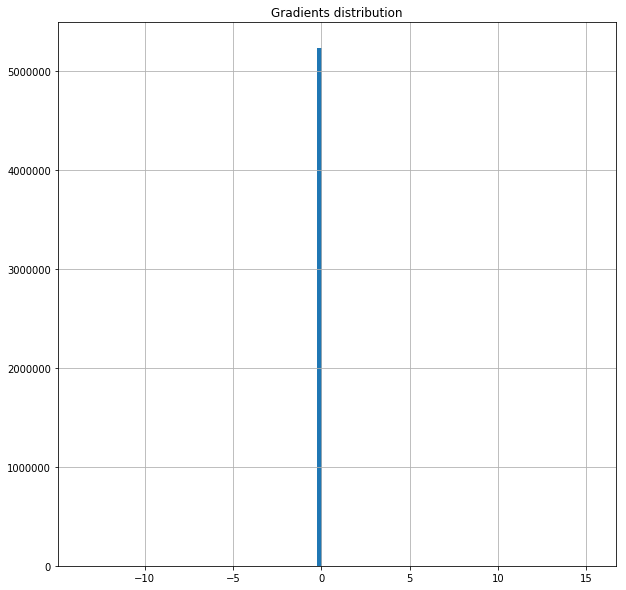

On iter 7351 with training PPL: 50.275753021240234, training ACC 0.2825520932674408
On iter 7352 with training PPL: 44.74726867675781, training ACC 0.3177083432674408
On iter 7353 with training PPL: 51.576622009277344, training ACC 0.2877604067325592
On iter 7354 with training PPL: 50.38319396972656, training ACC 0.2947048544883728
On iter 7355 with training PPL: 55.23812484741211, training ACC 0.28515625
On iter 7356 with training PPL: 58.54887390136719, training ACC 0.2862413227558136
On iter 7357 with training PPL: 51.29642868041992, training ACC 0.29296875
On iter 7358 with training PPL: 52.13933181762695, training ACC 0.2964409589767456
On iter 7359 with training PPL: 53.51832580566406, training ACC 0.2840711772441864
On iter 7360 with training PPL: 52.0848274230957, training ACC 0.2994791567325592
On iter 7361 with training PPL: 53.09520721435547, training ACC 0.2897135317325592
On iter 7362 with training PPL: 47.22514724731445, training ACC 0.3122829794883728
On iter 7363 with t

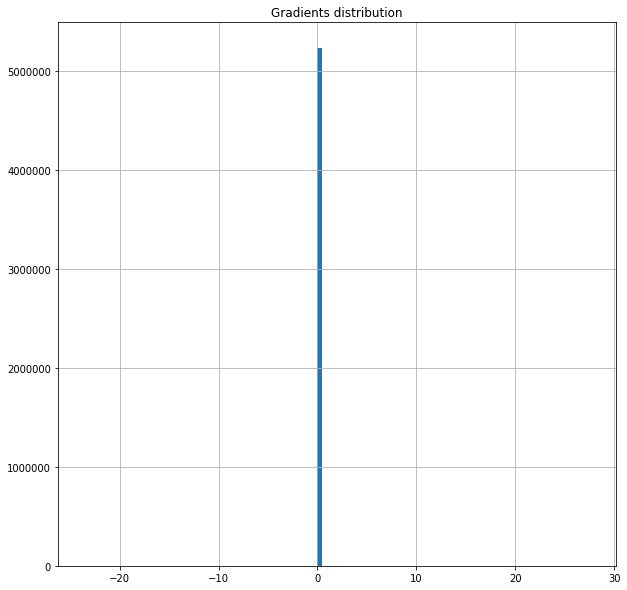

On iter 7381 with training PPL: 64.25885009765625, training ACC 0.2697482705116272
On iter 7382 with training PPL: 63.23103332519531, training ACC 0.2782118022441864
On iter 7383 with training PPL: 57.4290885925293, training ACC 0.2795138955116272
On iter 7384 with training PPL: 62.239776611328125, training ACC 0.2634548544883728
On iter 7385 with training PPL: 49.65841293334961, training ACC 0.3040364682674408
On iter 7386 with training PPL: 50.989654541015625, training ACC 0.287109375
On iter 7387 with training PPL: 52.11177062988281, training ACC 0.2860243022441864
On iter 7388 with training PPL: 54.558448791503906, training ACC 0.2816840410232544
On iter 7389 with training PPL: 50.530853271484375, training ACC 0.2927517294883728
On iter 7390 with training PPL: 50.3941764831543, training ACC 0.2964409589767456
On iter 7391 with training PPL: 58.36835479736328, training ACC 0.2823350727558136
On iter 7392 with training PPL: 54.2341194152832, training ACC 0.2888454794883728
On iter 73

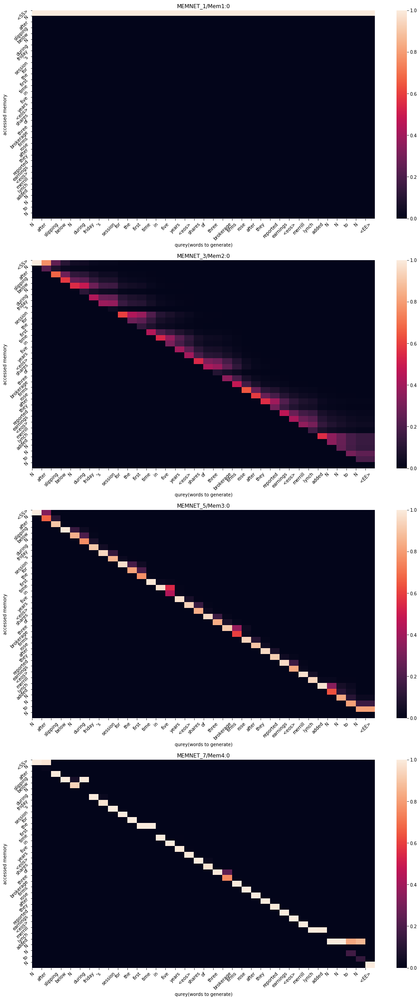

On iter 7401 with training PPL: 52.12793731689453, training ACC 0.2853732705116272
On iter 7402 with training PPL: 45.00119400024414, training ACC 0.3111979067325592
On iter 7403 with training PPL: 56.110328674316406, training ACC 0.2771267294883728
On iter 7404 with training PPL: 51.59619903564453, training ACC 0.2862413227558136
On iter 7405 with training PPL: 49.7863883972168, training ACC 0.2953559160232544
On iter 7406 with training PPL: 55.42854690551758, training ACC 0.2884114682674408
On iter 7407 with training PPL: 61.54191589355469, training ACC 0.255859375
On iter 7408 with training PPL: 53.47060012817383, training ACC 0.2866753339767456
On iter 7409 with training PPL: 56.34664535522461, training ACC 0.2853732705116272
On iter 7410 with training PPL: 56.2054443359375, training ACC 0.2884114682674408
	 validation PPL 235.97503662109375, validation acc 0.2328559011220932
shape of gradients is (5228544,), L2 norm of gradients is 62.74346160888672, details:                   0
c

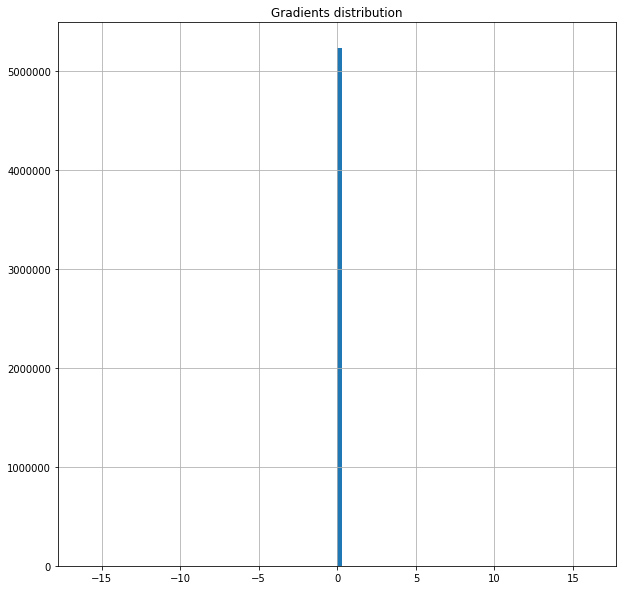

On iter 7411 with training PPL: 56.92576599121094, training ACC 0.2786458432674408
On iter 7412 with training PPL: 49.093963623046875, training ACC 0.2957899272441864
On iter 7413 with training PPL: 49.654541015625, training ACC 0.2994791567325592
On iter 7414 with training PPL: 59.56275177001953, training ACC 0.2699652910232544
On iter 7415 with training PPL: 45.4813117980957, training ACC 0.3046875
On iter 7416 with training PPL: 60.06715774536133, training ACC 0.2740885317325592
On iter 7417 with training PPL: 51.86398696899414, training ACC 0.2927517294883728
On iter 7418 with training PPL: 53.755027770996094, training ACC 0.2881944477558136
On iter 7419 with training PPL: 53.28358840942383, training ACC 0.2934027910232544
On iter 7420 with training PPL: 48.7402458190918, training ACC 0.3031684160232544
On iter 7421 with training PPL: 46.93185806274414, training ACC 0.3090277910232544
On iter 7422 with training PPL: 54.15060043334961, training ACC 0.2899305522441864
On iter 7423 wi

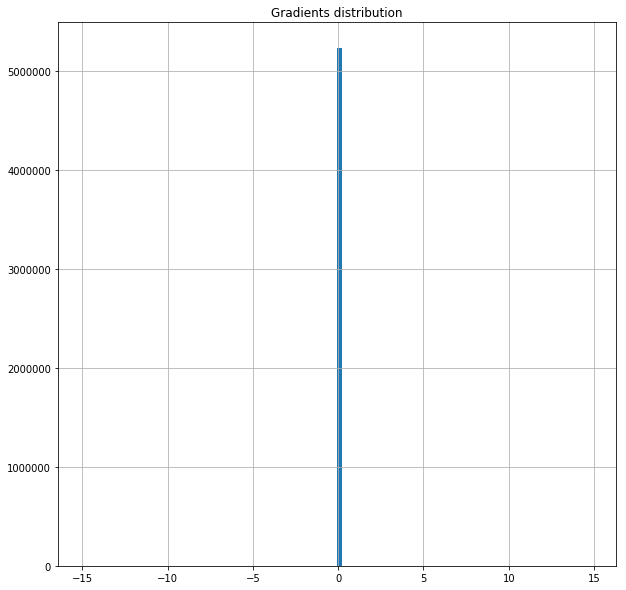

On iter 7441 with training PPL: 47.35678482055664, training ACC 0.3040364682674408
On iter 7442 with training PPL: 53.71464920043945, training ACC 0.2827690839767456
On iter 7443 with training PPL: 50.265647888183594, training ACC 0.2966579794883728
On iter 7444 with training PPL: 51.48122787475586, training ACC 0.3003472089767456
On iter 7445 with training PPL: 50.70753479003906, training ACC 0.2938368022441864
On iter 7446 with training PPL: 52.381839752197266, training ACC 0.2858072817325592
On iter 7447 with training PPL: 59.82975769042969, training ACC 0.2764756977558136
On iter 7448 with training PPL: 58.94660186767578, training ACC 0.2782118022441864
On iter 7449 with training PPL: 48.32967758178711, training ACC 0.3055555522441864
On iter 7450 with training PPL: 54.32403564453125, training ACC 0.28125
On iter 7451 with training PPL: 49.879093170166016, training ACC 0.3057725727558136
On iter 7452 with training PPL: 52.46599578857422, training ACC 0.2881944477558136
On iter 7453

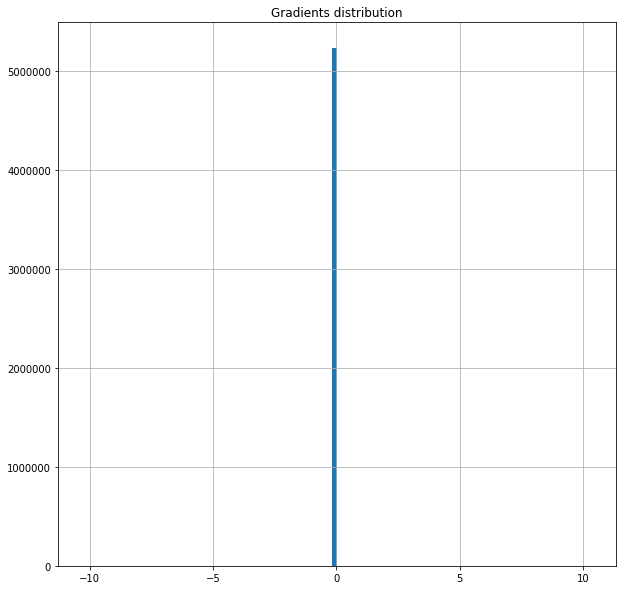

On iter 7471 with training PPL: 50.31941223144531, training ACC 0.3038194477558136
On iter 7472 with training PPL: 53.61422348022461, training ACC 0.2903645932674408
On iter 7473 with training PPL: 51.76157760620117, training ACC 0.294921875
On iter 7474 with training PPL: 51.704063415527344, training ACC 0.2901475727558136
On iter 7475 with training PPL: 57.984619140625, training ACC 0.2747395932674408
On iter 7476 with training PPL: 58.46977996826172, training ACC 0.2849392294883728
On iter 7477 with training PPL: 54.132957458496094, training ACC 0.2903645932674408
On iter 7478 with training PPL: 57.007747650146484, training ACC 0.2732204794883728
On iter 7479 with training PPL: 53.262542724609375, training ACC 0.2842881977558136
On iter 7480 with training PPL: 52.39494323730469, training ACC 0.3014322817325592
On iter 7481 with training PPL: 48.09251022338867, training ACC 0.3096788227558136
On iter 7482 with training PPL: 49.45729064941406, training ACC 0.2979600727558136
On iter 7

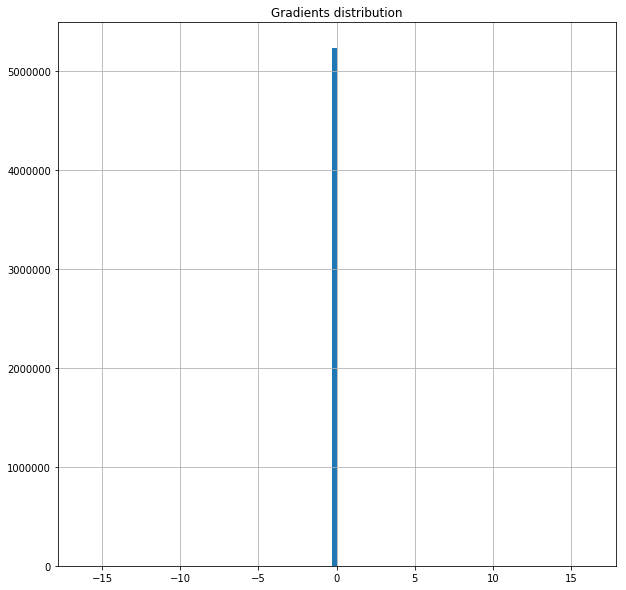

On iter 7501 with training PPL: 52.78306198120117, training ACC 0.2866753339767456
On iter 7502 with training PPL: 51.72325897216797, training ACC 0.2918836772441864
On iter 7503 with training PPL: 51.455787658691406, training ACC 0.2886284589767456
On iter 7504 with training PPL: 52.275245666503906, training ACC 0.2884114682674408
On iter 7505 with training PPL: 50.59408950805664, training ACC 0.2894965410232544
On iter 7506 with training PPL: 56.54603958129883, training ACC 0.2925347089767456
On iter 7507 with training PPL: 49.43122482299805, training ACC 0.3016493022441864
On iter 7508 with training PPL: 57.0410270690918, training ACC 0.2838541567325592
On iter 7509 with training PPL: 49.38475036621094, training ACC 0.2964409589767456
On iter 7510 with training PPL: 53.43058395385742, training ACC 0.2853732705116272
On iter 7511 with training PPL: 49.74599838256836, training ACC 0.2962239682674408
On iter 7512 with training PPL: 54.005489349365234, training ACC 0.2840711772441864
On

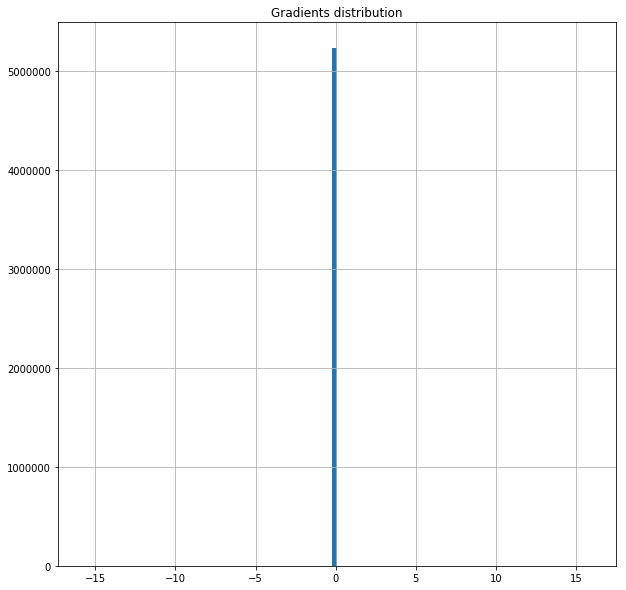

On iter 7531 with training PPL: 59.30448913574219, training ACC 0.279296875
On iter 7532 with training PPL: 54.499629974365234, training ACC 0.2931857705116272
On iter 7533 with training PPL: 49.463951110839844, training ACC 0.2947048544883728
On iter 7534 with training PPL: 50.030029296875, training ACC 0.2970920205116272
On iter 7535 with training PPL: 57.41339874267578, training ACC 0.2801649272441864
On iter 7536 with training PPL: 49.66682052612305, training ACC 0.3070746660232544
On iter 7537 with training PPL: 56.14397048950195, training ACC 0.2858072817325592
On iter 7538 with training PPL: 49.84584045410156, training ACC 0.2892795205116272
On iter 7539 with training PPL: 51.72793197631836, training ACC 0.2782118022441864
On iter 7540 with training PPL: 49.2014274597168, training ACC 0.2977430522441864
On iter 7541 with training PPL: 49.82505798339844, training ACC 0.2953559160232544
On iter 7542 with training PPL: 51.183048248291016, training ACC 0.2884114682674408
On iter 754

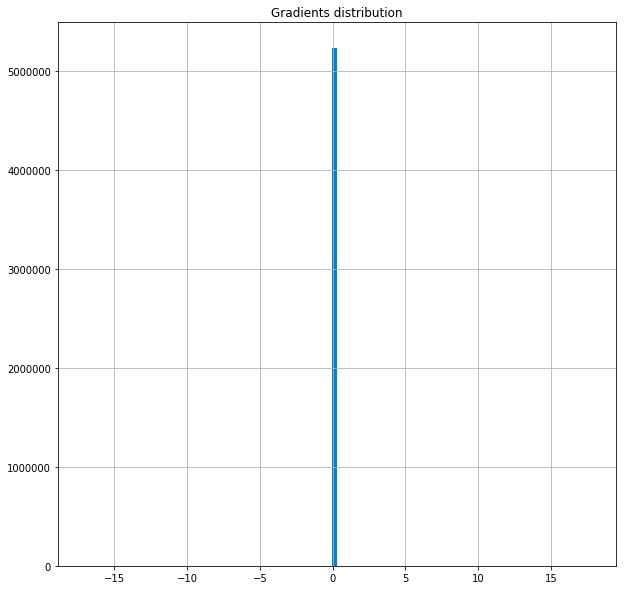

On iter 7561 with training PPL: 47.65684509277344, training ACC 0.3029513955116272
On iter 7562 with training PPL: 54.711570739746094, training ACC 0.2897135317325592
On iter 7563 with training PPL: 53.543209075927734, training ACC 0.2901475727558136
On iter 7564 with training PPL: 55.37275314331055, training ACC 0.2766927182674408
On iter 7565 with training PPL: 53.611385345458984, training ACC 0.2888454794883728
On iter 7566 with training PPL: 51.00762176513672, training ACC 0.2912326455116272
On iter 7567 with training PPL: 55.44430160522461, training ACC 0.2803819477558136
On iter 7568 with training PPL: 55.450645446777344, training ACC 0.2756076455116272
On iter 7569 with training PPL: 51.39210510253906, training ACC 0.2858072817325592
On iter 7570 with training PPL: 56.977745056152344, training ACC 0.2799479067325592
On iter 7571 with training PPL: 50.678382873535156, training ACC 0.3042534589767456
On iter 7572 with training PPL: 487.0878601074219, training ACC 0.166883677244186

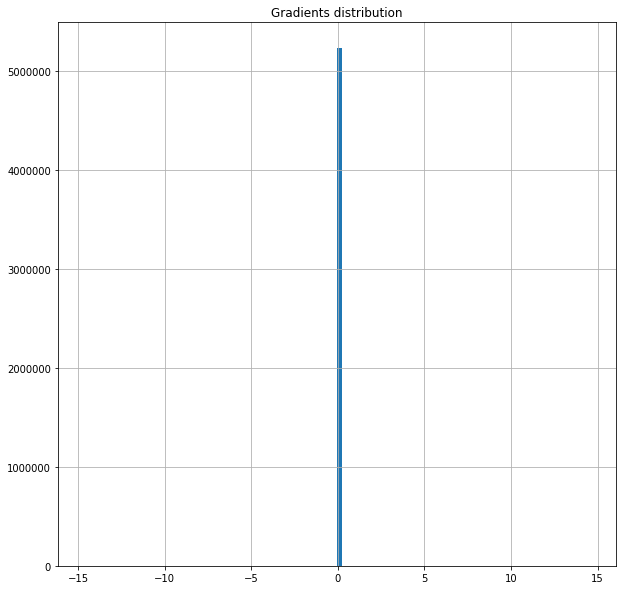

On iter 7591 with training PPL: 63.39339828491211, training ACC 0.2641059160232544
On iter 7592 with training PPL: 55.91938018798828, training ACC 0.2877604067325592
On iter 7593 with training PPL: 54.43671417236328, training ACC 0.2903645932674408
On iter 7594 with training PPL: 54.41923522949219, training ACC 0.2907986044883728
On iter 7595 with training PPL: 53.26784896850586, training ACC 0.2894965410232544
On iter 7596 with training PPL: 46.64976119995117, training ACC 0.3116319477558136
On iter 7597 with training PPL: 61.234619140625, training ACC 0.2764756977558136
On iter 7598 with training PPL: 58.29161834716797, training ACC 0.2745225727558136
On iter 7599 with training PPL: 55.077476501464844, training ACC 0.2699652910232544
On iter 7600 with training PPL: 61.652915954589844, training ACC 0.2677951455116272
<SS> york <unk> to the company 's executives <eos> he visits the same department every two or three weeks <eos> his massage chair is kept in a <unk> and a secretary <unk>

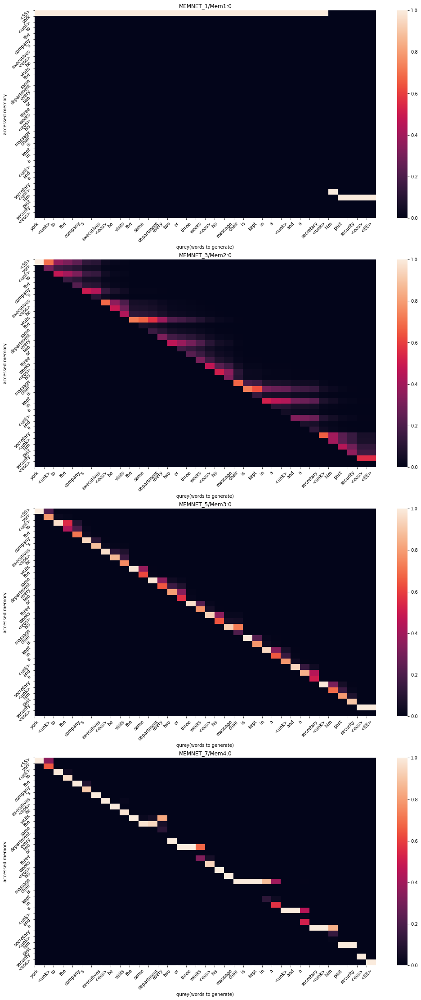

On iter 7601 with training PPL: 59.41241455078125, training ACC 0.2699652910232544
On iter 7602 with training PPL: 65.25910949707031, training ACC 0.2821180522441864
On iter 7603 with training PPL: 53.097991943359375, training ACC 0.2825520932674408
On iter 7604 with training PPL: 54.75082015991211, training ACC 0.2890625
On iter 7605 with training PPL: 47.93180465698242, training ACC 0.3151041567325592
On iter 7606 with training PPL: 65.4299545288086, training ACC 0.2758246660232544
On iter 7607 with training PPL: 89.77330780029297, training ACC 0.2237413227558136
On iter 7608 with training PPL: 57.771949768066406, training ACC 0.2923177182674408
On iter 7609 with training PPL: 52.13302230834961, training ACC 0.2931857705116272
On iter 7610 with training PPL: 71.42205047607422, training ACC 0.2578125
On iter 7611 with training PPL: 59.74671173095703, training ACC 0.2730034589767456
On iter 7612 with training PPL: 62.50838088989258, training ACC 0.2738715410232544
On iter 7613 with tra

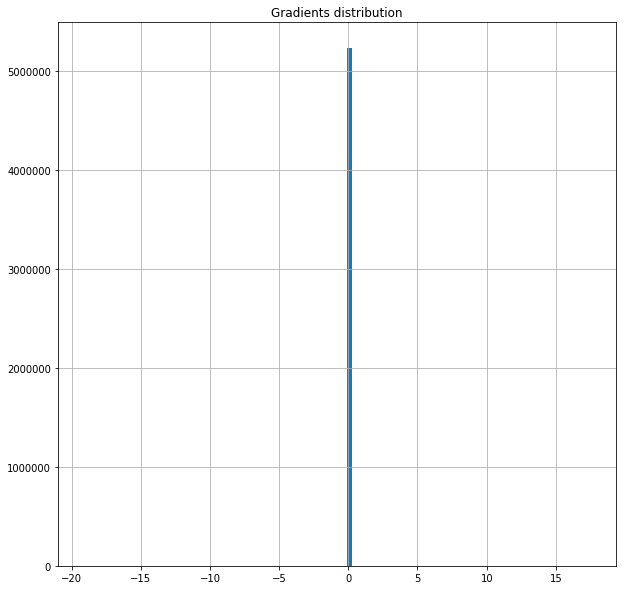

On iter 7621 with training PPL: 53.4207878112793, training ACC 0.2821180522441864
On iter 7622 with training PPL: 52.858821868896484, training ACC 0.2912326455116272
On iter 7623 with training PPL: 60.311519622802734, training ACC 0.2749565839767456
On iter 7624 with training PPL: 51.99192428588867, training ACC 0.2899305522441864
On iter 7625 with training PPL: 56.41740798950195, training ACC 0.2797309160232544
On iter 7626 with training PPL: 64.71949768066406, training ACC 0.2660590410232544
On iter 7627 with training PPL: 52.851905822753906, training ACC 0.2923177182674408
On iter 7628 with training PPL: 52.038021087646484, training ACC 0.2790798544883728
On iter 7629 with training PPL: 54.541526794433594, training ACC 0.2829861044883728
On iter 7630 with training PPL: 53.766502380371094, training ACC 0.2897135317325592
On iter 7631 with training PPL: 49.88534927368164, training ACC 0.2951388955116272
On iter 7632 with training PPL: 52.35771560668945, training ACC 0.2905815839767456

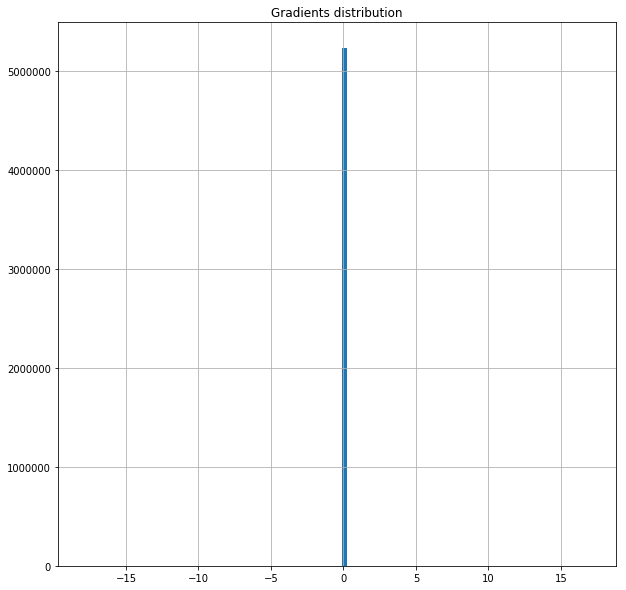

On iter 7651 with training PPL: 54.72842788696289, training ACC 0.2825520932674408
On iter 7652 with training PPL: 55.142860412597656, training ACC 0.2855902910232544
On iter 7653 with training PPL: 54.743404388427734, training ACC 0.287109375
On iter 7654 with training PPL: 49.05628967285156, training ACC 0.2868923544883728
On iter 7655 with training PPL: 50.73314666748047, training ACC 0.2953559160232544
On iter 7656 with training PPL: 56.4647216796875, training ACC 0.2751736044883728
On iter 7657 with training PPL: 48.694923400878906, training ACC 0.298828125
On iter 7658 with training PPL: 50.820518493652344, training ACC 0.2975260317325592
On iter 7659 with training PPL: 57.98724365234375, training ACC 0.2701822817325592
On iter 7660 with training PPL: 56.314842224121094, training ACC 0.2840711772441864
On iter 7661 with training PPL: 49.121070861816406, training ACC 0.2992621660232544
On iter 7662 with training PPL: 54.08656311035156, training ACC 0.29296875
On iter 7663 with tra

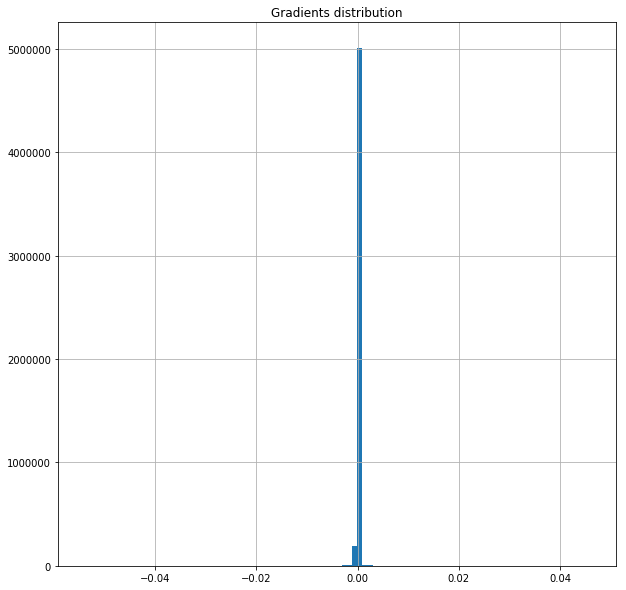

On iter 7681 with training PPL: 113.13015747070312, training ACC 0.2144097238779068
On iter 7682 with training PPL: 103.41382598876953, training ACC 0.232421875
On iter 7683 with training PPL: 103.48673248291016, training ACC 0.2328559011220932
On iter 7684 with training PPL: 102.99925231933594, training ACC 0.2280815988779068
On iter 7685 with training PPL: 102.8365249633789, training ACC 0.2326388955116272
On iter 7686 with training PPL: 97.47579956054688, training ACC 0.2421875
On iter 7687 with training PPL: 110.74270629882812, training ACC 0.2209201455116272
On iter 7688 with training PPL: 100.48444366455078, training ACC 0.2306857705116272
On iter 7689 with training PPL: 96.34062957763672, training ACC 0.2465277761220932
On iter 7690 with training PPL: 107.88856506347656, training ACC 0.2243923544883728
On iter 7691 with training PPL: 94.18863677978516, training ACC 0.2350260466337204
On iter 7692 with training PPL: 93.60701751708984, training ACC 0.2389322966337204
On iter 7693 

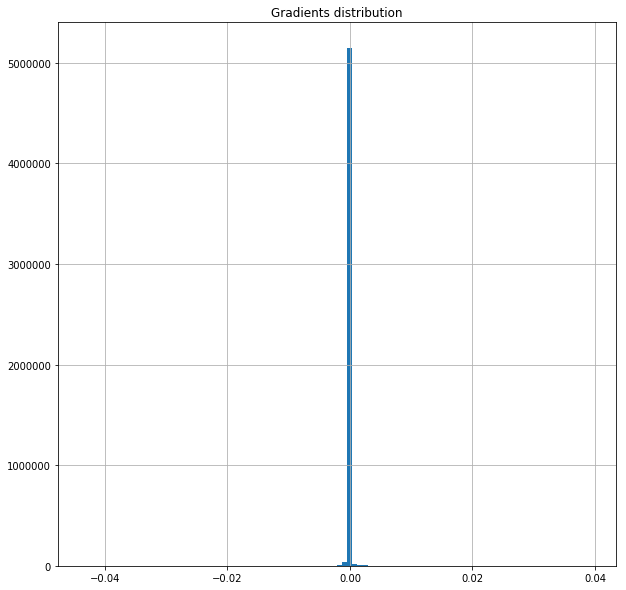

On iter 7711 with training PPL: 90.32254028320312, training ACC 0.2452256977558136
On iter 7712 with training PPL: 82.43119049072266, training ACC 0.25
On iter 7713 with training PPL: 90.89517974853516, training ACC 0.2419704794883728
On iter 7714 with training PPL: 84.06201171875, training ACC 0.2456597238779068
On iter 7715 with training PPL: 90.73101806640625, training ACC 0.2356770783662796
On iter 7716 with training PPL: 83.09133911132812, training ACC 0.25
On iter 7717 with training PPL: 81.47076416015625, training ACC 0.2465277761220932
On iter 7718 with training PPL: 89.02721405029297, training ACC 0.2365451455116272
On iter 7719 with training PPL: 80.0633544921875, training ACC 0.2471788227558136
On iter 7720 with training PPL: 78.47283172607422, training ACC 0.2450086772441864
On iter 7721 with training PPL: 95.99250030517578, training ACC 0.2326388955116272
On iter 7722 with training PPL: 83.63874816894531, training ACC 0.2387152761220932
On iter 7723 with training PPL: 76.7

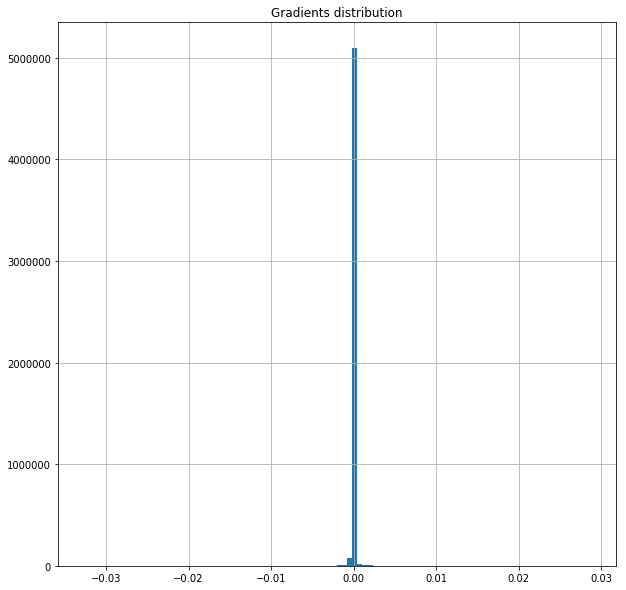

On iter 7741 with training PPL: 79.22081756591797, training ACC 0.2575954794883728
On iter 7742 with training PPL: 80.46195983886719, training ACC 0.2582465410232544
On iter 7743 with training PPL: 83.36473846435547, training ACC 0.2387152761220932
On iter 7744 with training PPL: 74.04522705078125, training ACC 0.2630208432674408
On iter 7745 with training PPL: 79.5669937133789, training ACC 0.251953125
On iter 7746 with training PPL: 88.17326354980469, training ACC 0.2434895783662796
On iter 7747 with training PPL: 85.02452087402344, training ACC 0.2371961772441864
On iter 7748 with training PPL: 78.38008117675781, training ACC 0.2562934160232544
On iter 7749 with training PPL: 77.1194839477539, training ACC 0.2508680522441864
On iter 7750 with training PPL: 82.24015045166016, training ACC 0.2478298544883728
On iter 7751 with training PPL: 86.5798568725586, training ACC 0.2463107705116272
On iter 7752 with training PPL: 77.70700073242188, training ACC 0.2547743022441864
On iter 7753 w

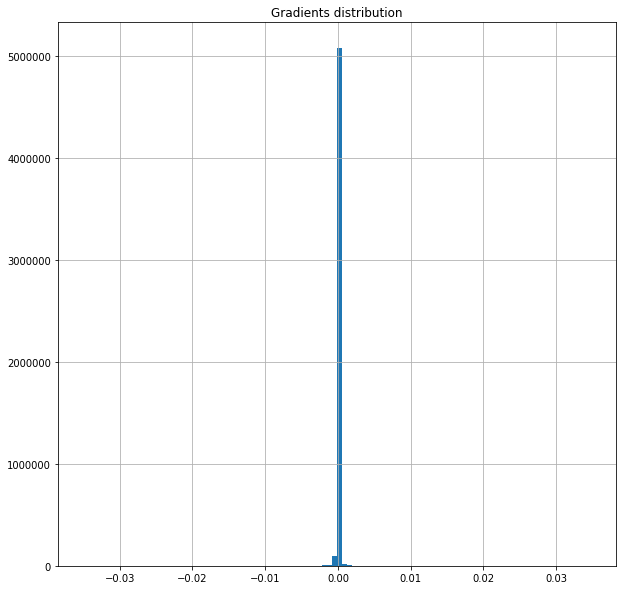

On iter 7771 with training PPL: 81.38130187988281, training ACC 0.2428385466337204
On iter 7772 with training PPL: 75.0345230102539, training ACC 0.2643229067325592
On iter 7773 with training PPL: 80.77229309082031, training ACC 0.2428385466337204
On iter 7774 with training PPL: 89.37684631347656, training ACC 0.2465277761220932
On iter 7775 with training PPL: 80.2792739868164, training ACC 0.2504340410232544
On iter 7776 with training PPL: 82.60432434082031, training ACC 0.240234375
On iter 7777 with training PPL: 79.08939361572266, training ACC 0.2532552182674408
On iter 7778 with training PPL: 85.43531799316406, training ACC 0.2389322966337204
On iter 7779 with training PPL: 73.40726470947266, training ACC 0.2658420205116272
On iter 7780 with training PPL: 82.98589324951172, training ACC 0.2513020932674408
On iter 7781 with training PPL: 72.6386489868164, training ACC 0.2621527910232544
On iter 7782 with training PPL: 85.93444061279297, training ACC 0.2384982705116272
On iter 7783 w

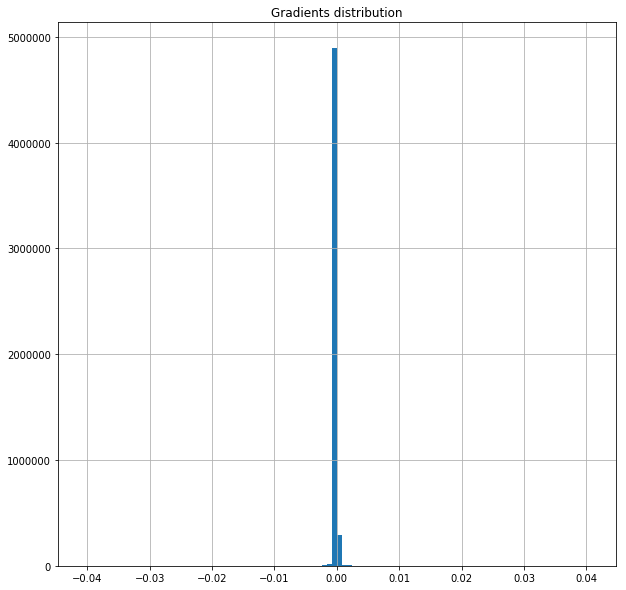

<SS> ventures the lot airline and <unk> tourist organization <eos> <unk> plans to increase natural-gas sales to europe and the u.s. <eos> according to the middle east economic survey the north african nation is holding talks <EE>


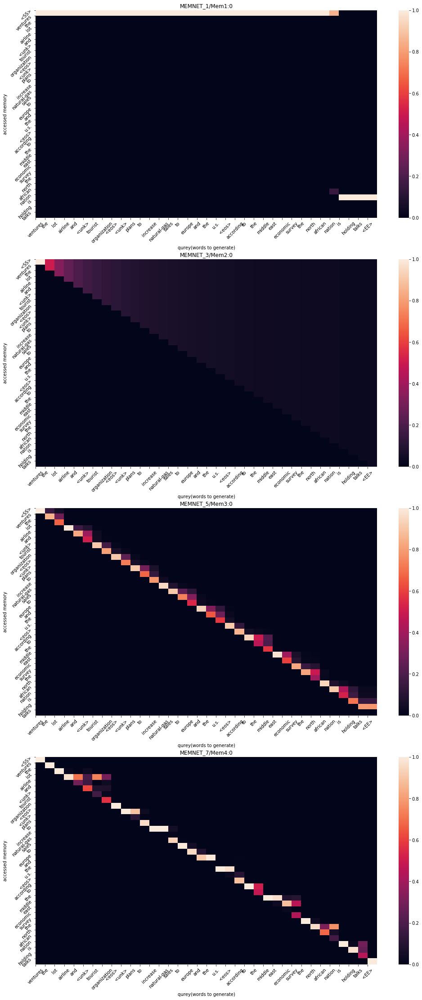

On iter 7801 with training PPL: 75.29351043701172, training ACC 0.25390625
On iter 7802 with training PPL: 79.82764434814453, training ACC 0.2454427033662796
On iter 7803 with training PPL: 77.20006561279297, training ACC 0.2536892294883728
On iter 7804 with training PPL: 79.42120361328125, training ACC 0.2513020932674408
On iter 7805 with training PPL: 68.27141571044922, training ACC 0.2708333432674408
On iter 7806 with training PPL: 79.5826187133789, training ACC 0.2502170205116272
On iter 7807 with training PPL: 78.00313568115234, training ACC 0.2515190839767456
On iter 7808 with training PPL: 84.96551513671875, training ACC 0.2510850727558136
On iter 7809 with training PPL: 72.40060424804688, training ACC 0.2643229067325592
On iter 7810 with training PPL: 75.70709228515625, training ACC 0.2560763955116272
On iter 7811 with training PPL: 75.4647445678711, training ACC 0.2599826455116272
On iter 7812 with training PPL: 80.0854263305664, training ACC 0.24609375
On iter 7813 with train

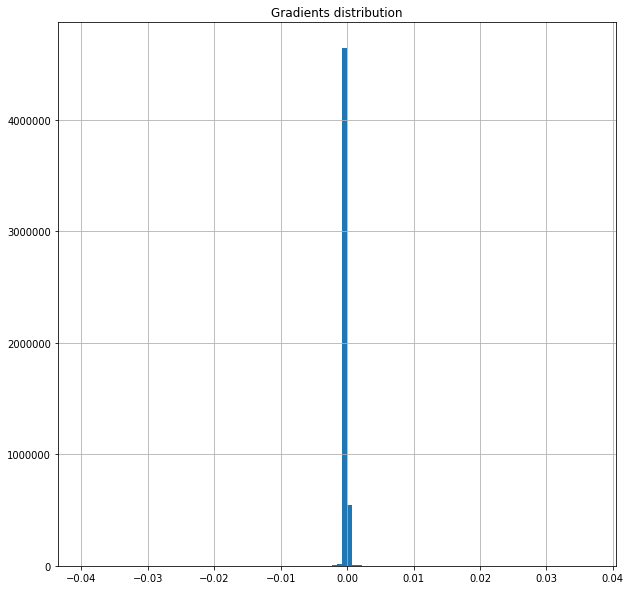

On iter 7831 with training PPL: 65.0899887084961, training ACC 0.2849392294883728
On iter 7832 with training PPL: 74.00230407714844, training ACC 0.2593315839767456
On iter 7833 with training PPL: 69.62963104248047, training ACC 0.2619357705116272
On iter 7834 with training PPL: 75.37059783935547, training ACC 0.2506510317325592
On iter 7835 with training PPL: 80.3534164428711, training ACC 0.2463107705116272
On iter 7836 with training PPL: 80.62137603759766, training ACC 0.2426215261220932
On iter 7837 with training PPL: 76.24584197998047, training ACC 0.2595486044883728
On iter 7838 with training PPL: 80.28738403320312, training ACC 0.244140625
On iter 7839 with training PPL: 73.35935974121094, training ACC 0.2573784589767456
On iter 7840 with training PPL: 85.3172607421875, training ACC 0.2413194477558136
On iter 7841 with training PPL: 74.23822021484375, training ACC 0.2601996660232544
On iter 7842 with training PPL: 72.7771224975586, training ACC 0.2584635317325592
On iter 7843 wi

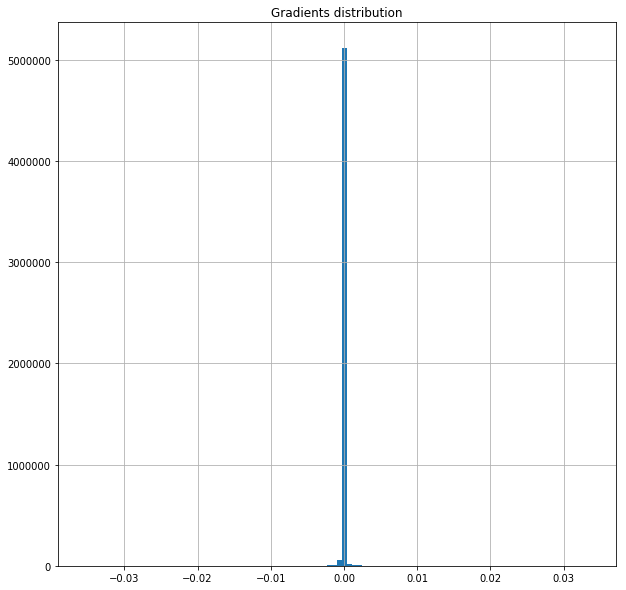

On iter 7861 with training PPL: 76.23101043701172, training ACC 0.2517361044883728
On iter 7862 with training PPL: 83.88806915283203, training ACC 0.2463107705116272
On iter 7863 with training PPL: 68.65743255615234, training ACC 0.2664930522441864
On iter 7864 with training PPL: 70.22994232177734, training ACC 0.2688802182674408
On iter 7865 with training PPL: 71.62699127197266, training ACC 0.2673611044883728
On iter 7866 with training PPL: 72.51811218261719, training ACC 0.2515190839767456
On iter 7867 with training PPL: 73.35128021240234, training ACC 0.2554253339767456
On iter 7868 with training PPL: 74.56450653076172, training ACC 0.2552083432674408
On iter 7869 with training PPL: 69.7626724243164, training ACC 0.2645399272441864
On iter 7870 with training PPL: 67.65677642822266, training ACC 0.2684461772441864
On iter 7871 with training PPL: 76.90803527832031, training ACC 0.2543402910232544
On iter 7872 with training PPL: 71.71560668945312, training ACC 0.2599826455116272
On it

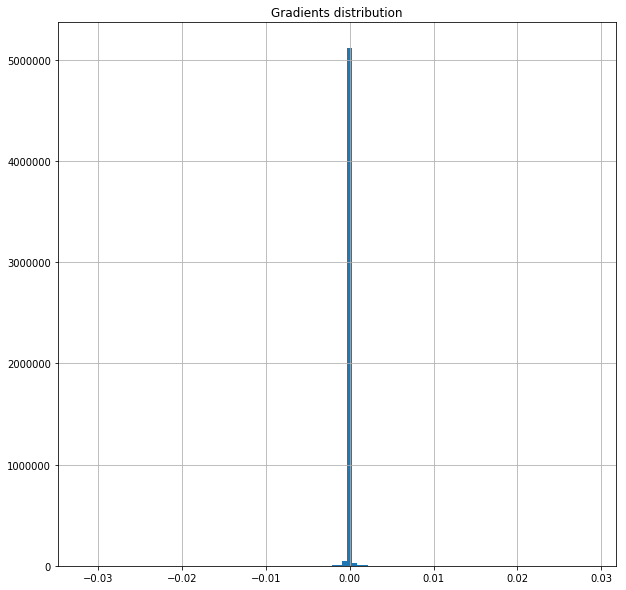

On iter 7891 with training PPL: 68.99641418457031, training ACC 0.2682291567325592
On iter 7892 with training PPL: 72.65811920166016, training ACC 0.2575954794883728
On iter 7893 with training PPL: 74.87693786621094, training ACC 0.2569444477558136
On iter 7894 with training PPL: 74.22671508789062, training ACC 0.255859375
On iter 7895 with training PPL: 70.2683334350586, training ACC 0.2630208432674408
On iter 7896 with training PPL: 76.52703857421875, training ACC 0.2486979216337204
On iter 7897 with training PPL: 66.16329193115234, training ACC 0.2591145932674408
On iter 7898 with training PPL: 70.0516128540039, training ACC 0.2526041567325592
On iter 7899 with training PPL: 66.04209899902344, training ACC 0.2571614682674408
On iter 7900 with training PPL: 74.39502716064453, training ACC 0.2554253339767456
On iter 7901 with training PPL: 70.23660278320312, training ACC 0.2721354067325592
On iter 7902 with training PPL: 74.00982666015625, training ACC 0.2552083432674408
On iter 7903 

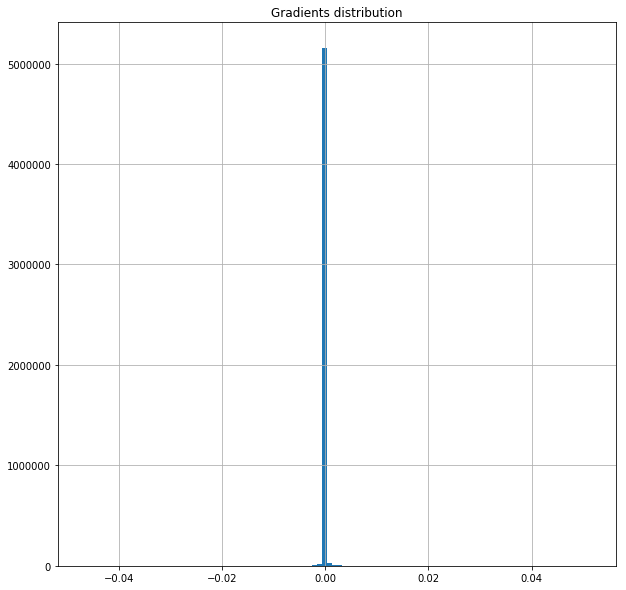

On iter 7921 with training PPL: 78.09963989257812, training ACC 0.2506510317325592
On iter 7922 with training PPL: 85.49628448486328, training ACC 0.2389322966337204
On iter 7923 with training PPL: 84.33125305175781, training ACC 0.2476128488779068
On iter 7924 with training PPL: 64.01465606689453, training ACC 0.2667100727558136
On iter 7925 with training PPL: 71.7529296875, training ACC 0.2549913227558136
On iter 7926 with training PPL: 62.11362075805664, training ACC 0.2805989682674408
On iter 7927 with training PPL: 76.40361785888672, training ACC 0.2528211772441864
On iter 7928 with training PPL: 61.62602233886719, training ACC 0.2766927182674408
On iter 7929 with training PPL: 68.79631042480469, training ACC 0.2545572817325592
On iter 7930 with training PPL: 69.01395416259766, training ACC 0.271484375
On iter 7931 with training PPL: 74.38197326660156, training ACC 0.2513020932674408
On iter 7932 with training PPL: 67.40373992919922, training ACC 0.2588975727558136
On iter 7933 wi

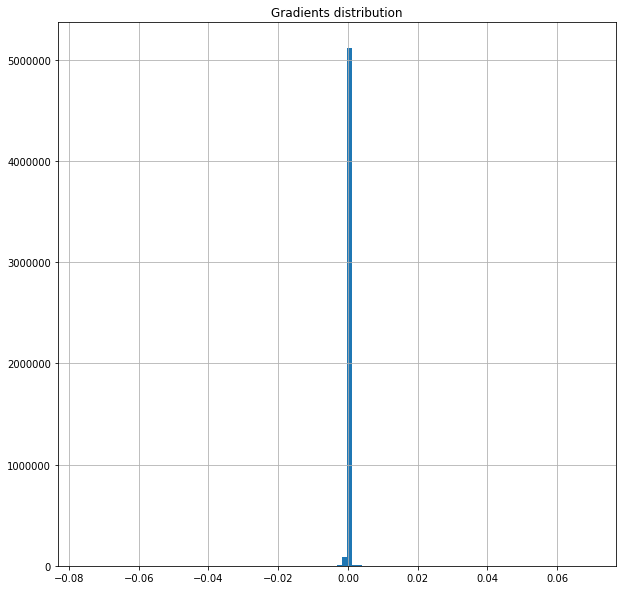

On iter 7951 with training PPL: 63.89888381958008, training ACC 0.2641059160232544
On iter 7952 with training PPL: 72.36184692382812, training ACC 0.2601996660232544
On iter 7953 with training PPL: 73.06694793701172, training ACC 0.2554253339767456
On iter 7954 with training PPL: 67.35365295410156, training ACC 0.271484375
On iter 7955 with training PPL: 70.62265014648438, training ACC 0.2660590410232544
On iter 7956 with training PPL: 74.26541137695312, training ACC 0.263671875
On iter 7957 with training PPL: 67.42524719238281, training ACC 0.2645399272441864
On iter 7958 with training PPL: 76.56378936767578, training ACC 0.2573784589767456
On iter 7959 with training PPL: 67.08927917480469, training ACC 0.2721354067325592
On iter 7960 with training PPL: 60.382938385009766, training ACC 0.2838541567325592
On iter 7961 with training PPL: 66.95182037353516, training ACC 0.27734375
On iter 7962 with training PPL: 71.96626281738281, training ACC 0.2625868022441864
On iter 7963 with trainin

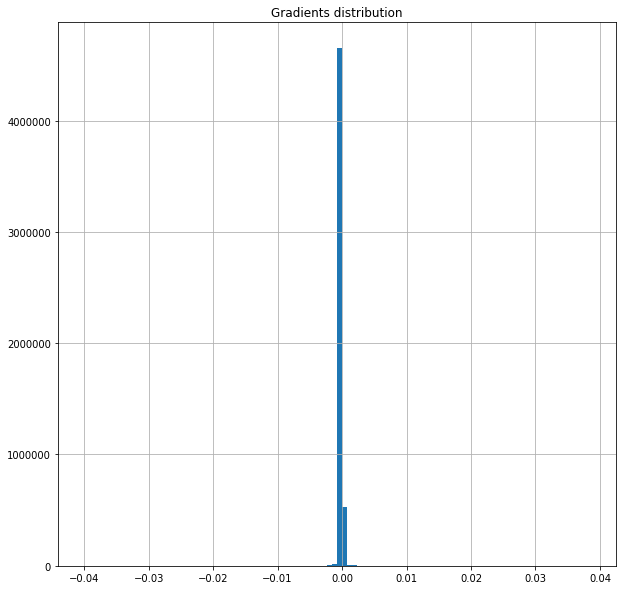

On iter 7981 with training PPL: 74.16458892822266, training ACC 0.2556423544883728
On iter 7982 with training PPL: 72.48806762695312, training ACC 0.2532552182674408
On iter 7983 with training PPL: 74.46796417236328, training ACC 0.2484809011220932
On iter 7984 with training PPL: 69.76007843017578, training ACC 0.2606336772441864
On iter 7985 with training PPL: 73.17008209228516, training ACC 0.2571614682674408
On iter 7986 with training PPL: 66.16729736328125, training ACC 0.2671440839767456
On iter 7987 with training PPL: 71.72289276123047, training ACC 0.2573784589767456
On iter 7988 with training PPL: 72.23463439941406, training ACC 0.2543402910232544
On iter 7989 with training PPL: 77.8087387084961, training ACC 0.2521701455116272
On iter 7990 with training PPL: 70.96504211425781, training ACC 0.2573784589767456
On iter 7991 with training PPL: 66.66520690917969, training ACC 0.2677951455116272
On iter 7992 with training PPL: 68.25211334228516, training ACC 0.2654079794883728
On it

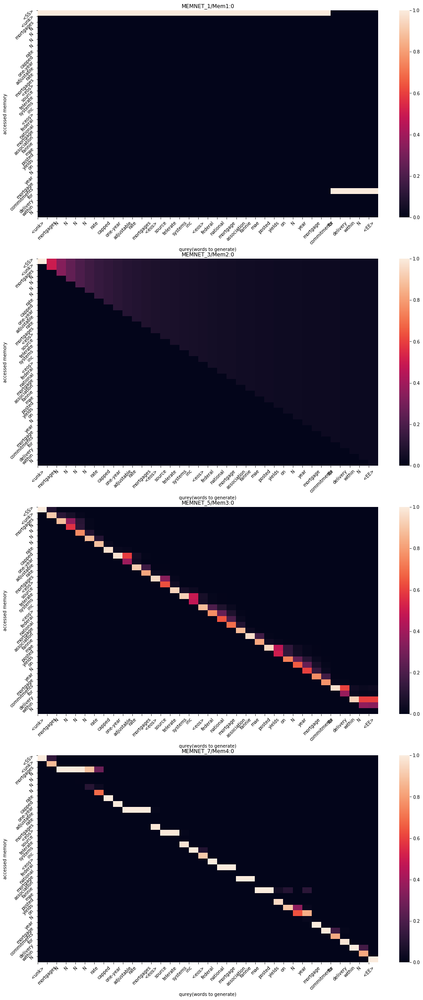

On iter 8001 with training PPL: 76.03504943847656, training ACC 0.2467447966337204
On iter 8002 with training PPL: 69.3063735961914, training ACC 0.2560763955116272
On iter 8003 with training PPL: 70.75701141357422, training ACC 0.2682291567325592
On iter 8004 with training PPL: 73.71070098876953, training ACC 0.2491319477558136
On iter 8005 with training PPL: 62.160823822021484, training ACC 0.2769097089767456
On iter 8006 with training PPL: 75.67301940917969, training ACC 0.2458767294883728
On iter 8007 with training PPL: 66.05806732177734, training ACC 0.2710503339767456
On iter 8008 with training PPL: 75.01573944091797, training ACC 0.2502170205116272
On iter 8009 with training PPL: 66.5938491821289, training ACC 0.2660590410232544
On iter 8010 with training PPL: 65.21524810791016, training ACC 0.2667100727558136
	 validation PPL 160.15167236328125, validation acc 0.2330729216337204
shape of gradients is (5228544,), L2 norm of gradients is 0.6946766376495361, details:              

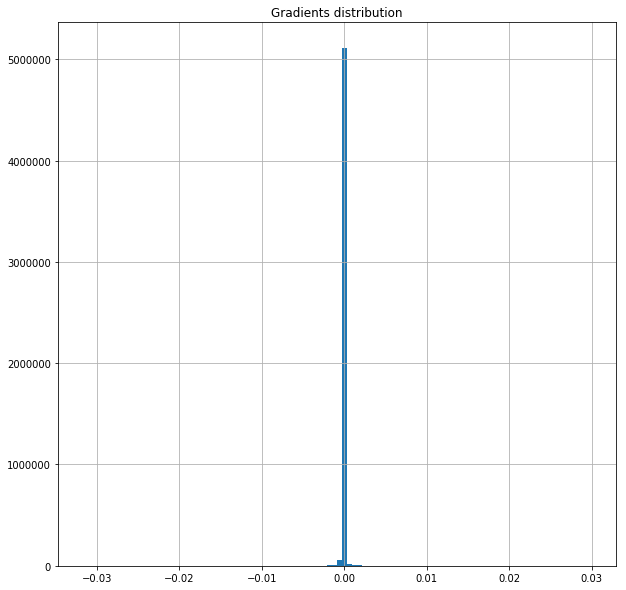

On iter 8011 with training PPL: 64.12555694580078, training ACC 0.2788628339767456
On iter 8012 with training PPL: 68.3708724975586, training ACC 0.2667100727558136
On iter 8013 with training PPL: 64.54795837402344, training ACC 0.2725694477558136
On iter 8014 with training PPL: 60.48682403564453, training ACC 0.2777777910232544
On iter 8015 with training PPL: 72.40391540527344, training ACC 0.2560763955116272
On iter 8016 with training PPL: 71.94371795654297, training ACC 0.2604166567325592
On iter 8017 with training PPL: 70.20549774169922, training ACC 0.2536892294883728
On iter 8018 with training PPL: 70.3666763305664, training ACC 0.2556423544883728
On iter 8019 with training PPL: 69.38133239746094, training ACC 0.2593315839767456
On iter 8020 with training PPL: 74.40702056884766, training ACC 0.2523871660232544
On iter 8021 with training PPL: 74.20767974853516, training ACC 0.2580295205116272
On iter 8022 with training PPL: 63.53983688354492, training ACC 0.271484375
On iter 8023 

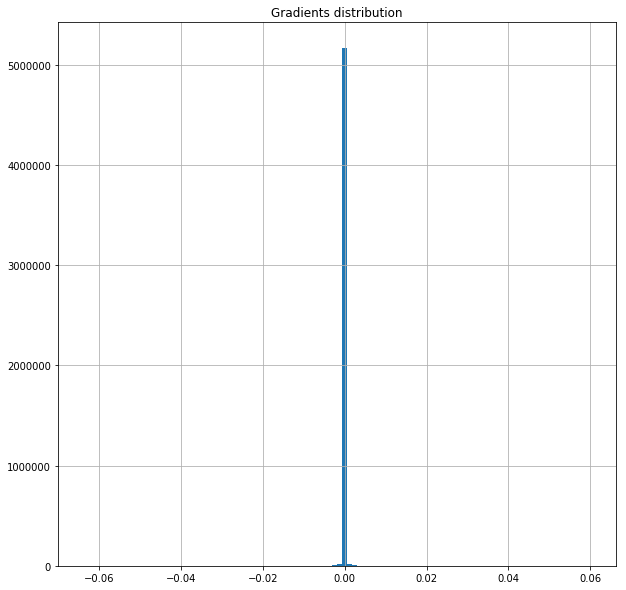

On iter 8041 with training PPL: 65.7408447265625, training ACC 0.2669270932674408
On iter 8042 with training PPL: 68.7972640991211, training ACC 0.265625
On iter 8043 with training PPL: 75.34282684326172, training ACC 0.2419704794883728
On iter 8044 with training PPL: 67.31088256835938, training ACC 0.2536892294883728
On iter 8045 with training PPL: 73.23674774169922, training ACC 0.2578125
On iter 8046 with training PPL: 65.34904479980469, training ACC 0.2732204794883728
On iter 8047 with training PPL: 73.14781951904297, training ACC 0.2599826455116272
On iter 8048 with training PPL: 61.666263580322266, training ACC 0.2845052182674408
On iter 8049 with training PPL: 69.16533660888672, training ACC 0.2610677182674408
On iter 8050 with training PPL: 73.60161590576172, training ACC 0.2528211772441864
On iter 8051 with training PPL: 69.4077377319336, training ACC 0.2615017294883728
On iter 8052 with training PPL: 62.66936492919922, training ACC 0.2736545205116272
On iter 8053 with trainin

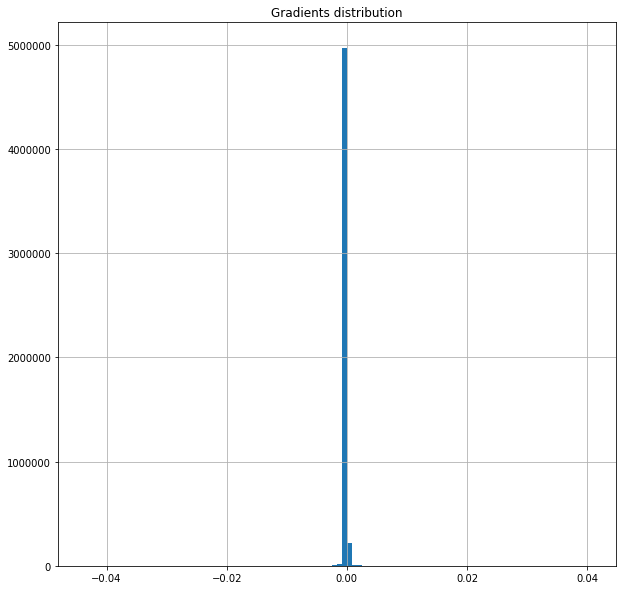

On iter 8071 with training PPL: 68.5924072265625, training ACC 0.2643229067325592
On iter 8072 with training PPL: 71.8938217163086, training ACC 0.2528211772441864
On iter 8073 with training PPL: 67.65780639648438, training ACC 0.2586805522441864
On iter 8074 with training PPL: 67.39750671386719, training ACC 0.2619357705116272
On iter 8075 with training PPL: 63.137786865234375, training ACC 0.275390625
On iter 8076 with training PPL: 72.487060546875, training ACC 0.2610677182674408
On iter 8077 with training PPL: 66.80815887451172, training ACC 0.2680121660232544
On iter 8078 with training PPL: 67.7907943725586, training ACC 0.265625
On iter 8079 with training PPL: 68.5943374633789, training ACC 0.2677951455116272
On iter 8080 with training PPL: 69.66145324707031, training ACC 0.259765625
On iter 8081 with training PPL: 66.5906753540039, training ACC 0.2630208432674408
On iter 8082 with training PPL: 75.04508209228516, training ACC 0.2513020932674408
On iter 8083 with training PPL: 68

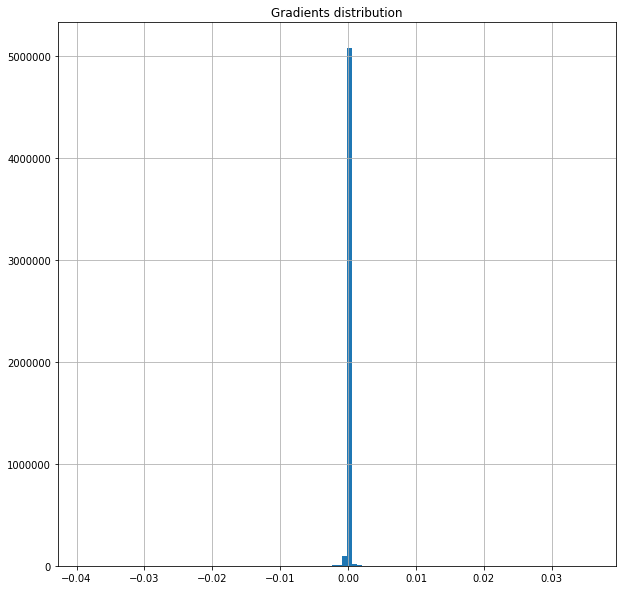

On iter 8101 with training PPL: 72.57498168945312, training ACC 0.2573784589767456
On iter 8102 with training PPL: 73.52900695800781, training ACC 0.2554253339767456
On iter 8103 with training PPL: 65.3243408203125, training ACC 0.2641059160232544
On iter 8104 with training PPL: 82.02279663085938, training ACC 0.248046875
On iter 8105 with training PPL: 65.75714874267578, training ACC 0.2584635317325592
On iter 8106 with training PPL: 65.07940673828125, training ACC 0.2669270932674408
On iter 8107 with training PPL: 72.41144561767578, training ACC 0.2562934160232544
On iter 8108 with training PPL: 67.97115325927734, training ACC 0.2621527910232544
On iter 8109 with training PPL: 70.52102661132812, training ACC 0.255859375
On iter 8110 with training PPL: 67.14643096923828, training ACC 0.2645399272441864
On iter 8111 with training PPL: 60.51734924316406, training ACC 0.2769097089767456
On iter 8112 with training PPL: 64.40131378173828, training ACC 0.2740885317325592
On iter 8113 with t

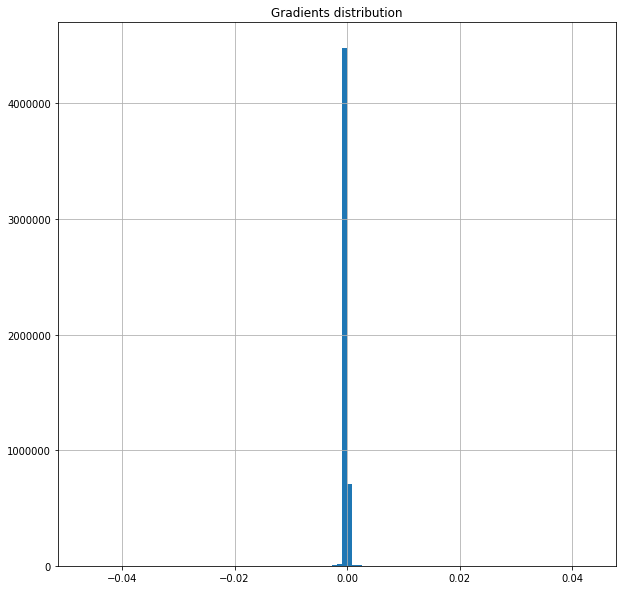

On iter 8131 with training PPL: 71.13532257080078, training ACC 0.2530381977558136
On iter 8132 with training PPL: 75.47341918945312, training ACC 0.2434895783662796
On iter 8133 with training PPL: 67.69979858398438, training ACC 0.25390625
On iter 8134 with training PPL: 66.1850357055664, training ACC 0.2595486044883728
On iter 8135 with training PPL: 67.1624755859375, training ACC 0.2664930522441864
On iter 8136 with training PPL: 74.87247467041016, training ACC 0.2471788227558136
On iter 8137 with training PPL: 76.85322570800781, training ACC 0.2452256977558136
On iter 8138 with training PPL: 66.15489959716797, training ACC 0.2727864682674408
On iter 8139 with training PPL: 67.09656524658203, training ACC 0.2719184160232544
On iter 8140 with training PPL: 66.57404327392578, training ACC 0.2730034589767456
On iter 8141 with training PPL: 66.3877944946289, training ACC 0.2667100727558136
On iter 8142 with training PPL: 71.77362823486328, training ACC 0.2549913227558136
On iter 8143 wi

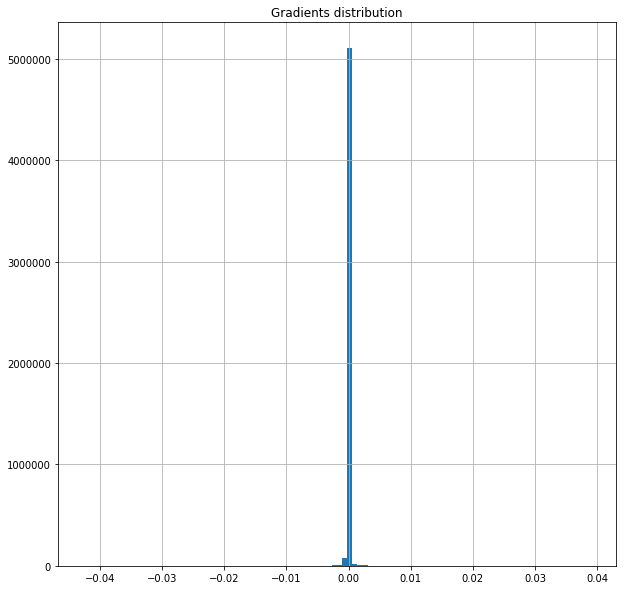

On iter 8161 with training PPL: 65.0957260131836, training ACC 0.2623697817325592
On iter 8162 with training PPL: 74.39332580566406, training ACC 0.2439236044883728
On iter 8163 with training PPL: 67.66029357910156, training ACC 0.2549913227558136
On iter 8164 with training PPL: 68.44175720214844, training ACC 0.2664930522441864
On iter 8165 with training PPL: 69.68035125732422, training ACC 0.2601996660232544
On iter 8166 with training PPL: 63.864463806152344, training ACC 0.2586805522441864
On iter 8167 with training PPL: 65.14012908935547, training ACC 0.2610677182674408
On iter 8168 with training PPL: 69.42266845703125, training ACC 0.2608506977558136
On iter 8169 with training PPL: 66.68402862548828, training ACC 0.2543402910232544
On iter 8170 with training PPL: 69.05223846435547, training ACC 0.2630208432674408
On iter 8171 with training PPL: 70.41175079345703, training ACC 0.2608506977558136
On iter 8172 with training PPL: 63.9180793762207, training ACC 0.2771267294883728
On it

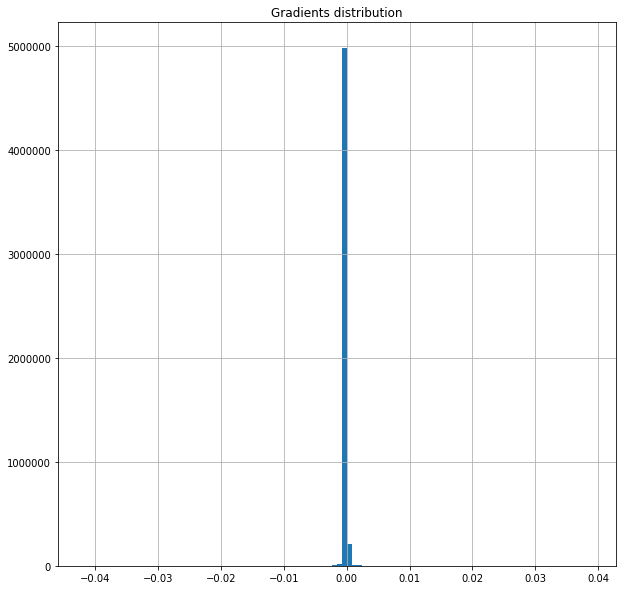

On iter 8191 with training PPL: 72.29255676269531, training ACC 0.2523871660232544
On iter 8192 with training PPL: 67.10603332519531, training ACC 0.2584635317325592
On iter 8193 with training PPL: 71.93881225585938, training ACC 0.2588975727558136
On iter 8194 with training PPL: 63.6544075012207, training ACC 0.2749565839767456
On iter 8195 with training PPL: 67.07999420166016, training ACC 0.2725694477558136
On iter 8196 with training PPL: 63.05808639526367, training ACC 0.2801649272441864
On iter 8197 with training PPL: 70.94038391113281, training ACC 0.2593315839767456
On iter 8198 with training PPL: 69.33087158203125, training ACC 0.2502170205116272
On iter 8199 with training PPL: 70.3120346069336, training ACC 0.2582465410232544
On iter 8200 with training PPL: 68.35200500488281, training ACC 0.2593315839767456
<SS> noted that revenue rose again in the u.s. in the third quarter following an increase in the second period <eos> the company said in a statement that demand for ibm pro

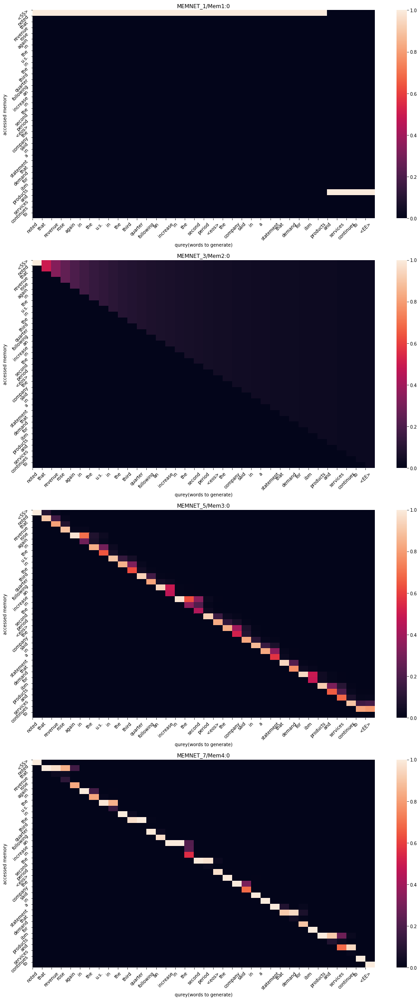

On iter 8201 with training PPL: 65.82127380371094, training ACC 0.2641059160232544
On iter 8202 with training PPL: 62.17469787597656, training ACC 0.2708333432674408
On iter 8203 with training PPL: 70.2086181640625, training ACC 0.2615017294883728
On iter 8204 with training PPL: 59.3934326171875, training ACC 0.2816840410232544
On iter 8205 with training PPL: 69.2288818359375, training ACC 0.2584635317325592
On iter 8206 with training PPL: 65.44683837890625, training ACC 0.2690972089767456
On iter 8207 with training PPL: 63.76805877685547, training ACC 0.265625
On iter 8208 with training PPL: 64.11344146728516, training ACC 0.2660590410232544
On iter 8209 with training PPL: 63.585941314697266, training ACC 0.2662760317325592
On iter 8210 with training PPL: 64.65546417236328, training ACC 0.2719184160232544
On iter 8211 with training PPL: 59.542274475097656, training ACC 0.2838541567325592
On iter 8212 with training PPL: 71.51859283447266, training ACC 0.2567274272441864
On iter 8213 wi

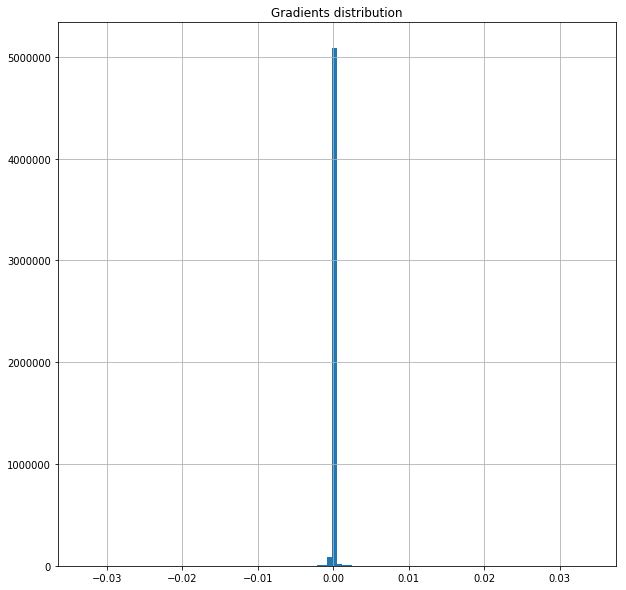

On iter 8221 with training PPL: 72.30799865722656, training ACC 0.25
On iter 8222 with training PPL: 66.92884063720703, training ACC 0.2719184160232544
On iter 8223 with training PPL: 59.06046676635742, training ACC 0.2838541567325592
On iter 8224 with training PPL: 64.4607925415039, training ACC 0.2710503339767456
On iter 8225 with training PPL: 75.21733093261719, training ACC 0.2430555522441864
On iter 8226 with training PPL: 70.95439147949219, training ACC 0.2584635317325592
On iter 8227 with training PPL: 66.14795684814453, training ACC 0.2662760317325592
On iter 8228 with training PPL: 59.03580093383789, training ACC 0.2766927182674408
On iter 8229 with training PPL: 68.18380737304688, training ACC 0.2706163227558136
On iter 8230 with training PPL: 65.1985855102539, training ACC 0.2688802182674408
On iter 8231 with training PPL: 59.57581329345703, training ACC 0.27734375
On iter 8232 with training PPL: 61.821834564208984, training ACC 0.2730034589767456
On iter 8233 with training 

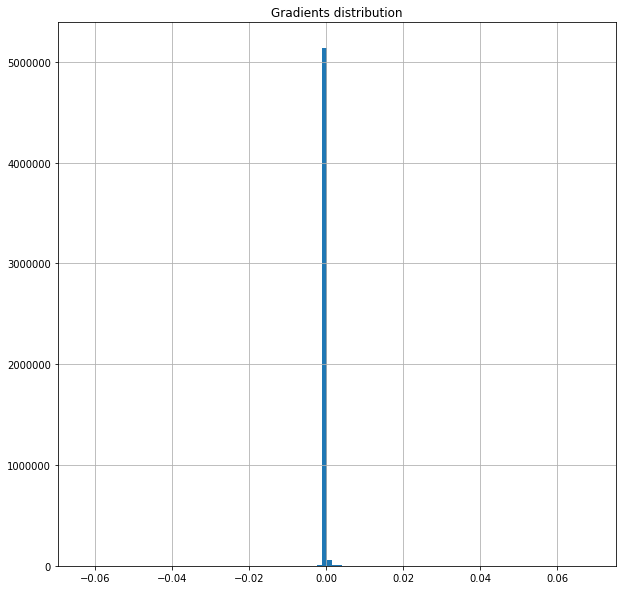

On iter 8251 with training PPL: 68.2503890991211, training ACC 0.263671875
On iter 8252 with training PPL: 73.27510833740234, training ACC 0.2547743022441864
On iter 8253 with training PPL: 63.22561264038086, training ACC 0.2686631977558136
On iter 8254 with training PPL: 68.82105255126953, training ACC 0.2643229067325592
On iter 8255 with training PPL: 58.29473114013672, training ACC 0.2827690839767456
On iter 8256 with training PPL: 65.43919372558594, training ACC 0.2651909589767456
On iter 8257 with training PPL: 57.845272064208984, training ACC 0.2799479067325592
On iter 8258 with training PPL: 67.42910766601562, training ACC 0.2628038227558136
On iter 8259 with training PPL: 64.26624298095703, training ACC 0.2664930522441864
On iter 8260 with training PPL: 66.50299835205078, training ACC 0.2688802182674408
On iter 8261 with training PPL: 66.46016693115234, training ACC 0.2693142294883728
On iter 8262 with training PPL: 67.28495788574219, training ACC 0.2523871660232544
On iter 826

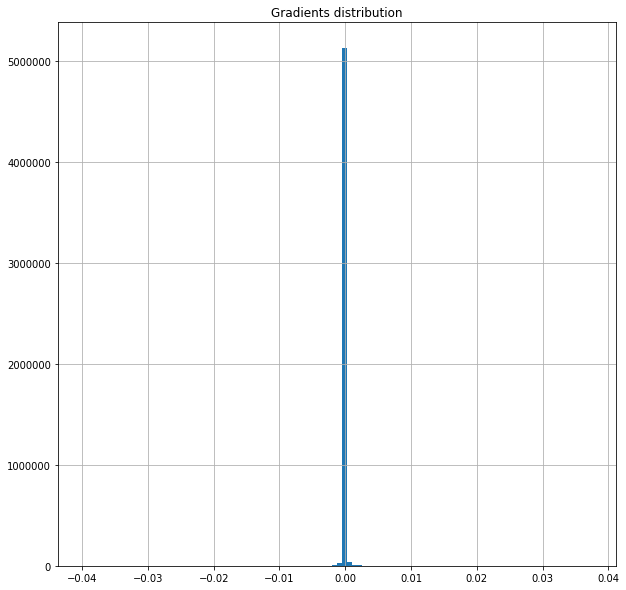

On iter 8281 with training PPL: 69.33671569824219, training ACC 0.2628038227558136
On iter 8282 with training PPL: 67.02698516845703, training ACC 0.2686631977558136
On iter 8283 with training PPL: 59.92266082763672, training ACC 0.2717013955116272
On iter 8284 with training PPL: 67.79046630859375, training ACC 0.2623697817325592
On iter 8285 with training PPL: 72.35808563232422, training ACC 0.2628038227558136
On iter 8286 with training PPL: 64.82787322998047, training ACC 0.2643229067325592
On iter 8287 with training PPL: 68.44535064697266, training ACC 0.2673611044883728
On iter 8288 with training PPL: 65.00370025634766, training ACC 0.2641059160232544
On iter 8289 with training PPL: 61.189842224121094, training ACC 0.275390625
On iter 8290 with training PPL: 63.40554428100586, training ACC 0.2719184160232544
On iter 8291 with training PPL: 68.74345397949219, training ACC 0.2604166567325592
On iter 8292 with training PPL: 61.18009948730469, training ACC 0.2777777910232544
On iter 82

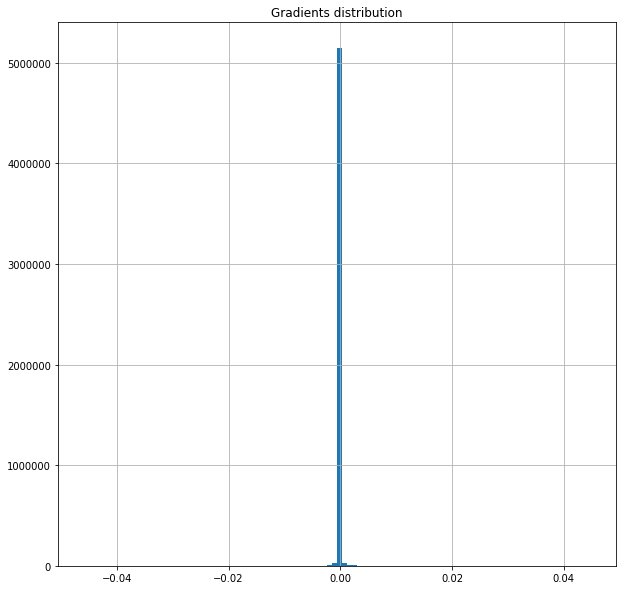

On iter 8311 with training PPL: 67.41393280029297, training ACC 0.2669270932674408
On iter 8312 with training PPL: 64.58293151855469, training ACC 0.2721354067325592
On iter 8313 with training PPL: 62.034950256347656, training ACC 0.2730034589767456
On iter 8314 with training PPL: 68.24069213867188, training ACC 0.2484809011220932
On iter 8315 with training PPL: 62.81101608276367, training ACC 0.275390625
On iter 8316 with training PPL: 67.61817169189453, training ACC 0.2682291567325592
On iter 8317 with training PPL: 66.71551513671875, training ACC 0.2641059160232544
On iter 8318 with training PPL: 61.89318084716797, training ACC 0.2738715410232544
On iter 8319 with training PPL: 63.77733612060547, training ACC 0.2708333432674408
On iter 8320 with training PPL: 66.32090759277344, training ACC 0.267578125
On iter 8321 with training PPL: 72.64568328857422, training ACC 0.2421875
On iter 8322 with training PPL: 63.979312896728516, training ACC 0.2717013955116272
On iter 8323 with trainin

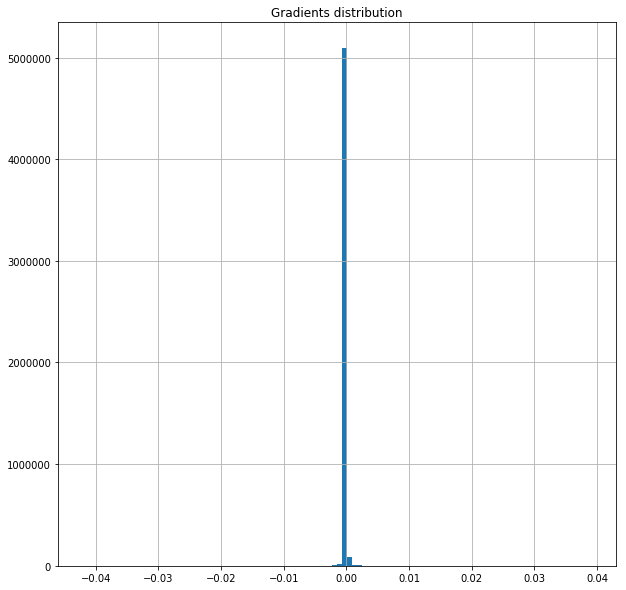

On iter 8341 with training PPL: 68.04920959472656, training ACC 0.2560763955116272
On iter 8342 with training PPL: 68.61102294921875, training ACC 0.259765625
On iter 8343 with training PPL: 63.39868927001953, training ACC 0.265625
On iter 8344 with training PPL: 64.87240600585938, training ACC 0.2703993022441864
On iter 8345 with training PPL: 64.80915069580078, training ACC 0.2686631977558136
On iter 8346 with training PPL: 65.31175994873047, training ACC 0.2654079794883728
On iter 8347 with training PPL: 68.1127700805664, training ACC 0.2662760317325592
On iter 8348 with training PPL: 67.0041732788086, training ACC 0.2621527910232544
On iter 8349 with training PPL: 62.06083679199219, training ACC 0.2797309160232544
On iter 8350 with training PPL: 63.6602668762207, training ACC 0.263671875
On iter 8351 with training PPL: 70.29812622070312, training ACC 0.2552083432674408
On iter 8352 with training PPL: 62.16609573364258, training ACC 0.2717013955116272
On iter 8353 with training PPL:

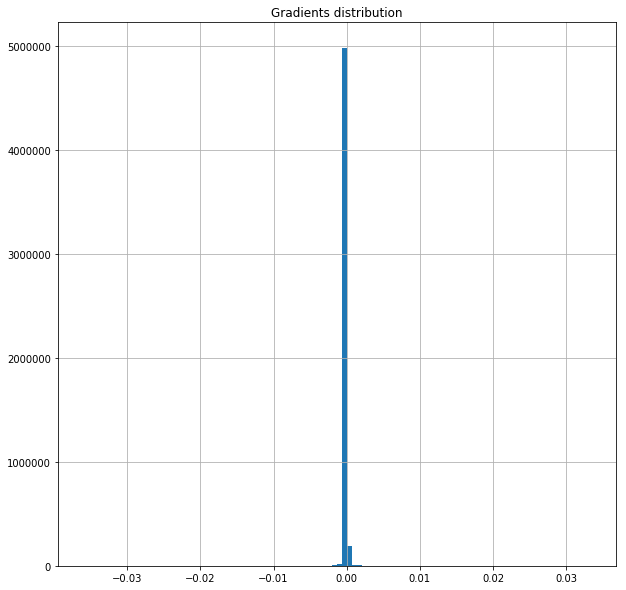

On iter 8371 with training PPL: 73.74132537841797, training ACC 0.2452256977558136
On iter 8372 with training PPL: 67.15341186523438, training ACC 0.2554253339767456
On iter 8373 with training PPL: 60.67539978027344, training ACC 0.267578125
On iter 8374 with training PPL: 67.33576965332031, training ACC 0.2638888955116272
On iter 8375 with training PPL: 63.105525970458984, training ACC 0.2625868022441864
On iter 8376 with training PPL: 60.59808349609375, training ACC 0.2710503339767456
On iter 8377 with training PPL: 65.159423828125, training ACC 0.2671440839767456
On iter 8378 with training PPL: 74.94781494140625, training ACC 0.2506510317325592
On iter 8379 with training PPL: 71.17835235595703, training ACC 0.2582465410232544
On iter 8380 with training PPL: 59.28989791870117, training ACC 0.2795138955116272
On iter 8381 with training PPL: 68.36709594726562, training ACC 0.2593315839767456
On iter 8382 with training PPL: 62.00242233276367, training ACC 0.265625
On iter 8383 with trai

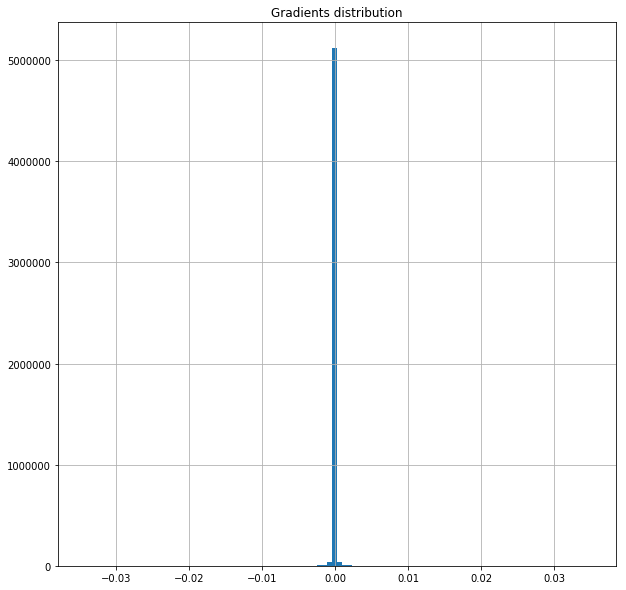

<SS> cluett a leading <unk> maker and one of west <unk> 's biggest units <eos> included in the sale are cluett units that make men 's shirts under the arrow name <unk> under the gold <unk> <EE>


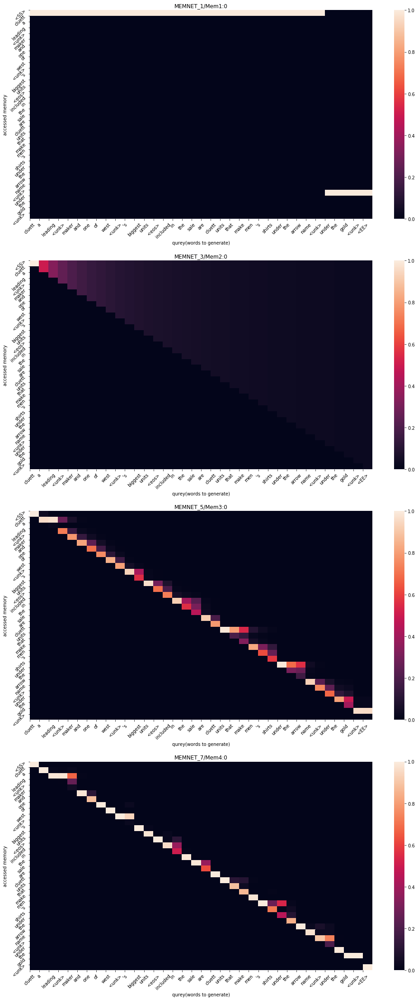

On iter 8401 with training PPL: 62.95224380493164, training ACC 0.2760416567325592
On iter 8402 with training PPL: 56.885902404785156, training ACC 0.2864583432674408
On iter 8403 with training PPL: 61.03507995605469, training ACC 0.2810329794883728
On iter 8404 with training PPL: 61.6467170715332, training ACC 0.2641059160232544
On iter 8405 with training PPL: 59.777713775634766, training ACC 0.2829861044883728
On iter 8406 with training PPL: 59.27610397338867, training ACC 0.2775607705116272
On iter 8407 with training PPL: 60.88630676269531, training ACC 0.2736545205116272
On iter 8408 with training PPL: 60.80906677246094, training ACC 0.2706163227558136
On iter 8409 with training PPL: 67.35625457763672, training ACC 0.255859375
On iter 8410 with training PPL: 63.72550582885742, training ACC 0.2619357705116272
On iter 8411 with training PPL: 65.79074096679688, training ACC 0.2682291567325592
On iter 8412 with training PPL: 67.36357879638672, training ACC 0.2599826455116272
On iter 84

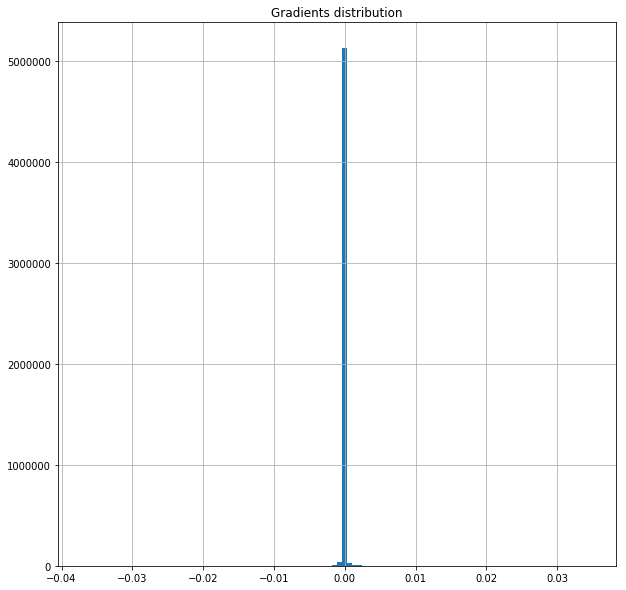

On iter 8431 with training PPL: 70.42269897460938, training ACC 0.2521701455116272
On iter 8432 with training PPL: 65.65670013427734, training ACC 0.2764756977558136
On iter 8433 with training PPL: 60.78193664550781, training ACC 0.2721354067325592
On iter 8434 with training PPL: 64.37327575683594, training ACC 0.2708333432674408
On iter 8435 with training PPL: 57.881996154785156, training ACC 0.2866753339767456
On iter 8436 with training PPL: 63.056610107421875, training ACC 0.2760416567325592
On iter 8437 with training PPL: 63.343841552734375, training ACC 0.2608506977558136
On iter 8438 with training PPL: 72.87098693847656, training ACC 0.2556423544883728
On iter 8439 with training PPL: 60.150794982910156, training ACC 0.2743055522441864
On iter 8440 with training PPL: 67.14137268066406, training ACC 0.2606336772441864
On iter 8441 with training PPL: 62.328250885009766, training ACC 0.2738715410232544
On iter 8442 with training PPL: 63.128849029541016, training ACC 0.273871541023254

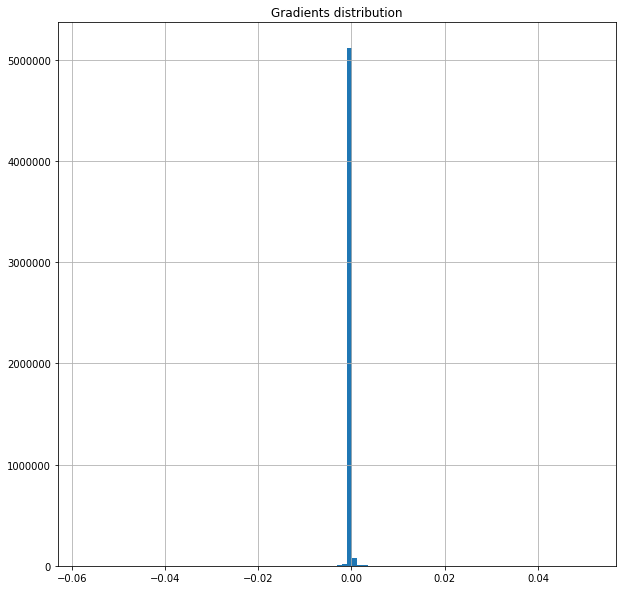

On iter 8461 with training PPL: 64.18875885009766, training ACC 0.2723524272441864
On iter 8462 with training PPL: 70.56139373779297, training ACC 0.2601996660232544
On iter 8463 with training PPL: 65.16837310791016, training ACC 0.2664930522441864
On iter 8464 with training PPL: 59.34680938720703, training ACC 0.2786458432674408
On iter 8465 with training PPL: 61.85317611694336, training ACC 0.2615017294883728
On iter 8466 with training PPL: 69.54144287109375, training ACC 0.263671875
On iter 8467 with training PPL: 68.03074645996094, training ACC 0.2610677182674408
On iter 8468 with training PPL: 65.38966369628906, training ACC 0.2688802182674408
On iter 8469 with training PPL: 66.04177856445312, training ACC 0.2710503339767456
On iter 8470 with training PPL: 60.90619659423828, training ACC 0.271484375
On iter 8471 with training PPL: 63.538902282714844, training ACC 0.2673611044883728
On iter 8472 with training PPL: 60.10684585571289, training ACC 0.2734375
On iter 8473 with training

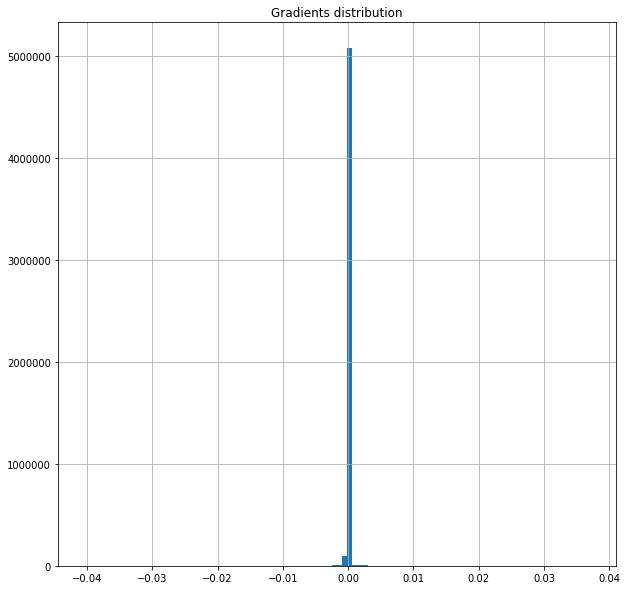

On iter 8491 with training PPL: 70.61904907226562, training ACC 0.25390625
On iter 8492 with training PPL: 66.15953826904297, training ACC 0.2593315839767456
On iter 8493 with training PPL: 58.71586990356445, training ACC 0.2827690839767456
On iter 8494 with training PPL: 64.04188537597656, training ACC 0.2669270932674408
On iter 8495 with training PPL: 63.055198669433594, training ACC 0.2671440839767456
On iter 8496 with training PPL: 59.383975982666016, training ACC 0.2799479067325592
On iter 8497 with training PPL: 65.06169128417969, training ACC 0.2662760317325592
On iter 8498 with training PPL: 58.8997688293457, training ACC 0.2749565839767456
On iter 8499 with training PPL: 65.21885681152344, training ACC 0.2682291567325592
On iter 8500 with training PPL: 66.82337951660156, training ACC 0.2582465410232544
On iter 8501 with training PPL: 66.6600570678711, training ACC 0.2699652910232544
On iter 8502 with training PPL: 64.70249938964844, training ACC 0.2649739682674408
On iter 8503

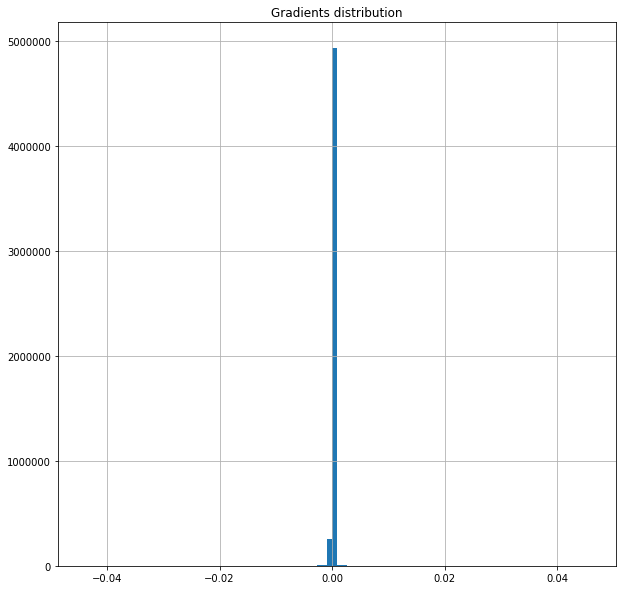

On iter 8521 with training PPL: 63.9818115234375, training ACC 0.2669270932674408
On iter 8522 with training PPL: 62.93888854980469, training ACC 0.2621527910232544
On iter 8523 with training PPL: 62.01551818847656, training ACC 0.2756076455116272
On iter 8524 with training PPL: 61.3286247253418, training ACC 0.2764756977558136
On iter 8525 with training PPL: 69.6826171875, training ACC 0.2556423544883728
On iter 8526 with training PPL: 61.15114212036133, training ACC 0.2697482705116272
On iter 8527 with training PPL: 60.028934478759766, training ACC 0.2788628339767456
On iter 8528 with training PPL: 59.461273193359375, training ACC 0.2847222089767456
On iter 8529 with training PPL: 58.01252365112305, training ACC 0.2723524272441864
On iter 8530 with training PPL: 66.11579132080078, training ACC 0.2591145932674408
On iter 8531 with training PPL: 57.727943420410156, training ACC 0.2725694477558136
On iter 8532 with training PPL: 59.5683479309082, training ACC 0.2738715410232544
On iter 

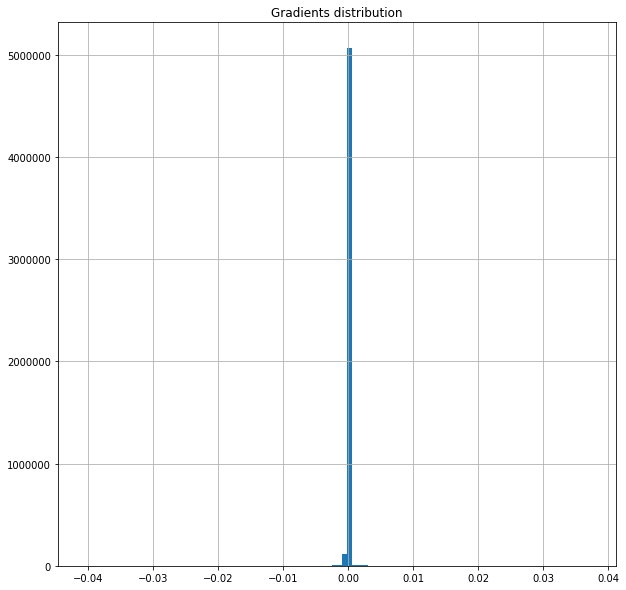

On iter 8551 with training PPL: 64.51239013671875, training ACC 0.2534722089767456
On iter 8552 with training PPL: 58.4068603515625, training ACC 0.28515625
On iter 8553 with training PPL: 66.53766632080078, training ACC 0.265625
On iter 8554 with training PPL: 61.113006591796875, training ACC 0.2693142294883728
On iter 8555 with training PPL: 55.25016784667969, training ACC 0.2747395932674408
On iter 8556 with training PPL: 66.13944244384766, training ACC 0.2690972089767456
On iter 8557 with training PPL: 57.292823791503906, training ACC 0.2825520932674408
On iter 8558 with training PPL: 53.742919921875, training ACC 0.2821180522441864
On iter 8559 with training PPL: 66.18439483642578, training ACC 0.2610677182674408
On iter 8560 with training PPL: 61.29888916015625, training ACC 0.2801649272441864
On iter 8561 with training PPL: 64.1349105834961, training ACC 0.2641059160232544
On iter 8562 with training PPL: 58.59138107299805, training ACC 0.2777777910232544
On iter 8563 with traini

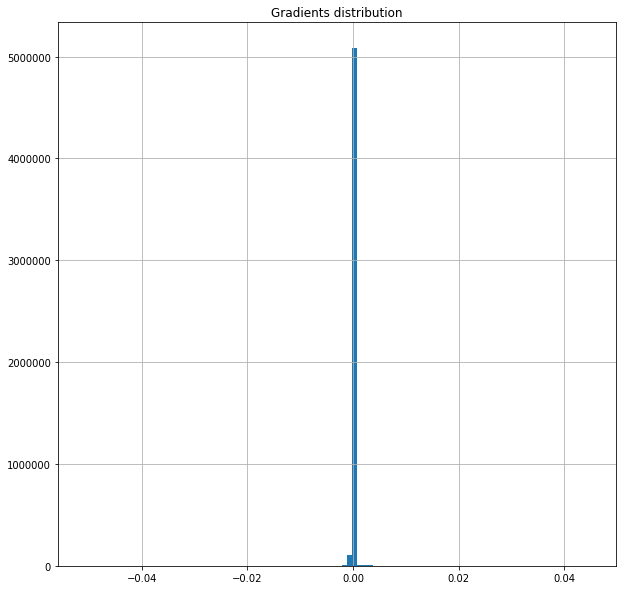

On iter 8581 with training PPL: 61.79645538330078, training ACC 0.2760416567325592
On iter 8582 with training PPL: 54.67266082763672, training ACC 0.2866753339767456
On iter 8583 with training PPL: 66.65351104736328, training ACC 0.2502170205116272
On iter 8584 with training PPL: 62.70059585571289, training ACC 0.2649739682674408
On iter 8585 with training PPL: 59.31059646606445, training ACC 0.2769097089767456
On iter 8586 with training PPL: 65.88611602783203, training ACC 0.2630208432674408
On iter 8587 with training PPL: 56.23219680786133, training ACC 0.2821180522441864
On iter 8588 with training PPL: 58.95256042480469, training ACC 0.2734375
On iter 8589 with training PPL: 62.382781982421875, training ACC 0.2669270932674408
On iter 8590 with training PPL: 66.88318634033203, training ACC 0.2673611044883728
On iter 8591 with training PPL: 61.4885368347168, training ACC 0.2734375
On iter 8592 with training PPL: 56.542964935302734, training ACC 0.2862413227558136
On iter 8593 with tra

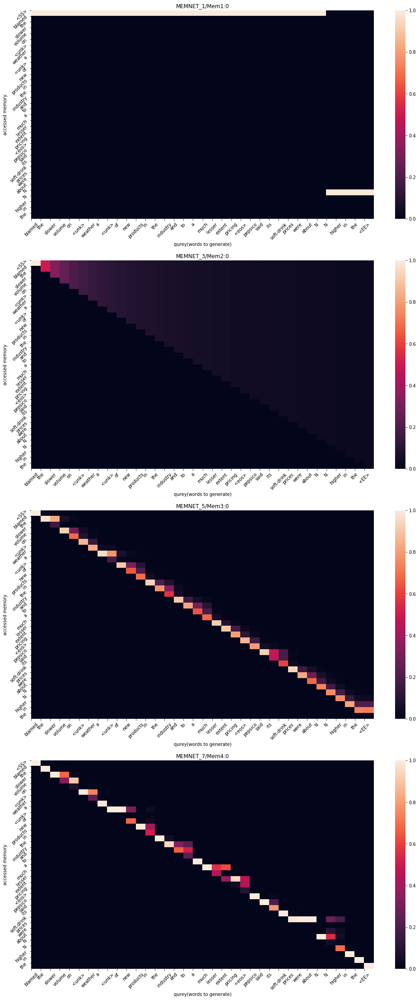

On iter 8601 with training PPL: 56.89911651611328, training ACC 0.2842881977558136
On iter 8602 with training PPL: 64.73699951171875, training ACC 0.2671440839767456
On iter 8603 with training PPL: 59.757450103759766, training ACC 0.2743055522441864
On iter 8604 with training PPL: 59.43210220336914, training ACC 0.2732204794883728
On iter 8605 with training PPL: 66.69859313964844, training ACC 0.2690972089767456
On iter 8606 with training PPL: 61.720481872558594, training ACC 0.2610677182674408
On iter 8607 with training PPL: 61.516597747802734, training ACC 0.2797309160232544
On iter 8608 with training PPL: 62.92436599731445, training ACC 0.2567274272441864
On iter 8609 with training PPL: 63.905921936035156, training ACC 0.2632378339767456
On iter 8610 with training PPL: 61.2221565246582, training ACC 0.27734375
	 validation PPL 159.11538696289062, validation acc 0.2380642294883728
shape of gradients is (5228544,), L2 norm of gradients is 0.8355415463447571, details:                  

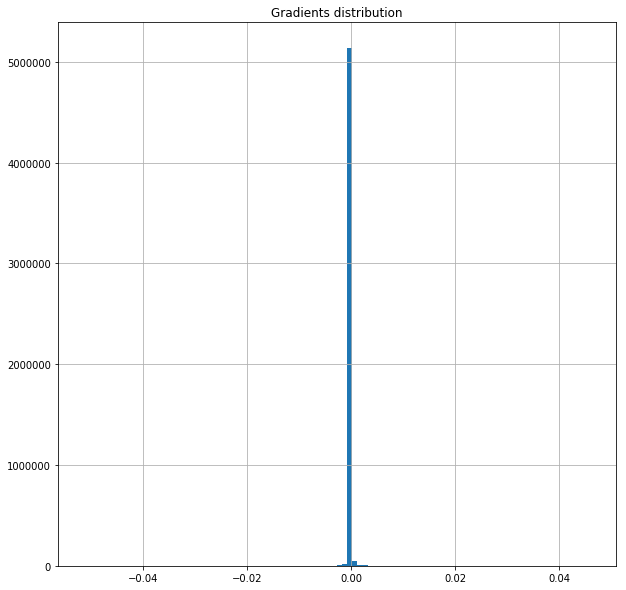

On iter 8611 with training PPL: 66.113525390625, training ACC 0.2625868022441864
On iter 8612 with training PPL: 63.86510467529297, training ACC 0.2756076455116272
On iter 8613 with training PPL: 61.94384765625, training ACC 0.26171875
On iter 8614 with training PPL: 68.01371765136719, training ACC 0.2601996660232544
On iter 8615 with training PPL: 64.96090698242188, training ACC 0.2643229067325592
On iter 8616 with training PPL: 68.5893325805664, training ACC 0.2630208432674408
On iter 8617 with training PPL: 63.99688720703125, training ACC 0.263671875
On iter 8618 with training PPL: 59.22439956665039, training ACC 0.2775607705116272
On iter 8619 with training PPL: 56.647216796875, training ACC 0.271484375
On iter 8620 with training PPL: 59.88629913330078, training ACC 0.2671440839767456
On iter 8621 with training PPL: 61.6575927734375, training ACC 0.2721354067325592
On iter 8622 with training PPL: 60.68492126464844, training ACC 0.2736545205116272
On iter 8623 with training PPL: 59.

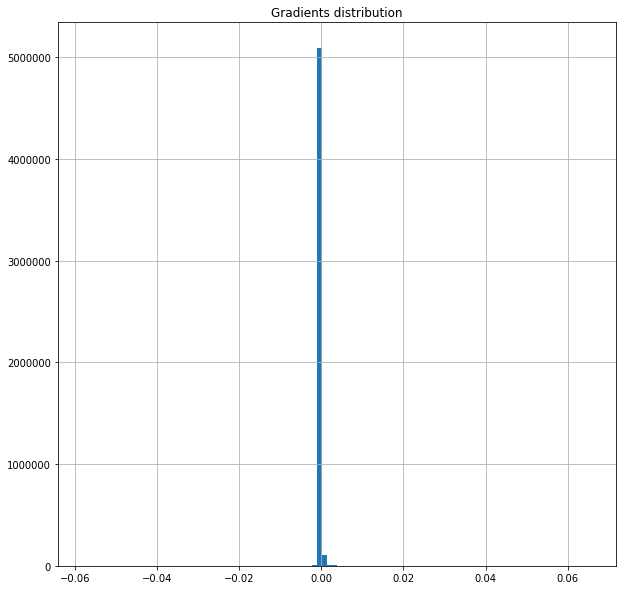

On iter 8641 with training PPL: 53.4854621887207, training ACC 0.2907986044883728
On iter 8642 with training PPL: 61.8605842590332, training ACC 0.26953125
On iter 8643 with training PPL: 62.25862121582031, training ACC 0.2745225727558136
On iter 8644 with training PPL: 65.34829711914062, training ACC 0.2630208432674408
On iter 8645 with training PPL: 59.2481803894043, training ACC 0.2764756977558136
On iter 8646 with training PPL: 58.54290008544922, training ACC 0.2771267294883728
On iter 8647 with training PPL: 62.96070861816406, training ACC 0.2654079794883728
On iter 8648 with training PPL: 64.84272003173828, training ACC 0.2662760317325592
On iter 8649 with training PPL: 59.158470153808594, training ACC 0.2810329794883728
On iter 8650 with training PPL: 60.74754333496094, training ACC 0.2723524272441864
On iter 8651 with training PPL: 64.0669937133789, training ACC 0.2682291567325592
On iter 8799 with training PPL: 58.781280517578125, training ACC 0.2823350727558136
On iter 8800 w

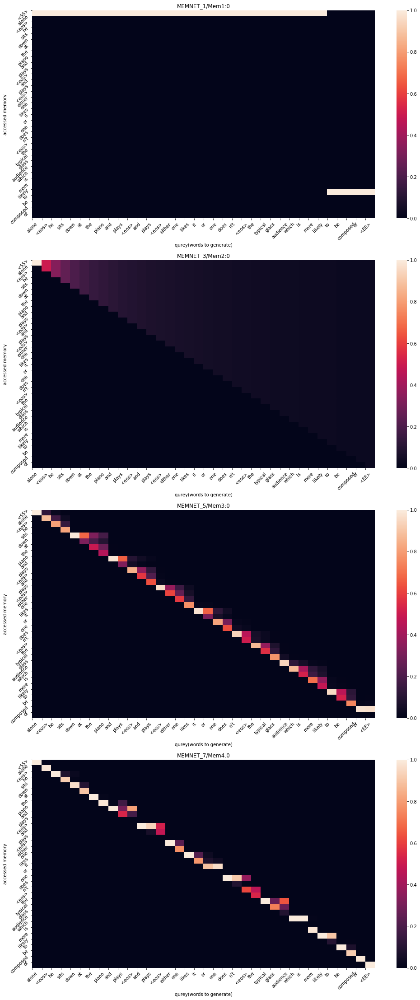

On iter 8801 with training PPL: 62.79807662963867, training ACC 0.2710503339767456
On iter 8802 with training PPL: 62.75910568237305, training ACC 0.2645399272441864
On iter 8803 with training PPL: 62.20951461791992, training ACC 0.2664930522441864
On iter 8804 with training PPL: 57.79415512084961, training ACC 0.2758246660232544
On iter 8805 with training PPL: 64.03430938720703, training ACC 0.2664930522441864
On iter 8806 with training PPL: 62.27112579345703, training ACC 0.275390625
On iter 8807 with training PPL: 59.11033248901367, training ACC 0.2758246660232544
On iter 8808 with training PPL: 66.97988891601562, training ACC 0.259765625
On iter 8809 with training PPL: 66.7660903930664, training ACC 0.2595486044883728
On iter 8810 with training PPL: 60.79868698120117, training ACC 0.2684461772441864
On iter 8811 with training PPL: 66.04830169677734, training ACC 0.2651909589767456
On iter 8812 with training PPL: 57.65998840332031, training ACC 0.2819010317325592
On iter 8813 with t

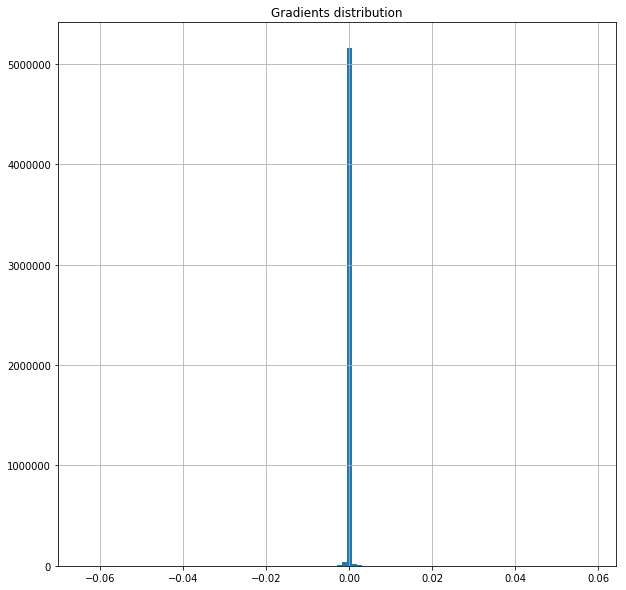

On iter 8821 with training PPL: 56.88289260864258, training ACC 0.2821180522441864
On iter 8822 with training PPL: 57.32072067260742, training ACC 0.271484375
On iter 8823 with training PPL: 55.56308364868164, training ACC 0.2769097089767456
On iter 8824 with training PPL: 62.53237533569336, training ACC 0.2630208432674408
On iter 8825 with training PPL: 57.8416862487793, training ACC 0.2736545205116272
On iter 8826 with training PPL: 62.38676834106445, training ACC 0.2779947817325592
On iter 8827 with training PPL: 64.24727630615234, training ACC 0.2612847089767456
On iter 8828 with training PPL: 59.56877136230469, training ACC 0.2745225727558136
On iter 8829 with training PPL: 59.198280334472656, training ACC 0.2725694477558136
On iter 8830 with training PPL: 62.48966598510742, training ACC 0.2669270932674408
On iter 8831 with training PPL: 58.78955078125, training ACC 0.271484375
On iter 8832 with training PPL: 60.705177307128906, training ACC 0.2658420205116272
On iter 8833 with tr

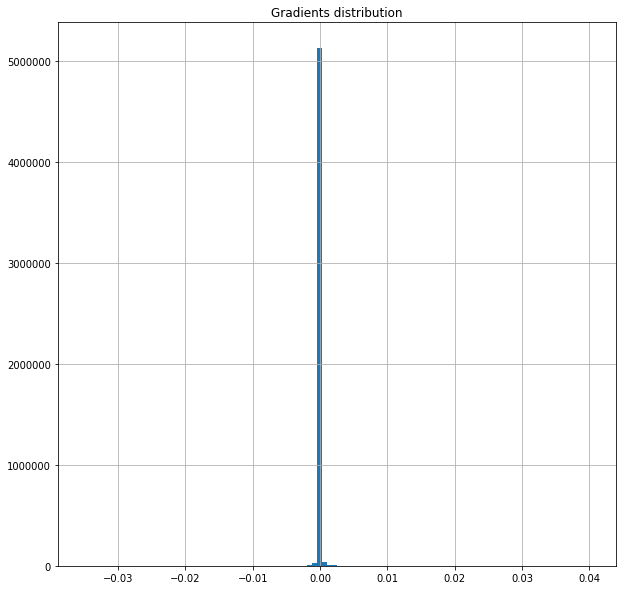

On iter 8851 with training PPL: 65.34789276123047, training ACC 0.2647569477558136
On iter 8852 with training PPL: 61.58122253417969, training ACC 0.2658420205116272
On iter 8853 with training PPL: 59.509944915771484, training ACC 0.2745225727558136
On iter 8854 with training PPL: 64.25174713134766, training ACC 0.2591145932674408
On iter 8855 with training PPL: 63.65586471557617, training ACC 0.2723524272441864
On iter 8856 with training PPL: 68.66878509521484, training ACC 0.2491319477558136
On iter 8857 with training PPL: 58.285362243652344, training ACC 0.2738715410232544
On iter 8858 with training PPL: 58.75505065917969, training ACC 0.2686631977558136
On iter 8859 with training PPL: 61.96476745605469, training ACC 0.2647569477558136
On iter 8860 with training PPL: 55.41533660888672, training ACC 0.2769097089767456
On iter 8861 with training PPL: 58.212120056152344, training ACC 0.2680121660232544
On iter 8862 with training PPL: 61.00502395629883, training ACC 0.2823350727558136
O

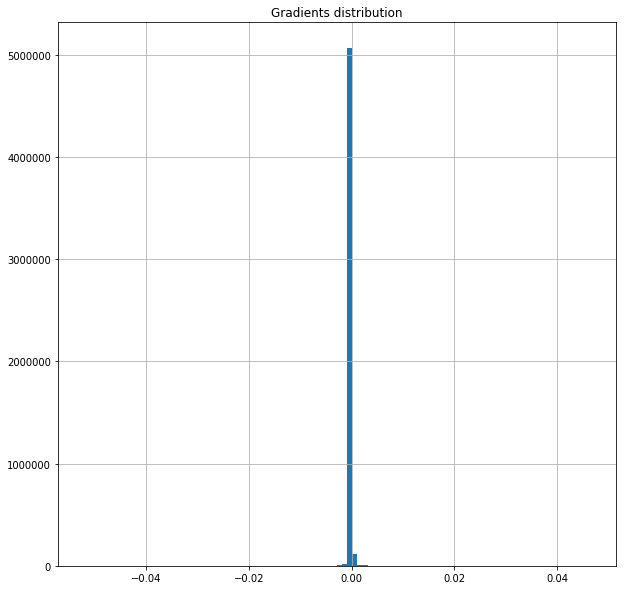

On iter 8881 with training PPL: 55.547454833984375, training ACC 0.2836371660232544
On iter 8882 with training PPL: 53.31533432006836, training ACC 0.2892795205116272
On iter 8883 with training PPL: 53.81521987915039, training ACC 0.2855902910232544
On iter 8884 with training PPL: 61.34593963623047, training ACC 0.267578125
On iter 8885 with training PPL: 57.222110748291016, training ACC 0.2840711772441864
On iter 8886 with training PPL: 60.547828674316406, training ACC 0.259765625
On iter 8887 with training PPL: 59.0103874206543, training ACC 0.2847222089767456
On iter 8888 with training PPL: 61.690059661865234, training ACC 0.2723524272441864
On iter 8889 with training PPL: 61.48310852050781, training ACC 0.2658420205116272
On iter 8890 with training PPL: 57.35191345214844, training ACC 0.2921006977558136
On iter 8891 with training PPL: 65.6347885131836, training ACC 0.267578125
On iter 8892 with training PPL: 51.20992660522461, training ACC 0.29296875
On iter 8893 with training PPL:

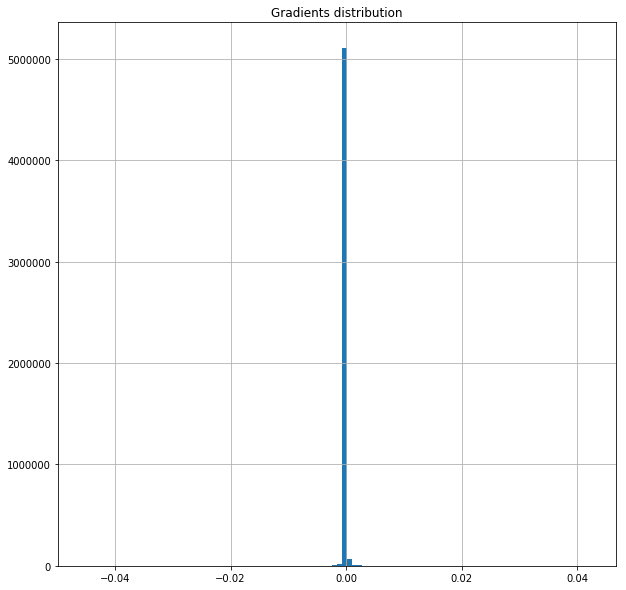

On iter 8911 with training PPL: 60.50260543823242, training ACC 0.2701822817325592
On iter 8912 with training PPL: 59.393775939941406, training ACC 0.28125
On iter 8913 with training PPL: 59.55002975463867, training ACC 0.2795138955116272
On iter 8914 with training PPL: 58.30232238769531, training ACC 0.2808159589767456
On iter 8915 with training PPL: 60.76732635498047, training ACC 0.2771267294883728
On iter 8916 with training PPL: 60.79179000854492, training ACC 0.2730034589767456
On iter 8917 with training PPL: 63.871376037597656, training ACC 0.26171875
On iter 8918 with training PPL: 59.218074798583984, training ACC 0.2725694477558136
On iter 8919 with training PPL: 62.85356140136719, training ACC 0.2717013955116272
On iter 8920 with training PPL: 56.437774658203125, training ACC 0.2855902910232544
On iter 8921 with training PPL: 60.05057907104492, training ACC 0.2638888955116272
On iter 8922 with training PPL: 62.936279296875, training ACC 0.2701822817325592
On iter 8923 with tra

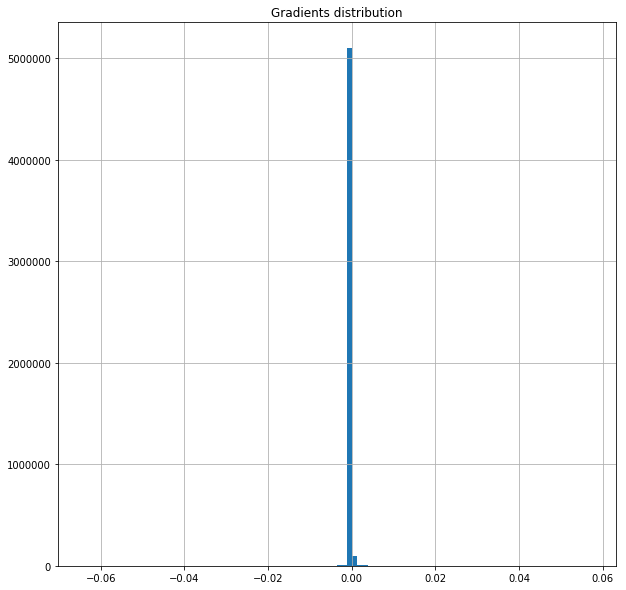

On iter 8941 with training PPL: 60.708885192871094, training ACC 0.2727864682674408
On iter 8942 with training PPL: 58.46567916870117, training ACC 0.2723524272441864
On iter 8943 with training PPL: 60.942569732666016, training ACC 0.2658420205116272
On iter 8944 with training PPL: 54.41787338256836, training ACC 0.2819010317325592
On iter 8945 with training PPL: 54.44198226928711, training ACC 0.2819010317325592
On iter 8946 with training PPL: 58.066184997558594, training ACC 0.2758246660232544
On iter 8947 with training PPL: 58.22092056274414, training ACC 0.2736545205116272
On iter 8948 with training PPL: 55.92988967895508, training ACC 0.2823350727558136
On iter 8949 with training PPL: 54.919864654541016, training ACC 0.2805989682674408
On iter 8950 with training PPL: 58.061676025390625, training ACC 0.2829861044883728
On iter 8951 with training PPL: 58.903499603271484, training ACC 0.2693142294883728
On iter 8952 with training PPL: 62.393638610839844, training ACC 0.26258680224418

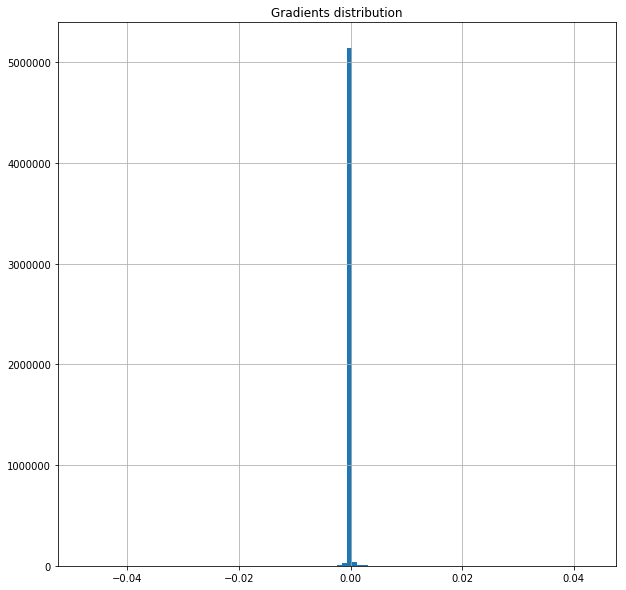

On iter 8971 with training PPL: 55.29109573364258, training ACC 0.2779947817325592
On iter 8972 with training PPL: 64.26660919189453, training ACC 0.2586805522441864
On iter 8973 with training PPL: 55.5722770690918, training ACC 0.2775607705116272
On iter 8974 with training PPL: 58.630455017089844, training ACC 0.275390625
On iter 8975 with training PPL: 61.90874099731445, training ACC 0.2708333432674408
On iter 8976 with training PPL: 57.741512298583984, training ACC 0.2814670205116272
On iter 8977 with training PPL: 58.38180160522461, training ACC 0.275390625
On iter 8978 with training PPL: 61.55366134643555, training ACC 0.2684461772441864
On iter 8979 with training PPL: 59.064971923828125, training ACC 0.27734375
On iter 8980 with training PPL: 63.474334716796875, training ACC 0.2604166567325592
On iter 8981 with training PPL: 54.70833206176758, training ACC 0.287109375
On iter 8982 with training PPL: 60.278221130371094, training ACC 0.2682291567325592
On iter 8983 with training PP

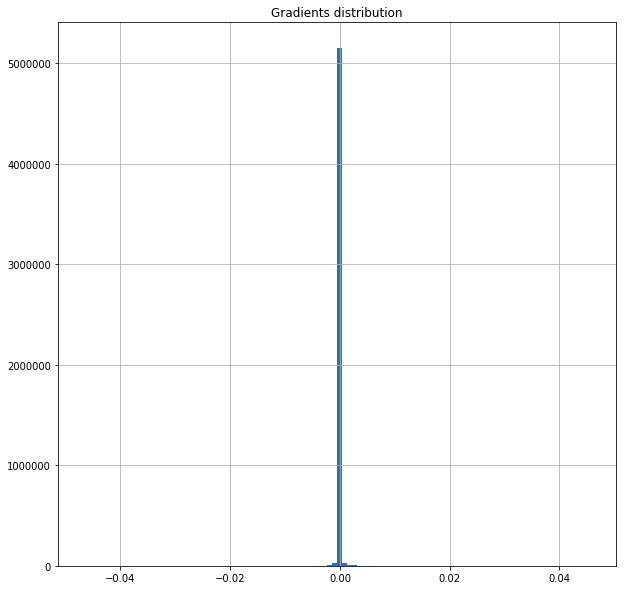

<SS> debt and lbos caused gray friday what are the implications for policy makers <eos> after all the stock market 's response to the collapse of the ual deal might be taken to confirm the <unk> <EE>


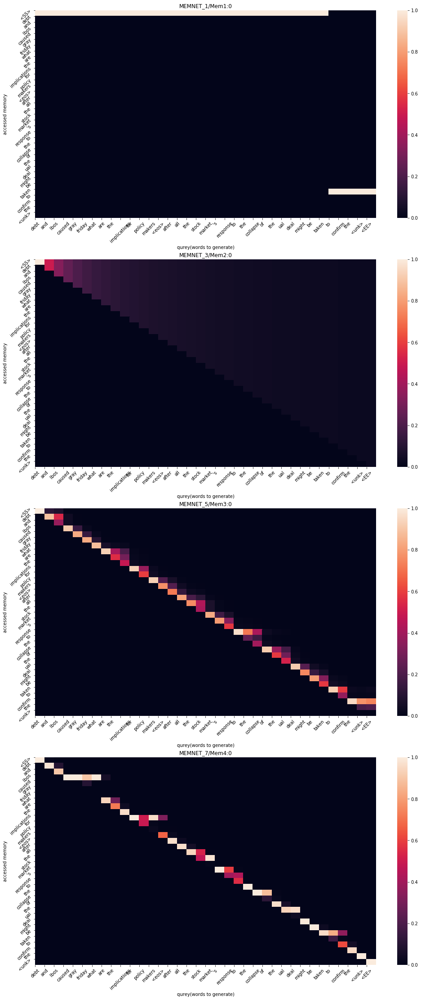

On iter 9001 with training PPL: 52.340370178222656, training ACC 0.2951388955116272
On iter 9002 with training PPL: 52.60052490234375, training ACC 0.2942708432674408
On iter 9003 with training PPL: 57.9323844909668, training ACC 0.2801649272441864
On iter 9004 with training PPL: 55.38334274291992, training ACC 0.2829861044883728
On iter 9005 with training PPL: 56.29618453979492, training ACC 0.2740885317325592
On iter 9006 with training PPL: 55.915645599365234, training ACC 0.2847222089767456
On iter 9007 with training PPL: 60.64445114135742, training ACC 0.2710503339767456
On iter 9008 with training PPL: 55.96253967285156, training ACC 0.2740885317325592
On iter 9009 with training PPL: 59.88752746582031, training ACC 0.2766927182674408
On iter 9010 with training PPL: 60.80222702026367, training ACC 0.2756076455116272
On iter 9011 with training PPL: 61.21210861206055, training ACC 0.2758246660232544
On iter 9012 with training PPL: 56.77840042114258, training ACC 0.2816840410232544
On 

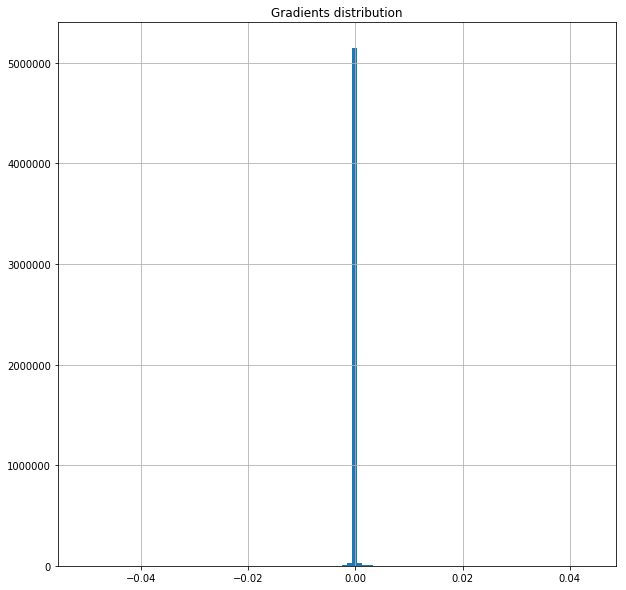

On iter 9031 with training PPL: 57.94258117675781, training ACC 0.2821180522441864
On iter 9032 with training PPL: 56.036800384521484, training ACC 0.2751736044883728
On iter 9033 with training PPL: 62.50581741333008, training ACC 0.2643229067325592
On iter 9034 with training PPL: 55.24142074584961, training ACC 0.2858072817325592
On iter 9035 with training PPL: 52.15810775756836, training ACC 0.2983940839767456
On iter 9036 with training PPL: 54.91205978393555, training ACC 0.2764756977558136
On iter 9037 with training PPL: 61.36264419555664, training ACC 0.2645399272441864
On iter 9038 with training PPL: 56.26215362548828, training ACC 0.2881944477558136
On iter 9039 with training PPL: 66.2309341430664, training ACC 0.2673611044883728
On iter 9040 with training PPL: 54.95248031616211, training ACC 0.2771267294883728
On iter 9041 with training PPL: 63.3608512878418, training ACC 0.267578125
On iter 9042 with training PPL: 60.61140441894531, training ACC 0.2717013955116272
On iter 9043

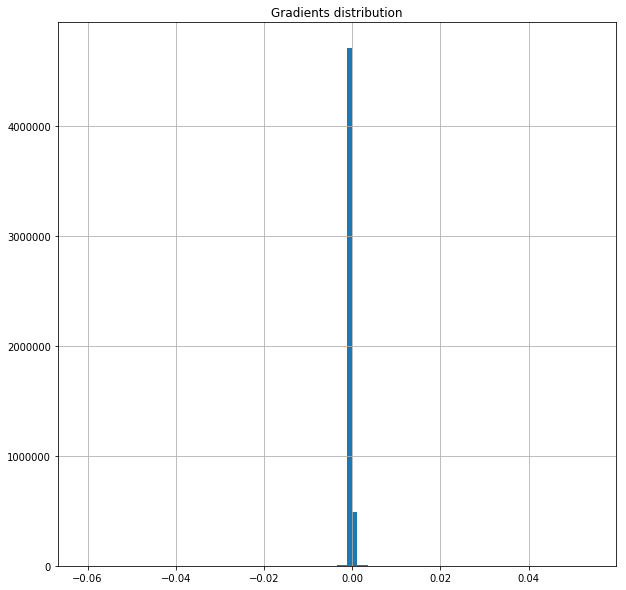

On iter 9061 with training PPL: 57.826568603515625, training ACC 0.2727864682674408
On iter 9062 with training PPL: 52.08485412597656, training ACC 0.287109375
On iter 9063 with training PPL: 56.35277557373047, training ACC 0.2840711772441864
On iter 9064 with training PPL: 59.093509674072266, training ACC 0.2708333432674408
On iter 9065 with training PPL: 58.96223068237305, training ACC 0.2677951455116272
On iter 9066 with training PPL: 58.709877014160156, training ACC 0.2756076455116272
On iter 9067 with training PPL: 60.809532165527344, training ACC 0.275390625
On iter 9068 with training PPL: 55.681026458740234, training ACC 0.2840711772441864
On iter 9069 with training PPL: 58.27005386352539, training ACC 0.2699652910232544
On iter 9070 with training PPL: 53.79678726196289, training ACC 0.2892795205116272
On iter 9071 with training PPL: 62.702239990234375, training ACC 0.2580295205116272
On iter 9072 with training PPL: 56.04770278930664, training ACC 0.2814670205116272
On iter 9073

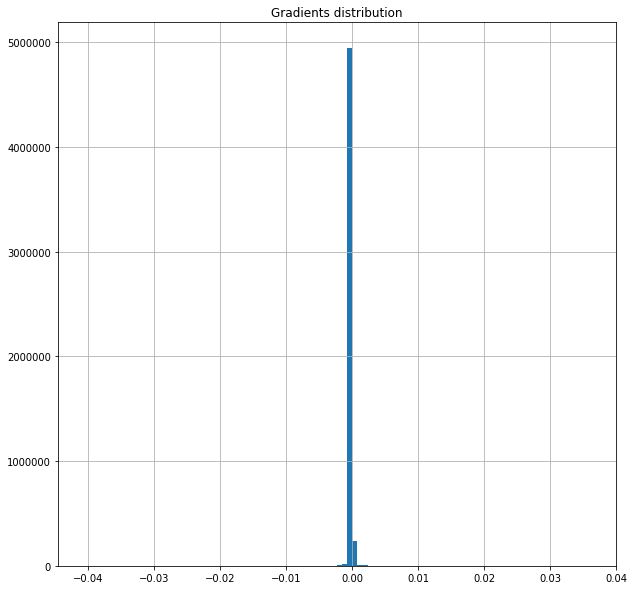

On iter 9091 with training PPL: 56.540863037109375, training ACC 0.2799479067325592
On iter 9092 with training PPL: 59.85475158691406, training ACC 0.26953125
On iter 9093 with training PPL: 58.471092224121094, training ACC 0.2647569477558136
On iter 9094 with training PPL: 58.53826904296875, training ACC 0.2860243022441864
On iter 9095 with training PPL: 57.51530456542969, training ACC 0.2786458432674408
On iter 9096 with training PPL: 58.00925827026367, training ACC 0.2842881977558136
On iter 9097 with training PPL: 54.76677322387695, training ACC 0.2931857705116272
On iter 9098 with training PPL: 62.23698806762695, training ACC 0.2688802182674408
On iter 9099 with training PPL: 52.747859954833984, training ACC 0.2983940839767456
On iter 9100 with training PPL: 56.394412994384766, training ACC 0.2886284589767456
On iter 9101 with training PPL: 59.53765106201172, training ACC 0.2808159589767456
On iter 9102 with training PPL: 57.48234558105469, training ACC 0.2662760317325592
On iter 

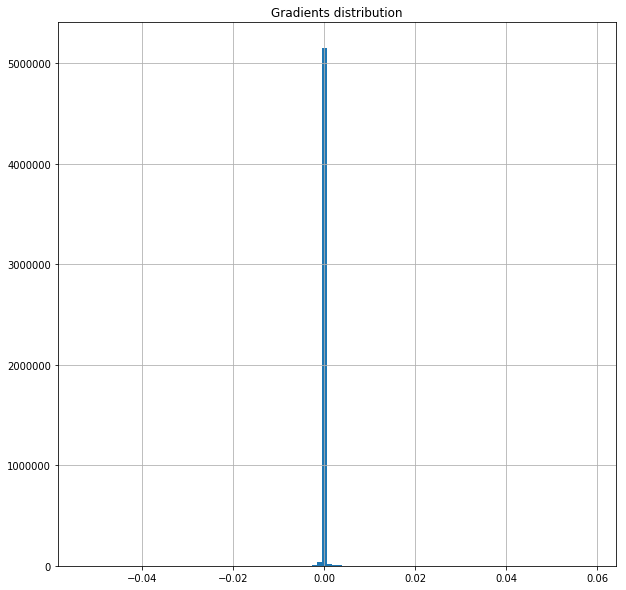

On iter 9121 with training PPL: 64.234375, training ACC 0.2673611044883728
On iter 9122 with training PPL: 59.69969177246094, training ACC 0.2680121660232544
On iter 9123 with training PPL: 61.80995559692383, training ACC 0.2719184160232544
On iter 9124 with training PPL: 58.50938415527344, training ACC 0.2782118022441864
On iter 9125 with training PPL: 57.71208953857422, training ACC 0.2717013955116272
On iter 9126 with training PPL: 54.83139419555664, training ACC 0.2762586772441864
On iter 9127 with training PPL: 54.99764633178711, training ACC 0.2814670205116272
On iter 9128 with training PPL: 56.583526611328125, training ACC 0.2829861044883728
On iter 9129 with training PPL: 56.66282653808594, training ACC 0.2821180522441864
On iter 9130 with training PPL: 66.75151062011719, training ACC 0.2526041567325592
On iter 9131 with training PPL: 62.18391799926758, training ACC 0.2671440839767456
On iter 9132 with training PPL: 60.74502182006836, training ACC 0.26953125
On iter 9133 with t

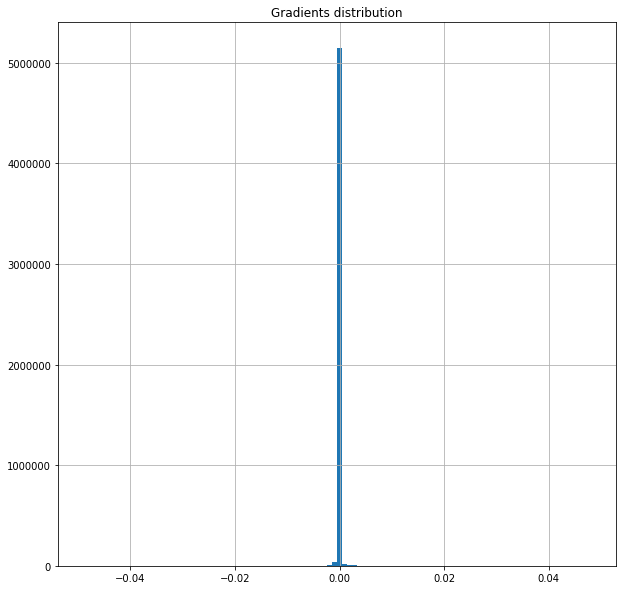

On iter 9151 with training PPL: 56.95742416381836, training ACC 0.2743055522441864
On iter 9152 with training PPL: 55.63750076293945, training ACC 0.2790798544883728
On iter 9153 with training PPL: 57.50033187866211, training ACC 0.2734375
On iter 9154 with training PPL: 51.05708312988281, training ACC 0.2914496660232544
On iter 9155 with training PPL: 57.589786529541016, training ACC 0.2738715410232544
On iter 9156 with training PPL: 56.99407196044922, training ACC 0.2834201455116272
On iter 9157 with training PPL: 60.85127639770508, training ACC 0.2688802182674408
On iter 9158 with training PPL: 55.71861267089844, training ACC 0.2799479067325592
On iter 9159 with training PPL: 59.003353118896484, training ACC 0.2747395932674408
On iter 9160 with training PPL: 53.96491622924805, training ACC 0.2840711772441864
On iter 9161 with training PPL: 53.55683517456055, training ACC 0.2973090410232544
On iter 9162 with training PPL: 60.8513298034668, training ACC 0.2619357705116272
On iter 9163

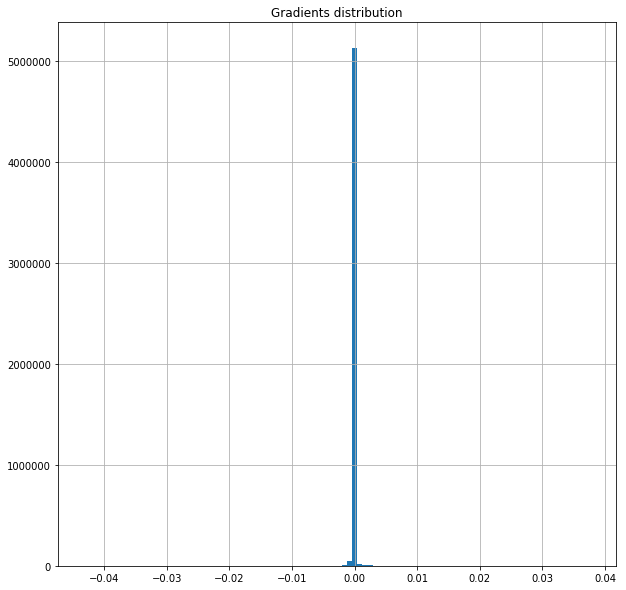

On iter 9181 with training PPL: 55.77225112915039, training ACC 0.2829861044883728
On iter 9182 with training PPL: 67.38892364501953, training ACC 0.2528211772441864
On iter 9183 with training PPL: 56.89474868774414, training ACC 0.275390625
On iter 9184 with training PPL: 55.151798248291016, training ACC 0.2775607705116272
On iter 9185 with training PPL: 58.72861099243164, training ACC 0.2779947817325592
On iter 9186 with training PPL: 61.20811462402344, training ACC 0.2751736044883728
On iter 9187 with training PPL: 59.1455192565918, training ACC 0.2845052182674408
On iter 9188 with training PPL: 52.72394561767578, training ACC 0.294921875
On iter 9189 with training PPL: 59.91277313232422, training ACC 0.2743055522441864
On iter 9190 with training PPL: 56.530860900878906, training ACC 0.279296875
On iter 9191 with training PPL: 55.25316619873047, training ACC 0.2745225727558136
On iter 9192 with training PPL: 56.83257293701172, training ACC 0.2684461772441864
On iter 9193 with traini

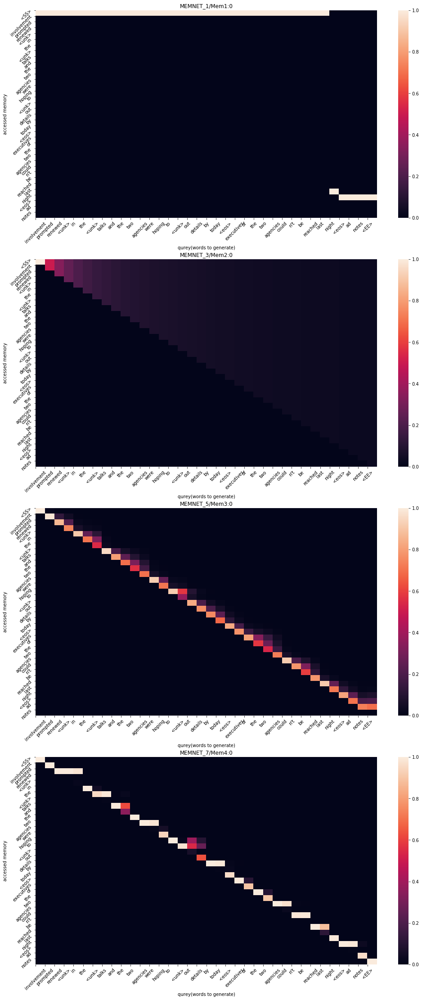

On iter 9201 with training PPL: 59.17886734008789, training ACC 0.2810329794883728
On iter 9202 with training PPL: 61.77660369873047, training ACC 0.2660590410232544
On iter 9203 with training PPL: 56.057804107666016, training ACC 0.2801649272441864
On iter 9204 with training PPL: 64.8199691772461, training ACC 0.2549913227558136
On iter 9205 with training PPL: 55.11536407470703, training ACC 0.2819010317325592
On iter 9206 with training PPL: 55.0909538269043, training ACC 0.2799479067325592
On iter 9207 with training PPL: 53.06217956542969, training ACC 0.2862413227558136
On iter 9208 with training PPL: 56.09791564941406, training ACC 0.275390625
On iter 9209 with training PPL: 57.012882232666016, training ACC 0.27734375
On iter 9210 with training PPL: 51.20157241821289, training ACC 0.2903645932674408
	 validation PPL 172.04115295410156, validation acc 0.2282986044883728
shape of gradients is (5228544,), L2 norm of gradients is 0.8105733394622803, details:                   0
count  

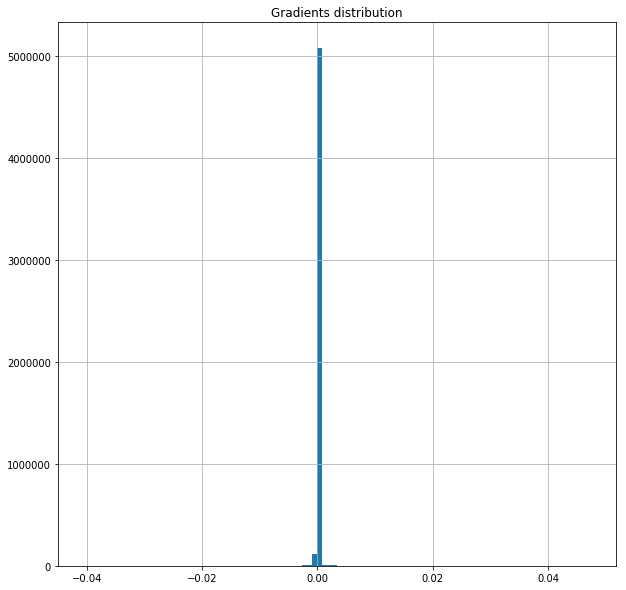

On iter 9211 with training PPL: 62.06388473510742, training ACC 0.275390625
On iter 9212 with training PPL: 53.94818115234375, training ACC 0.2762586772441864
On iter 9213 with training PPL: 52.23420715332031, training ACC 0.2888454794883728
On iter 9214 with training PPL: 58.584259033203125, training ACC 0.2710503339767456
On iter 9215 with training PPL: 60.770111083984375, training ACC 0.26953125
On iter 9216 with training PPL: 62.55271530151367, training ACC 0.2654079794883728
On iter 9217 with training PPL: 64.78384399414062, training ACC 0.2677951455116272
On iter 9218 with training PPL: 54.17900085449219, training ACC 0.2866753339767456
On iter 9219 with training PPL: 59.51505661010742, training ACC 0.2740885317325592
On iter 9220 with training PPL: 58.112388610839844, training ACC 0.2743055522441864
On iter 9221 with training PPL: 58.79296875, training ACC 0.2786458432674408
On iter 9222 with training PPL: 53.60425567626953, training ACC 0.2805989682674408
On iter 9223 with trai

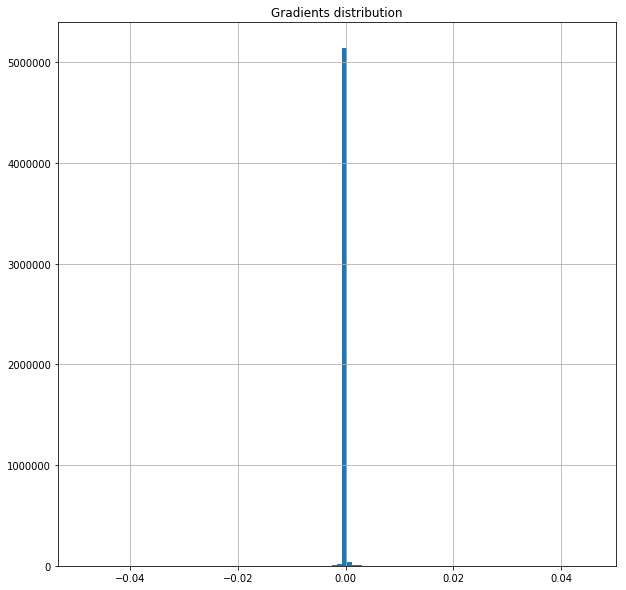

On iter 9241 with training PPL: 52.72358322143555, training ACC 0.2886284589767456
On iter 9242 with training PPL: 64.99114227294922, training ACC 0.2682291567325592
On iter 9243 with training PPL: 53.73701477050781, training ACC 0.2862413227558136
On iter 9244 with training PPL: 58.639259338378906, training ACC 0.2664930522441864
On iter 9245 with training PPL: 55.23641586303711, training ACC 0.2732204794883728
On iter 9246 with training PPL: 55.40523910522461, training ACC 0.2803819477558136
On iter 9247 with training PPL: 60.662986755371094, training ACC 0.2797309160232544
On iter 9248 with training PPL: 55.444488525390625, training ACC 0.2838541567325592
On iter 9249 with training PPL: 51.07947540283203, training ACC 0.2821180522441864
On iter 9250 with training PPL: 64.32666778564453, training ACC 0.2706163227558136
On iter 9251 with training PPL: 55.568115234375, training ACC 0.275390625
On iter 9252 with training PPL: 57.600440979003906, training ACC 0.2771267294883728
On iter 9

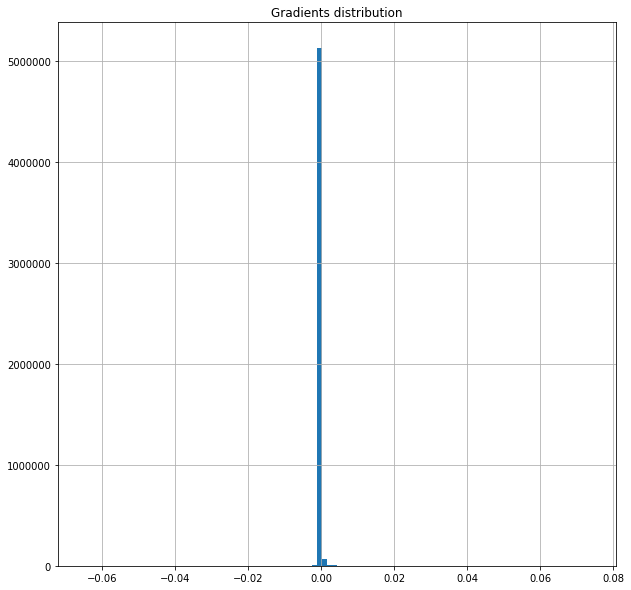

On iter 9271 with training PPL: 55.592708587646484, training ACC 0.2845052182674408
On iter 9272 with training PPL: 59.8111572265625, training ACC 0.2723524272441864
On iter 9273 with training PPL: 64.06473541259766, training ACC 0.2667100727558136
On iter 9274 with training PPL: 55.45897674560547, training ACC 0.2801649272441864
On iter 9275 with training PPL: 58.08488082885742, training ACC 0.2842881977558136
On iter 9276 with training PPL: 52.91410446166992, training ACC 0.2897135317325592
On iter 9277 with training PPL: 59.14955139160156, training ACC 0.2703993022441864
On iter 9278 with training PPL: 52.70404052734375, training ACC 0.2934027910232544
On iter 9279 with training PPL: 55.870792388916016, training ACC 0.2875434160232544
On iter 9280 with training PPL: 58.51061248779297, training ACC 0.2712673544883728
On iter 9281 with training PPL: 57.95634078979492, training ACC 0.2708333432674408
On iter 9282 with training PPL: 59.98804473876953, training ACC 0.2723524272441864
On 

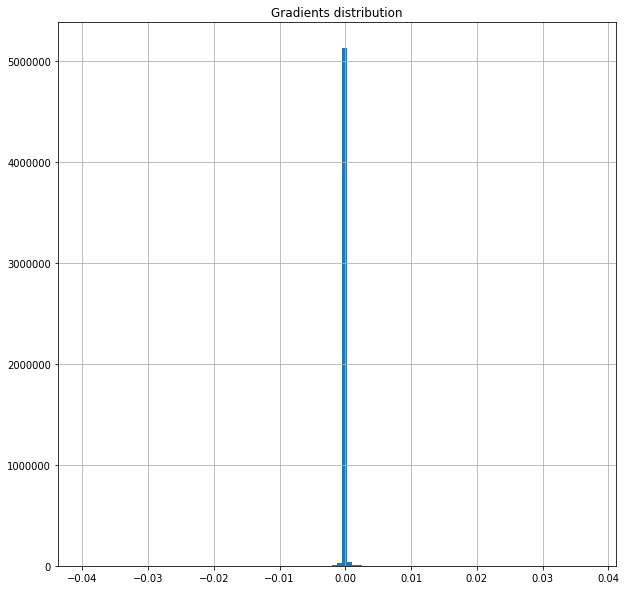

On iter 9301 with training PPL: 54.88046646118164, training ACC 0.2816840410232544
On iter 9302 with training PPL: 61.86429977416992, training ACC 0.2777777910232544
On iter 9303 with training PPL: 56.488040924072266, training ACC 0.2847222089767456
On iter 9304 with training PPL: 51.92833709716797, training ACC 0.2868923544883728
On iter 9305 with training PPL: 53.387184143066406, training ACC 0.2916666567325592
On iter 9306 with training PPL: 46.9608154296875, training ACC 0.3040364682674408
On iter 9307 with training PPL: 54.77223205566406, training ACC 0.279296875
On iter 9308 with training PPL: 59.76431655883789, training ACC 0.28125
On iter 9309 with training PPL: 57.21673583984375, training ACC 0.2725694477558136
On iter 9310 with training PPL: 61.822513580322266, training ACC 0.2610677182674408
On iter 9311 with training PPL: 55.0203857421875, training ACC 0.2808159589767456
On iter 9312 with training PPL: 57.74443435668945, training ACC 0.2756076455116272
On iter 9313 with tra

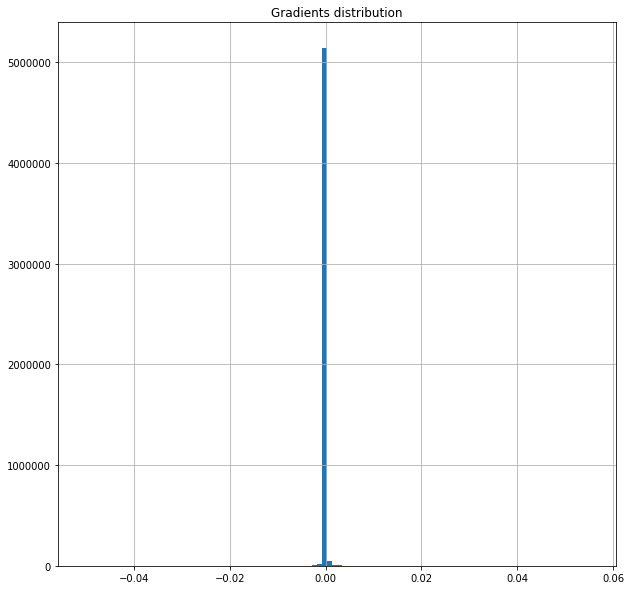

On iter 9331 with training PPL: 53.6600456237793, training ACC 0.28125
On iter 9332 with training PPL: 53.524715423583984, training ACC 0.2849392294883728
On iter 9333 with training PPL: 52.80582046508789, training ACC 0.2814670205116272
On iter 9334 with training PPL: 59.78797912597656, training ACC 0.2727864682674408
On iter 9335 with training PPL: 59.25891876220703, training ACC 0.2749565839767456
On iter 9336 with training PPL: 55.740455627441406, training ACC 0.2890625
On iter 9337 with training PPL: 55.56191635131836, training ACC 0.2779947817325592
On iter 9338 with training PPL: 57.923187255859375, training ACC 0.2736545205116272
On iter 9339 with training PPL: 55.73591232299805, training ACC 0.2747395932674408
On iter 9340 with training PPL: 50.98397445678711, training ACC 0.2886284589767456
On iter 9341 with training PPL: 55.697147369384766, training ACC 0.2894965410232544
On iter 9342 with training PPL: 55.02497863769531, training ACC 0.2814670205116272
On iter 9343 with tra

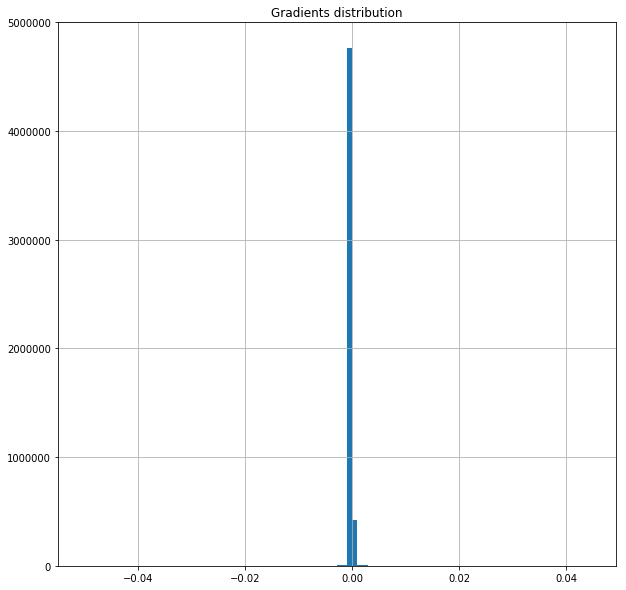

On iter 9361 with training PPL: 50.53021240234375, training ACC 0.2879774272441864
On iter 9362 with training PPL: 54.516746520996094, training ACC 0.2819010317325592
On iter 9363 with training PPL: 52.6846923828125, training ACC 0.2944878339767456
On iter 9364 with training PPL: 57.64112854003906, training ACC 0.2779947817325592
On iter 9365 with training PPL: 57.81079864501953, training ACC 0.2634548544883728
On iter 9366 with training PPL: 55.732215881347656, training ACC 0.2805989682674408
On iter 9367 with training PPL: 56.1945915222168, training ACC 0.2819010317325592
On iter 9368 with training PPL: 59.81654739379883, training ACC 0.2734375
On iter 9369 with training PPL: 52.33318328857422, training ACC 0.2855902910232544
On iter 9370 with training PPL: 59.23041915893555, training ACC 0.2740885317325592
On iter 9371 with training PPL: 51.816524505615234, training ACC 0.2879774272441864
On iter 9372 with training PPL: 57.390953063964844, training ACC 0.2777777910232544
On iter 937

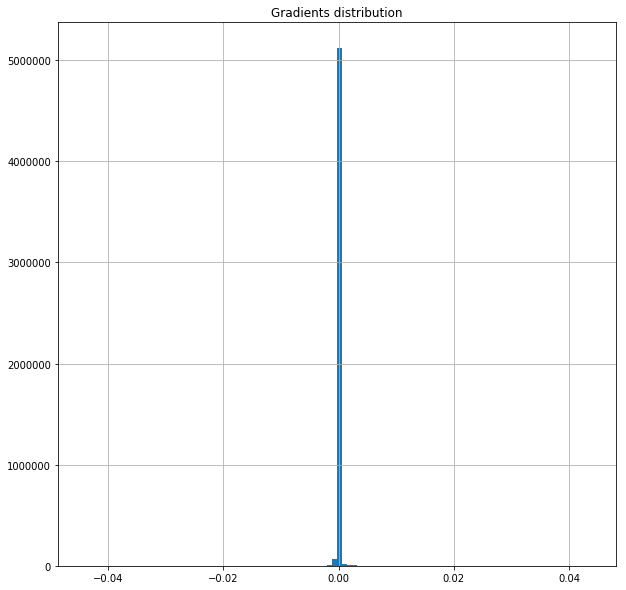

On iter 9391 with training PPL: 61.22478103637695, training ACC 0.2669270932674408
On iter 9392 with training PPL: 53.67070007324219, training ACC 0.2805989682674408
On iter 9393 with training PPL: 59.351139068603516, training ACC 0.2751736044883728
On iter 9394 with training PPL: 55.42744064331055, training ACC 0.2799479067325592
On iter 9395 with training PPL: 59.73907470703125, training ACC 0.2693142294883728
On iter 9396 with training PPL: 55.7663459777832, training ACC 0.2784288227558136
On iter 9397 with training PPL: 58.585601806640625, training ACC 0.2788628339767456
On iter 9398 with training PPL: 49.715240478515625, training ACC 0.2888454794883728
On iter 9399 with training PPL: 60.184593200683594, training ACC 0.2690972089767456
On iter 9400 with training PPL: 58.43959426879883, training ACC 0.275390625
<SS> no doubt that asia is still following america 's lead <eos> several analysts said malaysia and singapore had the biggest losses because they are relatively open to rapid

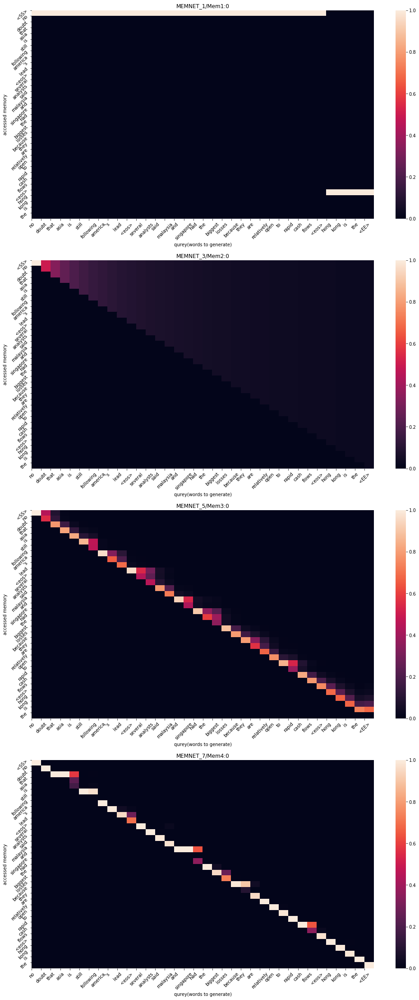

On iter 9401 with training PPL: 54.10192108154297, training ACC 0.2756076455116272
On iter 9402 with training PPL: 58.21711730957031, training ACC 0.2788628339767456
On iter 9403 with training PPL: 55.04956817626953, training ACC 0.2849392294883728
On iter 9404 with training PPL: 57.48130416870117, training ACC 0.2701822817325592
On iter 9405 with training PPL: 60.825164794921875, training ACC 0.2693142294883728
On iter 9406 with training PPL: 60.78434371948242, training ACC 0.263671875
On iter 9407 with training PPL: 54.05615234375, training ACC 0.2825520932674408
On iter 9408 with training PPL: 55.64442443847656, training ACC 0.2814670205116272
On iter 9409 with training PPL: 53.37006759643555, training ACC 0.2914496660232544
On iter 9410 with training PPL: 51.209190368652344, training ACC 0.2849392294883728
On iter 9411 with training PPL: 53.767791748046875, training ACC 0.2829861044883728
On iter 9412 with training PPL: 53.039485931396484, training ACC 0.2905815839767456
On iter 94

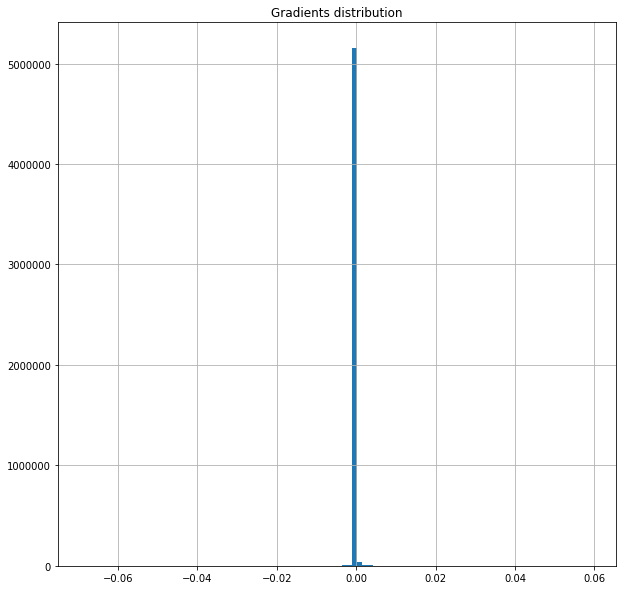

On iter 9421 with training PPL: 57.97881317138672, training ACC 0.2740885317325592
On iter 9422 with training PPL: 55.6013298034668, training ACC 0.2842881977558136
On iter 9423 with training PPL: 51.97907257080078, training ACC 0.2897135317325592
On iter 9424 with training PPL: 53.37476348876953, training ACC 0.2840711772441864
On iter 9425 with training PPL: 54.00688934326172, training ACC 0.2775607705116272
On iter 9426 with training PPL: 50.405757904052734, training ACC 0.28515625
On iter 9427 with training PPL: 59.27486038208008, training ACC 0.2786458432674408
On iter 9428 with training PPL: 51.24004364013672, training ACC 0.2864583432674408
On iter 9429 with training PPL: 49.49411392211914, training ACC 0.2934027910232544
On iter 9430 with training PPL: 55.741275787353516, training ACC 0.2810329794883728
On iter 9431 with training PPL: 61.802589416503906, training ACC 0.265625
On iter 9432 with training PPL: 61.62884521484375, training ACC 0.2734375
On iter 9433 with training PP

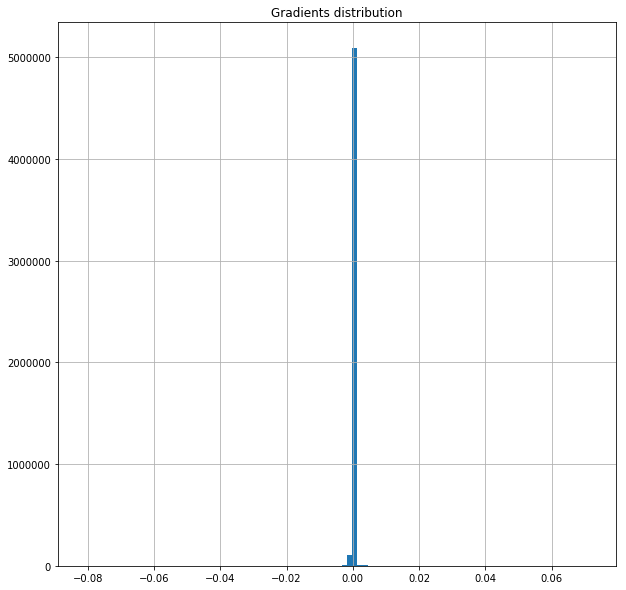

On iter 9451 with training PPL: 57.542213439941406, training ACC 0.2649739682674408
On iter 9452 with training PPL: 57.416133880615234, training ACC 0.2864583432674408
On iter 9453 with training PPL: 56.97171401977539, training ACC 0.2699652910232544
On iter 9454 with training PPL: 52.340145111083984, training ACC 0.2823350727558136
On iter 9455 with training PPL: 55.36665725708008, training ACC 0.2790798544883728
On iter 9456 with training PPL: 55.325538635253906, training ACC 0.2814670205116272
On iter 9457 with training PPL: 61.50029373168945, training ACC 0.2662760317325592
On iter 9458 with training PPL: 56.059810638427734, training ACC 0.2688802182674408
On iter 9459 with training PPL: 59.26417922973633, training ACC 0.2690972089767456
On iter 9460 with training PPL: 57.005680084228516, training ACC 0.2758246660232544
On iter 9461 with training PPL: 53.09703063964844, training ACC 0.2890625
On iter 9462 with training PPL: 52.362510681152344, training ACC 0.2934027910232544
On ite

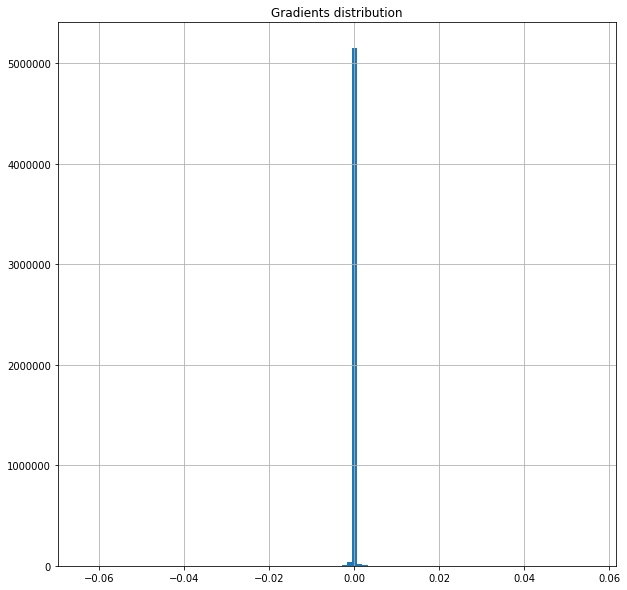

On iter 9481 with training PPL: 58.36838150024414, training ACC 0.2838541567325592
On iter 9482 with training PPL: 59.66593933105469, training ACC 0.2641059160232544
On iter 9483 with training PPL: 55.62498092651367, training ACC 0.2827690839767456
On iter 9484 with training PPL: 58.57199478149414, training ACC 0.2686631977558136
On iter 9485 with training PPL: 56.75041198730469, training ACC 0.2829861044883728
On iter 9486 with training PPL: 51.96881103515625, training ACC 0.287109375
On iter 9487 with training PPL: 53.455299377441406, training ACC 0.2836371660232544
On iter 9488 with training PPL: 54.15398406982422, training ACC 0.2810329794883728
On iter 9489 with training PPL: 55.37471008300781, training ACC 0.2860243022441864
On iter 9490 with training PPL: 51.991790771484375, training ACC 0.2977430522441864
On iter 9491 with training PPL: 54.332271575927734, training ACC 0.2771267294883728
On iter 9492 with training PPL: 56.88628387451172, training ACC 0.2708333432674408
On iter 

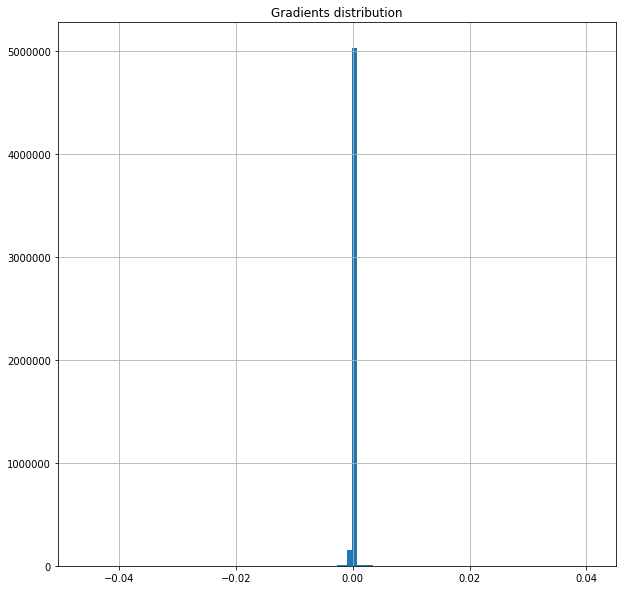

On iter 9511 with training PPL: 52.942481994628906, training ACC 0.2951388955116272
On iter 9512 with training PPL: 60.34137725830078, training ACC 0.2664930522441864
On iter 9513 with training PPL: 52.09206771850586, training ACC 0.2790798544883728
On iter 9514 with training PPL: 53.80759811401367, training ACC 0.2944878339767456
On iter 9515 with training PPL: 55.85848617553711, training ACC 0.28515625
On iter 9516 with training PPL: 53.791683197021484, training ACC 0.2903645932674408
On iter 9517 with training PPL: 53.69404602050781, training ACC 0.2777777910232544
On iter 9518 with training PPL: 58.35622024536133, training ACC 0.2760416567325592
On iter 9519 with training PPL: 57.60832214355469, training ACC 0.2760416567325592
On iter 9520 with training PPL: 58.194000244140625, training ACC 0.2723524272441864
On iter 9521 with training PPL: 60.75692367553711, training ACC 0.2697482705116272
On iter 9522 with training PPL: 61.24054718017578, training ACC 0.2634548544883728
On iter 9

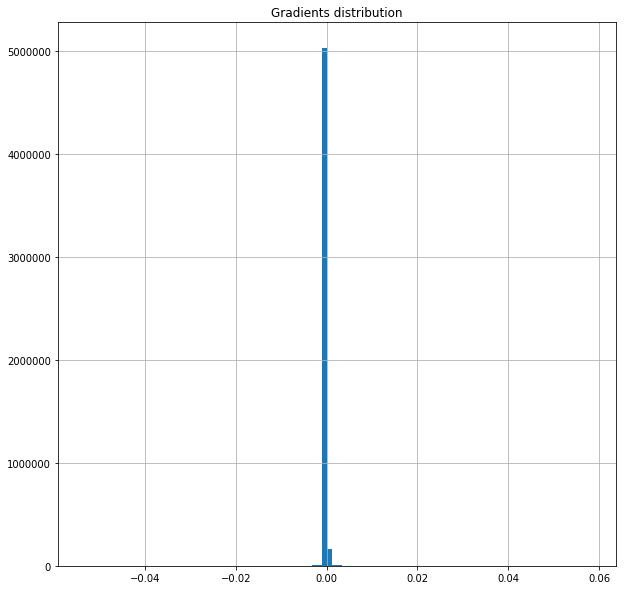

On iter 9541 with training PPL: 47.475746154785156, training ACC 0.306640625
On iter 9542 with training PPL: 59.615116119384766, training ACC 0.2671440839767456
On iter 9543 with training PPL: 50.99821090698242, training ACC 0.2925347089767456
On iter 9544 with training PPL: 52.14362335205078, training ACC 0.2914496660232544
On iter 9545 with training PPL: 55.572303771972656, training ACC 0.2790798544883728
On iter 9546 with training PPL: 62.18278884887695, training ACC 0.2615017294883728
On iter 9547 with training PPL: 50.64335632324219, training ACC 0.2962239682674408
On iter 9548 with training PPL: 53.1702880859375, training ACC 0.2825520932674408
On iter 9549 with training PPL: 60.48454284667969, training ACC 0.2697482705116272
On iter 9550 with training PPL: 54.06847381591797, training ACC 0.2858072817325592
On iter 9551 with training PPL: 58.205379486083984, training ACC 0.2745225727558136
On iter 9552 with training PPL: 56.92063522338867, training ACC 0.2779947817325592
On iter 

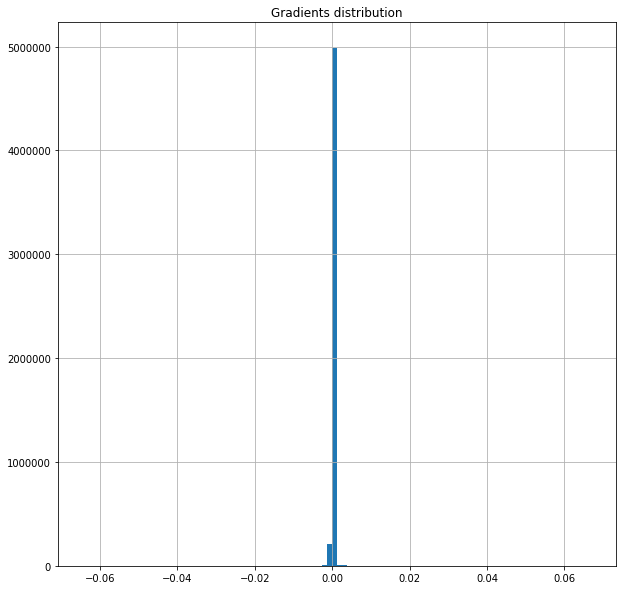

On iter 9571 with training PPL: 60.67545700073242, training ACC 0.2654079794883728
On iter 9572 with training PPL: 56.229225158691406, training ACC 0.2725694477558136
On iter 9573 with training PPL: 53.773014068603516, training ACC 0.275390625
On iter 9574 with training PPL: 55.86202621459961, training ACC 0.2630208432674408
On iter 9575 with training PPL: 53.667564392089844, training ACC 0.2862413227558136
On iter 9576 with training PPL: 58.05611038208008, training ACC 0.275390625
On iter 9577 with training PPL: 55.85547637939453, training ACC 0.2814670205116272
On iter 9578 with training PPL: 54.928558349609375, training ACC 0.2847222089767456
On iter 9579 with training PPL: 51.464447021484375, training ACC 0.2834201455116272
On iter 9580 with training PPL: 57.88944625854492, training ACC 0.2736545205116272
On iter 9581 with training PPL: 55.019203186035156, training ACC 0.2723524272441864
On iter 9582 with training PPL: 56.280670166015625, training ACC 0.2756076455116272
On iter 958

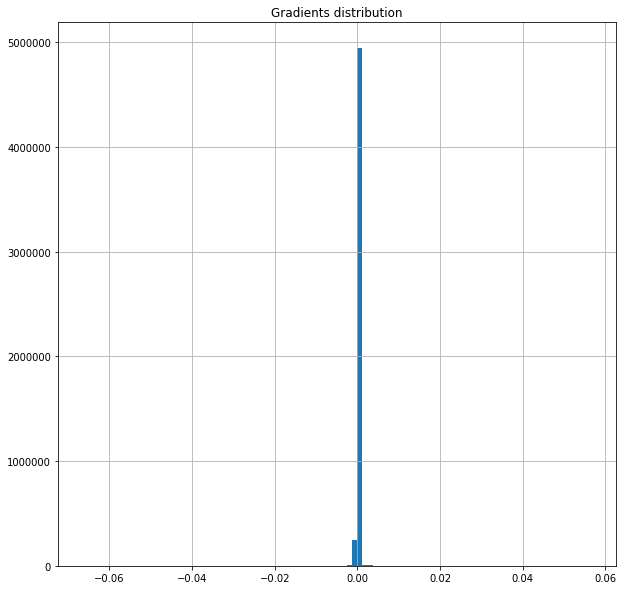

<SS> is expected to total between $ N billion and $ N billion and carry a maturity greater than N years <eos> resolution funding is a division of resolution trust corp. the new federal agency created <EE>


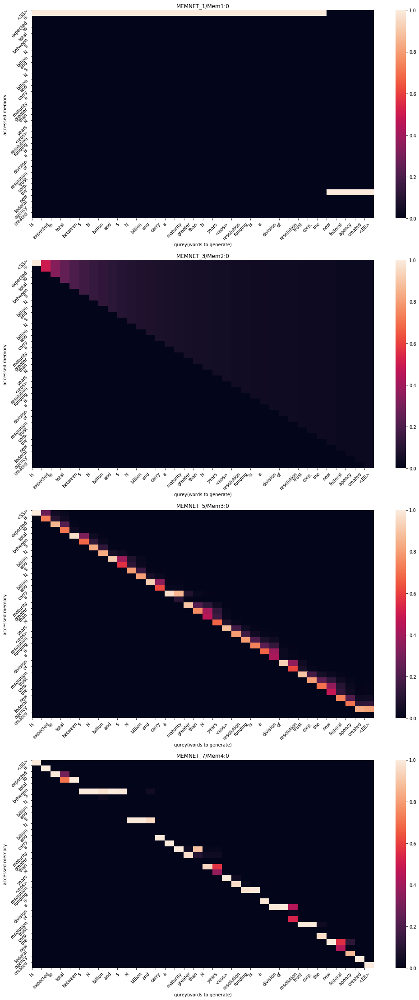

On iter 9601 with training PPL: 51.92802810668945, training ACC 0.2881944477558136
On iter 9602 with training PPL: 58.54823303222656, training ACC 0.2740885317325592
On iter 9603 with training PPL: 48.60981750488281, training ACC 0.3036024272441864
On iter 9604 with training PPL: 59.94843673706055, training ACC 0.2738715410232544
On iter 9605 with training PPL: 51.60400390625, training ACC 0.2873263955116272
On iter 9606 with training PPL: 54.873531341552734, training ACC 0.2769097089767456
On iter 9607 with training PPL: 55.404239654541016, training ACC 0.2834201455116272
On iter 9608 with training PPL: 50.85145950317383, training ACC 0.2892795205116272
On iter 9609 with training PPL: 51.50052261352539, training ACC 0.287109375
On iter 9610 with training PPL: 51.125003814697266, training ACC 0.2890625
On iter 9611 with training PPL: 49.53278732299805, training ACC 0.3016493022441864
On iter 9612 with training PPL: 55.80044937133789, training ACC 0.2719184160232544
On iter 9613 with tr

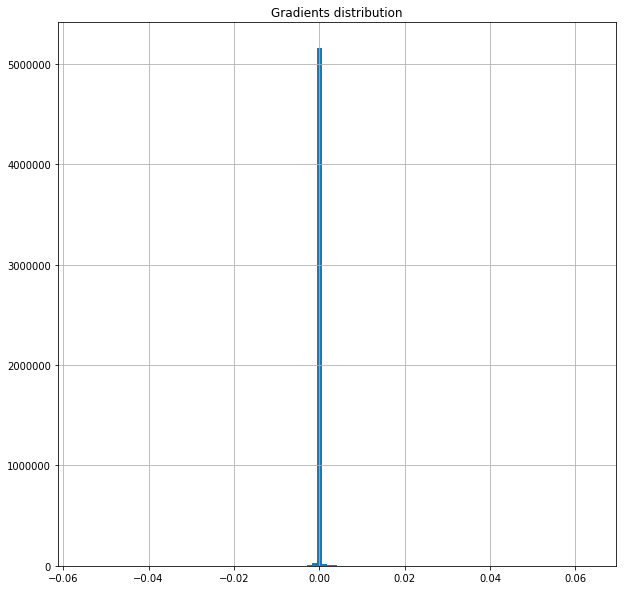

On iter 9631 with training PPL: 48.57041931152344, training ACC 0.2914496660232544
On iter 9632 with training PPL: 56.81116485595703, training ACC 0.2790798544883728
On iter 9633 with training PPL: 56.19852828979492, training ACC 0.2727864682674408
On iter 9634 with training PPL: 62.14182662963867, training ACC 0.2651909589767456
On iter 9635 with training PPL: 55.13433837890625, training ACC 0.2758246660232544
On iter 9636 with training PPL: 54.155906677246094, training ACC 0.2894965410232544
On iter 9637 with training PPL: 53.93598937988281, training ACC 0.2777777910232544
On iter 9638 with training PPL: 55.253143310546875, training ACC 0.2862413227558136
On iter 9639 with training PPL: 56.56159973144531, training ACC 0.2823350727558136
On iter 9640 with training PPL: 52.3127326965332, training ACC 0.2881944477558136
On iter 9641 with training PPL: 52.609004974365234, training ACC 0.2769097089767456
On iter 9642 with training PPL: 55.562232971191406, training ACC 0.2840711772441864
O

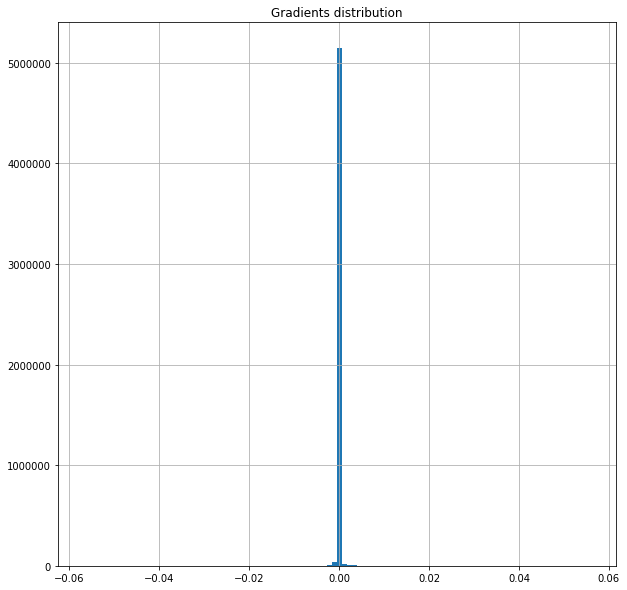

On iter 9661 with training PPL: 57.333431243896484, training ACC 0.2769097089767456
On iter 9662 with training PPL: 51.44959259033203, training ACC 0.2940538227558136
On iter 9663 with training PPL: 55.932472229003906, training ACC 0.2717013955116272
On iter 9664 with training PPL: 58.52277755737305, training ACC 0.2669270932674408
On iter 9665 with training PPL: 54.37625503540039, training ACC 0.2825520932674408
On iter 9666 with training PPL: 53.70395278930664, training ACC 0.2862413227558136
On iter 9667 with training PPL: 53.73926544189453, training ACC 0.2862413227558136
On iter 9668 with training PPL: 56.06895446777344, training ACC 0.2801649272441864
On iter 9669 with training PPL: 47.42739486694336, training ACC 0.3055555522441864
On iter 9670 with training PPL: 55.81319808959961, training ACC 0.2801649272441864
On iter 9671 with training PPL: 56.02897262573242, training ACC 0.2740885317325592
On iter 9672 with training PPL: 55.00509262084961, training ACC 0.2693142294883728
On

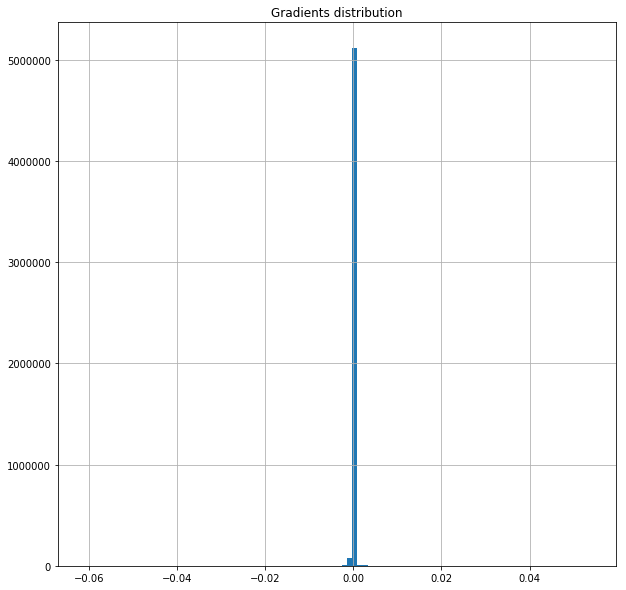

On iter 9691 with training PPL: 52.253849029541016, training ACC 0.2864583432674408
On iter 9692 with training PPL: 50.19126892089844, training ACC 0.2858072817325592
On iter 9693 with training PPL: 55.58761978149414, training ACC 0.2790798544883728
On iter 9694 with training PPL: 53.71166229248047, training ACC 0.2981770932674408
On iter 9695 with training PPL: 50.61104202270508, training ACC 0.2921006977558136
On iter 9696 with training PPL: 58.12885284423828, training ACC 0.2730034589767456
On iter 9697 with training PPL: 56.4776496887207, training ACC 0.2775607705116272
On iter 9698 with training PPL: 51.126407623291016, training ACC 0.2892795205116272
On iter 9699 with training PPL: 54.648597717285156, training ACC 0.2849392294883728
On iter 9700 with training PPL: 53.86257553100586, training ACC 0.2996961772441864
On iter 9701 with training PPL: 58.269691467285156, training ACC 0.2708333432674408
On iter 9702 with training PPL: 51.514793395996094, training ACC 0.2864583432674408


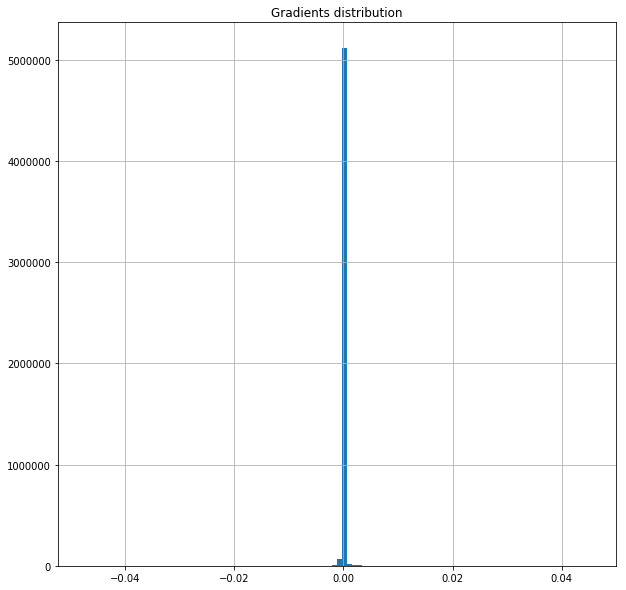

On iter 9721 with training PPL: 46.8851203918457, training ACC 0.298828125
On iter 9722 with training PPL: 54.319915771484375, training ACC 0.2805989682674408
On iter 9723 with training PPL: 55.76182556152344, training ACC 0.2803819477558136
On iter 9724 with training PPL: 63.83769989013672, training ACC 0.2645399272441864
On iter 9725 with training PPL: 50.185585021972656, training ACC 0.2944878339767456
On iter 9726 with training PPL: 47.323692321777344, training ACC 0.2957899272441864
On iter 9727 with training PPL: 53.73738098144531, training ACC 0.2795138955116272
On iter 9728 with training PPL: 52.29450225830078, training ACC 0.2838541567325592
On iter 9729 with training PPL: 54.63054275512695, training ACC 0.2743055522441864
On iter 9730 with training PPL: 52.785213470458984, training ACC 0.2827690839767456
On iter 9731 with training PPL: 57.27272033691406, training ACC 0.2723524272441864
On iter 9732 with training PPL: 49.1921501159668, training ACC 0.2970920205116272
On iter 9

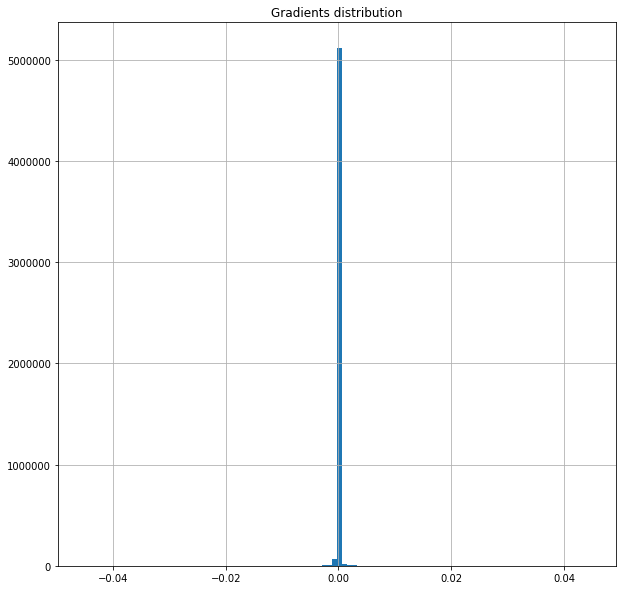

On iter 9751 with training PPL: 55.14622497558594, training ACC 0.2903645932674408
On iter 9752 with training PPL: 59.24326705932617, training ACC 0.2669270932674408
On iter 9753 with training PPL: 51.56062698364258, training ACC 0.2868923544883728
On iter 9754 with training PPL: 52.01652526855469, training ACC 0.279296875
On iter 9755 with training PPL: 50.227169036865234, training ACC 0.2842881977558136
On iter 9756 with training PPL: 56.8323860168457, training ACC 0.2730034589767456
On iter 9757 with training PPL: 52.8599853515625, training ACC 0.2858072817325592
On iter 9758 with training PPL: 51.60627746582031, training ACC 0.2786458432674408
On iter 9759 with training PPL: 52.366641998291016, training ACC 0.2819010317325592
On iter 9760 with training PPL: 51.42158508300781, training ACC 0.291015625
On iter 9761 with training PPL: 58.33869552612305, training ACC 0.2797309160232544
On iter 9762 with training PPL: 51.742820739746094, training ACC 0.2886284589767456
On iter 9763 with

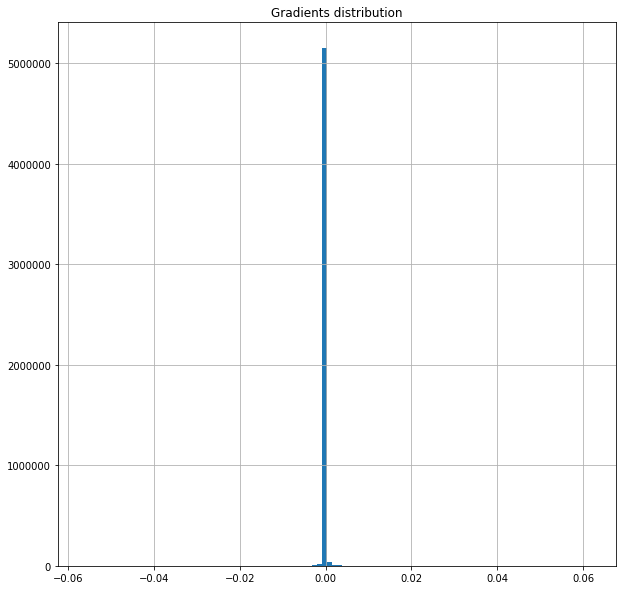

On iter 9781 with training PPL: 53.35866928100586, training ACC 0.2760416567325592
On iter 9782 with training PPL: 52.074981689453125, training ACC 0.2892795205116272
On iter 9783 with training PPL: 49.87919998168945, training ACC 0.2931857705116272
On iter 9784 with training PPL: 53.67572784423828, training ACC 0.27734375
On iter 9785 with training PPL: 50.966278076171875, training ACC 0.291015625
On iter 9786 with training PPL: 52.979366302490234, training ACC 0.2897135317325592
On iter 9787 with training PPL: 55.98383712768555, training ACC 0.2751736044883728
On iter 9788 with training PPL: 54.153812408447266, training ACC 0.2825520932674408
On iter 9789 with training PPL: 51.52652359008789, training ACC 0.2845052182674408
On iter 9790 with training PPL: 53.07244873046875, training ACC 0.2875434160232544
On iter 9791 with training PPL: 57.382198333740234, training ACC 0.2662760317325592
On iter 9792 with training PPL: 49.21432113647461, training ACC 0.294921875
On iter 9793 with tra

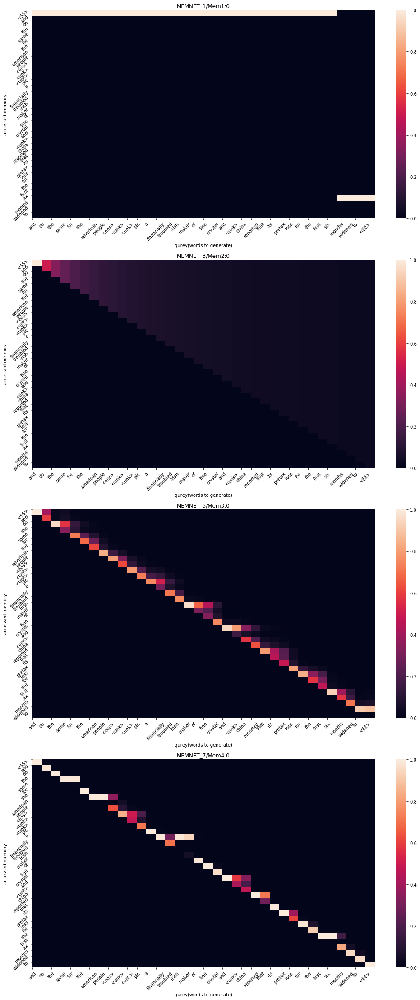

On iter 9801 with training PPL: 47.996761322021484, training ACC 0.2979600727558136
On iter 9802 with training PPL: 56.99494552612305, training ACC 0.2710503339767456
On iter 9803 with training PPL: 52.42473220825195, training ACC 0.2907986044883728
On iter 9804 with training PPL: 55.378910064697266, training ACC 0.2790798544883728
On iter 9805 with training PPL: 53.156089782714844, training ACC 0.2782118022441864
On iter 9806 with training PPL: 56.34564971923828, training ACC 0.2736545205116272
On iter 9807 with training PPL: 54.90959930419922, training ACC 0.2914496660232544
On iter 9808 with training PPL: 48.83063507080078, training ACC 0.2977430522441864
On iter 9809 with training PPL: 53.50633239746094, training ACC 0.2894965410232544
On iter 9810 with training PPL: 50.77431106567383, training ACC 0.2868923544883728
	 validation PPL 151.25088500976562, validation acc 0.2421875
shape of gradients is (5228544,), L2 norm of gradients is 0.9636460542678833, details:                   

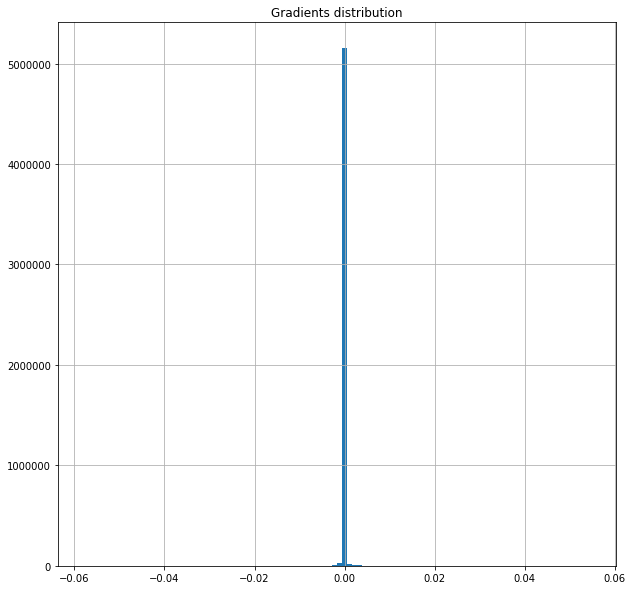

On iter 9811 with training PPL: 51.654693603515625, training ACC 0.2903645932674408
On iter 9812 with training PPL: 50.593475341796875, training ACC 0.2931857705116272
On iter 9813 with training PPL: 57.418792724609375, training ACC 0.2706163227558136
On iter 9814 with training PPL: 59.20672607421875, training ACC 0.2664930522441864
On iter 9815 with training PPL: 55.346885681152344, training ACC 0.2799479067325592
On iter 9816 with training PPL: 52.130271911621094, training ACC 0.2944878339767456
On iter 9817 with training PPL: 52.46781921386719, training ACC 0.28515625
On iter 9818 with training PPL: 59.70427322387695, training ACC 0.2740885317325592
On iter 9819 with training PPL: 56.143890380859375, training ACC 0.2743055522441864
On iter 9820 with training PPL: 52.38294219970703, training ACC 0.2805989682674408
On iter 9821 with training PPL: 58.5699577331543, training ACC 0.2788628339767456
On iter 9822 with training PPL: 56.808780670166016, training ACC 0.2808159589767456
On ite

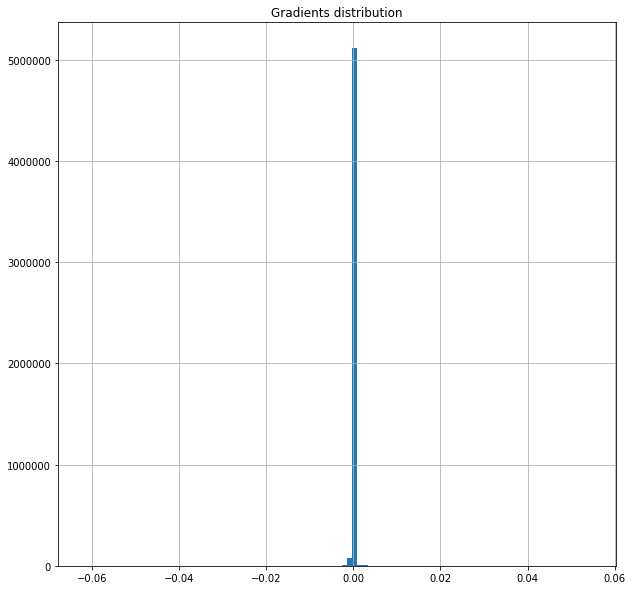

On iter 9841 with training PPL: 53.473182678222656, training ACC 0.2834201455116272
On iter 9842 with training PPL: 49.347923278808594, training ACC 0.2888454794883728
On iter 9843 with training PPL: 54.17725372314453, training ACC 0.2775607705116272
On iter 9844 with training PPL: 52.49502182006836, training ACC 0.2875434160232544
On iter 9845 with training PPL: 52.86066436767578, training ACC 0.2784288227558136
On iter 9846 with training PPL: 58.661460876464844, training ACC 0.2723524272441864
On iter 9847 with training PPL: 53.67821502685547, training ACC 0.2766927182674408
On iter 9848 with training PPL: 50.31032180786133, training ACC 0.2923177182674408
On iter 9849 with training PPL: 55.0413818359375, training ACC 0.275390625
On iter 9850 with training PPL: 52.894554138183594, training ACC 0.28515625
On iter 9851 with training PPL: 51.76347732543945, training ACC 0.2821180522441864
On iter 9852 with training PPL: 50.710784912109375, training ACC 0.2938368022441864
On iter 9853 wi

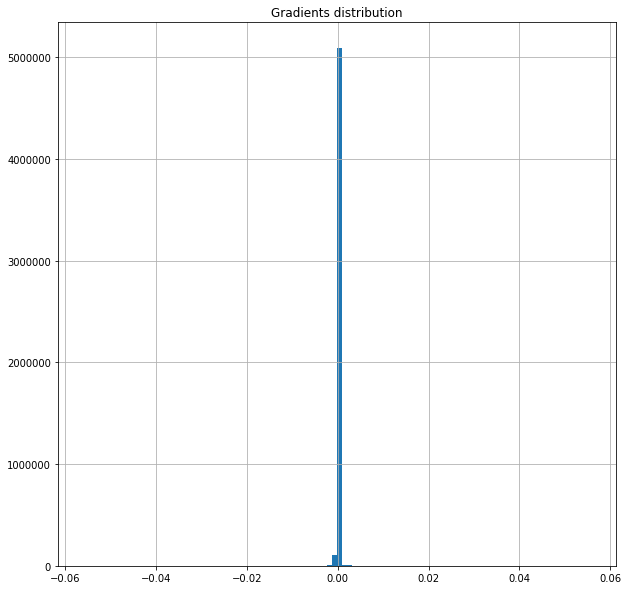

On iter 9871 with training PPL: 54.59455490112305, training ACC 0.2762586772441864
On iter 9872 with training PPL: 50.78131103515625, training ACC 0.2927517294883728
On iter 9873 with training PPL: 47.172237396240234, training ACC 0.2938368022441864
On iter 9874 with training PPL: 54.153011322021484, training ACC 0.2756076455116272
On iter 9875 with training PPL: 52.474639892578125, training ACC 0.2858072817325592
On iter 9876 with training PPL: 49.847469329833984, training ACC 0.2973090410232544
On iter 9877 with training PPL: 57.86565399169922, training ACC 0.2654079794883728
On iter 9878 with training PPL: 52.48323440551758, training ACC 0.28515625
On iter 9879 with training PPL: 50.579776763916016, training ACC 0.2894965410232544
On iter 9880 with training PPL: 51.59039306640625, training ACC 0.291015625
On iter 9881 with training PPL: 50.23020935058594, training ACC 0.2931857705116272
On iter 9882 with training PPL: 50.72004699707031, training ACC 0.2834201455116272
On iter 9883 w

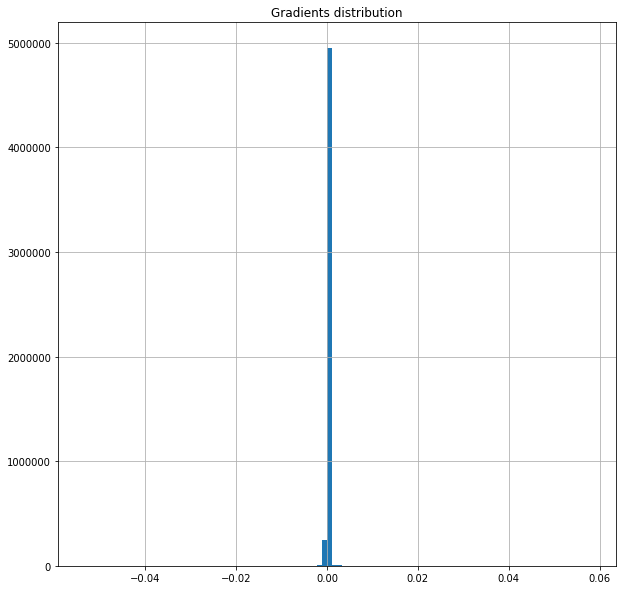

On iter 9901 with training PPL: 54.949623107910156, training ACC 0.2805989682674408
On iter 9902 with training PPL: 57.658451080322266, training ACC 0.2690972089767456
On iter 9903 with training PPL: 52.80466079711914, training ACC 0.2836371660232544
On iter 9904 with training PPL: 57.31583023071289, training ACC 0.2693142294883728
On iter 9905 with training PPL: 54.79848861694336, training ACC 0.2821180522441864
On iter 9906 with training PPL: 49.771053314208984, training ACC 0.2884114682674408
On iter 9907 with training PPL: 54.79751968383789, training ACC 0.2734375
On iter 9908 with training PPL: 53.38544464111328, training ACC 0.271484375
On iter 9909 with training PPL: 61.24565887451172, training ACC 0.2588975727558136
On iter 9910 with training PPL: 54.835262298583984, training ACC 0.2823350727558136
On iter 9911 with training PPL: 45.73737335205078, training ACC 0.30078125
On iter 9912 with training PPL: 54.08241271972656, training ACC 0.2866753339767456
On iter 9913 with traini

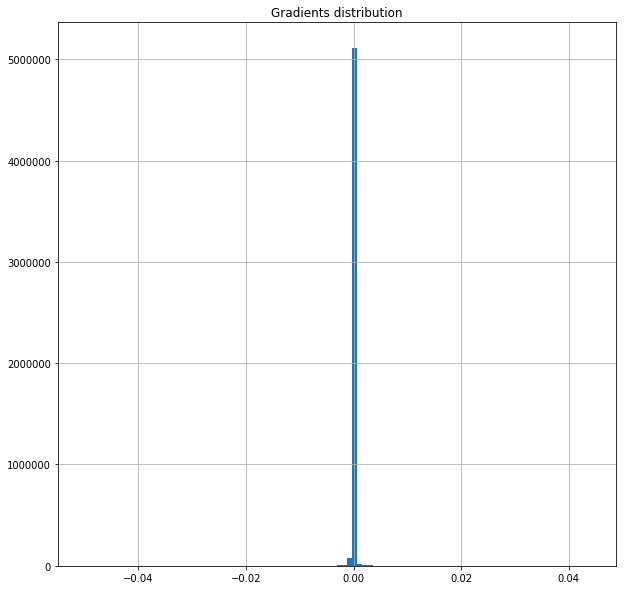

On iter 9931 with training PPL: 53.967620849609375, training ACC 0.2862413227558136
On iter 9932 with training PPL: 52.82933044433594, training ACC 0.2834201455116272
On iter 9933 with training PPL: 53.19434356689453, training ACC 0.2771267294883728
On iter 9934 with training PPL: 46.88655090332031, training ACC 0.2977430522441864
On iter 9935 with training PPL: 48.313316345214844, training ACC 0.2996961772441864
On iter 9936 with training PPL: 52.34107971191406, training ACC 0.2823350727558136
On iter 9937 with training PPL: 46.61077117919922, training ACC 0.3062065839767456
On iter 9938 with training PPL: 48.98604965209961, training ACC 0.2875434160232544
On iter 9939 with training PPL: 56.244991302490234, training ACC 0.2823350727558136
On iter 9940 with training PPL: 55.26911163330078, training ACC 0.2816840410232544
On iter 9941 with training PPL: 58.435611724853516, training ACC 0.2690972089767456
On iter 9942 with training PPL: 52.56629943847656, training ACC 0.2771267294883728


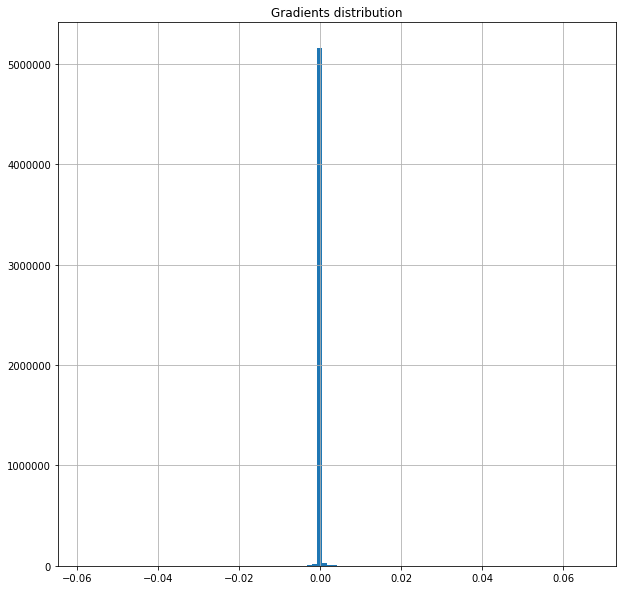

On iter 9961 with training PPL: 47.223148345947266, training ACC 0.2979600727558136
On iter 9962 with training PPL: 47.25801467895508, training ACC 0.298828125
On iter 9963 with training PPL: 51.66734313964844, training ACC 0.2847222089767456
On iter 9964 with training PPL: 53.064353942871094, training ACC 0.2829861044883728
On iter 9965 with training PPL: 56.569583892822266, training ACC 0.2619357705116272
On iter 9966 with training PPL: 52.000938415527344, training ACC 0.2827690839767456
On iter 9967 with training PPL: 47.65985870361328, training ACC 0.3005642294883728
On iter 9968 with training PPL: 47.3818244934082, training ACC 0.3029513955116272
On iter 9969 with training PPL: 51.57732009887695, training ACC 0.2907986044883728
On iter 9970 with training PPL: 52.35179138183594, training ACC 0.2801649272441864
On iter 9971 with training PPL: 52.91860580444336, training ACC 0.2858072817325592
On iter 9972 with training PPL: 54.47600173950195, training ACC 0.2779947817325592
On iter 

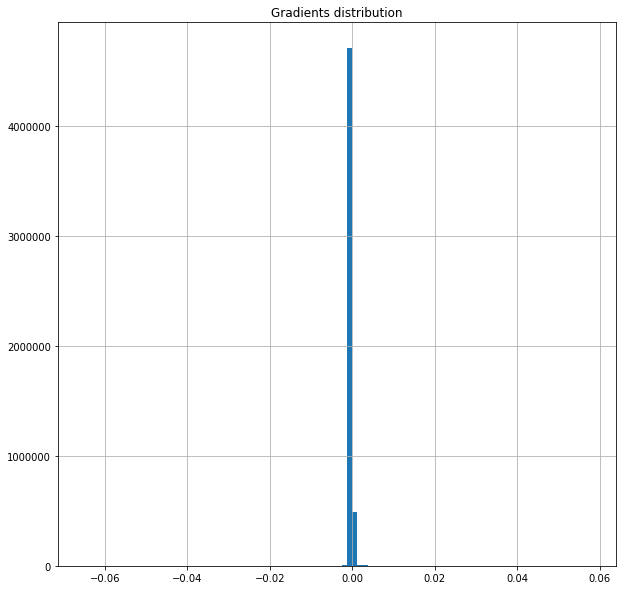

On iter 9991 with training PPL: 48.04425048828125, training ACC 0.3059895932674408
On iter 9992 with training PPL: 46.937686920166016, training ACC 0.306640625
On iter 9993 with training PPL: 55.021644592285156, training ACC 0.2764756977558136
On iter 9994 with training PPL: 52.343448638916016, training ACC 0.283203125
On iter 9995 with training PPL: 54.28943634033203, training ACC 0.2821180522441864
On iter 9996 with training PPL: 53.20907974243164, training ACC 0.2875434160232544
On iter 9997 with training PPL: 49.115169525146484, training ACC 0.2916666567325592
On iter 9998 with training PPL: 51.00135040283203, training ACC 0.2901475727558136
On iter 9999 with training PPL: 50.178916931152344, training ACC 0.2918836772441864


In [17]:
for i in range(10000):
    x_batch, y_true_batch = next(trainGen)
    feed_dict_train = {inputs: x_batch, y_true: y_true_batch}
    _, trainPPL, trainACC = session.run([train_op, PPL, accuracy], feed_dict=feed_dict_train)
    print('On iter {0} with training PPL: {1}, training ACC {2}'.format(i, trainPPL, trainACC))
    if i % 30 == 0:
        x_batch, y_true_batch = next(valGen)
        feed_dict_val = {inputs: x_batch, y_true: y_true_batch}
        valPPL, valACC = session.run([PPL, accuracy], feed_dict=feed_dict_val)
        print('\t validation PPL {0}, validation acc {1}'.format(valPPL, valACC))
        
        show_gradient(session.run([totalGrad], feed_dict=feed_dict_val)[0])
    
    if i % 200 == 0:
        showAttentionWeights([attMem1, attMem2, attMem3, attMem4], session=session)